<a href="https://colab.research.google.com/github/Pranav-2509/NIGHT_VISION_SELF/blob/main/GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#IMPORTS

In [ ]:
import torch
import torch.nn as nn
import numpy as np
from torchvision import transforms, datasets
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

#Getting Data Ready

In [ ]:
transform = transforms.Compose ([transforms.ToTensor(), transforms.Normalize ((0.5,), (0.5, ))])
train_dataset = datasets.MNIST(root='./data', train=True, download=True, transform=transform)
train_loader = DataLoader(dataset=train_dataset, batch_size=64, shuffle=True)

In [ ]:
test_dataset = datasets.MNIST(root='./data', train=False, download=True, transform=transform)
test_loader = DataLoader(dataset=test_dataset, batch_size=64, shuffle=True)

In [ ]:
print (len (train_dataset), '\n', len (test_dataset))
print (train_dataset[0][0].shape)

60000 
 10000
torch.Size([1, 28, 28])


In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

#Model

generator

In [ ]:
latent_dim = 100

class Generator (nn.Module):
  def __init__ (self, latent_dim = latent_dim):
      super(Generator, self).__init__()
      self.model = nn.Sequential (
          nn.Linear (latent_dim, 128*7*7),
          nn.ReLU(),
          nn.Unflatten (1, (128, 7, 7)),
          nn.Upsample(scale_factor=2),
          nn.Conv2d (in_channels = 128, out_channels = 128, kernel_size = 3, padding = 1),
          nn.BatchNorm2d (128),
          nn.ReLU(),
          nn.Upsample(scale_factor=2),
          nn.Conv2d(128, 64, kernel_size=3, padding=1),
          nn.BatchNorm2d(64),
          nn.ReLU(),
          nn.Conv2d(64, 1, kernel_size=3, padding=1),
          nn.Sigmoid()
      )


  def forward (self, x):
    return (self.model (x))


In [ ]:
generator = Generator (latent_dim).to (device)

In [ ]:
# test_input = torch.rand ((20, latent_dim))
# output = generator (test_input)
# print (output.shape)

discriminator

In [ ]:
#TO understand dropout in CNNs

# layer = nn.Dropout (p = 0.7)
# input = torch.rand ((5, 3, 5, 5))

# output = layer (input)
# print (input, '\n', output)

In [ ]:
class Discriminator (nn.Module):
  def __init__ (self):
    super (Discriminator, self).__init__()

    self.model = nn.Sequential (
        nn.Conv2d(1, 32, kernel_size=2, stride=2, padding=1),
        nn.ReLU(),
        nn.Dropout(0.25),
        nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1),
        nn.BatchNorm2d(64),
        nn.ReLU(),
        nn.Dropout(0.25),
        nn.Conv2d(64, 128, kernel_size=2, stride=2, padding=1),
        nn.BatchNorm2d(128),
        nn.ReLU(),
        nn.Dropout(0.25),
        nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
        nn.BatchNorm2d(256),
        nn.ReLU(),
        nn.Dropout(0.25),
        nn.Flatten(),
        nn.Linear(256 * 5* 5, 1),
        nn.Sigmoid()
    )

  def forward (self, x):
    return (self.model (x))

In [ ]:
discriminator = Discriminator () . to (device)

In [ ]:
# Testing the discriminator

# sample = torch.rand ((20, 1, 28, 28))
# output = discriminator (sample)

#Training Loop

In [ ]:
loss_fn = nn.BCELoss()
optimiser_g = torch.optim.SGD (generator.parameters(), lr = 5e-4)
optimiser_d = torch.optim.SGD (discriminator.parameters(), lr = 1e-5)

Discriminator Loss = 1.484017014503479
Generator Loss = 0.5308139324188232
A sample image generated by the generator


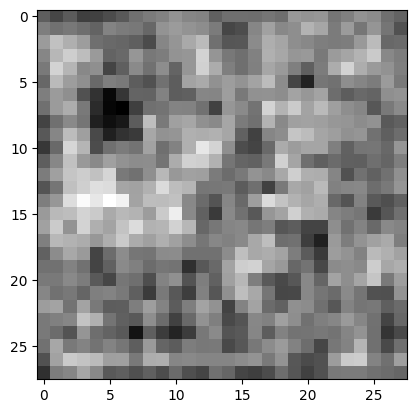

----------------------------------------


Discriminator Loss = 1.429456114768982
Generator Loss = 0.5312342643737793
A sample image generated by the generator


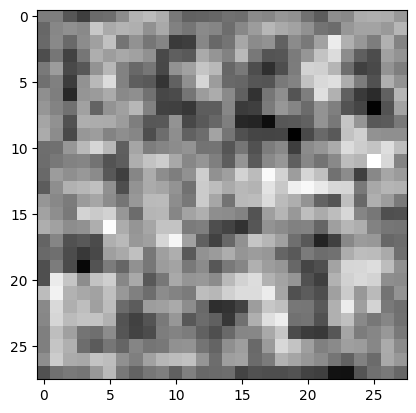

----------------------------------------


Discriminator Loss = 1.4734135866165161
Generator Loss = 0.5436185598373413
A sample image generated by the generator


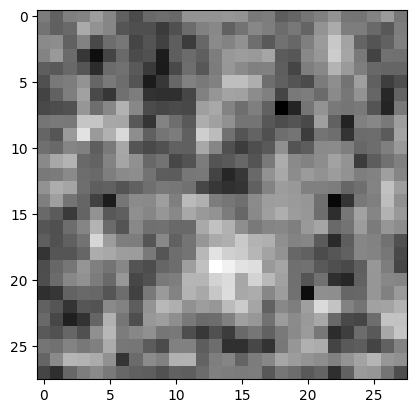

----------------------------------------


Discriminator Loss = 1.4129068851470947
Generator Loss = 0.5200175046920776
A sample image generated by the generator


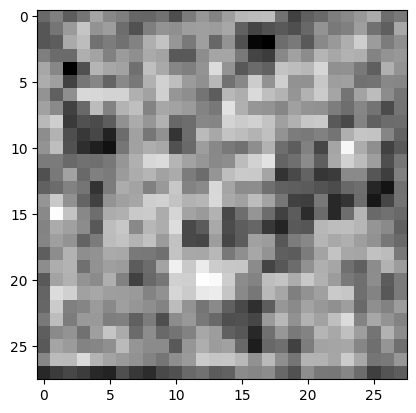

----------------------------------------


Discriminator Loss = 1.4246731996536255
Generator Loss = 0.5874327421188354
A sample image generated by the generator


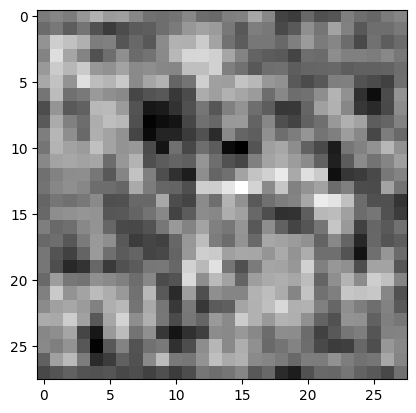

----------------------------------------


Discriminator Loss = 1.4293133020401
Generator Loss = 0.5860925912857056
A sample image generated by the generator


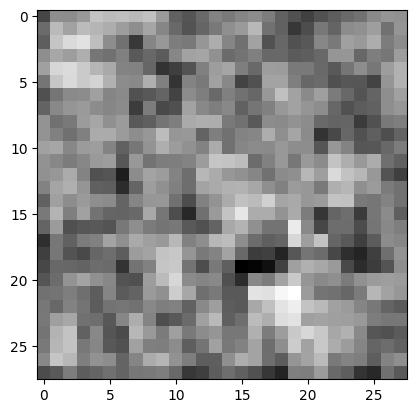

----------------------------------------


Discriminator Loss = 1.395378828048706
Generator Loss = 0.6105902791023254
A sample image generated by the generator


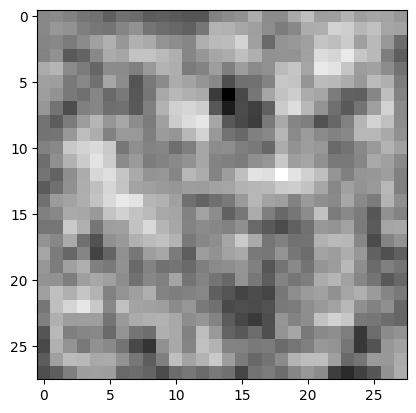

----------------------------------------


Discriminator Loss = 1.3742883205413818
Generator Loss = 0.5703970789909363
A sample image generated by the generator


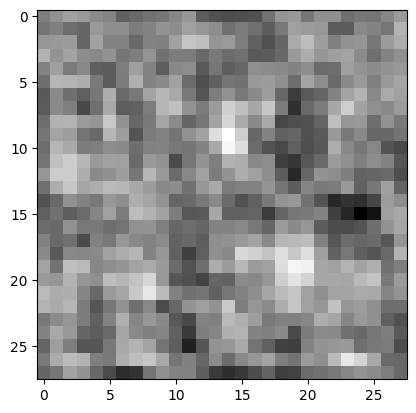

----------------------------------------


Discriminator Loss = 1.4389146566390991
Generator Loss = 0.6000955104827881
A sample image generated by the generator


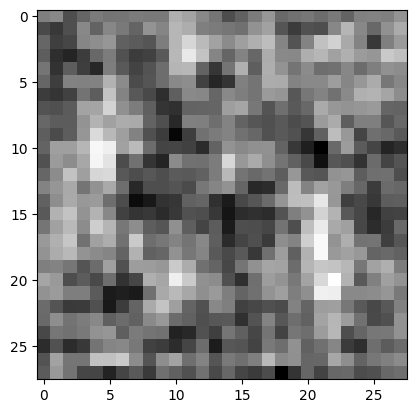

----------------------------------------


Discriminator Loss = 1.347792387008667
Generator Loss = 0.6151612997055054
A sample image generated by the generator


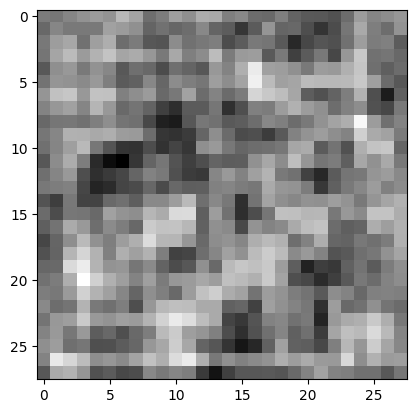

----------------------------------------


Discriminator Loss = 1.3579542636871338
Generator Loss = 0.6111359596252441
A sample image generated by the generator


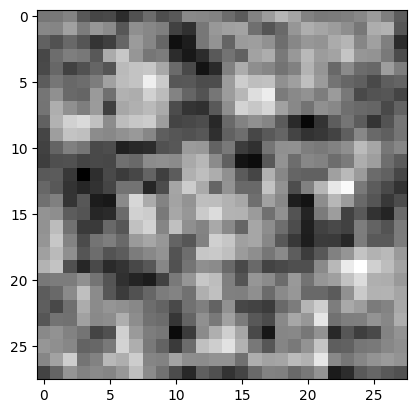

----------------------------------------


Discriminator Loss = 1.3795939683914185
Generator Loss = 0.6841493248939514
A sample image generated by the generator


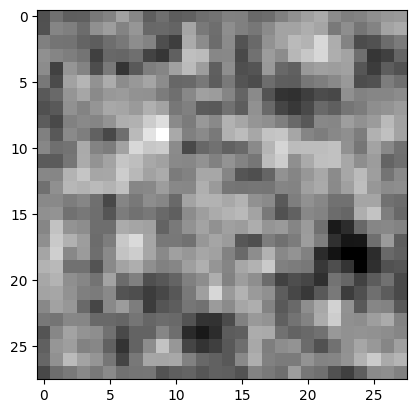

----------------------------------------


Discriminator Loss = 1.3624207973480225
Generator Loss = 0.6144805550575256
A sample image generated by the generator


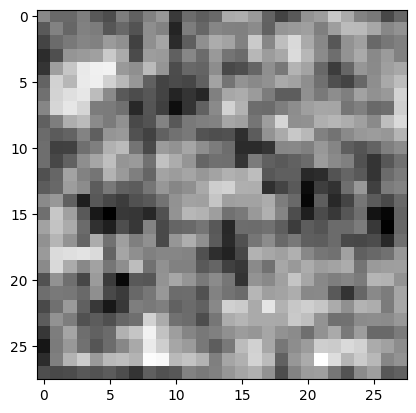

----------------------------------------


Discriminator Loss = 1.2929426431655884
Generator Loss = 0.6527576446533203
A sample image generated by the generator


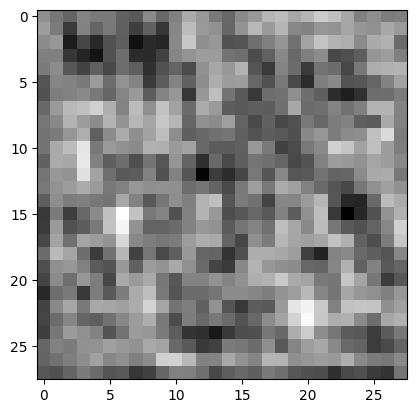

----------------------------------------


Discriminator Loss = 1.315253734588623
Generator Loss = 0.6635103225708008
A sample image generated by the generator


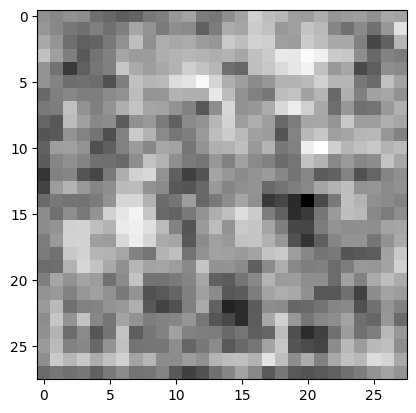

----------------------------------------


Discriminator Loss = 1.3297390937805176
Generator Loss = 0.6673483848571777
A sample image generated by the generator


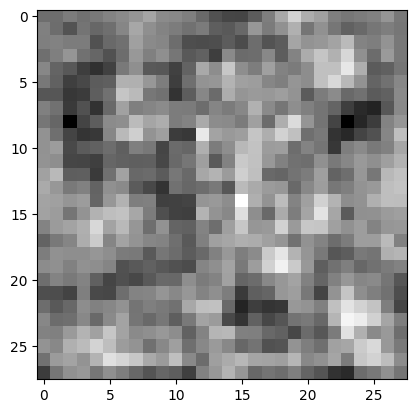

----------------------------------------


Discriminator Loss = 1.3110300302505493
Generator Loss = 0.7012518644332886
A sample image generated by the generator


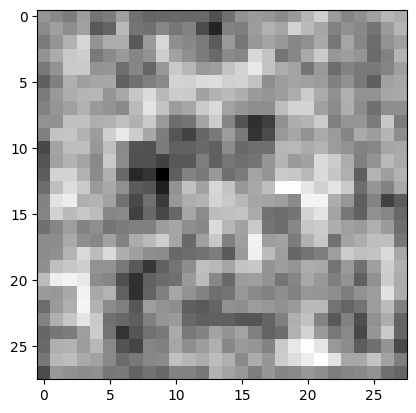

----------------------------------------


Discriminator Loss = 1.3812668323516846
Generator Loss = 0.6887288093566895
A sample image generated by the generator


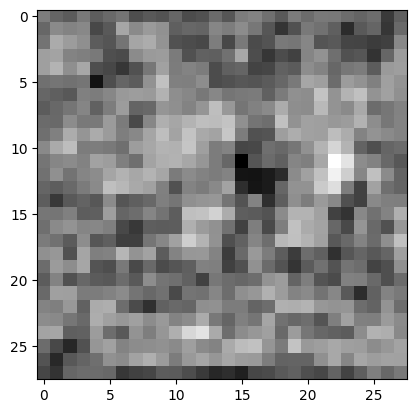

----------------------------------------


Discriminator Loss = 1.305610179901123
Generator Loss = 0.6921335458755493
A sample image generated by the generator


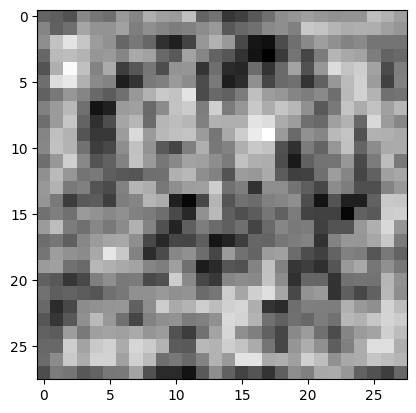

----------------------------------------


Discriminator Loss = 1.3382079601287842
Generator Loss = 0.6875998973846436
A sample image generated by the generator


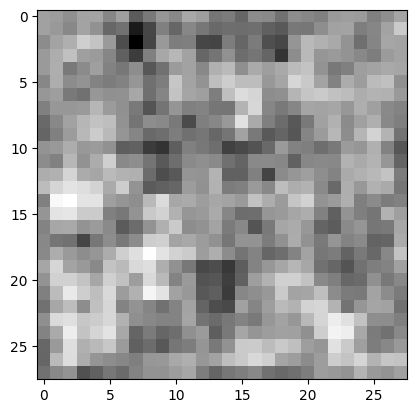

----------------------------------------


Discriminator Loss = 1.2736526727676392
Generator Loss = 0.7256183624267578
A sample image generated by the generator


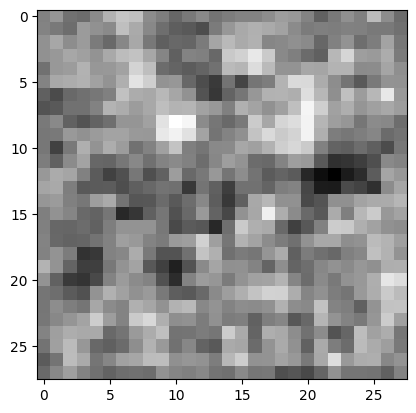

----------------------------------------


Discriminator Loss = 1.3455736637115479
Generator Loss = 0.6977453827857971
A sample image generated by the generator


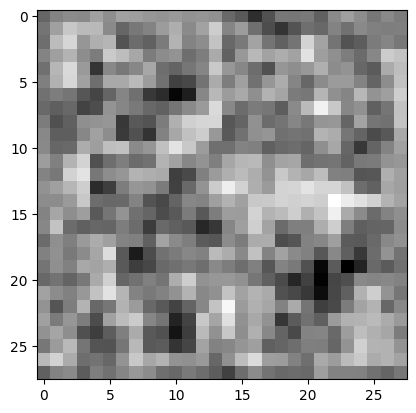

----------------------------------------


Discriminator Loss = 1.3348231315612793
Generator Loss = 0.7155774235725403
A sample image generated by the generator


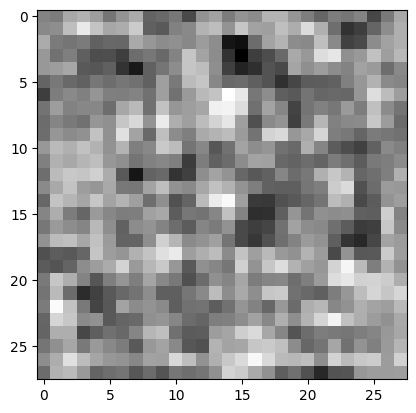

----------------------------------------


Discriminator Loss = 1.2907989025115967
Generator Loss = 0.7844576835632324
A sample image generated by the generator


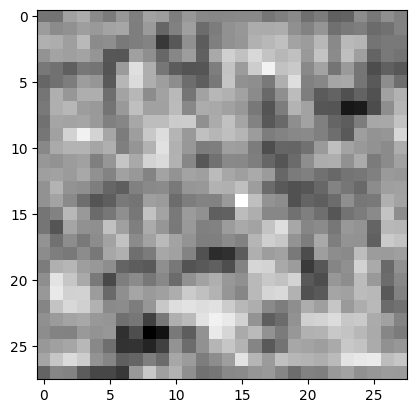

----------------------------------------


Discriminator Loss = 1.228144884109497
Generator Loss = 0.7760864496231079
A sample image generated by the generator


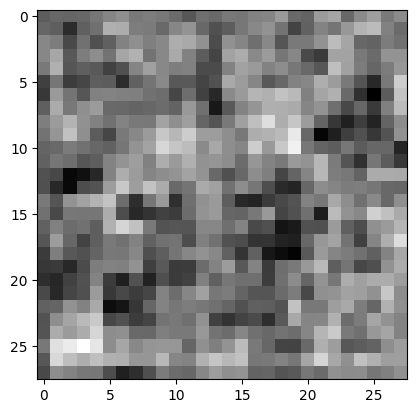

----------------------------------------


Discriminator Loss = 1.3711155652999878
Generator Loss = 0.7388906478881836
A sample image generated by the generator


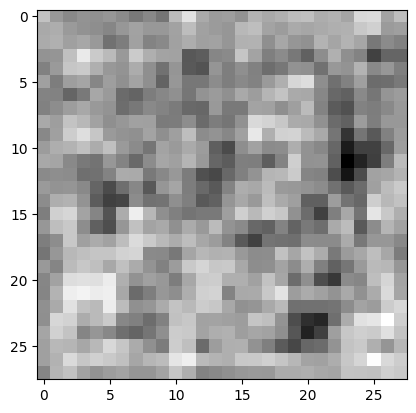

----------------------------------------


Discriminator Loss = 1.3249752521514893
Generator Loss = 0.7694054841995239
A sample image generated by the generator


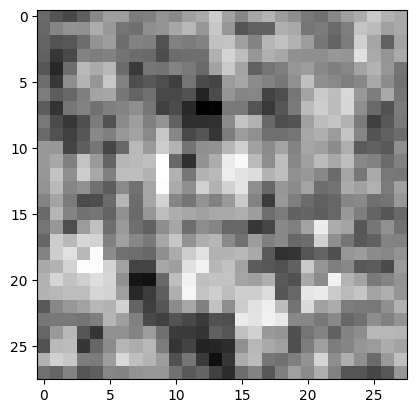

----------------------------------------


Discriminator Loss = 1.293520450592041
Generator Loss = 0.7714781761169434
A sample image generated by the generator


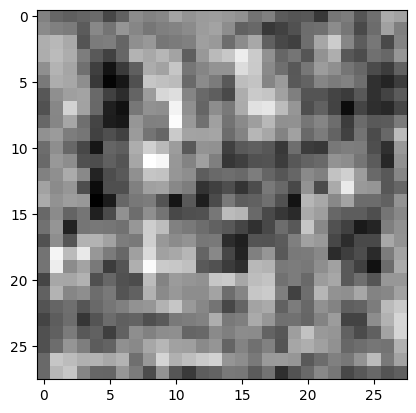

----------------------------------------


Discriminator Loss = 1.2673311233520508
Generator Loss = 0.7923873066902161
A sample image generated by the generator


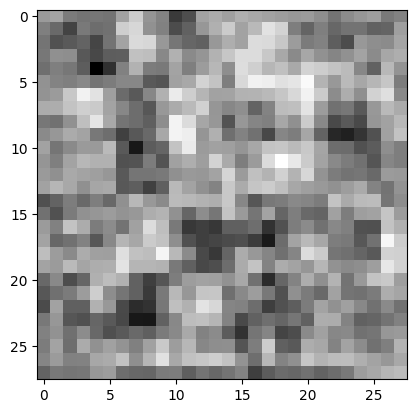

----------------------------------------


Discriminator Loss = 1.2766172885894775
Generator Loss = 0.7305129170417786
A sample image generated by the generator


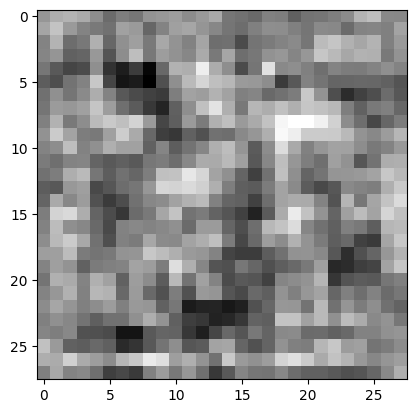

----------------------------------------


Discriminator Loss = 1.2690340280532837
Generator Loss = 0.7720174193382263
A sample image generated by the generator


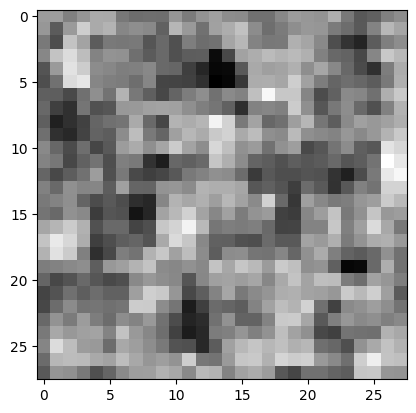

----------------------------------------


Discriminator Loss = 1.2644822597503662
Generator Loss = 0.7661194801330566
A sample image generated by the generator


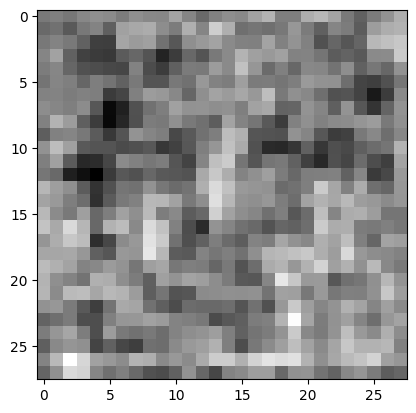

----------------------------------------


Discriminator Loss = 1.2868010997772217
Generator Loss = 0.7267765402793884
A sample image generated by the generator


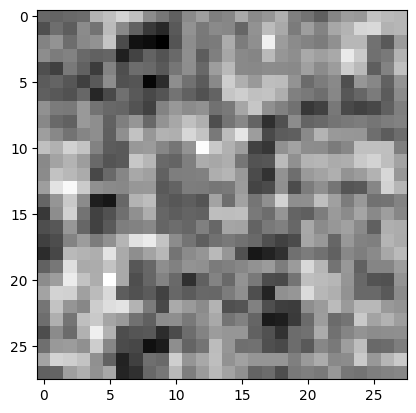

----------------------------------------


Discriminator Loss = 1.2397704124450684
Generator Loss = 0.7474360466003418
A sample image generated by the generator


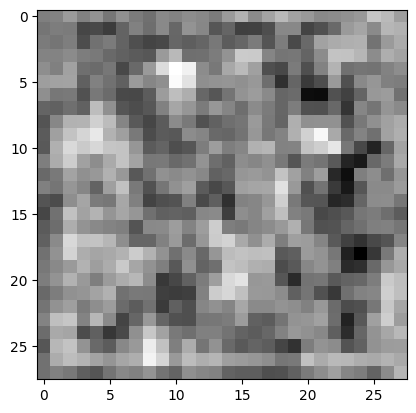

----------------------------------------


Discriminator Loss = 1.181408166885376
Generator Loss = 0.748850405216217
A sample image generated by the generator


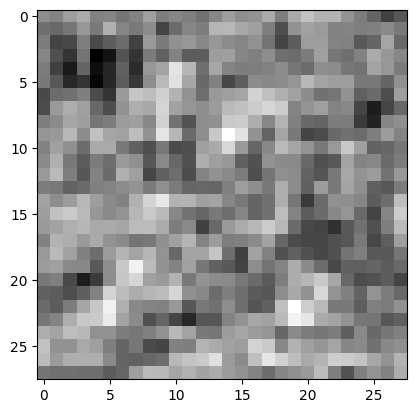

----------------------------------------


Discriminator Loss = 1.2007710933685303
Generator Loss = 0.7484080791473389
A sample image generated by the generator


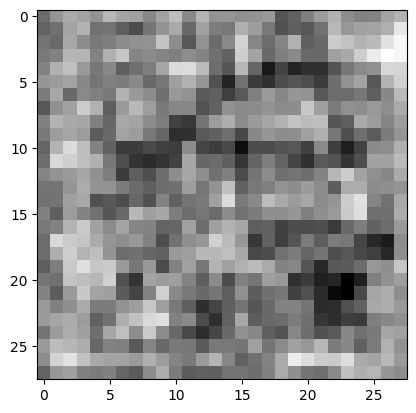

----------------------------------------


Discriminator Loss = 1.2508726119995117
Generator Loss = 0.7759947776794434
A sample image generated by the generator


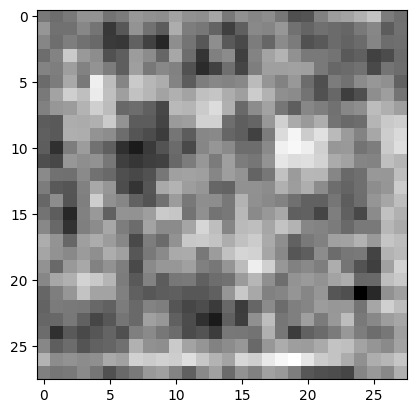

----------------------------------------


Discriminator Loss = 1.2315516471862793
Generator Loss = 0.8221244812011719
A sample image generated by the generator


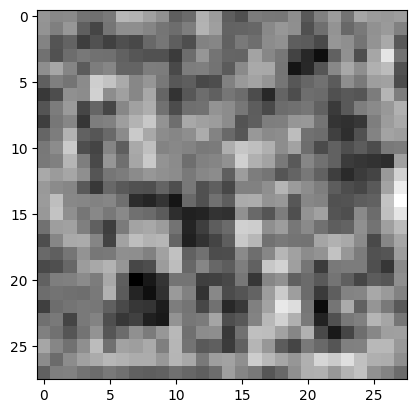

----------------------------------------


Discriminator Loss = 1.1815862655639648
Generator Loss = 0.7877110242843628
A sample image generated by the generator


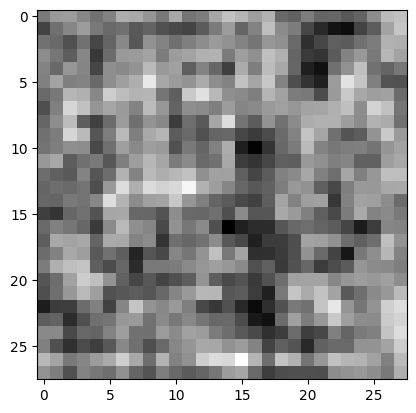

----------------------------------------


Discriminator Loss = 1.1728750467300415
Generator Loss = 0.7920829653739929
A sample image generated by the generator


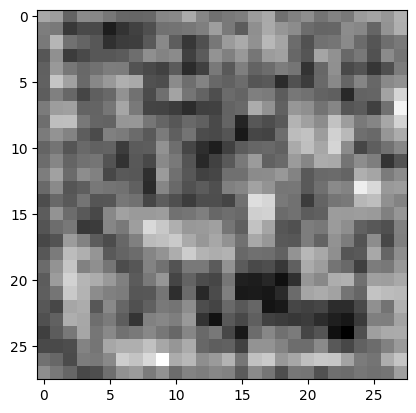

----------------------------------------


Discriminator Loss = 1.305387020111084
Generator Loss = 0.7985296249389648
A sample image generated by the generator


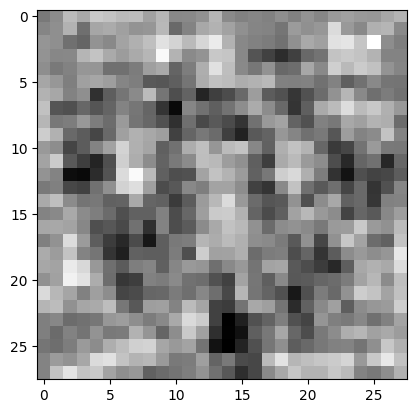

----------------------------------------


Discriminator Loss = 1.20068359375
Generator Loss = 0.778591513633728
A sample image generated by the generator


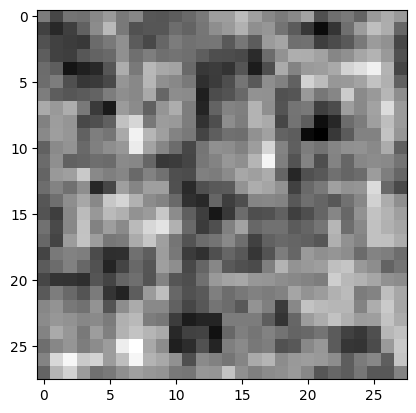

----------------------------------------


Discriminator Loss = 1.210813283920288
Generator Loss = 0.8533802032470703
A sample image generated by the generator


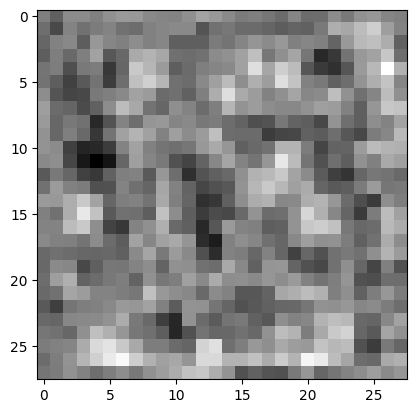

----------------------------------------


Discriminator Loss = 1.2041208744049072
Generator Loss = 0.8763771057128906
A sample image generated by the generator


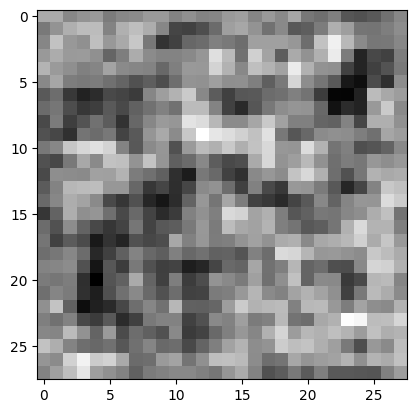

----------------------------------------


Discriminator Loss = 1.1929755210876465
Generator Loss = 0.819348156452179
A sample image generated by the generator


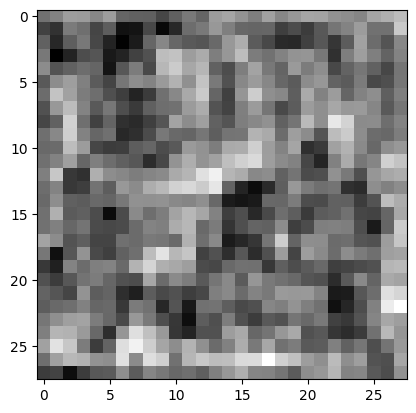

----------------------------------------


Discriminator Loss = 1.196500539779663
Generator Loss = 0.8282167911529541
A sample image generated by the generator


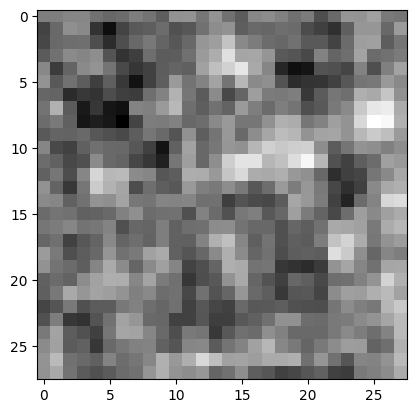

----------------------------------------


Discriminator Loss = 1.2102007865905762
Generator Loss = 0.8527228832244873
A sample image generated by the generator


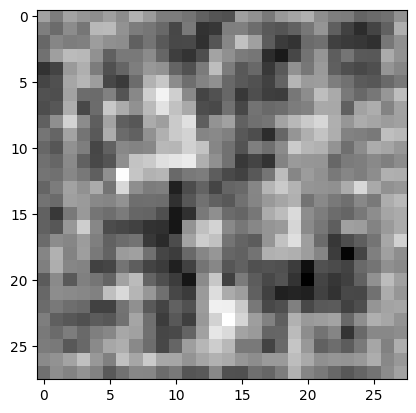

----------------------------------------


Discriminator Loss = 1.196132779121399
Generator Loss = 0.8323928117752075
A sample image generated by the generator


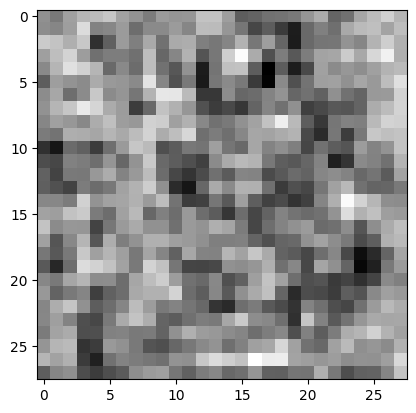

----------------------------------------


Discriminator Loss = 1.202466607093811
Generator Loss = 0.8505178689956665
A sample image generated by the generator


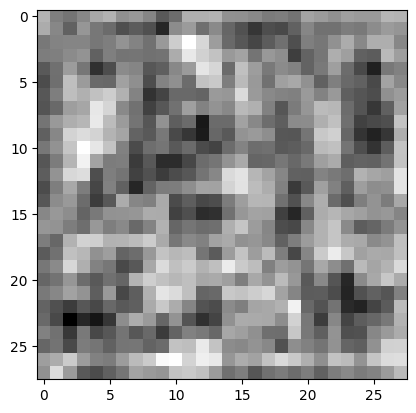

----------------------------------------


Discriminator Loss = 1.2311460971832275
Generator Loss = 0.8916252851486206
A sample image generated by the generator


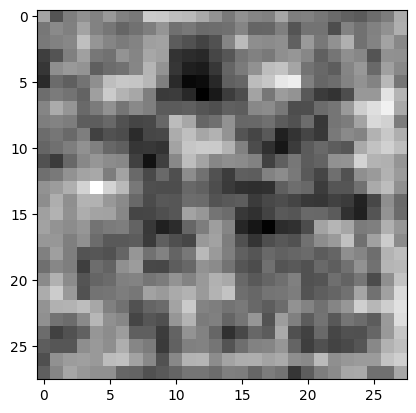

----------------------------------------


Discriminator Loss = 1.211073637008667
Generator Loss = 0.8902533054351807
A sample image generated by the generator


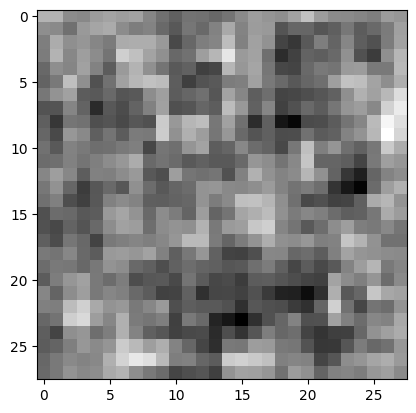

----------------------------------------


Discriminator Loss = 1.1723244190216064
Generator Loss = 0.8719357848167419
A sample image generated by the generator


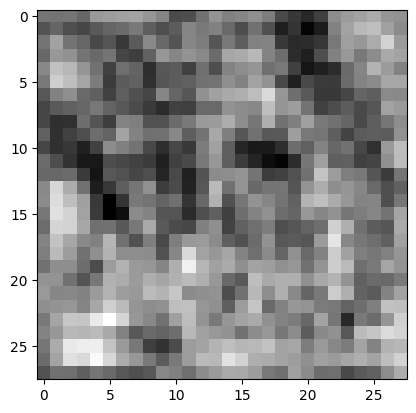

----------------------------------------


Discriminator Loss = 1.140244483947754
Generator Loss = 0.8544164299964905
A sample image generated by the generator


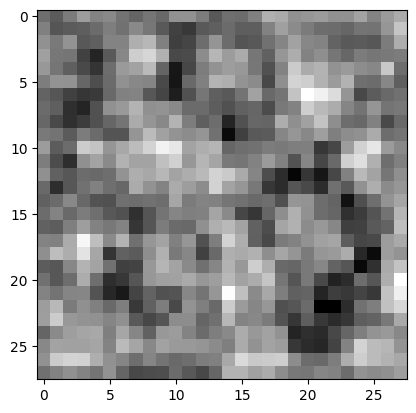

----------------------------------------


Discriminator Loss = 1.1511156558990479
Generator Loss = 0.845046877861023
A sample image generated by the generator


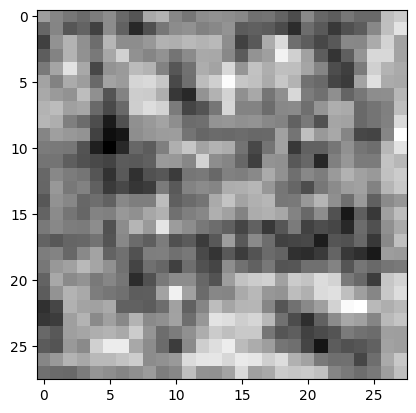

----------------------------------------


Discriminator Loss = 1.1236112117767334
Generator Loss = 0.8841578960418701
A sample image generated by the generator


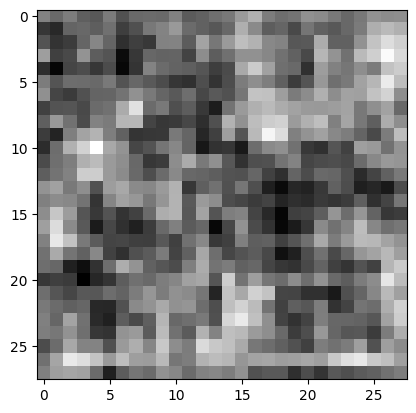

----------------------------------------


Discriminator Loss = 1.1892902851104736
Generator Loss = 0.8433035612106323
A sample image generated by the generator


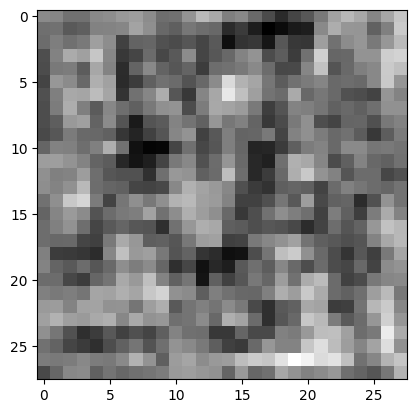

----------------------------------------


Discriminator Loss = 1.171297311782837
Generator Loss = 0.8599868416786194
A sample image generated by the generator


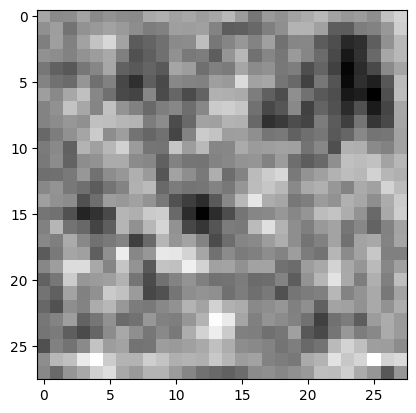

----------------------------------------


Discriminator Loss = 1.0862432718276978
Generator Loss = 0.8961981534957886
A sample image generated by the generator


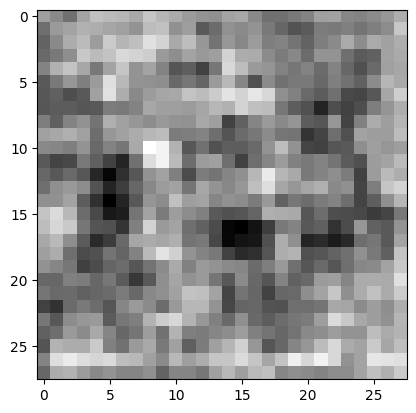

----------------------------------------


Discriminator Loss = 1.1457805633544922
Generator Loss = 0.8815832138061523
A sample image generated by the generator


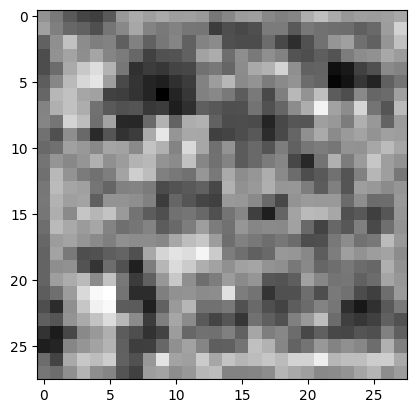

----------------------------------------


Discriminator Loss = 1.091695785522461
Generator Loss = 0.8705186247825623
A sample image generated by the generator


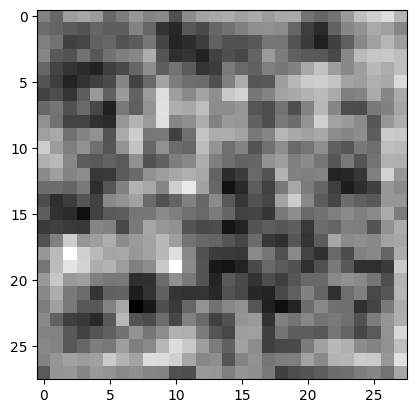

----------------------------------------


Discriminator Loss = 1.1583023071289062
Generator Loss = 0.8410012722015381
A sample image generated by the generator


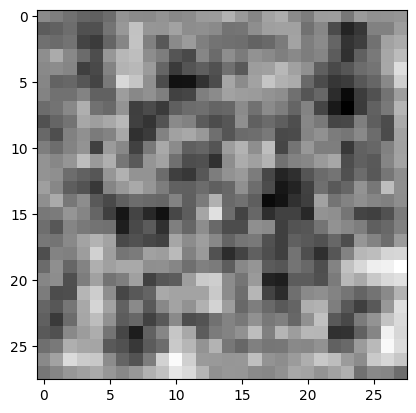

----------------------------------------


Discriminator Loss = 1.092210054397583
Generator Loss = 0.9014174938201904
A sample image generated by the generator


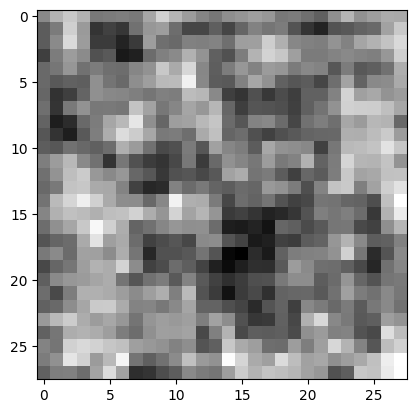

----------------------------------------


Discriminator Loss = 1.1103297472000122
Generator Loss = 0.8452321290969849
A sample image generated by the generator


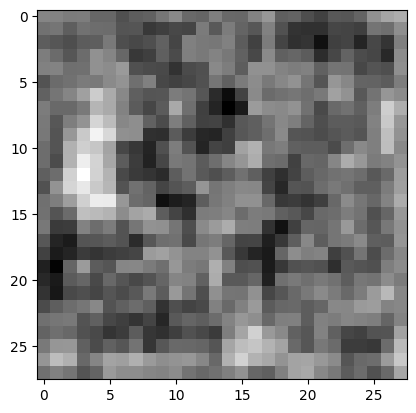

----------------------------------------


Discriminator Loss = 1.0903576612472534
Generator Loss = 0.8888676166534424
A sample image generated by the generator


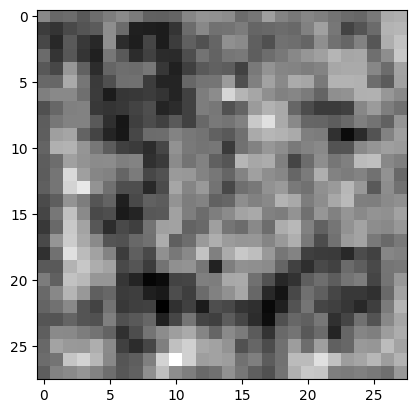

----------------------------------------


Discriminator Loss = 1.178565263748169
Generator Loss = 0.8990175724029541
A sample image generated by the generator


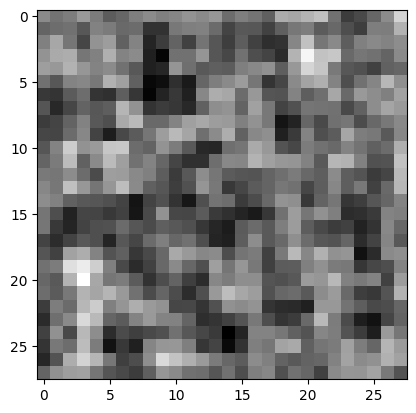

----------------------------------------


Discriminator Loss = 1.112336277961731
Generator Loss = 0.910705029964447
A sample image generated by the generator


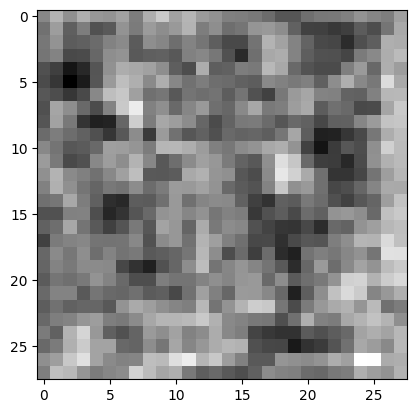

----------------------------------------


Discriminator Loss = 1.107810378074646
Generator Loss = 0.8977606296539307
A sample image generated by the generator


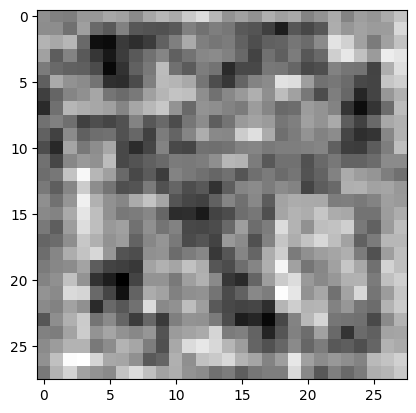

----------------------------------------


Discriminator Loss = 1.1362196207046509
Generator Loss = 0.881428062915802
A sample image generated by the generator


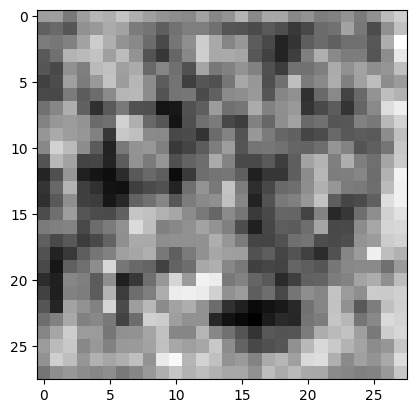

----------------------------------------


Discriminator Loss = 1.089827060699463
Generator Loss = 0.8772289752960205
A sample image generated by the generator


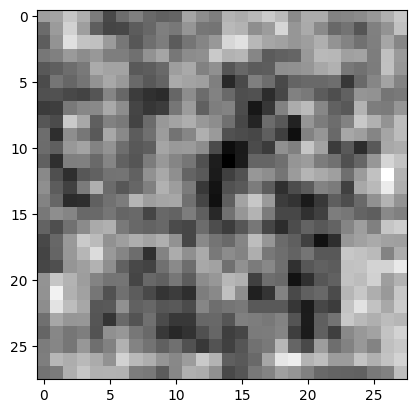

----------------------------------------


Discriminator Loss = 1.1204639673233032
Generator Loss = 0.9025393128395081
A sample image generated by the generator


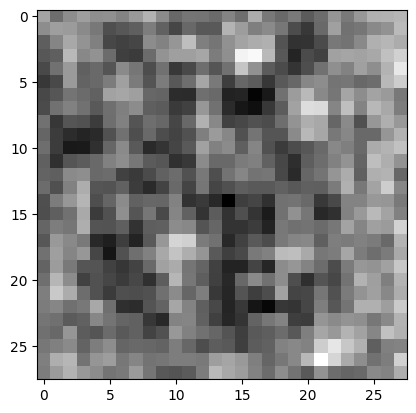

----------------------------------------


Discriminator Loss = 1.077683448791504
Generator Loss = 0.8676440715789795
A sample image generated by the generator


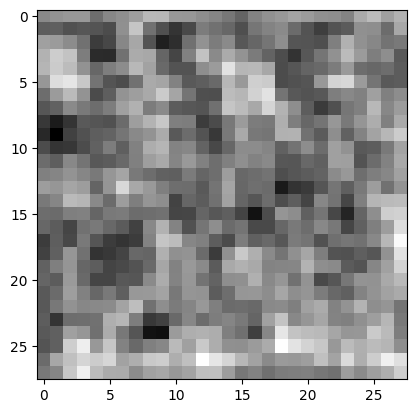

----------------------------------------


Discriminator Loss = 1.111926794052124
Generator Loss = 0.8572473526000977
A sample image generated by the generator


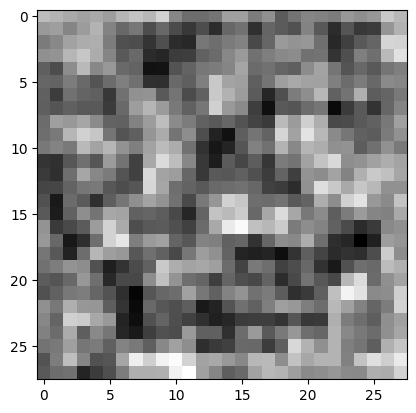

----------------------------------------


Discriminator Loss = 1.0991718769073486
Generator Loss = 0.9154567122459412
A sample image generated by the generator


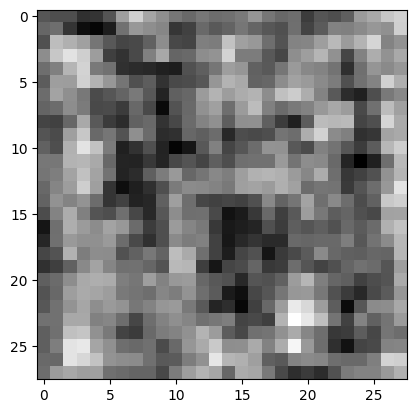

----------------------------------------


Discriminator Loss = 1.106447696685791
Generator Loss = 0.945218563079834
A sample image generated by the generator


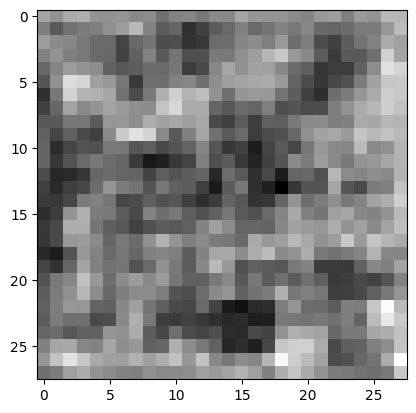

----------------------------------------


Discriminator Loss = 1.0959270000457764
Generator Loss = 0.8877129554748535
A sample image generated by the generator


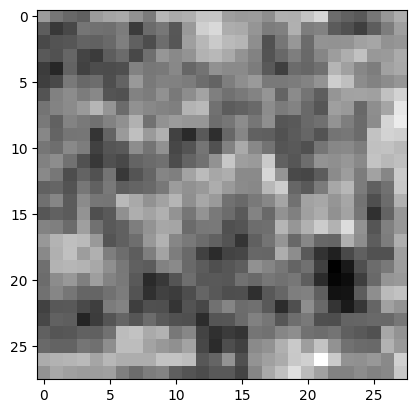

----------------------------------------


Discriminator Loss = 1.0977776050567627
Generator Loss = 0.92002272605896
A sample image generated by the generator


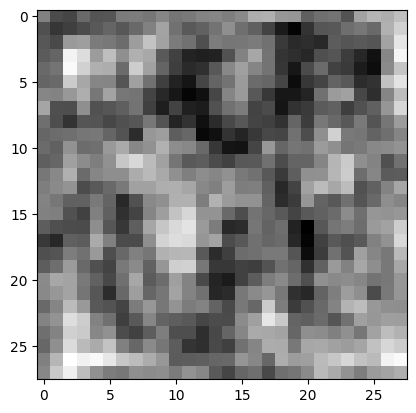

----------------------------------------


Discriminator Loss = 1.0557489395141602
Generator Loss = 0.9176197052001953
A sample image generated by the generator


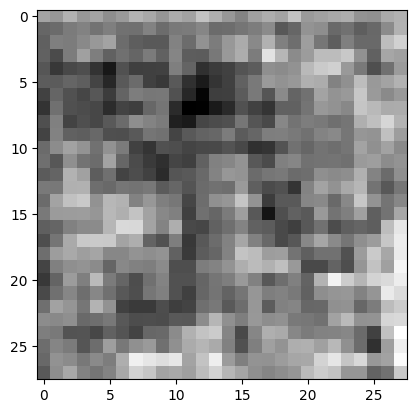

----------------------------------------


Discriminator Loss = 1.085984468460083
Generator Loss = 0.8963066935539246
A sample image generated by the generator


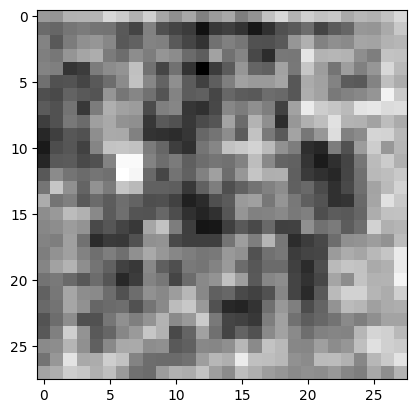

----------------------------------------


Discriminator Loss = 1.0626106262207031
Generator Loss = 0.9076731204986572
A sample image generated by the generator


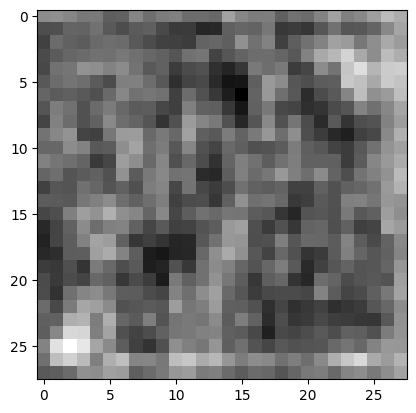

----------------------------------------


Discriminator Loss = 1.096541166305542
Generator Loss = 0.9404759407043457
A sample image generated by the generator


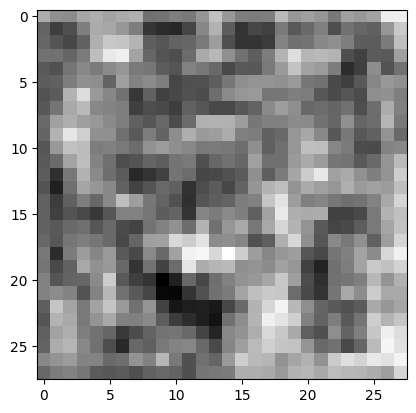

----------------------------------------


Discriminator Loss = 1.0332183837890625
Generator Loss = 0.9620189070701599
A sample image generated by the generator


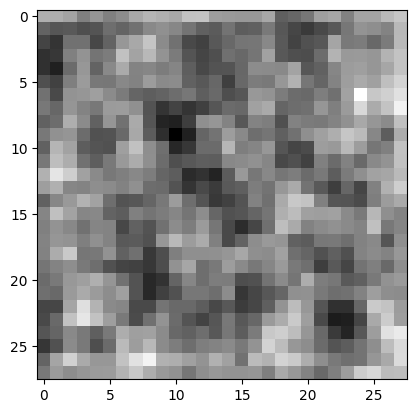

----------------------------------------


Discriminator Loss = 1.0996713638305664
Generator Loss = 0.8847630023956299
A sample image generated by the generator


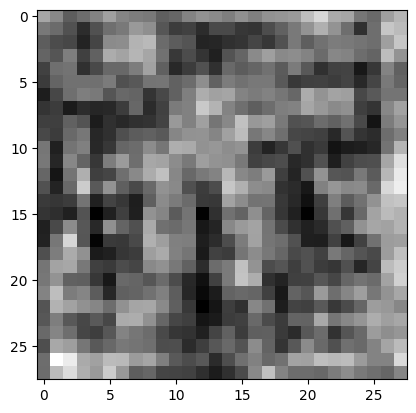

----------------------------------------


Discriminator Loss = 1.0726287364959717
Generator Loss = 0.9466413259506226
A sample image generated by the generator


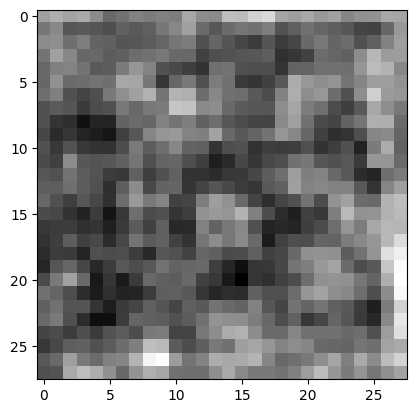

----------------------------------------


Discriminator Loss = 1.0243451595306396
Generator Loss = 0.9353047609329224
A sample image generated by the generator


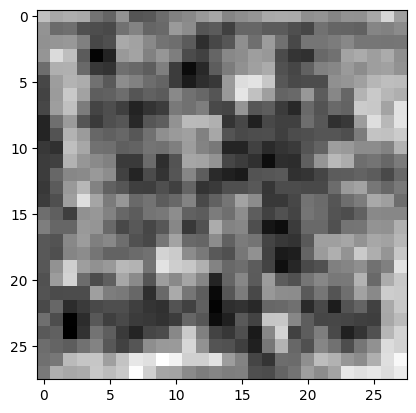

----------------------------------------


Discriminator Loss = 1.0891073942184448
Generator Loss = 0.9341939687728882
A sample image generated by the generator


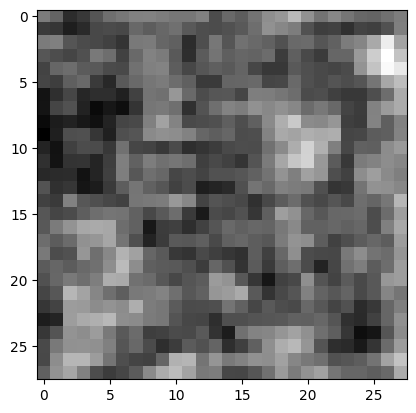

----------------------------------------


Discriminator Loss = 1.1087627410888672
Generator Loss = 0.936119794845581
A sample image generated by the generator


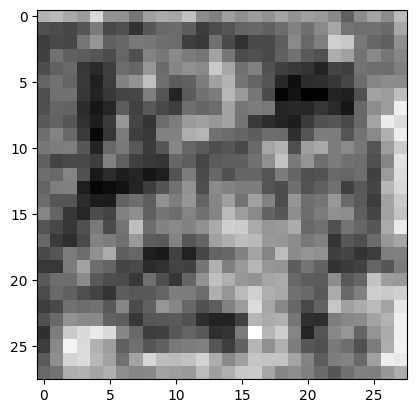

----------------------------------------


Discriminator Loss = 1.0488322973251343
Generator Loss = 0.9558456540107727
A sample image generated by the generator


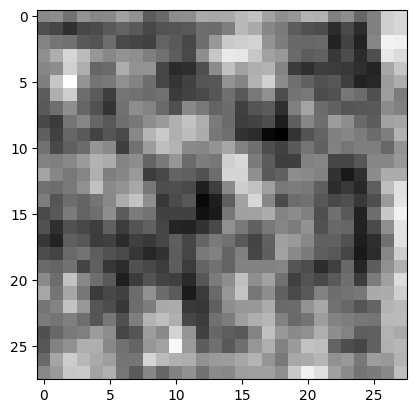

----------------------------------------


Discriminator Loss = 1.022214412689209
Generator Loss = 0.9285745024681091
A sample image generated by the generator


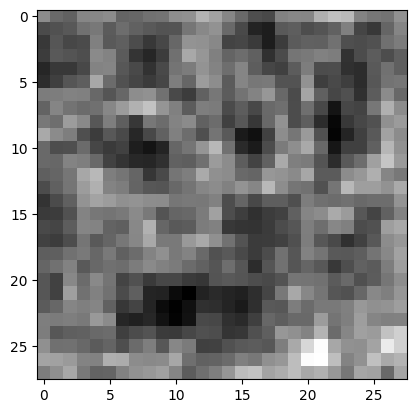

----------------------------------------


Discriminator Loss = 1.0504939556121826
Generator Loss = 0.931003749370575
A sample image generated by the generator


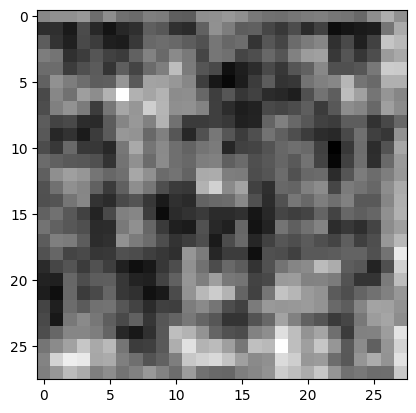

----------------------------------------


Discriminator Loss = 1.064316987991333
Generator Loss = 0.9618015289306641
A sample image generated by the generator


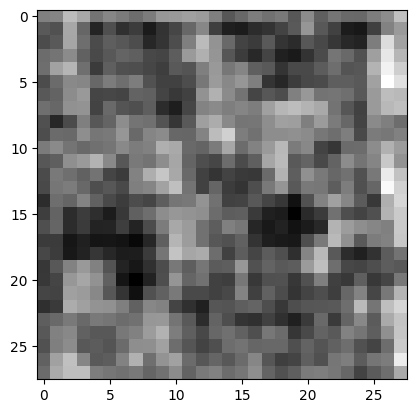

----------------------------------------


Discriminator Loss = 1.013383150100708
Generator Loss = 0.9599530696868896
A sample image generated by the generator


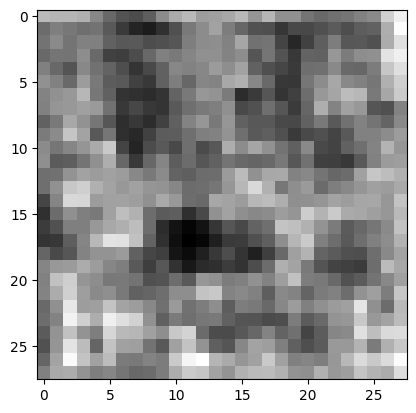

----------------------------------------


Discriminator Loss = 1.0143446922302246
Generator Loss = 0.970284640789032
A sample image generated by the generator


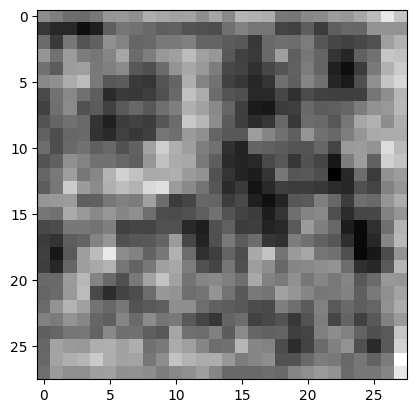

----------------------------------------


Discriminator Loss = 1.0795382261276245
Generator Loss = 0.8942683935165405
A sample image generated by the generator


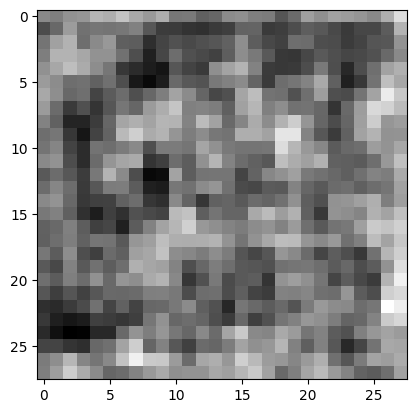

----------------------------------------


Discriminator Loss = 1.057175636291504
Generator Loss = 0.9833842515945435
A sample image generated by the generator


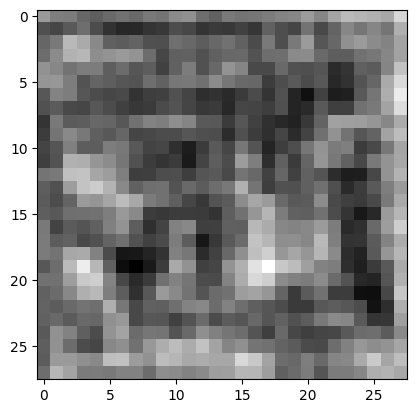

----------------------------------------


Discriminator Loss = 0.986217737197876
Generator Loss = 0.9602518677711487
A sample image generated by the generator


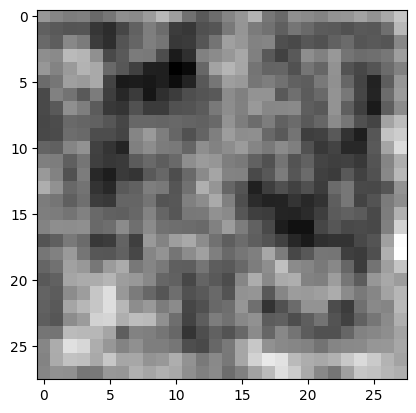

----------------------------------------


Discriminator Loss = 1.0573019981384277
Generator Loss = 0.921309232711792
A sample image generated by the generator


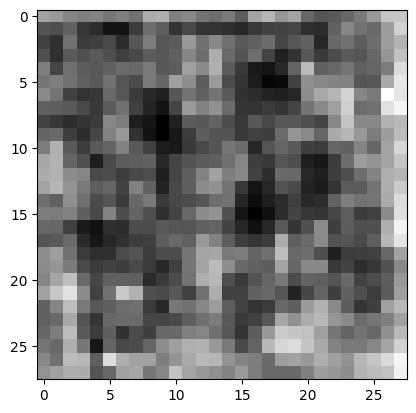

----------------------------------------


Discriminator Loss = 1.0062532424926758
Generator Loss = 0.9765964150428772
A sample image generated by the generator


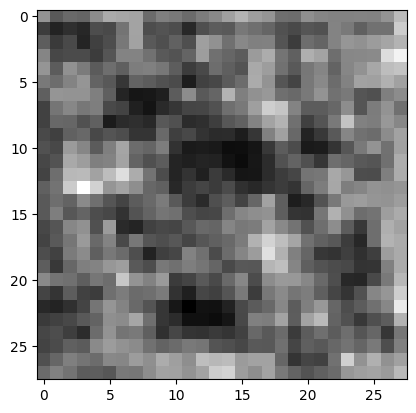

----------------------------------------


Discriminator Loss = 0.9898483753204346
Generator Loss = 0.9281724095344543
A sample image generated by the generator


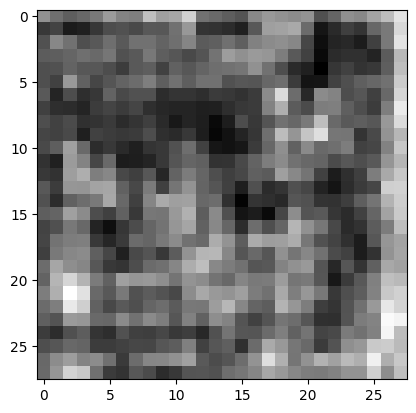

----------------------------------------


Discriminator Loss = 1.0083677768707275
Generator Loss = 0.9540653824806213
A sample image generated by the generator


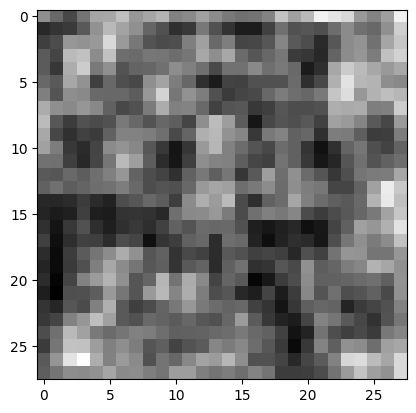

----------------------------------------


Discriminator Loss = 0.9855034947395325
Generator Loss = 1.0123659372329712
A sample image generated by the generator


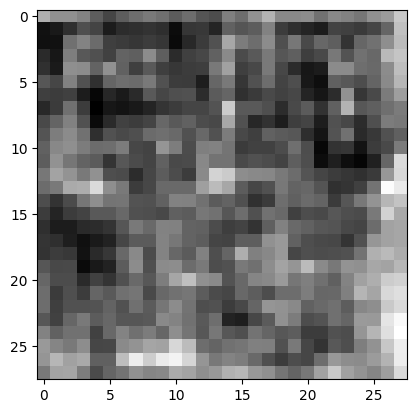

----------------------------------------


Discriminator Loss = 1.0058997869491577
Generator Loss = 0.9932364225387573
A sample image generated by the generator


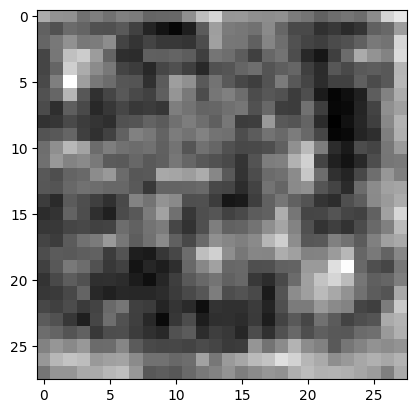

----------------------------------------


Discriminator Loss = 1.057607650756836
Generator Loss = 0.9600756168365479
A sample image generated by the generator


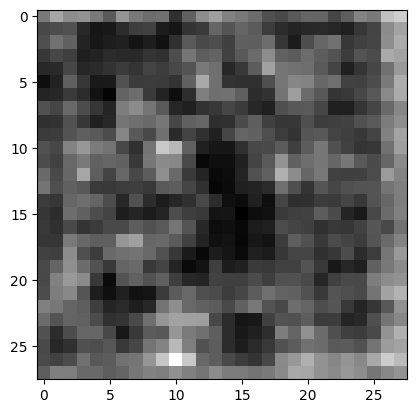

----------------------------------------


Discriminator Loss = 1.0261149406433105
Generator Loss = 0.9082634449005127
A sample image generated by the generator


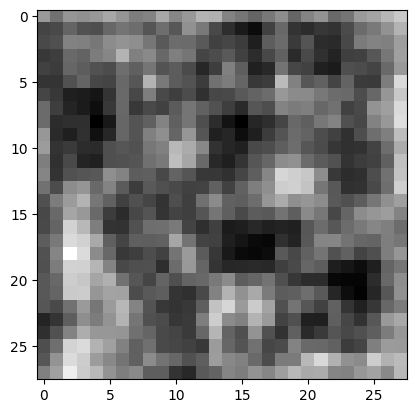

----------------------------------------


Discriminator Loss = 1.059474229812622
Generator Loss = 0.9526466131210327
A sample image generated by the generator


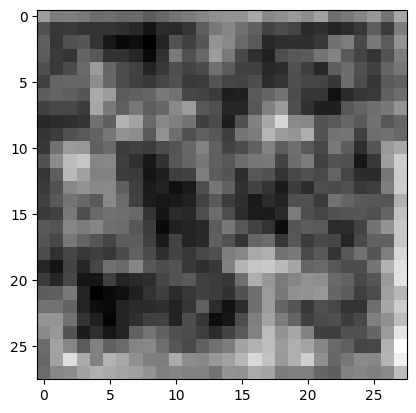

----------------------------------------


Discriminator Loss = 1.0578794479370117
Generator Loss = 0.9325865507125854
A sample image generated by the generator


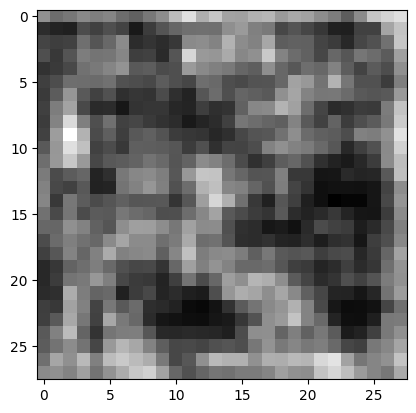

----------------------------------------


Discriminator Loss = 1.0046792030334473
Generator Loss = 0.9922918081283569
A sample image generated by the generator


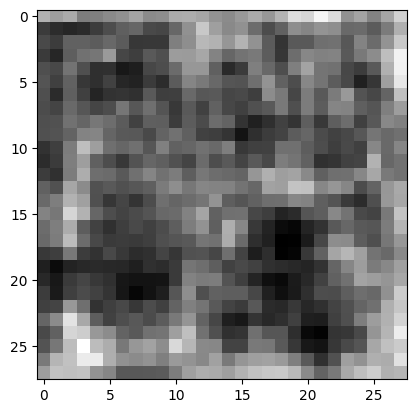

----------------------------------------


Discriminator Loss = 1.0175302028656006
Generator Loss = 0.9991753697395325
A sample image generated by the generator


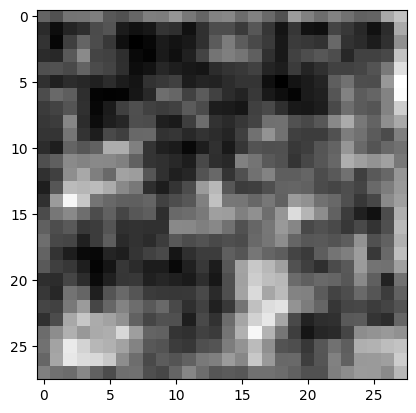

----------------------------------------


Discriminator Loss = 0.9858927726745605
Generator Loss = 0.9972633123397827
A sample image generated by the generator


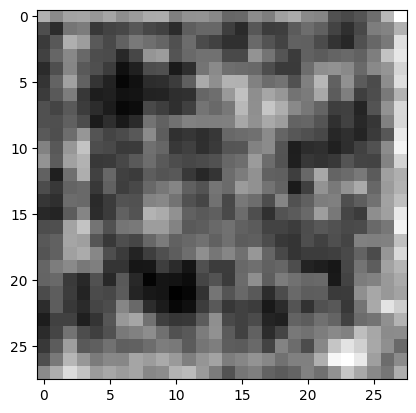

----------------------------------------


Discriminator Loss = 1.0242818593978882
Generator Loss = 1.0246169567108154
A sample image generated by the generator


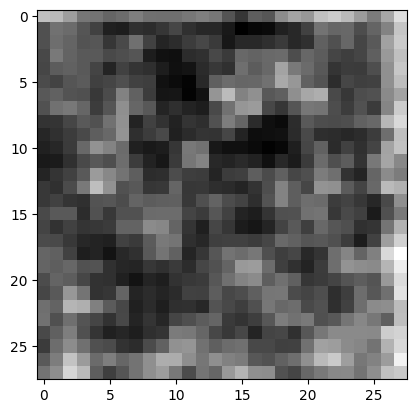

----------------------------------------


Discriminator Loss = 1.0299015045166016
Generator Loss = 0.9455249309539795
A sample image generated by the generator


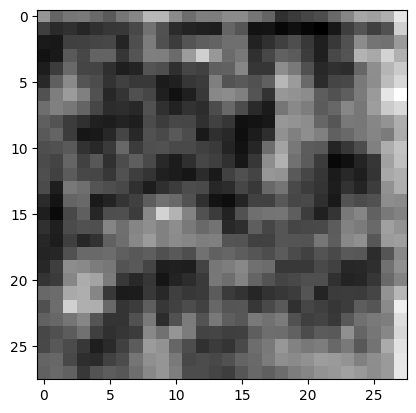

----------------------------------------


Discriminator Loss = 0.9820696115493774
Generator Loss = 0.9658490419387817
A sample image generated by the generator


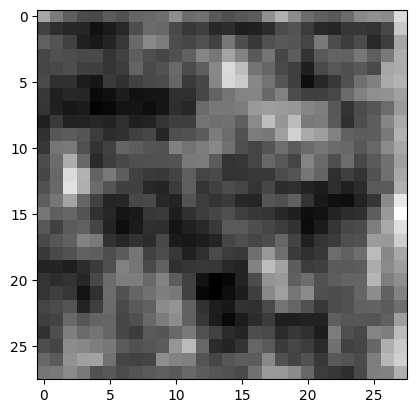

----------------------------------------


Discriminator Loss = 0.9757238030433655
Generator Loss = 0.9475524425506592
A sample image generated by the generator


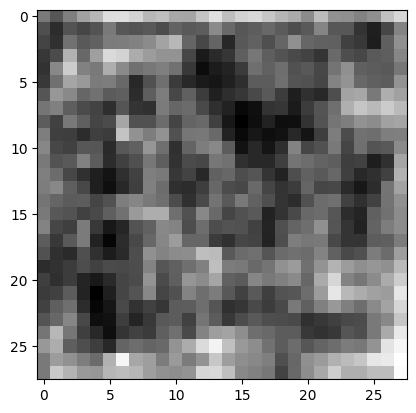

----------------------------------------


Discriminator Loss = 0.9997227787971497
Generator Loss = 0.9566442966461182
A sample image generated by the generator


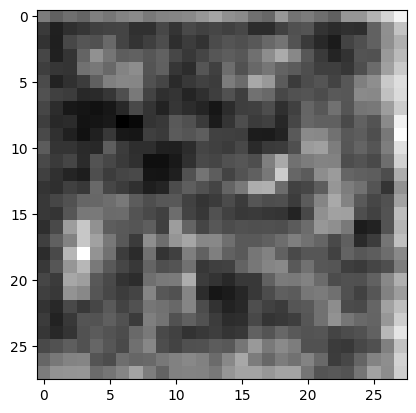

----------------------------------------


Discriminator Loss = 0.936934232711792
Generator Loss = 0.931344211101532
A sample image generated by the generator


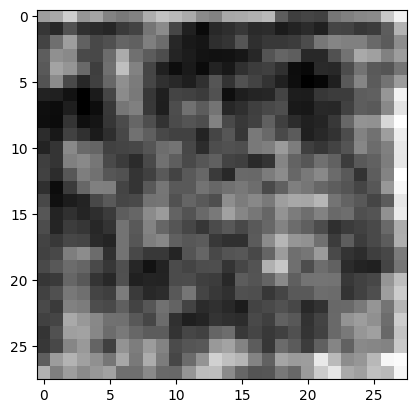

----------------------------------------


Discriminator Loss = 1.026296854019165
Generator Loss = 0.9327738881111145
A sample image generated by the generator


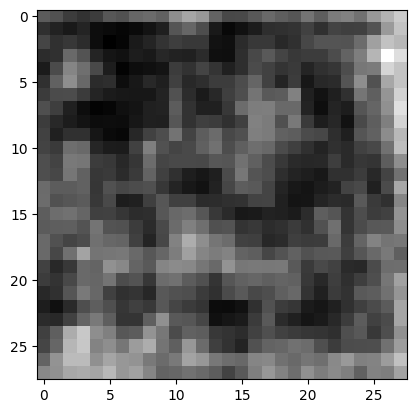

----------------------------------------


Discriminator Loss = 1.0248098373413086
Generator Loss = 0.9786863327026367
A sample image generated by the generator


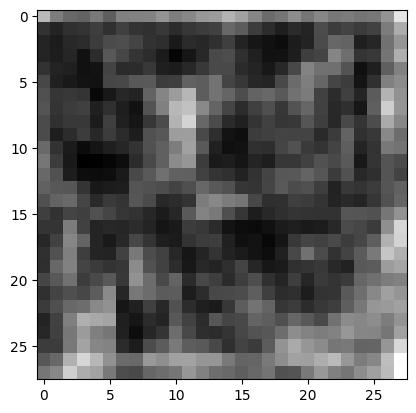

----------------------------------------


Discriminator Loss = 0.9815820455551147
Generator Loss = 0.9093731045722961
A sample image generated by the generator


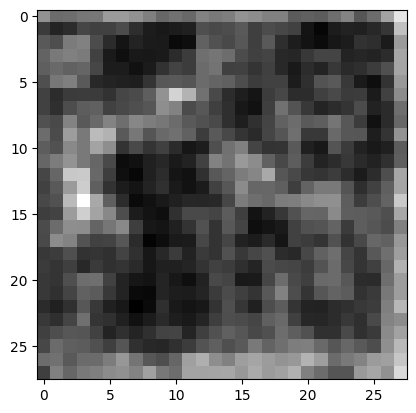

----------------------------------------


Discriminator Loss = 1.0032155513763428
Generator Loss = 0.9973089098930359
A sample image generated by the generator


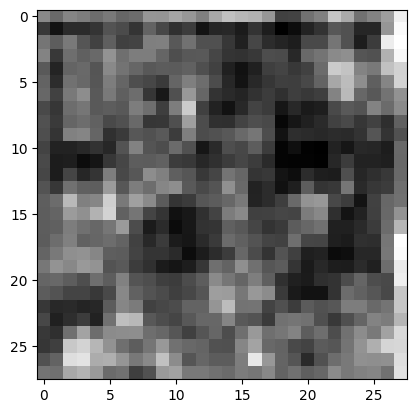

----------------------------------------


Discriminator Loss = 1.0044779777526855
Generator Loss = 0.9496207237243652
A sample image generated by the generator


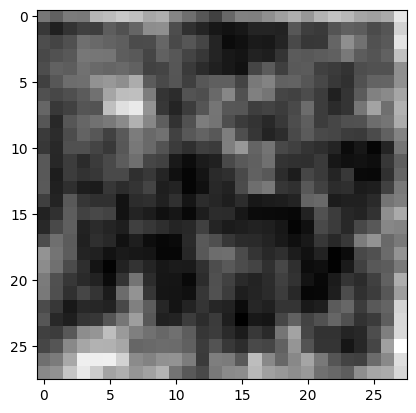

----------------------------------------


Discriminator Loss = 0.9832978248596191
Generator Loss = 0.9192562699317932
A sample image generated by the generator


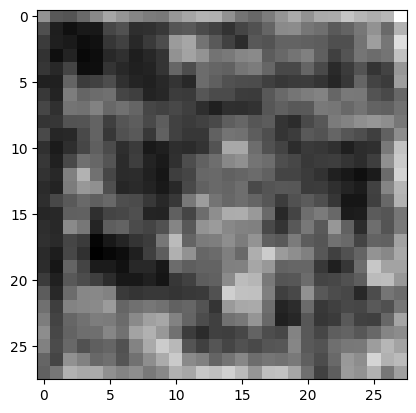

----------------------------------------


Discriminator Loss = 0.922793984413147
Generator Loss = 0.9715490937232971
A sample image generated by the generator


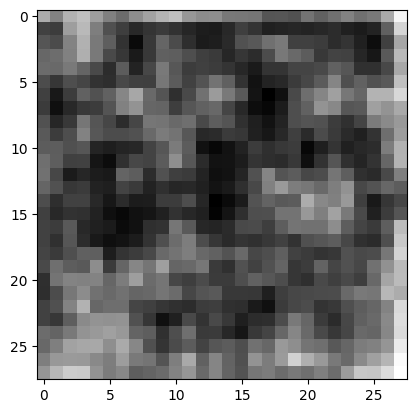

----------------------------------------


Discriminator Loss = 1.0119833946228027
Generator Loss = 0.9320945143699646
A sample image generated by the generator


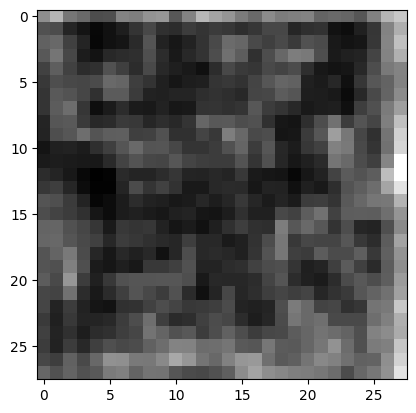

----------------------------------------


Discriminator Loss = 0.9937678575515747
Generator Loss = 0.9700902104377747
A sample image generated by the generator


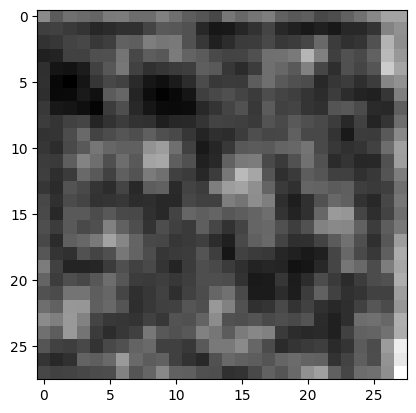

----------------------------------------


Discriminator Loss = 0.9945403933525085
Generator Loss = 0.9896808862686157
A sample image generated by the generator


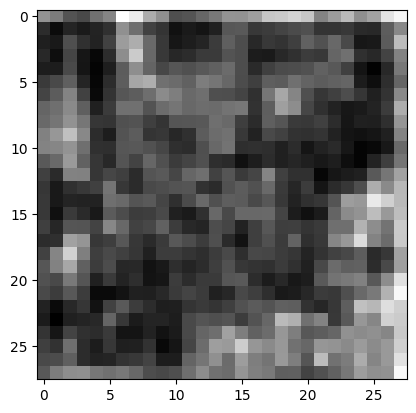

----------------------------------------


Discriminator Loss = 0.9685527086257935
Generator Loss = 0.9757398366928101
A sample image generated by the generator


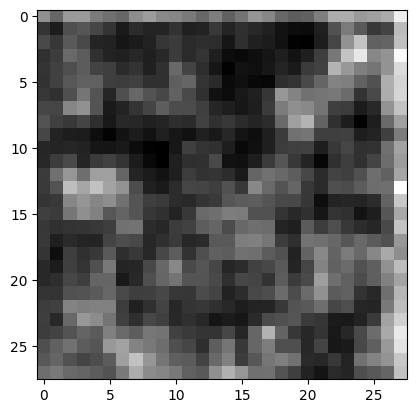

----------------------------------------


Discriminator Loss = 0.9713190793991089
Generator Loss = 1.017778992652893
A sample image generated by the generator


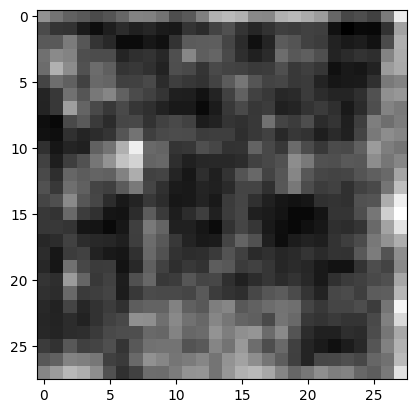

----------------------------------------


Discriminator Loss = 0.9855750799179077
Generator Loss = 0.9819717407226562
A sample image generated by the generator


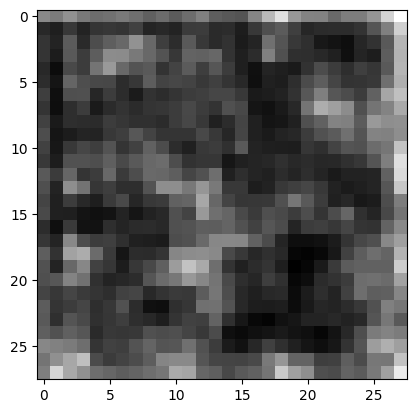

----------------------------------------


Discriminator Loss = 0.9649065732955933
Generator Loss = 1.035631537437439
A sample image generated by the generator


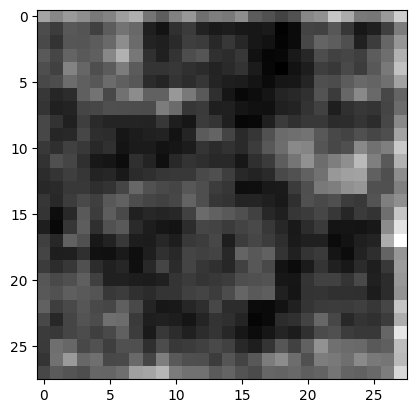

----------------------------------------


Discriminator Loss = 1.0150429010391235
Generator Loss = 0.959872841835022
A sample image generated by the generator


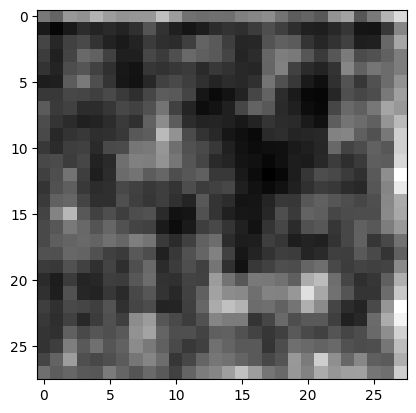

----------------------------------------


Discriminator Loss = 0.972083568572998
Generator Loss = 0.9824321269989014
A sample image generated by the generator


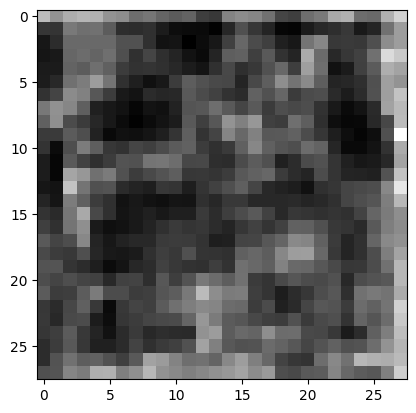

----------------------------------------


Discriminator Loss = 0.995930552482605
Generator Loss = 0.9521180391311646
A sample image generated by the generator


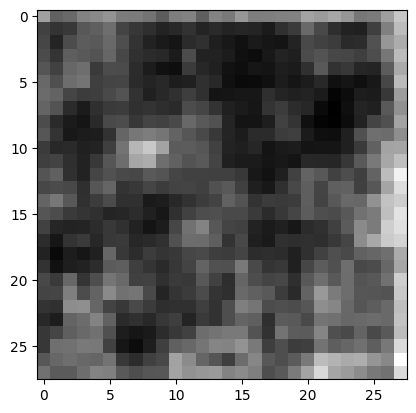

----------------------------------------


Discriminator Loss = 0.971447229385376
Generator Loss = 0.9663752317428589
A sample image generated by the generator


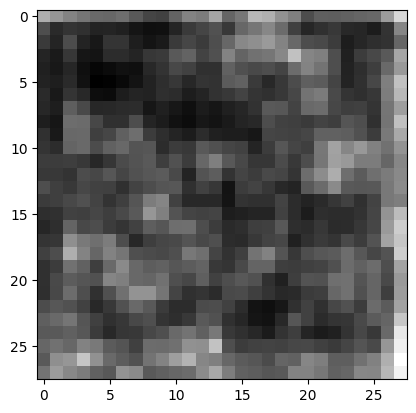

----------------------------------------


Discriminator Loss = 0.9582782983779907
Generator Loss = 0.9558478593826294
A sample image generated by the generator


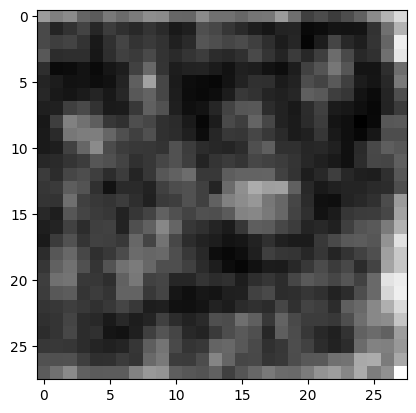

----------------------------------------


Discriminator Loss = 0.971955418586731
Generator Loss = 0.9809360504150391
A sample image generated by the generator


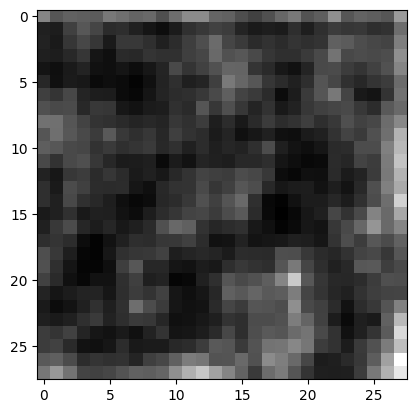

----------------------------------------


Discriminator Loss = 0.9730783104896545
Generator Loss = 0.9898770451545715
A sample image generated by the generator


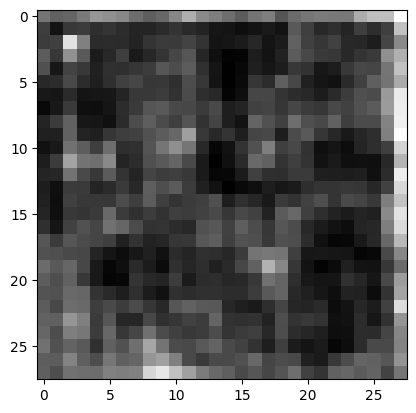

----------------------------------------


Discriminator Loss = 1.0033966302871704
Generator Loss = 0.9549465179443359
A sample image generated by the generator


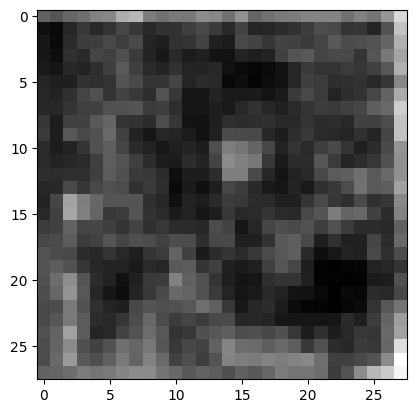

----------------------------------------


Discriminator Loss = 0.9468020796775818
Generator Loss = 0.9845407605171204
A sample image generated by the generator


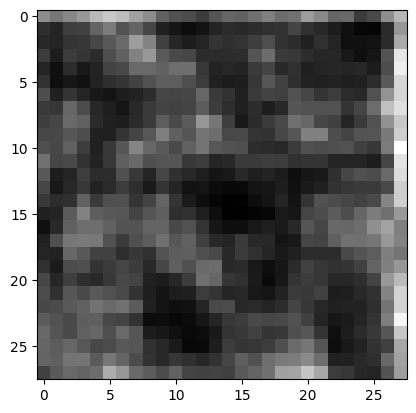

----------------------------------------


Discriminator Loss = 0.9156724214553833
Generator Loss = 0.9926283359527588
A sample image generated by the generator


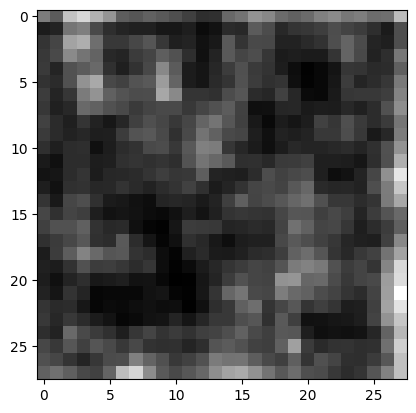

----------------------------------------


Discriminator Loss = 0.9691833257675171
Generator Loss = 0.977480411529541
A sample image generated by the generator


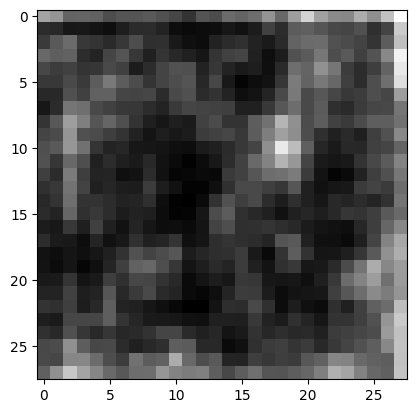

----------------------------------------


Discriminator Loss = 0.9998750686645508
Generator Loss = 0.9629500508308411
A sample image generated by the generator


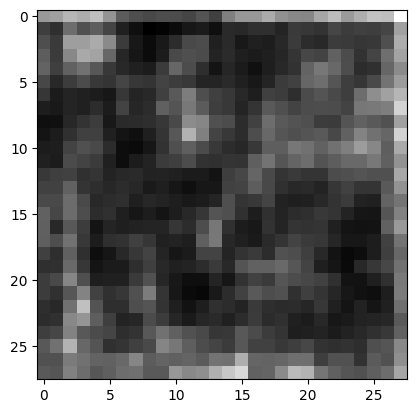

----------------------------------------


Discriminator Loss = 0.9440121650695801
Generator Loss = 0.9585691690444946
A sample image generated by the generator


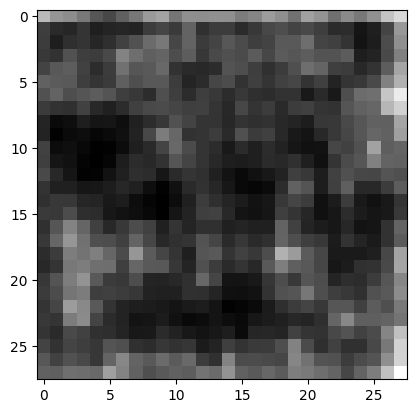

----------------------------------------


Discriminator Loss = 0.9495712518692017
Generator Loss = 1.031206727027893
A sample image generated by the generator


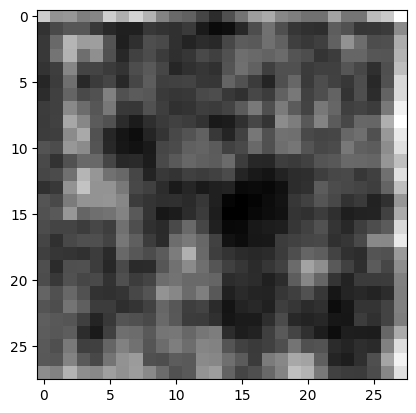

----------------------------------------


Discriminator Loss = 0.9978377819061279
Generator Loss = 1.0113931894302368
A sample image generated by the generator


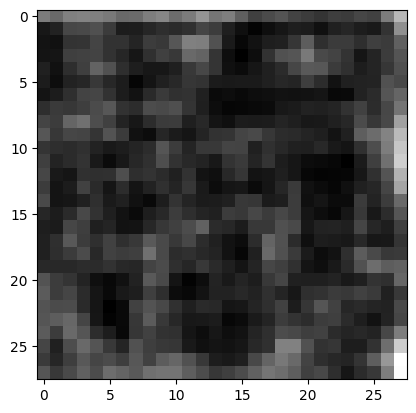

----------------------------------------


Discriminator Loss = 0.9273127317428589
Generator Loss = 1.0332896709442139
A sample image generated by the generator


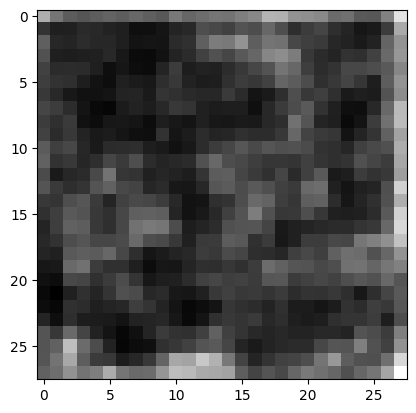

----------------------------------------


Discriminator Loss = 0.9768363237380981
Generator Loss = 1.1031571626663208
A sample image generated by the generator


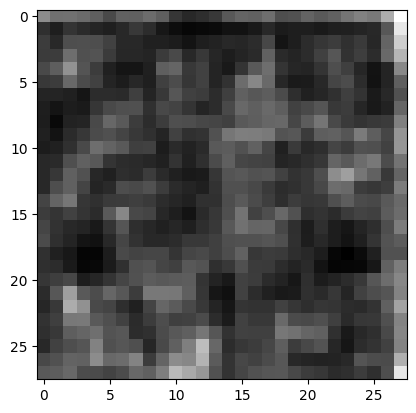

----------------------------------------


Discriminator Loss = 0.9951069355010986
Generator Loss = 1.010768175125122
A sample image generated by the generator


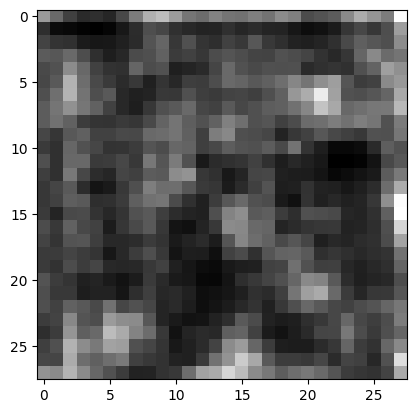

----------------------------------------


Discriminator Loss = 0.9758307933807373
Generator Loss = 1.0103676319122314
A sample image generated by the generator


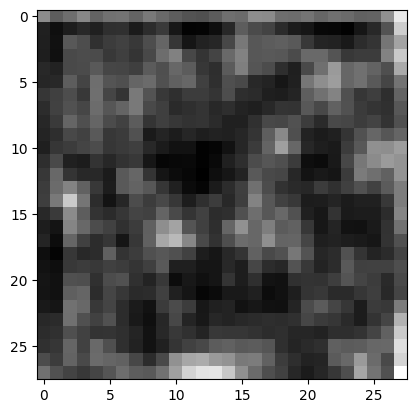

----------------------------------------


Discriminator Loss = 0.9183928966522217
Generator Loss = 1.0234066247940063
A sample image generated by the generator


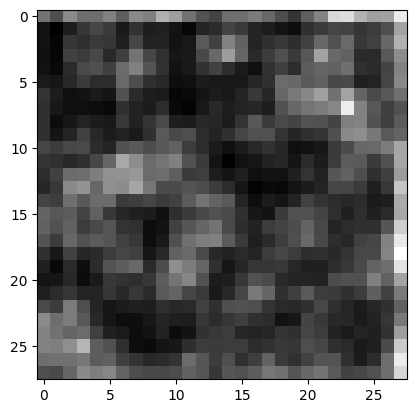

----------------------------------------


Discriminator Loss = 0.9888966083526611
Generator Loss = 1.0423890352249146
A sample image generated by the generator


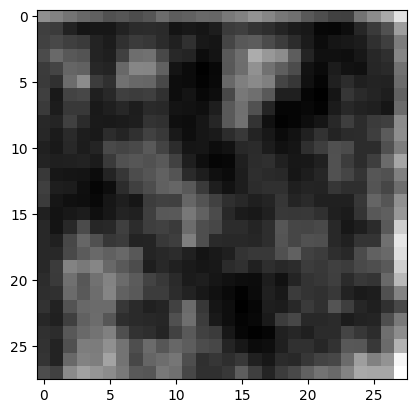

----------------------------------------


Discriminator Loss = 0.9755826592445374
Generator Loss = 0.9711651802062988
A sample image generated by the generator


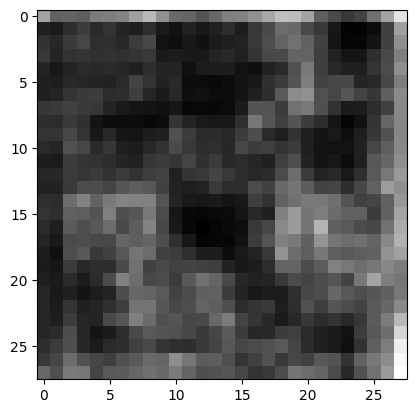

----------------------------------------


Discriminator Loss = 0.9672079086303711
Generator Loss = 0.950750470161438
A sample image generated by the generator


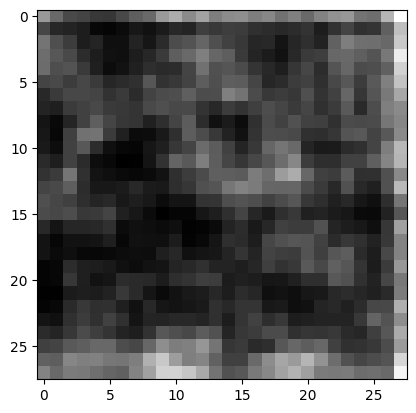

----------------------------------------


Discriminator Loss = 0.9459395408630371
Generator Loss = 0.9538894891738892
A sample image generated by the generator


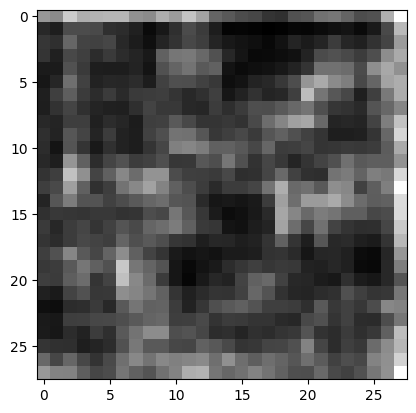

----------------------------------------


Discriminator Loss = 0.93758225440979
Generator Loss = 0.9990657567977905
A sample image generated by the generator


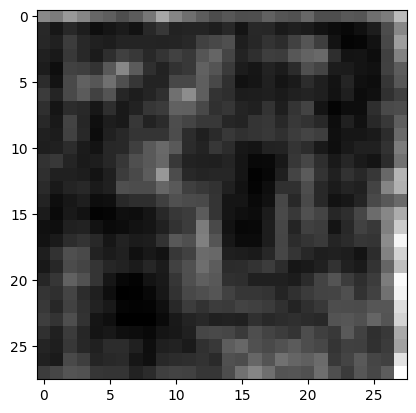

----------------------------------------


Discriminator Loss = 0.9683805108070374
Generator Loss = 0.971656858921051
A sample image generated by the generator


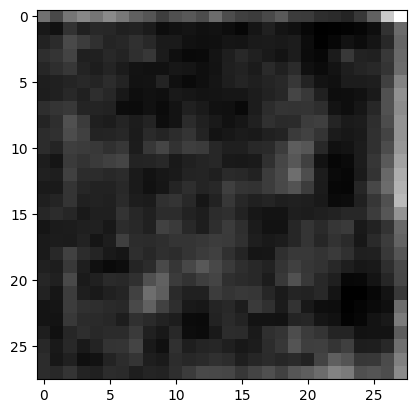

----------------------------------------


Discriminator Loss = 0.897223174571991
Generator Loss = 1.0799694061279297
A sample image generated by the generator


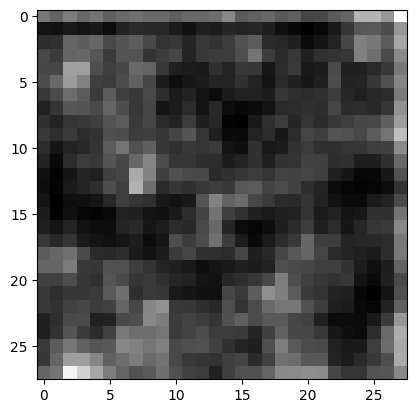

----------------------------------------


Discriminator Loss = 0.9292507171630859
Generator Loss = 0.9380389451980591
A sample image generated by the generator


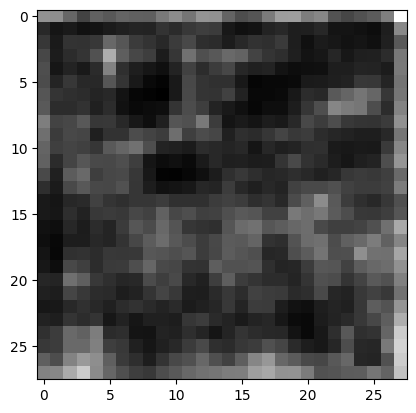

----------------------------------------


Discriminator Loss = 0.9047549962997437
Generator Loss = 0.9989372491836548
A sample image generated by the generator


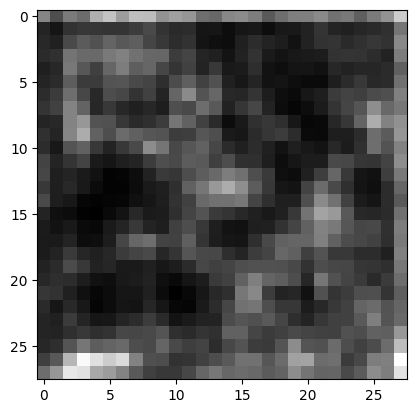

----------------------------------------


Discriminator Loss = 0.9638566970825195
Generator Loss = 1.0537288188934326
A sample image generated by the generator


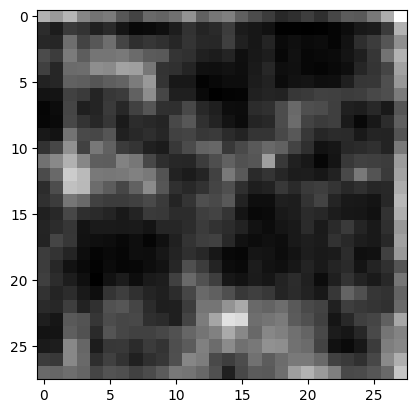

----------------------------------------


Discriminator Loss = 0.911700963973999
Generator Loss = 0.9925791025161743
A sample image generated by the generator


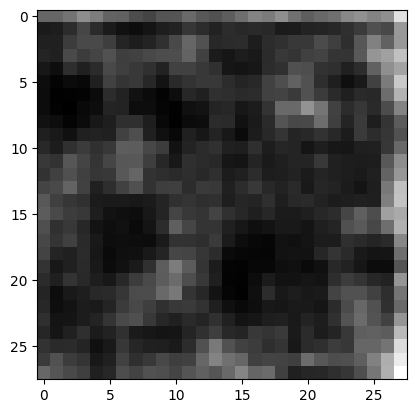

----------------------------------------


Discriminator Loss = 0.915337085723877
Generator Loss = 1.0555377006530762
A sample image generated by the generator


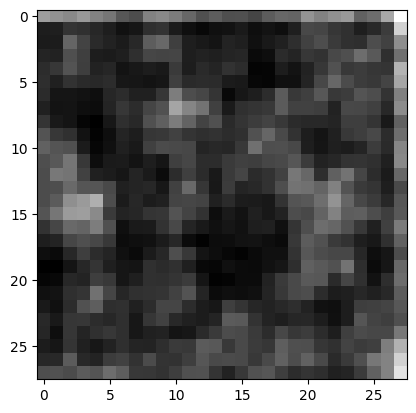

----------------------------------------


Discriminator Loss = 0.9171326160430908
Generator Loss = 0.991219162940979
A sample image generated by the generator


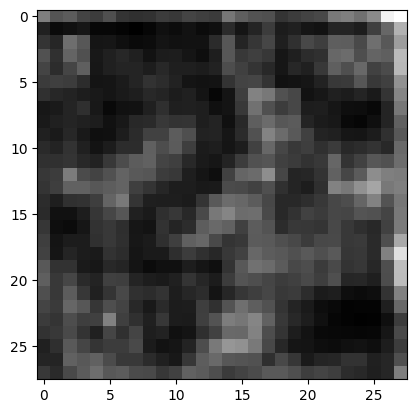

----------------------------------------


Discriminator Loss = 0.9797484874725342
Generator Loss = 1.0354368686676025
A sample image generated by the generator


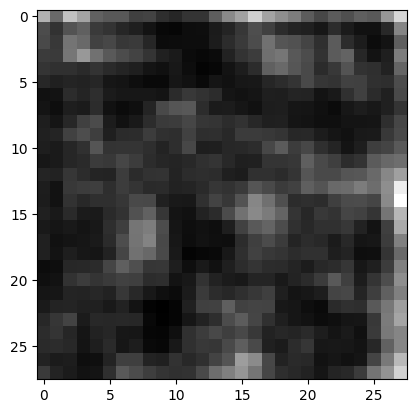

----------------------------------------


Discriminator Loss = 0.9127964973449707
Generator Loss = 0.9865827560424805
A sample image generated by the generator


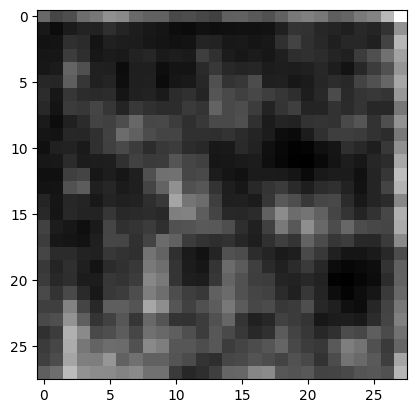

----------------------------------------


Discriminator Loss = 0.9294965267181396
Generator Loss = 1.0052298307418823
A sample image generated by the generator


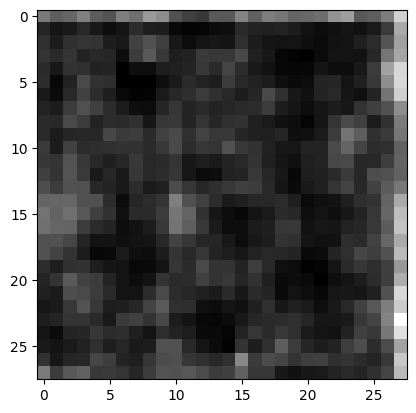

----------------------------------------


Discriminator Loss = 0.8800427317619324
Generator Loss = 1.0100817680358887
A sample image generated by the generator


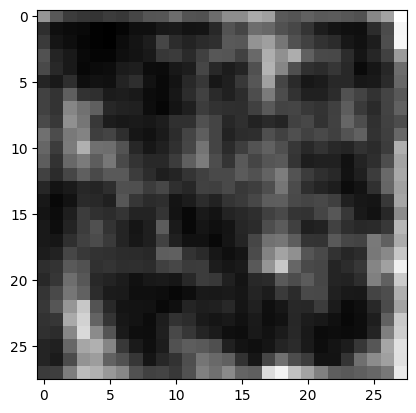

----------------------------------------


Discriminator Loss = 0.8846876621246338
Generator Loss = 1.0062756538391113
A sample image generated by the generator


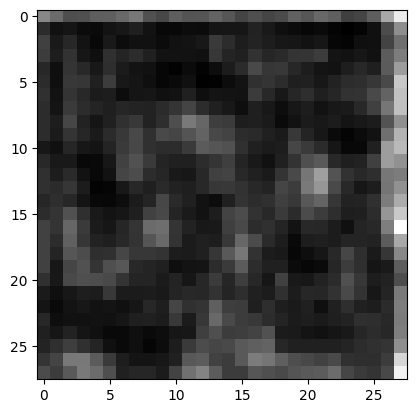

----------------------------------------


Discriminator Loss = 0.8791122436523438
Generator Loss = 1.0434753894805908
A sample image generated by the generator


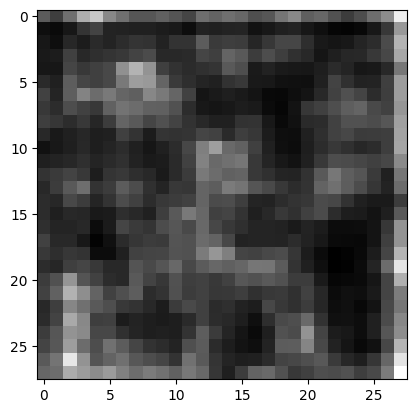

----------------------------------------


Discriminator Loss = 0.9324039220809937
Generator Loss = 1.0660929679870605
A sample image generated by the generator


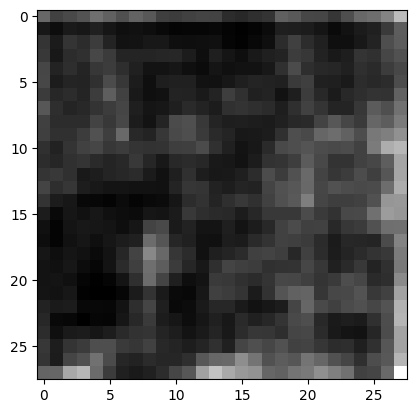

----------------------------------------


Discriminator Loss = 0.9219070672988892
Generator Loss = 1.100018858909607
A sample image generated by the generator


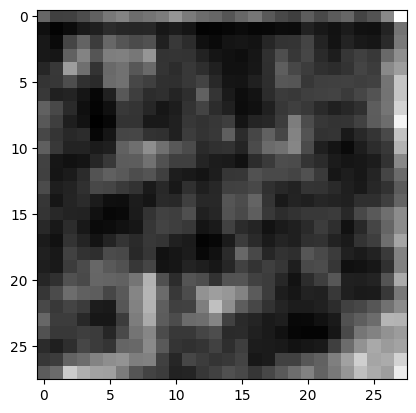

----------------------------------------


Discriminator Loss = 0.8828318119049072
Generator Loss = 1.1211471557617188
A sample image generated by the generator


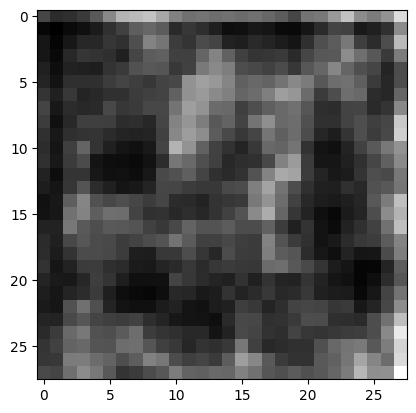

----------------------------------------


Discriminator Loss = 0.8788634538650513
Generator Loss = 1.0923969745635986
A sample image generated by the generator


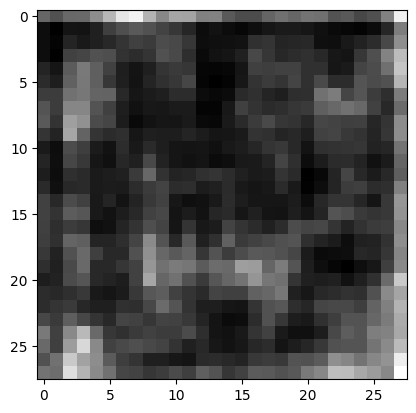

----------------------------------------


Discriminator Loss = 0.9364502429962158
Generator Loss = 1.053625464439392
A sample image generated by the generator


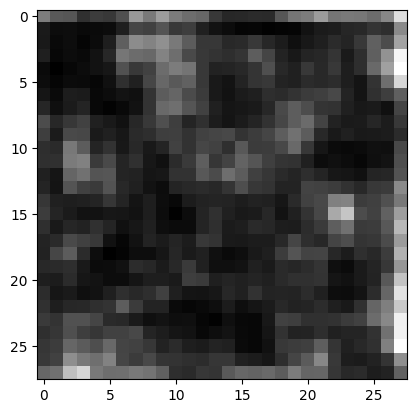

----------------------------------------


Discriminator Loss = 0.8872299790382385
Generator Loss = 1.0546543598175049
A sample image generated by the generator


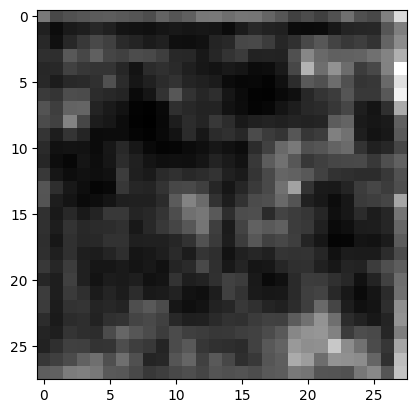

----------------------------------------


Discriminator Loss = 0.8839952349662781
Generator Loss = 1.0543220043182373
A sample image generated by the generator


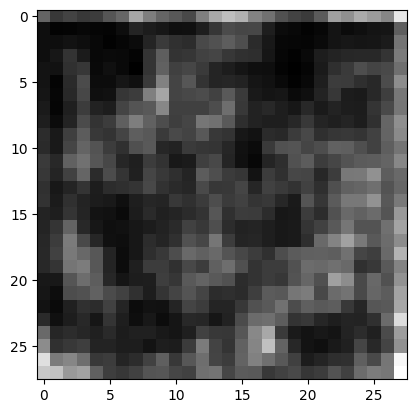

----------------------------------------


Discriminator Loss = 0.9305071830749512
Generator Loss = 1.0549659729003906
A sample image generated by the generator


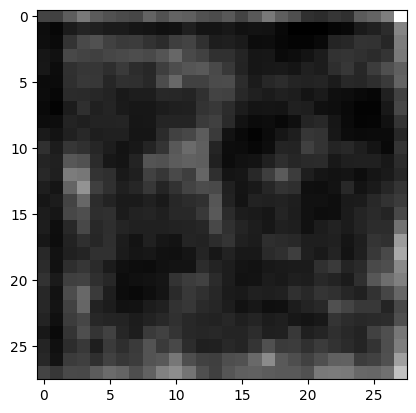

----------------------------------------


Discriminator Loss = 0.888074517250061
Generator Loss = 1.0376355648040771
A sample image generated by the generator


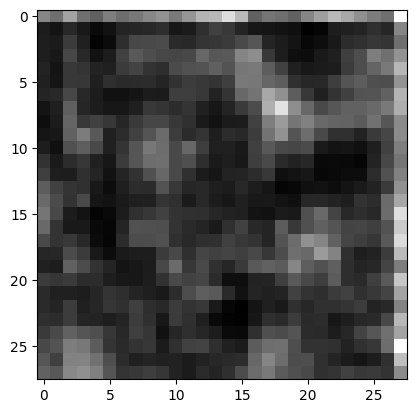

----------------------------------------


Discriminator Loss = 0.8721562623977661
Generator Loss = 1.00449538230896
A sample image generated by the generator


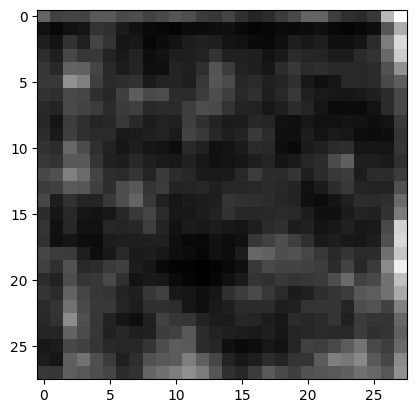

----------------------------------------


Discriminator Loss = 0.894371747970581
Generator Loss = 1.0698387622833252
A sample image generated by the generator


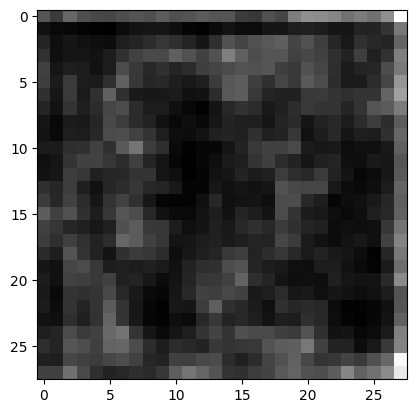

----------------------------------------


Discriminator Loss = 0.8510924577713013
Generator Loss = 1.0597736835479736
A sample image generated by the generator


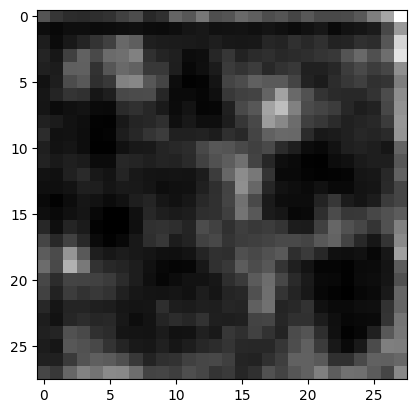

----------------------------------------


Discriminator Loss = 0.9327645301818848
Generator Loss = 1.0782395601272583
A sample image generated by the generator


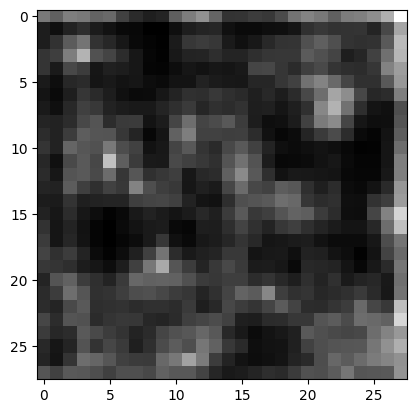

----------------------------------------


Discriminator Loss = 0.8869971036911011
Generator Loss = 1.034178614616394
A sample image generated by the generator


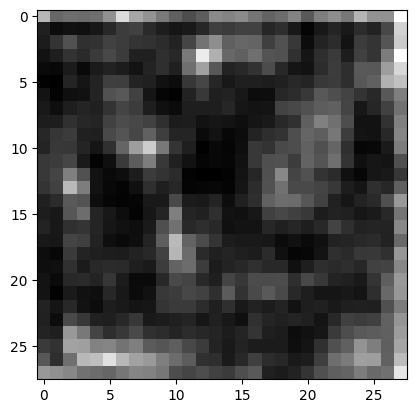

----------------------------------------


Discriminator Loss = 0.8964313864707947
Generator Loss = 1.0670466423034668
A sample image generated by the generator


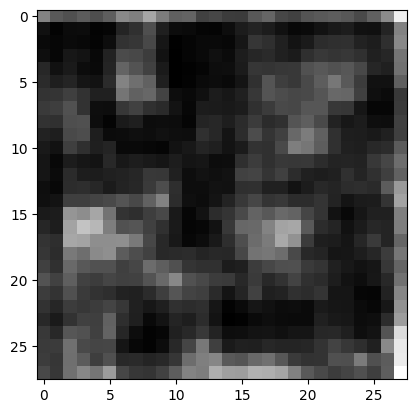

----------------------------------------


Discriminator Loss = 0.8854150772094727
Generator Loss = 1.098987340927124
A sample image generated by the generator


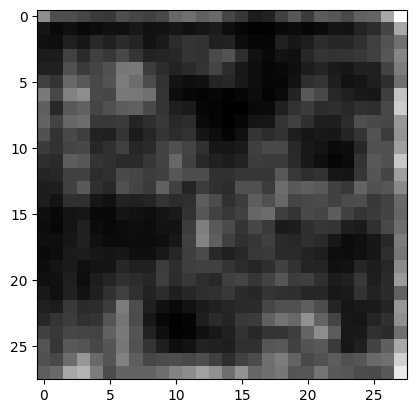

----------------------------------------


Discriminator Loss = 0.8702227473258972
Generator Loss = 1.0714123249053955
A sample image generated by the generator


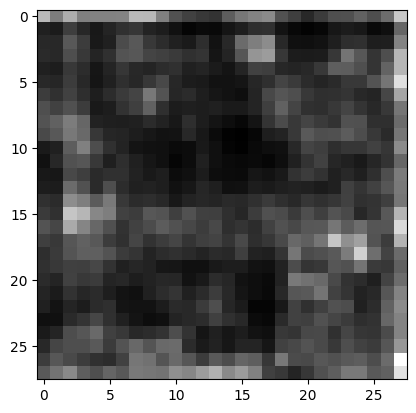

----------------------------------------


Discriminator Loss = 0.8868386149406433
Generator Loss = 1.1015688180923462
A sample image generated by the generator


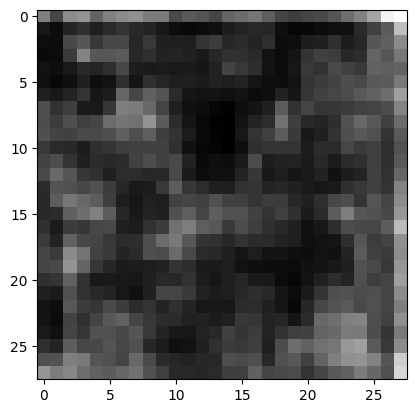

----------------------------------------


Discriminator Loss = 0.8461371660232544
Generator Loss = 1.0287760496139526
A sample image generated by the generator


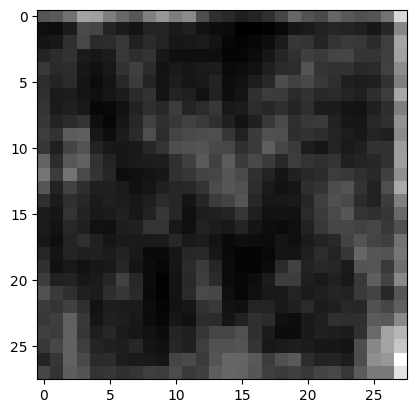

----------------------------------------


Discriminator Loss = 0.9194167256355286
Generator Loss = 1.067954421043396
A sample image generated by the generator


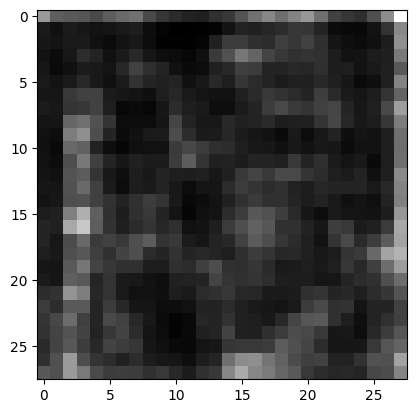

----------------------------------------


Discriminator Loss = 0.9255755543708801
Generator Loss = 1.1259018182754517
A sample image generated by the generator


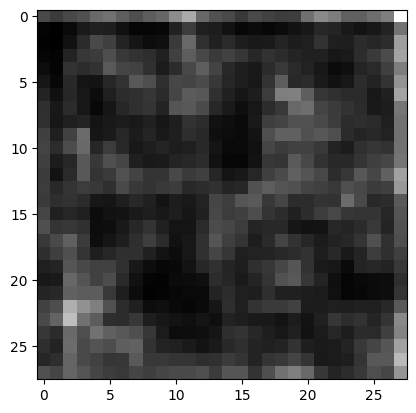

----------------------------------------


Discriminator Loss = 0.9145008325576782
Generator Loss = 1.0265064239501953
A sample image generated by the generator


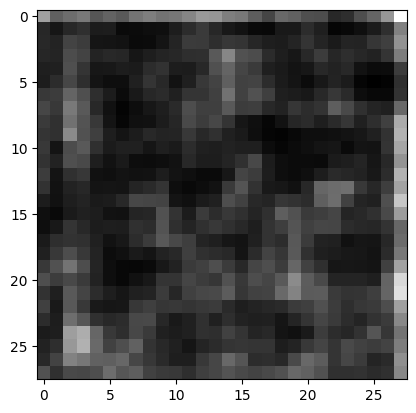

----------------------------------------


Discriminator Loss = 0.9318937063217163
Generator Loss = 1.1768670082092285
A sample image generated by the generator


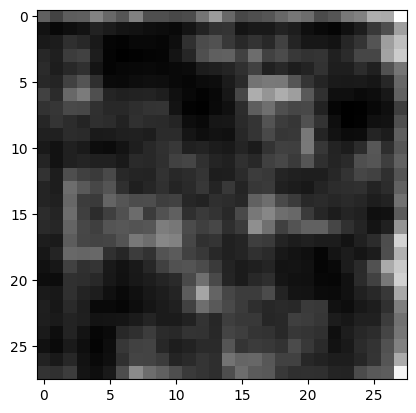

----------------------------------------


Discriminator Loss = 0.9399796724319458
Generator Loss = 1.1334953308105469
A sample image generated by the generator


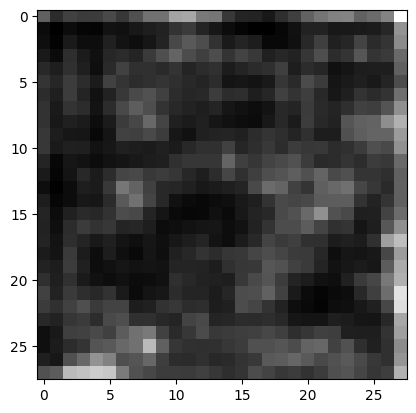

----------------------------------------


Discriminator Loss = 0.852393388748169
Generator Loss = 1.0923748016357422
A sample image generated by the generator


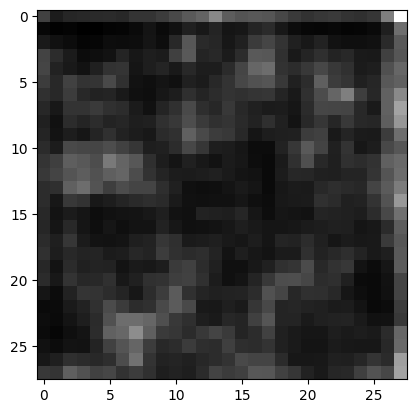

----------------------------------------


Discriminator Loss = 0.8853505849838257
Generator Loss = 1.0398585796356201
A sample image generated by the generator


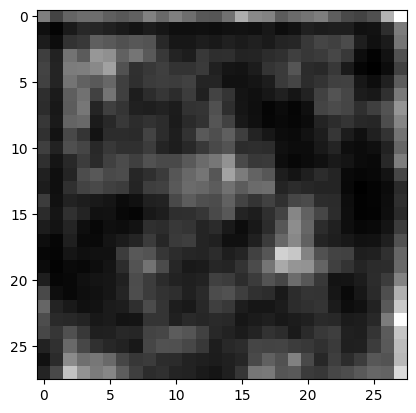

----------------------------------------


Discriminator Loss = 0.8780888319015503
Generator Loss = 1.1189985275268555
A sample image generated by the generator


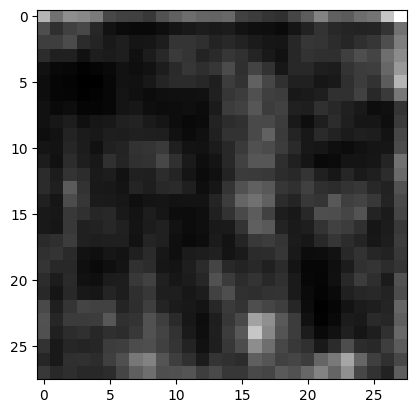

----------------------------------------


Discriminator Loss = 0.8250795006752014
Generator Loss = 1.1328414678573608
A sample image generated by the generator


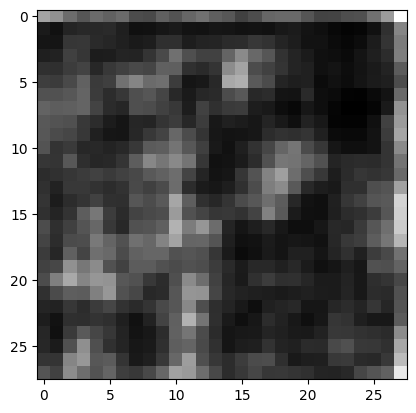

----------------------------------------


Discriminator Loss = 0.8346879482269287
Generator Loss = 1.127614974975586
A sample image generated by the generator


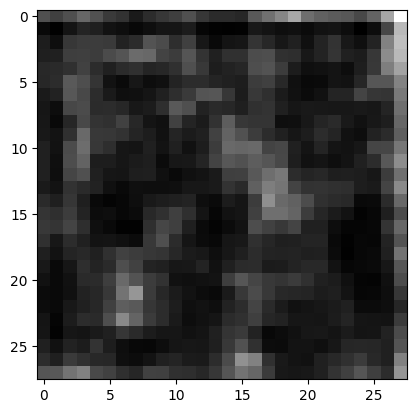

----------------------------------------


Discriminator Loss = 0.8968416452407837
Generator Loss = 1.1116914749145508
A sample image generated by the generator


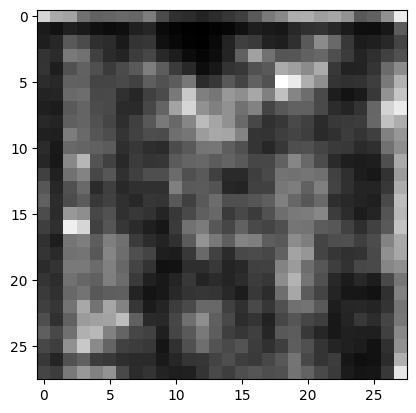

----------------------------------------


Discriminator Loss = 0.8380809426307678
Generator Loss = 1.0483393669128418
A sample image generated by the generator


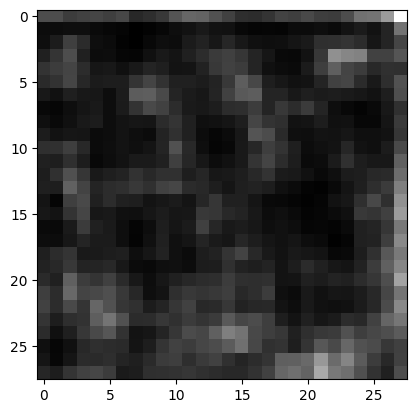

----------------------------------------


Discriminator Loss = 0.8934797048568726
Generator Loss = 1.15947425365448
A sample image generated by the generator


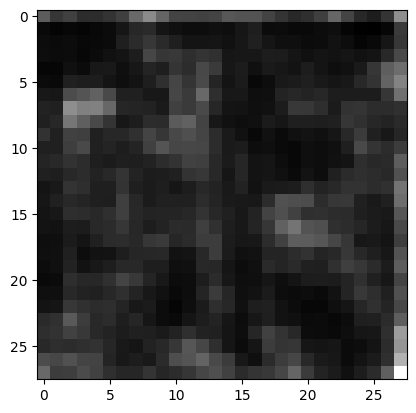

----------------------------------------


Discriminator Loss = 0.8587738275527954
Generator Loss = 1.0716044902801514
A sample image generated by the generator


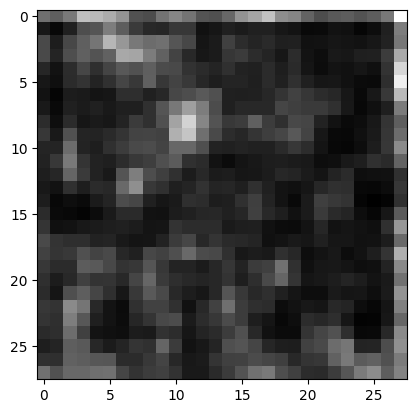

----------------------------------------


Discriminator Loss = 0.8525108098983765
Generator Loss = 1.143998384475708
A sample image generated by the generator


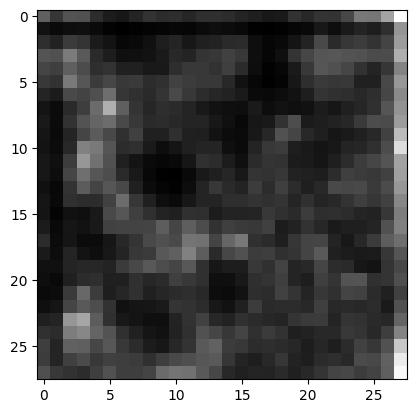

----------------------------------------


Discriminator Loss = 0.851654589176178
Generator Loss = 1.1009948253631592
A sample image generated by the generator


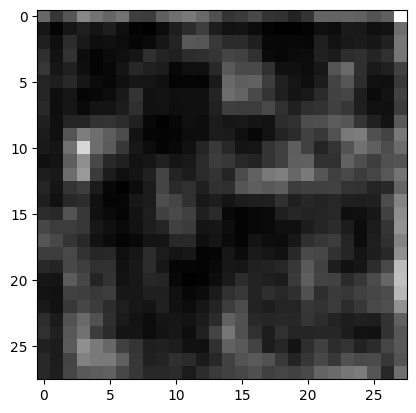

----------------------------------------


Discriminator Loss = 0.8959654569625854
Generator Loss = 1.0894936323165894
A sample image generated by the generator


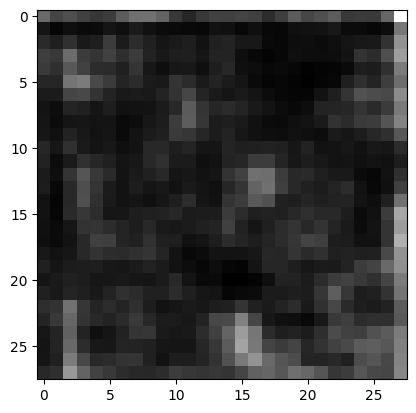

----------------------------------------


Discriminator Loss = 0.8885178565979004
Generator Loss = 1.0251023769378662
A sample image generated by the generator


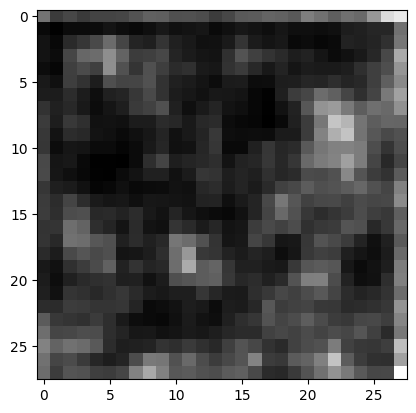

----------------------------------------


Discriminator Loss = 0.8458110094070435
Generator Loss = 1.0535125732421875
A sample image generated by the generator


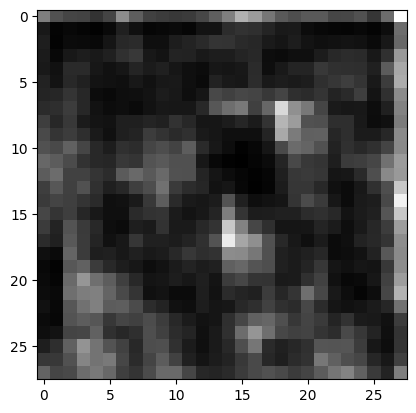

----------------------------------------


Discriminator Loss = 0.8813624382019043
Generator Loss = 1.155430793762207
A sample image generated by the generator


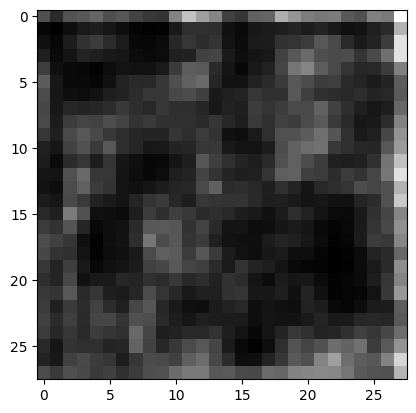

----------------------------------------


Discriminator Loss = 0.842237114906311
Generator Loss = 1.0979294776916504
A sample image generated by the generator


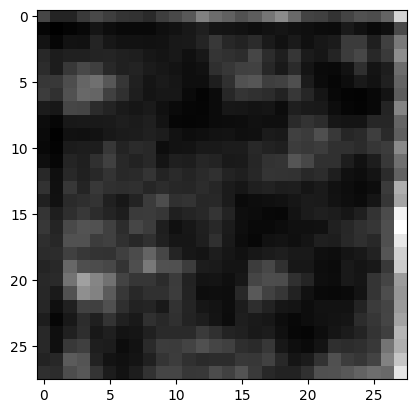

----------------------------------------


Discriminator Loss = 0.8390704989433289
Generator Loss = 1.1361660957336426
A sample image generated by the generator


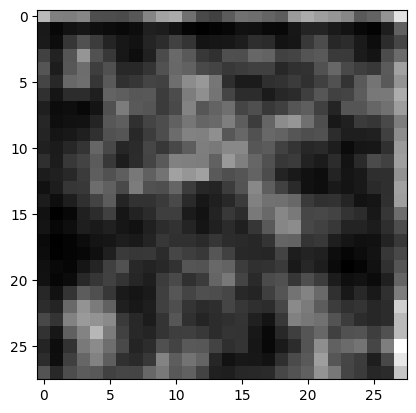

----------------------------------------


Discriminator Loss = 0.8158568739891052
Generator Loss = 1.137096643447876
A sample image generated by the generator


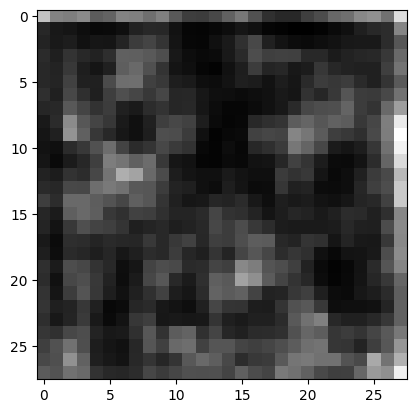

----------------------------------------


Discriminator Loss = 0.8252872228622437
Generator Loss = 1.14799165725708
A sample image generated by the generator


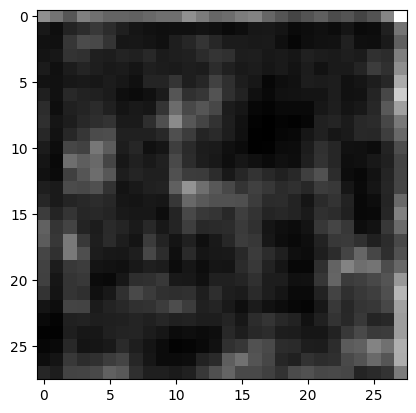

----------------------------------------


Discriminator Loss = 0.8496570587158203
Generator Loss = 1.1469414234161377
A sample image generated by the generator


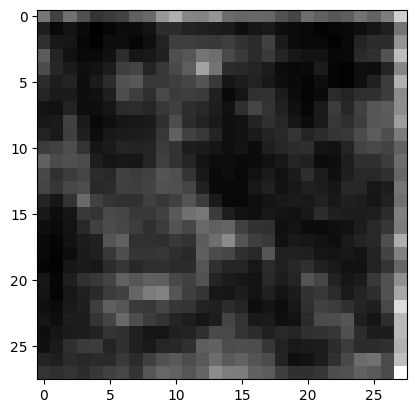

----------------------------------------


Discriminator Loss = 0.8665897846221924
Generator Loss = 1.0781877040863037
A sample image generated by the generator


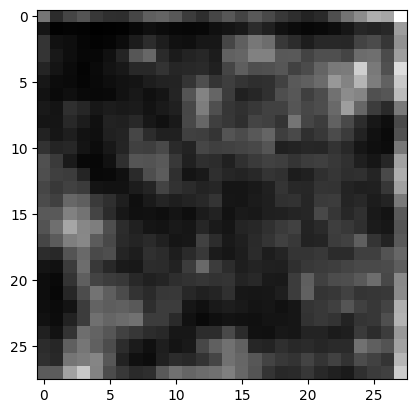

----------------------------------------


Discriminator Loss = 0.8257259130477905
Generator Loss = 1.117126226425171
A sample image generated by the generator


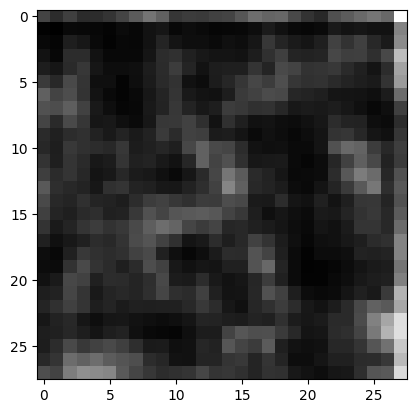

----------------------------------------


Discriminator Loss = 0.8107753992080688
Generator Loss = 1.125460147857666
A sample image generated by the generator


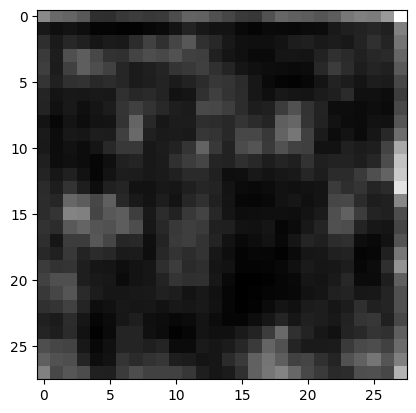

----------------------------------------


Discriminator Loss = 0.842210054397583
Generator Loss = 1.0973777770996094
A sample image generated by the generator


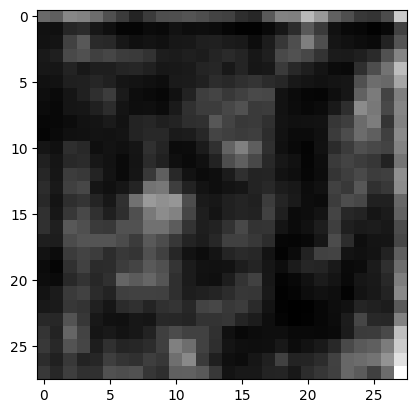

----------------------------------------


Discriminator Loss = 0.8744838237762451
Generator Loss = 1.072237491607666
A sample image generated by the generator


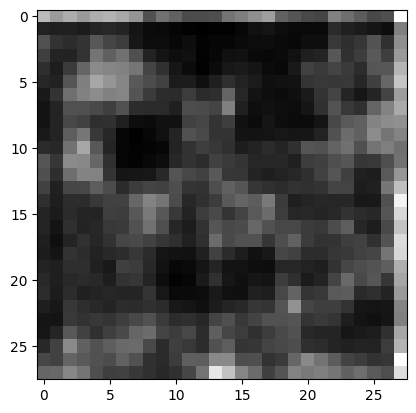

----------------------------------------


Discriminator Loss = 0.8547396659851074
Generator Loss = 1.086448073387146
A sample image generated by the generator


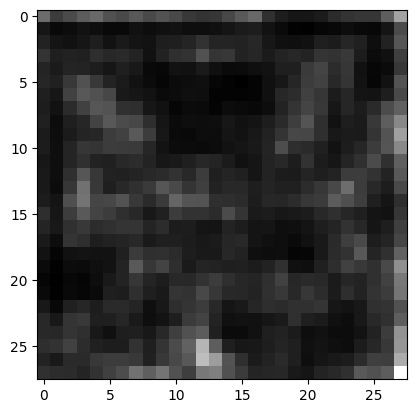

----------------------------------------


Discriminator Loss = 0.8265892267227173
Generator Loss = 1.2418135404586792
A sample image generated by the generator


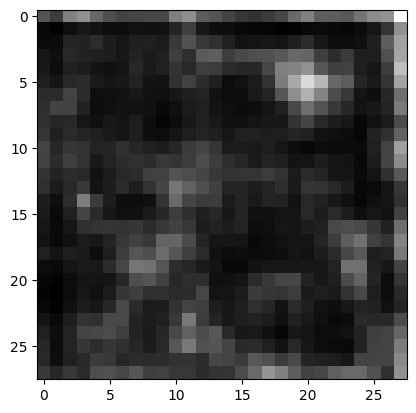

----------------------------------------


Discriminator Loss = 0.8617409467697144
Generator Loss = 1.1248763799667358
A sample image generated by the generator


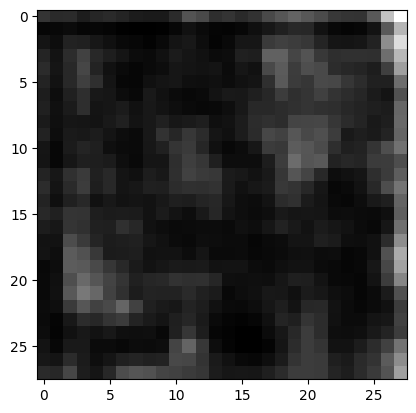

----------------------------------------


Discriminator Loss = 0.8198437690734863
Generator Loss = 1.0753347873687744
A sample image generated by the generator


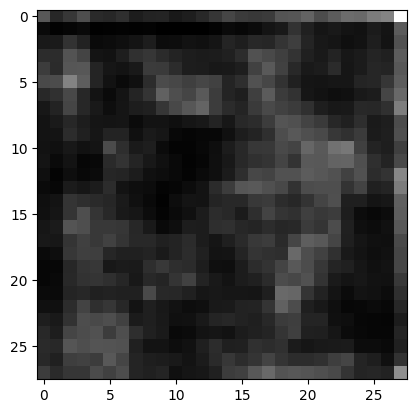

----------------------------------------


Discriminator Loss = 0.8341543674468994
Generator Loss = 1.156802773475647
A sample image generated by the generator


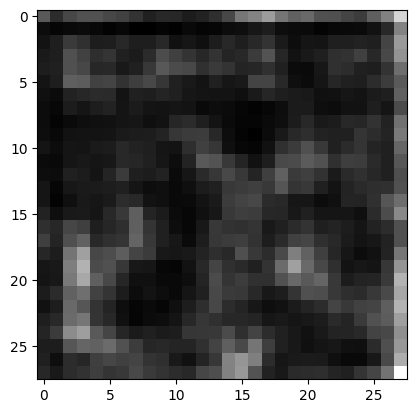

----------------------------------------


Discriminator Loss = 0.8346081972122192
Generator Loss = 1.1138553619384766
A sample image generated by the generator


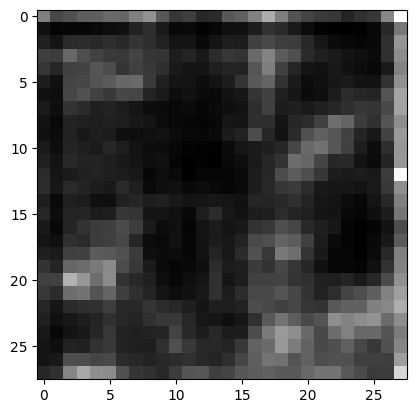

----------------------------------------


Discriminator Loss = 0.7980203628540039
Generator Loss = 1.183715581893921
A sample image generated by the generator


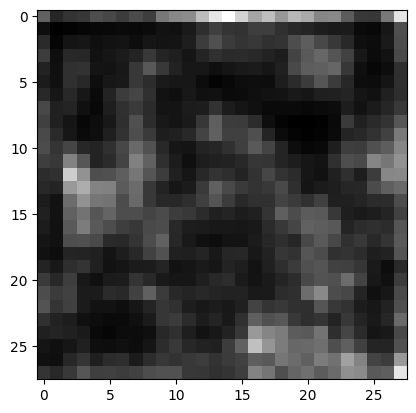

----------------------------------------


Discriminator Loss = 0.8273817300796509
Generator Loss = 1.1697731018066406
A sample image generated by the generator


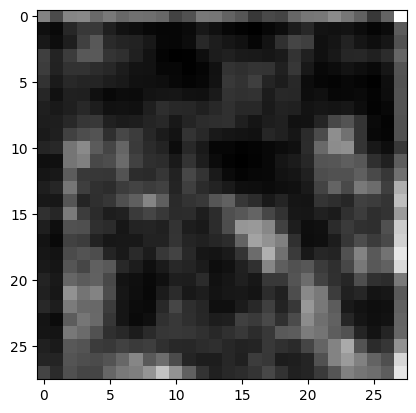

----------------------------------------


Discriminator Loss = 0.8403658270835876
Generator Loss = 1.113325834274292
A sample image generated by the generator


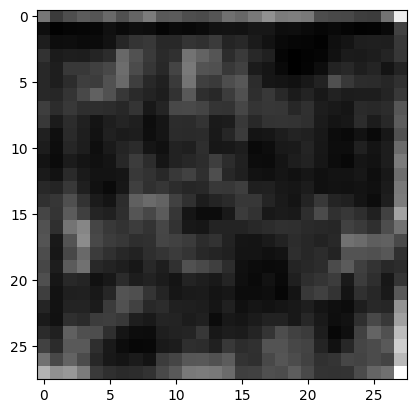

----------------------------------------


Discriminator Loss = 0.8064476251602173
Generator Loss = 1.1232012510299683
A sample image generated by the generator


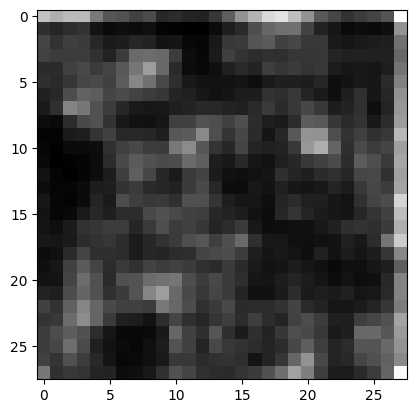

----------------------------------------


Discriminator Loss = 0.8023699522018433
Generator Loss = 1.0795423984527588
A sample image generated by the generator


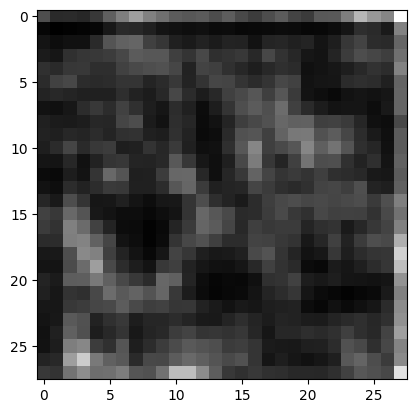

----------------------------------------


Discriminator Loss = 0.8163739442825317
Generator Loss = 1.148099660873413
A sample image generated by the generator


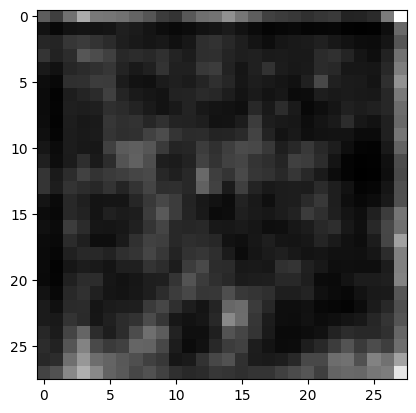

----------------------------------------


Discriminator Loss = 0.7901198863983154
Generator Loss = 1.1778119802474976
A sample image generated by the generator


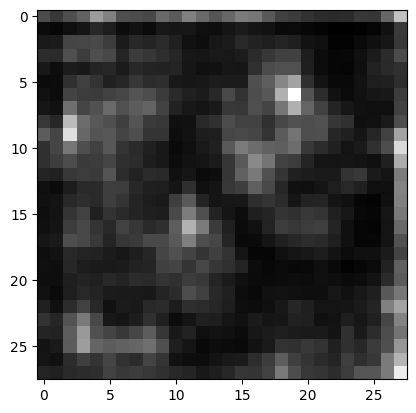

----------------------------------------


Discriminator Loss = 0.7907283306121826
Generator Loss = 1.1396950483322144
A sample image generated by the generator


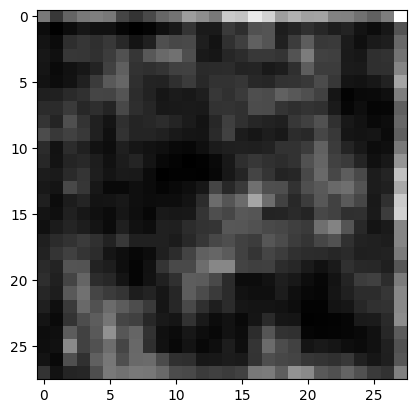

----------------------------------------


Discriminator Loss = 0.8109254837036133
Generator Loss = 1.172177791595459
A sample image generated by the generator


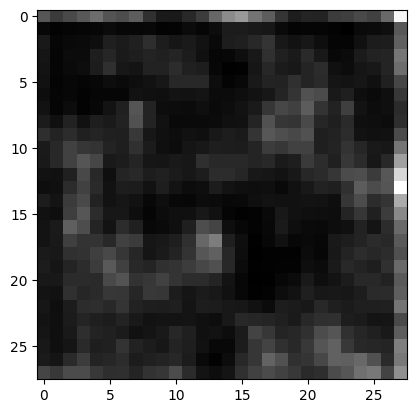

----------------------------------------


Discriminator Loss = 0.7861341238021851
Generator Loss = 1.1764929294586182
A sample image generated by the generator


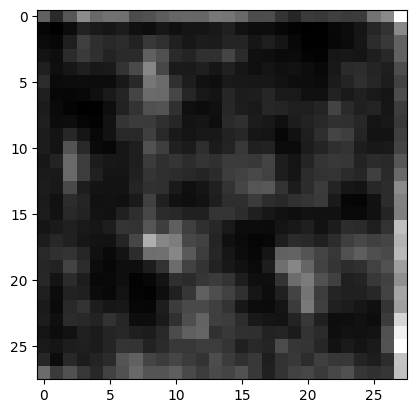

----------------------------------------


Discriminator Loss = 0.7891138195991516
Generator Loss = 1.1927151679992676
A sample image generated by the generator


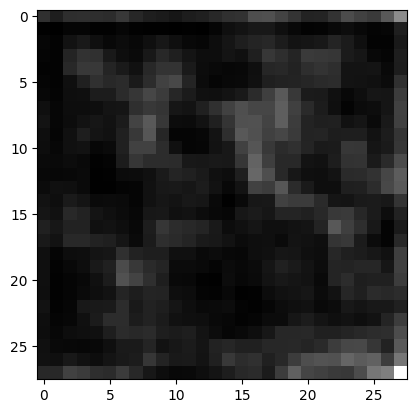

----------------------------------------


Discriminator Loss = 0.7612600326538086
Generator Loss = 1.1152372360229492
A sample image generated by the generator


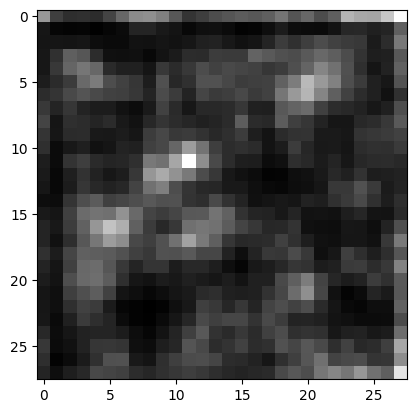

----------------------------------------


Discriminator Loss = 0.7978575825691223
Generator Loss = 1.2000315189361572
A sample image generated by the generator


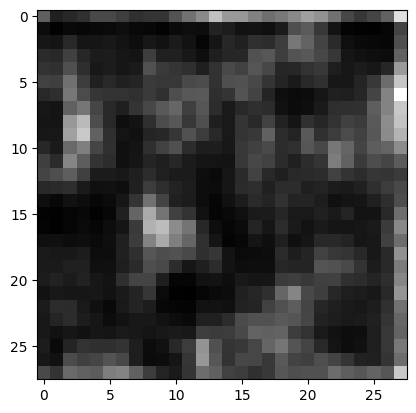

----------------------------------------


Discriminator Loss = 0.755531907081604
Generator Loss = 1.1977189779281616
A sample image generated by the generator


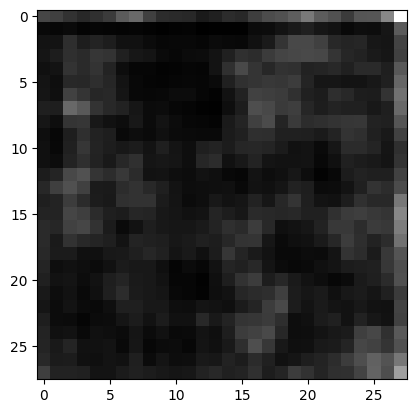

----------------------------------------


Discriminator Loss = 0.8271183967590332
Generator Loss = 1.1372959613800049
A sample image generated by the generator


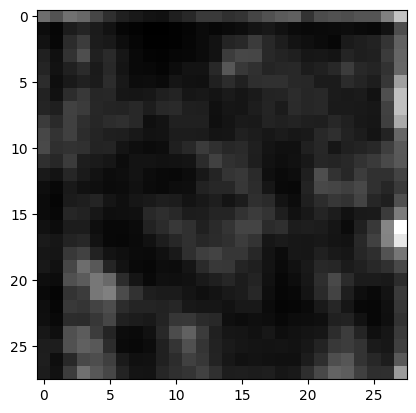

----------------------------------------


Discriminator Loss = 0.7811352014541626
Generator Loss = 1.205994963645935
A sample image generated by the generator


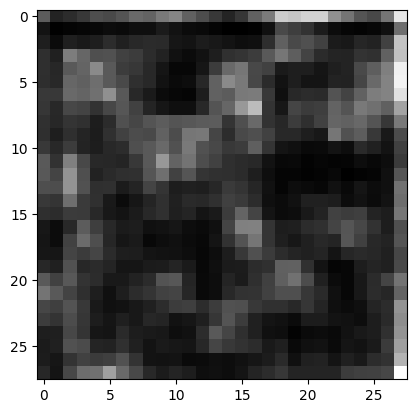

----------------------------------------


Discriminator Loss = 0.8401690721511841
Generator Loss = 1.1494972705841064
A sample image generated by the generator


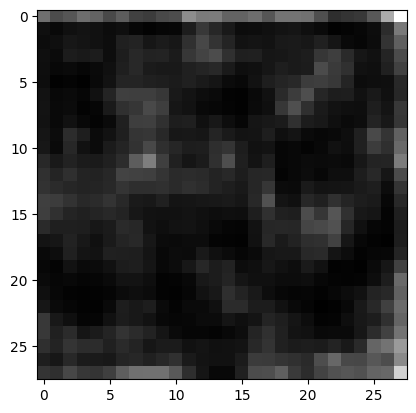

----------------------------------------


Discriminator Loss = 0.7737059593200684
Generator Loss = 1.1862246990203857
A sample image generated by the generator


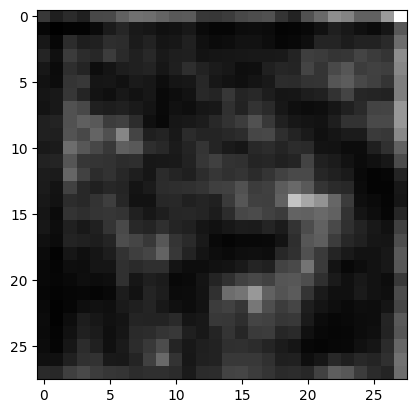

----------------------------------------


Discriminator Loss = 0.7899409532546997
Generator Loss = 1.1487984657287598
A sample image generated by the generator


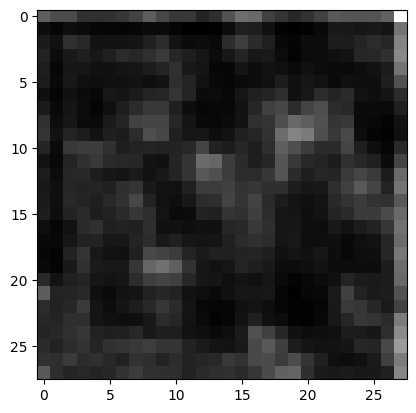

----------------------------------------


Discriminator Loss = 0.8160951137542725
Generator Loss = 1.137380599975586
A sample image generated by the generator


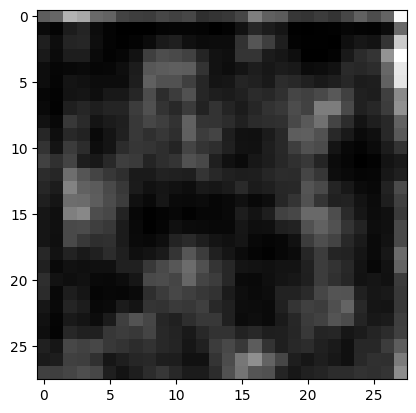

----------------------------------------


Discriminator Loss = 0.8419617414474487
Generator Loss = 1.1667650938034058
A sample image generated by the generator


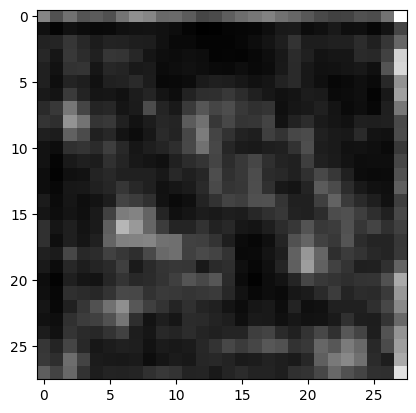

----------------------------------------


Discriminator Loss = 0.752429187297821
Generator Loss = 1.1515883207321167
A sample image generated by the generator


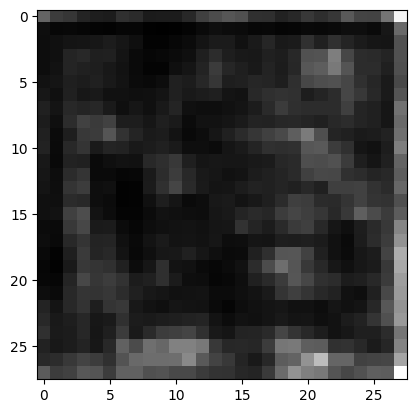

----------------------------------------


Discriminator Loss = 0.7551229596138
Generator Loss = 1.1909359693527222
A sample image generated by the generator


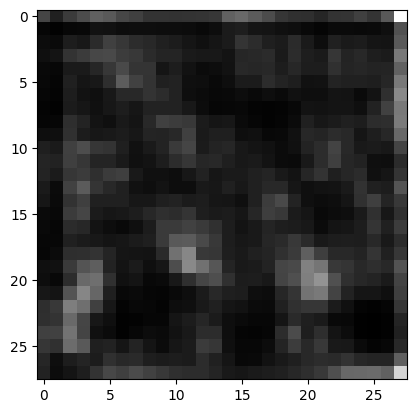

----------------------------------------


Discriminator Loss = 0.7594791054725647
Generator Loss = 1.1559429168701172
A sample image generated by the generator


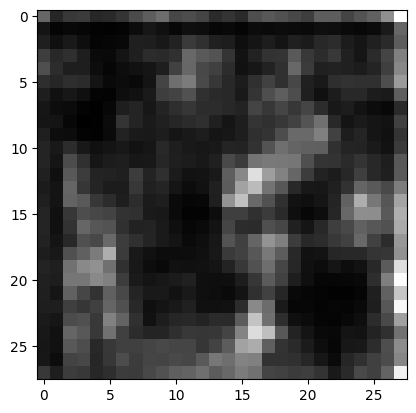

----------------------------------------


Discriminator Loss = 0.7848806381225586
Generator Loss = 1.1933207511901855
A sample image generated by the generator


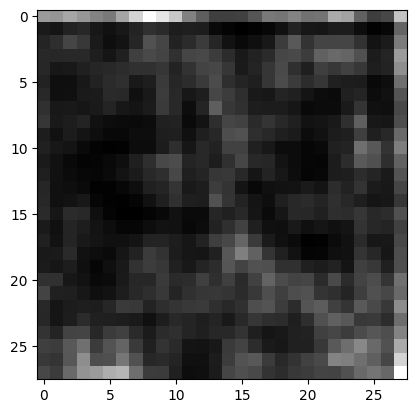

----------------------------------------


Discriminator Loss = 0.7824171781539917
Generator Loss = 1.1976242065429688
A sample image generated by the generator


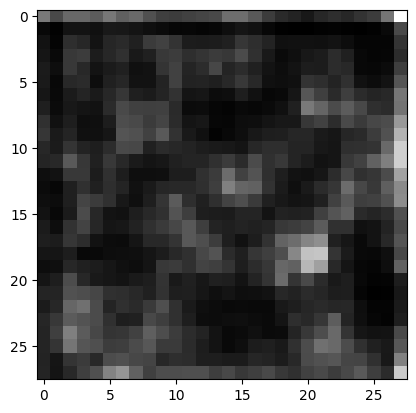

----------------------------------------


Discriminator Loss = 0.7924525737762451
Generator Loss = 1.2446990013122559
A sample image generated by the generator


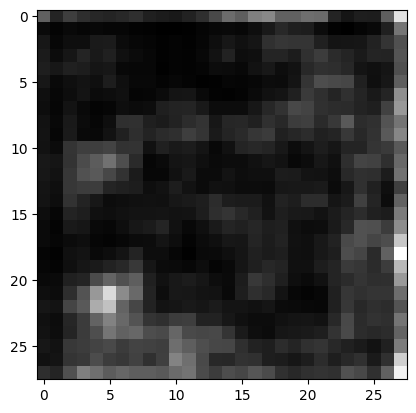

----------------------------------------


Discriminator Loss = 0.7811543941497803
Generator Loss = 1.1343107223510742
A sample image generated by the generator


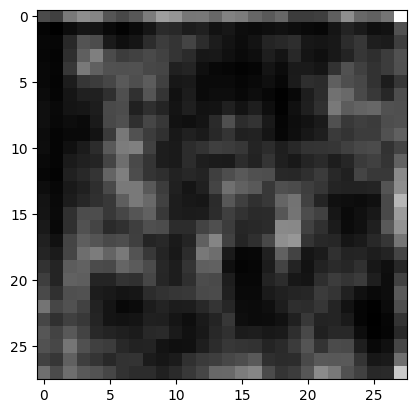

----------------------------------------


Discriminator Loss = 0.774603009223938
Generator Loss = 1.1987696886062622
A sample image generated by the generator


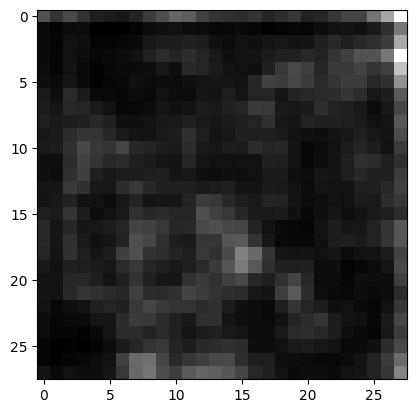

----------------------------------------


Discriminator Loss = 0.802875280380249
Generator Loss = 1.160574197769165
A sample image generated by the generator


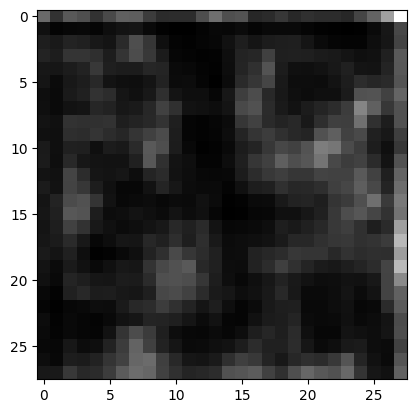

----------------------------------------


Discriminator Loss = 0.7381654381752014
Generator Loss = 1.1861903667449951
A sample image generated by the generator


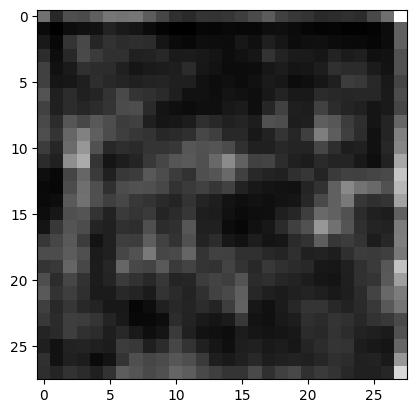

----------------------------------------


Discriminator Loss = 0.7482658624649048
Generator Loss = 1.180988073348999
A sample image generated by the generator


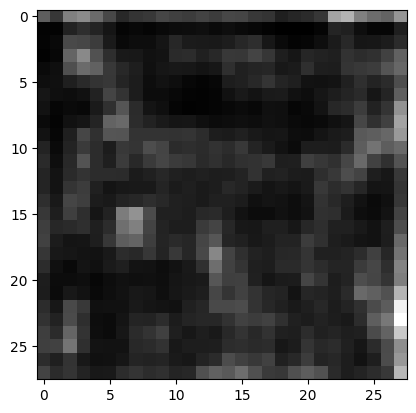

----------------------------------------


Discriminator Loss = 0.7596485614776611
Generator Loss = 1.2341113090515137
A sample image generated by the generator


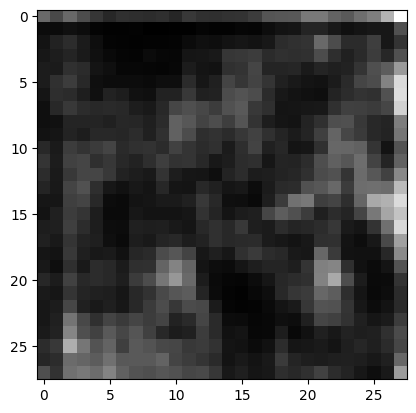

----------------------------------------


Discriminator Loss = 0.7703249454498291
Generator Loss = 1.2302756309509277
A sample image generated by the generator


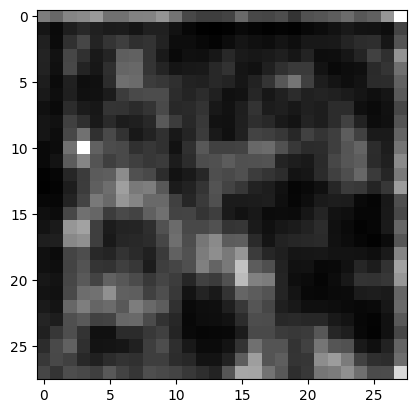

----------------------------------------


Discriminator Loss = 0.7636013031005859
Generator Loss = 1.1990759372711182
A sample image generated by the generator


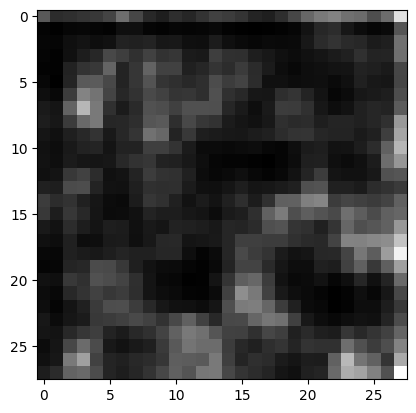

----------------------------------------


Discriminator Loss = 0.7724201679229736
Generator Loss = 1.2250230312347412
A sample image generated by the generator


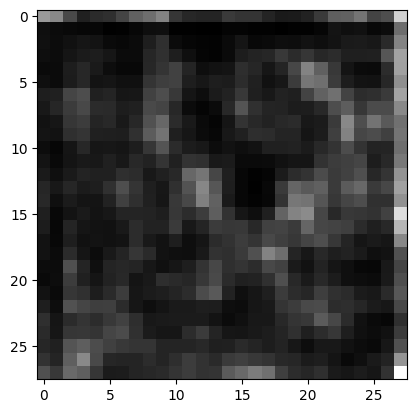

----------------------------------------


Discriminator Loss = 0.7437626123428345
Generator Loss = 1.2340128421783447
A sample image generated by the generator


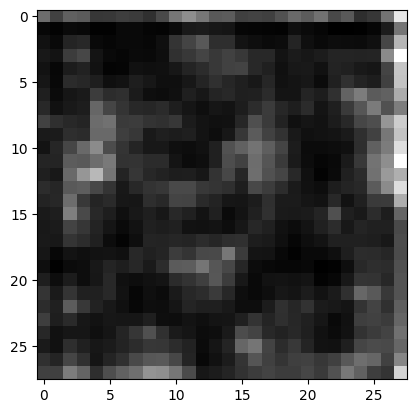

----------------------------------------


Discriminator Loss = 0.7737454175949097
Generator Loss = 1.1612745523452759
A sample image generated by the generator


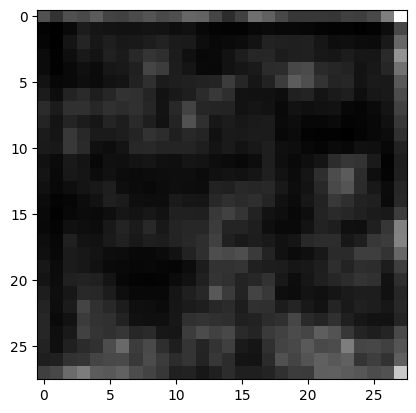

----------------------------------------


Discriminator Loss = 0.7811156511306763
Generator Loss = 1.204568862915039
A sample image generated by the generator


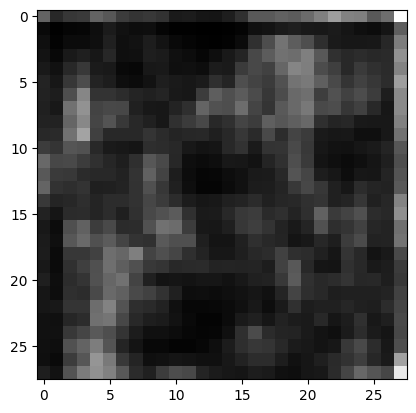

----------------------------------------


Discriminator Loss = 0.8003923296928406
Generator Loss = 1.2536571025848389
A sample image generated by the generator


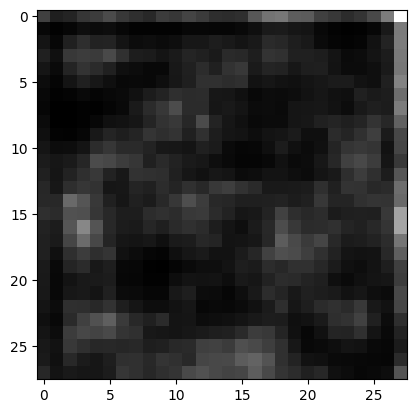

----------------------------------------


Discriminator Loss = 0.7751359939575195
Generator Loss = 1.2346866130828857
A sample image generated by the generator


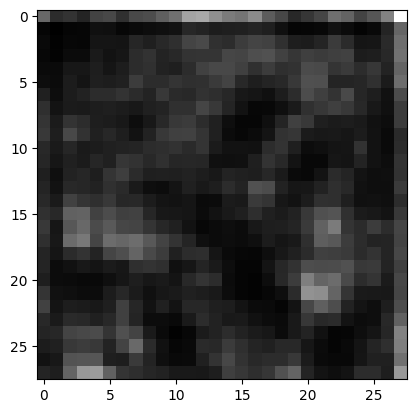

----------------------------------------


Discriminator Loss = 0.747062087059021
Generator Loss = 1.2269258499145508
A sample image generated by the generator


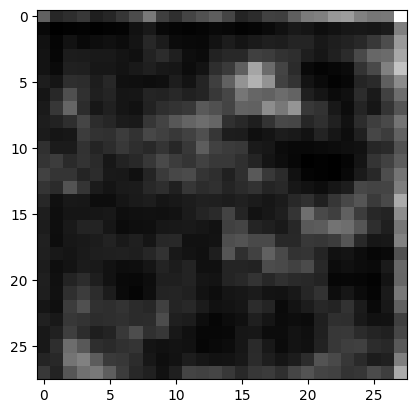

----------------------------------------


Discriminator Loss = 0.7610855102539062
Generator Loss = 1.2287921905517578
A sample image generated by the generator


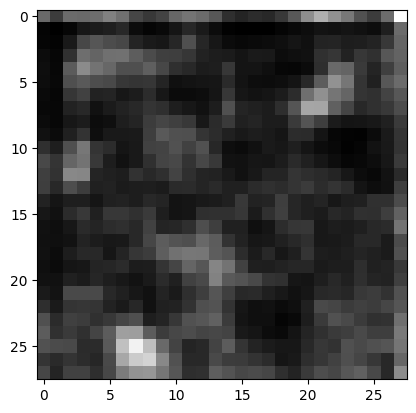

----------------------------------------


Discriminator Loss = 0.7737865447998047
Generator Loss = 1.2443820238113403
A sample image generated by the generator


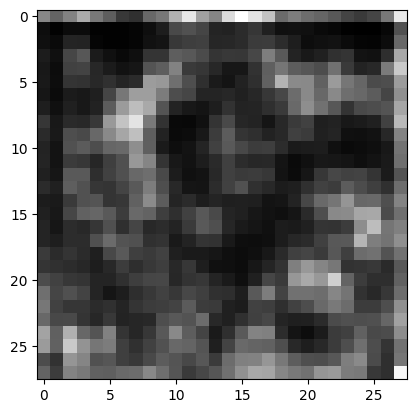

----------------------------------------


Discriminator Loss = 0.7679371237754822
Generator Loss = 1.2236108779907227
A sample image generated by the generator


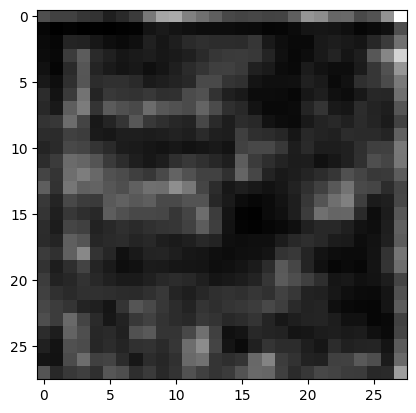

----------------------------------------


Discriminator Loss = 0.7674009799957275
Generator Loss = 1.2298041582107544
A sample image generated by the generator


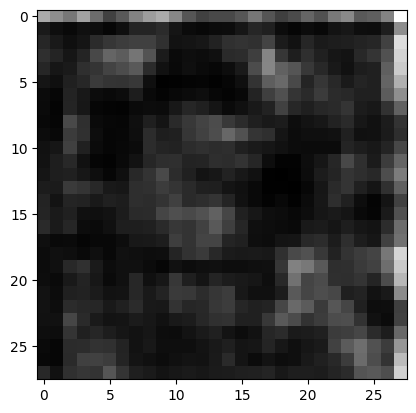

----------------------------------------


Discriminator Loss = 0.7314817905426025
Generator Loss = 1.21808922290802
A sample image generated by the generator


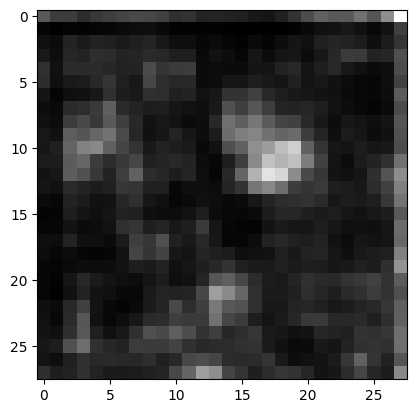

----------------------------------------


Discriminator Loss = 0.7240524291992188
Generator Loss = 1.1677987575531006
A sample image generated by the generator


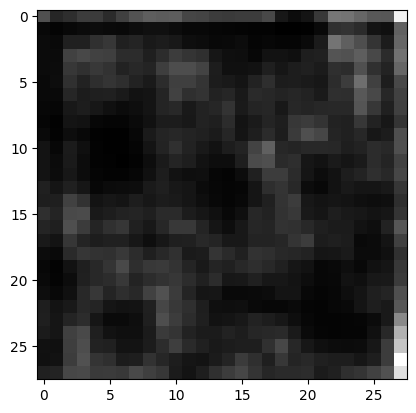

----------------------------------------


Discriminator Loss = 0.7434573173522949
Generator Loss = 1.182985544204712
A sample image generated by the generator


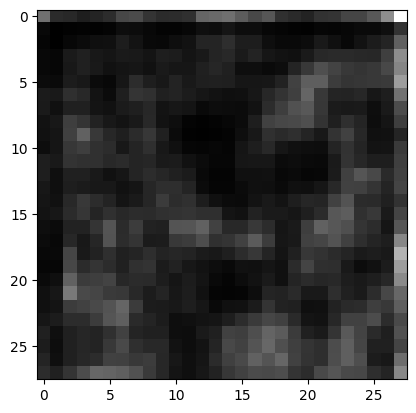

----------------------------------------


Discriminator Loss = 0.769323468208313
Generator Loss = 1.2479686737060547
A sample image generated by the generator


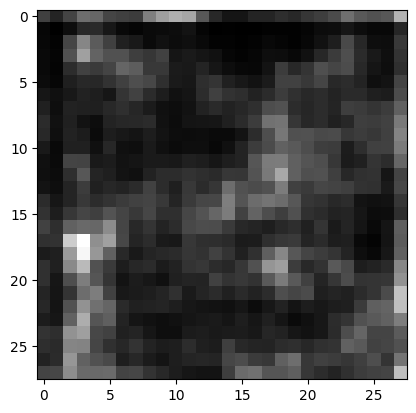

----------------------------------------


Discriminator Loss = 0.7480258941650391
Generator Loss = 1.2408246994018555
A sample image generated by the generator


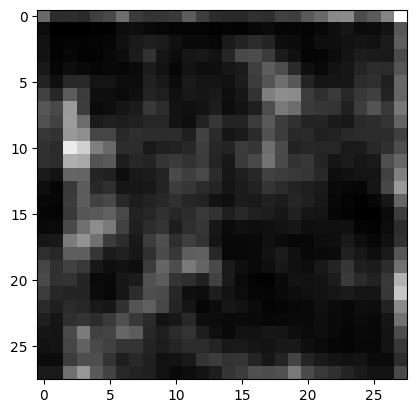

----------------------------------------


Discriminator Loss = 0.7642885446548462
Generator Loss = 1.2948569059371948
A sample image generated by the generator


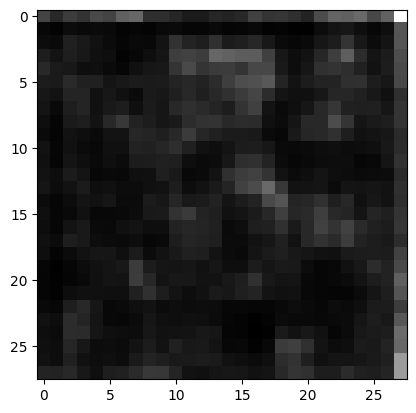

----------------------------------------


Discriminator Loss = 0.7041040062904358
Generator Loss = 1.3237546682357788
A sample image generated by the generator


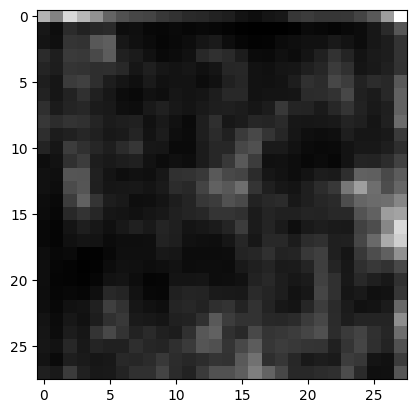

----------------------------------------


Discriminator Loss = 0.707684338092804
Generator Loss = 1.2306225299835205
A sample image generated by the generator


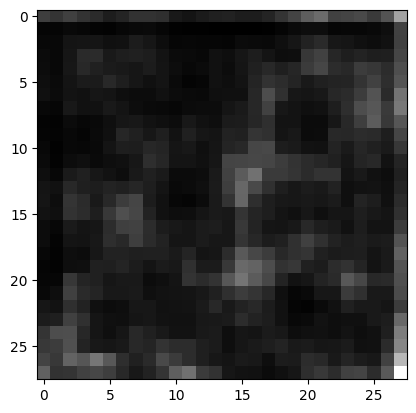

----------------------------------------


Discriminator Loss = 0.7384252548217773
Generator Loss = 1.215160608291626
A sample image generated by the generator


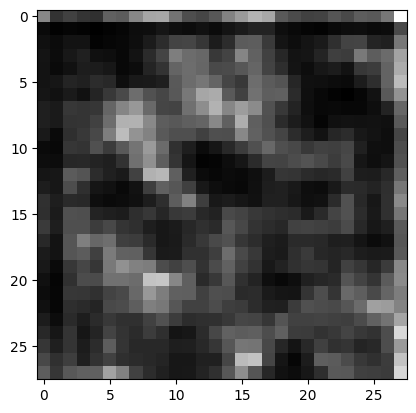

----------------------------------------


Discriminator Loss = 0.7215155959129333
Generator Loss = 1.2486889362335205
A sample image generated by the generator


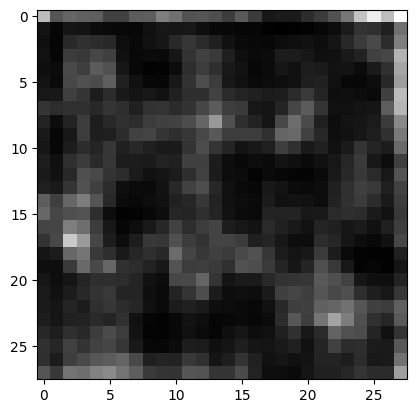

----------------------------------------


Discriminator Loss = 0.7580454349517822
Generator Loss = 1.2038962841033936
A sample image generated by the generator


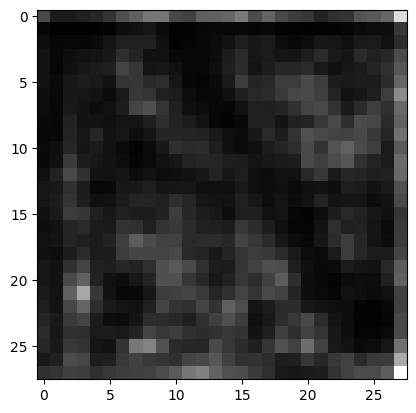

----------------------------------------


Discriminator Loss = 0.7121020555496216
Generator Loss = 1.2972043752670288
A sample image generated by the generator


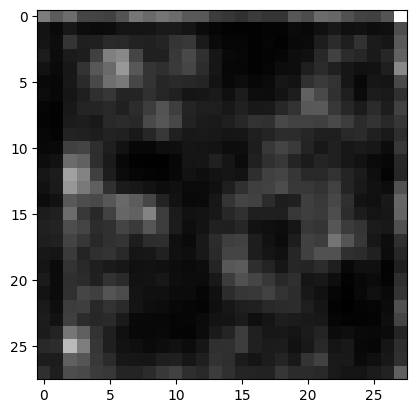

----------------------------------------


Discriminator Loss = 0.738510012626648
Generator Loss = 1.2073097229003906
A sample image generated by the generator


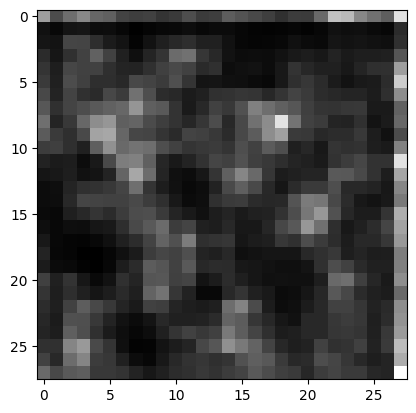

----------------------------------------


Discriminator Loss = 0.7215723395347595
Generator Loss = 1.2352166175842285
A sample image generated by the generator


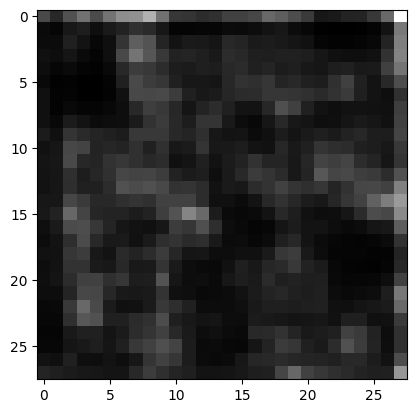

----------------------------------------


Discriminator Loss = 0.7389429807662964
Generator Loss = 1.3009033203125
A sample image generated by the generator


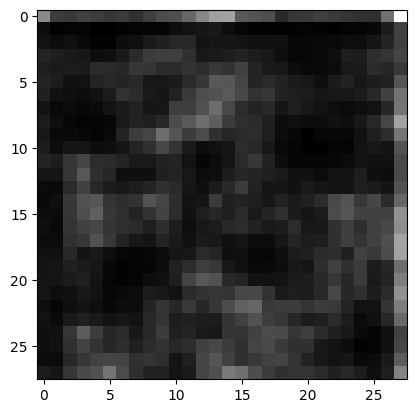

----------------------------------------


Discriminator Loss = 0.7188172340393066
Generator Loss = 1.236886978149414
A sample image generated by the generator


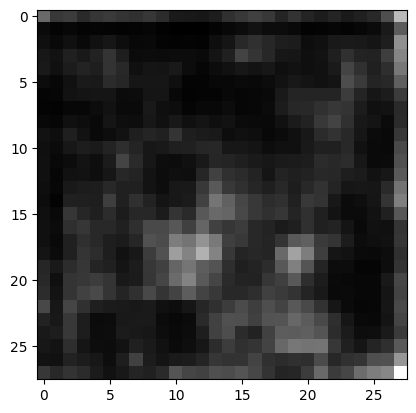

----------------------------------------


Discriminator Loss = 0.7356239557266235
Generator Loss = 1.2564234733581543
A sample image generated by the generator


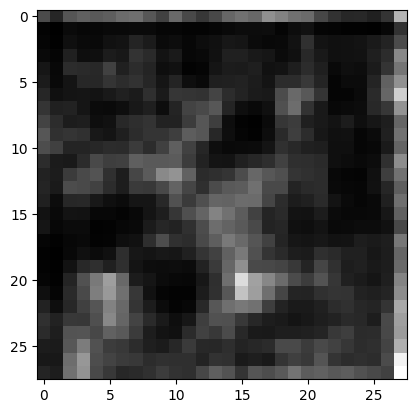

----------------------------------------


Discriminator Loss = 0.7698075771331787
Generator Loss = 1.2353074550628662
A sample image generated by the generator


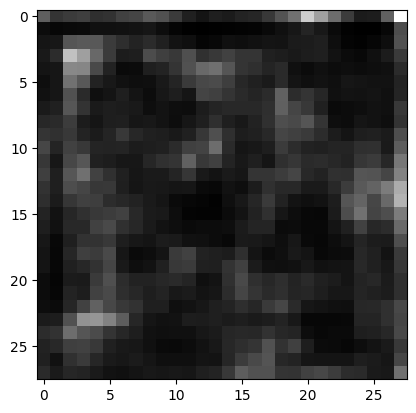

----------------------------------------


Discriminator Loss = 0.7374922037124634
Generator Loss = 1.2611254453659058
A sample image generated by the generator


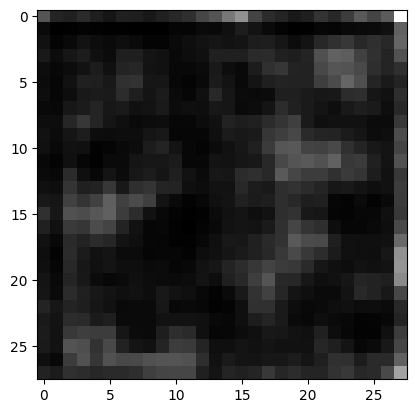

----------------------------------------


Discriminator Loss = 0.7468446493148804
Generator Loss = 1.2536778450012207
A sample image generated by the generator


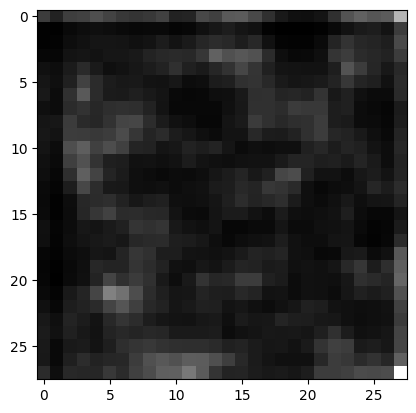

----------------------------------------


Discriminator Loss = 0.7182567119598389
Generator Loss = 1.2413675785064697
A sample image generated by the generator


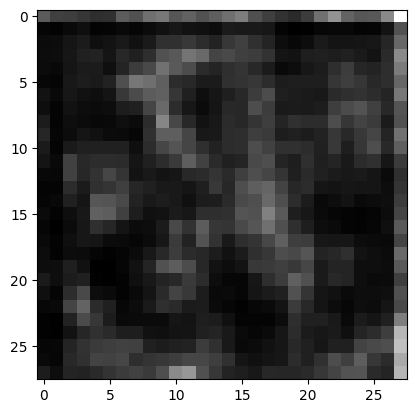

----------------------------------------


Discriminator Loss = 0.6946595907211304
Generator Loss = 1.2671797275543213
A sample image generated by the generator


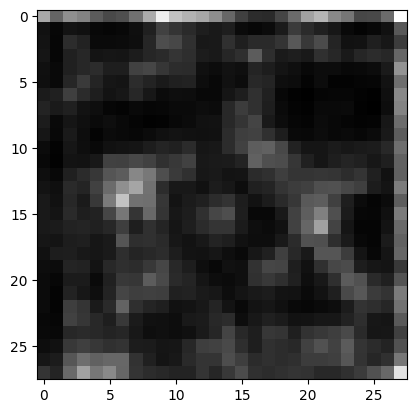

----------------------------------------


Discriminator Loss = 0.7323243021965027
Generator Loss = 1.2609460353851318
A sample image generated by the generator


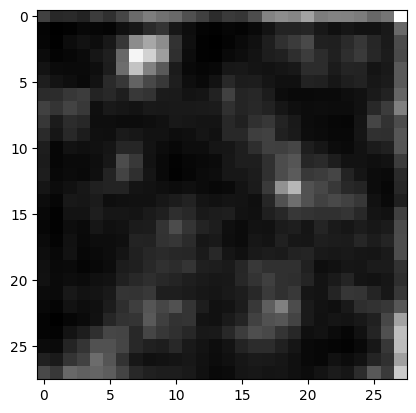

----------------------------------------


Discriminator Loss = 0.7016852498054504
Generator Loss = 1.2441874742507935
A sample image generated by the generator


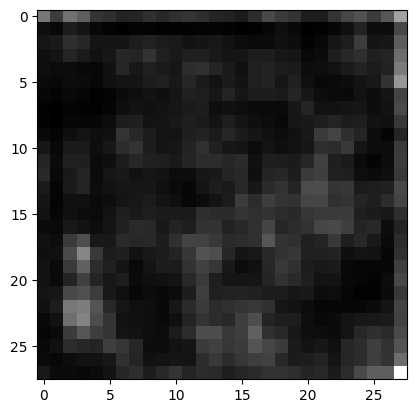

----------------------------------------


Discriminator Loss = 0.7310057282447815
Generator Loss = 1.290682077407837
A sample image generated by the generator


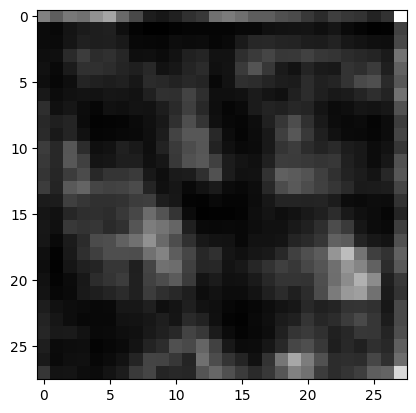

----------------------------------------


Discriminator Loss = 0.7388702630996704
Generator Loss = 1.2694885730743408
A sample image generated by the generator


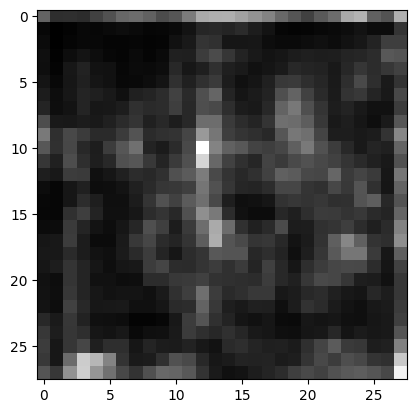

----------------------------------------


Discriminator Loss = 0.7085964679718018
Generator Loss = 1.282270908355713
A sample image generated by the generator


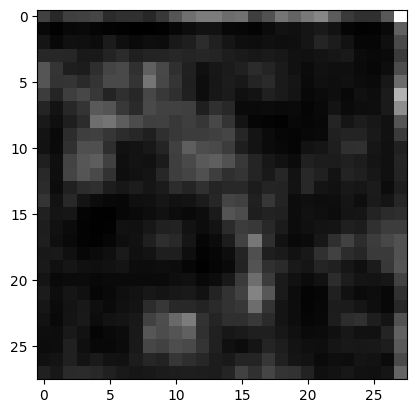

----------------------------------------


Discriminator Loss = 0.7144653797149658
Generator Loss = 1.2469706535339355
A sample image generated by the generator


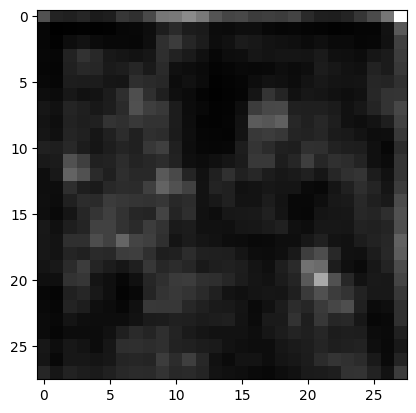

----------------------------------------


Discriminator Loss = 0.6975908279418945
Generator Loss = 1.2855515480041504
A sample image generated by the generator


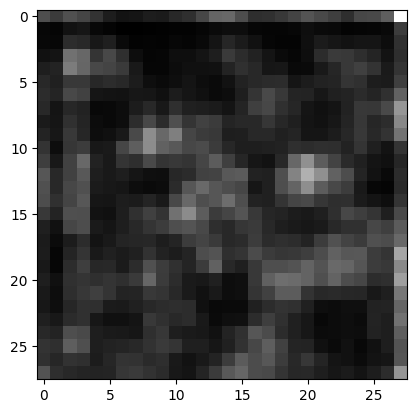

----------------------------------------


Discriminator Loss = 0.6983820199966431
Generator Loss = 1.3142967224121094
A sample image generated by the generator


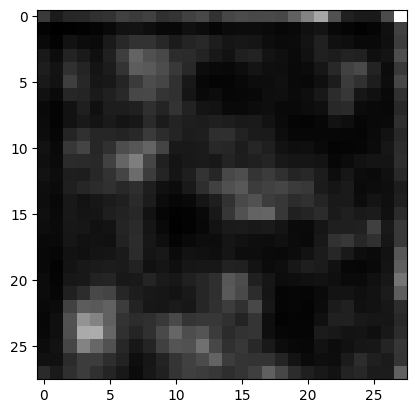

----------------------------------------


Discriminator Loss = 0.6962450742721558
Generator Loss = 1.269118070602417
A sample image generated by the generator


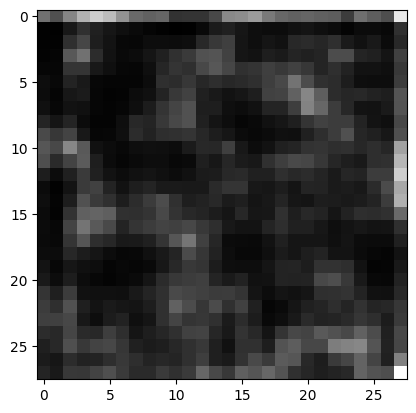

----------------------------------------


Discriminator Loss = 0.6869526505470276
Generator Loss = 1.261748194694519
A sample image generated by the generator


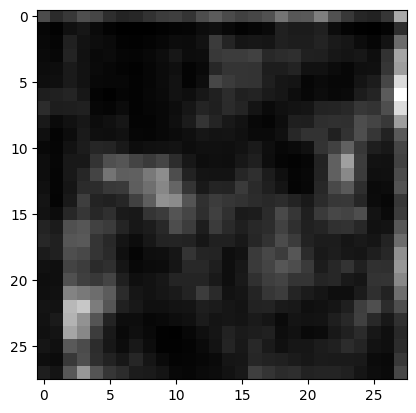

----------------------------------------


Discriminator Loss = 0.6865214705467224
Generator Loss = 1.3476555347442627
A sample image generated by the generator


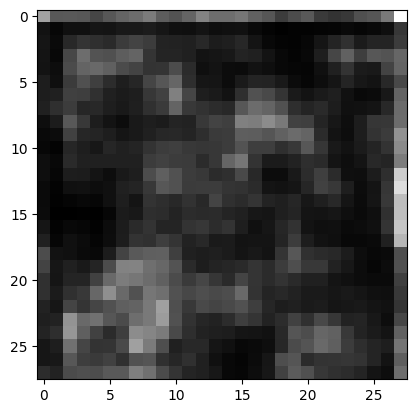

----------------------------------------


Discriminator Loss = 0.7162665724754333
Generator Loss = 1.2665455341339111
A sample image generated by the generator


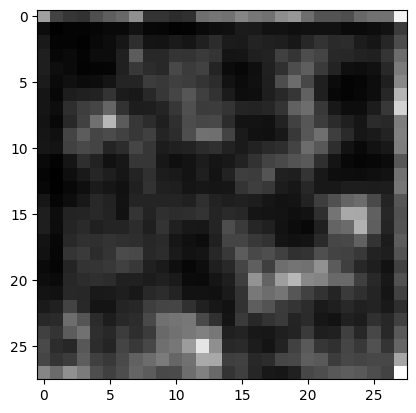

----------------------------------------


Discriminator Loss = 0.6980320811271667
Generator Loss = 1.2279386520385742
A sample image generated by the generator


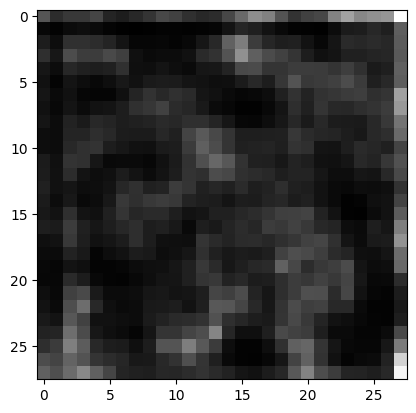

----------------------------------------


Discriminator Loss = 0.7067819833755493
Generator Loss = 1.3197550773620605
A sample image generated by the generator


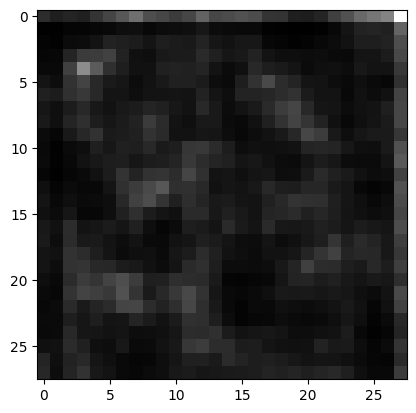

----------------------------------------


Discriminator Loss = 0.7169703245162964
Generator Loss = 1.2566684484481812
A sample image generated by the generator


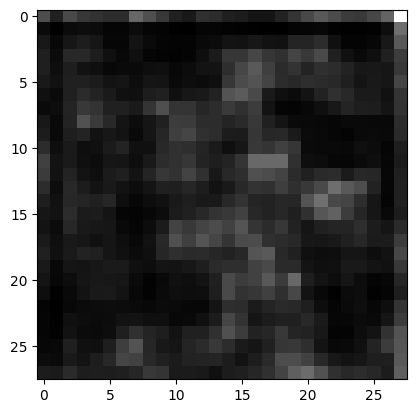

----------------------------------------


Discriminator Loss = 0.69785475730896
Generator Loss = 1.3472790718078613
A sample image generated by the generator


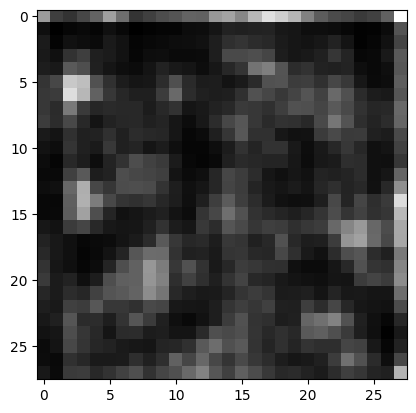

----------------------------------------


Discriminator Loss = 0.6675243377685547
Generator Loss = 1.2879905700683594
A sample image generated by the generator


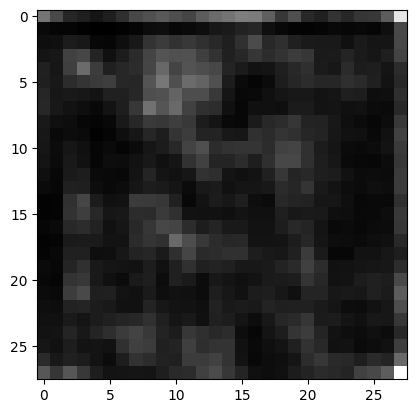

----------------------------------------


Discriminator Loss = 0.6706452369689941
Generator Loss = 1.2406647205352783
A sample image generated by the generator


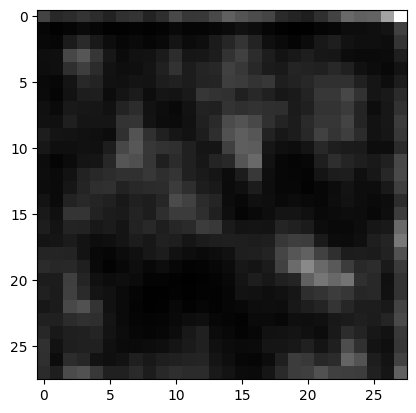

----------------------------------------


Discriminator Loss = 0.6906025409698486
Generator Loss = 1.3170368671417236
A sample image generated by the generator


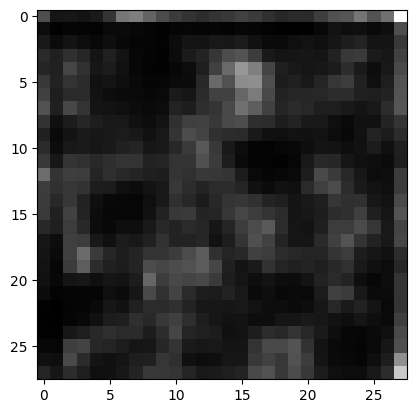

----------------------------------------


Discriminator Loss = 0.6753350496292114
Generator Loss = 1.3198060989379883
A sample image generated by the generator


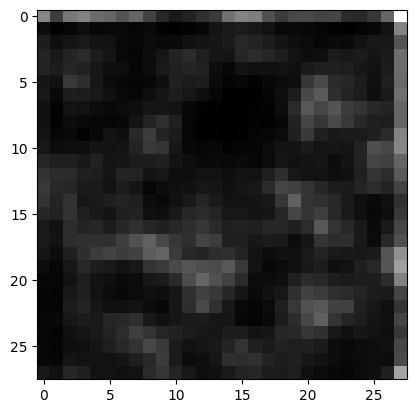

----------------------------------------


Discriminator Loss = 0.6692357063293457
Generator Loss = 1.262832522392273
A sample image generated by the generator


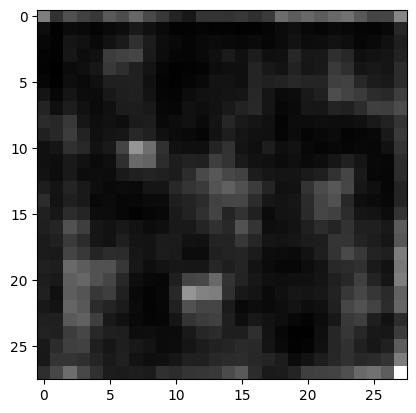

----------------------------------------


Discriminator Loss = 0.685173511505127
Generator Loss = 1.2912794351577759
A sample image generated by the generator


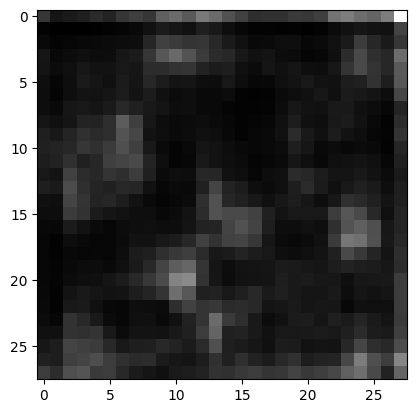

----------------------------------------


Discriminator Loss = 0.6765174269676208
Generator Loss = 1.2673790454864502
A sample image generated by the generator


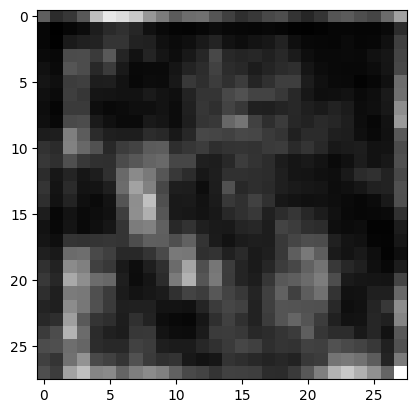

----------------------------------------


Discriminator Loss = 0.6984244585037231
Generator Loss = 1.255752444267273
A sample image generated by the generator


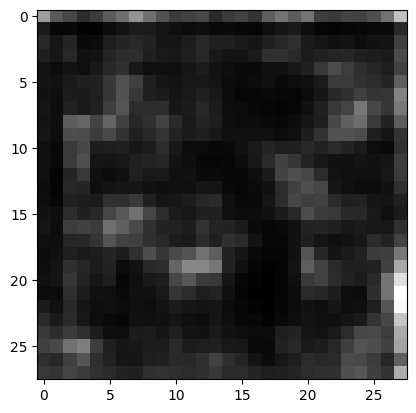

----------------------------------------


Discriminator Loss = 0.6714926958084106
Generator Loss = 1.3567304611206055
A sample image generated by the generator


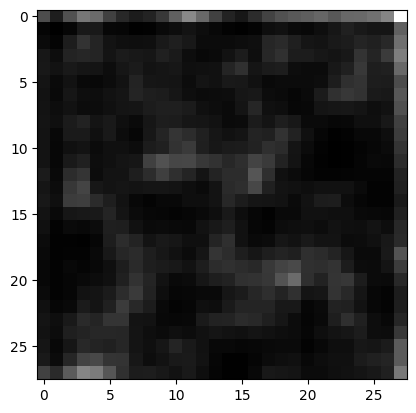

----------------------------------------


Discriminator Loss = 0.683997631072998
Generator Loss = 1.37639582157135
A sample image generated by the generator


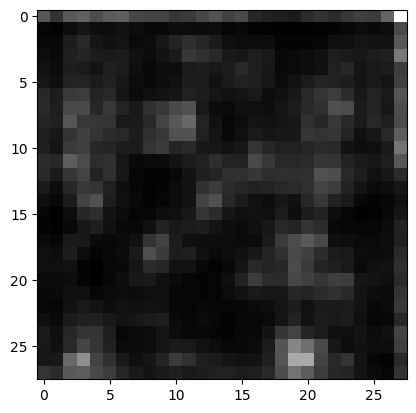

----------------------------------------


Discriminator Loss = 0.7156526446342468
Generator Loss = 1.3035112619400024
A sample image generated by the generator


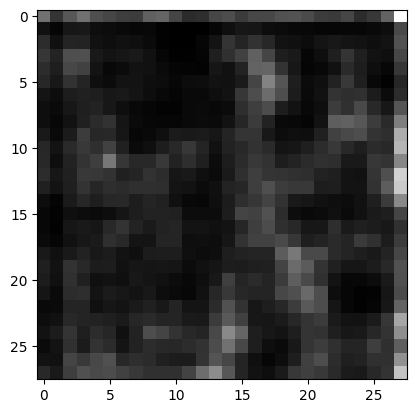

----------------------------------------


Discriminator Loss = 0.6602079272270203
Generator Loss = 1.344113826751709
A sample image generated by the generator


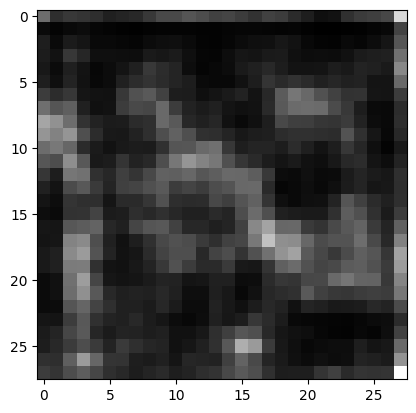

----------------------------------------


Discriminator Loss = 0.7186146974563599
Generator Loss = 1.2934850454330444
A sample image generated by the generator


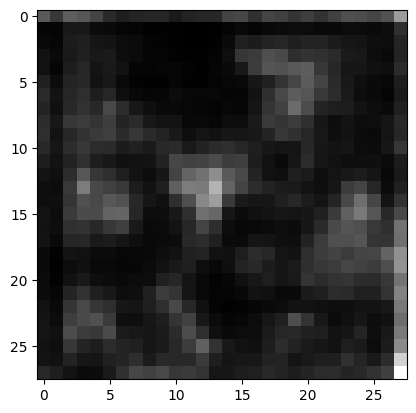

----------------------------------------


Discriminator Loss = 0.6831839680671692
Generator Loss = 1.3552727699279785
A sample image generated by the generator


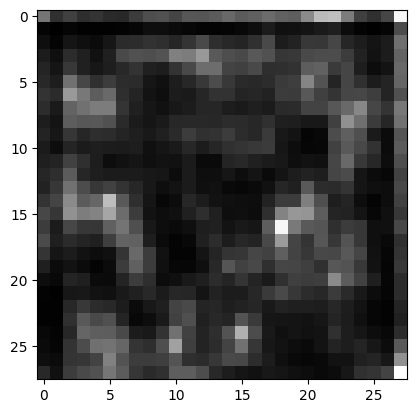

----------------------------------------


Discriminator Loss = 0.6587134599685669
Generator Loss = 1.31463623046875
A sample image generated by the generator


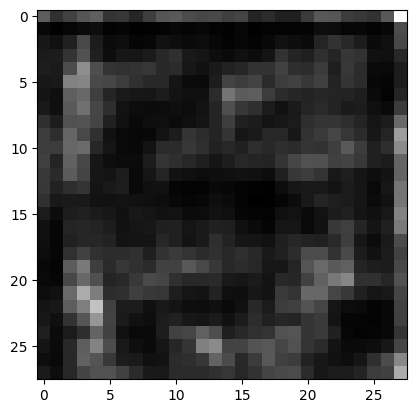

----------------------------------------


Discriminator Loss = 0.6681429743766785
Generator Loss = 1.3238167762756348
A sample image generated by the generator


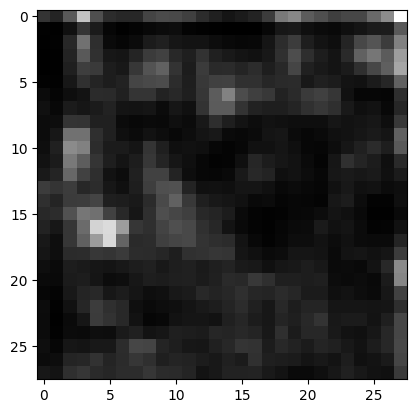

----------------------------------------


Discriminator Loss = 0.6269228458404541
Generator Loss = 1.3548882007598877
A sample image generated by the generator


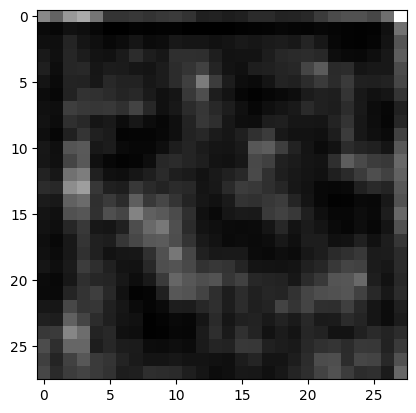

----------------------------------------


Discriminator Loss = 0.6256697177886963
Generator Loss = 1.3762853145599365
A sample image generated by the generator


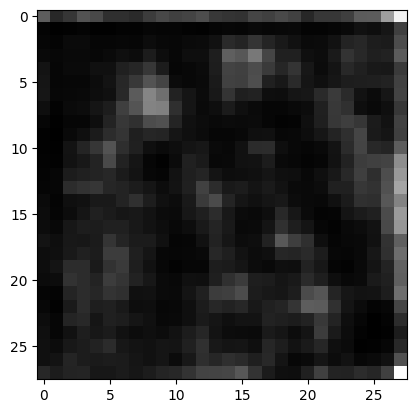

----------------------------------------


Discriminator Loss = 0.6595447659492493
Generator Loss = 1.3328338861465454
A sample image generated by the generator


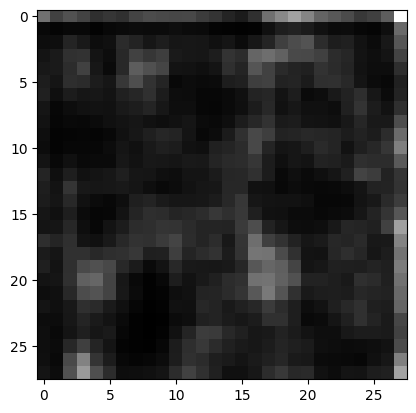

----------------------------------------


Discriminator Loss = 0.6484362483024597
Generator Loss = 1.3174313306808472
A sample image generated by the generator


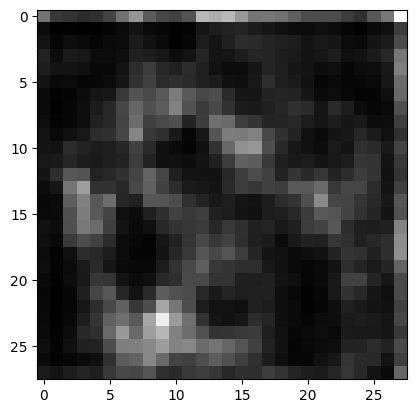

----------------------------------------


Discriminator Loss = 0.655808687210083
Generator Loss = 1.3397589921951294
A sample image generated by the generator


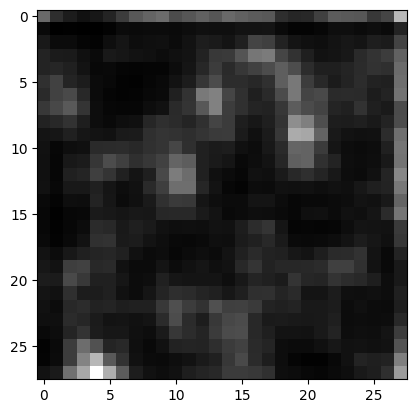

----------------------------------------


Discriminator Loss = 0.6653152704238892
Generator Loss = 1.2893162965774536
A sample image generated by the generator


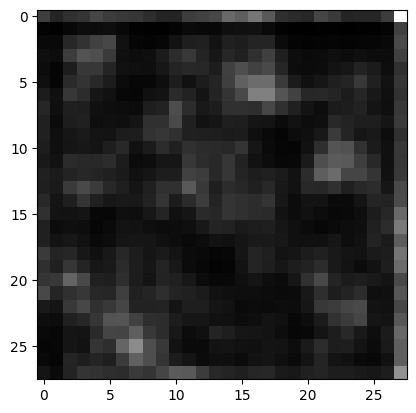

----------------------------------------


Discriminator Loss = 0.6188316345214844
Generator Loss = 1.3736573457717896
A sample image generated by the generator


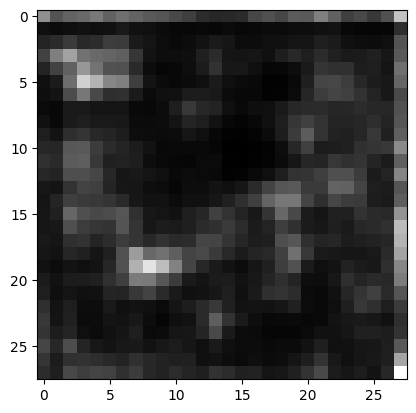

----------------------------------------


Discriminator Loss = 0.6448320150375366
Generator Loss = 1.3347249031066895
A sample image generated by the generator


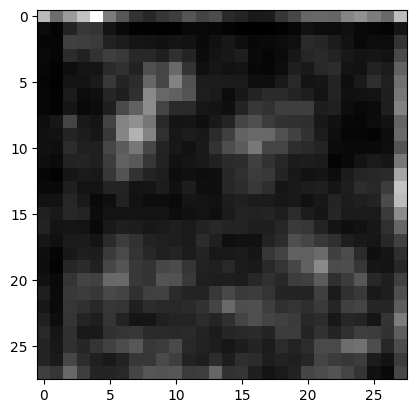

----------------------------------------


Discriminator Loss = 0.643490195274353
Generator Loss = 1.3668830394744873
A sample image generated by the generator


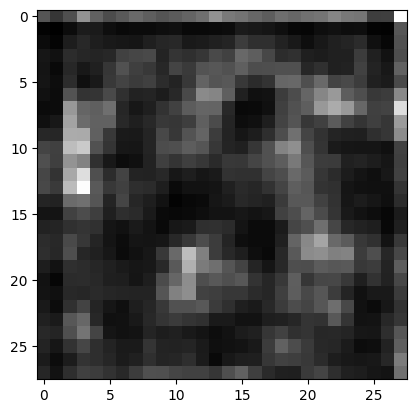

----------------------------------------


Discriminator Loss = 0.6484917402267456
Generator Loss = 1.3113200664520264
A sample image generated by the generator


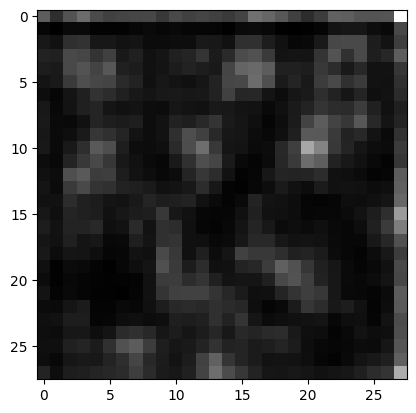

----------------------------------------


Discriminator Loss = 0.6335679292678833
Generator Loss = 1.3936208486557007
A sample image generated by the generator


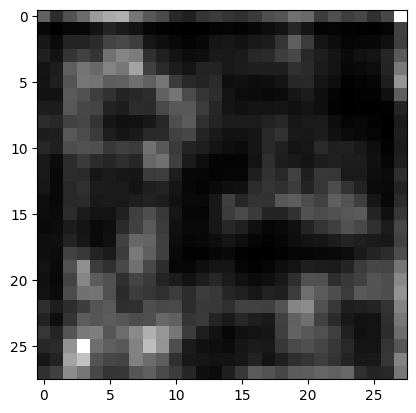

----------------------------------------


Discriminator Loss = 0.666067361831665
Generator Loss = 1.3579049110412598
A sample image generated by the generator


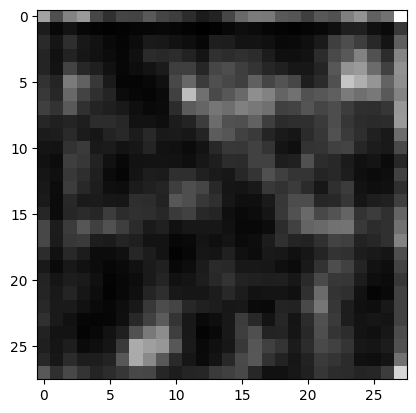

----------------------------------------


Discriminator Loss = 0.6680310964584351
Generator Loss = 1.3791799545288086
A sample image generated by the generator


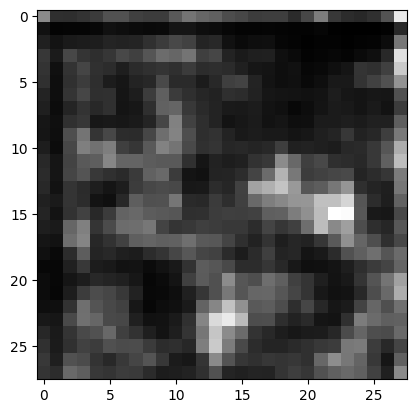

----------------------------------------


Discriminator Loss = 0.6068393588066101
Generator Loss = 1.3010139465332031
A sample image generated by the generator


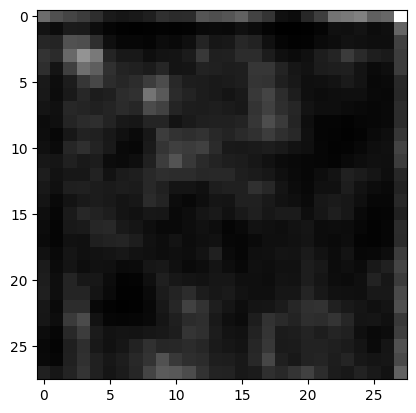

----------------------------------------


Discriminator Loss = 0.6479051113128662
Generator Loss = 1.4144803285598755
A sample image generated by the generator


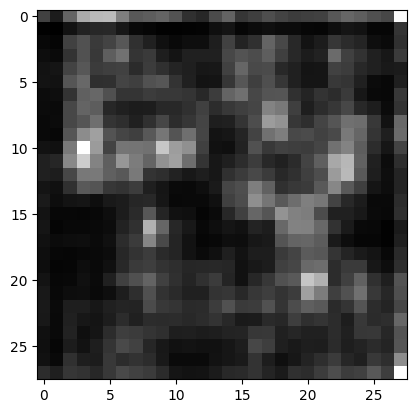

----------------------------------------


Discriminator Loss = 0.6429007053375244
Generator Loss = 1.3449301719665527
A sample image generated by the generator


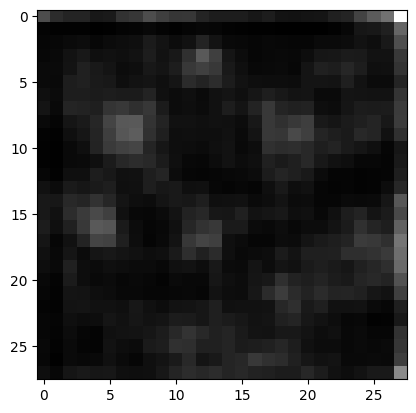

----------------------------------------


Discriminator Loss = 0.6678464412689209
Generator Loss = 1.3717350959777832
A sample image generated by the generator


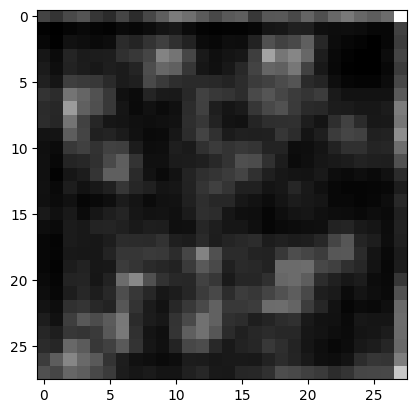

----------------------------------------


Discriminator Loss = 0.6503903269767761
Generator Loss = 1.3683212995529175
A sample image generated by the generator


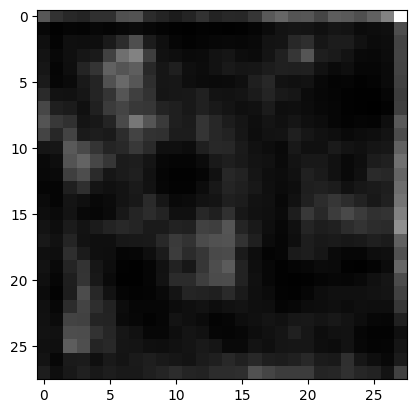

----------------------------------------


Discriminator Loss = 0.6326367855072021
Generator Loss = 1.3237097263336182
A sample image generated by the generator


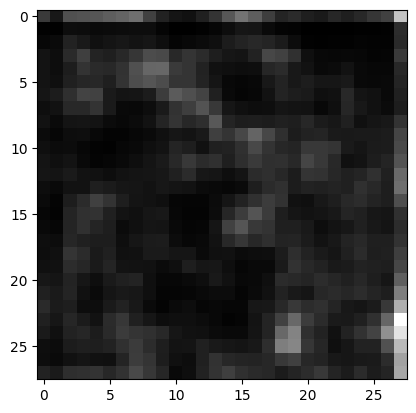

----------------------------------------


Discriminator Loss = 0.6446345448493958
Generator Loss = 1.4120380878448486
A sample image generated by the generator


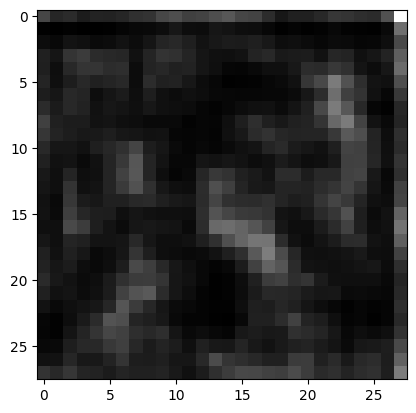

----------------------------------------


Discriminator Loss = 0.6314621567726135
Generator Loss = 1.4100074768066406
A sample image generated by the generator


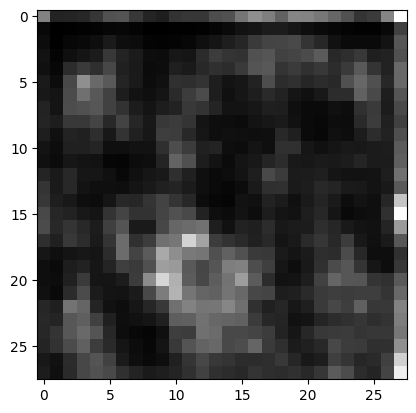

----------------------------------------


Discriminator Loss = 0.6395313739776611
Generator Loss = 1.3690204620361328
A sample image generated by the generator


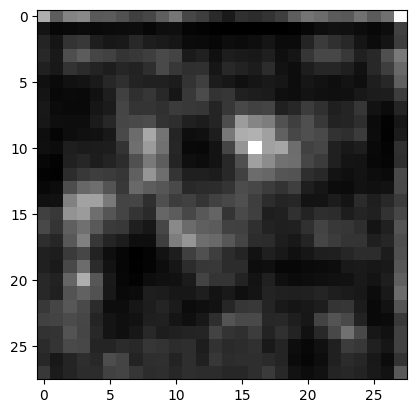

----------------------------------------


Discriminator Loss = 0.6684895753860474
Generator Loss = 1.3705027103424072
A sample image generated by the generator


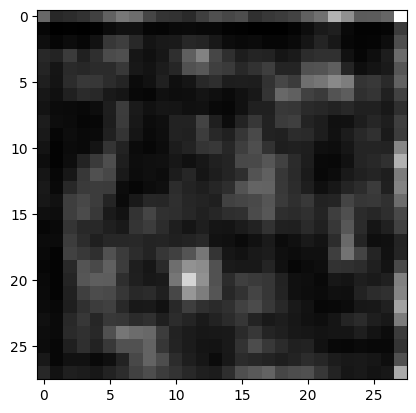

----------------------------------------


Discriminator Loss = 0.5892243385314941
Generator Loss = 1.3469858169555664
A sample image generated by the generator


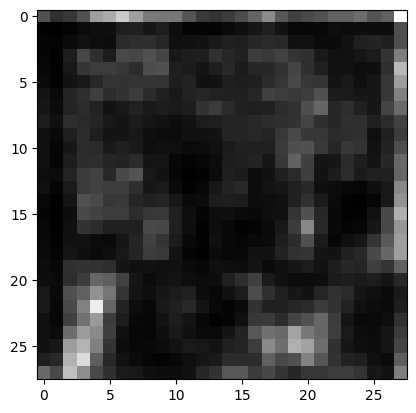

----------------------------------------


Discriminator Loss = 0.6623343229293823
Generator Loss = 1.3787834644317627
A sample image generated by the generator


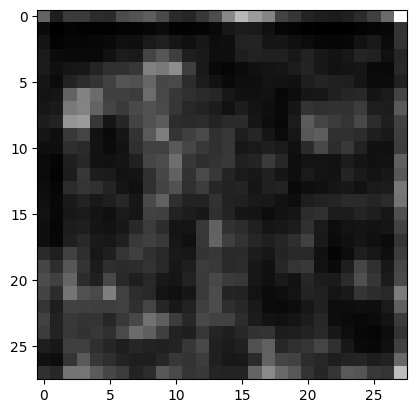

----------------------------------------


Discriminator Loss = 0.6315512657165527
Generator Loss = 1.3014960289001465
A sample image generated by the generator


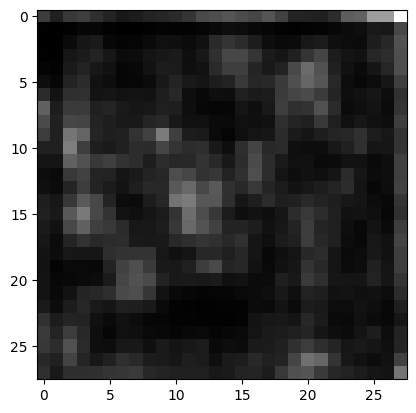

----------------------------------------


Discriminator Loss = 0.6052061319351196
Generator Loss = 1.38597571849823
A sample image generated by the generator


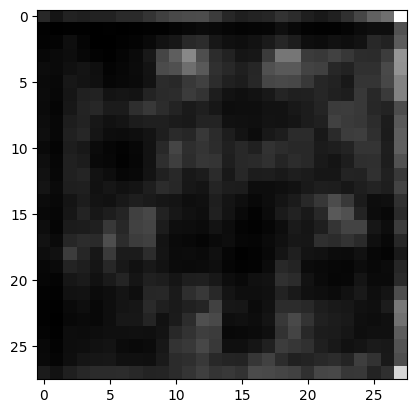

----------------------------------------


Discriminator Loss = 0.6403095722198486
Generator Loss = 1.3499919176101685
A sample image generated by the generator


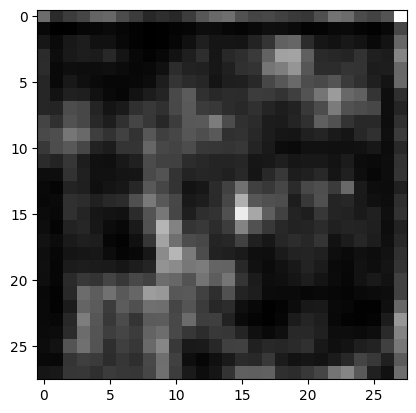

----------------------------------------


Discriminator Loss = 0.6201491355895996
Generator Loss = 1.3903391361236572
A sample image generated by the generator


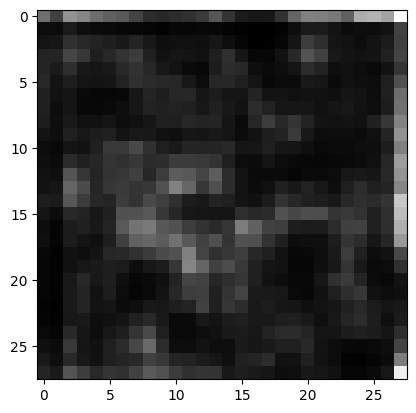

----------------------------------------


Discriminator Loss = 0.6536773443222046
Generator Loss = 1.412509560585022
A sample image generated by the generator


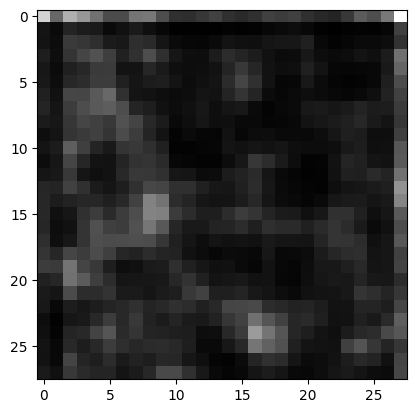

----------------------------------------


Discriminator Loss = 0.6415048837661743
Generator Loss = 1.3697761297225952
A sample image generated by the generator


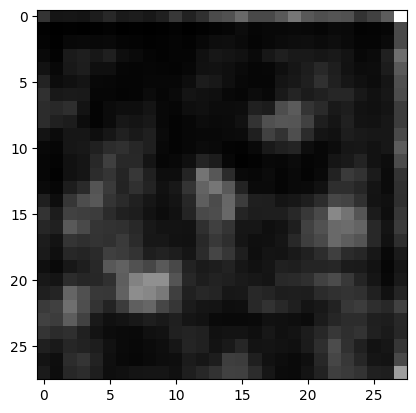

----------------------------------------


Discriminator Loss = 0.631986677646637
Generator Loss = 1.3168537616729736
A sample image generated by the generator


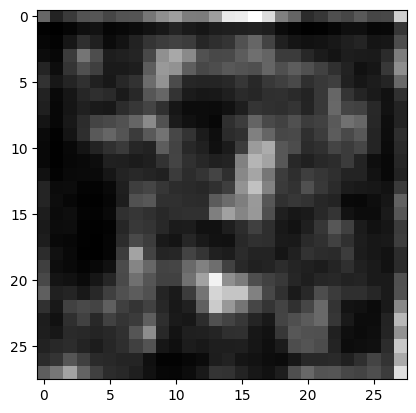

----------------------------------------


Discriminator Loss = 0.6165276169776917
Generator Loss = 1.3856754302978516
A sample image generated by the generator


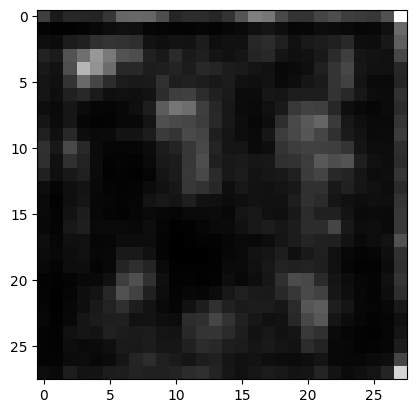

----------------------------------------


Discriminator Loss = 0.6433447599411011
Generator Loss = 1.3170398473739624
A sample image generated by the generator


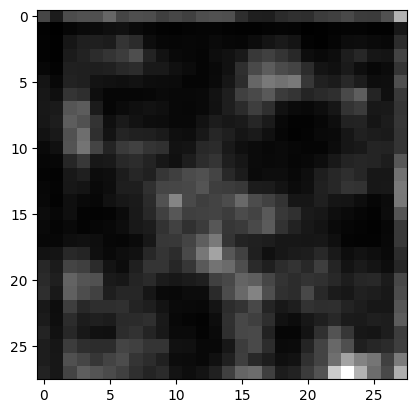

----------------------------------------


Discriminator Loss = 0.6158519983291626
Generator Loss = 1.4095226526260376
A sample image generated by the generator


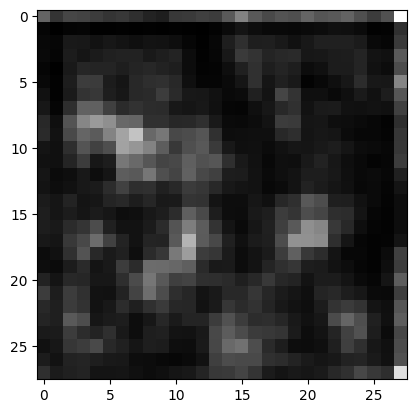

----------------------------------------


Discriminator Loss = 0.6154429316520691
Generator Loss = 1.391910195350647
A sample image generated by the generator


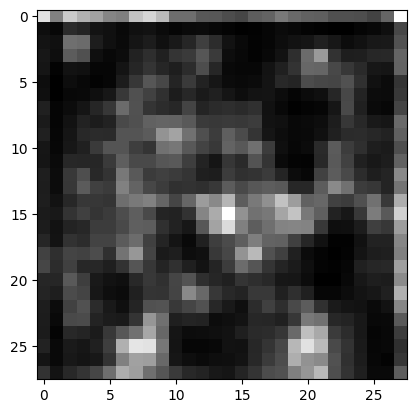

----------------------------------------


Discriminator Loss = 0.6056878566741943
Generator Loss = 1.4170992374420166
A sample image generated by the generator


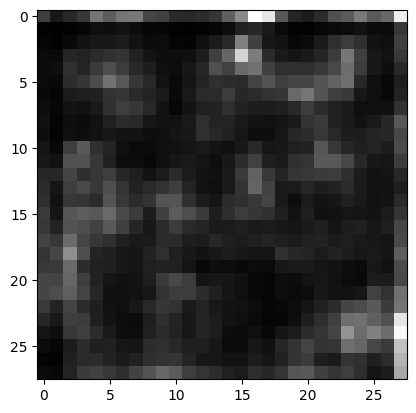

----------------------------------------


Discriminator Loss = 0.61339271068573
Generator Loss = 1.4026989936828613
A sample image generated by the generator


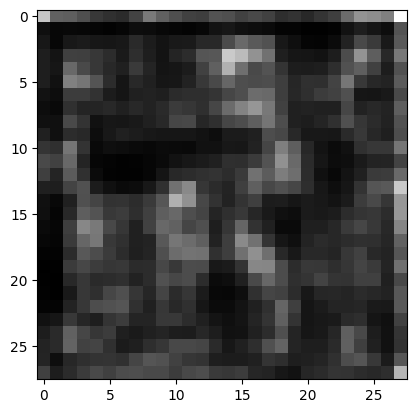

----------------------------------------


Discriminator Loss = 0.6112508773803711
Generator Loss = 1.3939704895019531
A sample image generated by the generator


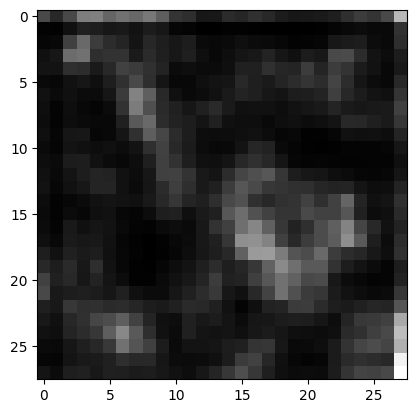

----------------------------------------


Discriminator Loss = 0.5705697536468506
Generator Loss = 1.4421131610870361
A sample image generated by the generator


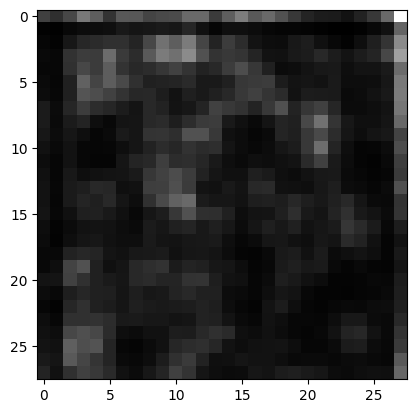

----------------------------------------


Discriminator Loss = 0.6268803477287292
Generator Loss = 1.4739303588867188
A sample image generated by the generator


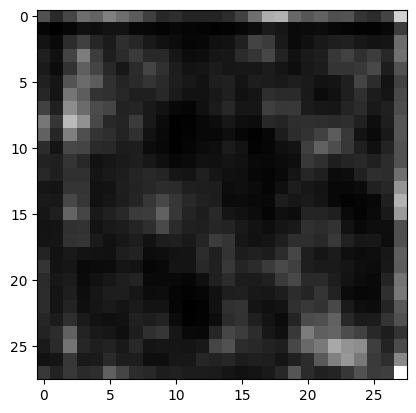

----------------------------------------


Discriminator Loss = 0.6358618140220642
Generator Loss = 1.3738906383514404
A sample image generated by the generator


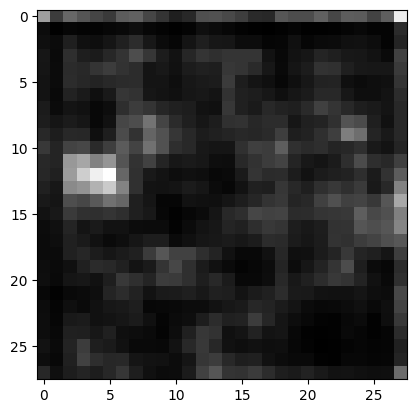

----------------------------------------


Discriminator Loss = 0.5837627649307251
Generator Loss = 1.375701665878296
A sample image generated by the generator


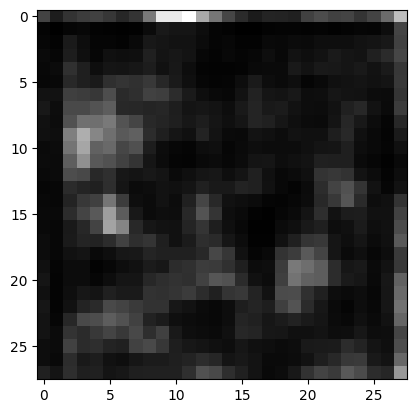

----------------------------------------


Discriminator Loss = 0.6141657829284668
Generator Loss = 1.4219744205474854
A sample image generated by the generator


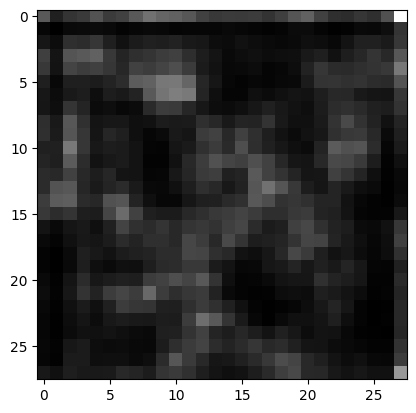

----------------------------------------


Discriminator Loss = 0.6149486303329468
Generator Loss = 1.3533077239990234
A sample image generated by the generator


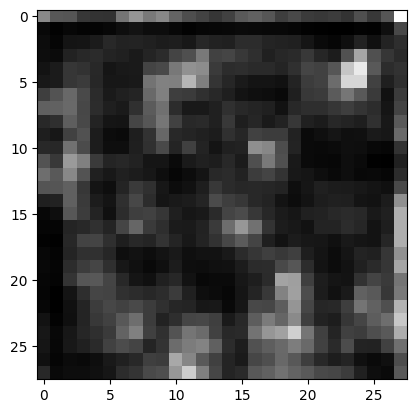

----------------------------------------


Discriminator Loss = 0.6200857758522034
Generator Loss = 1.3977800607681274
A sample image generated by the generator


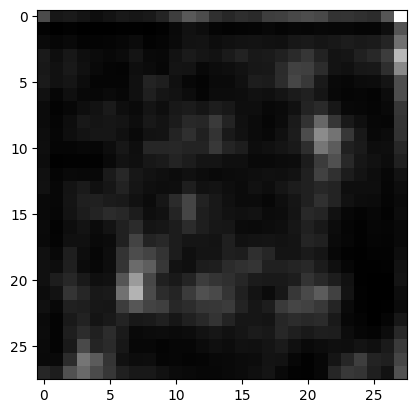

----------------------------------------


Discriminator Loss = 0.6106160879135132
Generator Loss = 1.3703638315200806
A sample image generated by the generator


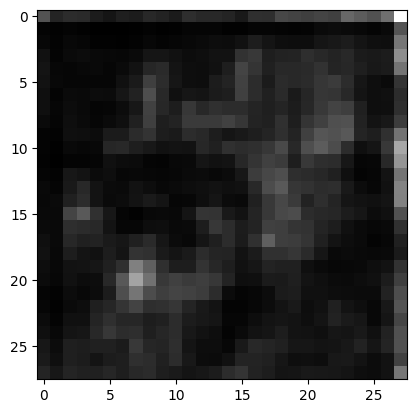

----------------------------------------


Discriminator Loss = 0.5920072793960571
Generator Loss = 1.416995882987976
A sample image generated by the generator


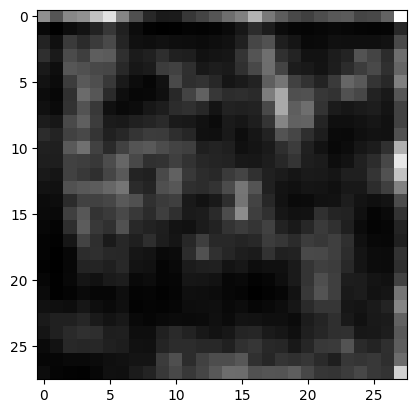

----------------------------------------


Discriminator Loss = 0.6081751585006714
Generator Loss = 1.3904494047164917
A sample image generated by the generator


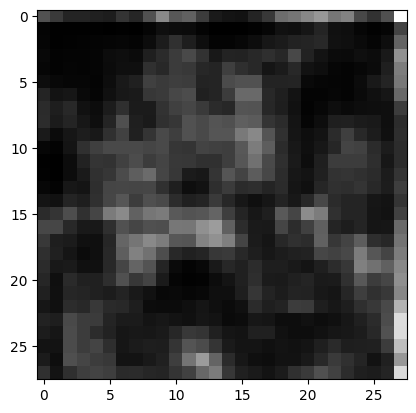

----------------------------------------


Discriminator Loss = 0.5848652124404907
Generator Loss = 1.3969616889953613
A sample image generated by the generator


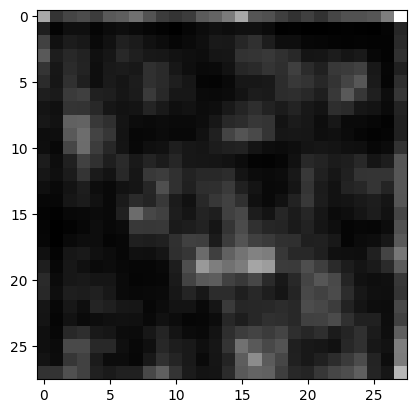

----------------------------------------


Discriminator Loss = 0.537161111831665
Generator Loss = 1.436309576034546
A sample image generated by the generator


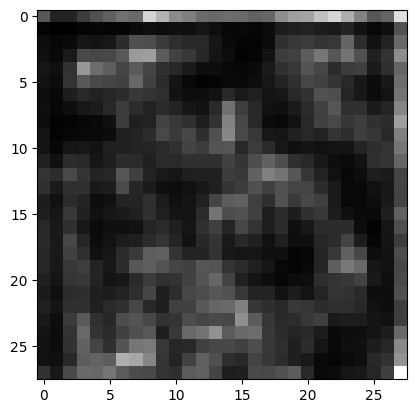

----------------------------------------


Discriminator Loss = 0.6401883363723755
Generator Loss = 1.4358546733856201
A sample image generated by the generator


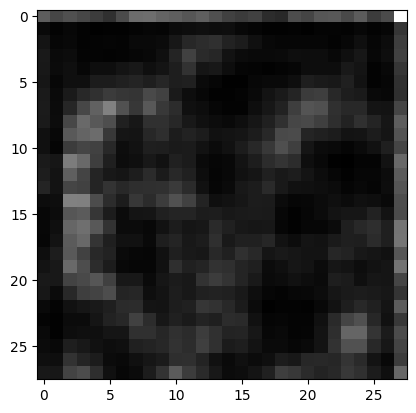

----------------------------------------


Discriminator Loss = 0.598143994808197
Generator Loss = 1.4452661275863647
A sample image generated by the generator


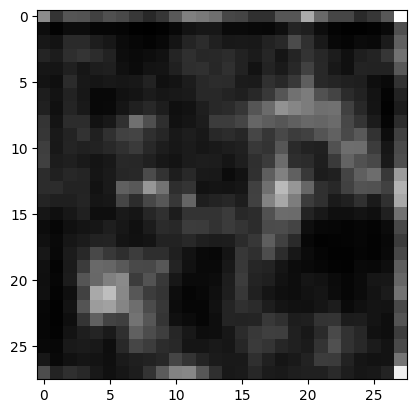

----------------------------------------


Discriminator Loss = 0.5809319615364075
Generator Loss = 1.4951887130737305
A sample image generated by the generator


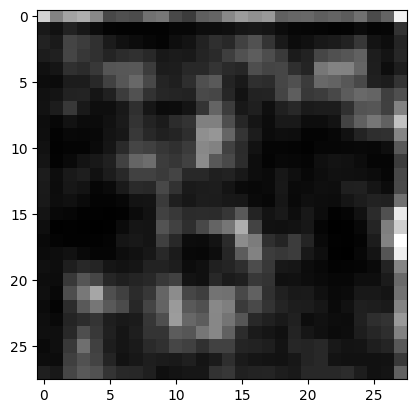

----------------------------------------


Discriminator Loss = 0.5898698568344116
Generator Loss = 1.401180624961853
A sample image generated by the generator


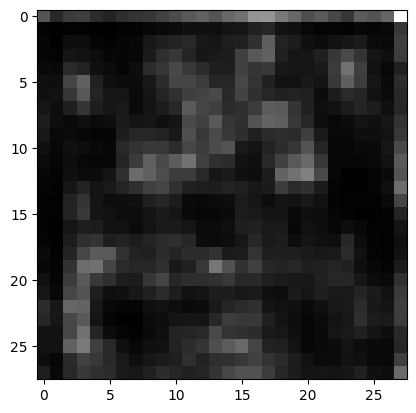

----------------------------------------


Discriminator Loss = 0.6098001003265381
Generator Loss = 1.4427851438522339
A sample image generated by the generator


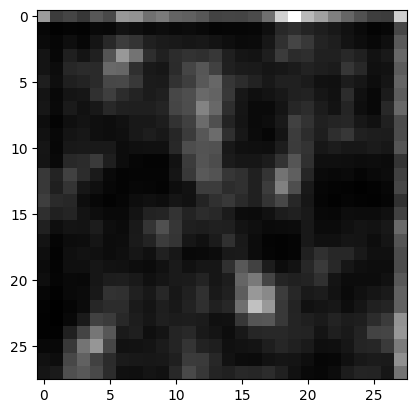

----------------------------------------


Discriminator Loss = 0.5682014226913452
Generator Loss = 1.4334018230438232
A sample image generated by the generator


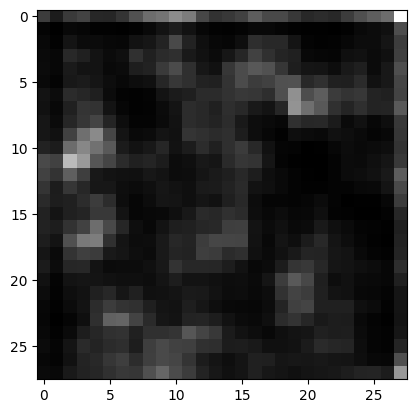

----------------------------------------


Discriminator Loss = 0.6030852794647217
Generator Loss = 1.4882084131240845
A sample image generated by the generator


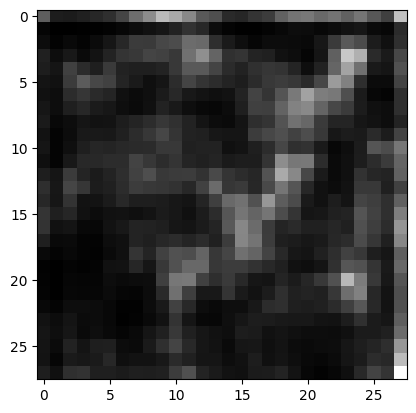

----------------------------------------


Discriminator Loss = 0.5532967448234558
Generator Loss = 1.4390380382537842
A sample image generated by the generator


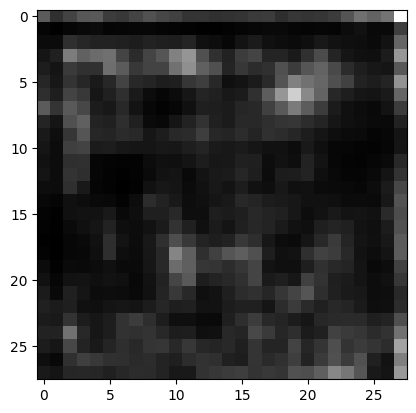

----------------------------------------


Discriminator Loss = 0.6188894510269165
Generator Loss = 1.4295798540115356
A sample image generated by the generator


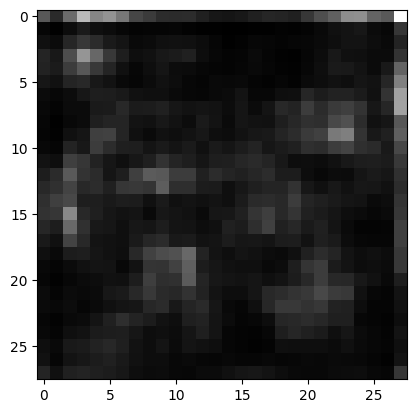

----------------------------------------


Discriminator Loss = 0.5713692903518677
Generator Loss = 1.3477444648742676
A sample image generated by the generator


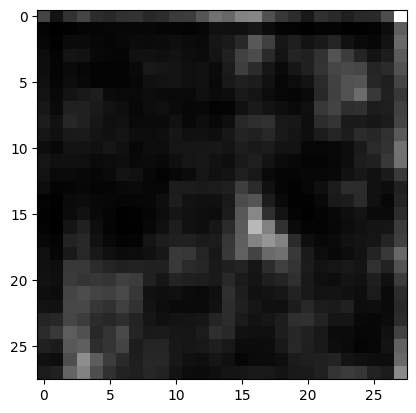

----------------------------------------


Discriminator Loss = 0.5900939702987671
Generator Loss = 1.4621095657348633
A sample image generated by the generator


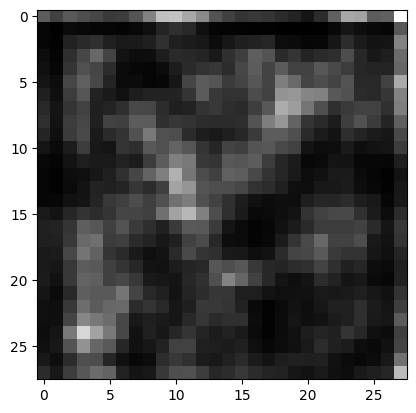

----------------------------------------


Discriminator Loss = 0.6012617349624634
Generator Loss = 1.4766044616699219
A sample image generated by the generator


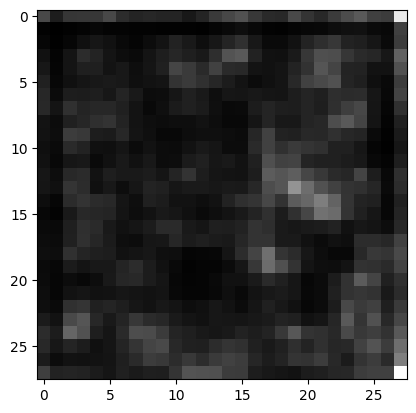

----------------------------------------


Discriminator Loss = 0.6039799451828003
Generator Loss = 1.478325605392456
A sample image generated by the generator


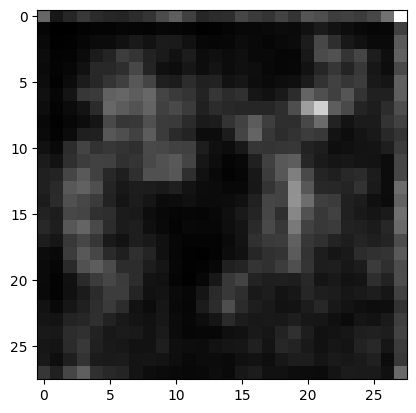

----------------------------------------


Discriminator Loss = 0.5607157945632935
Generator Loss = 1.4605576992034912
A sample image generated by the generator


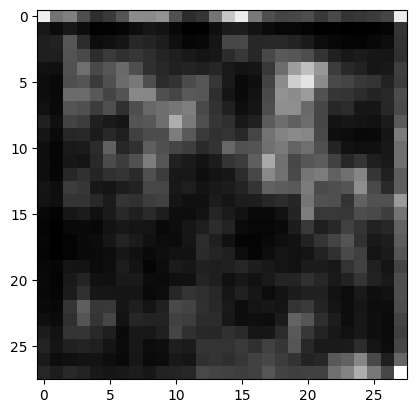

----------------------------------------


Discriminator Loss = 0.6088560819625854
Generator Loss = 1.4662784337997437
A sample image generated by the generator


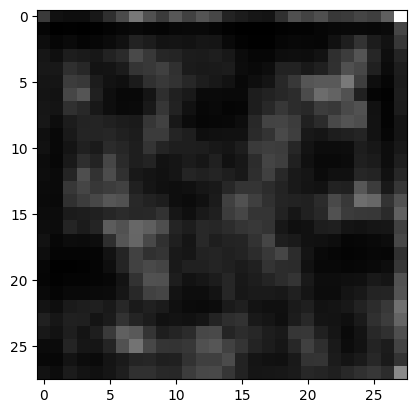

----------------------------------------


Discriminator Loss = 0.5854761600494385
Generator Loss = 1.4081645011901855
A sample image generated by the generator


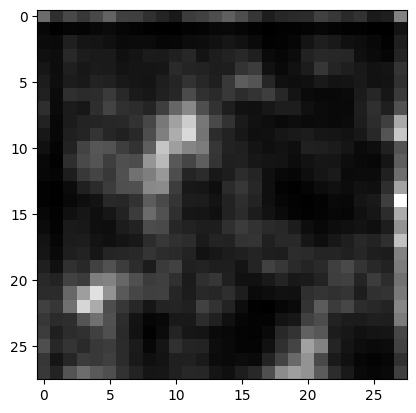

----------------------------------------


Discriminator Loss = 0.5554071068763733
Generator Loss = 1.491811752319336
A sample image generated by the generator


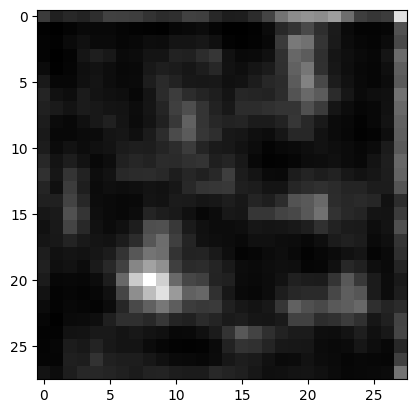

----------------------------------------


Discriminator Loss = 0.6059120297431946
Generator Loss = 1.461356520652771
A sample image generated by the generator


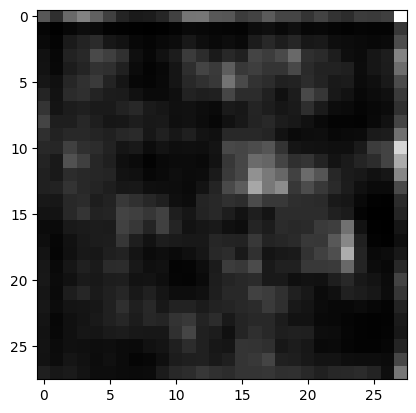

----------------------------------------


Discriminator Loss = 0.5847342014312744
Generator Loss = 1.476501226425171
A sample image generated by the generator


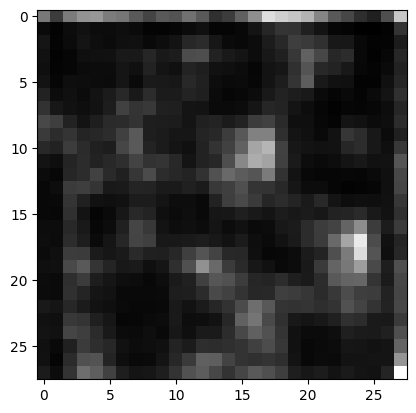

----------------------------------------


Discriminator Loss = 0.5711988806724548
Generator Loss = 1.4665247201919556
A sample image generated by the generator


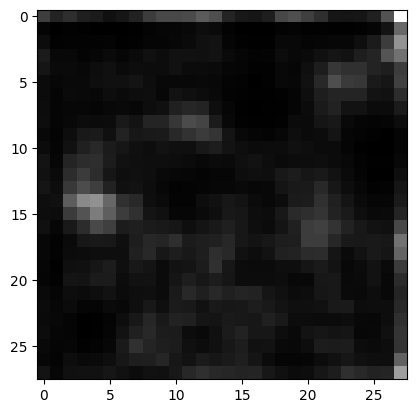

----------------------------------------


Discriminator Loss = 0.6103578209877014
Generator Loss = 1.485388994216919
A sample image generated by the generator


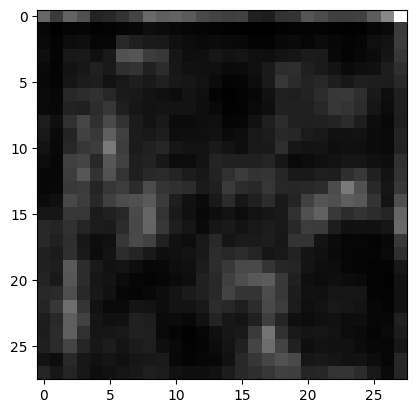

----------------------------------------


Discriminator Loss = 0.5609934329986572
Generator Loss = 1.444771647453308
A sample image generated by the generator


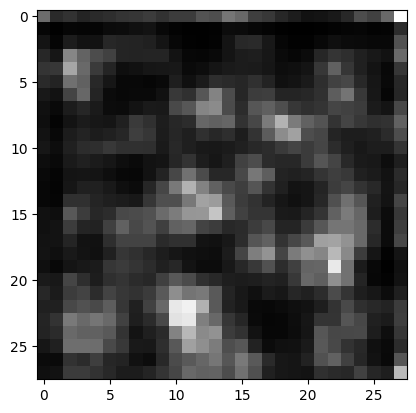

----------------------------------------


Discriminator Loss = 0.5857779383659363
Generator Loss = 1.5074710845947266
A sample image generated by the generator


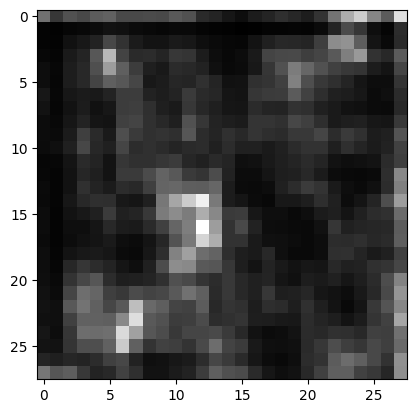

----------------------------------------


Discriminator Loss = 0.5797567367553711
Generator Loss = 1.443655014038086
A sample image generated by the generator


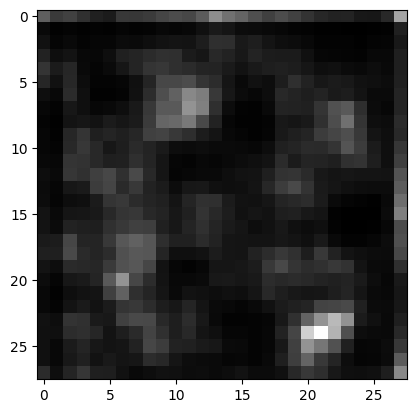

----------------------------------------


Discriminator Loss = 0.5326859951019287
Generator Loss = 1.4583920240402222
A sample image generated by the generator


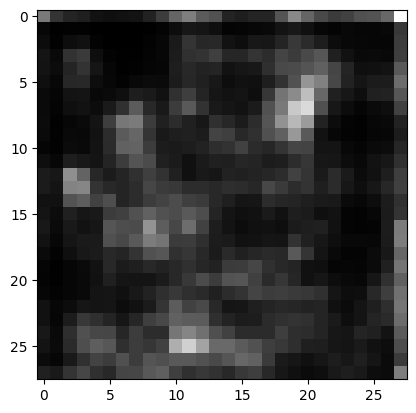

----------------------------------------


Discriminator Loss = 0.5683268308639526
Generator Loss = 1.4352213144302368
A sample image generated by the generator


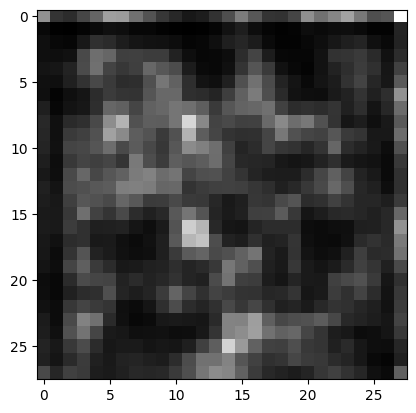

----------------------------------------


Discriminator Loss = 0.5601862668991089
Generator Loss = 1.4227187633514404
A sample image generated by the generator


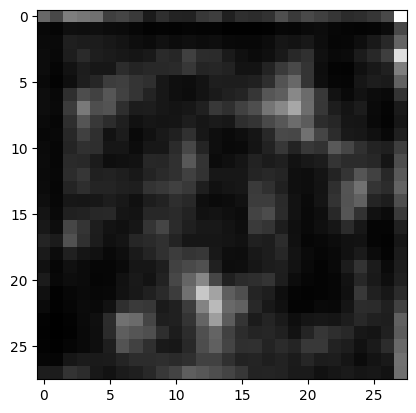

----------------------------------------


Discriminator Loss = 0.5809152126312256
Generator Loss = 1.4704748392105103
A sample image generated by the generator


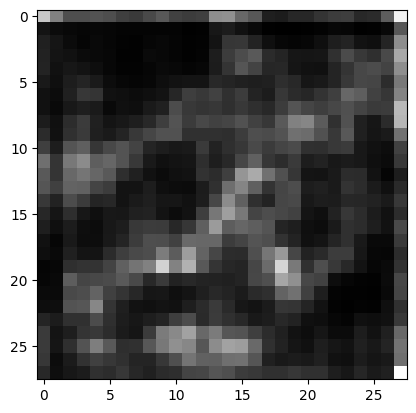

----------------------------------------


Discriminator Loss = 0.5626181364059448
Generator Loss = 1.5103437900543213
A sample image generated by the generator


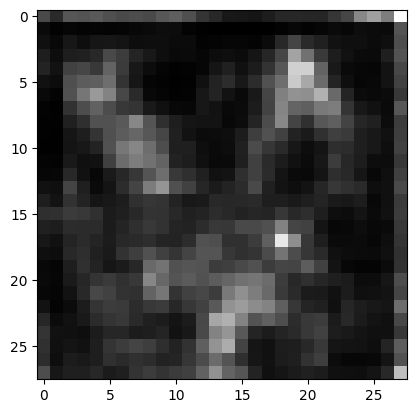

----------------------------------------


Discriminator Loss = 0.563056230545044
Generator Loss = 1.4128353595733643
A sample image generated by the generator


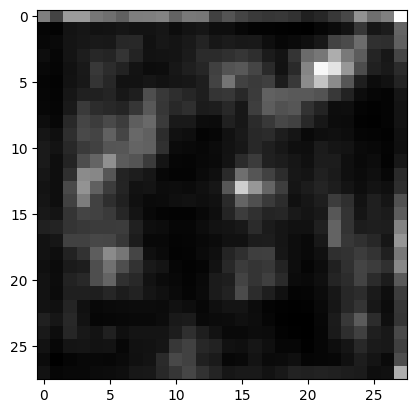

----------------------------------------


Discriminator Loss = 0.5432806015014648
Generator Loss = 1.3763993978500366
A sample image generated by the generator


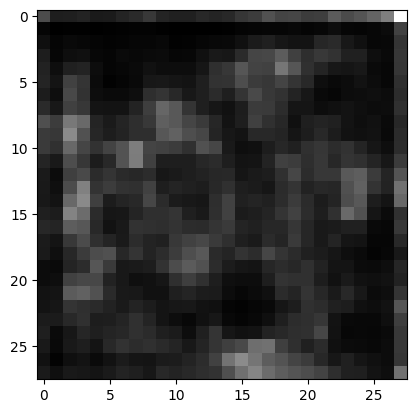

----------------------------------------


Discriminator Loss = 0.5415564775466919
Generator Loss = 1.455573558807373
A sample image generated by the generator


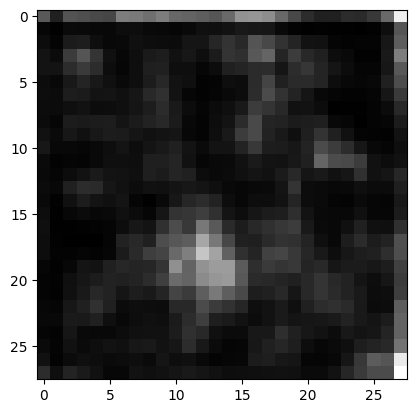

----------------------------------------


Discriminator Loss = 0.580917239189148
Generator Loss = 1.5048637390136719
A sample image generated by the generator


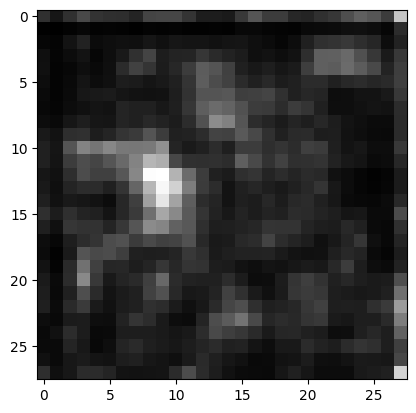

----------------------------------------


Discriminator Loss = 0.5603641271591187
Generator Loss = 1.5013914108276367
A sample image generated by the generator


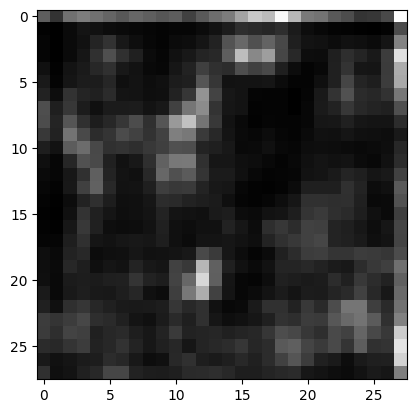

----------------------------------------


Discriminator Loss = 0.5489364862442017
Generator Loss = 1.5053696632385254
A sample image generated by the generator


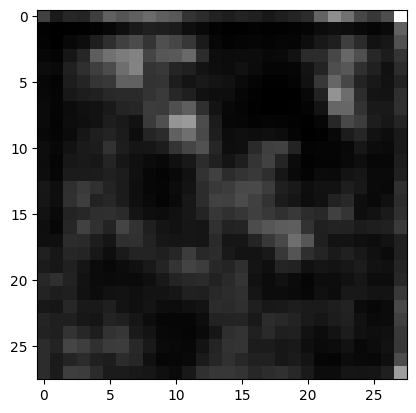

----------------------------------------


Discriminator Loss = 0.5580489039421082
Generator Loss = 1.3949170112609863
A sample image generated by the generator


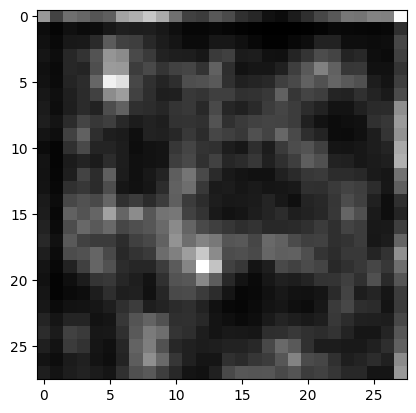

----------------------------------------


Discriminator Loss = 0.5396362543106079
Generator Loss = 1.5643874406814575
A sample image generated by the generator


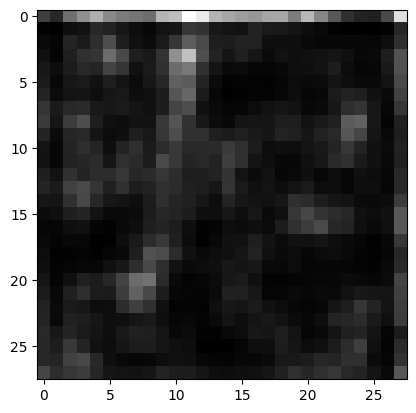

----------------------------------------


Discriminator Loss = 0.5377258062362671
Generator Loss = 1.4595675468444824
A sample image generated by the generator


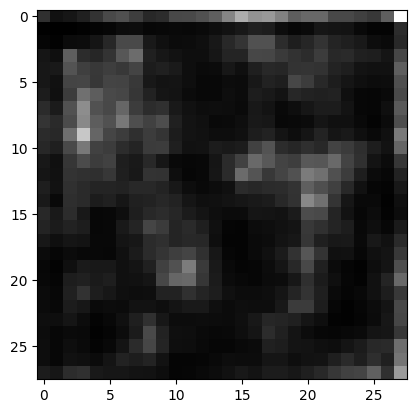

----------------------------------------


Discriminator Loss = 0.5533601641654968
Generator Loss = 1.5732545852661133
A sample image generated by the generator


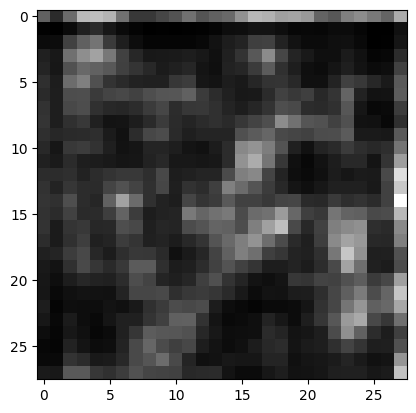

----------------------------------------


Discriminator Loss = 0.5384451150894165
Generator Loss = 1.6046020984649658
A sample image generated by the generator


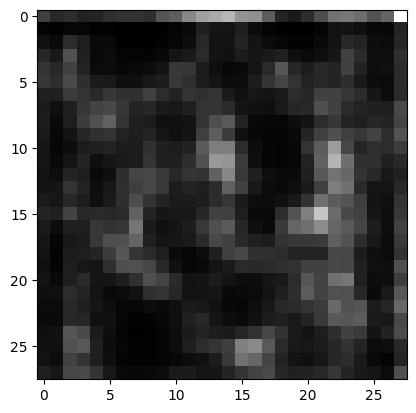

----------------------------------------


Discriminator Loss = 0.5637420415878296
Generator Loss = 1.5544252395629883
A sample image generated by the generator


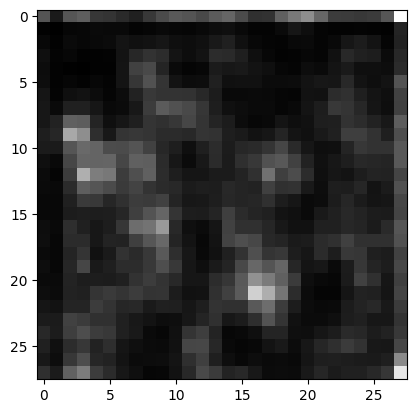

----------------------------------------


Discriminator Loss = 0.5441819429397583
Generator Loss = 1.4156723022460938
A sample image generated by the generator


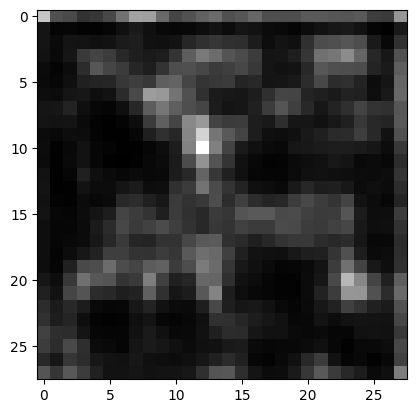

----------------------------------------


Discriminator Loss = 0.5312237739562988
Generator Loss = 1.4440261125564575
A sample image generated by the generator


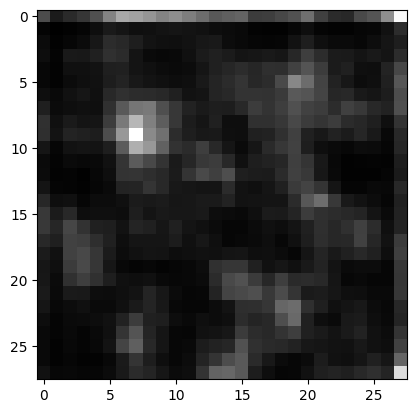

----------------------------------------


Discriminator Loss = 0.5441595911979675
Generator Loss = 1.4786885976791382
A sample image generated by the generator


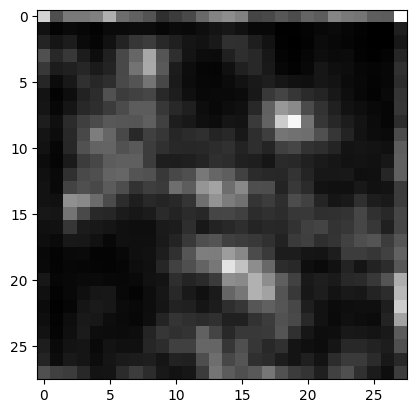

----------------------------------------


Discriminator Loss = 0.5487510561943054
Generator Loss = 1.4786949157714844
A sample image generated by the generator


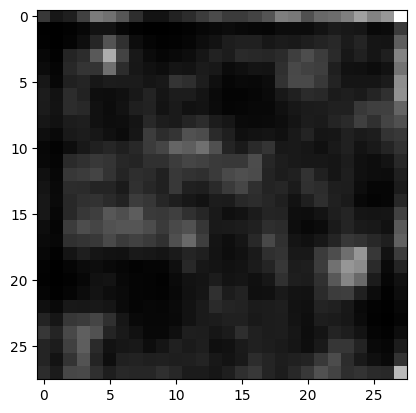

----------------------------------------


Discriminator Loss = 0.5595582127571106
Generator Loss = 1.456773042678833
A sample image generated by the generator


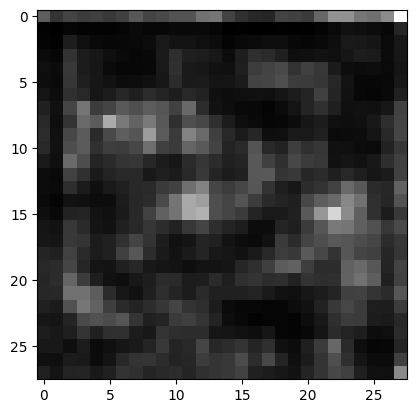

----------------------------------------


Discriminator Loss = 0.5481643080711365
Generator Loss = 1.453406810760498
A sample image generated by the generator


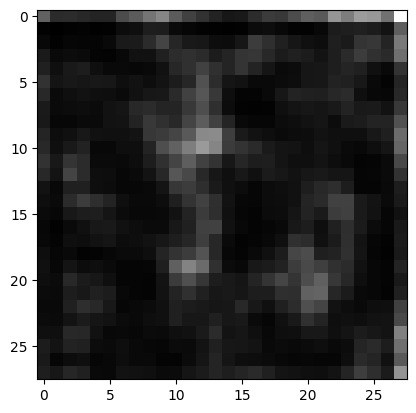

----------------------------------------


Discriminator Loss = 0.5658896565437317
Generator Loss = 1.5305347442626953
A sample image generated by the generator


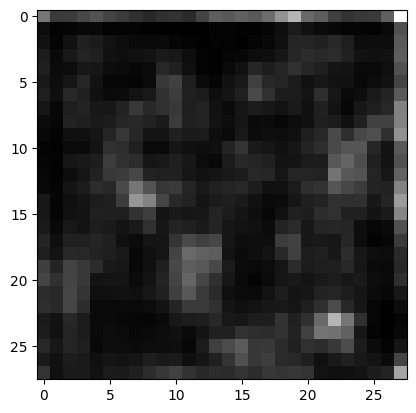

----------------------------------------


Discriminator Loss = 0.53813636302948
Generator Loss = 1.6190931797027588
A sample image generated by the generator


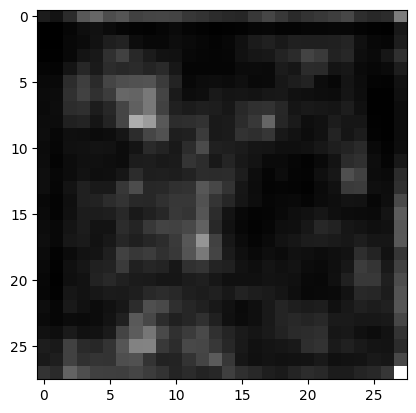

----------------------------------------


Discriminator Loss = 0.5057697296142578
Generator Loss = 1.5636179447174072
A sample image generated by the generator


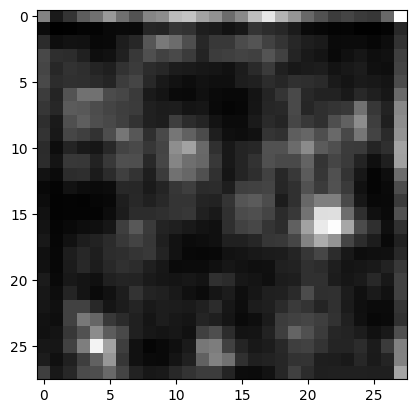

----------------------------------------


Discriminator Loss = 0.5453447103500366
Generator Loss = 1.5013734102249146
A sample image generated by the generator


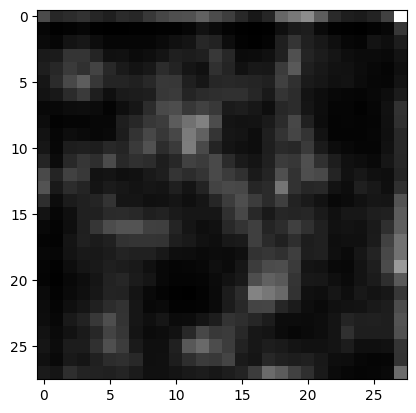

----------------------------------------


Discriminator Loss = 0.586116373538971
Generator Loss = 1.5683887004852295
A sample image generated by the generator


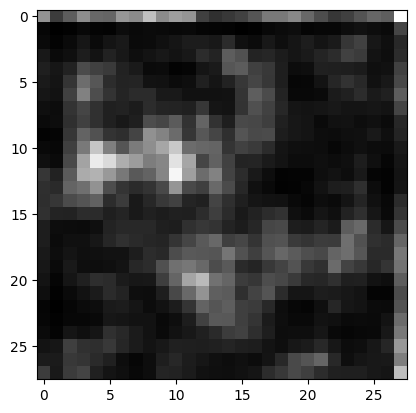

----------------------------------------


Discriminator Loss = 0.5584073066711426
Generator Loss = 1.5552921295166016
A sample image generated by the generator


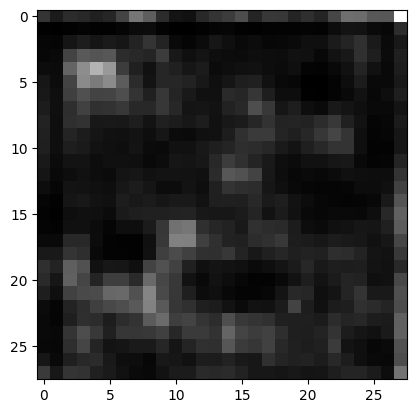

----------------------------------------


Discriminator Loss = 0.5747029781341553
Generator Loss = 1.5273271799087524
A sample image generated by the generator


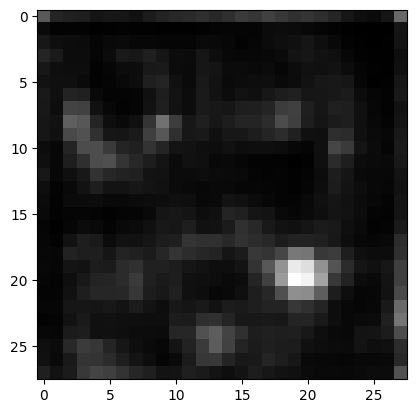

----------------------------------------


Discriminator Loss = 0.5546148419380188
Generator Loss = 1.466583013534546
A sample image generated by the generator


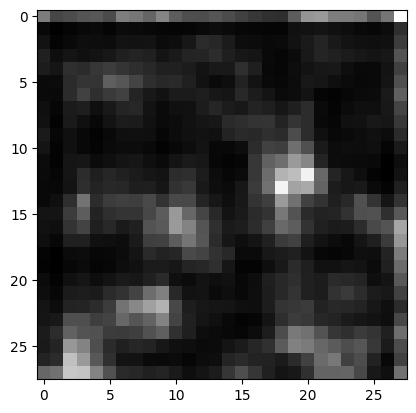

----------------------------------------


Discriminator Loss = 0.5162690877914429
Generator Loss = 1.538588523864746
A sample image generated by the generator


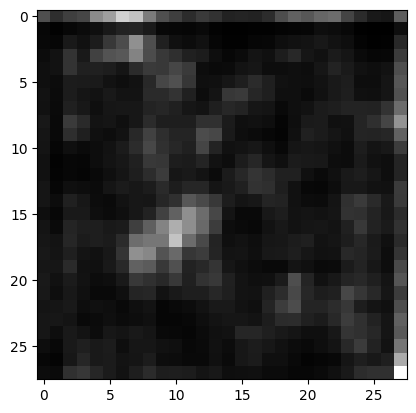

----------------------------------------


Discriminator Loss = 0.5058841705322266
Generator Loss = 1.5097172260284424
A sample image generated by the generator


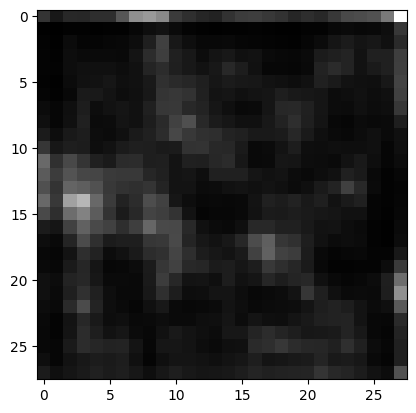

----------------------------------------


Discriminator Loss = 0.5049661993980408
Generator Loss = 1.483907699584961
A sample image generated by the generator


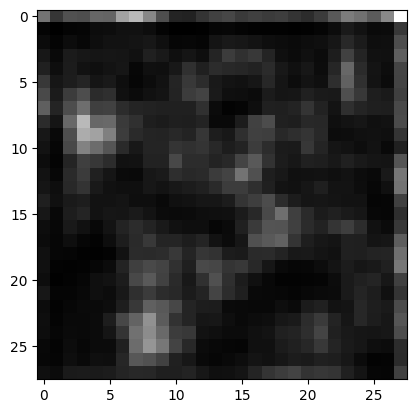

----------------------------------------


Discriminator Loss = 0.5342596769332886
Generator Loss = 1.5888837575912476
A sample image generated by the generator


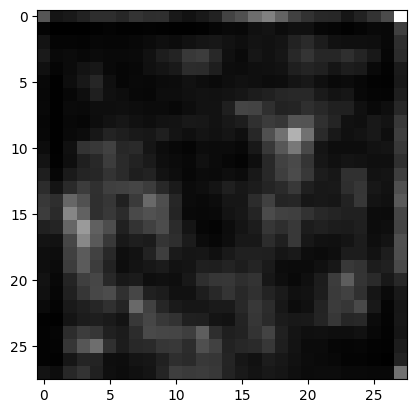

----------------------------------------


Discriminator Loss = 0.5371681451797485
Generator Loss = 1.50809645652771
A sample image generated by the generator


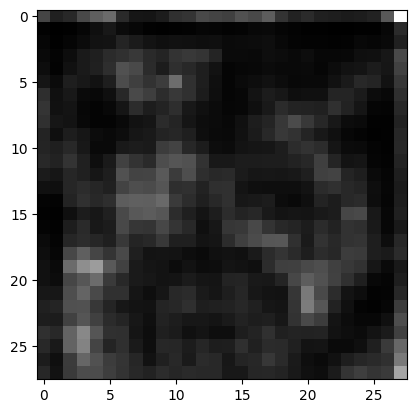

----------------------------------------


Discriminator Loss = 0.5225350260734558
Generator Loss = 1.5422555208206177
A sample image generated by the generator


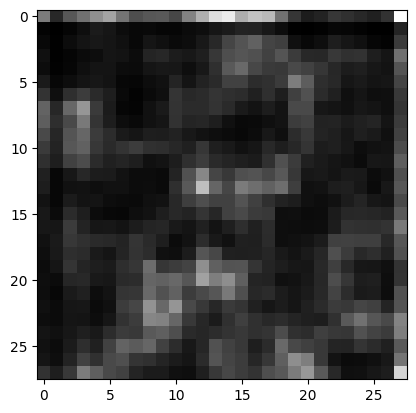

----------------------------------------


Discriminator Loss = 0.5094254016876221
Generator Loss = 1.488297462463379
A sample image generated by the generator


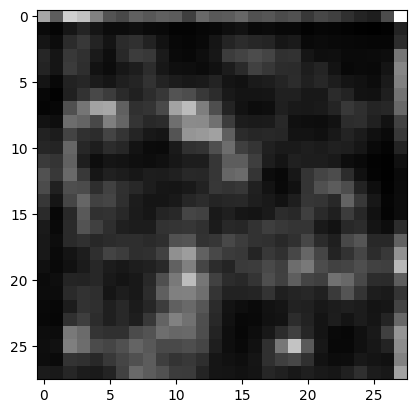

----------------------------------------


Discriminator Loss = 0.5235635042190552
Generator Loss = 1.498902678489685
A sample image generated by the generator


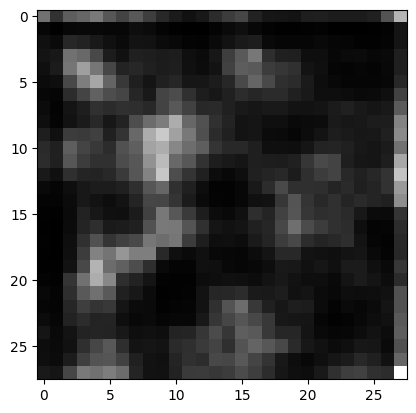

----------------------------------------


Discriminator Loss = 0.5250966548919678
Generator Loss = 1.601142168045044
A sample image generated by the generator


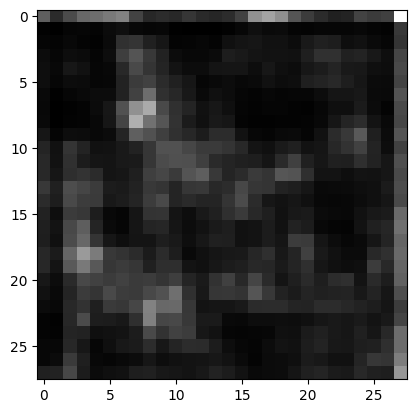

----------------------------------------


Discriminator Loss = 0.5522299408912659
Generator Loss = 1.470442533493042
A sample image generated by the generator


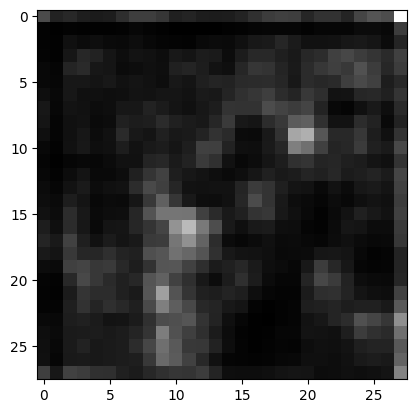

----------------------------------------


Discriminator Loss = 0.47937893867492676
Generator Loss = 1.5475393533706665
A sample image generated by the generator


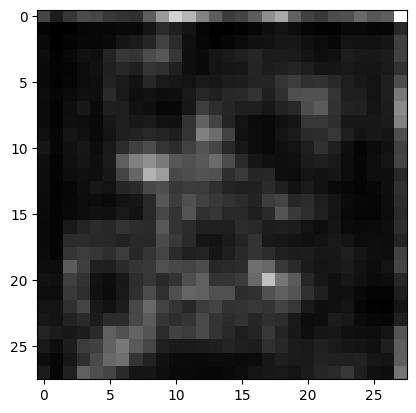

----------------------------------------


Discriminator Loss = 0.5445706844329834
Generator Loss = 1.507392406463623
A sample image generated by the generator


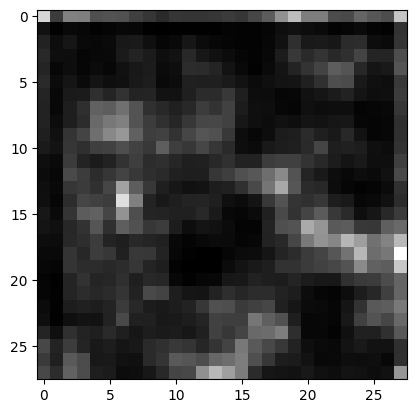

----------------------------------------


Discriminator Loss = 0.5339056253433228
Generator Loss = 1.5464967489242554
A sample image generated by the generator


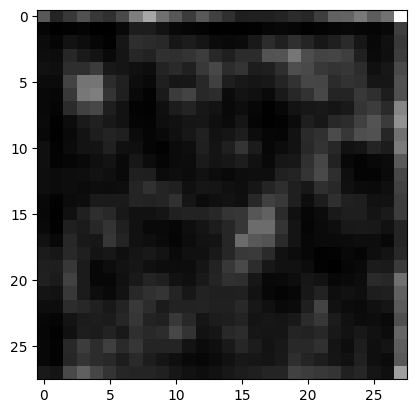

----------------------------------------


Discriminator Loss = 0.5458831787109375
Generator Loss = 1.503206491470337
A sample image generated by the generator


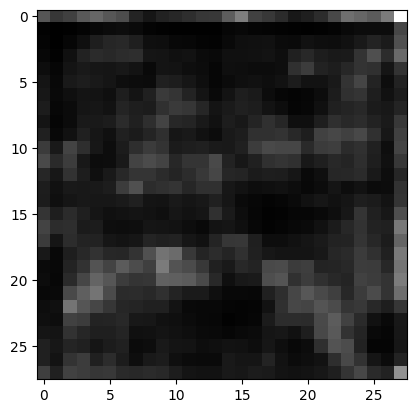

----------------------------------------


Discriminator Loss = 0.5394749045372009
Generator Loss = 1.5910351276397705
A sample image generated by the generator


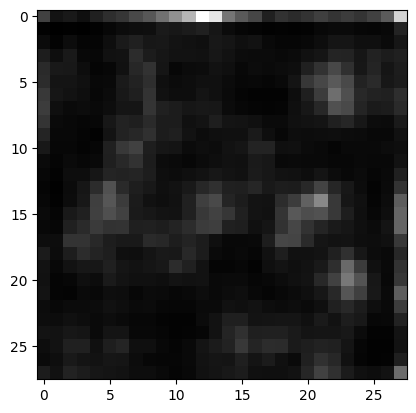

----------------------------------------


Discriminator Loss = 0.5246610045433044
Generator Loss = 1.526582956314087
A sample image generated by the generator


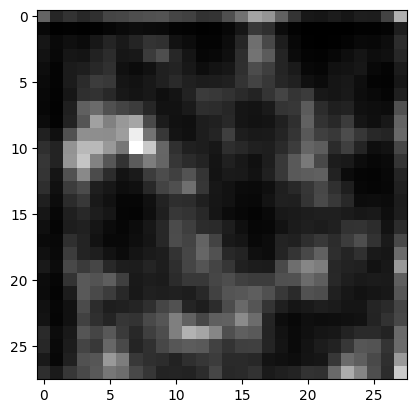

----------------------------------------


Discriminator Loss = 0.5312943458557129
Generator Loss = 1.5643696784973145
A sample image generated by the generator


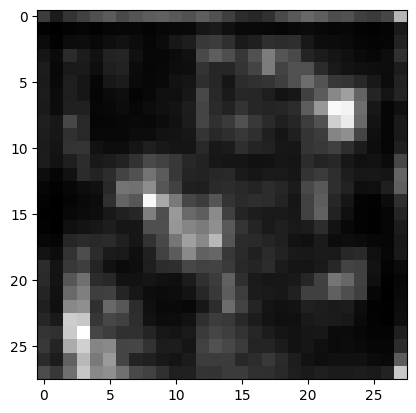

----------------------------------------


Discriminator Loss = 0.5169582366943359
Generator Loss = 1.6162673234939575
A sample image generated by the generator


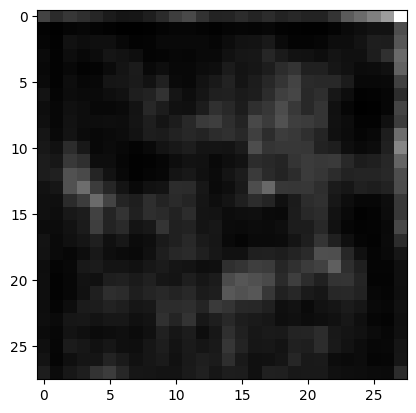

----------------------------------------


Discriminator Loss = 0.5253005027770996
Generator Loss = 1.6107755899429321
A sample image generated by the generator


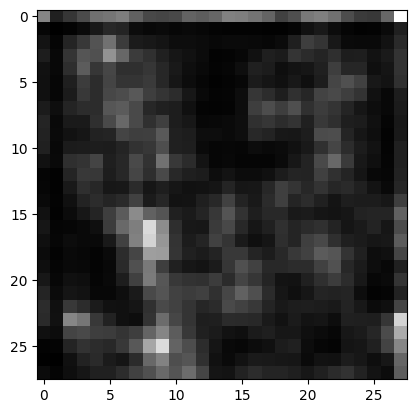

----------------------------------------


Discriminator Loss = 0.532096266746521
Generator Loss = 1.5501885414123535
A sample image generated by the generator


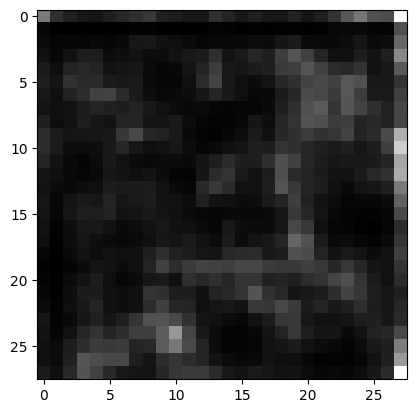

----------------------------------------


Discriminator Loss = 0.5090957880020142
Generator Loss = 1.606258749961853
A sample image generated by the generator


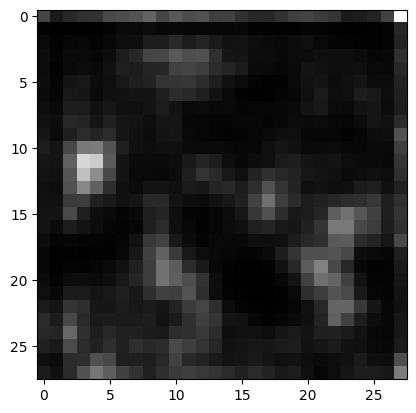

----------------------------------------


Discriminator Loss = 0.5273318886756897
Generator Loss = 1.5463206768035889
A sample image generated by the generator


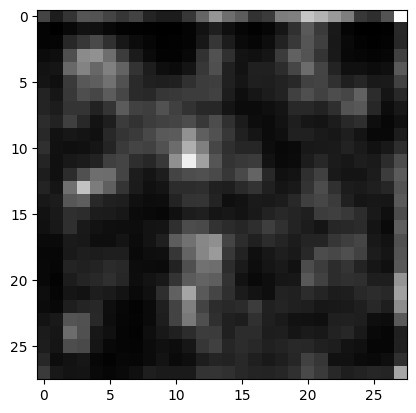

----------------------------------------


Discriminator Loss = 0.5031684637069702
Generator Loss = 1.5690839290618896
A sample image generated by the generator


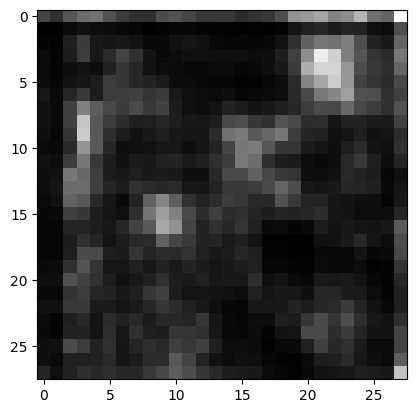

----------------------------------------


Discriminator Loss = 0.5028199553489685
Generator Loss = 1.5502738952636719
A sample image generated by the generator


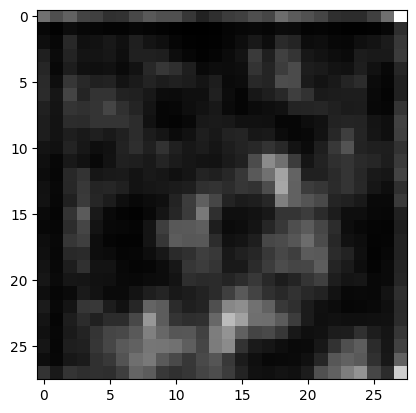

----------------------------------------


Discriminator Loss = 0.5290452241897583
Generator Loss = 1.5108883380889893
A sample image generated by the generator


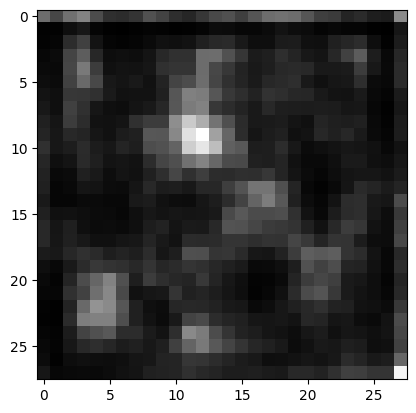

----------------------------------------


Discriminator Loss = 0.5241696834564209
Generator Loss = 1.5444809198379517
A sample image generated by the generator


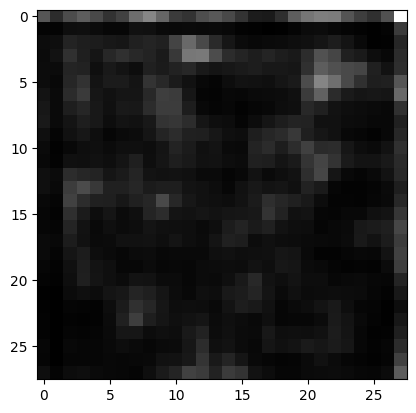

----------------------------------------


Discriminator Loss = 0.4995458722114563
Generator Loss = 1.5605788230895996
A sample image generated by the generator


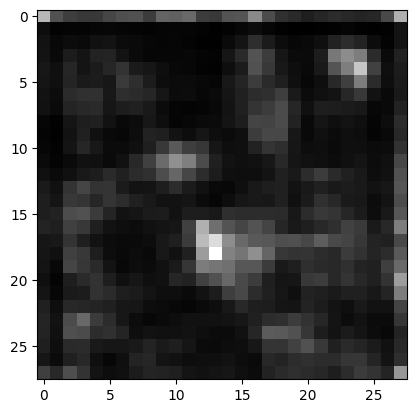

----------------------------------------


Discriminator Loss = 0.49958115816116333
Generator Loss = 1.5858556032180786
A sample image generated by the generator


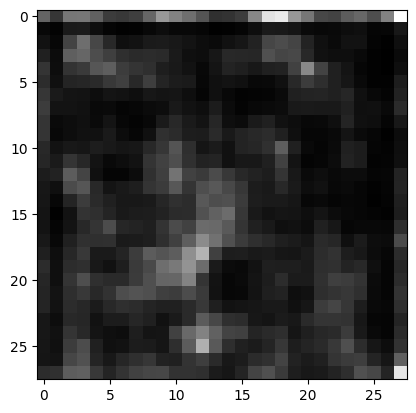

----------------------------------------


Discriminator Loss = 0.5059410333633423
Generator Loss = 1.5740007162094116
A sample image generated by the generator


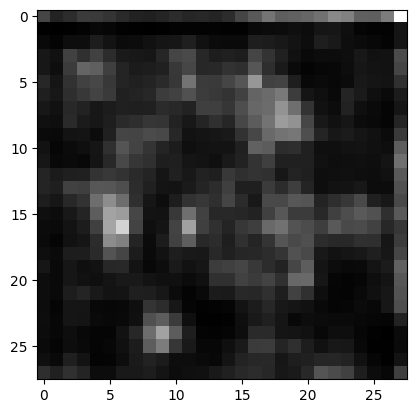

----------------------------------------


Discriminator Loss = 0.49288567900657654
Generator Loss = 1.5306494235992432
A sample image generated by the generator


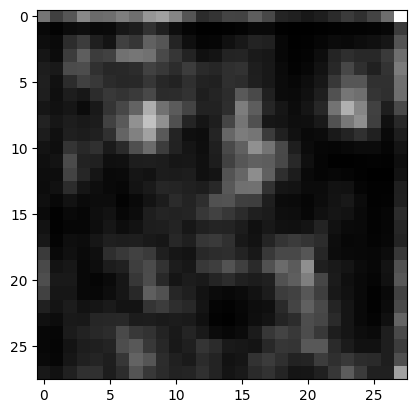

----------------------------------------


Discriminator Loss = 0.4837801158428192
Generator Loss = 1.5578972101211548
A sample image generated by the generator


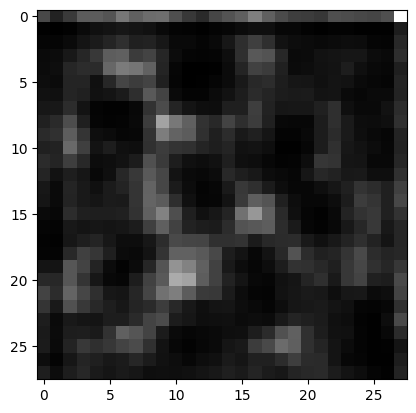

----------------------------------------


Discriminator Loss = 0.4986928105354309
Generator Loss = 1.6080189943313599
A sample image generated by the generator


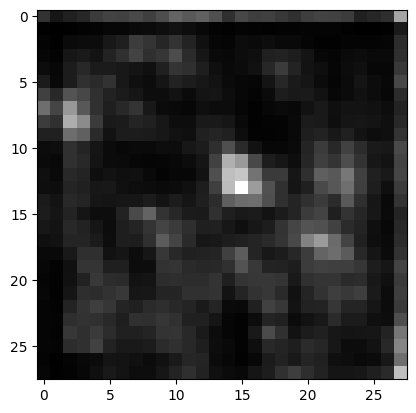

----------------------------------------


Discriminator Loss = 0.5308929681777954
Generator Loss = 1.4930883646011353
A sample image generated by the generator


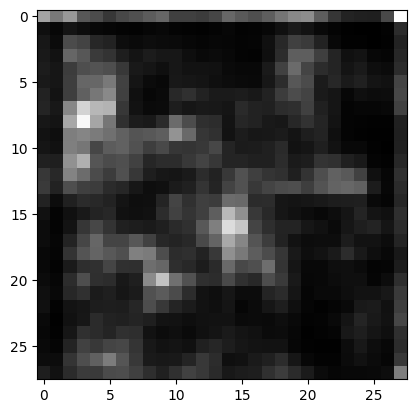

----------------------------------------


Discriminator Loss = 0.5128126740455627
Generator Loss = 1.5497125387191772
A sample image generated by the generator


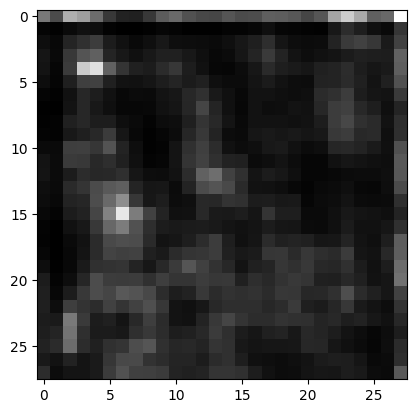

----------------------------------------


Discriminator Loss = 0.478552907705307
Generator Loss = 1.5946030616760254
A sample image generated by the generator


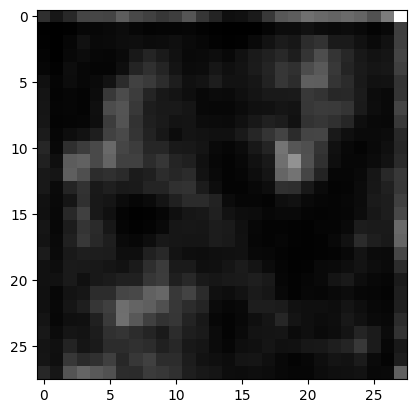

----------------------------------------


Discriminator Loss = 0.5408006906509399
Generator Loss = 1.5543200969696045
A sample image generated by the generator


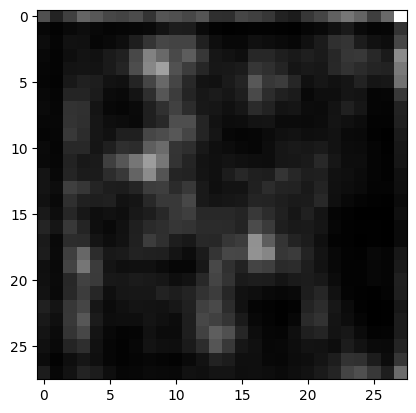

----------------------------------------


Discriminator Loss = 0.46115148067474365
Generator Loss = 1.5899860858917236
A sample image generated by the generator


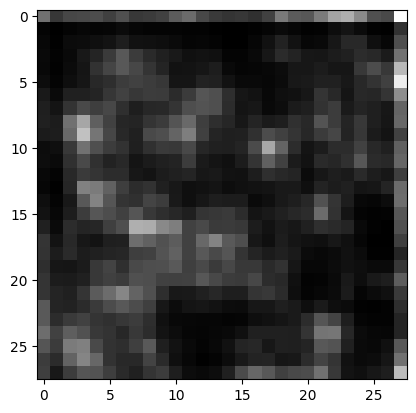

----------------------------------------


Discriminator Loss = 0.471372127532959
Generator Loss = 1.5567914247512817
A sample image generated by the generator


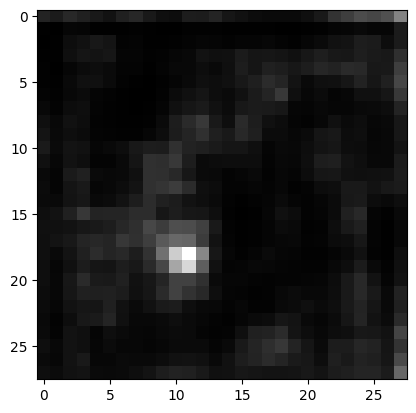

----------------------------------------


Discriminator Loss = 0.4644184410572052
Generator Loss = 1.6269240379333496
A sample image generated by the generator


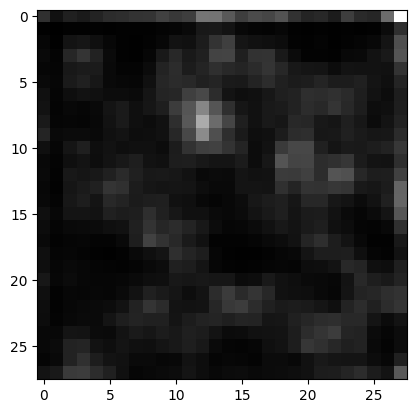

----------------------------------------


Discriminator Loss = 0.4889356195926666
Generator Loss = 1.5972952842712402
A sample image generated by the generator


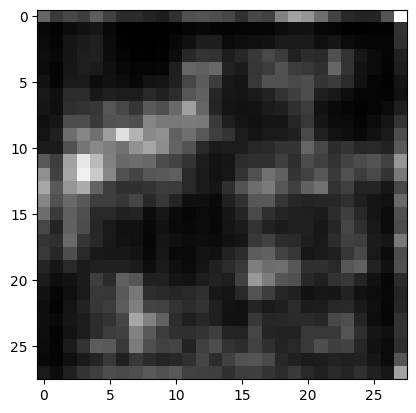

----------------------------------------


Discriminator Loss = 0.4746425449848175
Generator Loss = 1.5968661308288574
A sample image generated by the generator


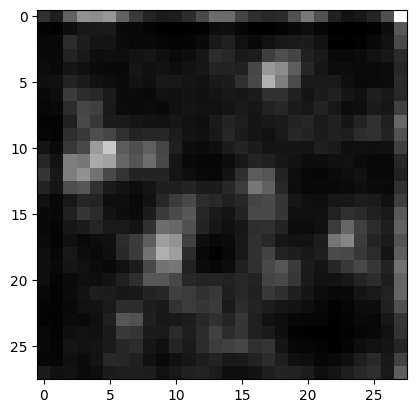

----------------------------------------


Discriminator Loss = 0.4639433026313782
Generator Loss = 1.5910983085632324
A sample image generated by the generator


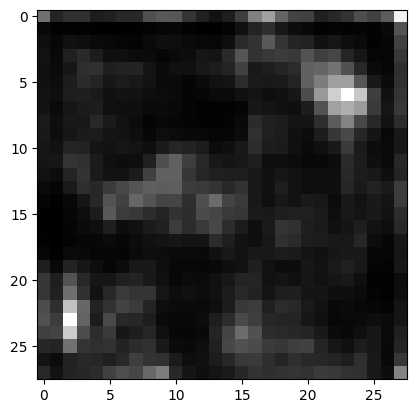

----------------------------------------


Discriminator Loss = 0.5001611709594727
Generator Loss = 1.613216519355774
A sample image generated by the generator


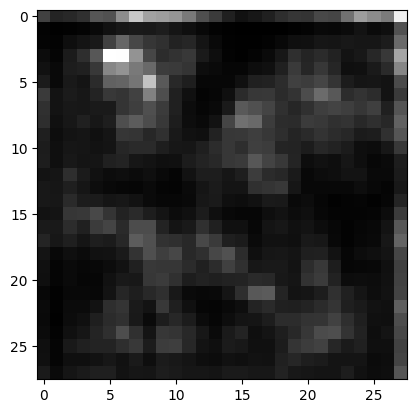

----------------------------------------


Discriminator Loss = 0.5036048889160156
Generator Loss = 1.5883204936981201
A sample image generated by the generator


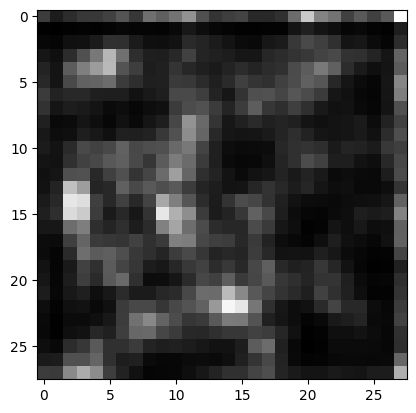

----------------------------------------


Discriminator Loss = 0.4863475561141968
Generator Loss = 1.6565546989440918
A sample image generated by the generator


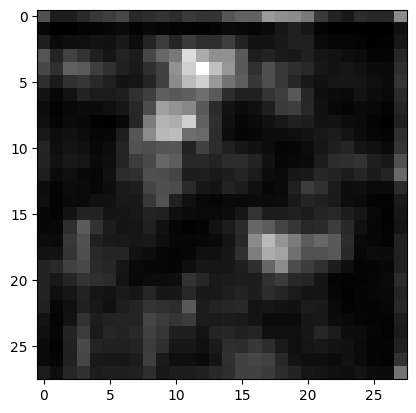

----------------------------------------


Discriminator Loss = 0.4645172953605652
Generator Loss = 1.5491477251052856
A sample image generated by the generator


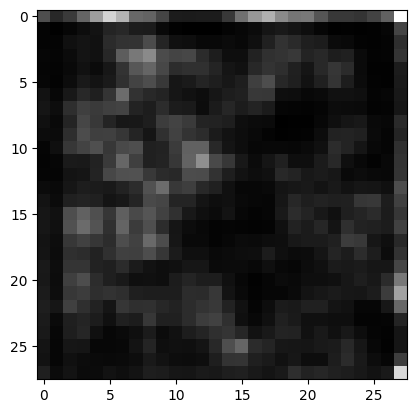

----------------------------------------


Discriminator Loss = 0.4849625825881958
Generator Loss = 1.639281988143921
A sample image generated by the generator


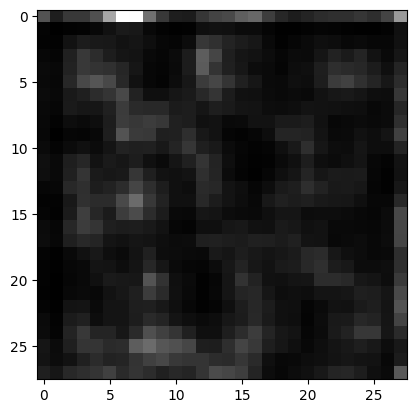

----------------------------------------


Discriminator Loss = 0.4933761954307556
Generator Loss = 1.6980725526809692
A sample image generated by the generator


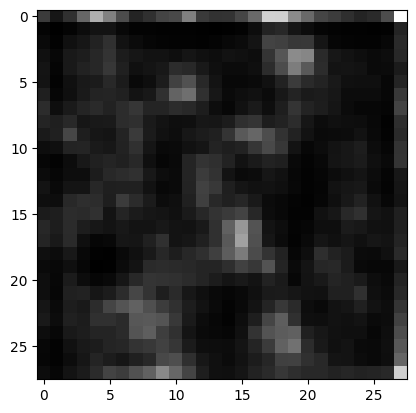

----------------------------------------


Discriminator Loss = 0.5016872882843018
Generator Loss = 1.582734227180481
A sample image generated by the generator


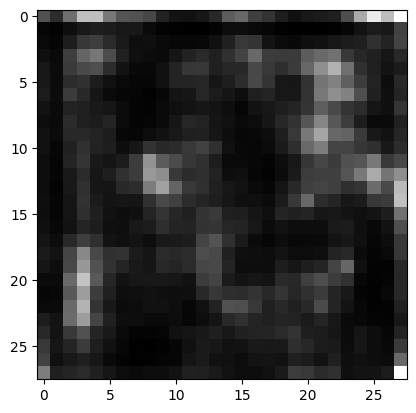

----------------------------------------


Discriminator Loss = 0.49343156814575195
Generator Loss = 1.563349962234497
A sample image generated by the generator


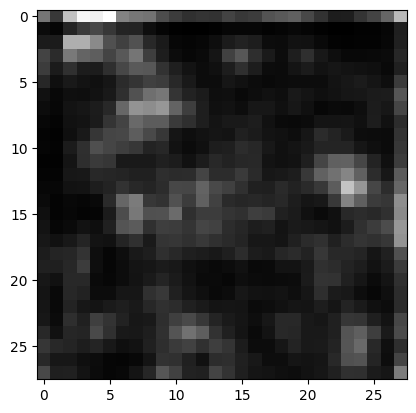

----------------------------------------


Discriminator Loss = 0.5017309188842773
Generator Loss = 1.6463525295257568
A sample image generated by the generator


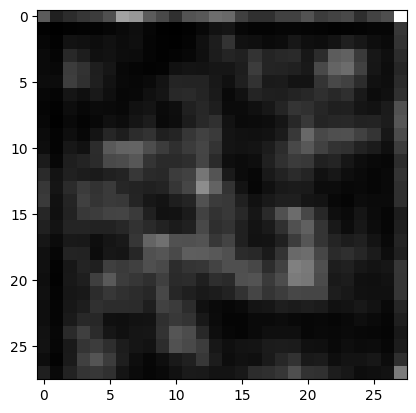

----------------------------------------


Discriminator Loss = 0.5048420429229736
Generator Loss = 1.5608203411102295
A sample image generated by the generator


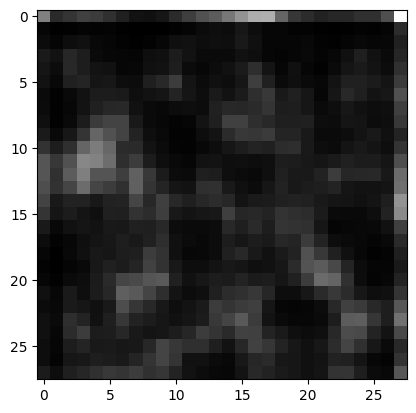

----------------------------------------


Discriminator Loss = 0.4677460193634033
Generator Loss = 1.6457340717315674
A sample image generated by the generator


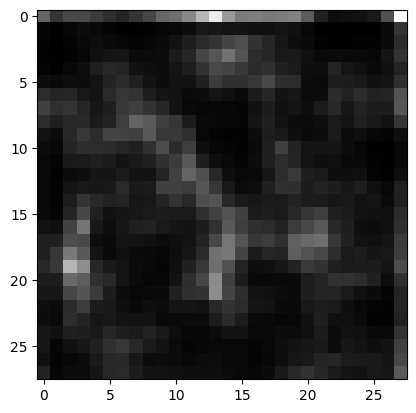

----------------------------------------


Discriminator Loss = 0.47974562644958496
Generator Loss = 1.603440284729004
A sample image generated by the generator


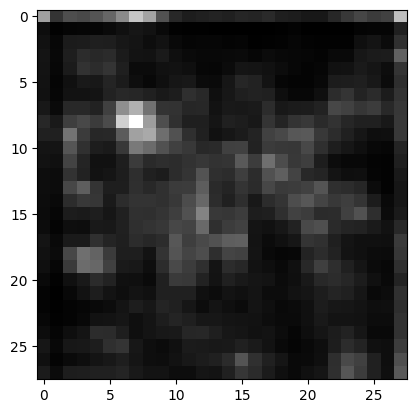

----------------------------------------


Discriminator Loss = 0.46904879808425903
Generator Loss = 1.6622731685638428
A sample image generated by the generator


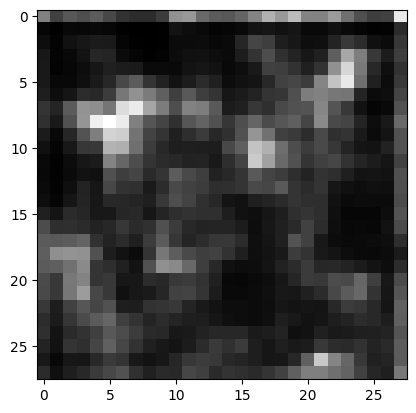

----------------------------------------


Discriminator Loss = 0.46761250495910645
Generator Loss = 1.7588444948196411
A sample image generated by the generator


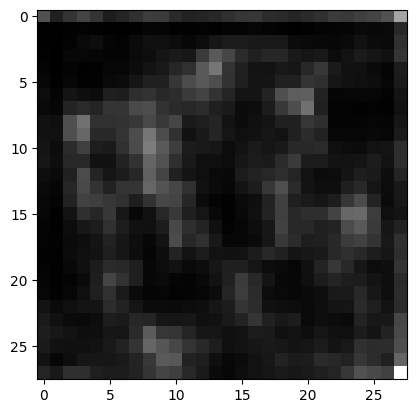

----------------------------------------


Discriminator Loss = 0.4832857549190521
Generator Loss = 1.614640474319458
A sample image generated by the generator


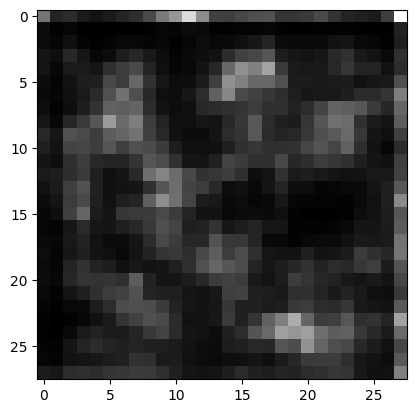

----------------------------------------


Discriminator Loss = 0.484083890914917
Generator Loss = 1.646224021911621
A sample image generated by the generator


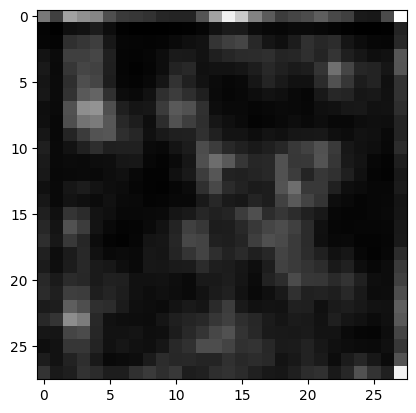

----------------------------------------


Discriminator Loss = 0.45201587677001953
Generator Loss = 1.733404517173767
A sample image generated by the generator


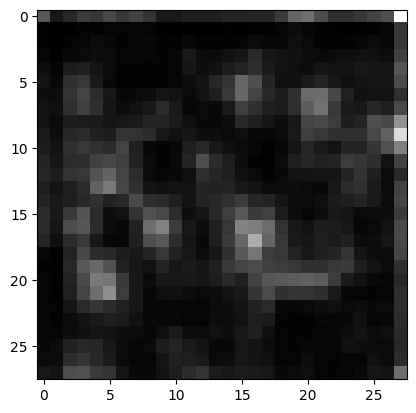

----------------------------------------


Discriminator Loss = 0.44772911071777344
Generator Loss = 1.6505236625671387
A sample image generated by the generator


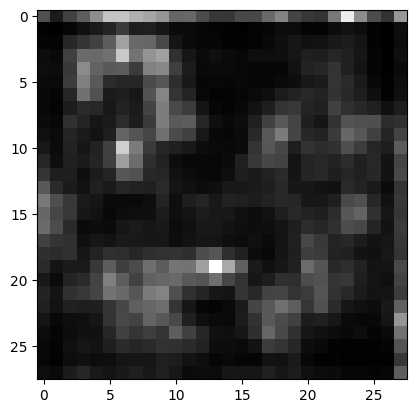

----------------------------------------


Discriminator Loss = 0.4553571045398712
Generator Loss = 1.6339722871780396
A sample image generated by the generator


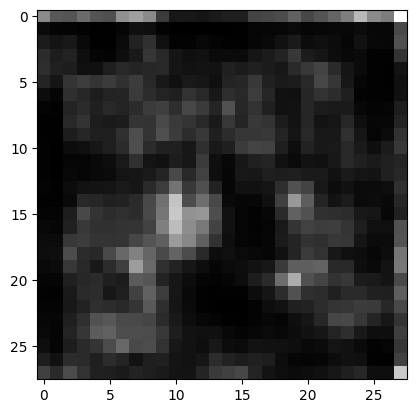

----------------------------------------


Discriminator Loss = 0.4675178527832031
Generator Loss = 1.7103745937347412
A sample image generated by the generator


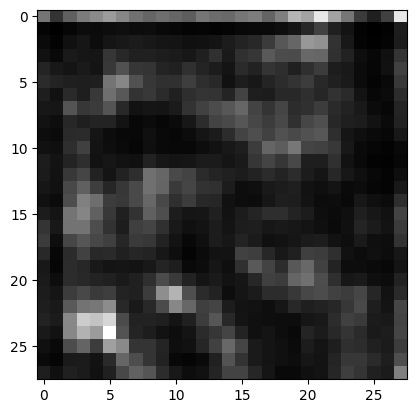

----------------------------------------


Discriminator Loss = 0.45994478464126587
Generator Loss = 1.8265904188156128
A sample image generated by the generator


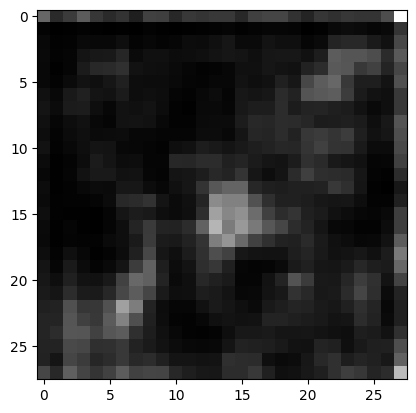

----------------------------------------


Discriminator Loss = 0.4404972195625305
Generator Loss = 1.6446915864944458
A sample image generated by the generator


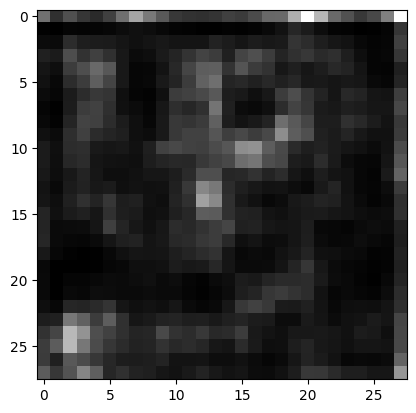

----------------------------------------


Discriminator Loss = 0.4648575782775879
Generator Loss = 1.6331149339675903
A sample image generated by the generator


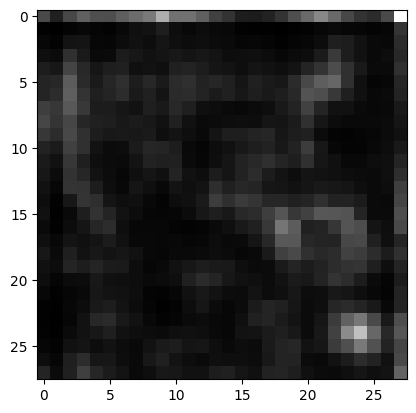

----------------------------------------


Discriminator Loss = 0.45089125633239746
Generator Loss = 1.6397311687469482
A sample image generated by the generator


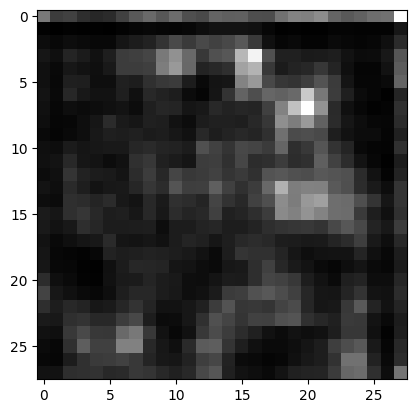

----------------------------------------


Discriminator Loss = 0.4792684316635132
Generator Loss = 1.6092228889465332
A sample image generated by the generator


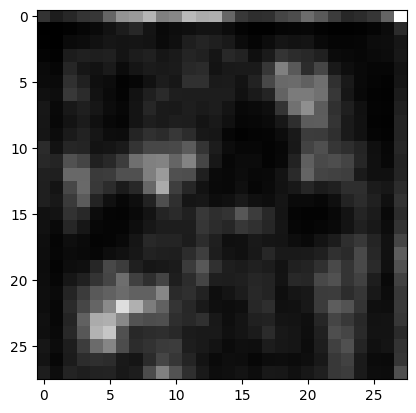

----------------------------------------


Discriminator Loss = 0.4845147430896759
Generator Loss = 1.6946613788604736
A sample image generated by the generator


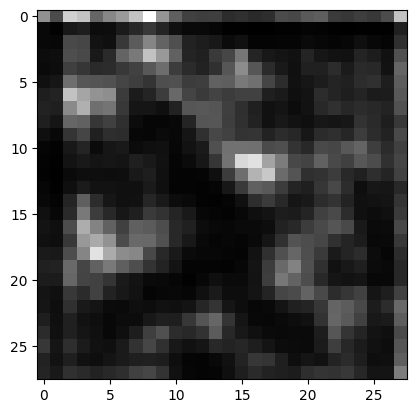

----------------------------------------


Discriminator Loss = 0.45738890767097473
Generator Loss = 1.6528139114379883
A sample image generated by the generator


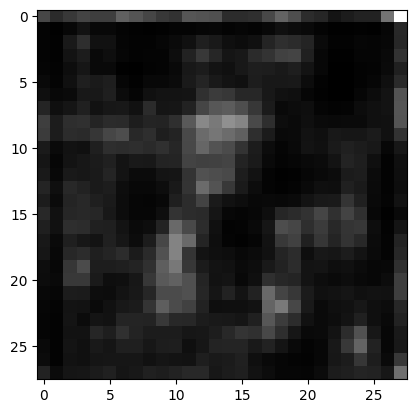

----------------------------------------


Discriminator Loss = 0.4738083779811859
Generator Loss = 1.697913408279419
A sample image generated by the generator


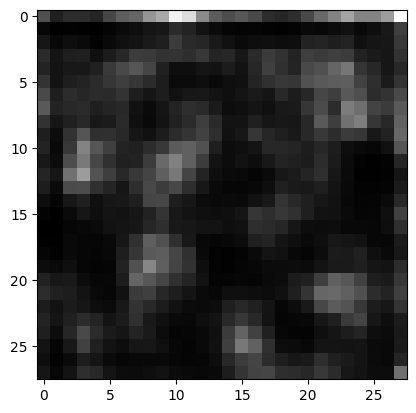

----------------------------------------


Discriminator Loss = 0.4852142333984375
Generator Loss = 1.6391220092773438
A sample image generated by the generator


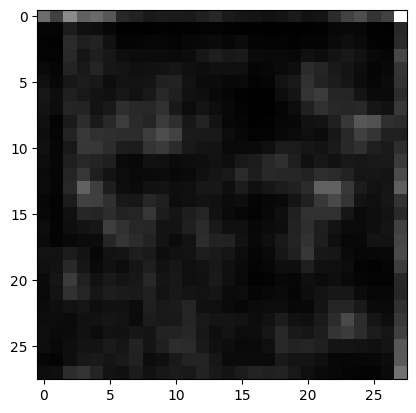

----------------------------------------


Discriminator Loss = 0.4455377459526062
Generator Loss = 1.7664051055908203
A sample image generated by the generator


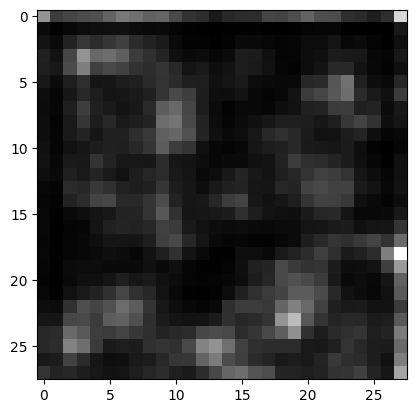

----------------------------------------


Discriminator Loss = 0.4400917887687683
Generator Loss = 1.6690348386764526
A sample image generated by the generator


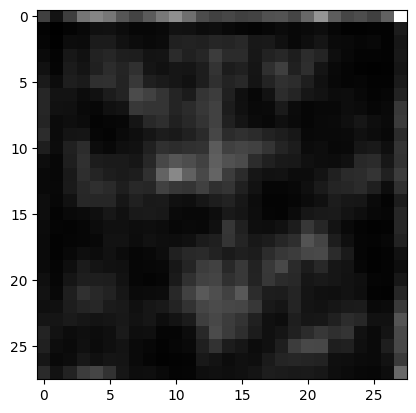

----------------------------------------


Discriminator Loss = 0.44413018226623535
Generator Loss = 1.7257966995239258
A sample image generated by the generator


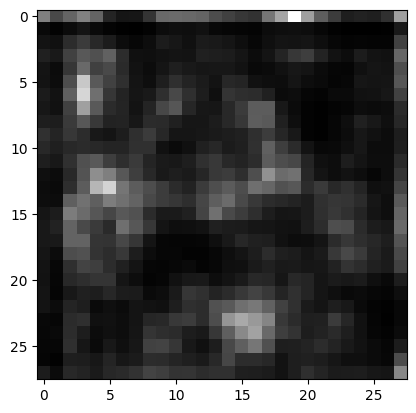

----------------------------------------


Discriminator Loss = 0.4385339021682739
Generator Loss = 1.6925632953643799
A sample image generated by the generator


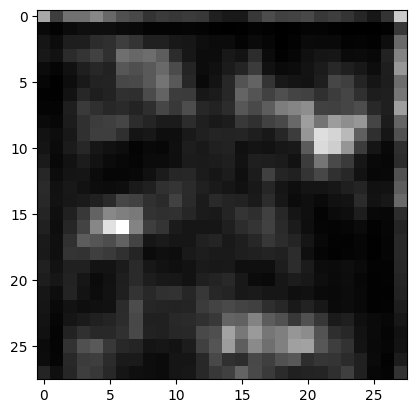

----------------------------------------


Discriminator Loss = 0.46121272444725037
Generator Loss = 1.7687197923660278
A sample image generated by the generator


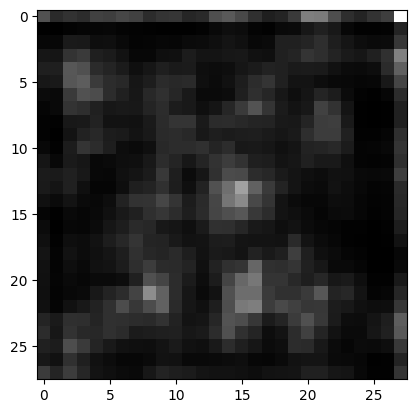

----------------------------------------


Discriminator Loss = 0.4602736830711365
Generator Loss = 1.6455352306365967
A sample image generated by the generator


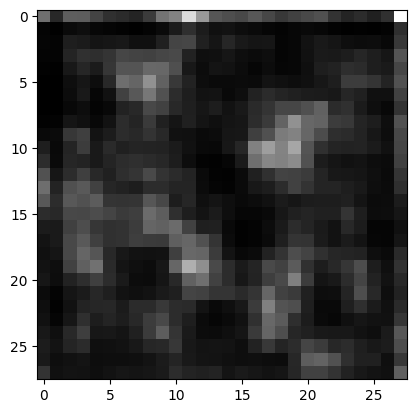

----------------------------------------


Discriminator Loss = 0.44052910804748535
Generator Loss = 1.605769395828247
A sample image generated by the generator


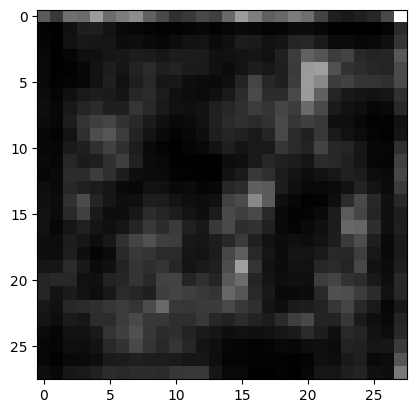

----------------------------------------


Discriminator Loss = 0.43233636021614075
Generator Loss = 1.688064694404602
A sample image generated by the generator


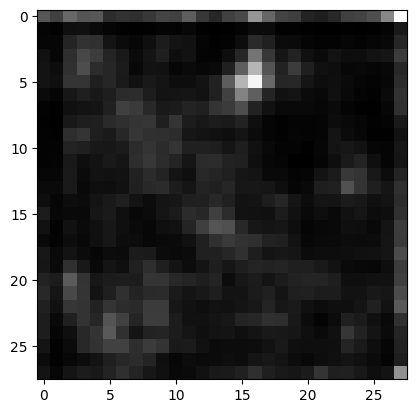

----------------------------------------


Discriminator Loss = 0.47402849793434143
Generator Loss = 1.7016849517822266
A sample image generated by the generator


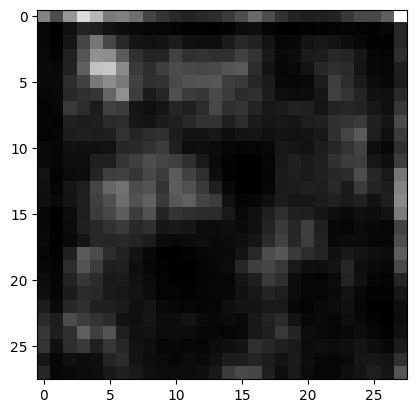

----------------------------------------


Discriminator Loss = 0.4560202360153198
Generator Loss = 1.6996541023254395
A sample image generated by the generator


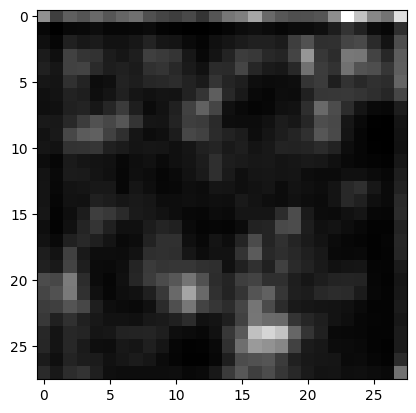

----------------------------------------


Discriminator Loss = 0.4383276104927063
Generator Loss = 1.6478978395462036
A sample image generated by the generator


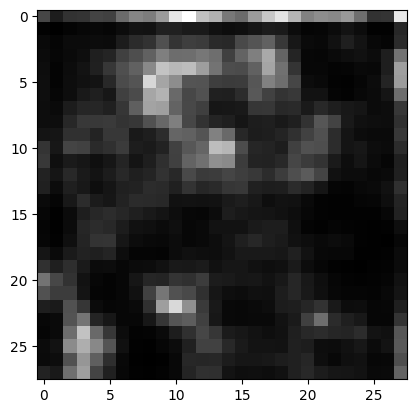

----------------------------------------


Discriminator Loss = 0.4562787413597107
Generator Loss = 1.721859097480774
A sample image generated by the generator


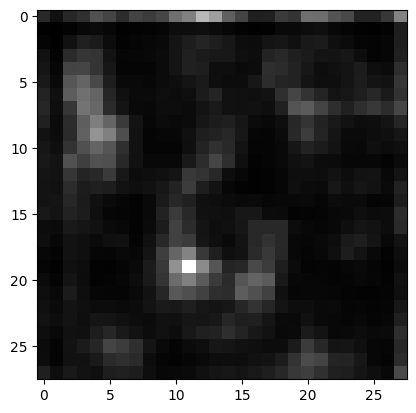

----------------------------------------


Discriminator Loss = 0.45859378576278687
Generator Loss = 1.6706693172454834
A sample image generated by the generator


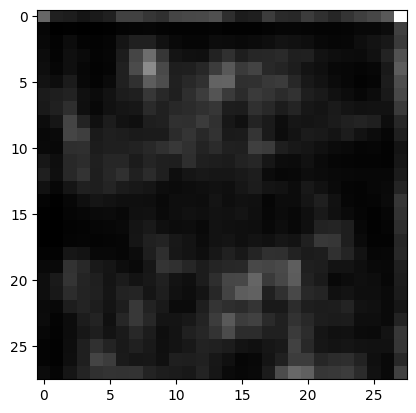

----------------------------------------


Discriminator Loss = 0.4826277494430542
Generator Loss = 1.7371435165405273
A sample image generated by the generator


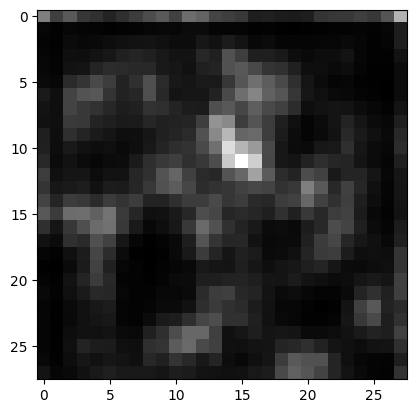

----------------------------------------


Discriminator Loss = 0.46039289236068726
Generator Loss = 1.7077349424362183
A sample image generated by the generator


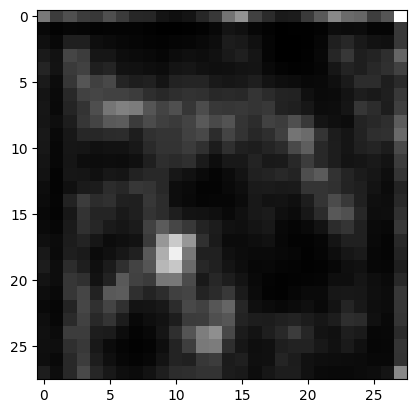

----------------------------------------


Discriminator Loss = 0.43596595525741577
Generator Loss = 1.7344287633895874
A sample image generated by the generator


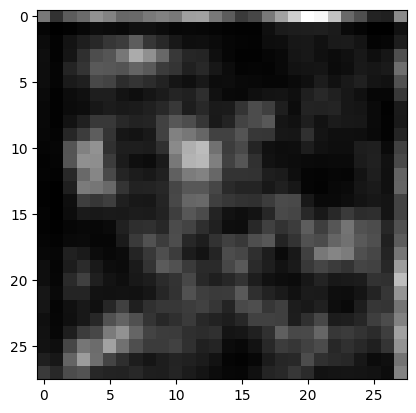

----------------------------------------


Discriminator Loss = 0.45996272563934326
Generator Loss = 1.6435227394104004
A sample image generated by the generator


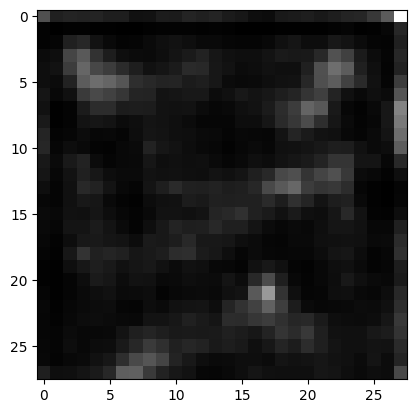

----------------------------------------


Discriminator Loss = 0.4467901587486267
Generator Loss = 1.659548282623291
A sample image generated by the generator


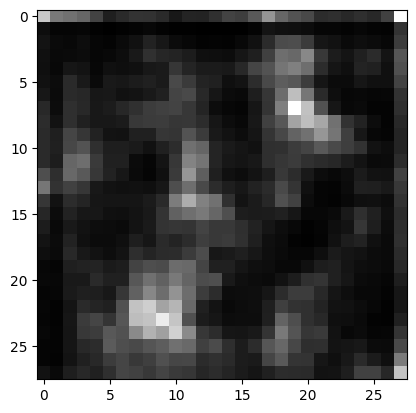

----------------------------------------


Discriminator Loss = 0.46775543689727783
Generator Loss = 1.8582199811935425
A sample image generated by the generator


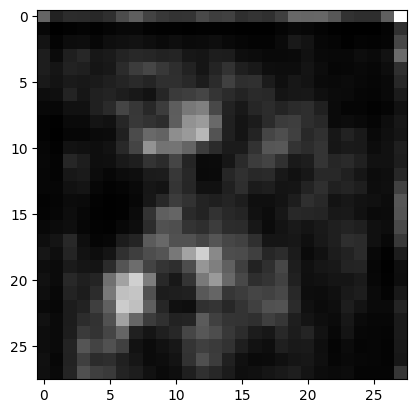

----------------------------------------


Discriminator Loss = 0.4875098466873169
Generator Loss = 1.6853963136672974
A sample image generated by the generator


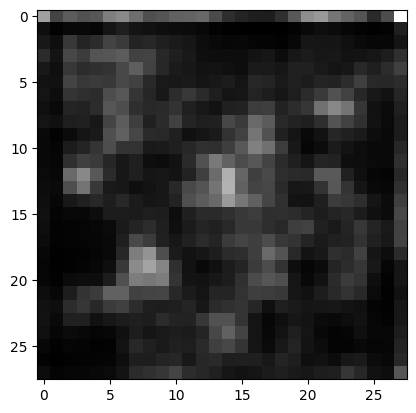

----------------------------------------


Discriminator Loss = 0.4210047423839569
Generator Loss = 1.660972237586975
A sample image generated by the generator


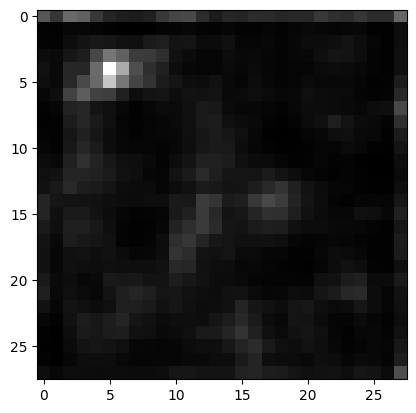

----------------------------------------


Discriminator Loss = 0.46635621786117554
Generator Loss = 1.677765965461731
A sample image generated by the generator


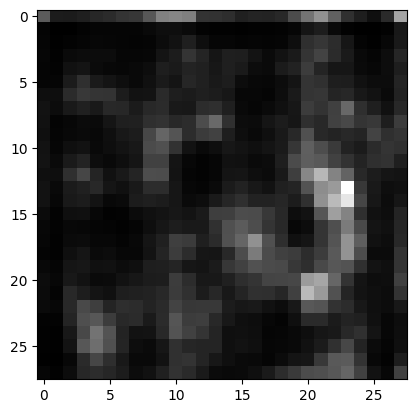

----------------------------------------


Discriminator Loss = 0.44148385524749756
Generator Loss = 1.6940900087356567
A sample image generated by the generator


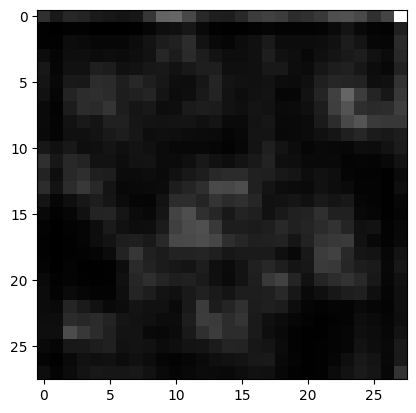

----------------------------------------


Discriminator Loss = 0.4314751625061035
Generator Loss = 1.7032058238983154
A sample image generated by the generator


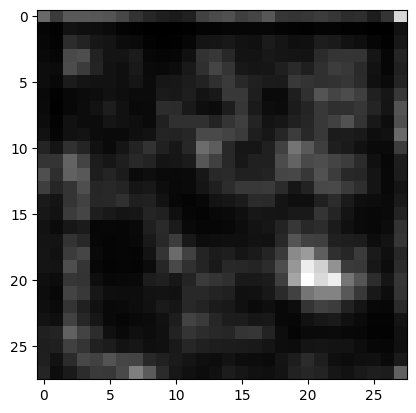

----------------------------------------


Discriminator Loss = 0.4551073908805847
Generator Loss = 1.6727162599563599
A sample image generated by the generator


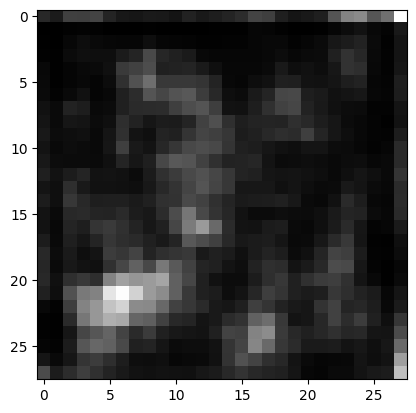

----------------------------------------


Discriminator Loss = 0.419384241104126
Generator Loss = 1.7324707508087158
A sample image generated by the generator


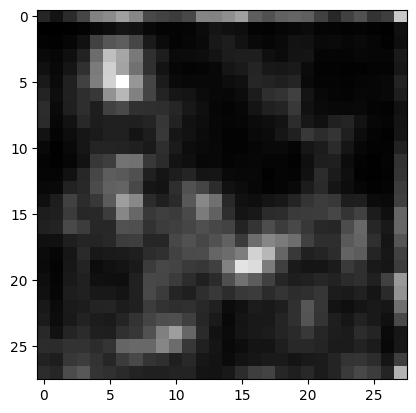

----------------------------------------


Discriminator Loss = 0.42937737703323364
Generator Loss = 1.7835876941680908
A sample image generated by the generator


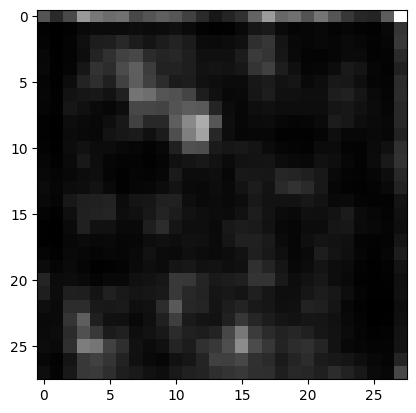

----------------------------------------


Discriminator Loss = 0.45023834705352783
Generator Loss = 1.6967027187347412
A sample image generated by the generator


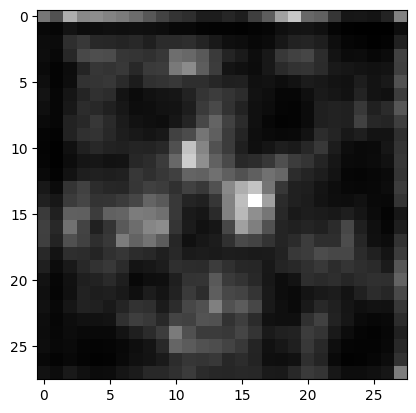

----------------------------------------


Discriminator Loss = 0.42191624641418457
Generator Loss = 1.7636317014694214
A sample image generated by the generator


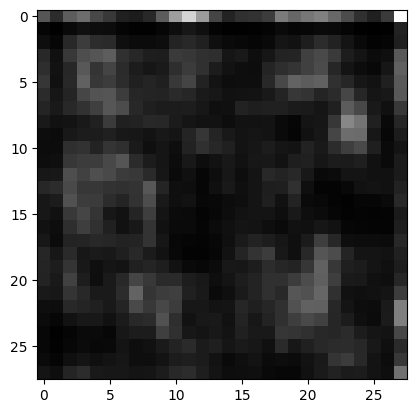

----------------------------------------


Discriminator Loss = 0.4436897933483124
Generator Loss = 1.6733036041259766
A sample image generated by the generator


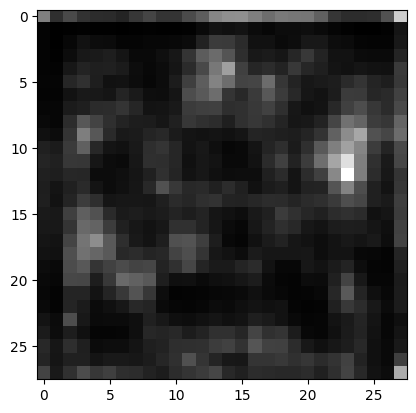

----------------------------------------


Discriminator Loss = 0.4231438636779785
Generator Loss = 1.7775444984436035
A sample image generated by the generator


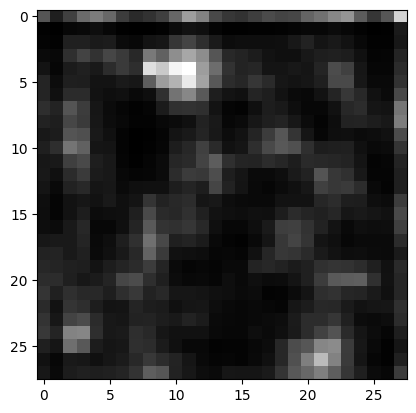

----------------------------------------


Discriminator Loss = 0.4334779977798462
Generator Loss = 1.6452522277832031
A sample image generated by the generator


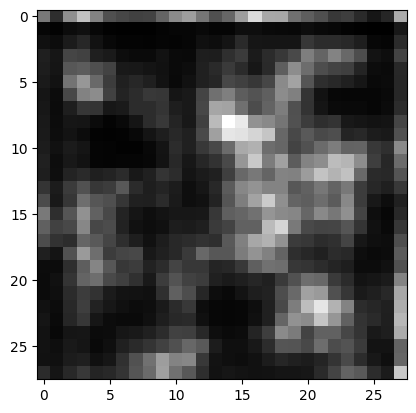

----------------------------------------


Discriminator Loss = 0.4128549098968506
Generator Loss = 1.765452265739441
A sample image generated by the generator


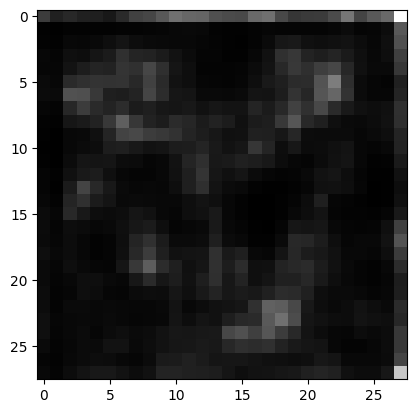

----------------------------------------


Discriminator Loss = 0.44612231850624084
Generator Loss = 1.67777681350708
A sample image generated by the generator


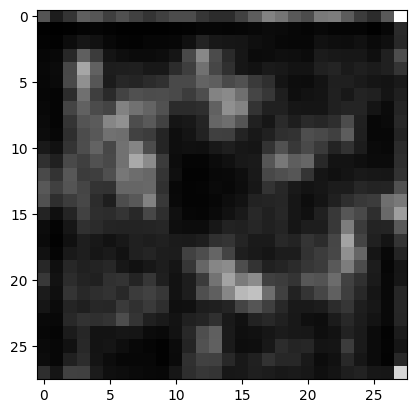

----------------------------------------


Discriminator Loss = 0.4257200062274933
Generator Loss = 1.7813990116119385
A sample image generated by the generator


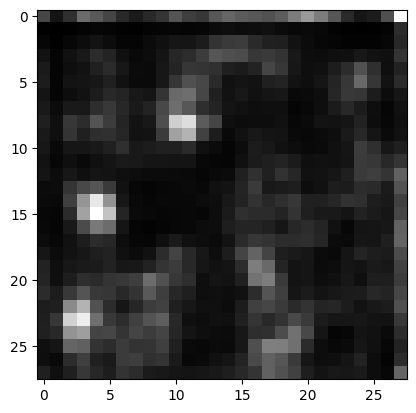

----------------------------------------


Discriminator Loss = 0.44388025999069214
Generator Loss = 1.6868131160736084
A sample image generated by the generator


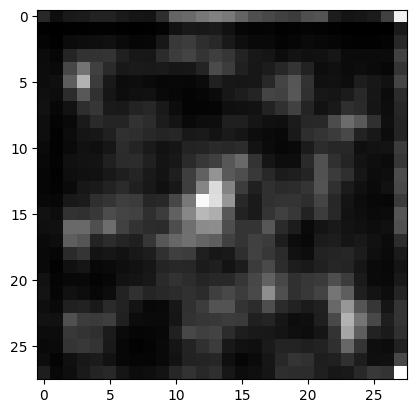

----------------------------------------


Discriminator Loss = 0.427198201417923
Generator Loss = 1.7497867345809937
A sample image generated by the generator


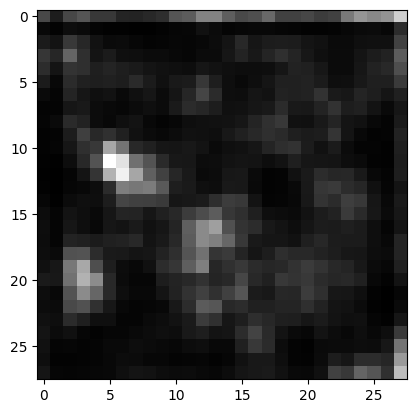

----------------------------------------


Discriminator Loss = 0.41649341583251953
Generator Loss = 1.6863126754760742
A sample image generated by the generator


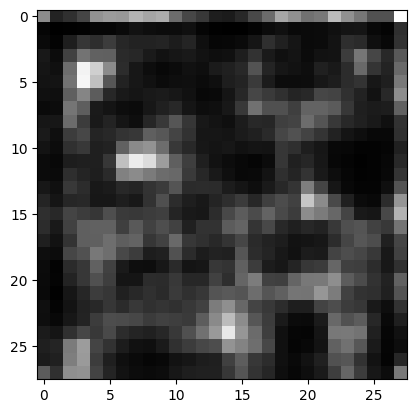

----------------------------------------


Discriminator Loss = 0.4148426651954651
Generator Loss = 1.7991678714752197
A sample image generated by the generator


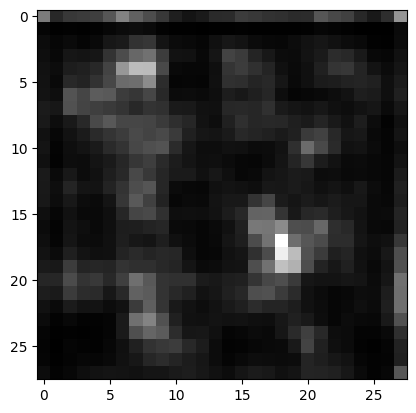

----------------------------------------


Discriminator Loss = 0.42881470918655396
Generator Loss = 1.7562789916992188
A sample image generated by the generator


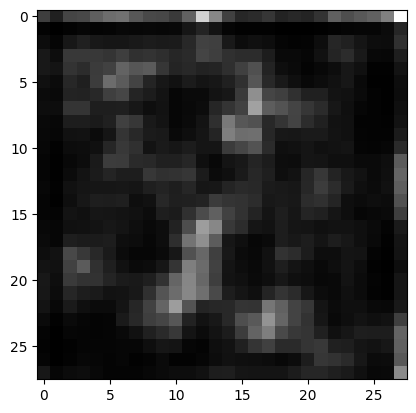

----------------------------------------


Discriminator Loss = 0.4124473035335541
Generator Loss = 1.6795306205749512
A sample image generated by the generator


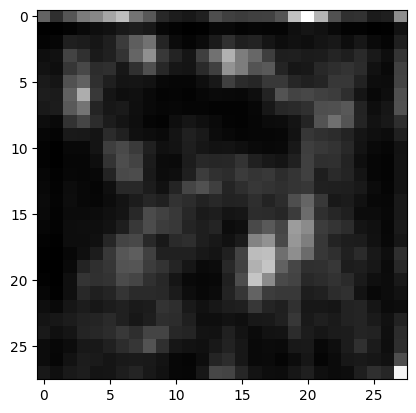

----------------------------------------


Discriminator Loss = 0.4313783049583435
Generator Loss = 1.7654736042022705
A sample image generated by the generator


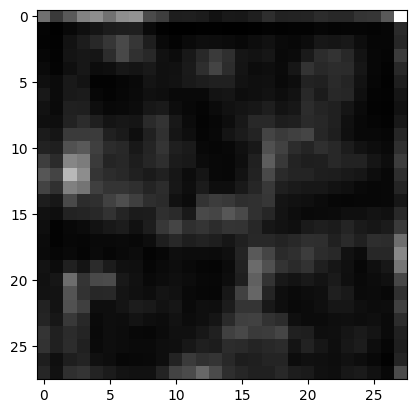

----------------------------------------


Discriminator Loss = 0.42419469356536865
Generator Loss = 1.7716405391693115
A sample image generated by the generator


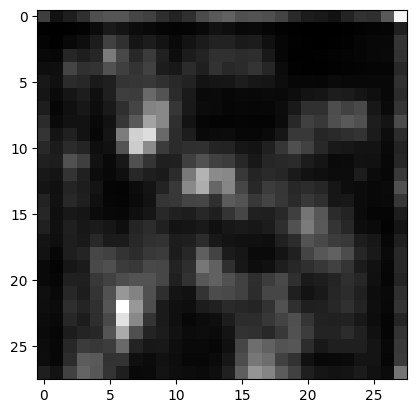

----------------------------------------


Discriminator Loss = 0.387725293636322
Generator Loss = 1.749779462814331
A sample image generated by the generator


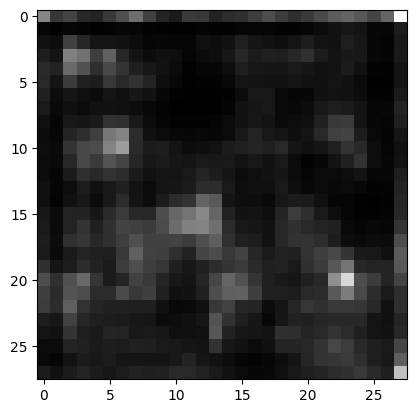

----------------------------------------


Discriminator Loss = 0.4021718502044678
Generator Loss = 1.7531126737594604
A sample image generated by the generator


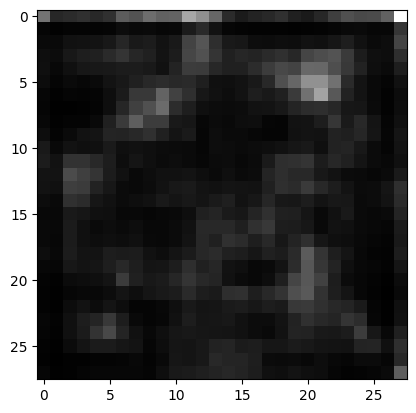

----------------------------------------


Discriminator Loss = 0.4331856369972229
Generator Loss = 1.760765552520752
A sample image generated by the generator


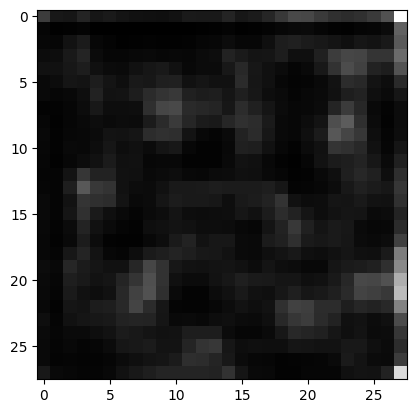

----------------------------------------


Discriminator Loss = 0.43317413330078125
Generator Loss = 1.8225593566894531
A sample image generated by the generator


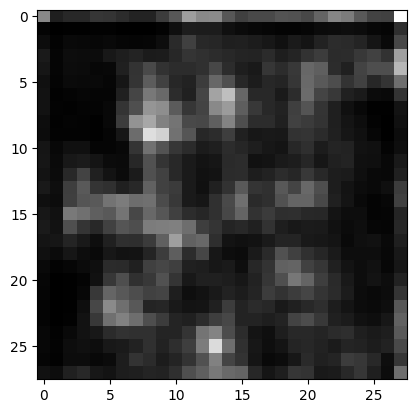

----------------------------------------


Discriminator Loss = 0.4275137782096863
Generator Loss = 1.7071703672409058
A sample image generated by the generator


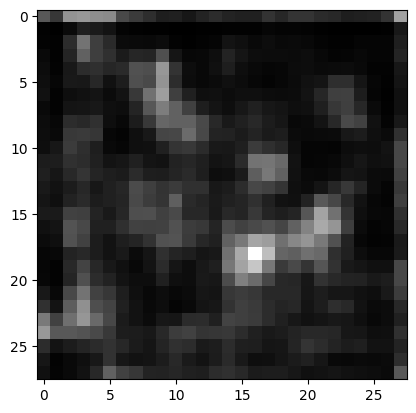

----------------------------------------


Discriminator Loss = 0.4310951828956604
Generator Loss = 1.6711499691009521
A sample image generated by the generator


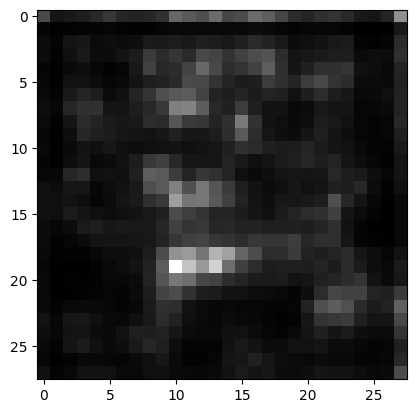

----------------------------------------


Discriminator Loss = 0.43997013568878174
Generator Loss = 1.7572596073150635
A sample image generated by the generator


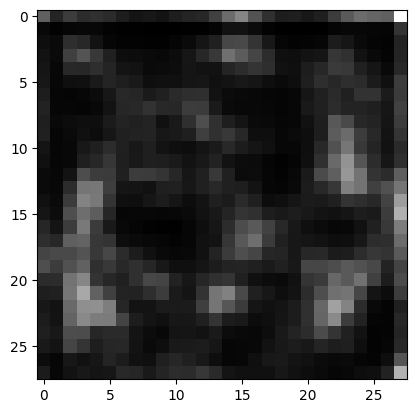

----------------------------------------


Discriminator Loss = 0.4445945620536804
Generator Loss = 1.7777860164642334
A sample image generated by the generator


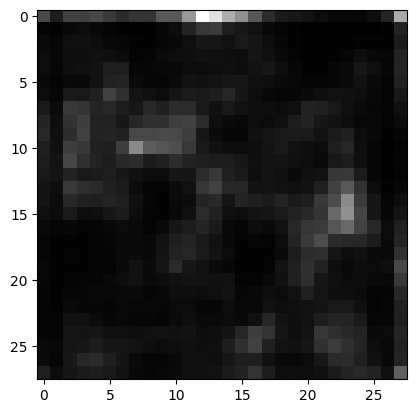

----------------------------------------


Discriminator Loss = 0.4125590920448303
Generator Loss = 1.7554559707641602
A sample image generated by the generator


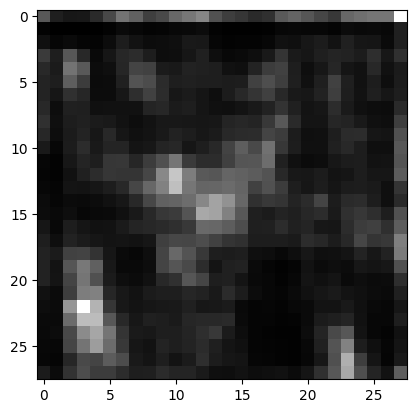

----------------------------------------


Discriminator Loss = 0.42139655351638794
Generator Loss = 1.923717737197876
A sample image generated by the generator


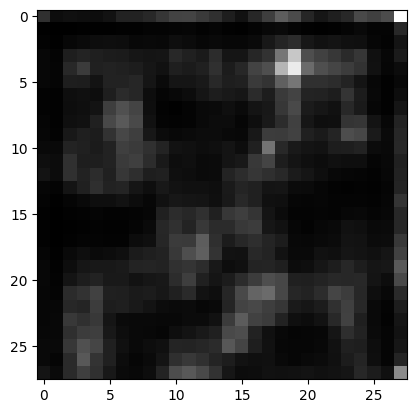

----------------------------------------


Discriminator Loss = 0.4490402340888977
Generator Loss = 1.856142282485962
A sample image generated by the generator


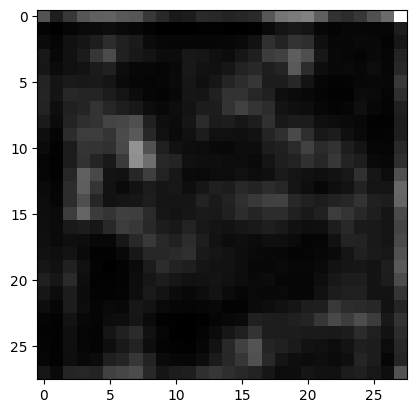

----------------------------------------


Discriminator Loss = 0.41162586212158203
Generator Loss = 1.7890586853027344
A sample image generated by the generator


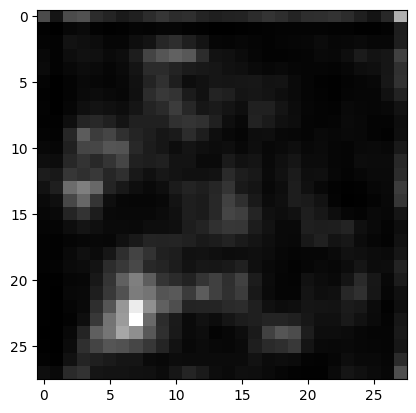

----------------------------------------


Discriminator Loss = 0.40326279401779175
Generator Loss = 1.7660294771194458
A sample image generated by the generator


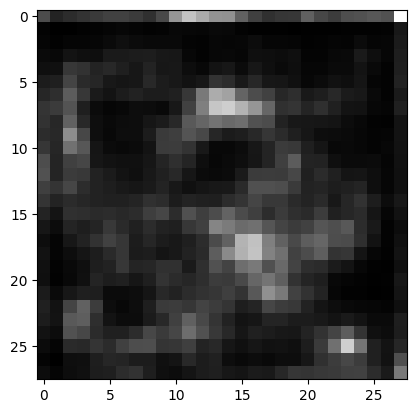

----------------------------------------


Discriminator Loss = 0.41745609045028687
Generator Loss = 1.7086222171783447
A sample image generated by the generator


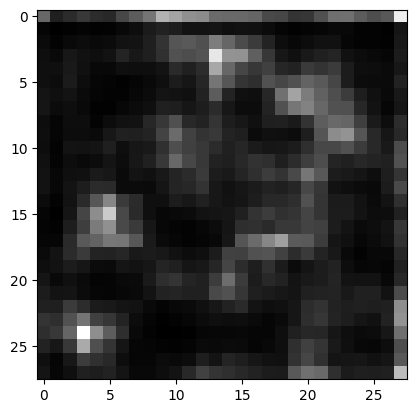

----------------------------------------


Discriminator Loss = 0.4109337329864502
Generator Loss = 1.7762651443481445
A sample image generated by the generator


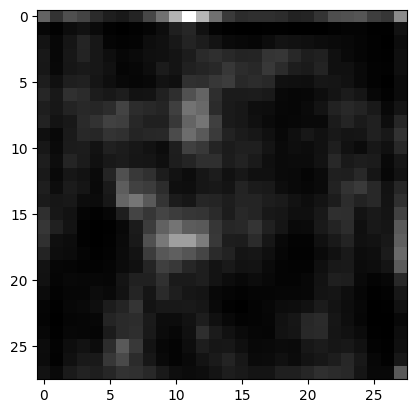

----------------------------------------


Discriminator Loss = 0.41036278009414673
Generator Loss = 1.7790911197662354
A sample image generated by the generator


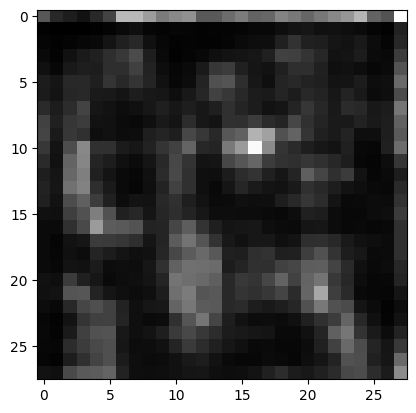

----------------------------------------


Discriminator Loss = 0.4251224994659424
Generator Loss = 1.795806646347046
A sample image generated by the generator


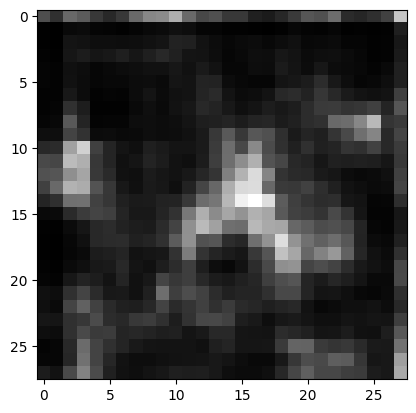

----------------------------------------


Discriminator Loss = 0.38426098227500916
Generator Loss = 1.7494900226593018
A sample image generated by the generator


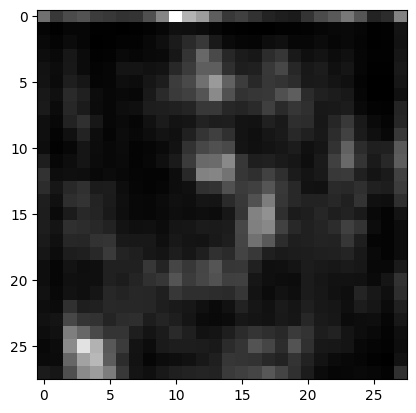

----------------------------------------


Discriminator Loss = 0.4274454712867737
Generator Loss = 1.8074942827224731
A sample image generated by the generator


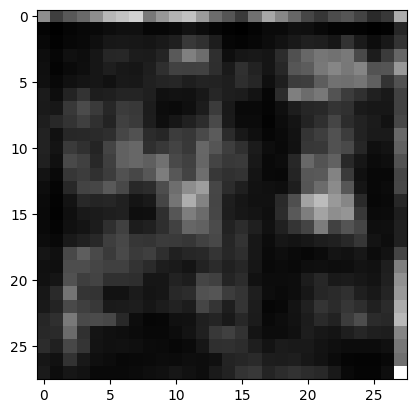

----------------------------------------


Discriminator Loss = 0.405231237411499
Generator Loss = 1.7516648769378662
A sample image generated by the generator


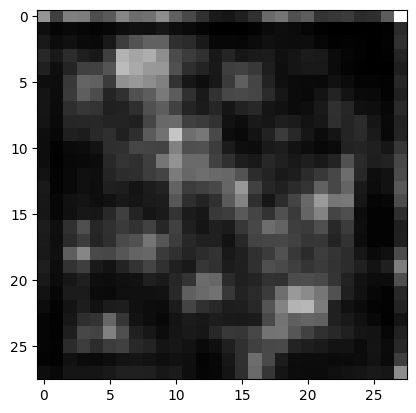

----------------------------------------


Discriminator Loss = 0.4197823405265808
Generator Loss = 1.8806703090667725
A sample image generated by the generator


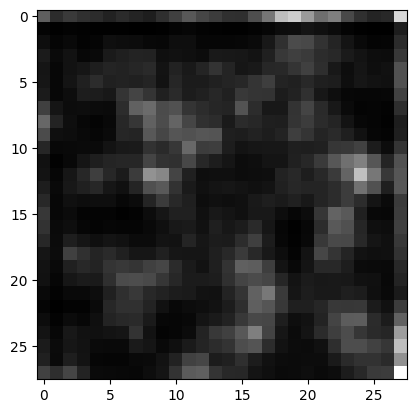

----------------------------------------


Discriminator Loss = 0.4311755895614624
Generator Loss = 1.7724603414535522
A sample image generated by the generator


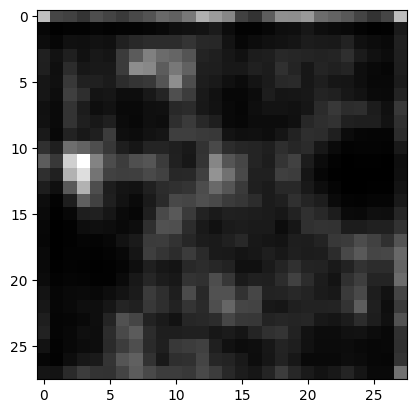

----------------------------------------


Discriminator Loss = 0.4019187092781067
Generator Loss = 1.890929937362671
A sample image generated by the generator


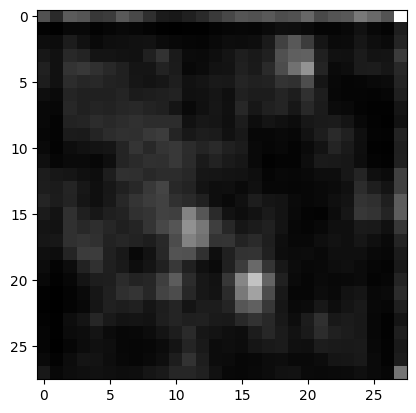

----------------------------------------


Discriminator Loss = 0.40722334384918213
Generator Loss = 1.8412861824035645
A sample image generated by the generator


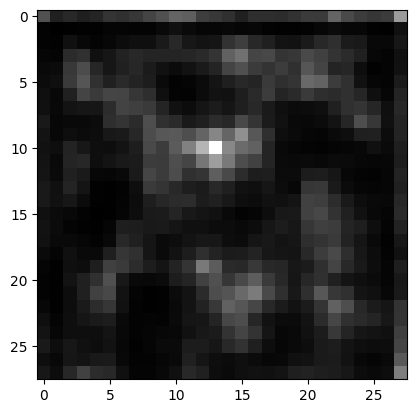

----------------------------------------


Discriminator Loss = 0.41174280643463135
Generator Loss = 1.761357307434082
A sample image generated by the generator


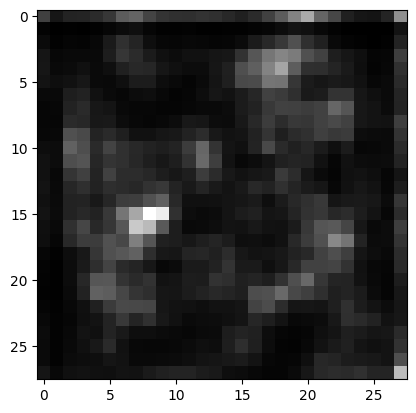

----------------------------------------


Discriminator Loss = 0.38539618253707886
Generator Loss = 1.7398672103881836
A sample image generated by the generator


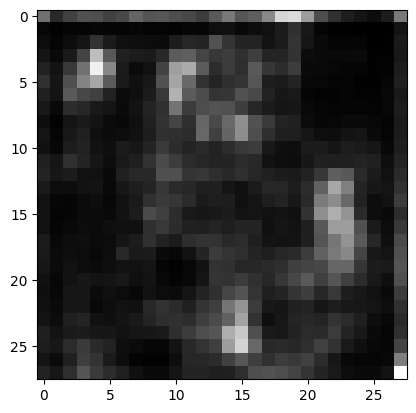

----------------------------------------


Discriminator Loss = 0.41125988960266113
Generator Loss = 1.8192143440246582
A sample image generated by the generator


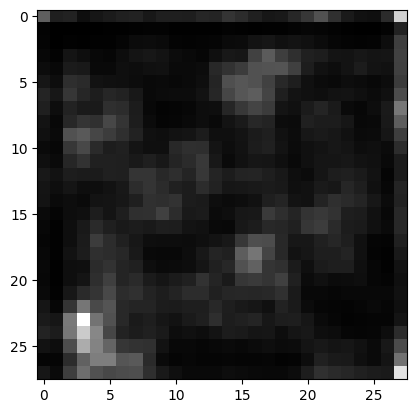

----------------------------------------


Discriminator Loss = 0.38647010922431946
Generator Loss = 1.792646884918213
A sample image generated by the generator


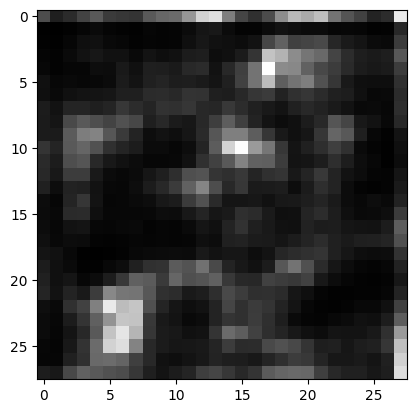

----------------------------------------


Discriminator Loss = 0.4287564158439636
Generator Loss = 1.789811611175537
A sample image generated by the generator


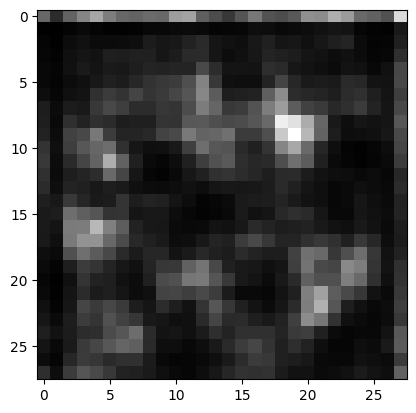

----------------------------------------


Discriminator Loss = 0.4004817605018616
Generator Loss = 1.795641541481018
A sample image generated by the generator


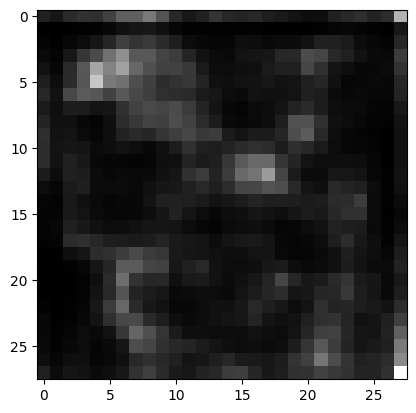

----------------------------------------


Discriminator Loss = 0.41382652521133423
Generator Loss = 1.7979660034179688
A sample image generated by the generator


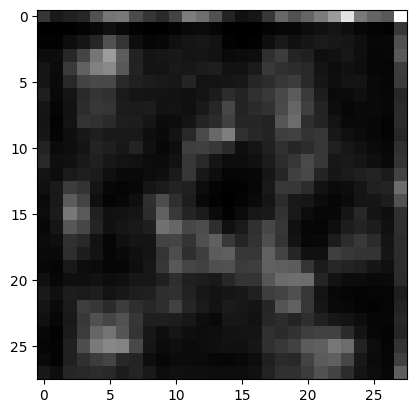

----------------------------------------


Discriminator Loss = 0.3894818127155304
Generator Loss = 1.809877634048462
A sample image generated by the generator


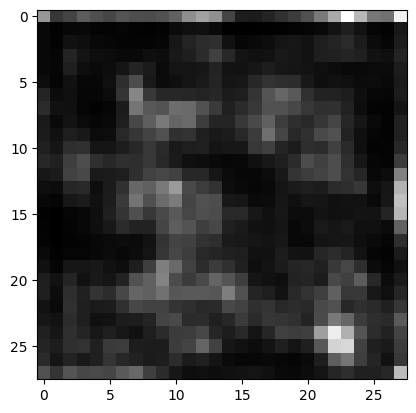

----------------------------------------


Discriminator Loss = 0.39958032965660095
Generator Loss = 1.8044168949127197
A sample image generated by the generator


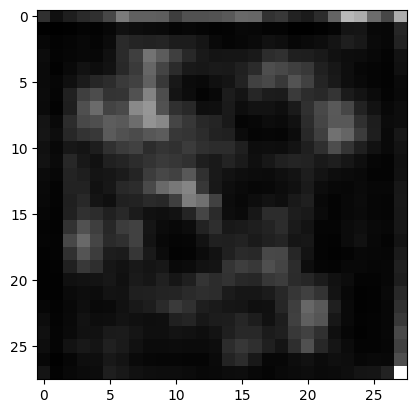

----------------------------------------


Discriminator Loss = 0.39752447605133057
Generator Loss = 1.8398423194885254
A sample image generated by the generator


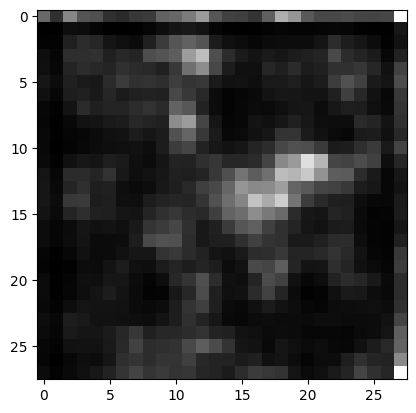

----------------------------------------


Discriminator Loss = 0.4059808552265167
Generator Loss = 1.8383110761642456
A sample image generated by the generator


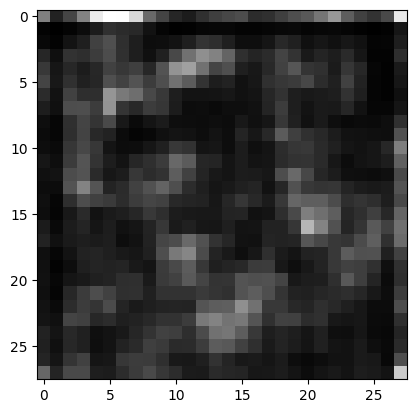

----------------------------------------


Discriminator Loss = 0.40173375606536865
Generator Loss = 1.833702802658081
A sample image generated by the generator


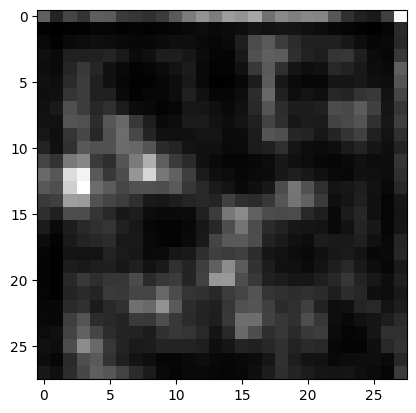

----------------------------------------


Discriminator Loss = 0.39273619651794434
Generator Loss = 1.8378887176513672
A sample image generated by the generator


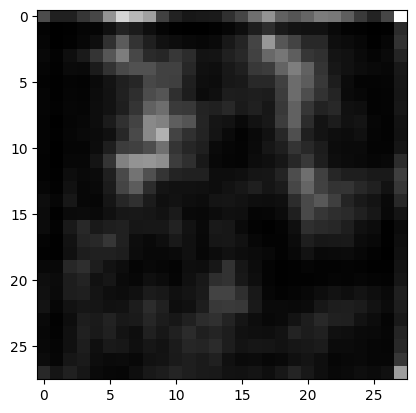

----------------------------------------


Discriminator Loss = 0.3877183496952057
Generator Loss = 1.911097526550293
A sample image generated by the generator


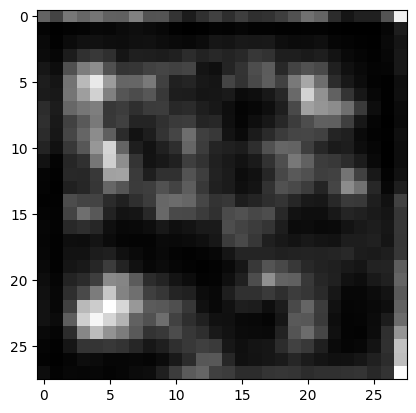

----------------------------------------


Discriminator Loss = 0.4206921458244324
Generator Loss = 1.7552697658538818
A sample image generated by the generator


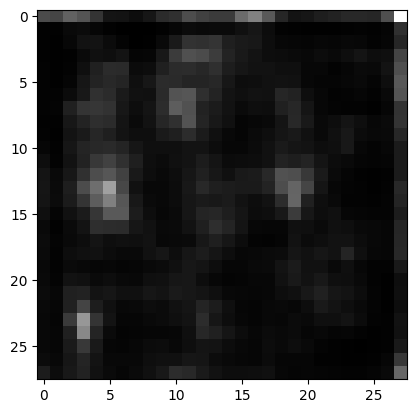

----------------------------------------


Discriminator Loss = 0.4013277590274811
Generator Loss = 1.8374857902526855
A sample image generated by the generator


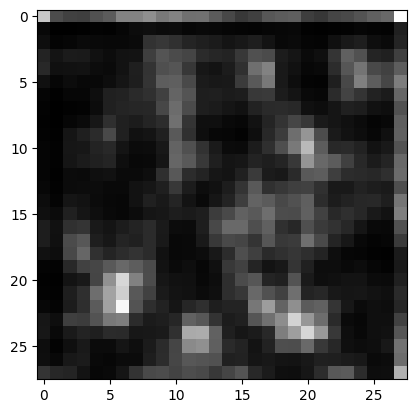

----------------------------------------


Discriminator Loss = 0.3999384343624115
Generator Loss = 1.7948596477508545
A sample image generated by the generator


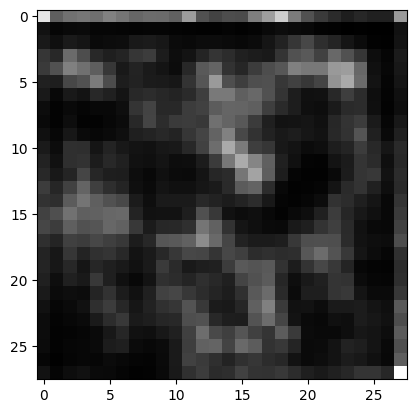

----------------------------------------


Discriminator Loss = 0.38044917583465576
Generator Loss = 1.8623957633972168
A sample image generated by the generator


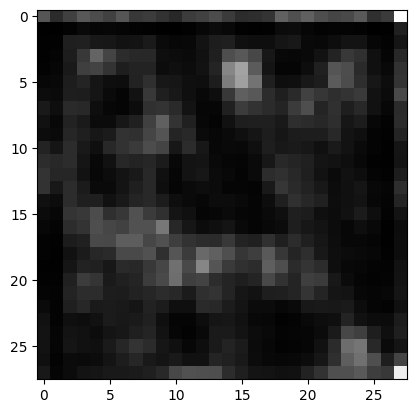

----------------------------------------


Discriminator Loss = 0.3932841420173645
Generator Loss = 1.8555827140808105
A sample image generated by the generator


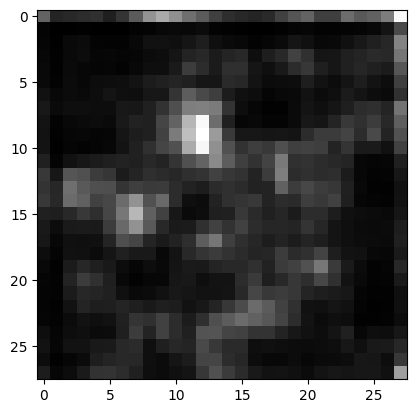

----------------------------------------


Discriminator Loss = 0.3792896866798401
Generator Loss = 1.8859232664108276
A sample image generated by the generator


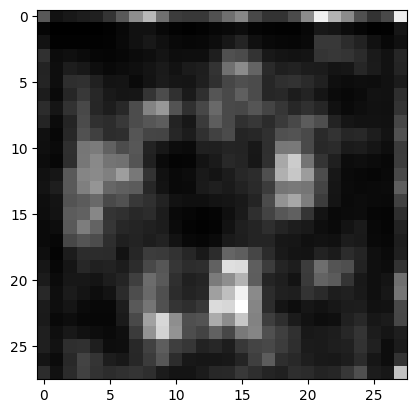

----------------------------------------


Discriminator Loss = 0.3972724974155426
Generator Loss = 1.847698450088501
A sample image generated by the generator


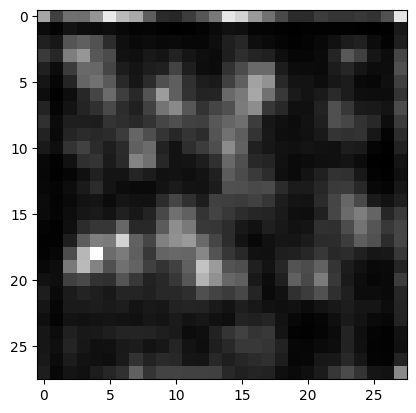

----------------------------------------


Discriminator Loss = 0.3889494240283966
Generator Loss = 1.7804604768753052
A sample image generated by the generator


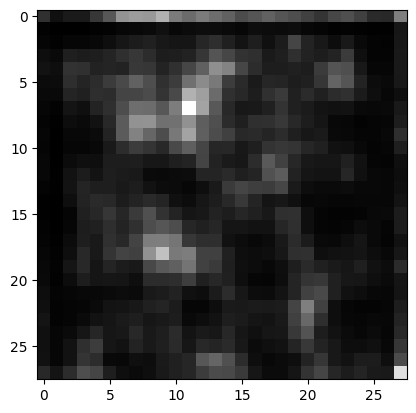

----------------------------------------


Discriminator Loss = 0.3807184100151062
Generator Loss = 1.8177342414855957
A sample image generated by the generator


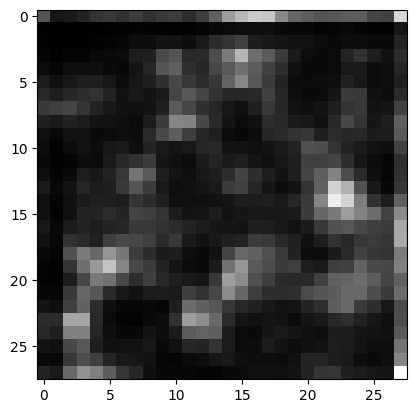

----------------------------------------


Discriminator Loss = 0.3914271593093872
Generator Loss = 1.833970069885254
A sample image generated by the generator


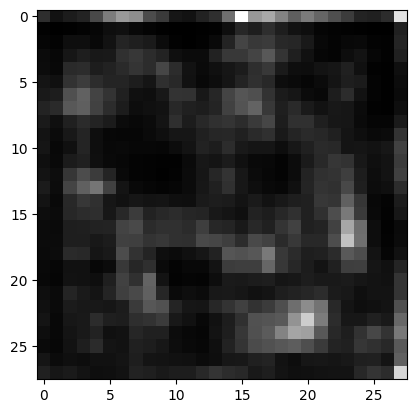

----------------------------------------


Discriminator Loss = 0.3979152739048004
Generator Loss = 1.8637980222702026
A sample image generated by the generator


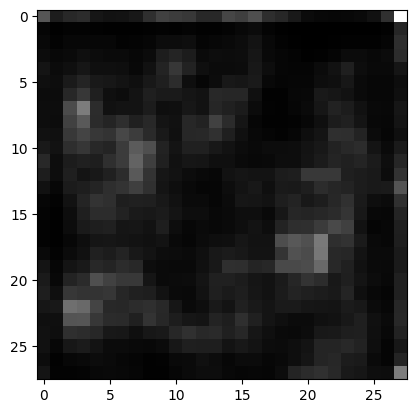

----------------------------------------


Discriminator Loss = 0.3720218241214752
Generator Loss = 1.8908865451812744
A sample image generated by the generator


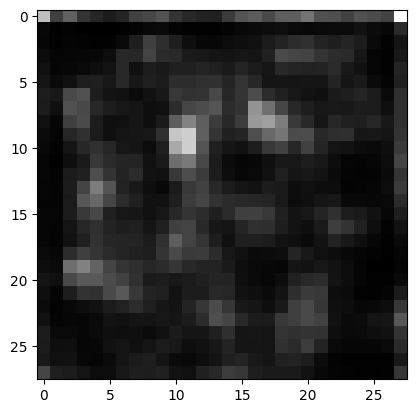

----------------------------------------


Discriminator Loss = 0.36696457862854004
Generator Loss = 1.8588958978652954
A sample image generated by the generator


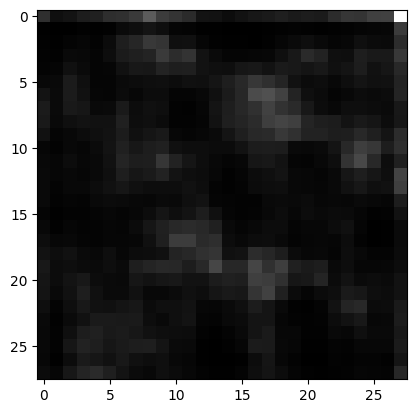

----------------------------------------


Discriminator Loss = 0.384714275598526
Generator Loss = 1.7990989685058594
A sample image generated by the generator


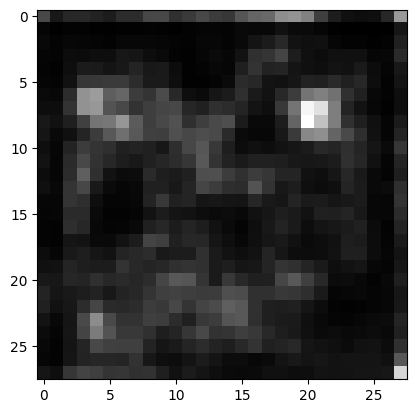

----------------------------------------


Discriminator Loss = 0.409648597240448
Generator Loss = 1.8523585796356201
A sample image generated by the generator


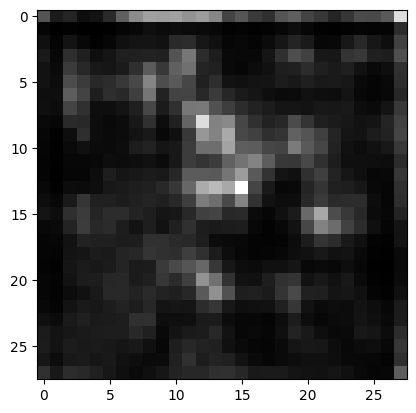

----------------------------------------


Discriminator Loss = 0.39652296900749207
Generator Loss = 1.9168860912322998
A sample image generated by the generator


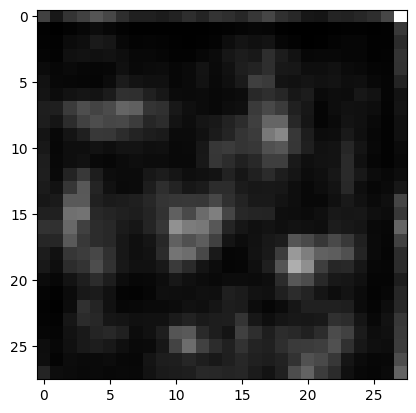

----------------------------------------


Discriminator Loss = 0.36649149656295776
Generator Loss = 1.884508490562439
A sample image generated by the generator


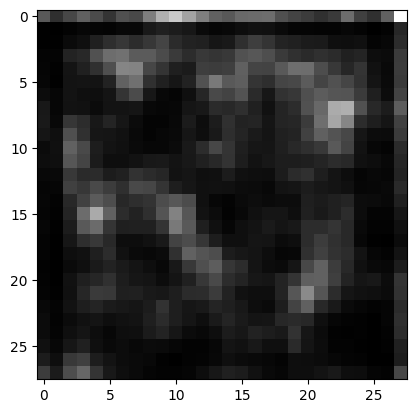

----------------------------------------


Discriminator Loss = 0.397979199886322
Generator Loss = 1.901668906211853
A sample image generated by the generator


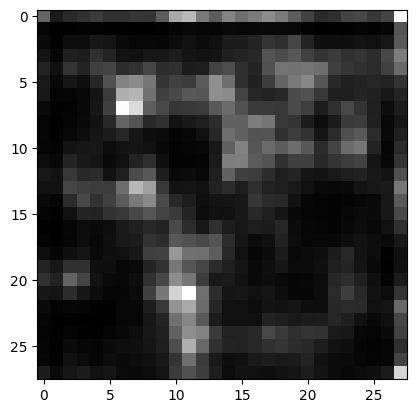

----------------------------------------


Discriminator Loss = 0.36461585760116577
Generator Loss = 1.9053579568862915
A sample image generated by the generator


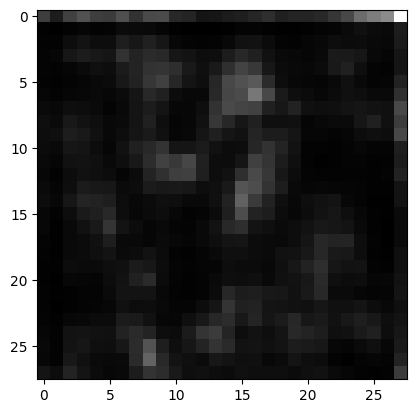

----------------------------------------


Discriminator Loss = 0.4013463258743286
Generator Loss = 1.9450209140777588
A sample image generated by the generator


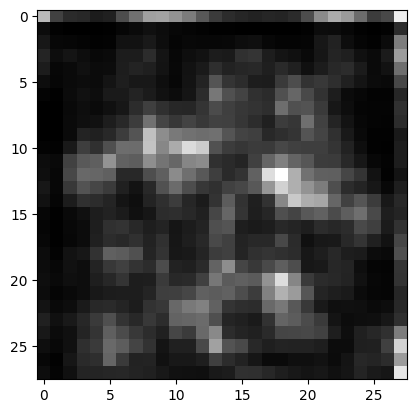

----------------------------------------


Discriminator Loss = 0.40527328848838806
Generator Loss = 1.9277515411376953
A sample image generated by the generator


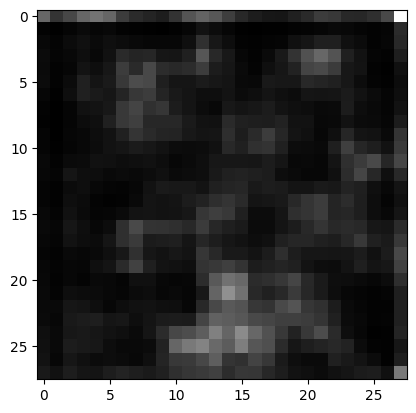

----------------------------------------


Discriminator Loss = 0.3640904128551483
Generator Loss = 1.8616758584976196
A sample image generated by the generator


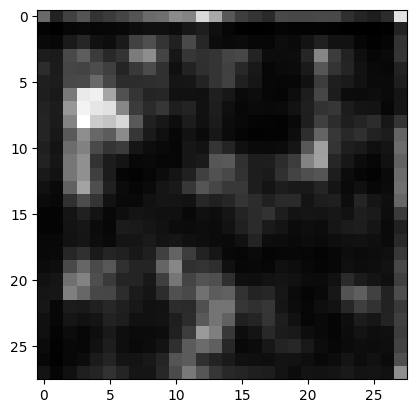

----------------------------------------


Discriminator Loss = 0.381630003452301
Generator Loss = 1.8401074409484863
A sample image generated by the generator


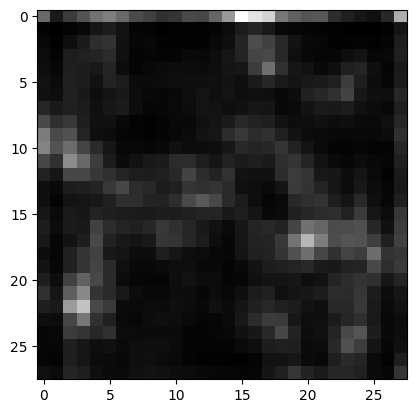

----------------------------------------


Discriminator Loss = 0.3797307014465332
Generator Loss = 1.848828673362732
A sample image generated by the generator


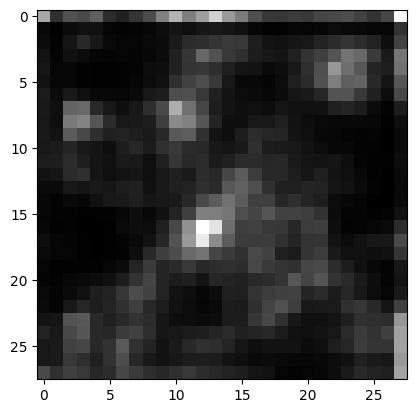

----------------------------------------


Discriminator Loss = 0.35365861654281616
Generator Loss = 1.8965868949890137
A sample image generated by the generator


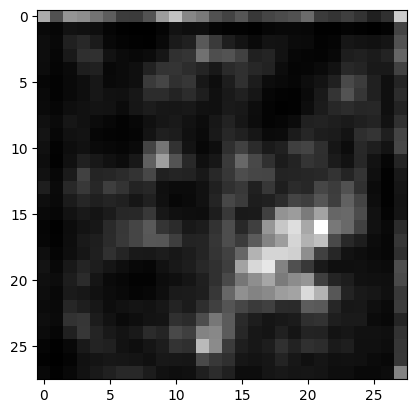

----------------------------------------


Discriminator Loss = 0.37968719005584717
Generator Loss = 1.9114184379577637
A sample image generated by the generator


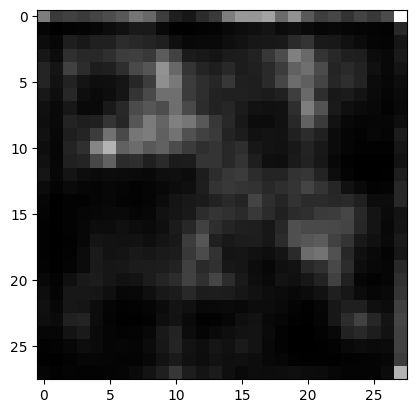

----------------------------------------


Discriminator Loss = 0.3521714508533478
Generator Loss = 1.853912353515625
A sample image generated by the generator


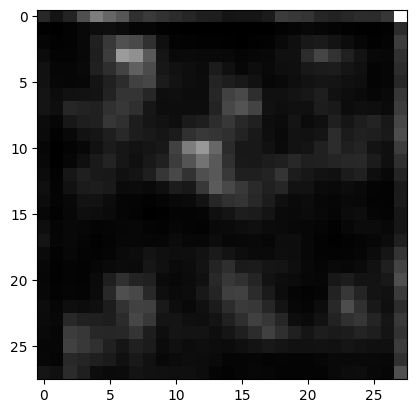

----------------------------------------


Discriminator Loss = 0.36781227588653564
Generator Loss = 1.8689250946044922
A sample image generated by the generator


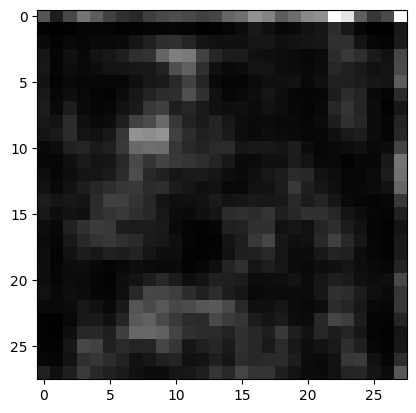

----------------------------------------


Discriminator Loss = 0.3756484389305115
Generator Loss = 1.8128386735916138
A sample image generated by the generator


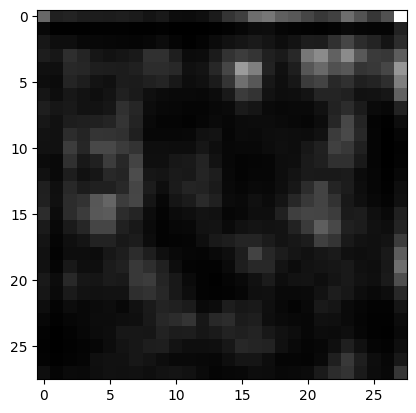

----------------------------------------


Discriminator Loss = 0.35831218957901
Generator Loss = 1.8958752155303955
A sample image generated by the generator


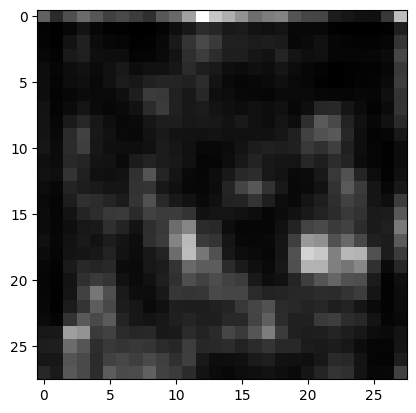

----------------------------------------


Discriminator Loss = 0.35681748390197754
Generator Loss = 1.9141812324523926
A sample image generated by the generator


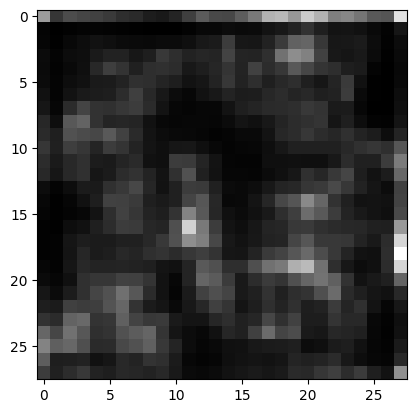

----------------------------------------


Discriminator Loss = 0.37233901023864746
Generator Loss = 1.8722609281539917
A sample image generated by the generator


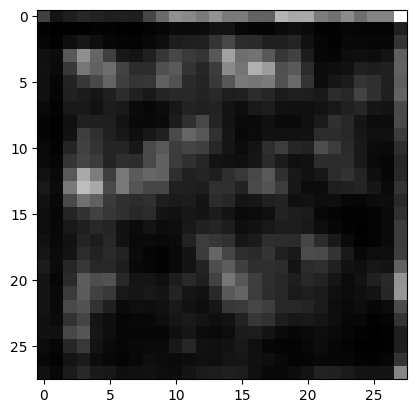

----------------------------------------


Discriminator Loss = 0.3682537078857422
Generator Loss = 1.857883095741272
A sample image generated by the generator


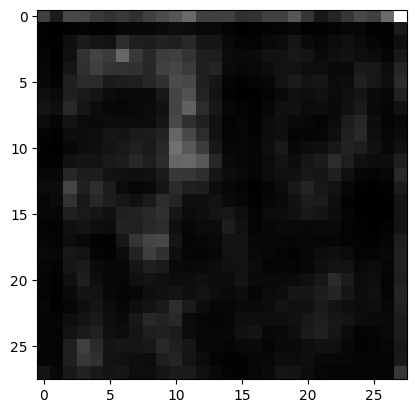

----------------------------------------


Discriminator Loss = 0.36799365282058716
Generator Loss = 1.784057855606079
A sample image generated by the generator


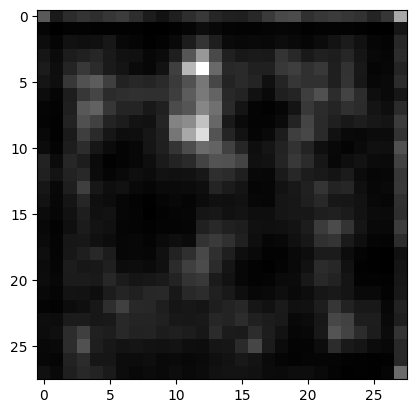

----------------------------------------


Discriminator Loss = 0.34153565764427185
Generator Loss = 1.9300801753997803
A sample image generated by the generator


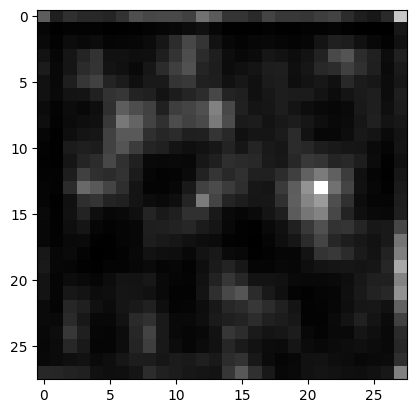

----------------------------------------


Discriminator Loss = 0.32909032702445984
Generator Loss = 1.8801300525665283
A sample image generated by the generator


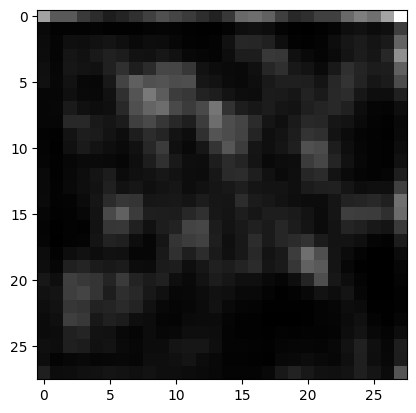

----------------------------------------


Discriminator Loss = 0.3393460214138031
Generator Loss = 1.9006016254425049
A sample image generated by the generator


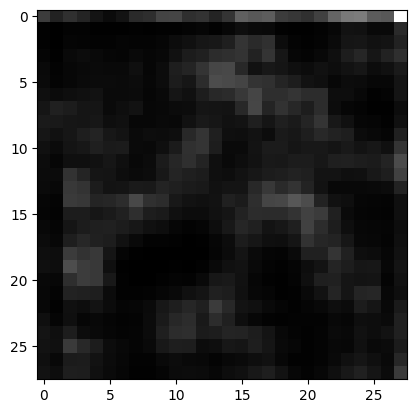

----------------------------------------


Discriminator Loss = 0.3683990240097046
Generator Loss = 1.9067164659500122
A sample image generated by the generator


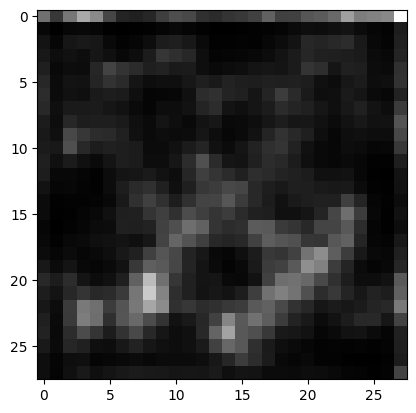

----------------------------------------


Discriminator Loss = 0.3605869710445404
Generator Loss = 1.9156721830368042
A sample image generated by the generator


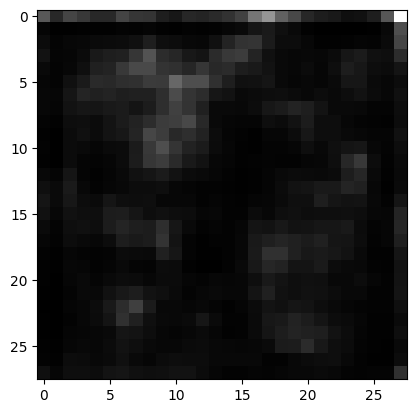

----------------------------------------


Discriminator Loss = 0.37795543670654297
Generator Loss = 1.8629146814346313
A sample image generated by the generator


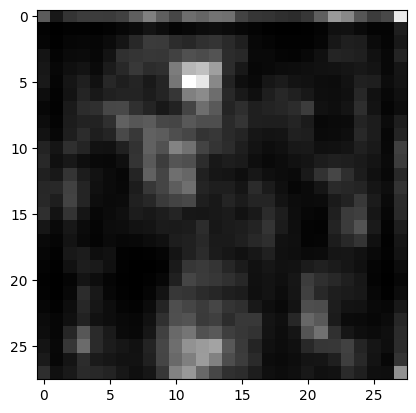

----------------------------------------


Discriminator Loss = 0.3450797200202942
Generator Loss = 1.9811935424804688
A sample image generated by the generator


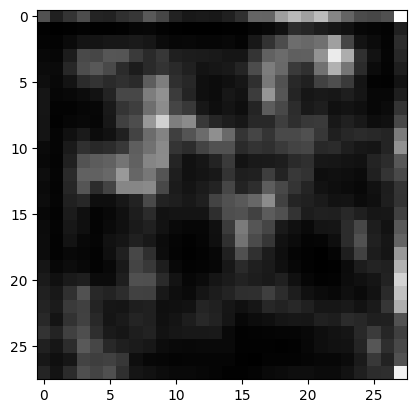

----------------------------------------


Discriminator Loss = 0.34257686138153076
Generator Loss = 1.9800935983657837
A sample image generated by the generator


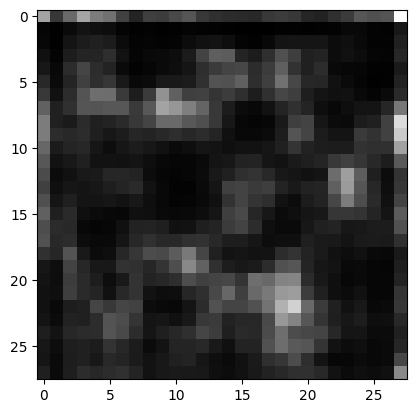

----------------------------------------


Discriminator Loss = 0.3770018219947815
Generator Loss = 1.8183962106704712
A sample image generated by the generator


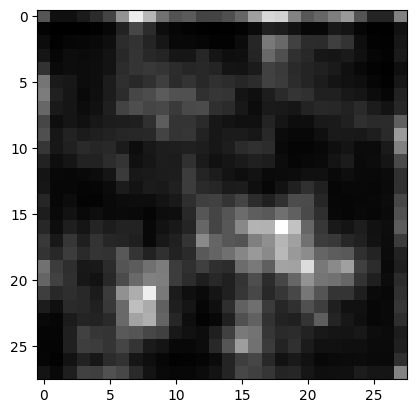

----------------------------------------


Discriminator Loss = 0.3641875088214874
Generator Loss = 1.9214720726013184
A sample image generated by the generator


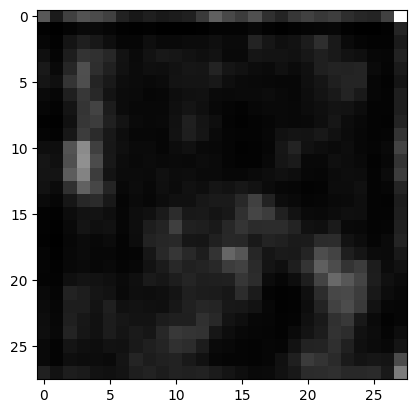

----------------------------------------


Discriminator Loss = 0.34008538722991943
Generator Loss = 1.8577356338500977
A sample image generated by the generator


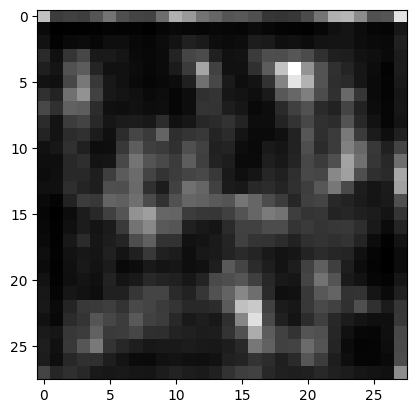

----------------------------------------


Discriminator Loss = 0.33851349353790283
Generator Loss = 1.915788173675537
A sample image generated by the generator


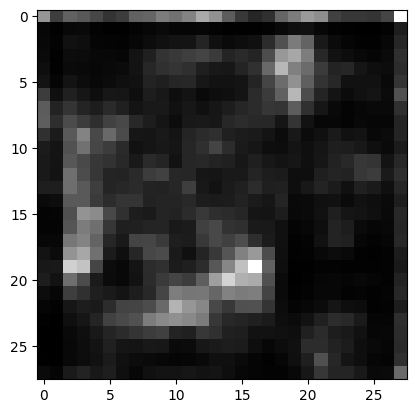

----------------------------------------


Discriminator Loss = 0.3526070713996887
Generator Loss = 1.9324631690979004
A sample image generated by the generator


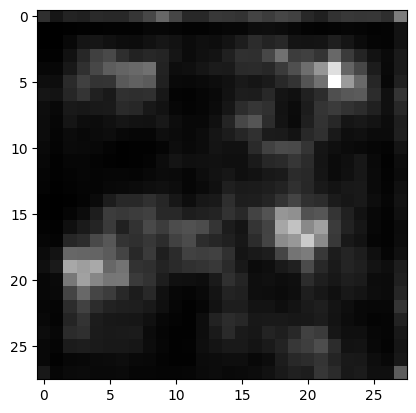

----------------------------------------


Discriminator Loss = 0.378521203994751
Generator Loss = 1.9246630668640137
A sample image generated by the generator


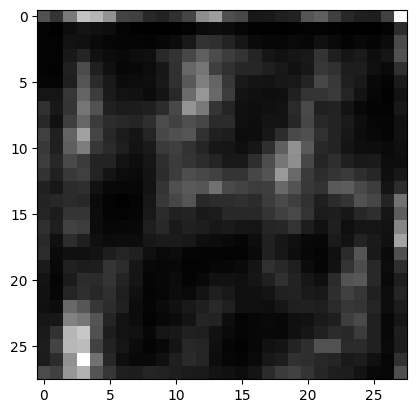

----------------------------------------


Discriminator Loss = 0.35073739290237427
Generator Loss = 1.8322830200195312
A sample image generated by the generator


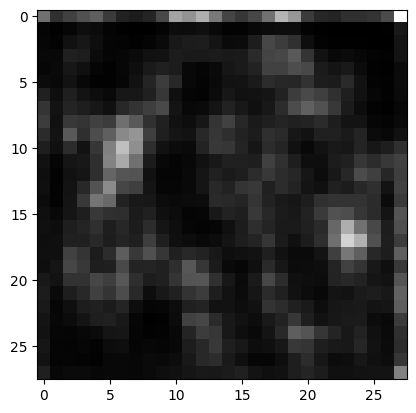

----------------------------------------


Discriminator Loss = 0.34690696001052856
Generator Loss = 1.9088573455810547
A sample image generated by the generator


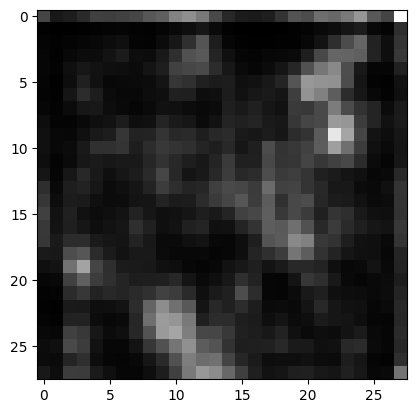

----------------------------------------


Discriminator Loss = 0.3454607427120209
Generator Loss = 1.8671998977661133
A sample image generated by the generator


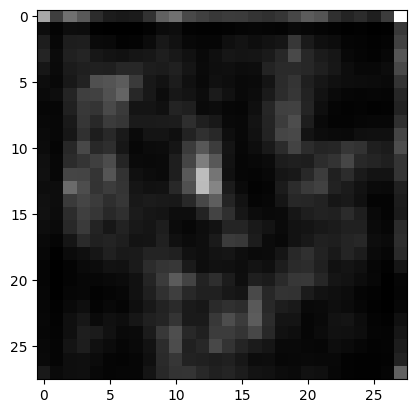

----------------------------------------


Discriminator Loss = 0.36552637815475464
Generator Loss = 1.9241502285003662
A sample image generated by the generator


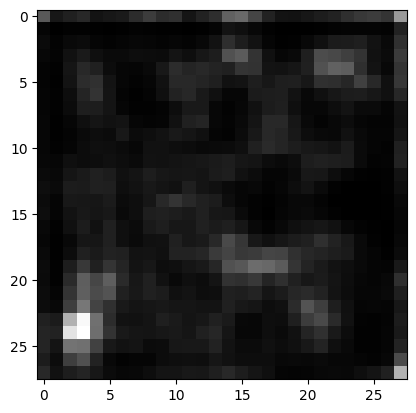

----------------------------------------


Discriminator Loss = 0.33860692381858826
Generator Loss = 1.8898290395736694
A sample image generated by the generator


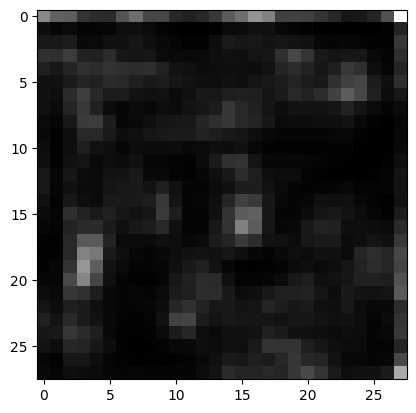

----------------------------------------


Discriminator Loss = 0.3292897343635559
Generator Loss = 1.9674713611602783
A sample image generated by the generator


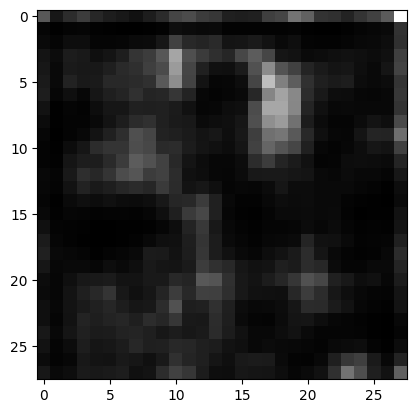

----------------------------------------


Discriminator Loss = 0.3683002293109894
Generator Loss = 1.967949628829956
A sample image generated by the generator


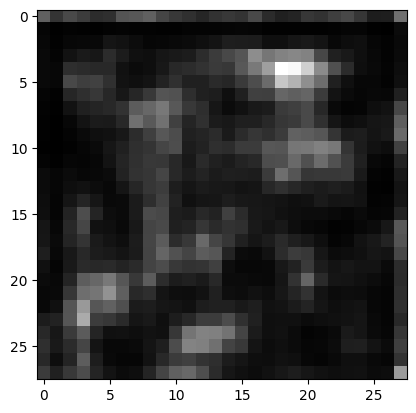

----------------------------------------


Discriminator Loss = 0.31798896193504333
Generator Loss = 1.9535549879074097
A sample image generated by the generator


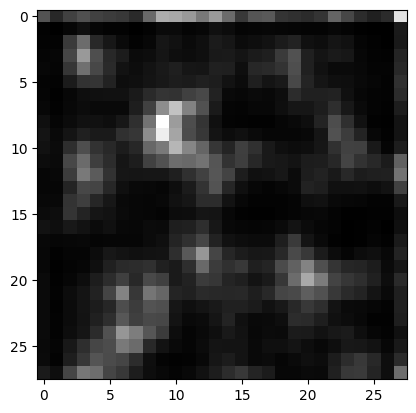

----------------------------------------


Discriminator Loss = 0.377693235874176
Generator Loss = 1.978308081626892
A sample image generated by the generator


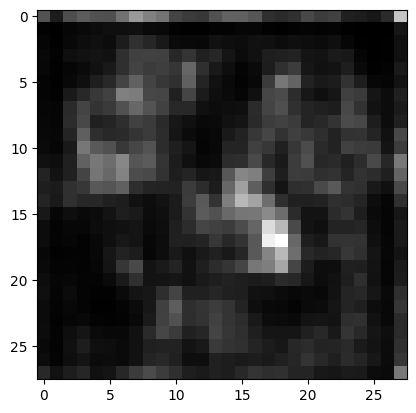

----------------------------------------


Discriminator Loss = 0.3458253741264343
Generator Loss = 1.9673357009887695
A sample image generated by the generator


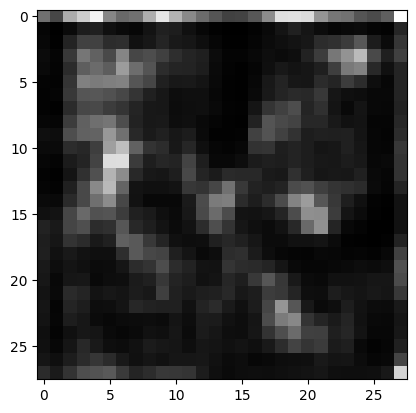

----------------------------------------


Discriminator Loss = 0.35243675112724304
Generator Loss = 1.9893854856491089
A sample image generated by the generator


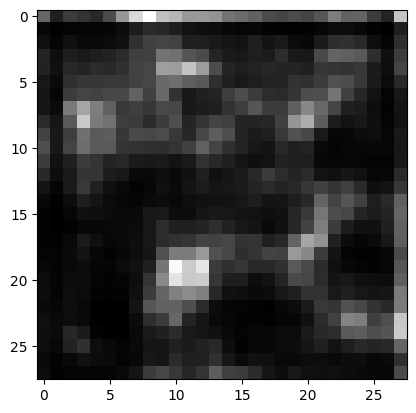

----------------------------------------


Discriminator Loss = 0.35245072841644287
Generator Loss = 1.9711403846740723
A sample image generated by the generator


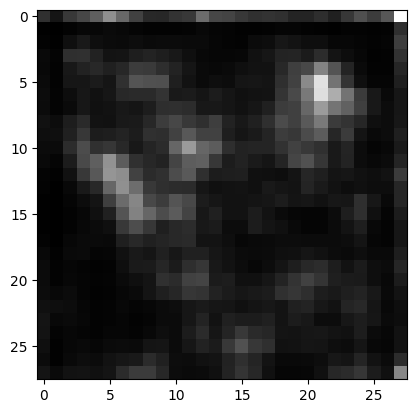

----------------------------------------


Discriminator Loss = 0.3585361838340759
Generator Loss = 1.8852821588516235
A sample image generated by the generator


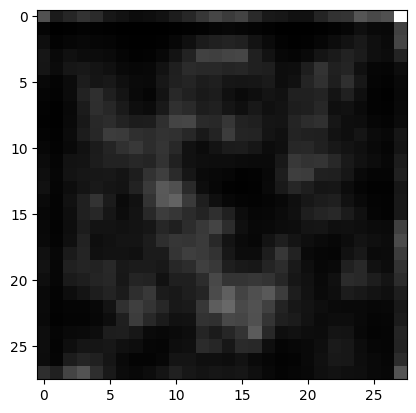

----------------------------------------


Discriminator Loss = 0.3550834059715271
Generator Loss = 1.8937091827392578
A sample image generated by the generator


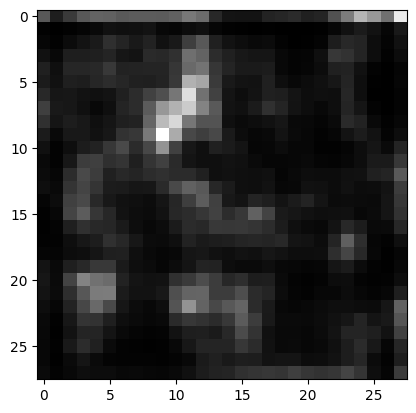

----------------------------------------


Discriminator Loss = 0.3487304449081421
Generator Loss = 1.9645718336105347
A sample image generated by the generator


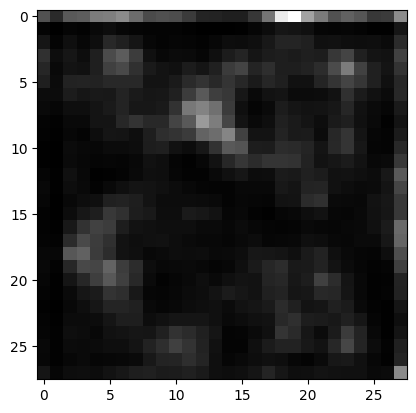

----------------------------------------


Discriminator Loss = 0.3459862470626831
Generator Loss = 1.9818047285079956
A sample image generated by the generator


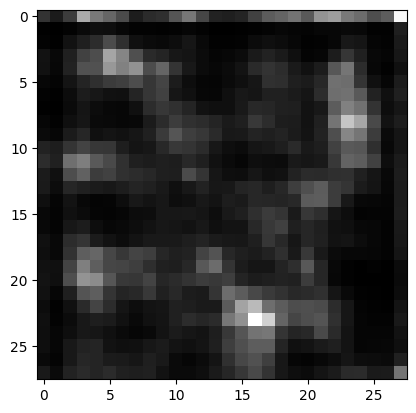

----------------------------------------


Discriminator Loss = 0.3506128787994385
Generator Loss = 1.8728272914886475
A sample image generated by the generator


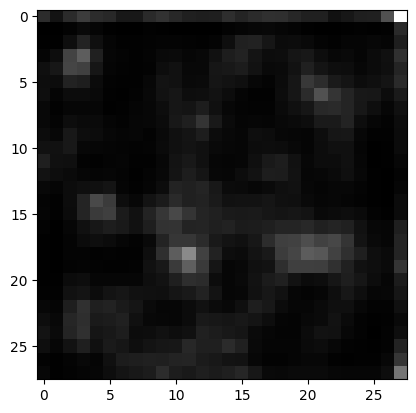

----------------------------------------


Discriminator Loss = 0.343479186296463
Generator Loss = 1.9538531303405762
A sample image generated by the generator


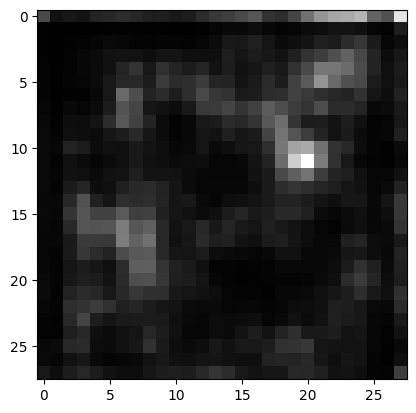

----------------------------------------


Discriminator Loss = 0.32707682251930237
Generator Loss = 1.9616352319717407
A sample image generated by the generator


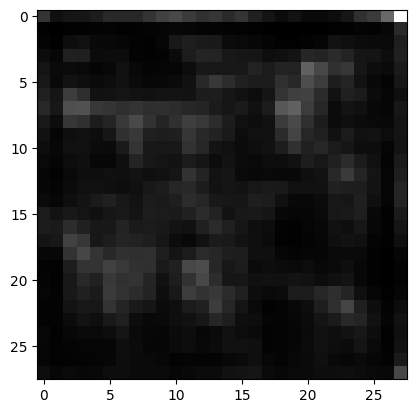

----------------------------------------


Discriminator Loss = 0.35653576254844666
Generator Loss = 1.966346025466919
A sample image generated by the generator


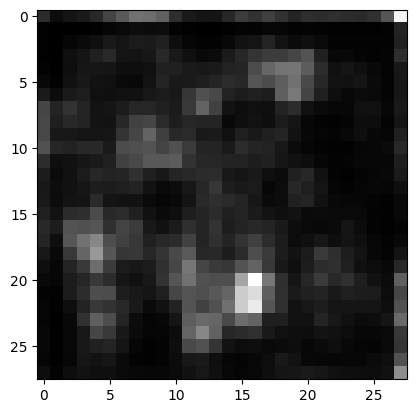

----------------------------------------


Discriminator Loss = 0.3582029938697815
Generator Loss = 1.958767294883728
A sample image generated by the generator


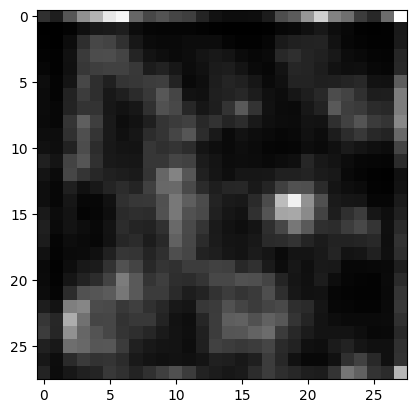

----------------------------------------


Discriminator Loss = 0.35879701375961304
Generator Loss = 1.8892574310302734
A sample image generated by the generator


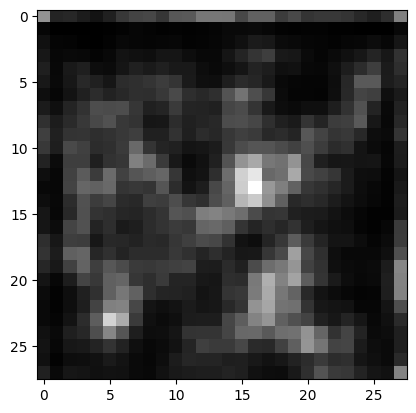

----------------------------------------


Discriminator Loss = 0.36873066425323486
Generator Loss = 1.9672131538391113
A sample image generated by the generator


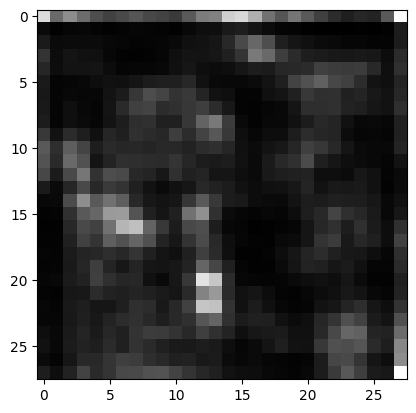

----------------------------------------


Discriminator Loss = 0.3496871590614319
Generator Loss = 1.9271436929702759
A sample image generated by the generator


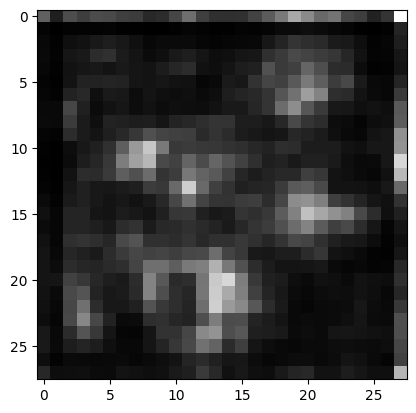

----------------------------------------


Discriminator Loss = 0.3222813904285431
Generator Loss = 2.0280637741088867
A sample image generated by the generator


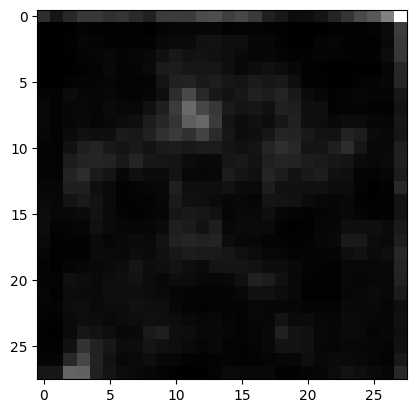

----------------------------------------


Discriminator Loss = 0.33801260590553284
Generator Loss = 2.041044235229492
A sample image generated by the generator


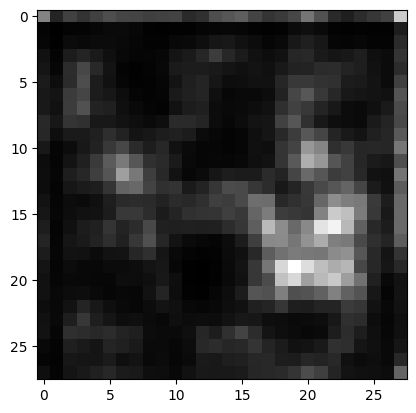

----------------------------------------


Discriminator Loss = 0.3336368799209595
Generator Loss = 1.8913359642028809
A sample image generated by the generator


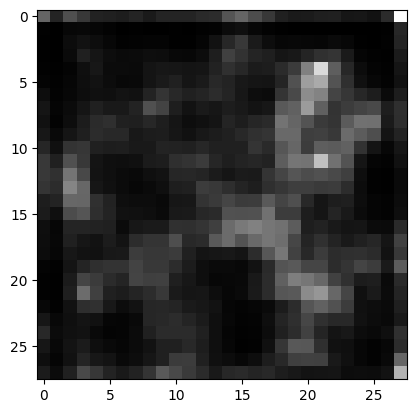

----------------------------------------


Discriminator Loss = 0.3090417981147766
Generator Loss = 2.023332118988037
A sample image generated by the generator


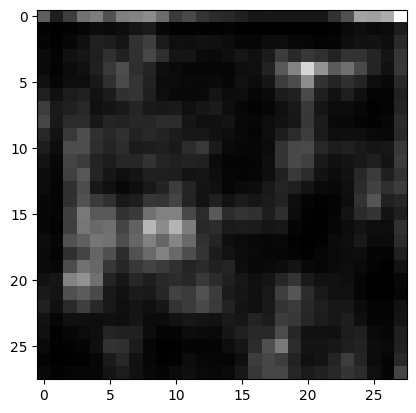

----------------------------------------


Discriminator Loss = 0.3395620882511139
Generator Loss = 1.998345136642456
A sample image generated by the generator


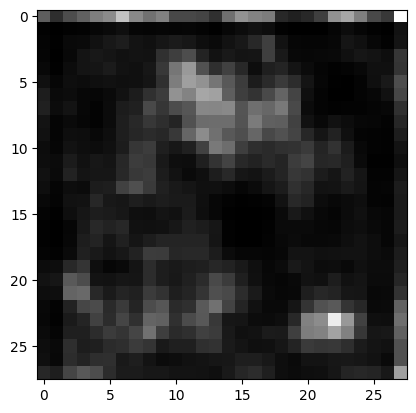

----------------------------------------


Discriminator Loss = 0.34318381547927856
Generator Loss = 1.9892734289169312
A sample image generated by the generator


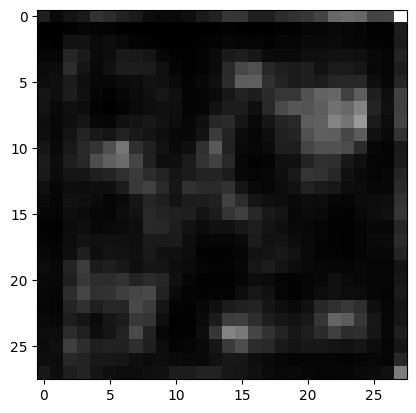

----------------------------------------


Discriminator Loss = 0.32981377840042114
Generator Loss = 1.9396109580993652
A sample image generated by the generator


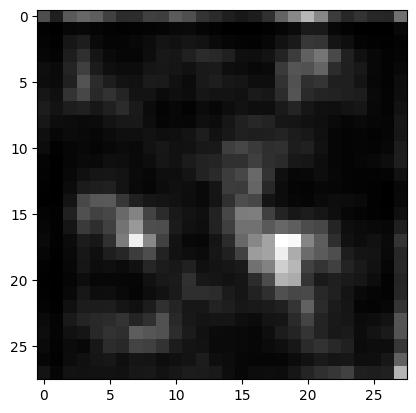

----------------------------------------


Discriminator Loss = 0.31870144605636597
Generator Loss = 2.0558371543884277
A sample image generated by the generator


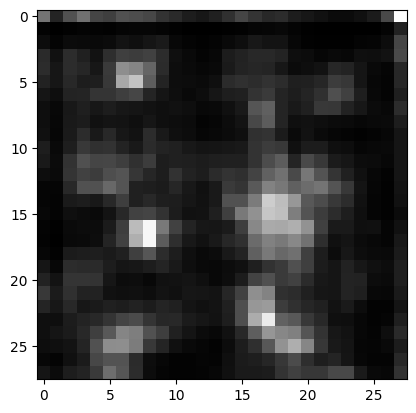

----------------------------------------


Discriminator Loss = 0.3283054232597351
Generator Loss = 1.9885562658309937
A sample image generated by the generator


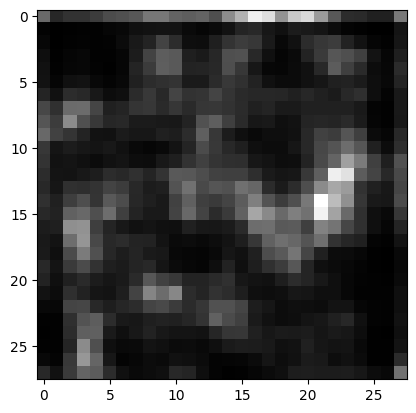

----------------------------------------


Discriminator Loss = 0.3461218774318695
Generator Loss = 1.9590046405792236
A sample image generated by the generator


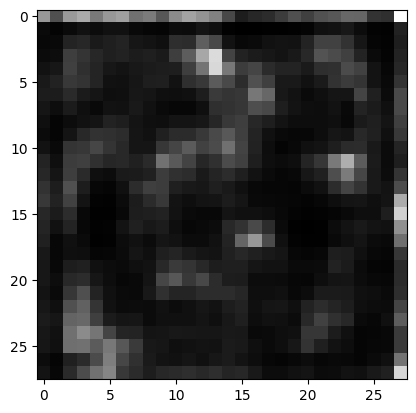

----------------------------------------


Discriminator Loss = 0.3286641538143158
Generator Loss = 1.907698154449463
A sample image generated by the generator


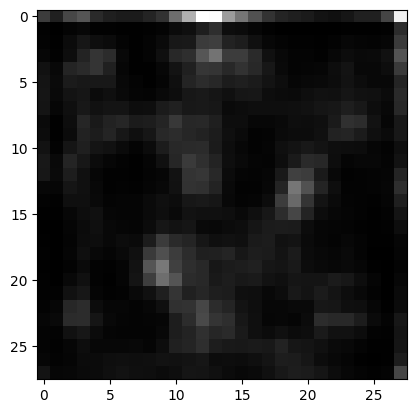

----------------------------------------


Discriminator Loss = 0.3429677486419678
Generator Loss = 1.9879424571990967
A sample image generated by the generator


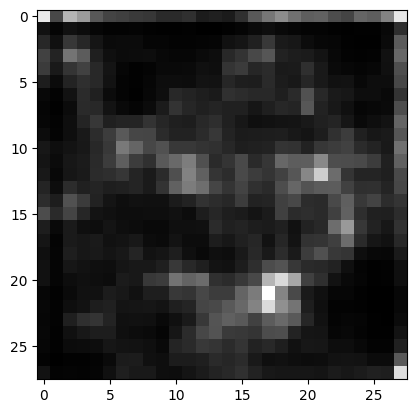

----------------------------------------


Discriminator Loss = 0.33527255058288574
Generator Loss = 1.9830808639526367
A sample image generated by the generator


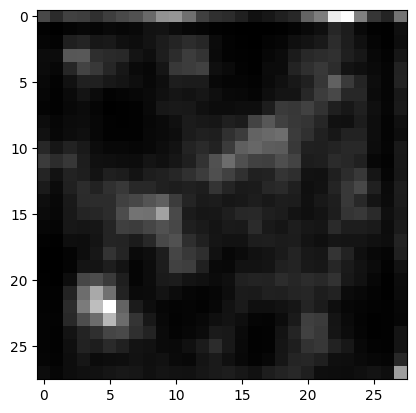

----------------------------------------


Discriminator Loss = 0.3400826156139374
Generator Loss = 2.0346007347106934
A sample image generated by the generator


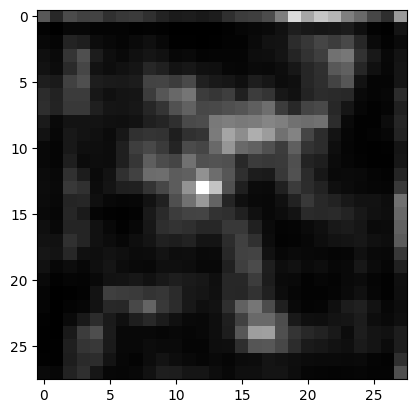

----------------------------------------


Discriminator Loss = 0.32733041048049927
Generator Loss = 2.0362586975097656
A sample image generated by the generator


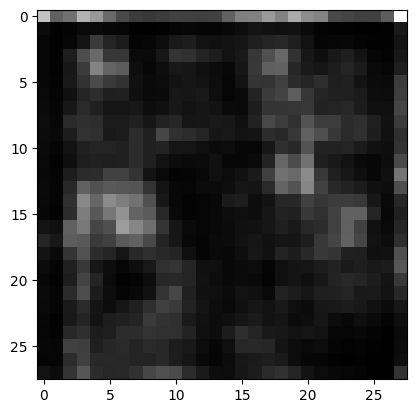

----------------------------------------


Discriminator Loss = 0.33893001079559326
Generator Loss = 1.9704222679138184
A sample image generated by the generator


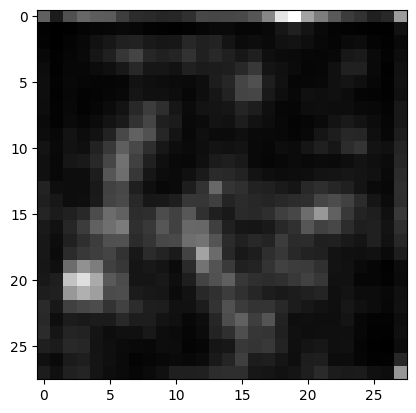

----------------------------------------


Discriminator Loss = 0.3431231677532196
Generator Loss = 1.9798916578292847
A sample image generated by the generator


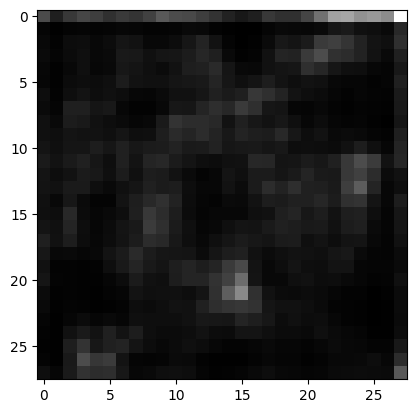

----------------------------------------


Discriminator Loss = 0.3324025571346283
Generator Loss = 2.0121867656707764
A sample image generated by the generator


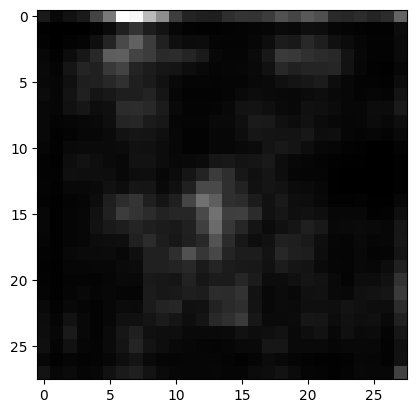

----------------------------------------


Discriminator Loss = 0.34710896015167236
Generator Loss = 1.9836814403533936
A sample image generated by the generator


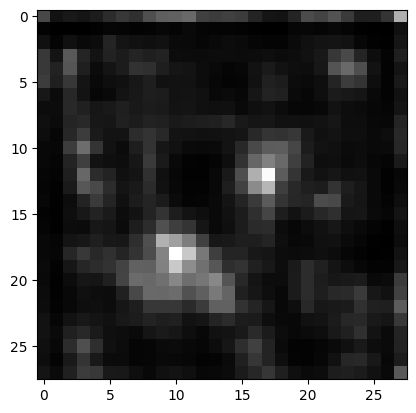

----------------------------------------


Discriminator Loss = 0.32756027579307556
Generator Loss = 2.0629427433013916
A sample image generated by the generator


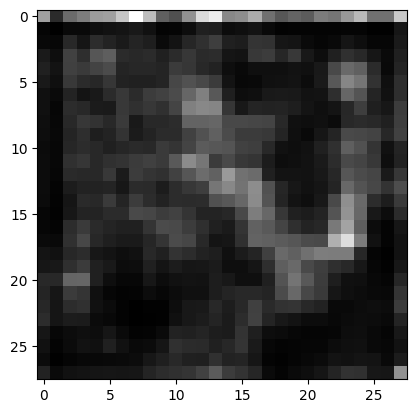

----------------------------------------


Discriminator Loss = 0.3320683240890503
Generator Loss = 1.9936213493347168
A sample image generated by the generator


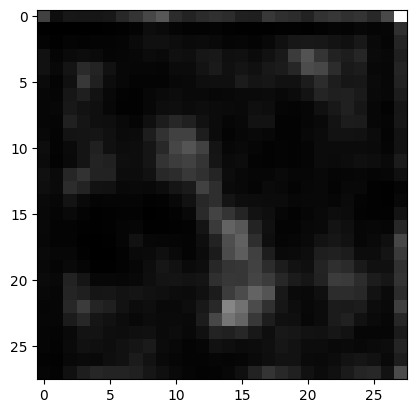

----------------------------------------


Discriminator Loss = 0.32979637384414673
Generator Loss = 1.9703130722045898
A sample image generated by the generator


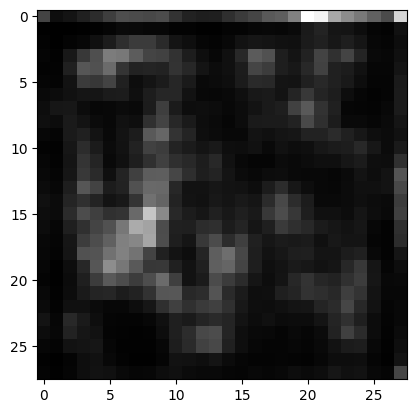

----------------------------------------


Discriminator Loss = 0.31049251556396484
Generator Loss = 1.9053943157196045
A sample image generated by the generator


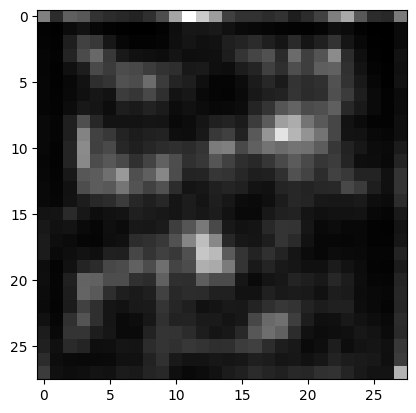

----------------------------------------


Discriminator Loss = 0.32262641191482544
Generator Loss = 1.9805412292480469
A sample image generated by the generator


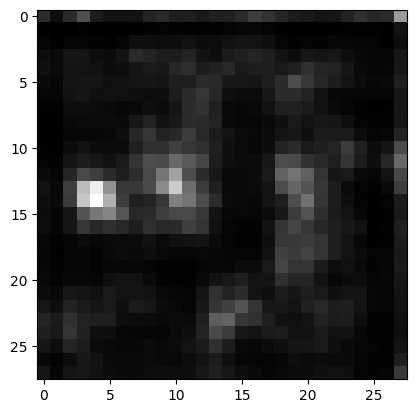

----------------------------------------


Discriminator Loss = 0.32817426323890686
Generator Loss = 1.9603042602539062
A sample image generated by the generator


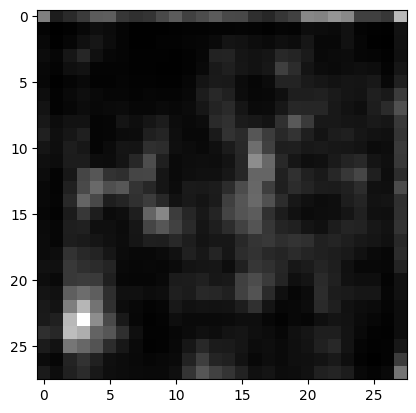

----------------------------------------


Discriminator Loss = 0.34076809883117676
Generator Loss = 1.9863569736480713
A sample image generated by the generator


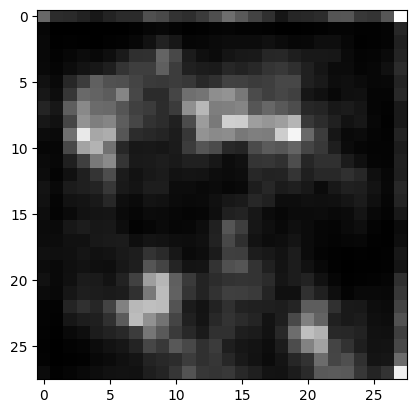

----------------------------------------


Discriminator Loss = 0.31204643845558167
Generator Loss = 2.0433950424194336
A sample image generated by the generator


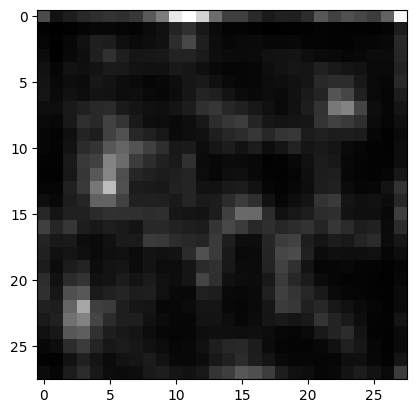

----------------------------------------


Discriminator Loss = 0.34826675057411194
Generator Loss = 1.8933048248291016
A sample image generated by the generator


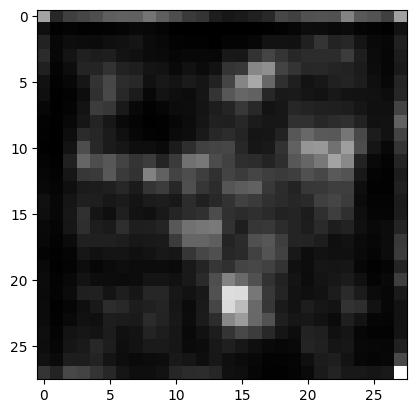

----------------------------------------


Discriminator Loss = 0.34423828125
Generator Loss = 1.9760138988494873
A sample image generated by the generator


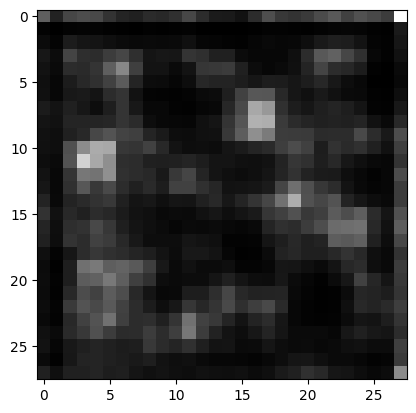

----------------------------------------


Discriminator Loss = 0.29571518301963806
Generator Loss = 2.0816094875335693
A sample image generated by the generator


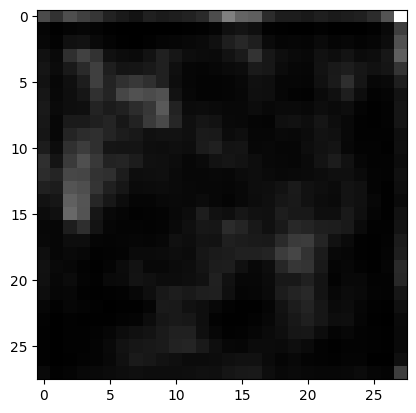

----------------------------------------


Discriminator Loss = 0.31979116797447205
Generator Loss = 2.0195696353912354
A sample image generated by the generator


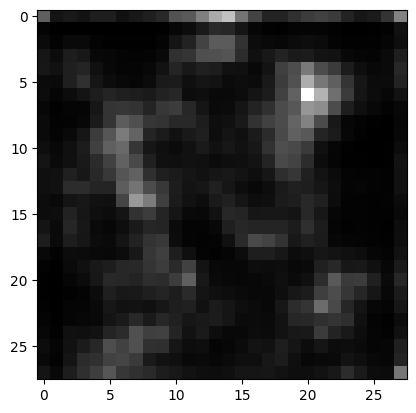

----------------------------------------


Discriminator Loss = 0.3151850402355194
Generator Loss = 2.0193867683410645
A sample image generated by the generator


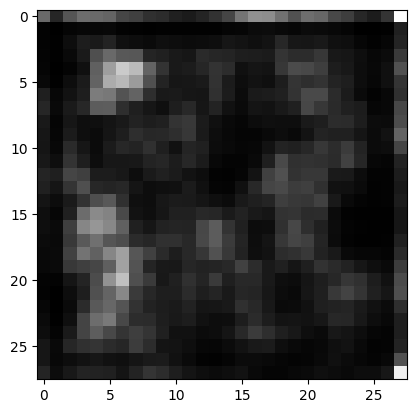

----------------------------------------


Discriminator Loss = 0.3158997893333435
Generator Loss = 1.9720615148544312
A sample image generated by the generator


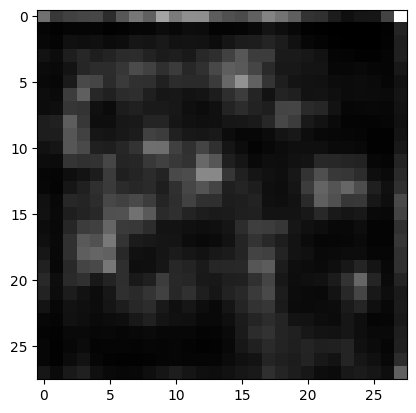

----------------------------------------


Discriminator Loss = 0.3211747109889984
Generator Loss = 2.0084962844848633
A sample image generated by the generator


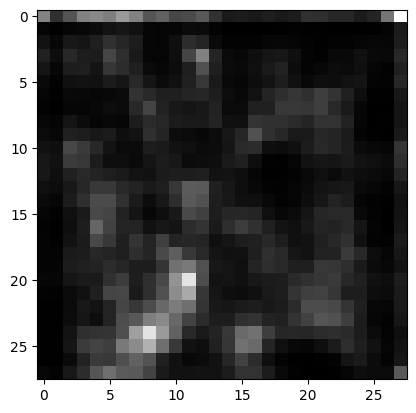

----------------------------------------


Discriminator Loss = 0.30854225158691406
Generator Loss = 2.0297908782958984
A sample image generated by the generator


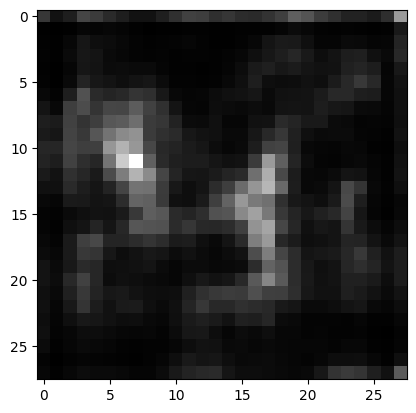

----------------------------------------


Discriminator Loss = 0.31960996985435486
Generator Loss = 2.1314258575439453
A sample image generated by the generator


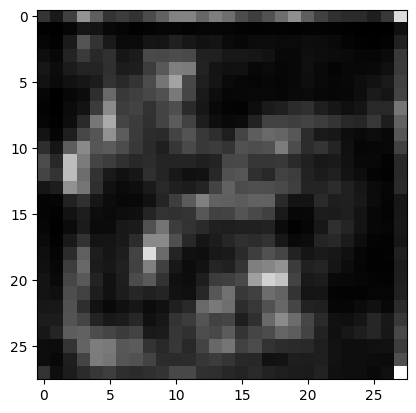

----------------------------------------


Discriminator Loss = 0.3198162317276001
Generator Loss = 1.945649266242981
A sample image generated by the generator


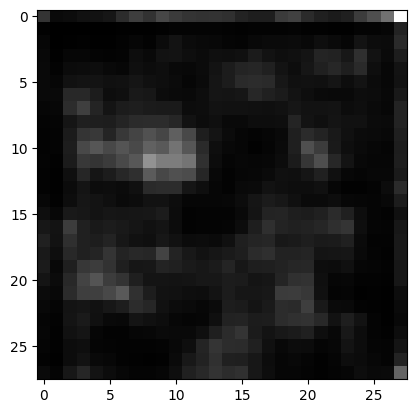

----------------------------------------


Discriminator Loss = 0.331976056098938
Generator Loss = 2.0284109115600586
A sample image generated by the generator


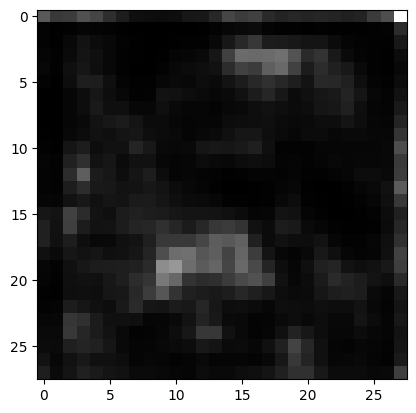

----------------------------------------


Discriminator Loss = 0.32653772830963135
Generator Loss = 1.9249722957611084
A sample image generated by the generator


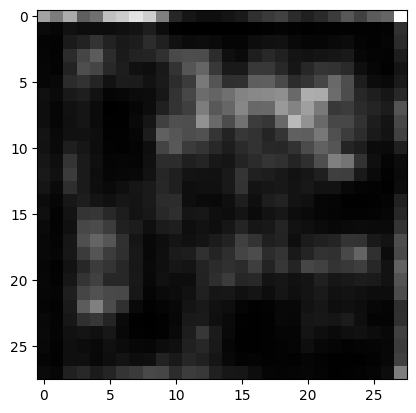

----------------------------------------


Discriminator Loss = 0.3280301094055176
Generator Loss = 2.109879732131958
A sample image generated by the generator


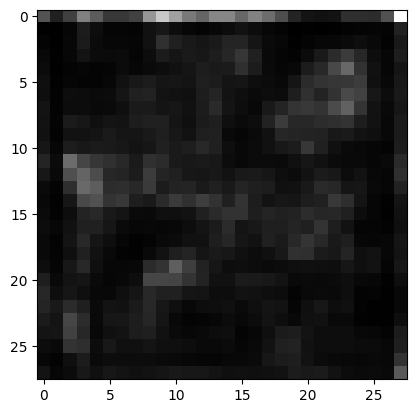

----------------------------------------


Discriminator Loss = 0.3025706112384796
Generator Loss = 2.0467355251312256
A sample image generated by the generator


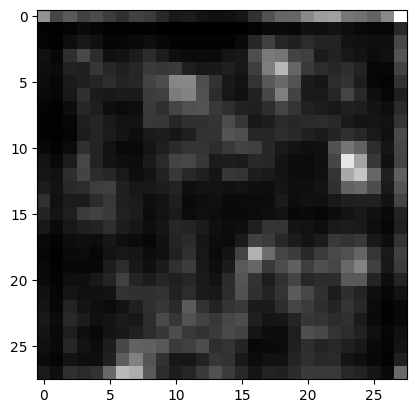

----------------------------------------


Discriminator Loss = 0.3337838649749756
Generator Loss = 2.041964530944824
A sample image generated by the generator


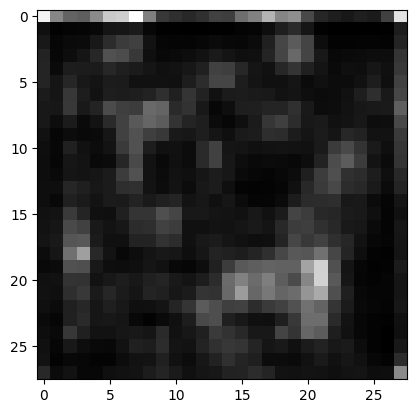

----------------------------------------


Discriminator Loss = 0.31021758913993835
Generator Loss = 2.0158462524414062
A sample image generated by the generator


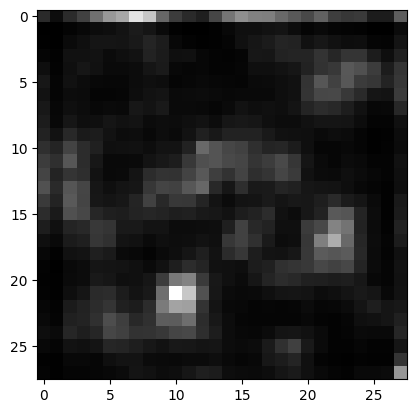

----------------------------------------


Discriminator Loss = 0.3241545557975769
Generator Loss = 2.045701026916504
A sample image generated by the generator


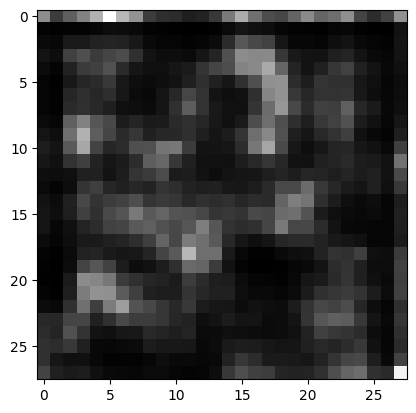

----------------------------------------


Discriminator Loss = 0.3295438587665558
Generator Loss = 2.0811142921447754
A sample image generated by the generator


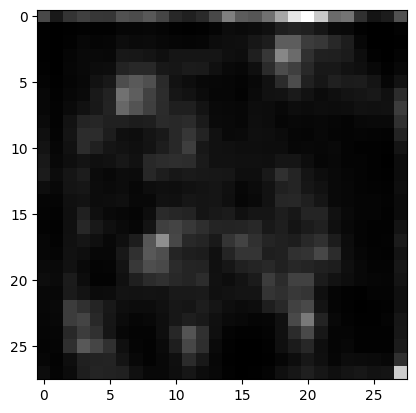

----------------------------------------


Discriminator Loss = 0.3091616630554199
Generator Loss = 2.1211347579956055
A sample image generated by the generator


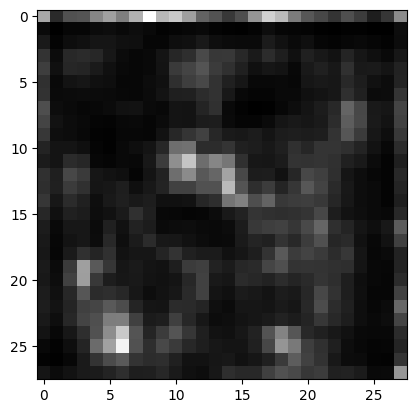

----------------------------------------


Discriminator Loss = 0.3263486921787262
Generator Loss = 1.9762139320373535
A sample image generated by the generator


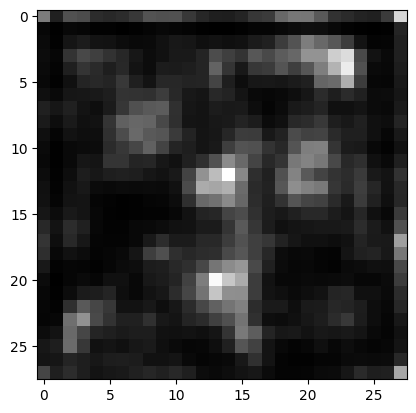

----------------------------------------


Discriminator Loss = 0.32116222381591797
Generator Loss = 2.036606788635254
A sample image generated by the generator


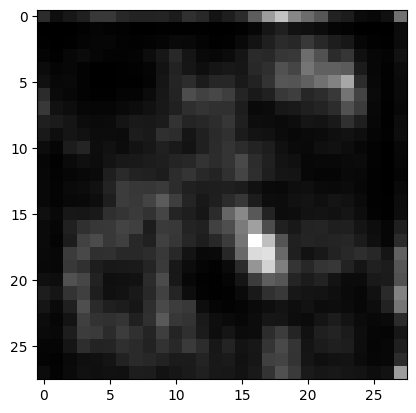

----------------------------------------


Discriminator Loss = 0.33347219228744507
Generator Loss = 2.0653367042541504
A sample image generated by the generator


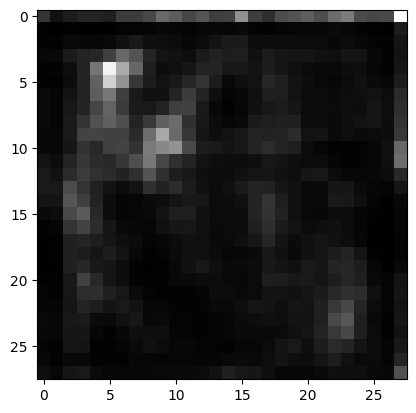

----------------------------------------


Discriminator Loss = 0.2983890771865845
Generator Loss = 2.0789241790771484
A sample image generated by the generator


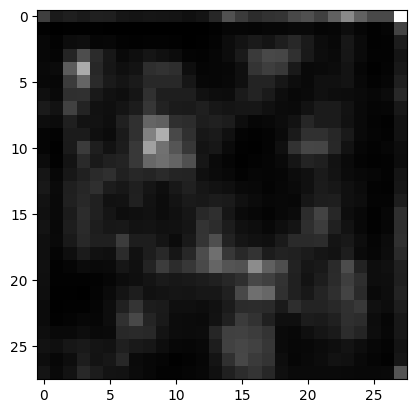

----------------------------------------


Discriminator Loss = 0.3041638433933258
Generator Loss = 2.0823464393615723
A sample image generated by the generator


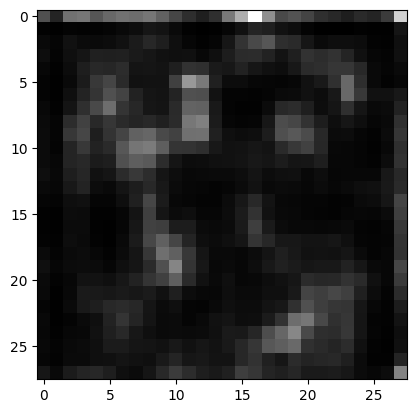

----------------------------------------


Discriminator Loss = 0.31722843647003174
Generator Loss = 1.9938359260559082
A sample image generated by the generator


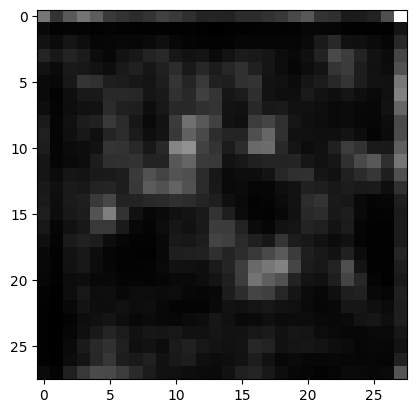

----------------------------------------


Discriminator Loss = 0.3141893744468689
Generator Loss = 2.112457752227783
A sample image generated by the generator


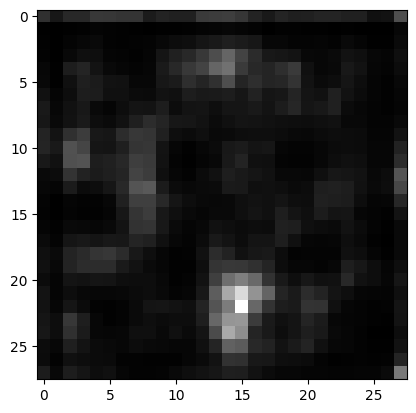

----------------------------------------


Discriminator Loss = 0.32631856203079224
Generator Loss = 2.0934057235717773
A sample image generated by the generator


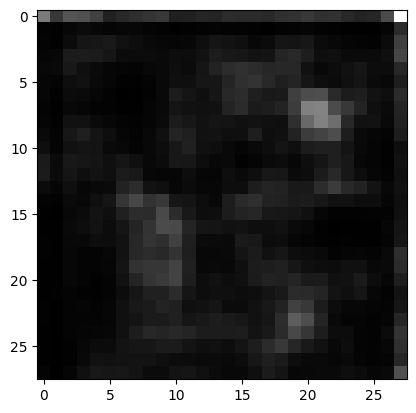

----------------------------------------


Discriminator Loss = 0.30666685104370117
Generator Loss = 2.035238027572632
A sample image generated by the generator


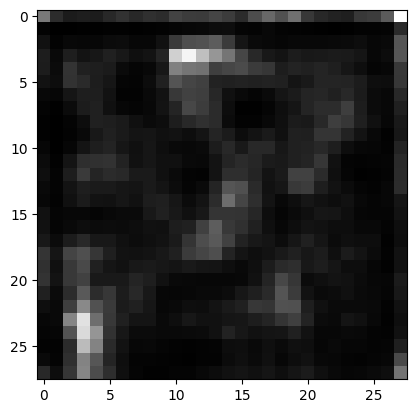

----------------------------------------


Discriminator Loss = 0.32540789246559143
Generator Loss = 1.960400104522705
A sample image generated by the generator


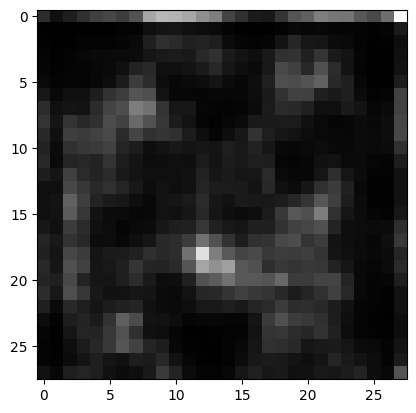

----------------------------------------


Discriminator Loss = 0.30137139558792114
Generator Loss = 2.042264938354492
A sample image generated by the generator


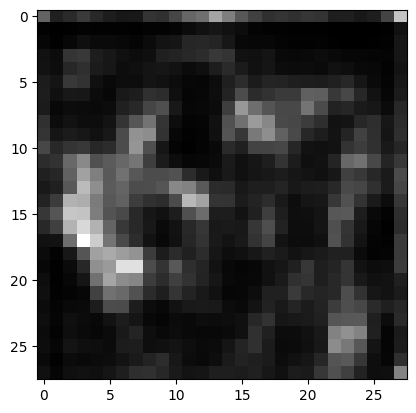

----------------------------------------


Discriminator Loss = 0.29357343912124634
Generator Loss = 2.13334321975708
A sample image generated by the generator


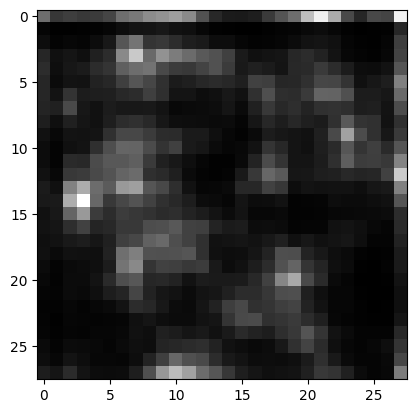

----------------------------------------


Discriminator Loss = 0.32077574729919434
Generator Loss = 2.1012463569641113
A sample image generated by the generator


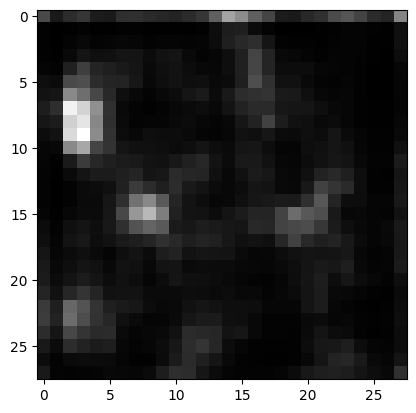

----------------------------------------


Discriminator Loss = 0.329995334148407
Generator Loss = 2.036144256591797
A sample image generated by the generator


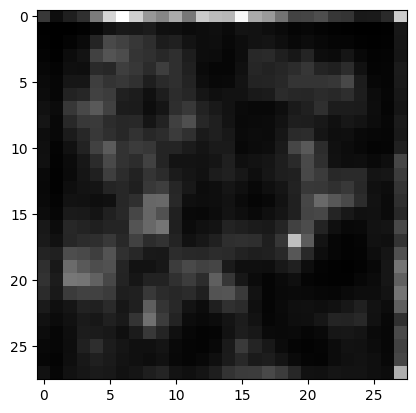

----------------------------------------


Discriminator Loss = 0.30422890186309814
Generator Loss = 2.048712730407715
A sample image generated by the generator


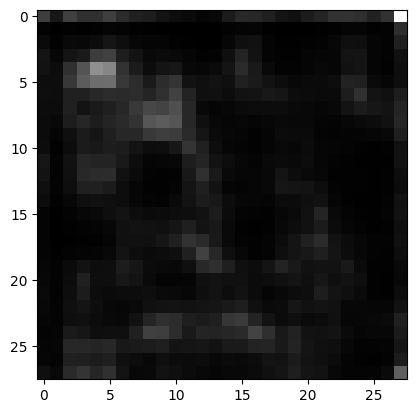

----------------------------------------


Discriminator Loss = 0.3208843469619751
Generator Loss = 2.1103131771087646
A sample image generated by the generator


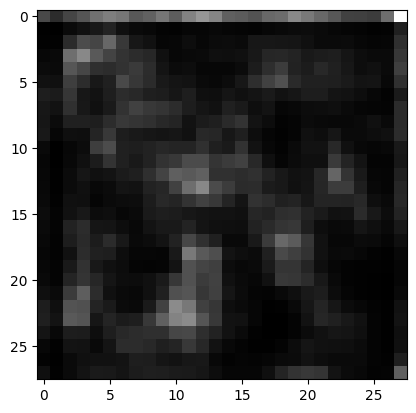

----------------------------------------


Discriminator Loss = 0.3112630844116211
Generator Loss = 1.981339454650879
A sample image generated by the generator


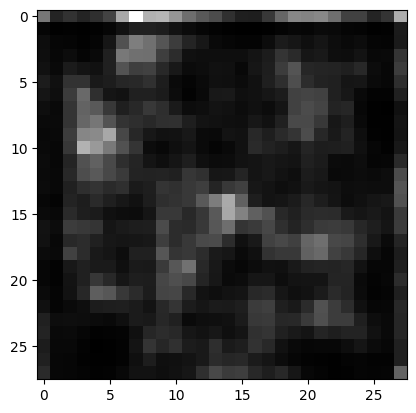

----------------------------------------


Discriminator Loss = 0.29603707790374756
Generator Loss = 2.055262804031372
A sample image generated by the generator


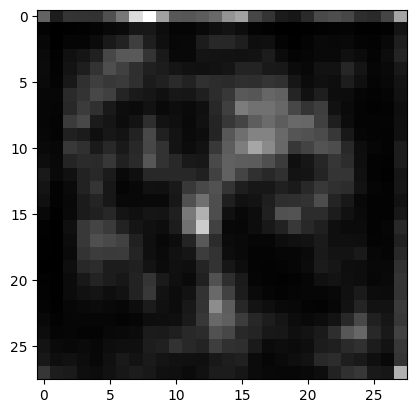

----------------------------------------


Discriminator Loss = 0.31410491466522217
Generator Loss = 2.024012327194214
A sample image generated by the generator


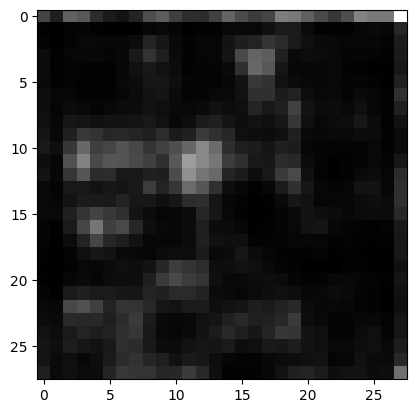

----------------------------------------


Discriminator Loss = 0.28880345821380615
Generator Loss = 2.118227005004883
A sample image generated by the generator


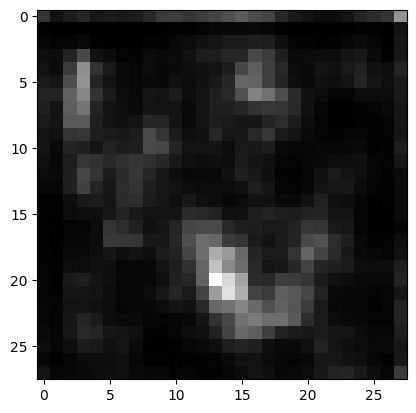

----------------------------------------


Discriminator Loss = 0.2716986835002899
Generator Loss = 2.075004816055298
A sample image generated by the generator


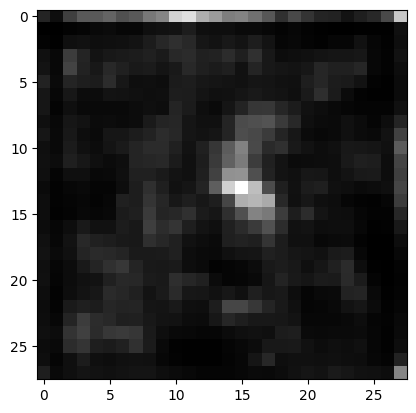

----------------------------------------


Discriminator Loss = 0.31873297691345215
Generator Loss = 2.1419754028320312
A sample image generated by the generator


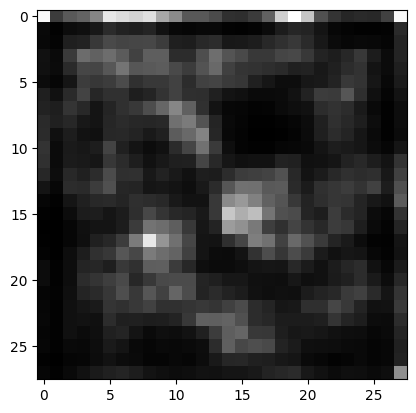

----------------------------------------


Discriminator Loss = 0.30235806107521057
Generator Loss = 2.0958492755889893
A sample image generated by the generator


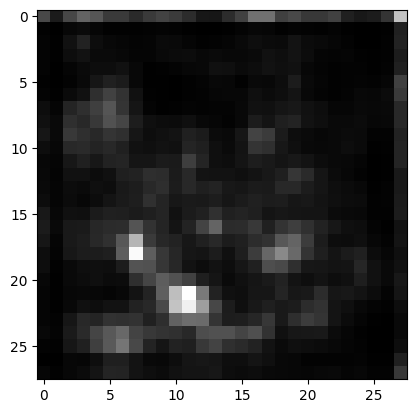

----------------------------------------


Discriminator Loss = 0.27714139223098755
Generator Loss = 2.0790998935699463
A sample image generated by the generator


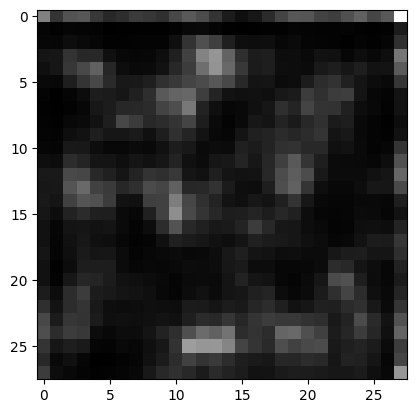

----------------------------------------


Discriminator Loss = 0.2875491976737976
Generator Loss = 2.0209295749664307
A sample image generated by the generator


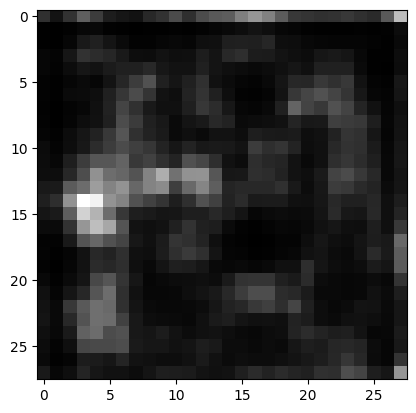

----------------------------------------


Discriminator Loss = 0.29999589920043945
Generator Loss = 2.100010871887207
A sample image generated by the generator


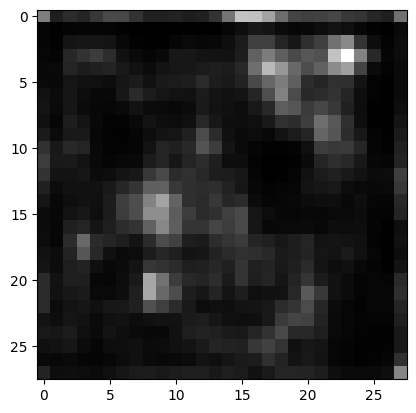

----------------------------------------


Discriminator Loss = 0.2830752730369568
Generator Loss = 2.0884556770324707
A sample image generated by the generator


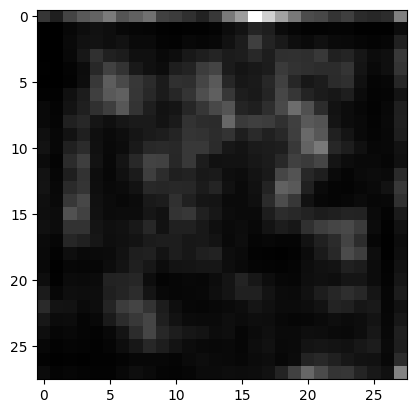

----------------------------------------


Discriminator Loss = 0.29303354024887085
Generator Loss = 2.19028902053833
A sample image generated by the generator


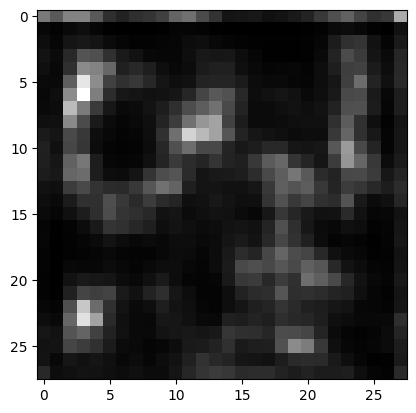

----------------------------------------


Discriminator Loss = 0.2855795919895172
Generator Loss = 2.0629467964172363
A sample image generated by the generator


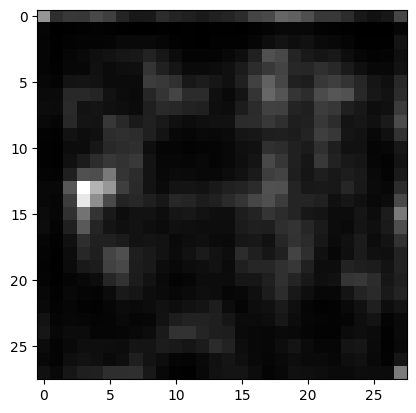

----------------------------------------


Discriminator Loss = 0.2958342730998993
Generator Loss = 2.0990662574768066
A sample image generated by the generator


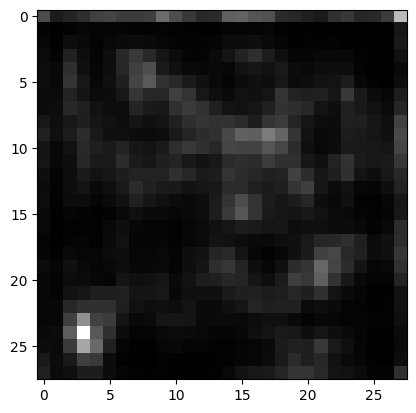

----------------------------------------


Discriminator Loss = 0.2808285355567932
Generator Loss = 2.1811342239379883
A sample image generated by the generator


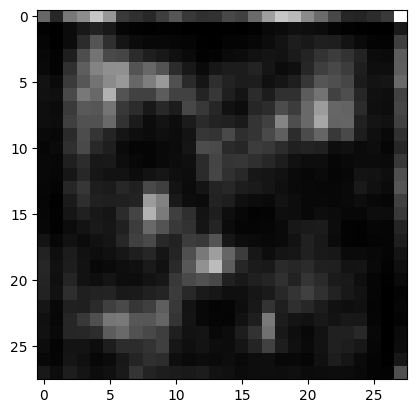

----------------------------------------


Discriminator Loss = 0.3045809268951416
Generator Loss = 2.0849690437316895
A sample image generated by the generator


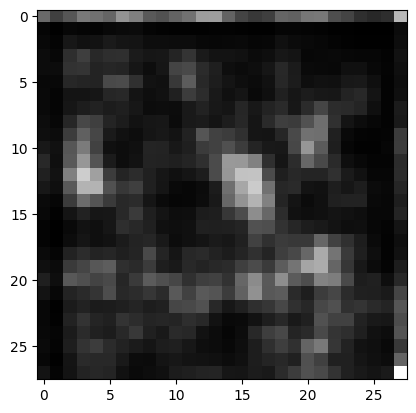

----------------------------------------


Discriminator Loss = 0.27423688769340515
Generator Loss = 2.024078845977783
A sample image generated by the generator


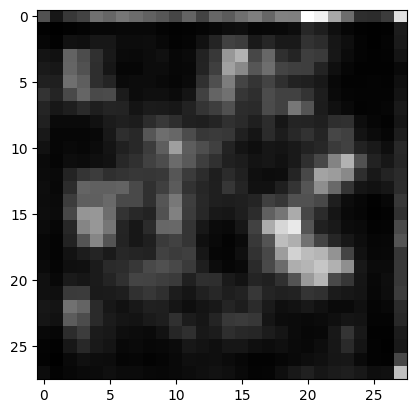

----------------------------------------


Discriminator Loss = 0.29312050342559814
Generator Loss = 2.1735901832580566
A sample image generated by the generator


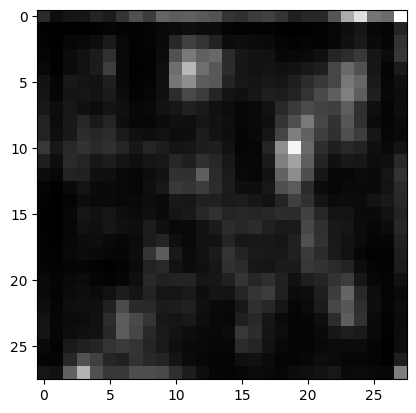

----------------------------------------


Discriminator Loss = 0.29362016916275024
Generator Loss = 2.060364246368408
A sample image generated by the generator


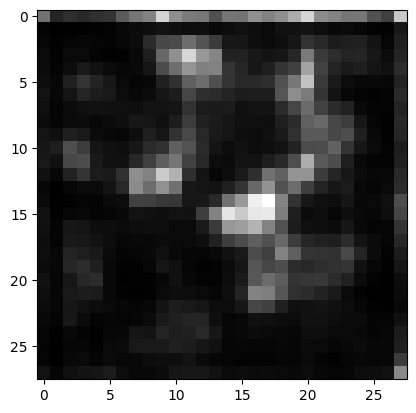

----------------------------------------


Discriminator Loss = 0.3156176209449768
Generator Loss = 2.161907196044922
A sample image generated by the generator


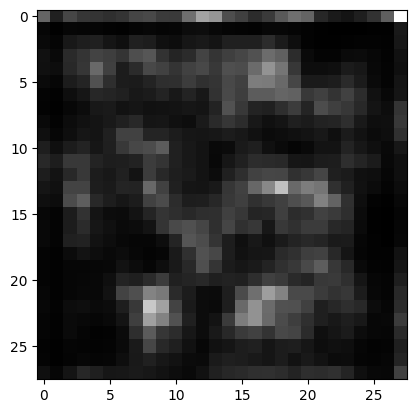

----------------------------------------


Discriminator Loss = 0.2845851182937622
Generator Loss = 2.103877067565918
A sample image generated by the generator


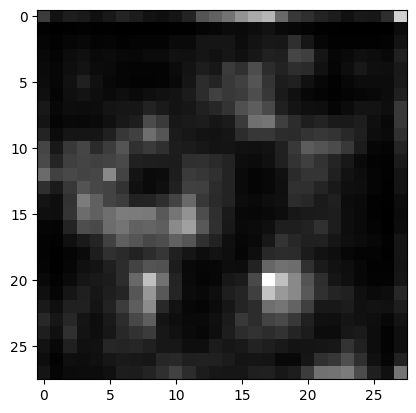

----------------------------------------


Discriminator Loss = 0.2901361584663391
Generator Loss = 2.2603330612182617
A sample image generated by the generator


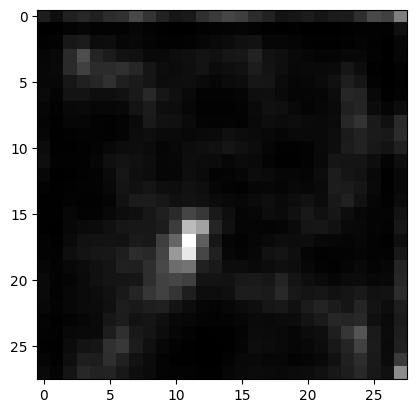

----------------------------------------


Discriminator Loss = 0.3041446805000305
Generator Loss = 2.118455410003662
A sample image generated by the generator


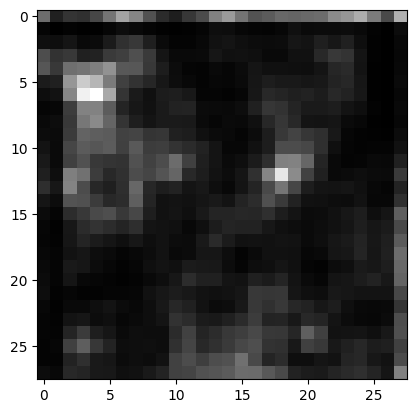

----------------------------------------


Discriminator Loss = 0.2853662073612213
Generator Loss = 2.0535686016082764
A sample image generated by the generator


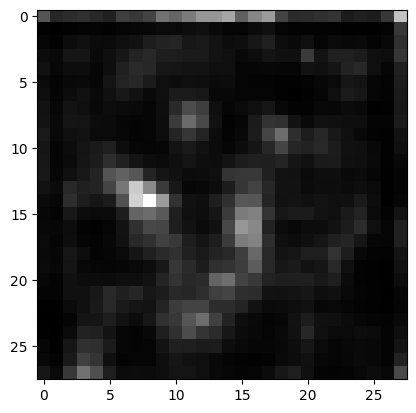

----------------------------------------


Discriminator Loss = 0.2920113205909729
Generator Loss = 2.116594076156616
A sample image generated by the generator


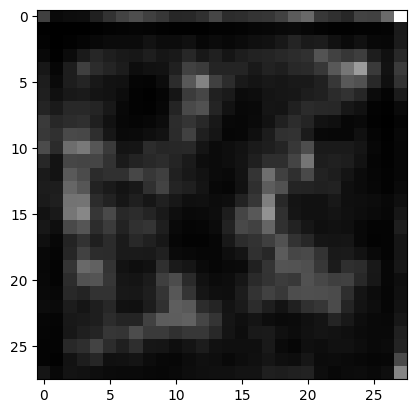

----------------------------------------


Discriminator Loss = 0.2839270234107971
Generator Loss = 2.0764999389648438
A sample image generated by the generator


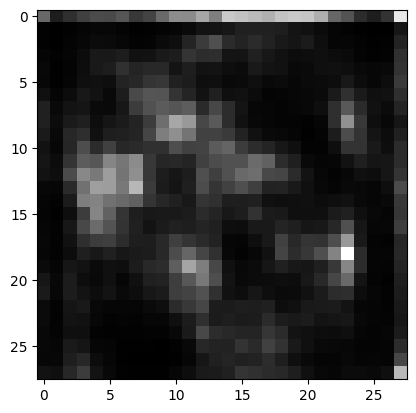

----------------------------------------


Discriminator Loss = 0.2957049608230591
Generator Loss = 2.244818687438965
A sample image generated by the generator


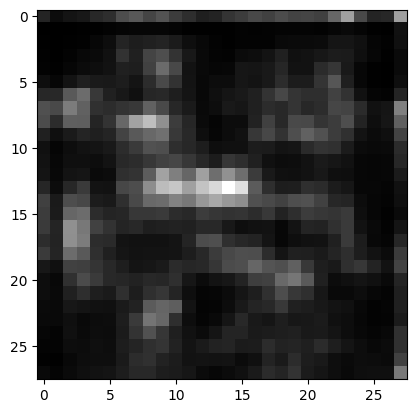

----------------------------------------


Discriminator Loss = 0.279573917388916
Generator Loss = 2.0887203216552734
A sample image generated by the generator


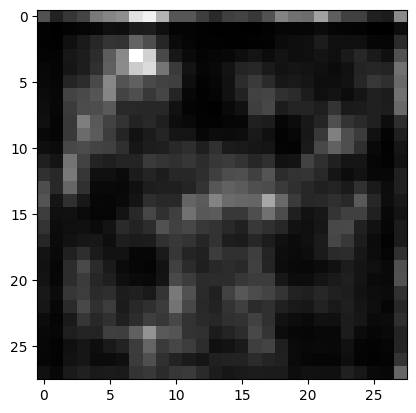

----------------------------------------


Discriminator Loss = 0.29464441537857056
Generator Loss = 2.1237502098083496
A sample image generated by the generator


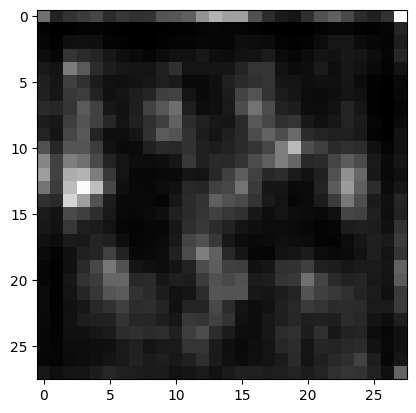

----------------------------------------


Discriminator Loss = 0.2853891849517822
Generator Loss = 2.044283151626587
A sample image generated by the generator


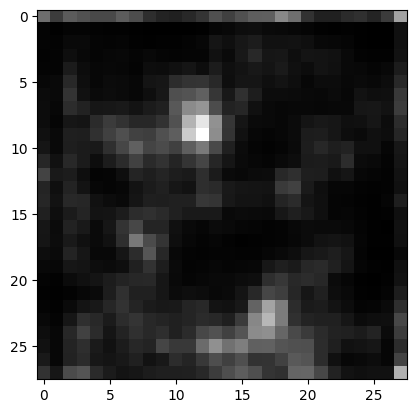

----------------------------------------


Discriminator Loss = 0.28162476420402527
Generator Loss = 2.1329798698425293
A sample image generated by the generator


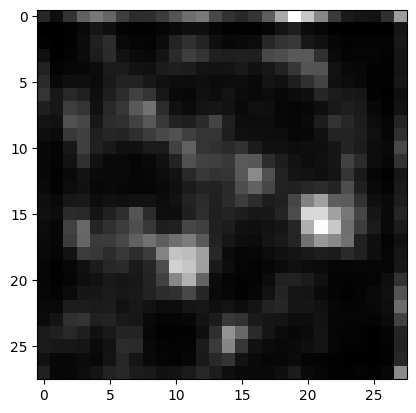

----------------------------------------


Discriminator Loss = 0.29230064153671265
Generator Loss = 2.0610337257385254
A sample image generated by the generator


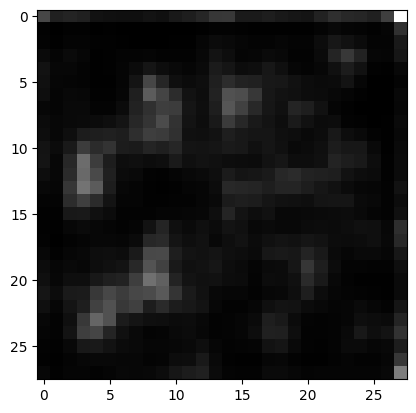

----------------------------------------


Discriminator Loss = 0.2938515245914459
Generator Loss = 2.1981842517852783
A sample image generated by the generator


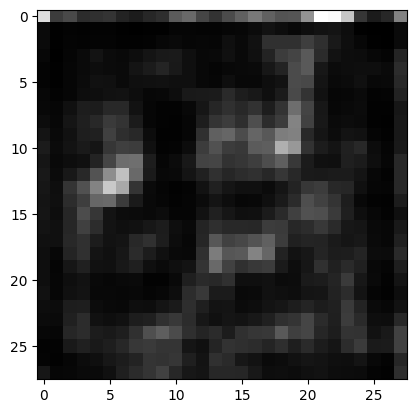

----------------------------------------


Discriminator Loss = 0.30052614212036133
Generator Loss = 2.1374611854553223
A sample image generated by the generator


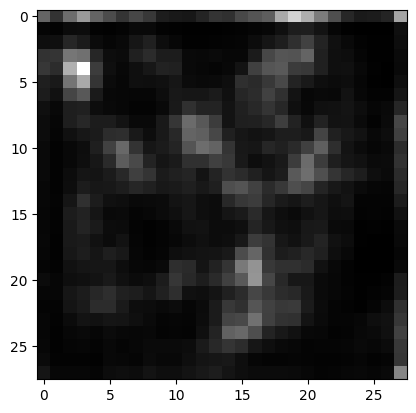

----------------------------------------


Discriminator Loss = 0.27087944746017456
Generator Loss = 2.197469711303711
A sample image generated by the generator


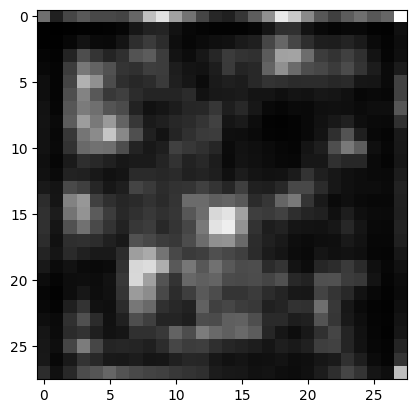

----------------------------------------


Discriminator Loss = 0.2891521453857422
Generator Loss = 2.131817579269409
A sample image generated by the generator


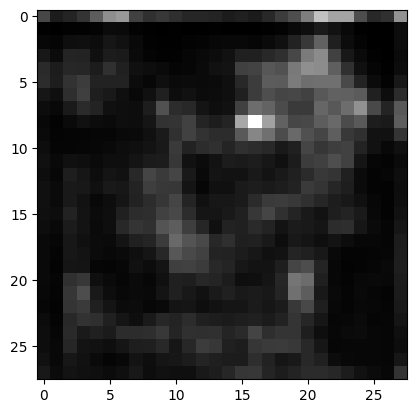

----------------------------------------


Discriminator Loss = 0.2942439913749695
Generator Loss = 2.126936197280884
A sample image generated by the generator


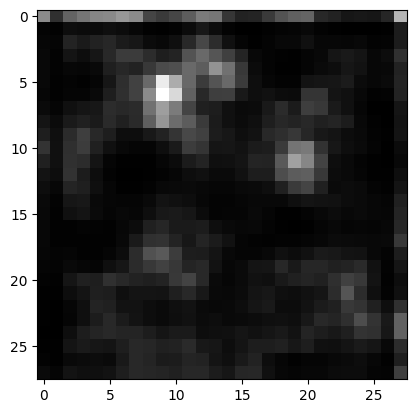

----------------------------------------


Discriminator Loss = 0.28363972902297974
Generator Loss = 2.1562743186950684
A sample image generated by the generator


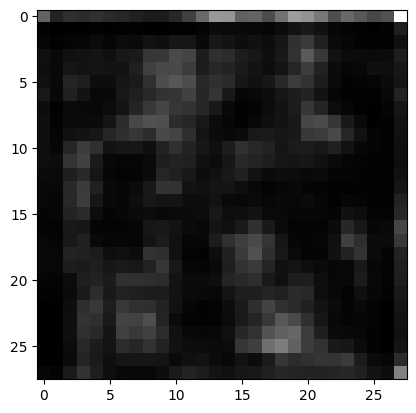

----------------------------------------


Discriminator Loss = 0.28799381852149963
Generator Loss = 2.1502737998962402
A sample image generated by the generator


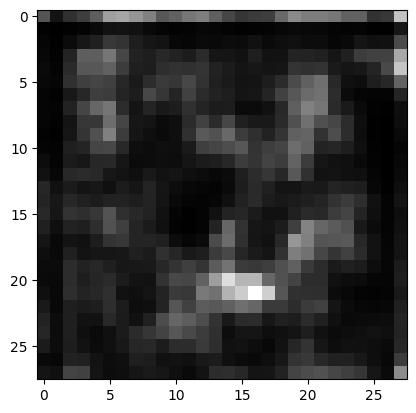

----------------------------------------


Discriminator Loss = 0.2784448266029358
Generator Loss = 2.1252856254577637
A sample image generated by the generator


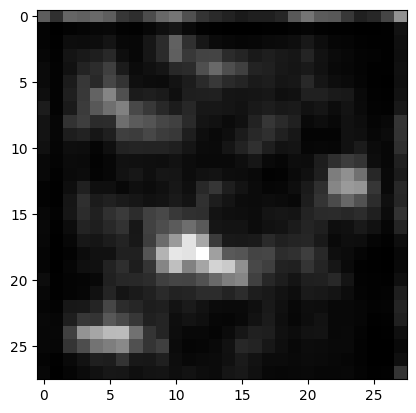

----------------------------------------


Discriminator Loss = 0.2882877588272095
Generator Loss = 2.192075252532959
A sample image generated by the generator


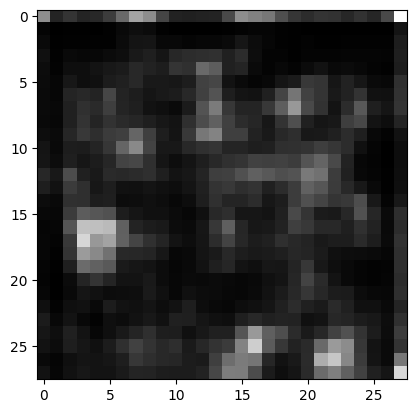

----------------------------------------


Discriminator Loss = 0.2892575263977051
Generator Loss = 2.0934062004089355
A sample image generated by the generator


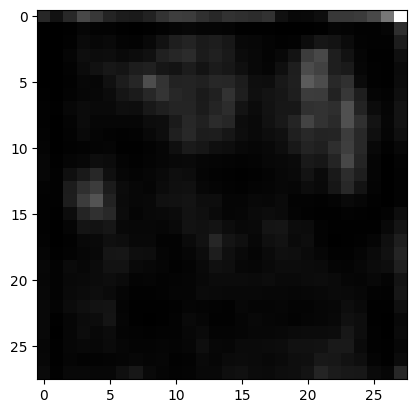

----------------------------------------


Discriminator Loss = 0.2803584337234497
Generator Loss = 2.103327989578247
A sample image generated by the generator


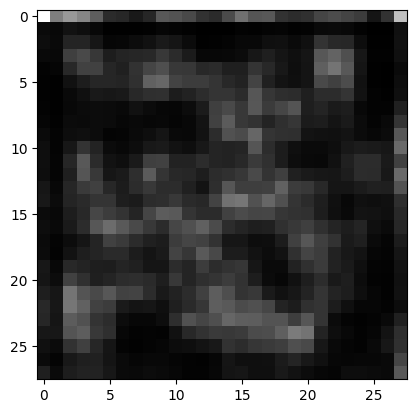

----------------------------------------


Discriminator Loss = 0.27791526913642883
Generator Loss = 2.1167123317718506
A sample image generated by the generator


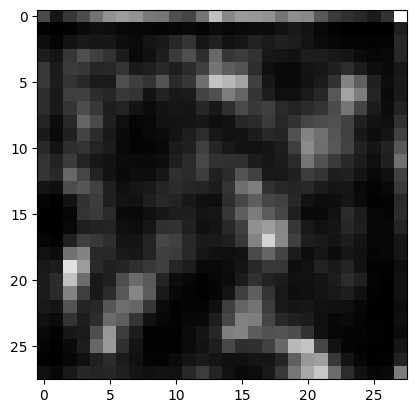

----------------------------------------


Discriminator Loss = 0.28843891620635986
Generator Loss = 2.1495752334594727
A sample image generated by the generator


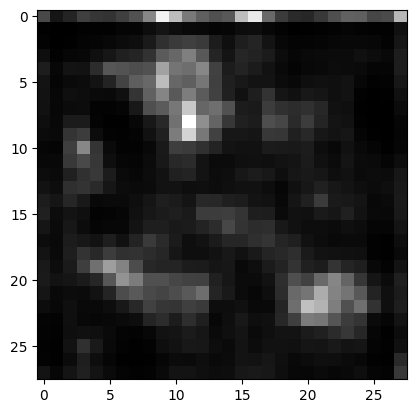

----------------------------------------


Discriminator Loss = 0.27419495582580566
Generator Loss = 2.2386112213134766
A sample image generated by the generator


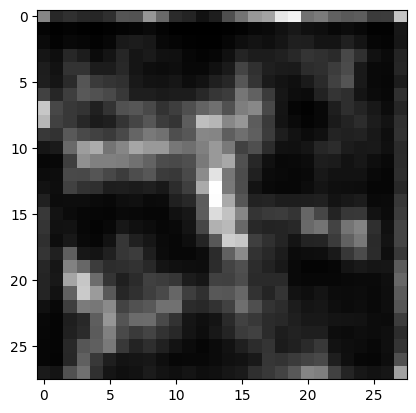

----------------------------------------


Discriminator Loss = 0.3035007119178772
Generator Loss = 2.103501558303833
A sample image generated by the generator


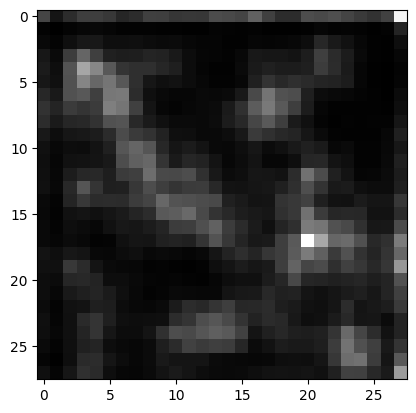

----------------------------------------


Discriminator Loss = 0.26520106196403503
Generator Loss = 2.2123591899871826
A sample image generated by the generator


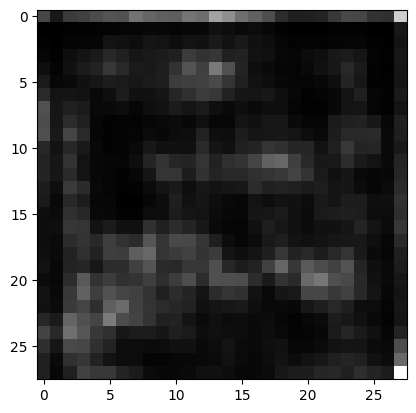

----------------------------------------


Discriminator Loss = 0.2958166301250458
Generator Loss = 2.1065449714660645
A sample image generated by the generator


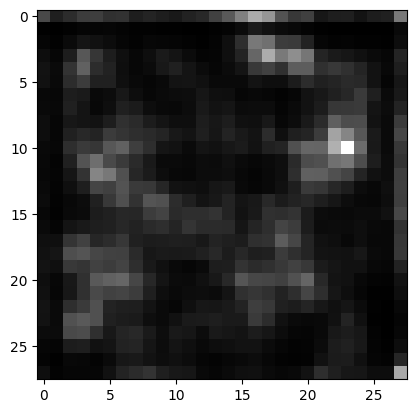

----------------------------------------


Discriminator Loss = 0.2846519947052002
Generator Loss = 2.1625161170959473
A sample image generated by the generator


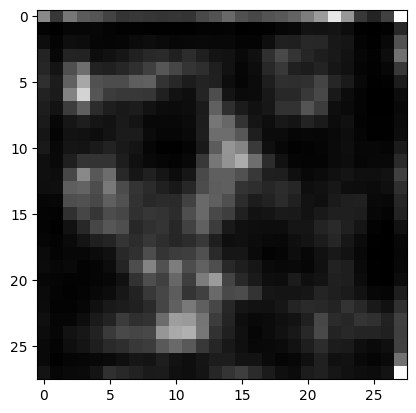

----------------------------------------


Discriminator Loss = 0.27664798498153687
Generator Loss = 2.1111059188842773
A sample image generated by the generator


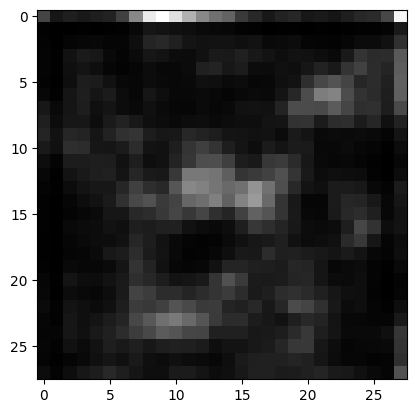

----------------------------------------


Discriminator Loss = 0.28116893768310547
Generator Loss = 2.145714282989502
A sample image generated by the generator


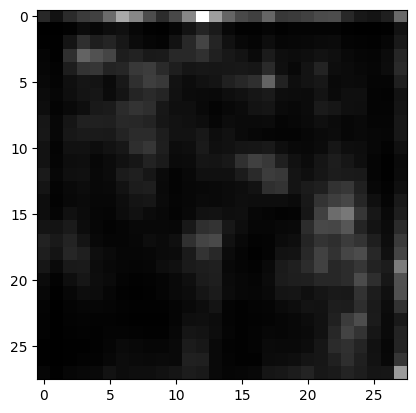

----------------------------------------


Discriminator Loss = 0.2761760354042053
Generator Loss = 2.201059341430664
A sample image generated by the generator


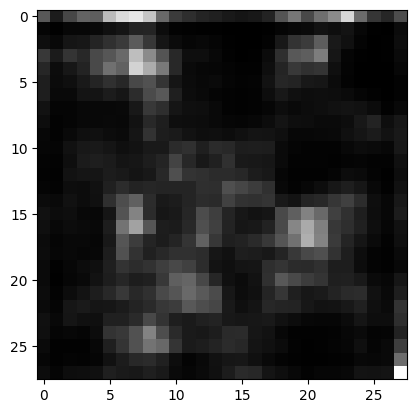

----------------------------------------


Discriminator Loss = 0.2782300114631653
Generator Loss = 2.1884477138519287
A sample image generated by the generator


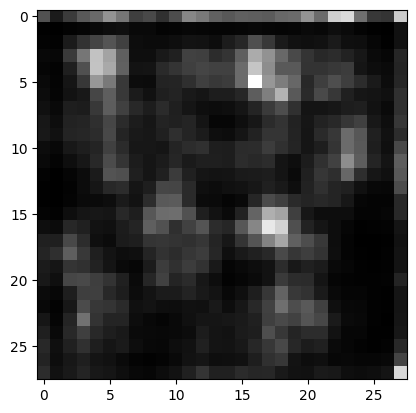

----------------------------------------


Discriminator Loss = 0.2692272961139679
Generator Loss = 2.1449837684631348
A sample image generated by the generator


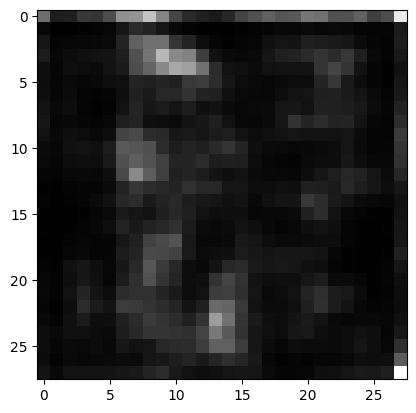

----------------------------------------


Discriminator Loss = 0.26940640807151794
Generator Loss = 2.1647701263427734
A sample image generated by the generator


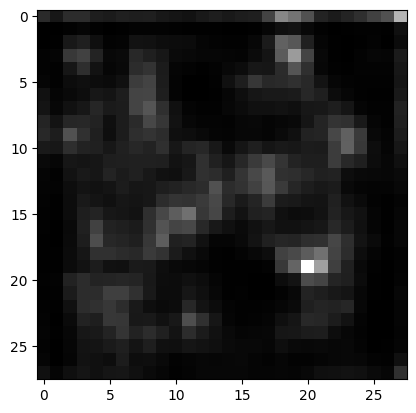

----------------------------------------


Discriminator Loss = 0.28176265954971313
Generator Loss = 2.18554949760437
A sample image generated by the generator


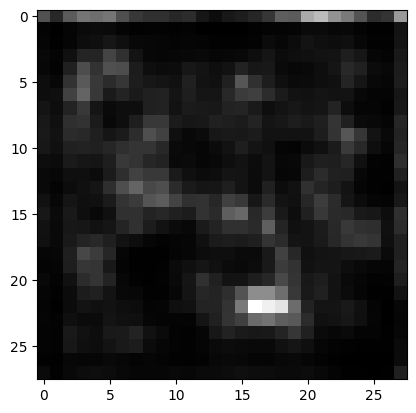

----------------------------------------


Discriminator Loss = 0.28089529275894165
Generator Loss = 2.166259765625
A sample image generated by the generator


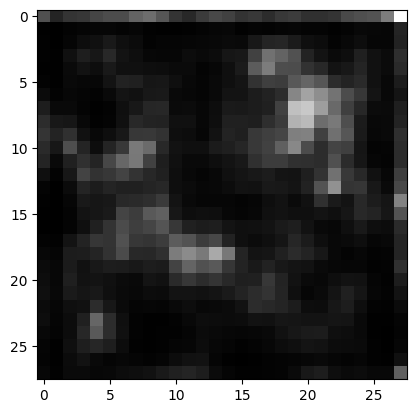

----------------------------------------


Discriminator Loss = 0.2652602791786194
Generator Loss = 2.058899402618408
A sample image generated by the generator


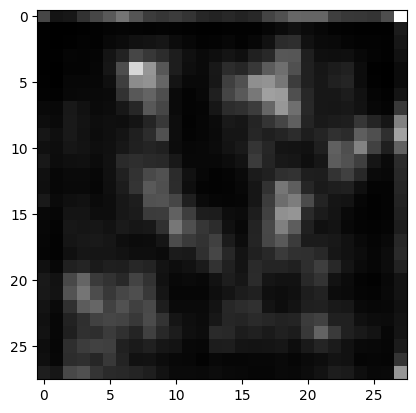

----------------------------------------


Discriminator Loss = 0.2728545069694519
Generator Loss = 2.174636125564575
A sample image generated by the generator


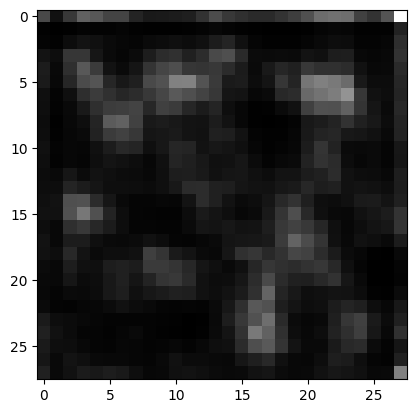

----------------------------------------


Discriminator Loss = 0.2696736454963684
Generator Loss = 2.1074962615966797
A sample image generated by the generator


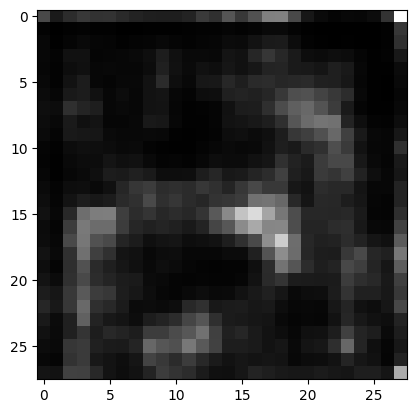

----------------------------------------


Discriminator Loss = 0.28820592164993286
Generator Loss = 2.146746873855591
A sample image generated by the generator


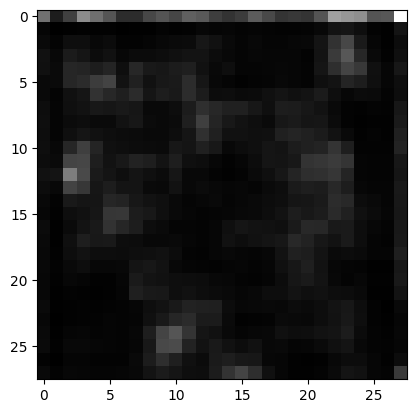

----------------------------------------


Discriminator Loss = 0.27587205171585083
Generator Loss = 2.2317590713500977
A sample image generated by the generator


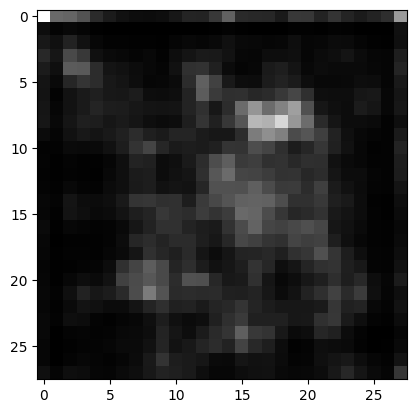

----------------------------------------


Discriminator Loss = 0.2679704427719116
Generator Loss = 2.19522762298584
A sample image generated by the generator


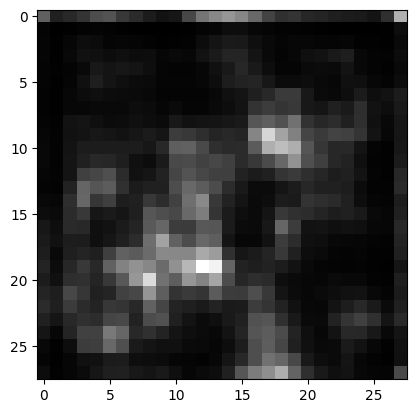

----------------------------------------


Discriminator Loss = 0.28133130073547363
Generator Loss = 2.1648447513580322
A sample image generated by the generator


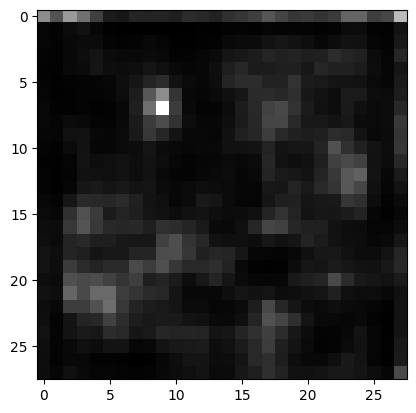

----------------------------------------


Discriminator Loss = 0.27747106552124023
Generator Loss = 2.291975498199463
A sample image generated by the generator


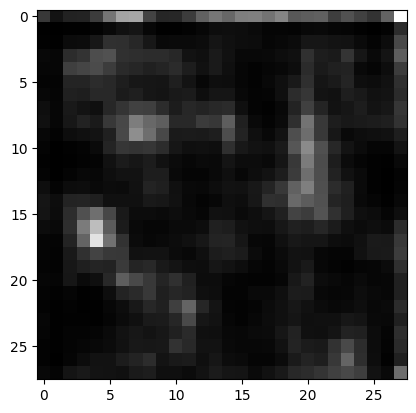

----------------------------------------


Discriminator Loss = 0.2687014937400818
Generator Loss = 2.35433030128479
A sample image generated by the generator


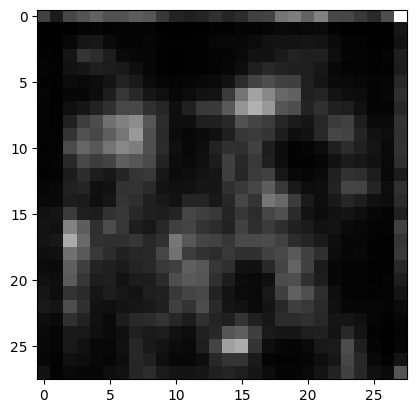

----------------------------------------


Discriminator Loss = 0.2666395604610443
Generator Loss = 2.1997528076171875
A sample image generated by the generator


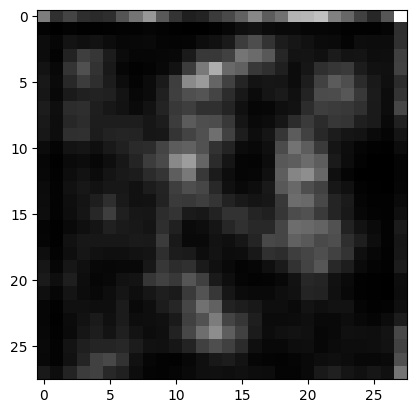

----------------------------------------


Discriminator Loss = 0.27649709582328796
Generator Loss = 2.2912001609802246
A sample image generated by the generator


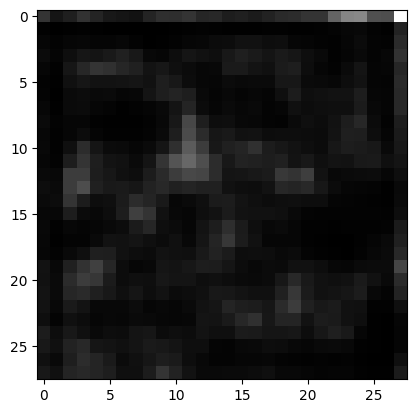

----------------------------------------


Discriminator Loss = 0.2590942084789276
Generator Loss = 2.175048589706421
A sample image generated by the generator


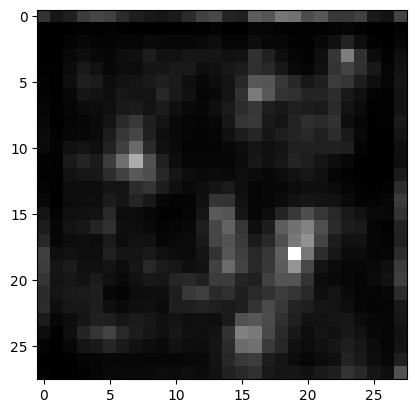

----------------------------------------


Discriminator Loss = 0.2768884599208832
Generator Loss = 2.195026159286499
A sample image generated by the generator


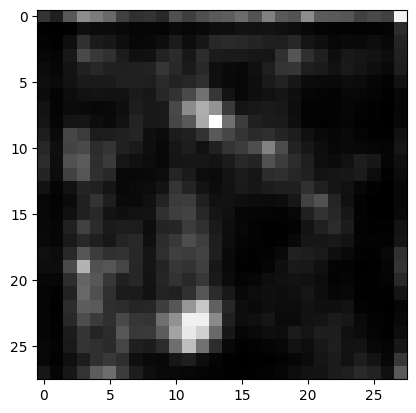

----------------------------------------


Discriminator Loss = 0.2550830841064453
Generator Loss = 2.2378294467926025
A sample image generated by the generator


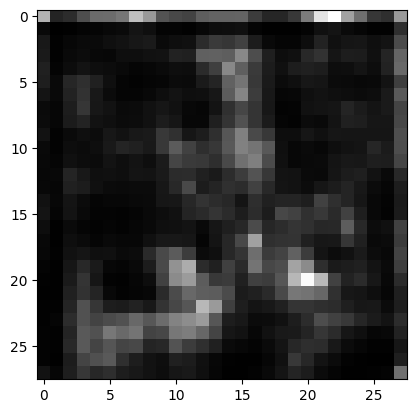

----------------------------------------


Discriminator Loss = 0.2677609324455261
Generator Loss = 2.1216835975646973
A sample image generated by the generator


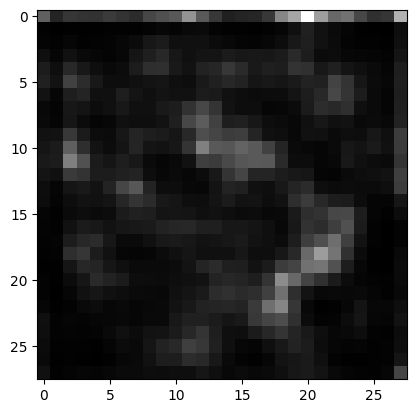

----------------------------------------


Discriminator Loss = 0.256249338388443
Generator Loss = 2.1244702339172363
A sample image generated by the generator


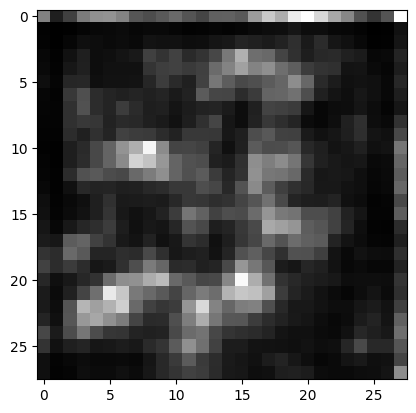

----------------------------------------


Discriminator Loss = 0.2707585096359253
Generator Loss = 2.23349666595459
A sample image generated by the generator


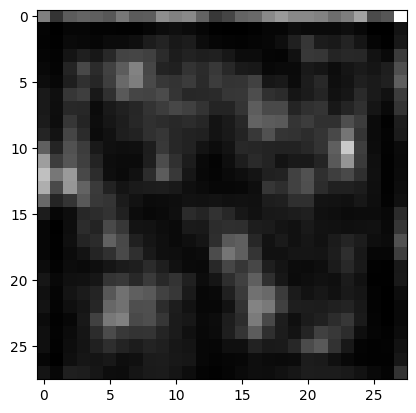

----------------------------------------


Discriminator Loss = 0.2626517415046692
Generator Loss = 2.348580837249756
A sample image generated by the generator


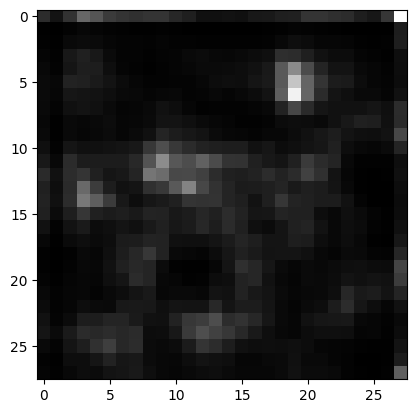

----------------------------------------


Discriminator Loss = 0.26772964000701904
Generator Loss = 2.154432773590088
A sample image generated by the generator


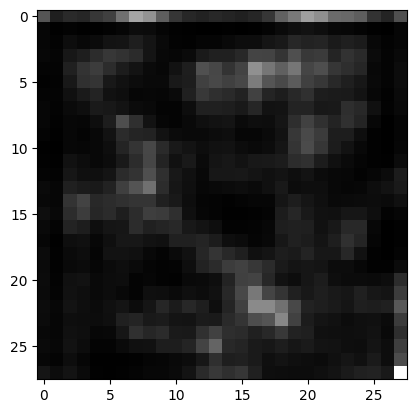

----------------------------------------


Discriminator Loss = 0.2739117741584778
Generator Loss = 2.2174558639526367
A sample image generated by the generator


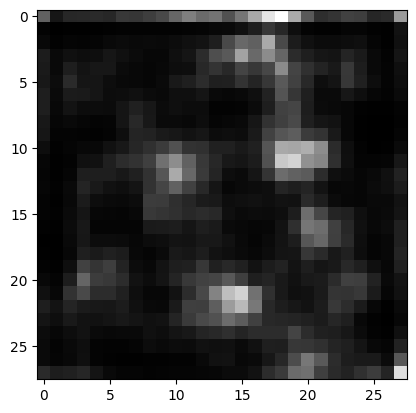

----------------------------------------


Discriminator Loss = 0.26936277747154236
Generator Loss = 2.227555751800537
A sample image generated by the generator


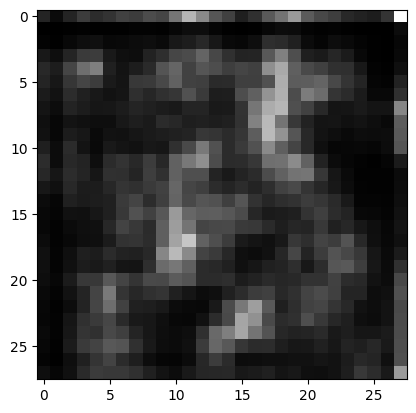

----------------------------------------


Discriminator Loss = 0.2532798647880554
Generator Loss = 2.209742546081543
A sample image generated by the generator


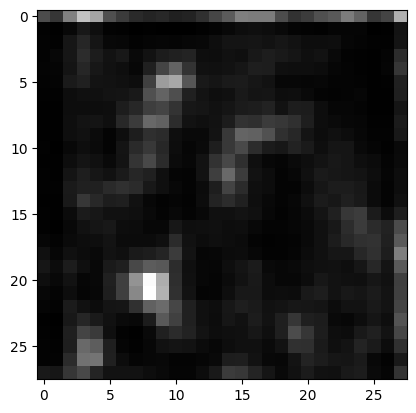

----------------------------------------


Discriminator Loss = 0.2673640251159668
Generator Loss = 2.1669628620147705
A sample image generated by the generator


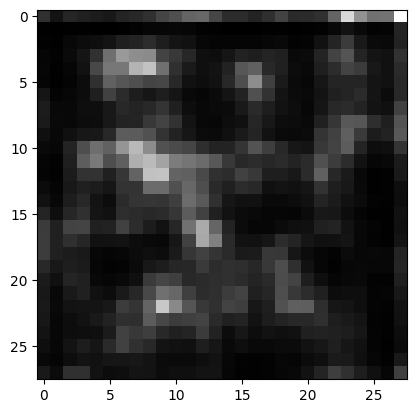

----------------------------------------


Discriminator Loss = 0.2791176438331604
Generator Loss = 2.1692776679992676
A sample image generated by the generator


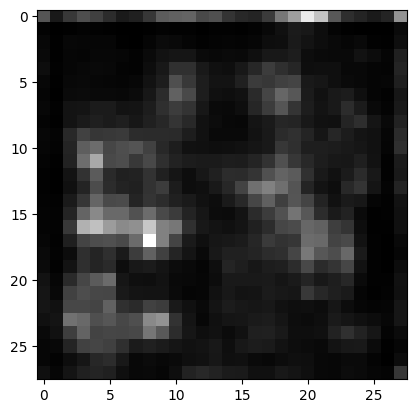

----------------------------------------


Discriminator Loss = 0.2715667486190796
Generator Loss = 2.07997989654541
A sample image generated by the generator


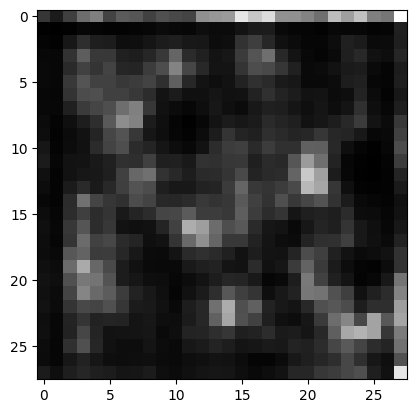

----------------------------------------


Discriminator Loss = 0.2520928680896759
Generator Loss = 2.064140558242798
A sample image generated by the generator


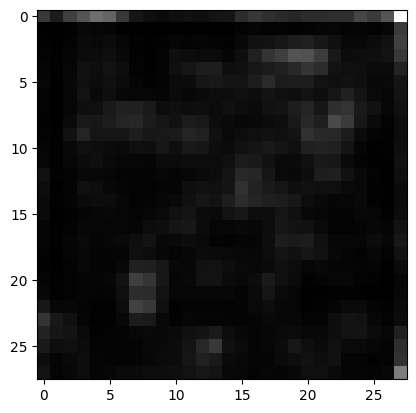

----------------------------------------


Discriminator Loss = 0.27136898040771484
Generator Loss = 2.191403865814209
A sample image generated by the generator


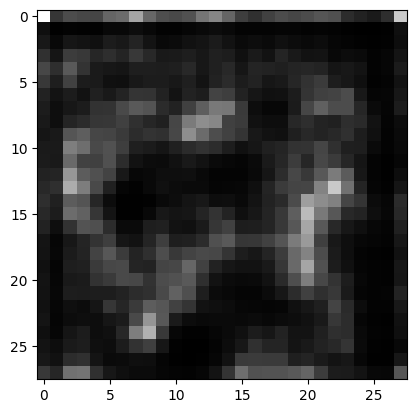

----------------------------------------


Discriminator Loss = 0.2644939422607422
Generator Loss = 2.2352616786956787
A sample image generated by the generator


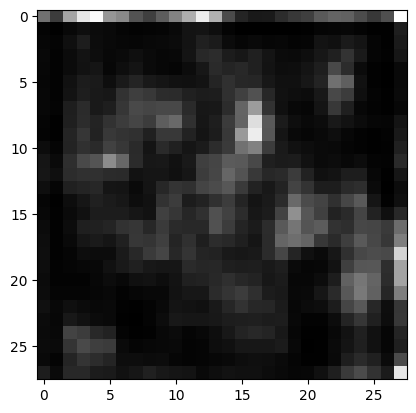

----------------------------------------


Discriminator Loss = 0.25775477290153503
Generator Loss = 2.313469409942627
A sample image generated by the generator


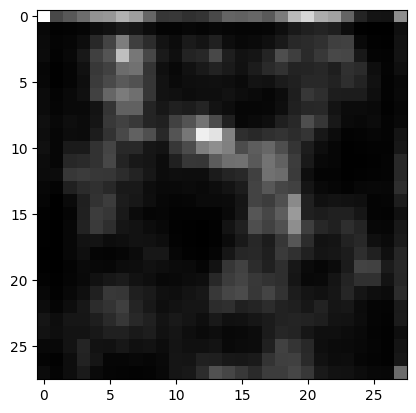

----------------------------------------


Discriminator Loss = 0.26190999150276184
Generator Loss = 2.278731346130371
A sample image generated by the generator


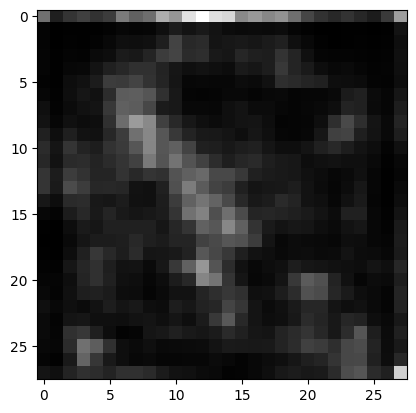

----------------------------------------


Discriminator Loss = 0.2557255029678345
Generator Loss = 2.1761739253997803
A sample image generated by the generator


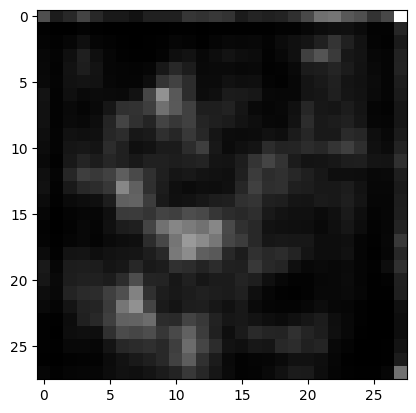

----------------------------------------


Discriminator Loss = 0.2546413242816925
Generator Loss = 2.243656873703003
A sample image generated by the generator


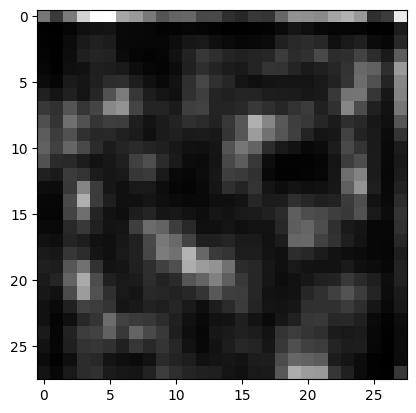

----------------------------------------


Discriminator Loss = 0.26030418276786804
Generator Loss = 2.2971596717834473
A sample image generated by the generator


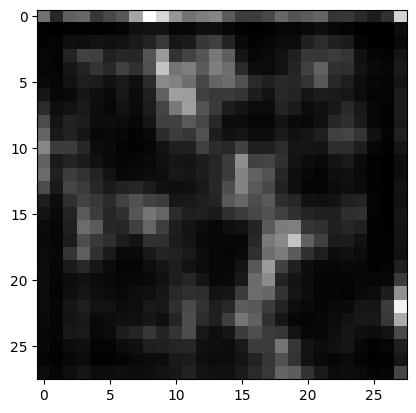

----------------------------------------


Discriminator Loss = 0.2531721591949463
Generator Loss = 2.210319995880127
A sample image generated by the generator


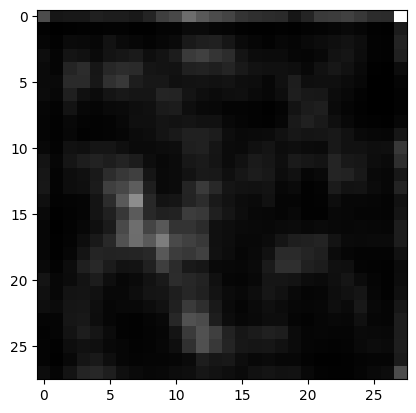

----------------------------------------


Discriminator Loss = 0.2563325762748718
Generator Loss = 2.265285015106201
A sample image generated by the generator


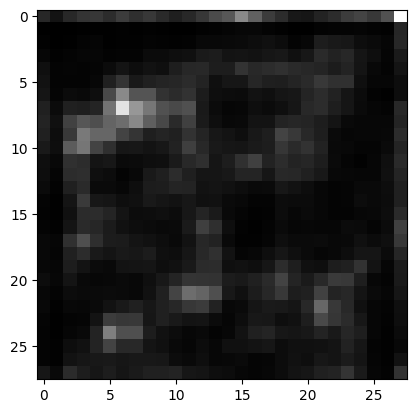

----------------------------------------


Discriminator Loss = 0.2554219961166382
Generator Loss = 2.2692313194274902
A sample image generated by the generator


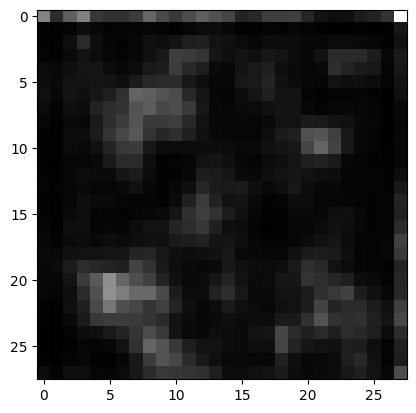

----------------------------------------


Discriminator Loss = 0.2560911476612091
Generator Loss = 2.1963324546813965
A sample image generated by the generator


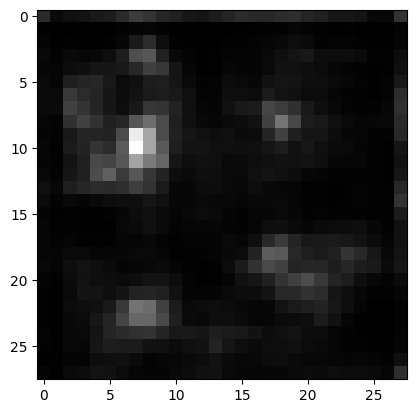

----------------------------------------


Discriminator Loss = 0.2677296996116638
Generator Loss = 2.23519229888916
A sample image generated by the generator


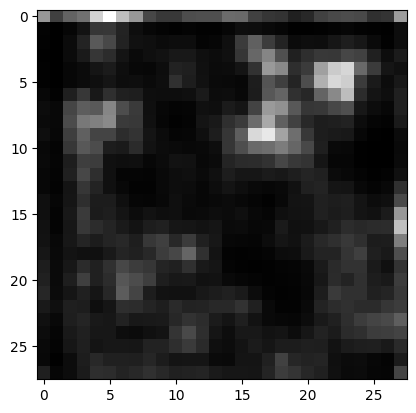

----------------------------------------


Discriminator Loss = 0.2452675849199295
Generator Loss = 2.2576160430908203
A sample image generated by the generator


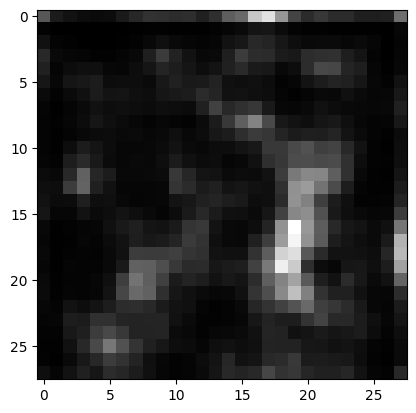

----------------------------------------


Discriminator Loss = 0.2448243498802185
Generator Loss = 2.2189652919769287
A sample image generated by the generator


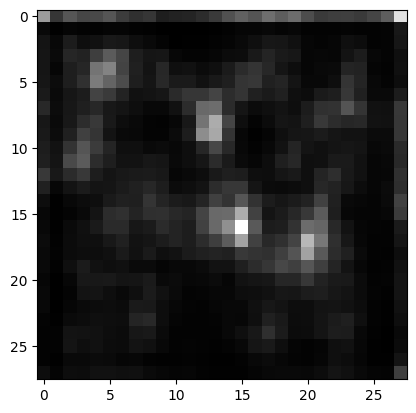

----------------------------------------


Discriminator Loss = 0.24711482226848602
Generator Loss = 2.315842866897583
A sample image generated by the generator


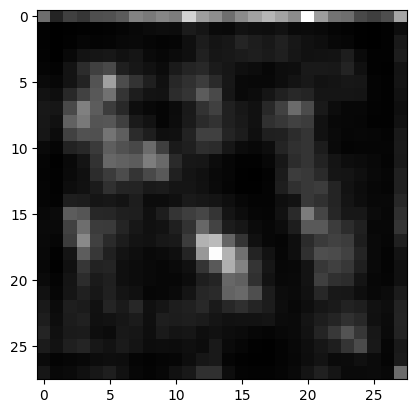

----------------------------------------


Discriminator Loss = 0.2512460947036743
Generator Loss = 2.202549457550049
A sample image generated by the generator


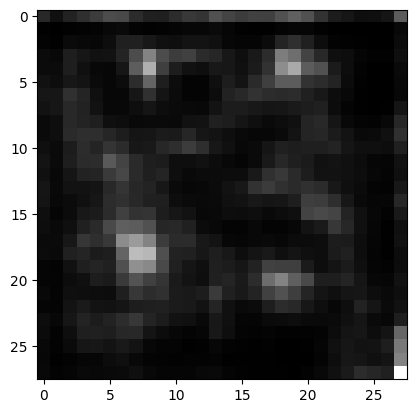

----------------------------------------


Discriminator Loss = 0.24332952499389648
Generator Loss = 2.2045273780822754
A sample image generated by the generator


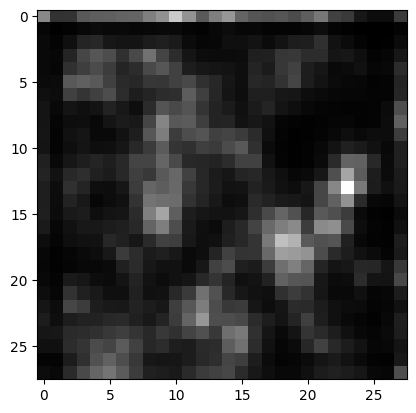

----------------------------------------


Discriminator Loss = 0.2473796010017395
Generator Loss = 2.1842870712280273
A sample image generated by the generator


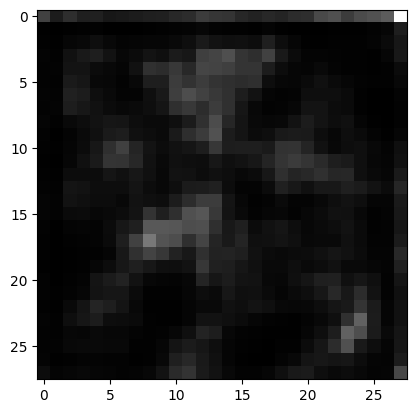

----------------------------------------


Discriminator Loss = 0.2707192897796631
Generator Loss = 2.2667462825775146
A sample image generated by the generator


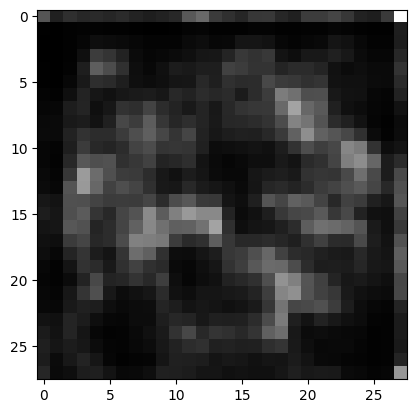

----------------------------------------


Discriminator Loss = 0.2699074447154999
Generator Loss = 2.219816207885742
A sample image generated by the generator


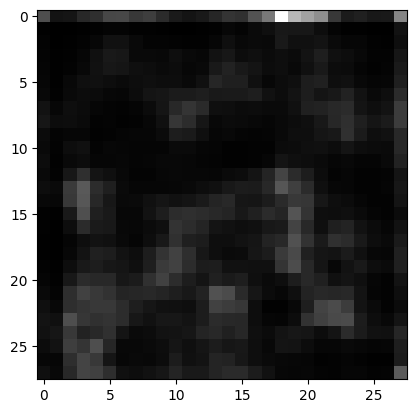

----------------------------------------


Discriminator Loss = 0.2557782530784607
Generator Loss = 2.3213131427764893
A sample image generated by the generator


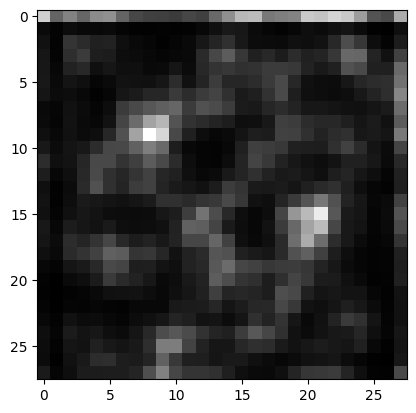

----------------------------------------


Discriminator Loss = 0.266901433467865
Generator Loss = 2.282198905944824
A sample image generated by the generator


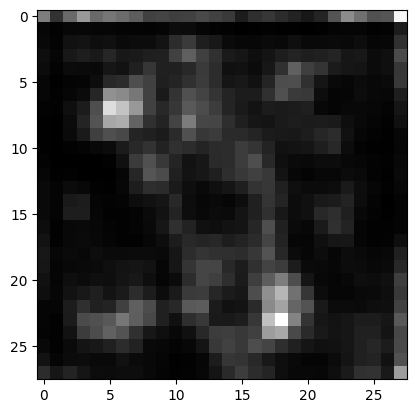

----------------------------------------


Discriminator Loss = 0.25496792793273926
Generator Loss = 2.303832530975342
A sample image generated by the generator


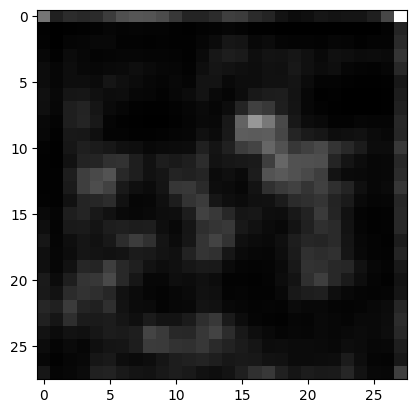

----------------------------------------


Discriminator Loss = 0.24820385873317719
Generator Loss = 2.2324633598327637
A sample image generated by the generator


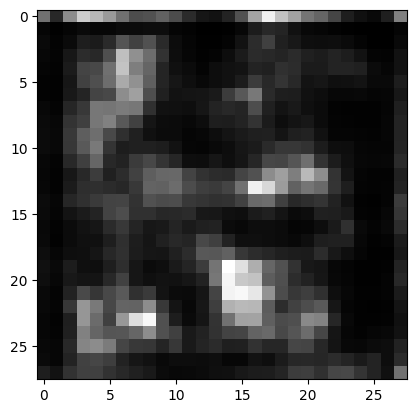

----------------------------------------


Discriminator Loss = 0.26361218094825745
Generator Loss = 2.2555484771728516
A sample image generated by the generator


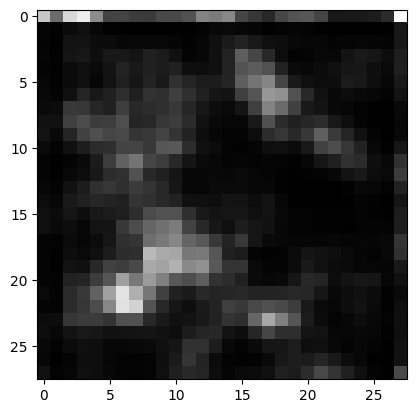

----------------------------------------


Discriminator Loss = 0.2515590190887451
Generator Loss = 2.1576497554779053
A sample image generated by the generator


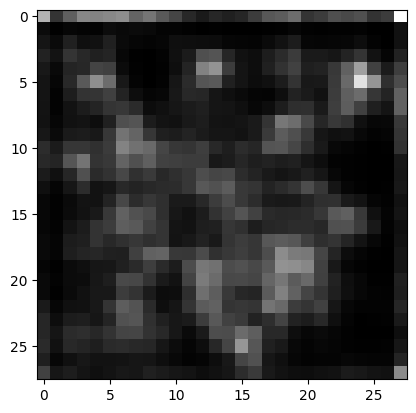

----------------------------------------


Discriminator Loss = 0.2377057522535324
Generator Loss = 2.191530466079712
A sample image generated by the generator


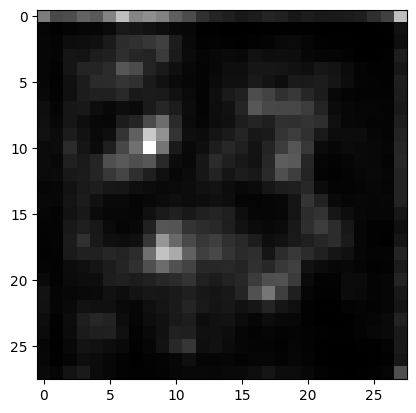

----------------------------------------


Discriminator Loss = 0.24407844245433807
Generator Loss = 2.241901397705078
A sample image generated by the generator


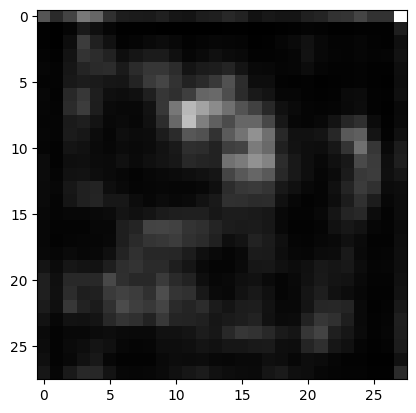

----------------------------------------


Discriminator Loss = 0.2650834023952484
Generator Loss = 2.3509252071380615
A sample image generated by the generator


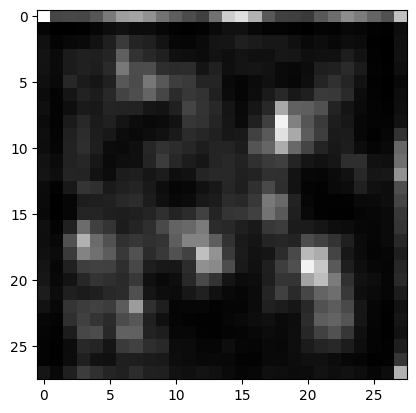

----------------------------------------


Discriminator Loss = 0.25304317474365234
Generator Loss = 2.279229164123535
A sample image generated by the generator


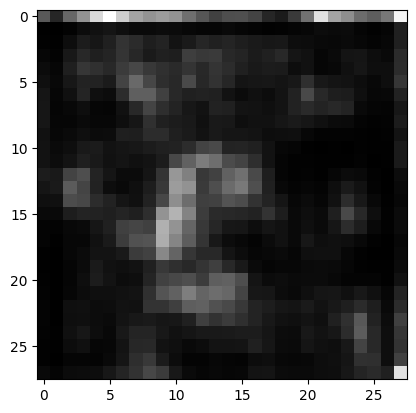

----------------------------------------


Discriminator Loss = 0.24619071185588837
Generator Loss = 2.196530342102051
A sample image generated by the generator


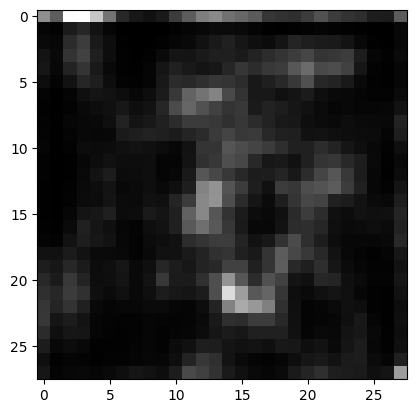

----------------------------------------


Discriminator Loss = 0.2361949384212494
Generator Loss = 2.3292667865753174
A sample image generated by the generator


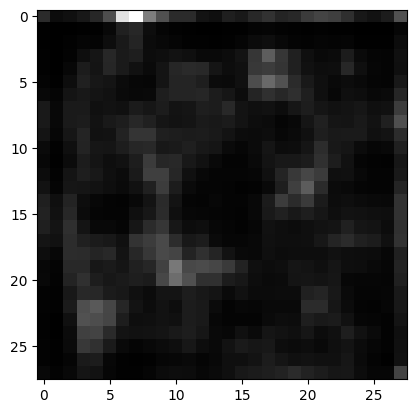

----------------------------------------


Discriminator Loss = 0.26442086696624756
Generator Loss = 2.324955940246582
A sample image generated by the generator


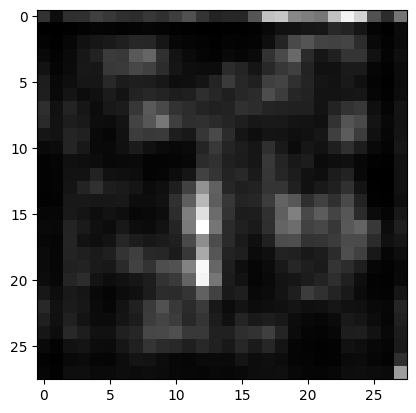

----------------------------------------


Discriminator Loss = 0.27107033133506775
Generator Loss = 2.3013010025024414
A sample image generated by the generator


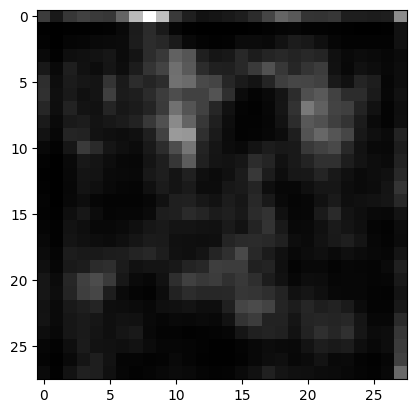

----------------------------------------


Discriminator Loss = 0.24431249499320984
Generator Loss = 2.2842726707458496
A sample image generated by the generator


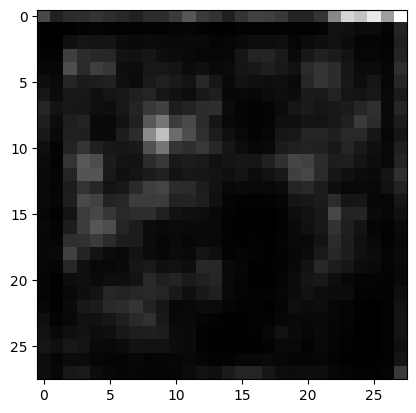

----------------------------------------


Discriminator Loss = 0.257189005613327
Generator Loss = 2.174523115158081
A sample image generated by the generator


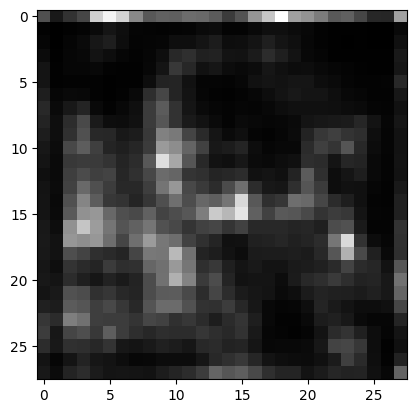

----------------------------------------


Discriminator Loss = 0.2585405707359314
Generator Loss = 2.3229990005493164
A sample image generated by the generator


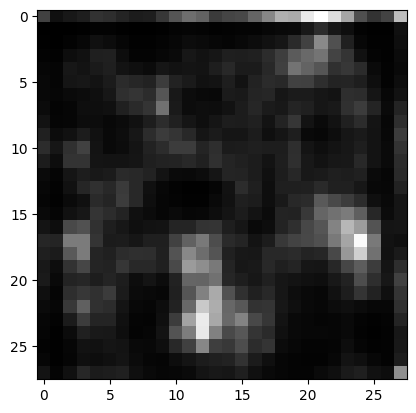

----------------------------------------


Discriminator Loss = 0.24486882984638214
Generator Loss = 2.294045925140381
A sample image generated by the generator


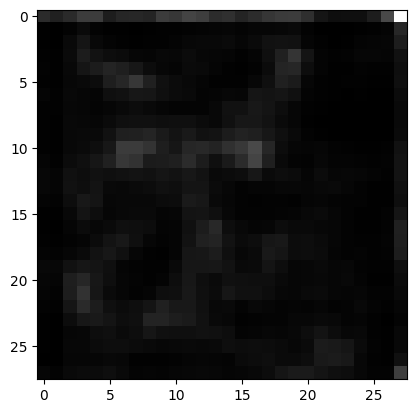

----------------------------------------


Discriminator Loss = 0.2295704185962677
Generator Loss = 2.282212495803833
A sample image generated by the generator


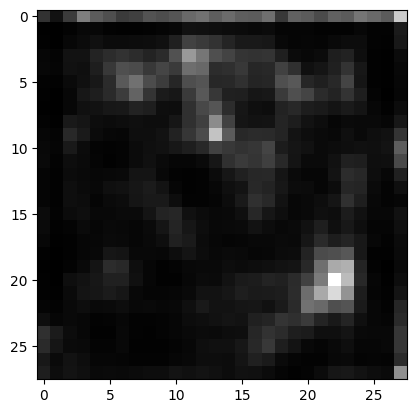

----------------------------------------


Discriminator Loss = 0.24278408288955688
Generator Loss = 2.2596471309661865
A sample image generated by the generator


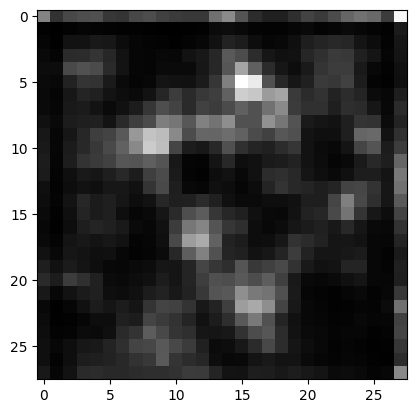

----------------------------------------


Discriminator Loss = 0.24136297404766083
Generator Loss = 2.296314239501953
A sample image generated by the generator


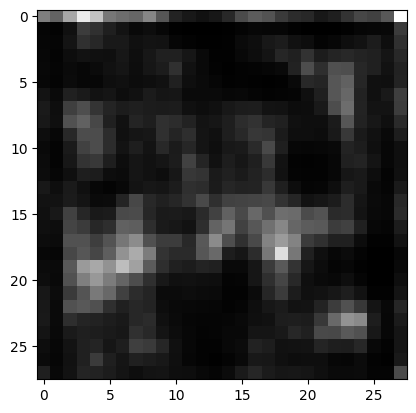

----------------------------------------


Discriminator Loss = 0.25373053550720215
Generator Loss = 2.262197732925415
A sample image generated by the generator


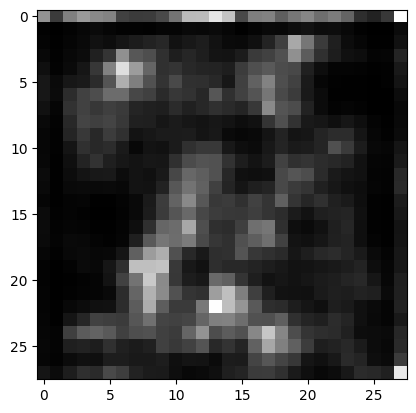

----------------------------------------


Discriminator Loss = 0.24002346396446228
Generator Loss = 2.32305908203125
A sample image generated by the generator


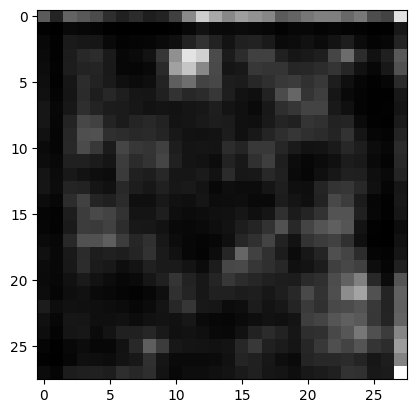

----------------------------------------


Discriminator Loss = 0.24563948810100555
Generator Loss = 2.2847118377685547
A sample image generated by the generator


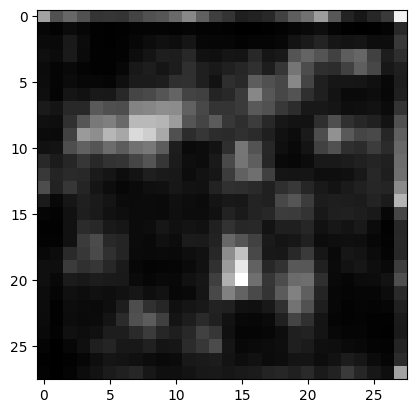

----------------------------------------


Discriminator Loss = 0.24448420107364655
Generator Loss = 2.2121479511260986
A sample image generated by the generator


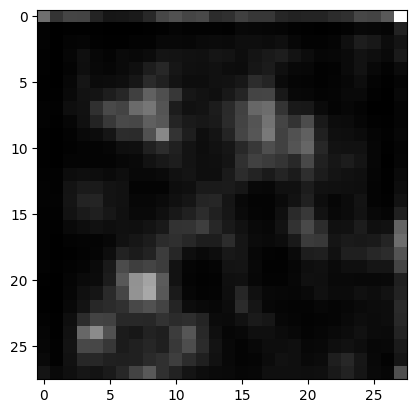

----------------------------------------


Discriminator Loss = 0.23497752845287323
Generator Loss = 2.3531155586242676
A sample image generated by the generator


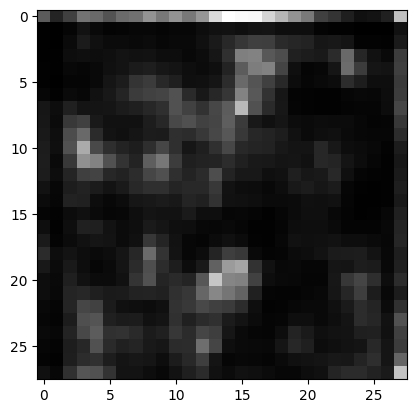

----------------------------------------


Discriminator Loss = 0.22665883600711823
Generator Loss = 2.361079216003418
A sample image generated by the generator


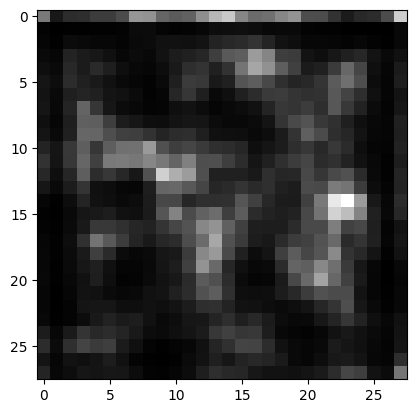

----------------------------------------


Discriminator Loss = 0.24582278728485107
Generator Loss = 2.2486937046051025
A sample image generated by the generator


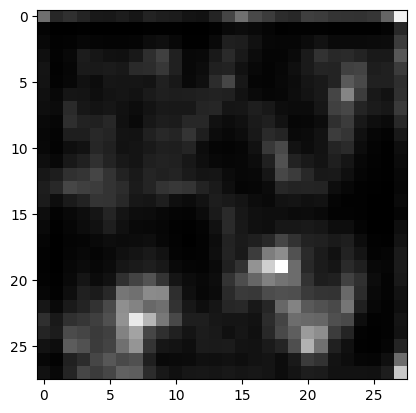

----------------------------------------


Discriminator Loss = 0.23291000723838806
Generator Loss = 2.252326488494873
A sample image generated by the generator


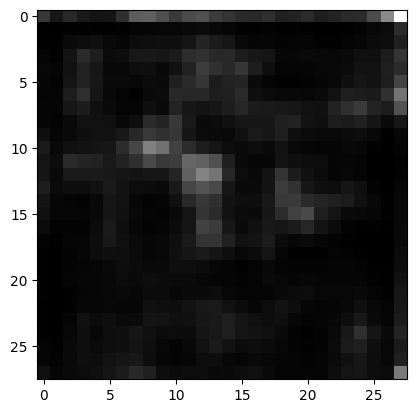

----------------------------------------


Discriminator Loss = 0.22118303179740906
Generator Loss = 2.2400174140930176
A sample image generated by the generator


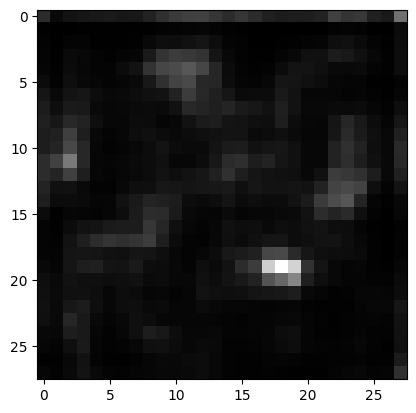

----------------------------------------


Discriminator Loss = 0.235131174325943
Generator Loss = 2.2795560359954834
A sample image generated by the generator


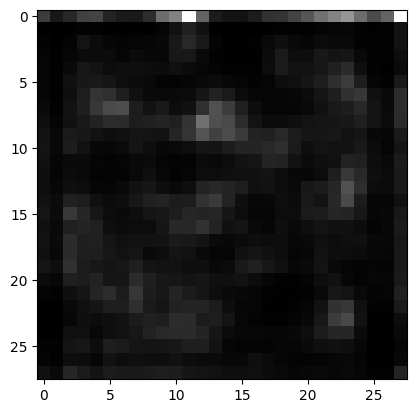

----------------------------------------


Discriminator Loss = 0.24333544075489044
Generator Loss = 2.366809368133545
A sample image generated by the generator


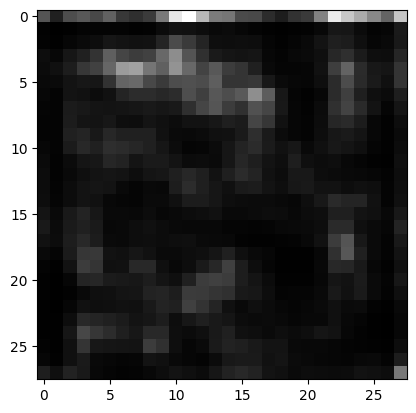

----------------------------------------


Discriminator Loss = 0.2349209189414978
Generator Loss = 2.2834017276763916
A sample image generated by the generator


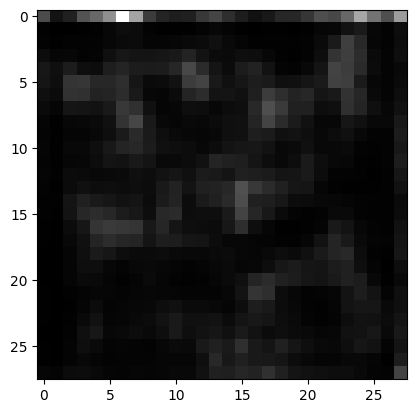

----------------------------------------


Discriminator Loss = 0.22802844643592834
Generator Loss = 2.315504550933838
A sample image generated by the generator


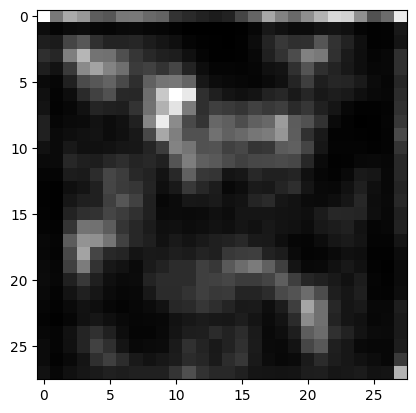

----------------------------------------


Discriminator Loss = 0.23921430110931396
Generator Loss = 2.3236212730407715
A sample image generated by the generator


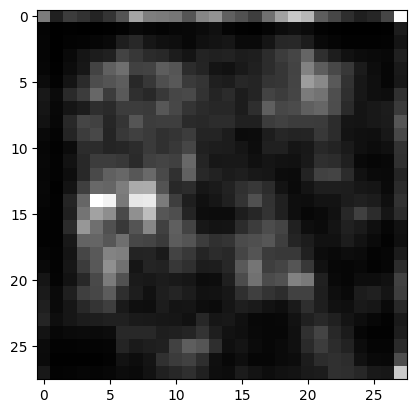

----------------------------------------


Discriminator Loss = 0.23998281359672546
Generator Loss = 2.3517866134643555
A sample image generated by the generator


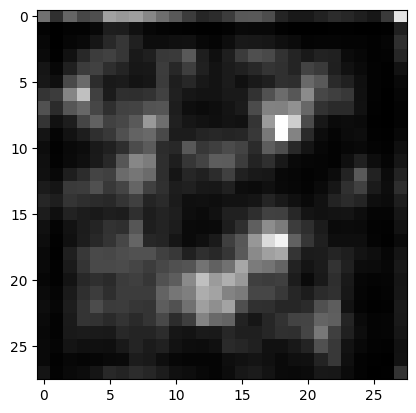

----------------------------------------


Discriminator Loss = 0.24731579422950745
Generator Loss = 2.3314714431762695
A sample image generated by the generator


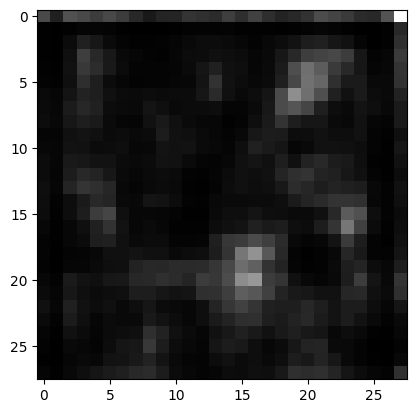

----------------------------------------


Discriminator Loss = 0.22856681048870087
Generator Loss = 2.2656140327453613
A sample image generated by the generator


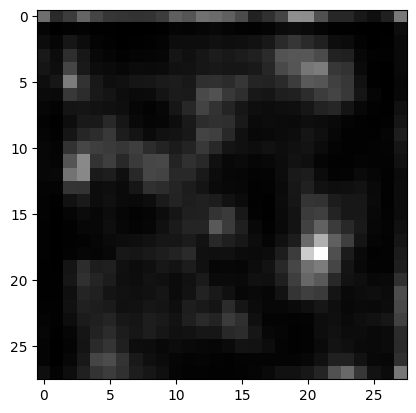

----------------------------------------


Discriminator Loss = 0.2339259535074234
Generator Loss = 2.227433204650879
A sample image generated by the generator


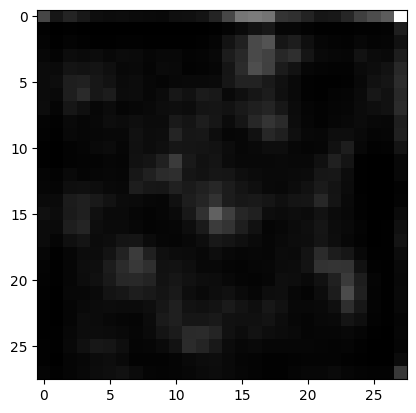

----------------------------------------


Discriminator Loss = 0.24208366870880127
Generator Loss = 2.300980567932129
A sample image generated by the generator


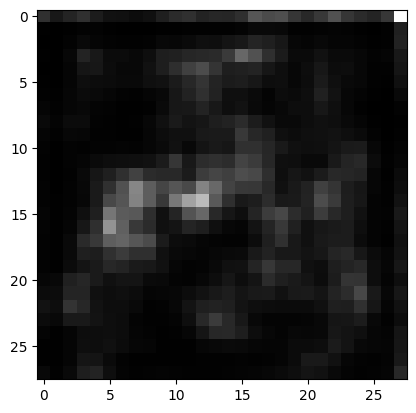

----------------------------------------


Discriminator Loss = 0.23349003493785858
Generator Loss = 2.3649773597717285
A sample image generated by the generator


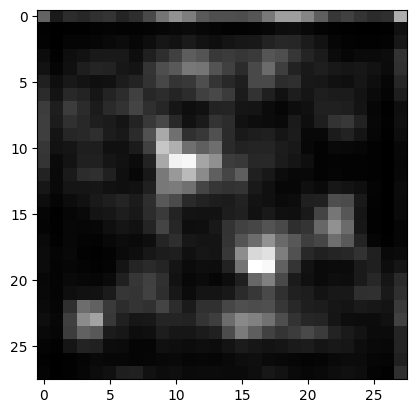

----------------------------------------


Discriminator Loss = 0.24316410720348358
Generator Loss = 2.398977279663086
A sample image generated by the generator


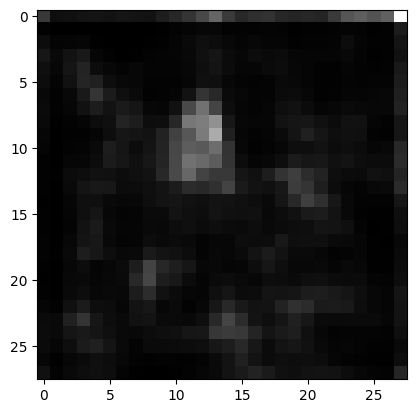

----------------------------------------


Discriminator Loss = 0.22138044238090515
Generator Loss = 2.3003945350646973
A sample image generated by the generator


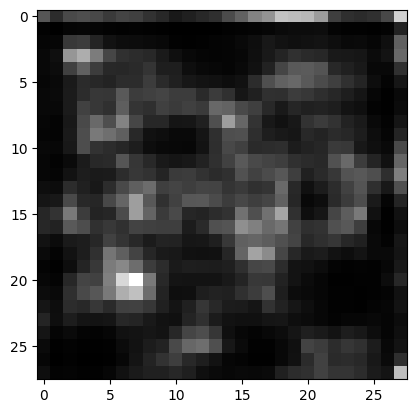

----------------------------------------


Discriminator Loss = 0.22319304943084717
Generator Loss = 2.197065830230713
A sample image generated by the generator


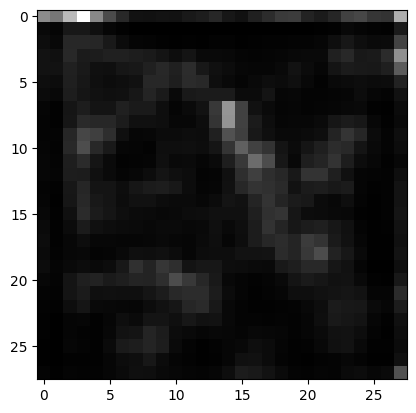

----------------------------------------


Discriminator Loss = 0.2340114712715149
Generator Loss = 2.346964120864868
A sample image generated by the generator


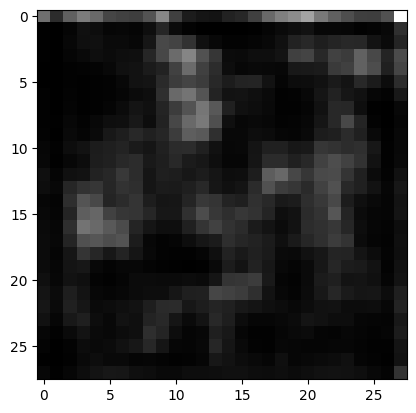

----------------------------------------


Discriminator Loss = 0.23359164595603943
Generator Loss = 2.282031774520874
A sample image generated by the generator


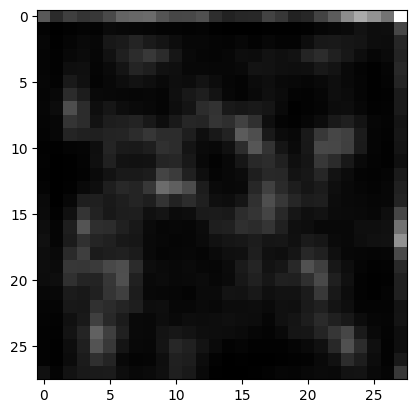

----------------------------------------


Discriminator Loss = 0.22913388907909393
Generator Loss = 2.274538516998291
A sample image generated by the generator


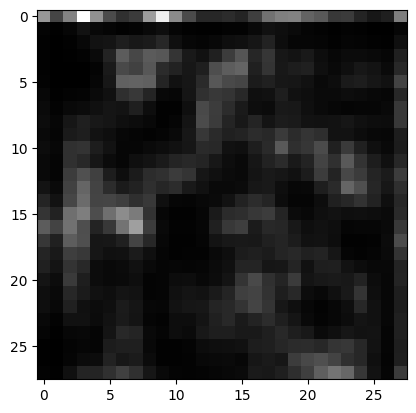

----------------------------------------


Discriminator Loss = 0.21637067198753357
Generator Loss = 2.299051284790039
A sample image generated by the generator


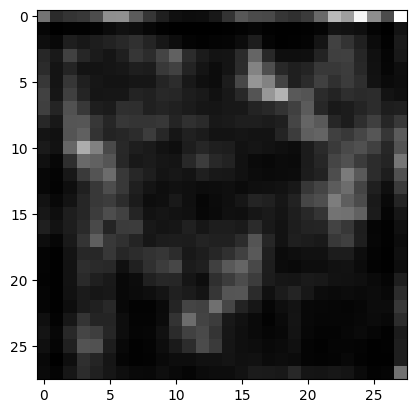

----------------------------------------


Discriminator Loss = 0.23024910688400269
Generator Loss = 2.4372730255126953
A sample image generated by the generator


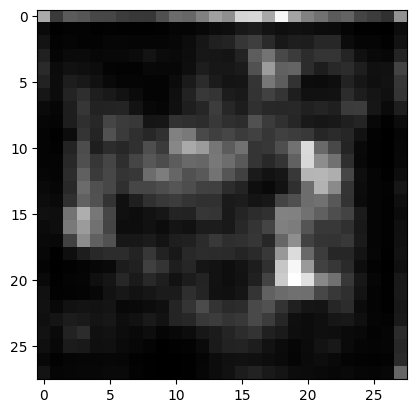

----------------------------------------


Discriminator Loss = 0.2441498339176178
Generator Loss = 2.3091559410095215
A sample image generated by the generator


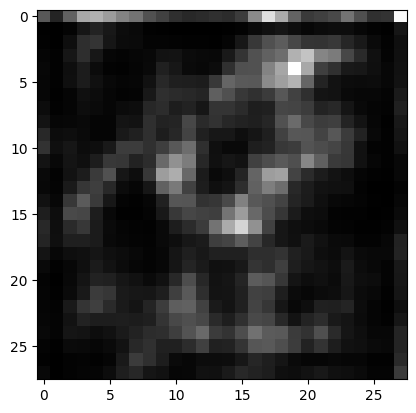

----------------------------------------


Discriminator Loss = 0.23754706978797913
Generator Loss = 2.3401598930358887
A sample image generated by the generator


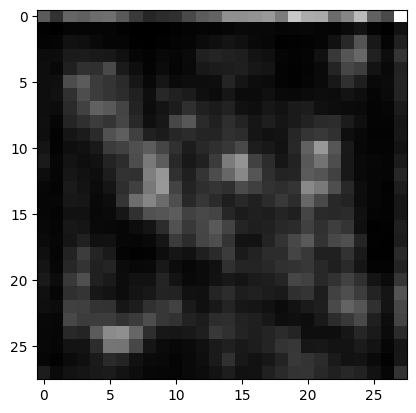

----------------------------------------


Discriminator Loss = 0.22093066573143005
Generator Loss = 2.312750816345215
A sample image generated by the generator


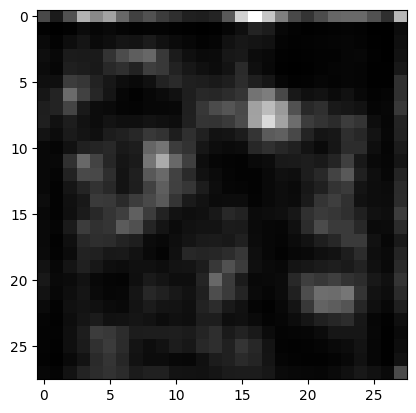

----------------------------------------


Discriminator Loss = 0.219093918800354
Generator Loss = 2.390066623687744
A sample image generated by the generator


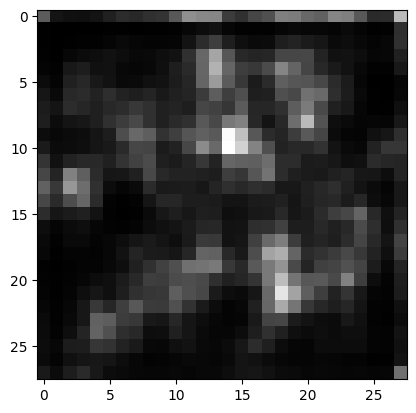

----------------------------------------


Discriminator Loss = 0.22982171177864075
Generator Loss = 2.2691259384155273
A sample image generated by the generator


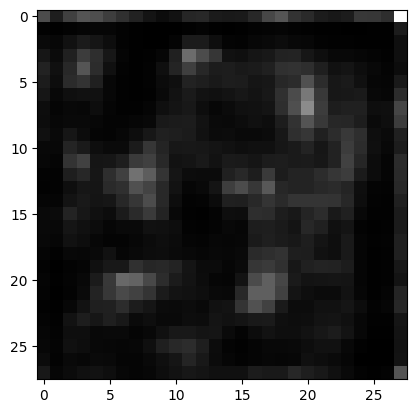

----------------------------------------


Discriminator Loss = 0.23562626540660858
Generator Loss = 2.3643276691436768
A sample image generated by the generator


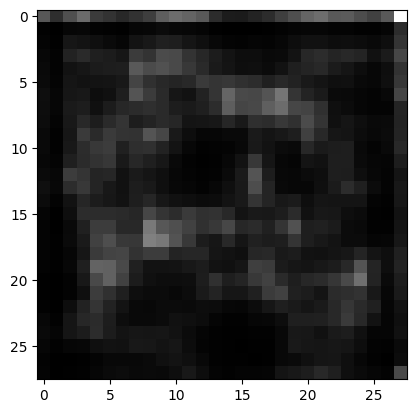

----------------------------------------


Discriminator Loss = 0.2324637770652771
Generator Loss = 2.4343793392181396
A sample image generated by the generator


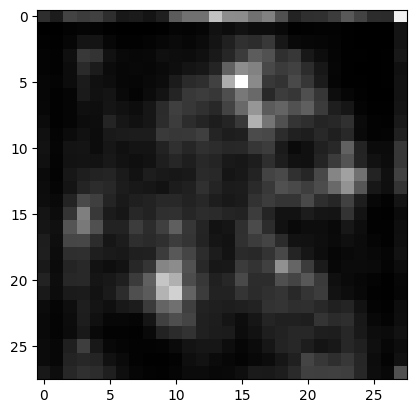

----------------------------------------


Discriminator Loss = 0.23688183724880219
Generator Loss = 2.317434072494507
A sample image generated by the generator


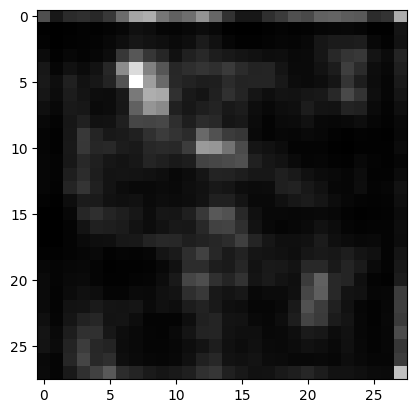

----------------------------------------


Discriminator Loss = 0.23350563645362854
Generator Loss = 2.432384490966797
A sample image generated by the generator


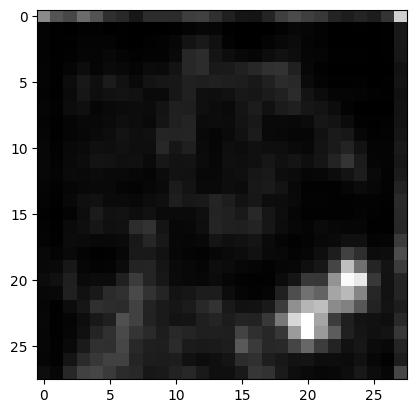

----------------------------------------


Discriminator Loss = 0.23334935307502747
Generator Loss = 2.3979430198669434
A sample image generated by the generator


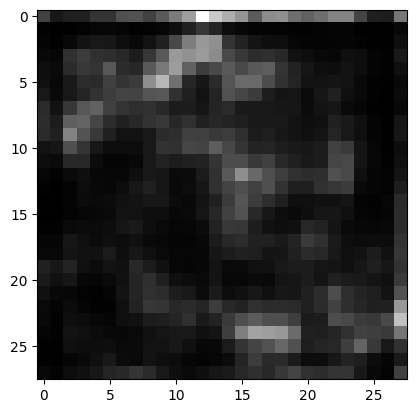

----------------------------------------


Discriminator Loss = 0.23255278170108795
Generator Loss = 2.3891079425811768
A sample image generated by the generator


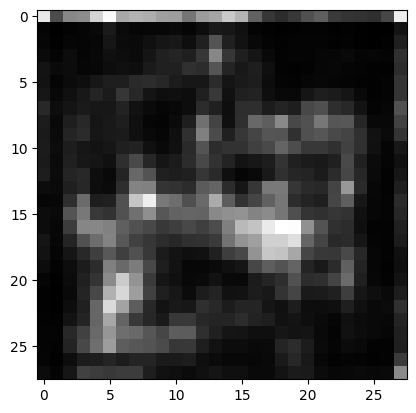

----------------------------------------


Discriminator Loss = 0.21797782182693481
Generator Loss = 2.2699060440063477
A sample image generated by the generator


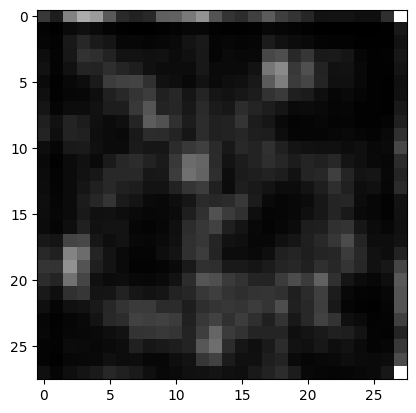

----------------------------------------


Discriminator Loss = 0.2410593032836914
Generator Loss = 2.398646354675293
A sample image generated by the generator


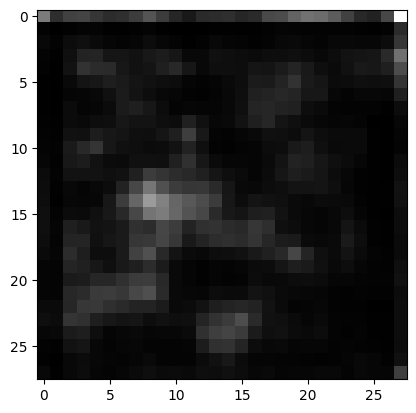

----------------------------------------


Discriminator Loss = 0.24333494901657104
Generator Loss = 2.36759877204895
A sample image generated by the generator


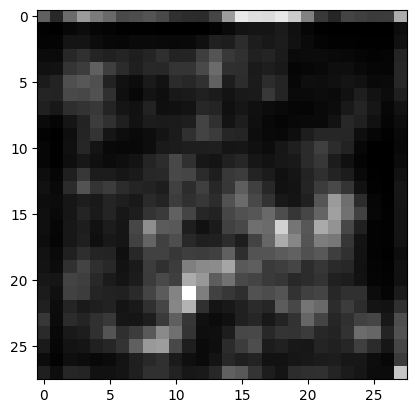

----------------------------------------


Discriminator Loss = 0.21677479147911072
Generator Loss = 2.362886905670166
A sample image generated by the generator


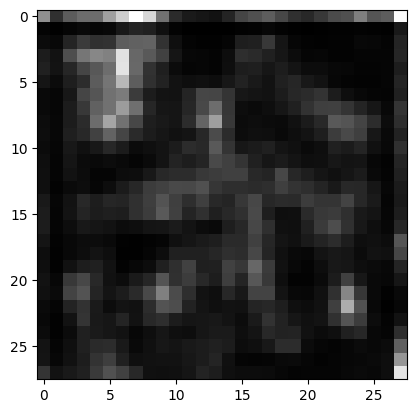

----------------------------------------


Discriminator Loss = 0.23770973086357117
Generator Loss = 2.40183162689209
A sample image generated by the generator


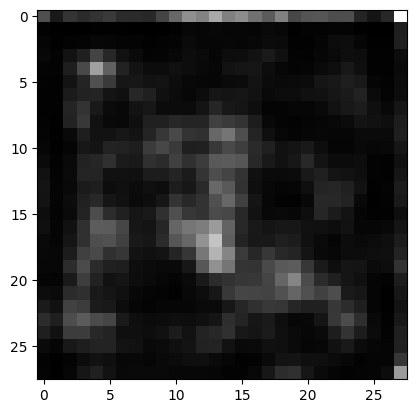

----------------------------------------


Discriminator Loss = 0.23526395857334137
Generator Loss = 2.3006527423858643
A sample image generated by the generator


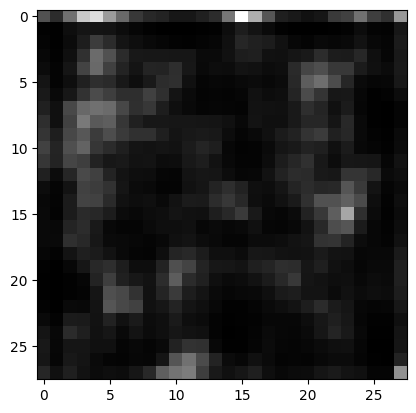

----------------------------------------


Discriminator Loss = 0.21936216950416565
Generator Loss = 2.407377004623413
A sample image generated by the generator


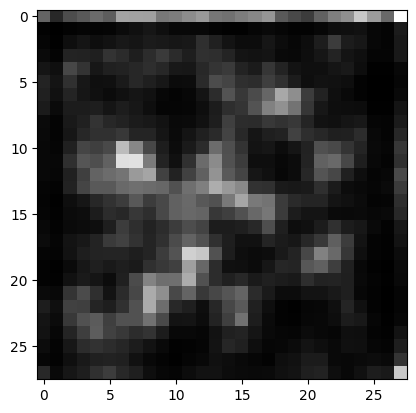

----------------------------------------


Discriminator Loss = 0.21758145093917847
Generator Loss = 2.3730640411376953
A sample image generated by the generator


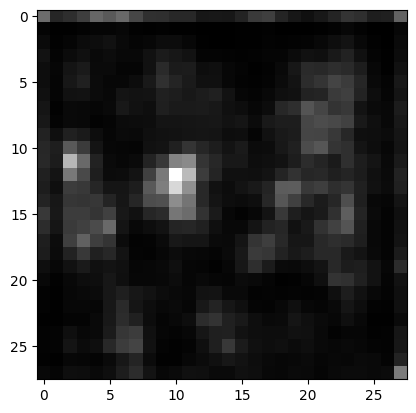

----------------------------------------


Discriminator Loss = 0.20904779434204102
Generator Loss = 2.4047791957855225
A sample image generated by the generator


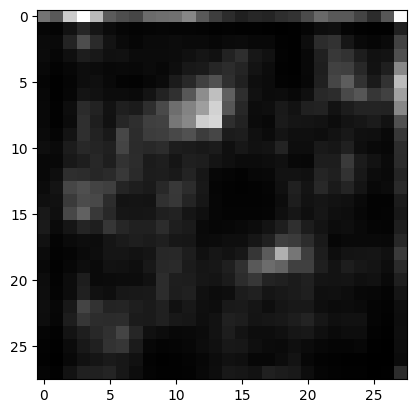

----------------------------------------


Discriminator Loss = 0.23128363490104675
Generator Loss = 2.385450601577759
A sample image generated by the generator


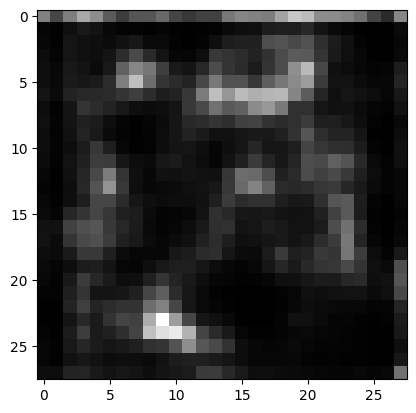

----------------------------------------


Discriminator Loss = 0.2244577705860138
Generator Loss = 2.4557883739471436
A sample image generated by the generator


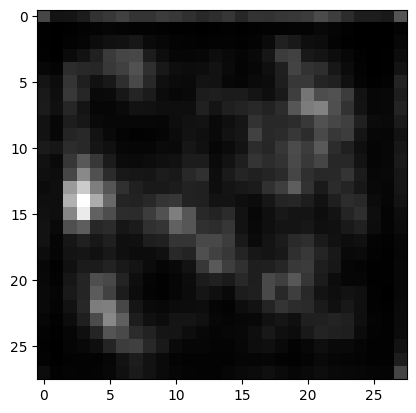

----------------------------------------


Discriminator Loss = 0.2074434757232666
Generator Loss = 2.442930221557617
A sample image generated by the generator


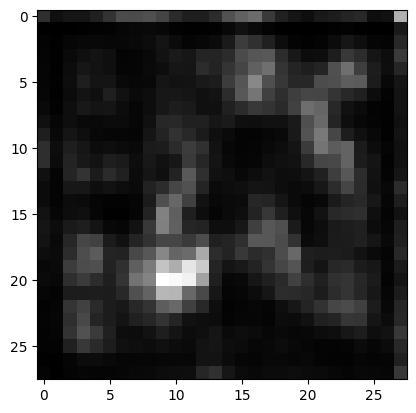

----------------------------------------


Discriminator Loss = 0.22346220910549164
Generator Loss = 2.444699764251709
A sample image generated by the generator


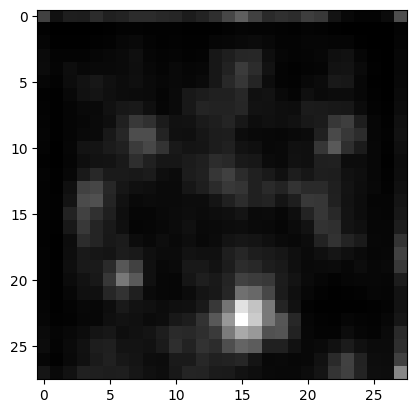

----------------------------------------


Discriminator Loss = 0.2118927240371704
Generator Loss = 2.3920814990997314
A sample image generated by the generator


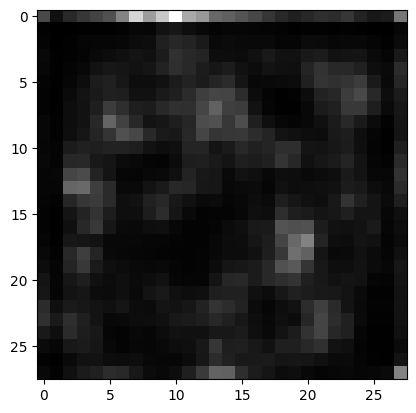

----------------------------------------


Discriminator Loss = 0.23997414112091064
Generator Loss = 2.442216396331787
A sample image generated by the generator


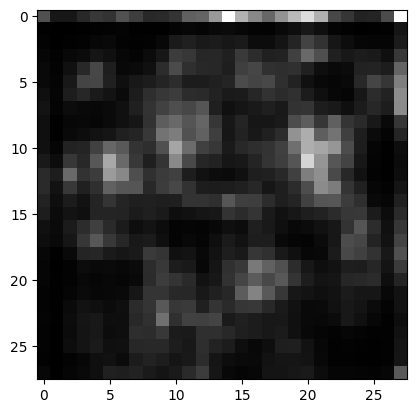

----------------------------------------


Discriminator Loss = 0.24523088335990906
Generator Loss = 2.3528952598571777
A sample image generated by the generator


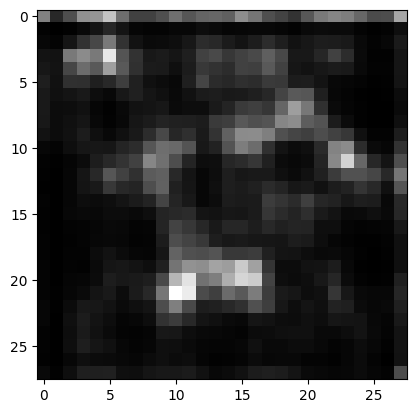

----------------------------------------


Discriminator Loss = 0.2244911789894104
Generator Loss = 2.468839168548584
A sample image generated by the generator


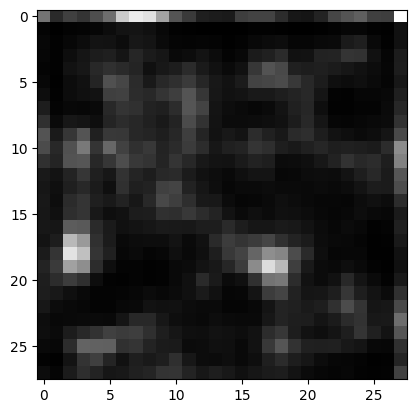

----------------------------------------


Discriminator Loss = 0.23257769644260406
Generator Loss = 2.3831229209899902
A sample image generated by the generator


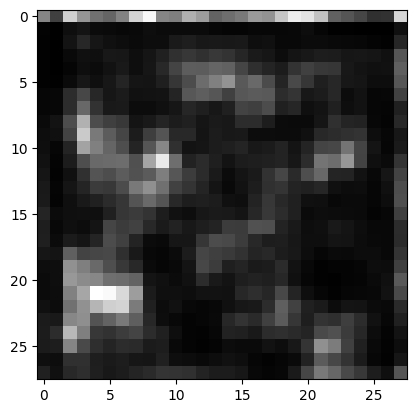

----------------------------------------


Discriminator Loss = 0.22577808797359467
Generator Loss = 2.393759250640869
A sample image generated by the generator


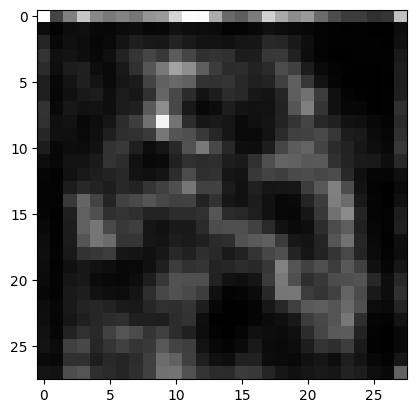

----------------------------------------


Discriminator Loss = 0.22373256087303162
Generator Loss = 2.44289493560791
A sample image generated by the generator


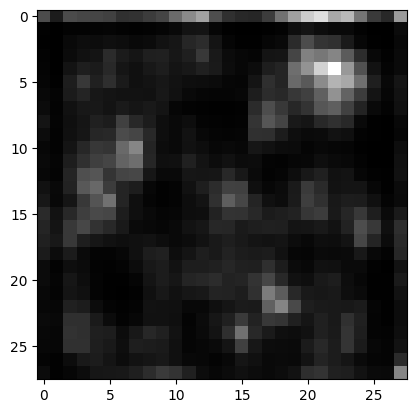

----------------------------------------


Discriminator Loss = 0.21932922303676605
Generator Loss = 2.3666000366210938
A sample image generated by the generator


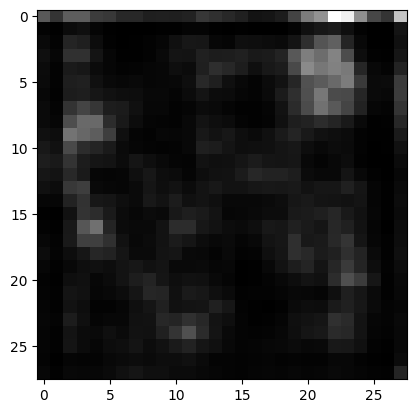

----------------------------------------


Discriminator Loss = 0.24572992324829102
Generator Loss = 2.401272773742676
A sample image generated by the generator


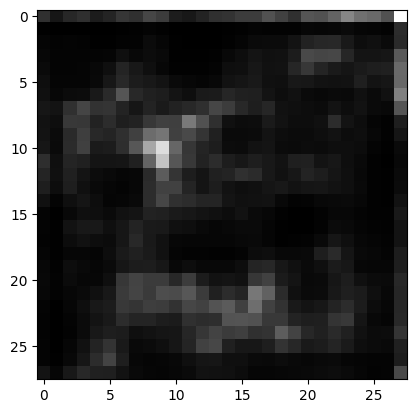

----------------------------------------


Discriminator Loss = 0.20646893978118896
Generator Loss = 2.4985756874084473
A sample image generated by the generator


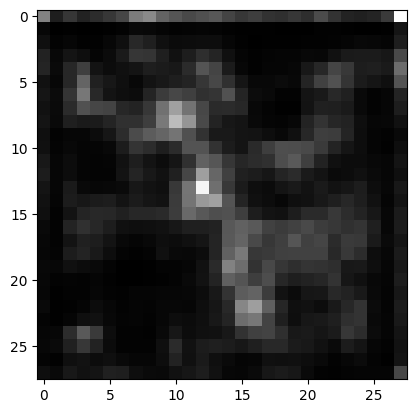

----------------------------------------


Discriminator Loss = 0.22829364240169525
Generator Loss = 2.4199342727661133
A sample image generated by the generator


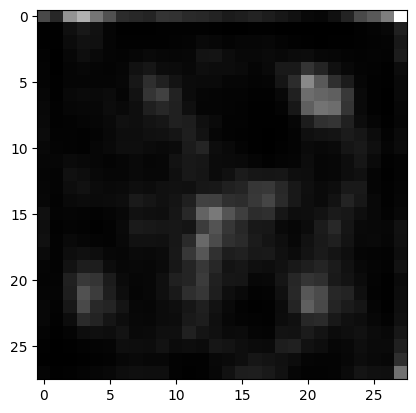

----------------------------------------


Discriminator Loss = 0.21466001868247986
Generator Loss = 2.432107925415039
A sample image generated by the generator


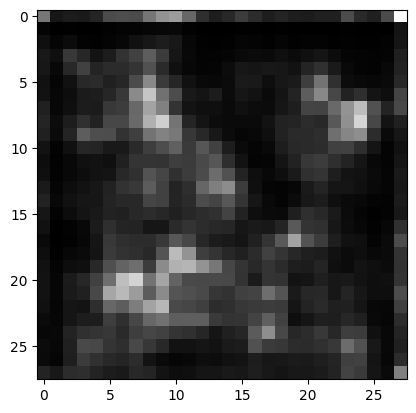

----------------------------------------


Discriminator Loss = 0.22608637809753418
Generator Loss = 2.340993881225586
A sample image generated by the generator


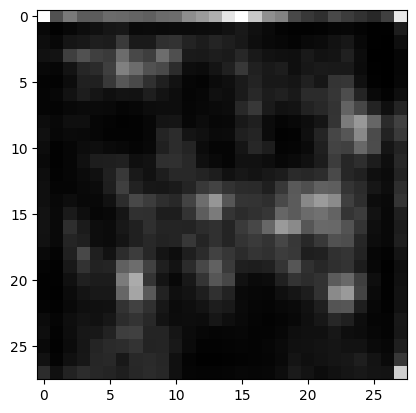

----------------------------------------


Discriminator Loss = 0.21805426478385925
Generator Loss = 2.3383712768554688
A sample image generated by the generator


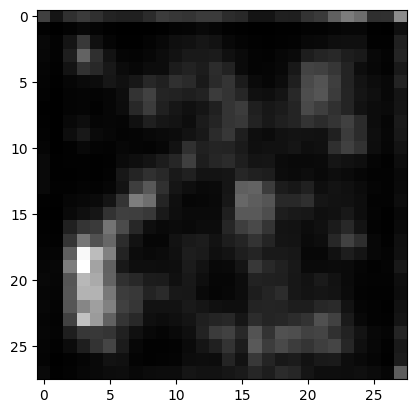

----------------------------------------


Discriminator Loss = 0.2172538787126541
Generator Loss = 2.345294952392578
A sample image generated by the generator


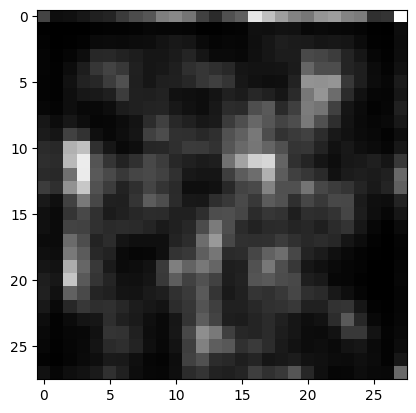

----------------------------------------


Discriminator Loss = 0.2173404097557068
Generator Loss = 2.4411048889160156
A sample image generated by the generator


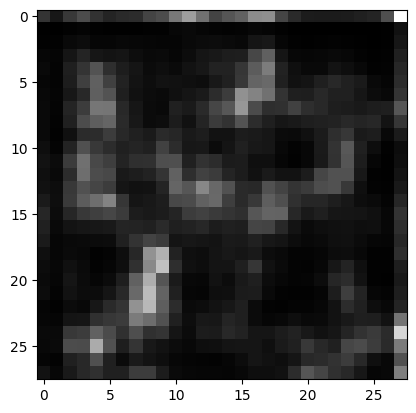

----------------------------------------


Discriminator Loss = 0.22401709854602814
Generator Loss = 2.3343615531921387
A sample image generated by the generator


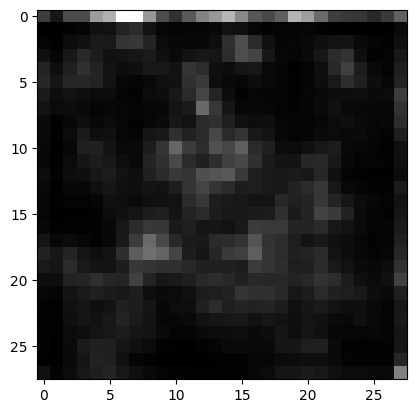

----------------------------------------


Discriminator Loss = 0.2353825569152832
Generator Loss = 2.410464286804199
A sample image generated by the generator


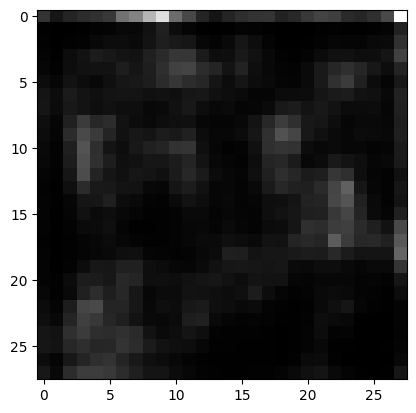

----------------------------------------


Discriminator Loss = 0.2241036742925644
Generator Loss = 2.410083293914795
A sample image generated by the generator


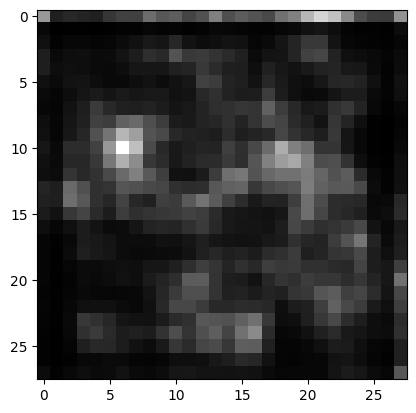

----------------------------------------


Discriminator Loss = 0.2163904756307602
Generator Loss = 2.471590042114258
A sample image generated by the generator


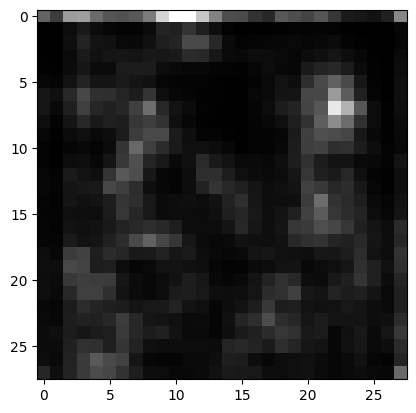

----------------------------------------


Discriminator Loss = 0.20732277631759644
Generator Loss = 2.4479317665100098
A sample image generated by the generator


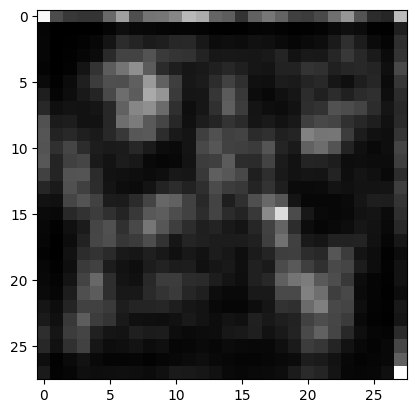

----------------------------------------


Discriminator Loss = 0.21745352447032928
Generator Loss = 2.395318031311035
A sample image generated by the generator


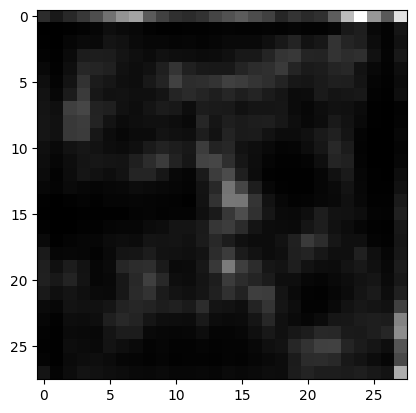

----------------------------------------


Discriminator Loss = 0.21790438890457153
Generator Loss = 2.468568801879883
A sample image generated by the generator


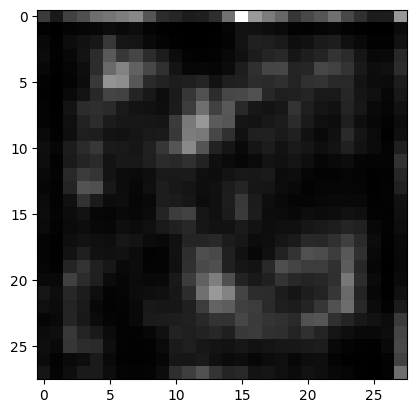

----------------------------------------


Discriminator Loss = 0.2136053740978241
Generator Loss = 2.41001558303833
A sample image generated by the generator


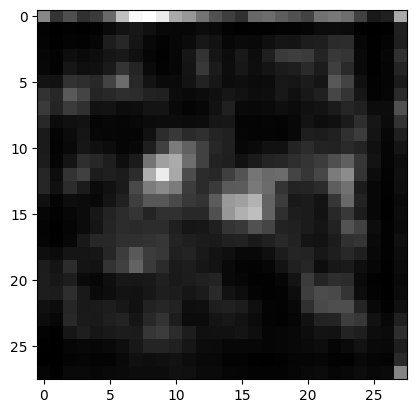

----------------------------------------


Discriminator Loss = 0.2122182697057724
Generator Loss = 2.3046555519104004
A sample image generated by the generator


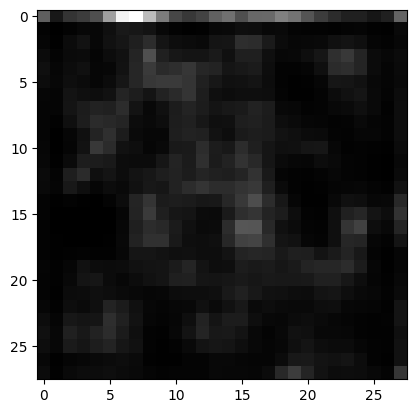

----------------------------------------


Discriminator Loss = 0.22463063895702362
Generator Loss = 2.4213647842407227
A sample image generated by the generator


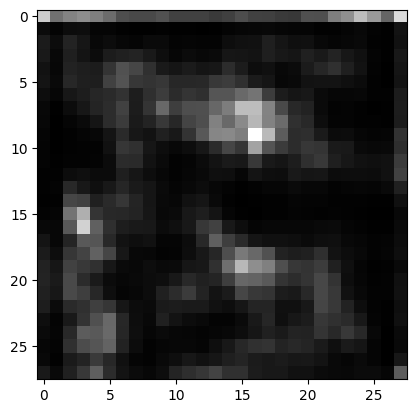

----------------------------------------


Discriminator Loss = 0.2216038703918457
Generator Loss = 2.4257147312164307
A sample image generated by the generator


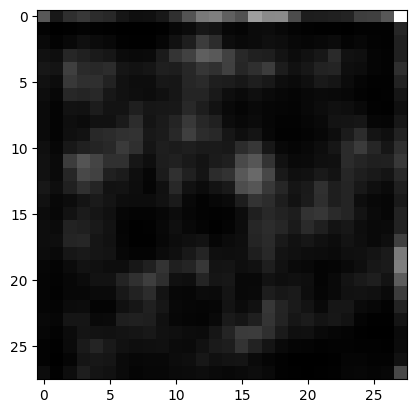

----------------------------------------


Discriminator Loss = 0.23650942742824554
Generator Loss = 2.385834217071533
A sample image generated by the generator


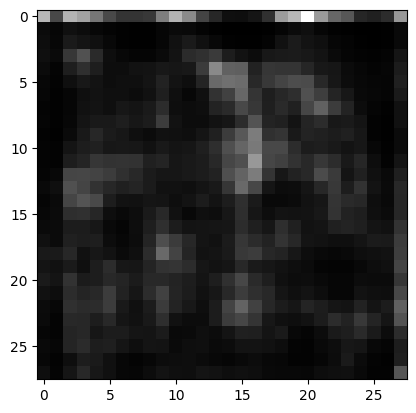

----------------------------------------


Discriminator Loss = 0.2096738964319229
Generator Loss = 2.515273094177246
A sample image generated by the generator


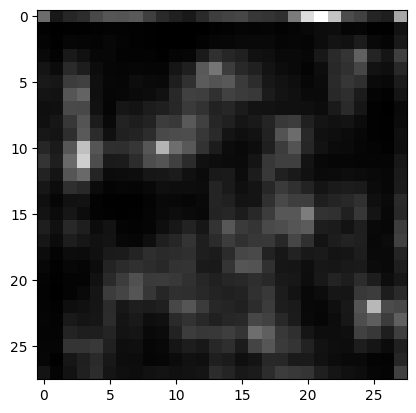

----------------------------------------


Discriminator Loss = 0.21014538407325745
Generator Loss = 2.3441877365112305
A sample image generated by the generator


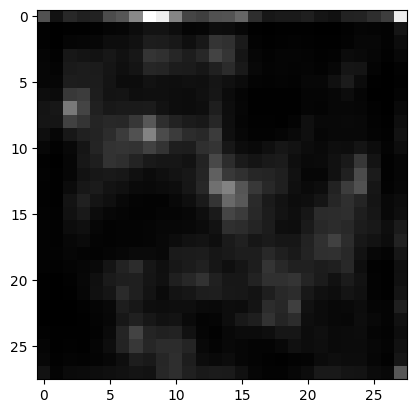

----------------------------------------


Discriminator Loss = 0.21683764457702637
Generator Loss = 2.491940975189209
A sample image generated by the generator


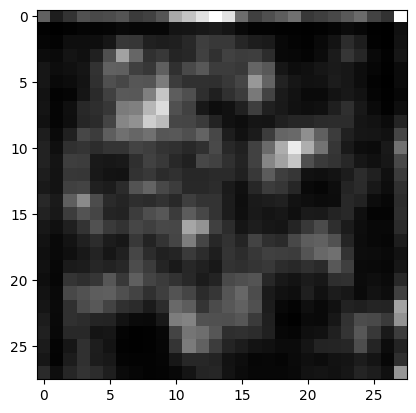

----------------------------------------


Discriminator Loss = 0.20719990134239197
Generator Loss = 2.527665615081787
A sample image generated by the generator


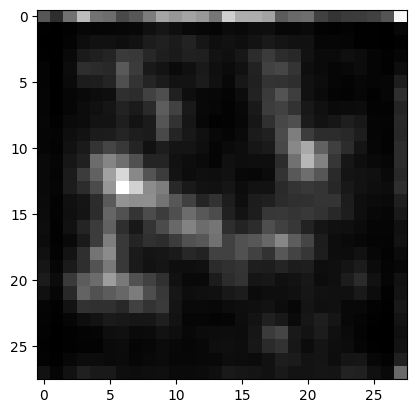

----------------------------------------


Discriminator Loss = 0.21860146522521973
Generator Loss = 2.361633777618408
A sample image generated by the generator


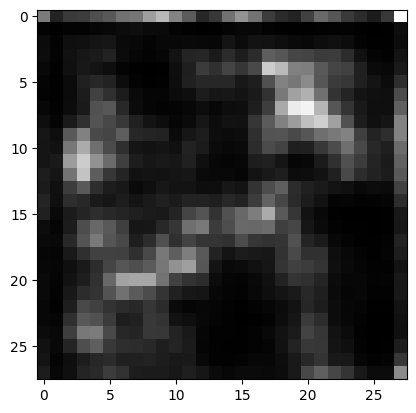

----------------------------------------


Discriminator Loss = 0.20909735560417175
Generator Loss = 2.33144211769104
A sample image generated by the generator


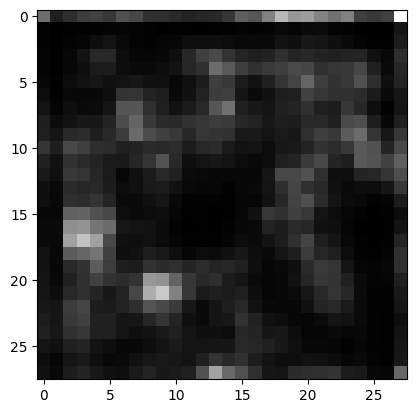

----------------------------------------


Discriminator Loss = 0.2203703224658966
Generator Loss = 2.325860023498535
A sample image generated by the generator


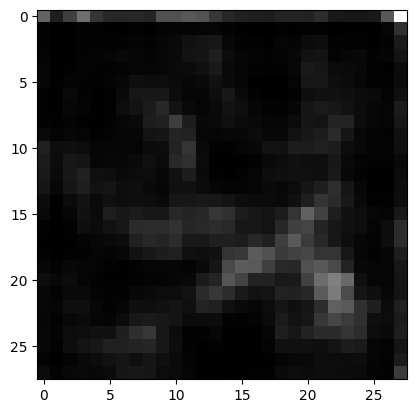

----------------------------------------


Discriminator Loss = 0.20936131477355957
Generator Loss = 2.522034168243408
A sample image generated by the generator


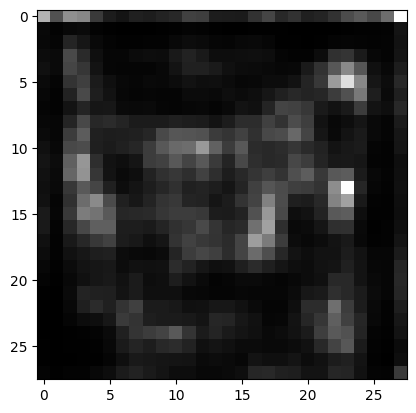

----------------------------------------


Discriminator Loss = 0.21780267357826233
Generator Loss = 2.42301082611084
A sample image generated by the generator


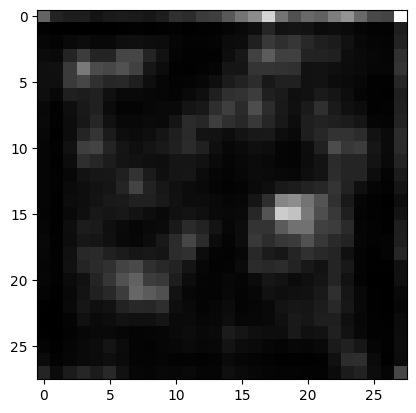

----------------------------------------


Discriminator Loss = 0.21395422518253326
Generator Loss = 2.469287157058716
A sample image generated by the generator


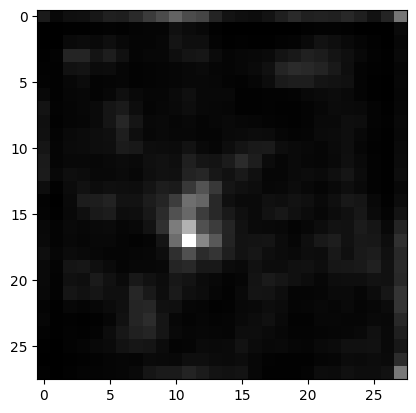

----------------------------------------


Discriminator Loss = 0.1960243135690689
Generator Loss = 2.4643759727478027
A sample image generated by the generator


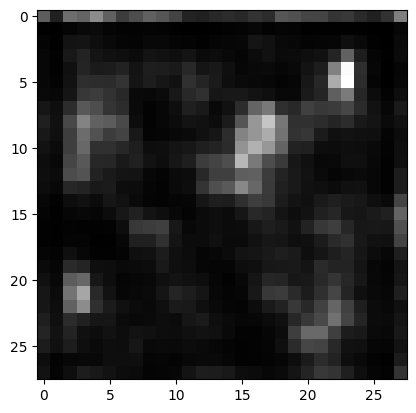

----------------------------------------


Discriminator Loss = 0.21083013713359833
Generator Loss = 2.4882845878601074
A sample image generated by the generator


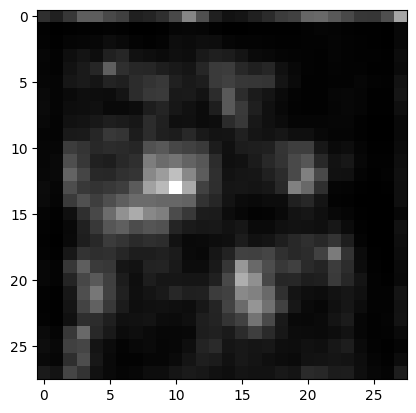

----------------------------------------


Discriminator Loss = 0.20444127917289734
Generator Loss = 2.4710235595703125
A sample image generated by the generator


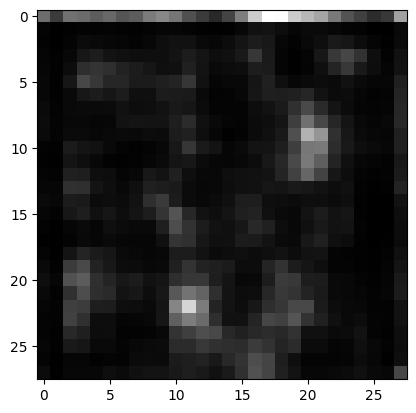

----------------------------------------


Discriminator Loss = 0.20127487182617188
Generator Loss = 2.54097580909729
A sample image generated by the generator


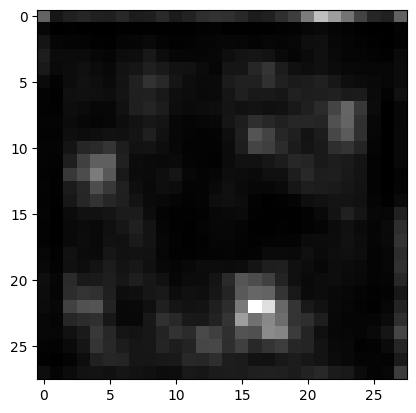

----------------------------------------


Discriminator Loss = 0.210623100399971
Generator Loss = 2.4172115325927734
A sample image generated by the generator


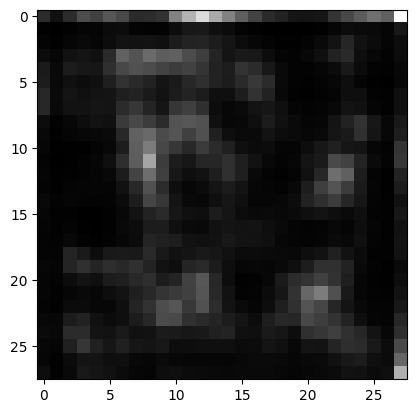

----------------------------------------


Discriminator Loss = 0.2086033821105957
Generator Loss = 2.492975950241089
A sample image generated by the generator


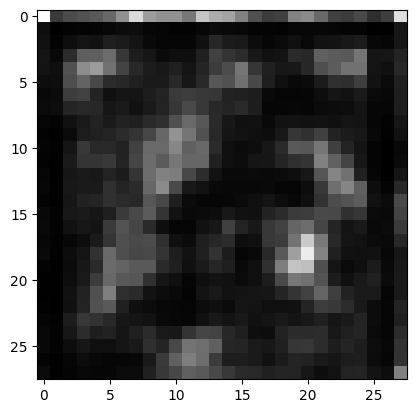

----------------------------------------


Discriminator Loss = 0.2069930136203766
Generator Loss = 2.342771530151367
A sample image generated by the generator


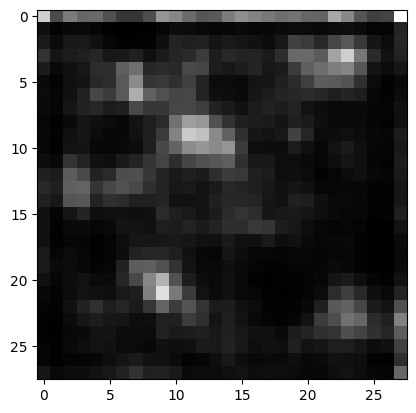

----------------------------------------


Discriminator Loss = 0.22489987313747406
Generator Loss = 2.448219060897827
A sample image generated by the generator


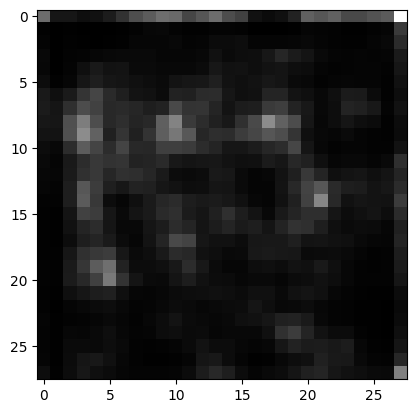

----------------------------------------


Discriminator Loss = 0.21774594485759735
Generator Loss = 2.405261993408203
A sample image generated by the generator


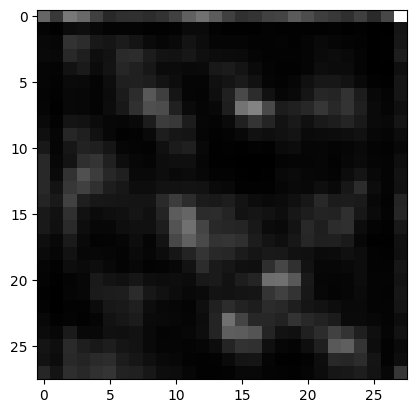

----------------------------------------


Discriminator Loss = 0.2145429253578186
Generator Loss = 2.4540014266967773
A sample image generated by the generator


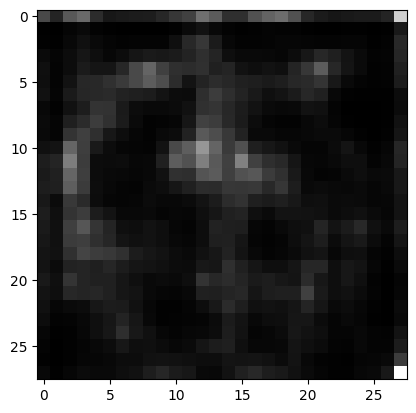

----------------------------------------


Discriminator Loss = 0.19439761340618134
Generator Loss = 2.466960906982422
A sample image generated by the generator


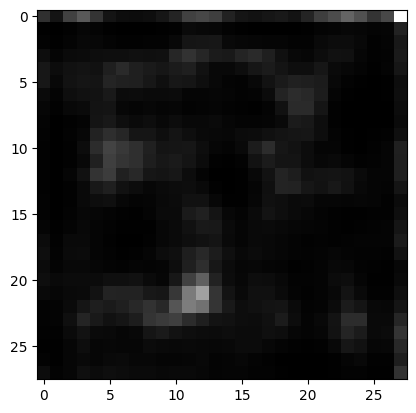

----------------------------------------


Discriminator Loss = 0.20795491337776184
Generator Loss = 2.519498825073242
A sample image generated by the generator


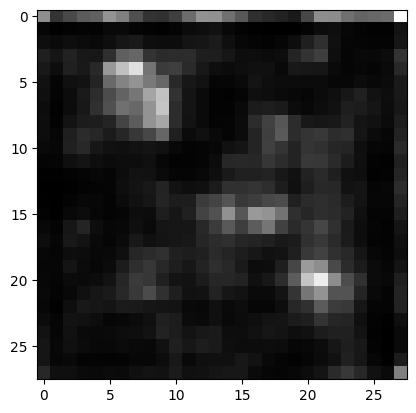

----------------------------------------


Discriminator Loss = 0.18429820239543915
Generator Loss = 2.390439987182617
A sample image generated by the generator


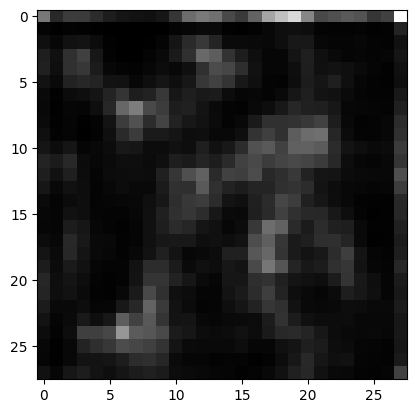

----------------------------------------


Discriminator Loss = 0.21435512602329254
Generator Loss = 2.472079277038574
A sample image generated by the generator


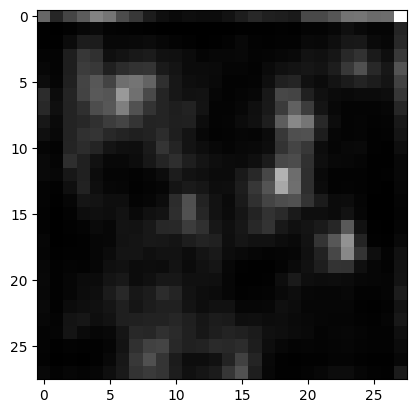

----------------------------------------


Discriminator Loss = 0.20643830299377441
Generator Loss = 2.497096538543701
A sample image generated by the generator


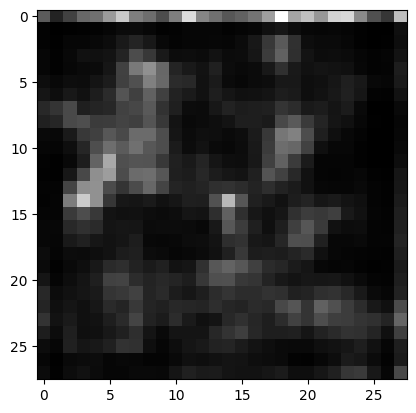

----------------------------------------


Discriminator Loss = 0.2073419988155365
Generator Loss = 2.3711912631988525
A sample image generated by the generator


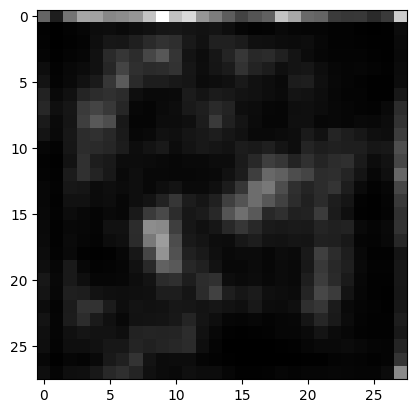

----------------------------------------


Discriminator Loss = 0.20476888120174408
Generator Loss = 2.3584604263305664
A sample image generated by the generator


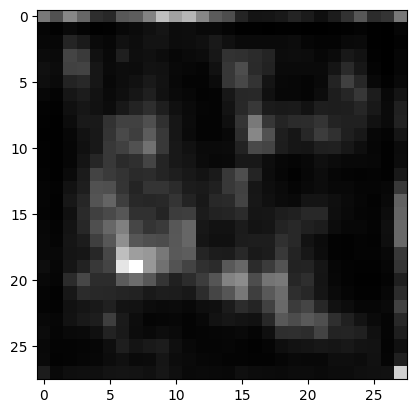

----------------------------------------


Discriminator Loss = 0.19473102688789368
Generator Loss = 2.4949660301208496
A sample image generated by the generator


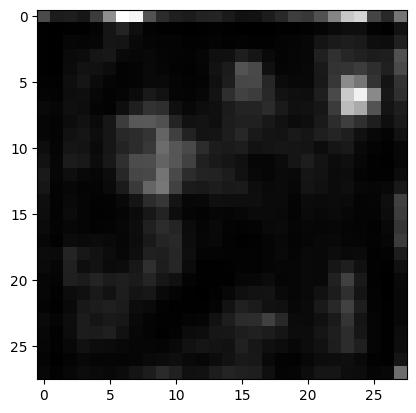

----------------------------------------


Discriminator Loss = 0.19641868770122528
Generator Loss = 2.4132466316223145
A sample image generated by the generator


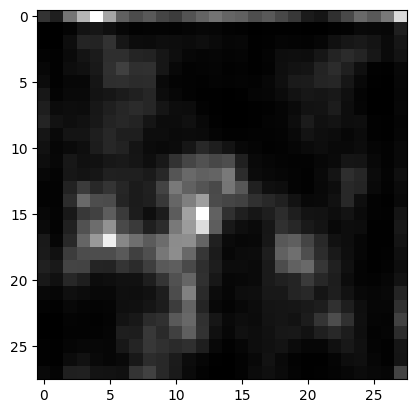

----------------------------------------


Discriminator Loss = 0.21027472615242004
Generator Loss = 2.5314090251922607
A sample image generated by the generator


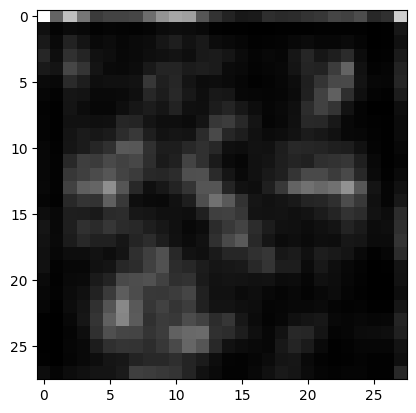

----------------------------------------


Discriminator Loss = 0.19614088535308838
Generator Loss = 2.530909538269043
A sample image generated by the generator


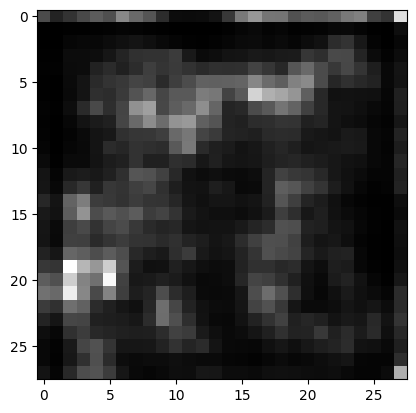

----------------------------------------


Discriminator Loss = 0.2135704904794693
Generator Loss = 2.3534741401672363
A sample image generated by the generator


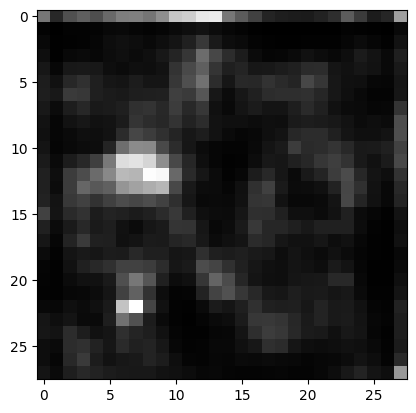

----------------------------------------


Discriminator Loss = 0.2008763998746872
Generator Loss = 2.3931899070739746
A sample image generated by the generator


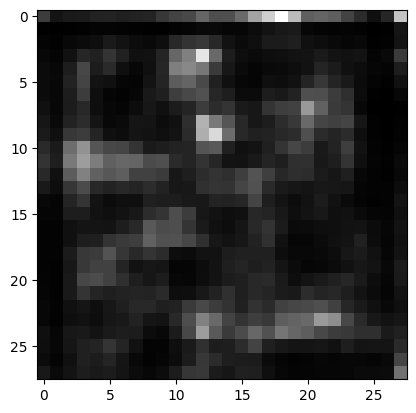

----------------------------------------


Discriminator Loss = 0.2073165476322174
Generator Loss = 2.4802162647247314
A sample image generated by the generator


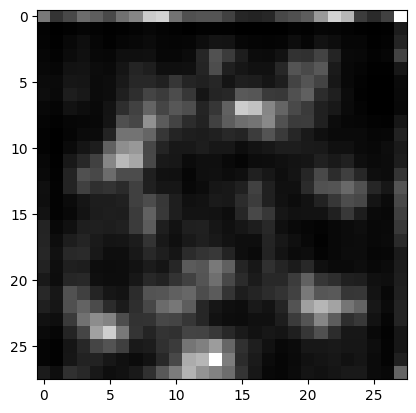

----------------------------------------


Discriminator Loss = 0.19885289669036865
Generator Loss = 2.543290138244629
A sample image generated by the generator


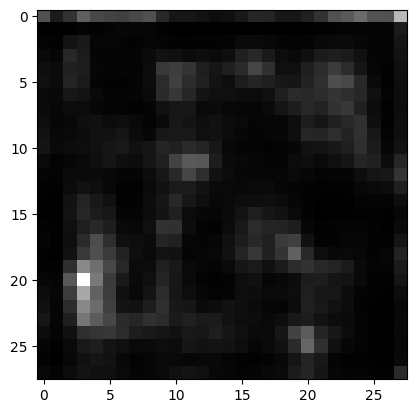

----------------------------------------


Discriminator Loss = 0.19529077410697937
Generator Loss = 2.5136878490448
A sample image generated by the generator


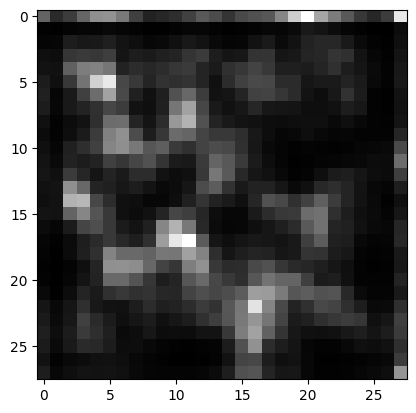

----------------------------------------


Discriminator Loss = 0.19558191299438477
Generator Loss = 2.4301414489746094
A sample image generated by the generator


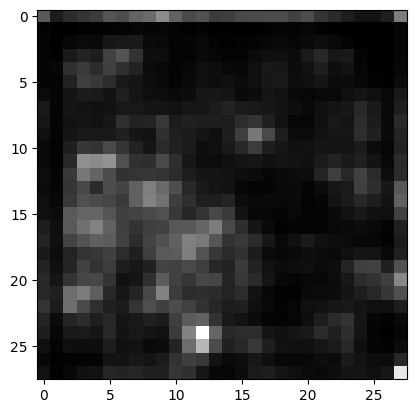

----------------------------------------


Discriminator Loss = 0.2164342999458313
Generator Loss = 2.4384407997131348
A sample image generated by the generator


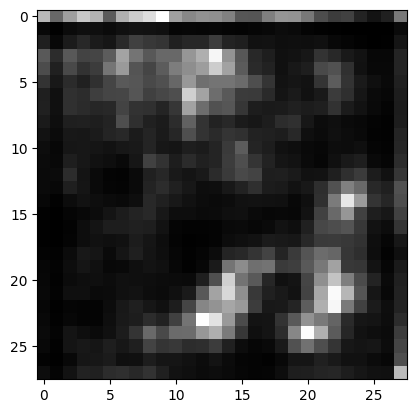

----------------------------------------


Discriminator Loss = 0.1940992772579193
Generator Loss = 2.566997528076172
A sample image generated by the generator


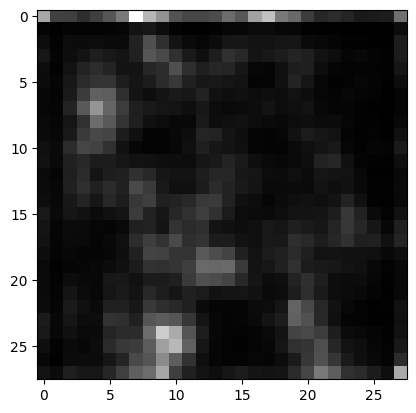

----------------------------------------


Discriminator Loss = 0.20229431986808777
Generator Loss = 2.541717290878296
A sample image generated by the generator


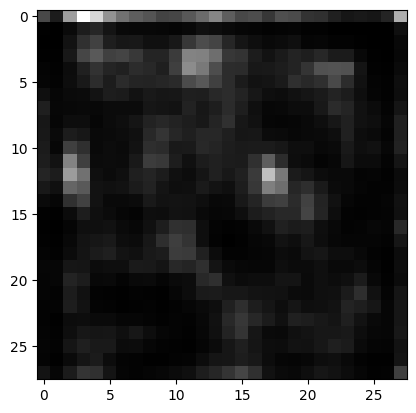

----------------------------------------


Discriminator Loss = 0.20289796590805054
Generator Loss = 2.500647783279419
A sample image generated by the generator


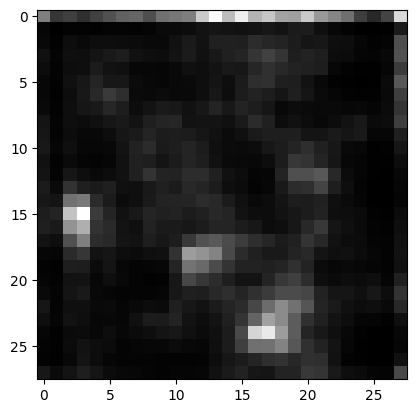

----------------------------------------


Discriminator Loss = 0.18872179090976715
Generator Loss = 2.5378451347351074
A sample image generated by the generator


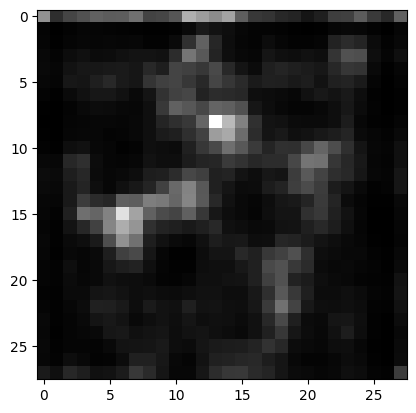

----------------------------------------


Discriminator Loss = 0.2019040286540985
Generator Loss = 2.377229928970337
A sample image generated by the generator


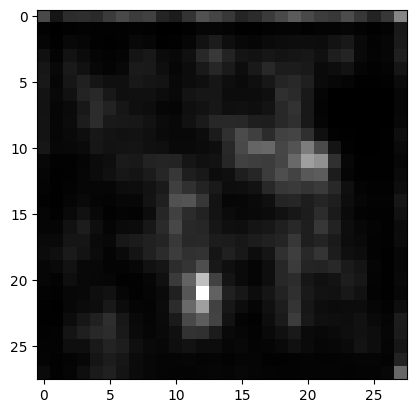

----------------------------------------


Discriminator Loss = 0.20506398379802704
Generator Loss = 2.4534623622894287
A sample image generated by the generator


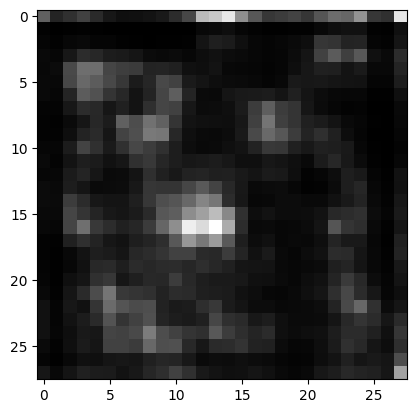

----------------------------------------


Discriminator Loss = 0.19631202518939972
Generator Loss = 2.4339208602905273
A sample image generated by the generator


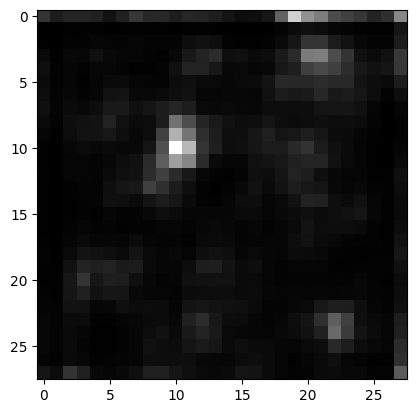

----------------------------------------


Discriminator Loss = 0.19923527538776398
Generator Loss = 2.5670878887176514
A sample image generated by the generator


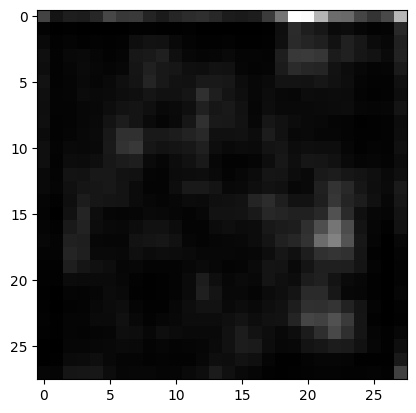

----------------------------------------


Discriminator Loss = 0.19587025046348572
Generator Loss = 2.4844069480895996
A sample image generated by the generator


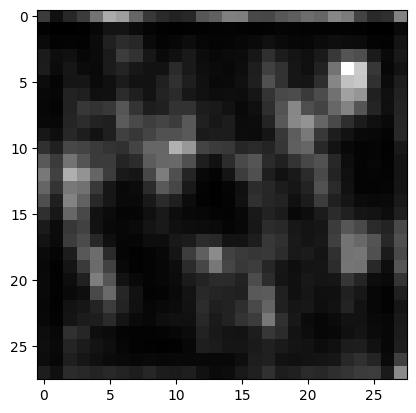

----------------------------------------


Discriminator Loss = 0.2068871259689331
Generator Loss = 2.49539852142334
A sample image generated by the generator


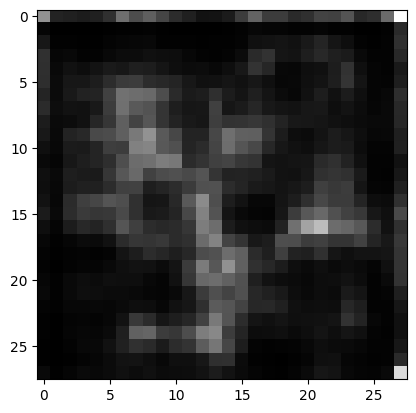

----------------------------------------


Discriminator Loss = 0.20333044230937958
Generator Loss = 2.5177178382873535
A sample image generated by the generator


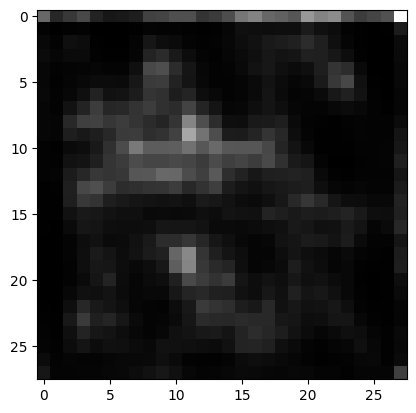

----------------------------------------


Discriminator Loss = 0.20807871222496033
Generator Loss = 2.5051422119140625
A sample image generated by the generator


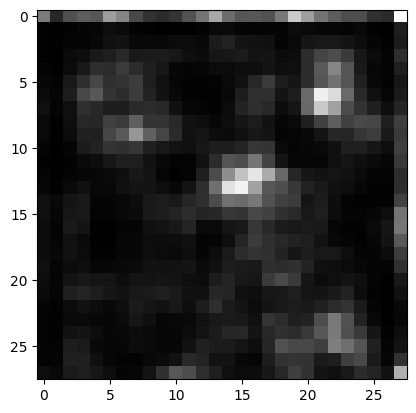

----------------------------------------


Discriminator Loss = 0.20225560665130615
Generator Loss = 2.6090073585510254
A sample image generated by the generator


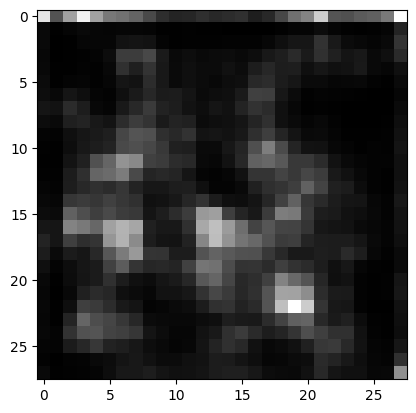

----------------------------------------


Discriminator Loss = 0.20504502952098846
Generator Loss = 2.5785932540893555
A sample image generated by the generator


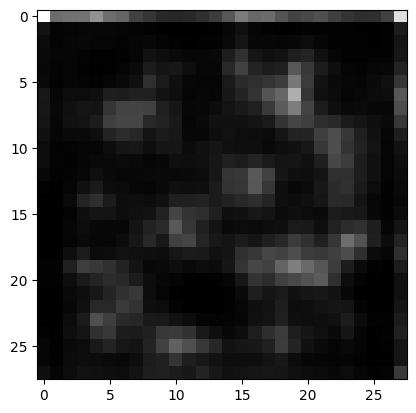

----------------------------------------


Discriminator Loss = 0.19543498754501343
Generator Loss = 2.5588185787200928
A sample image generated by the generator


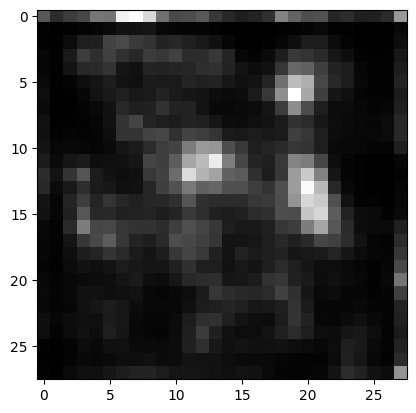

----------------------------------------


Discriminator Loss = 0.20975203812122345
Generator Loss = 2.5087175369262695
A sample image generated by the generator


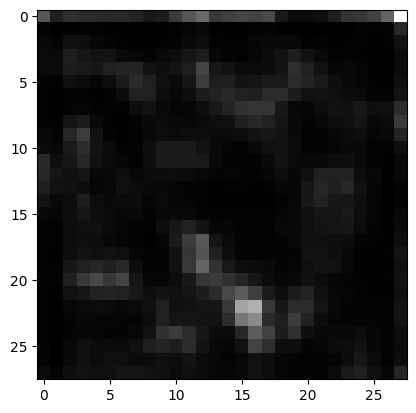

----------------------------------------


Discriminator Loss = 0.18415412306785583
Generator Loss = 2.5157155990600586
A sample image generated by the generator


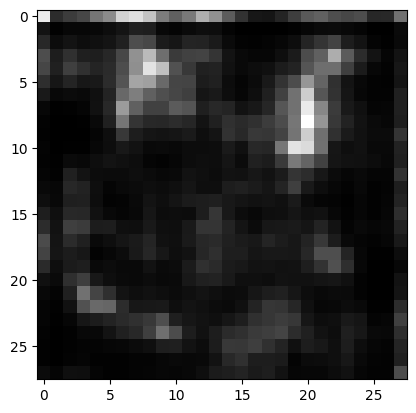

----------------------------------------


Discriminator Loss = 0.20727989077568054
Generator Loss = 2.509256362915039
A sample image generated by the generator


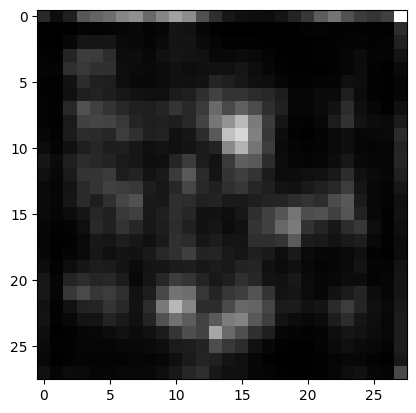

----------------------------------------


Discriminator Loss = 0.1852836012840271
Generator Loss = 2.6324799060821533
A sample image generated by the generator


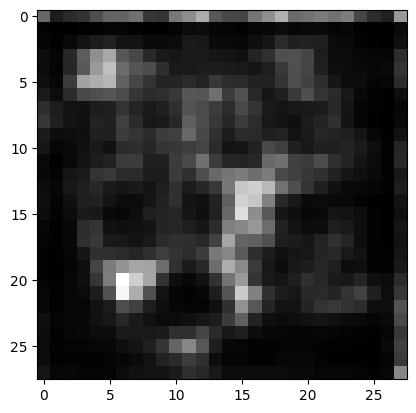

----------------------------------------


Discriminator Loss = 0.19094914197921753
Generator Loss = 2.5856406688690186
A sample image generated by the generator


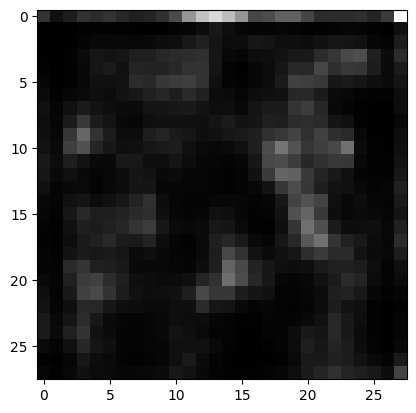

----------------------------------------


Discriminator Loss = 0.19911004602909088
Generator Loss = 2.581228733062744
A sample image generated by the generator


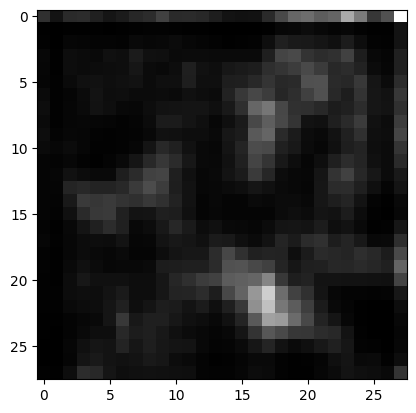

----------------------------------------


Discriminator Loss = 0.1926567703485489
Generator Loss = 2.5681819915771484
A sample image generated by the generator


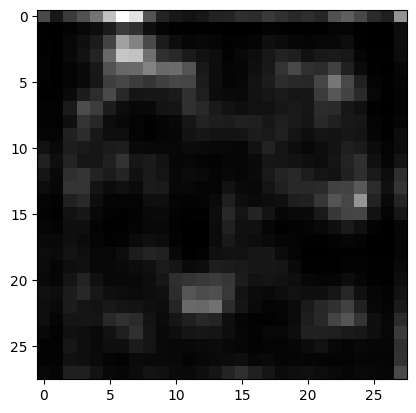

----------------------------------------


Discriminator Loss = 0.19183769822120667
Generator Loss = 2.538749933242798
A sample image generated by the generator


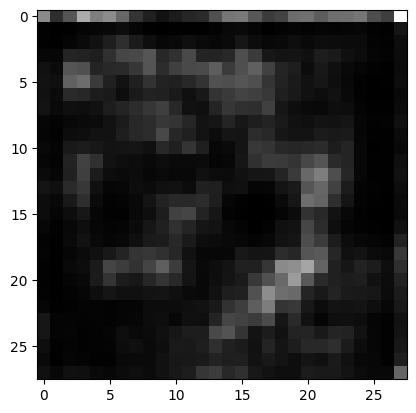

----------------------------------------


Discriminator Loss = 0.1995851993560791
Generator Loss = 2.5951642990112305
A sample image generated by the generator


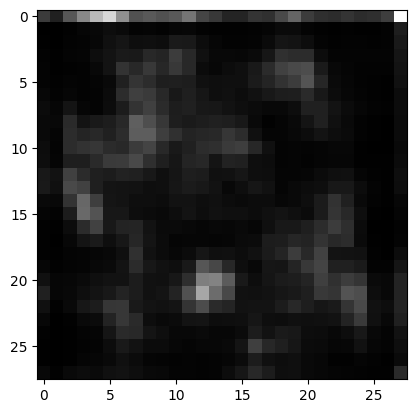

----------------------------------------


Discriminator Loss = 0.19489988684654236
Generator Loss = 2.5802671909332275
A sample image generated by the generator


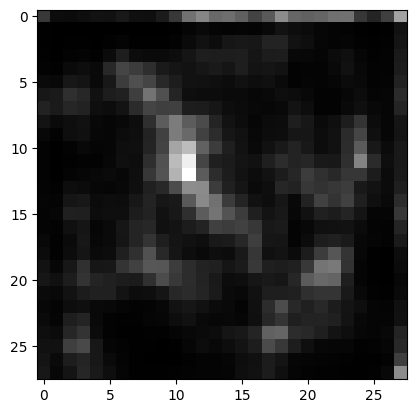

----------------------------------------


Discriminator Loss = 0.19156816601753235
Generator Loss = 2.4869749546051025
A sample image generated by the generator


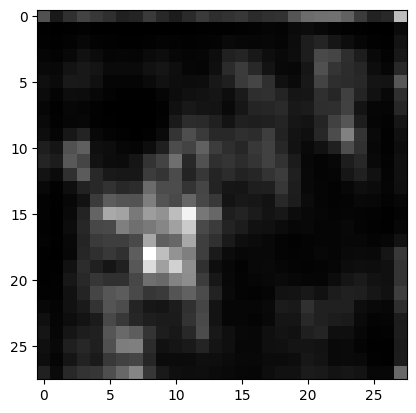

----------------------------------------


Discriminator Loss = 0.2116416096687317
Generator Loss = 2.5612971782684326
A sample image generated by the generator


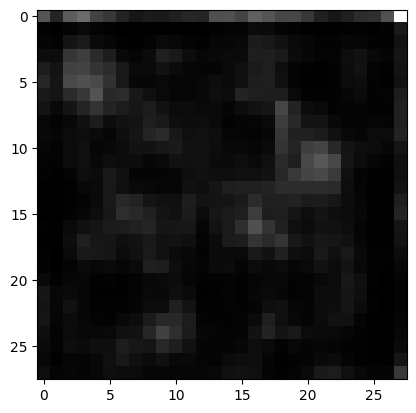

----------------------------------------


Discriminator Loss = 0.19274187088012695
Generator Loss = 2.517725944519043
A sample image generated by the generator


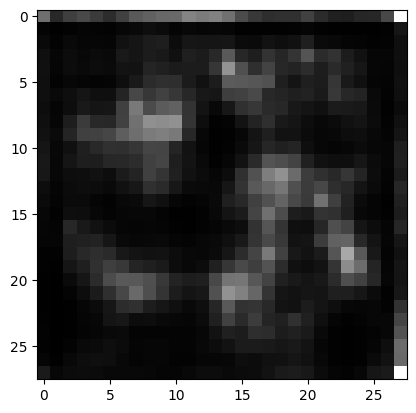

----------------------------------------


Discriminator Loss = 0.19740834832191467
Generator Loss = 2.4564871788024902
A sample image generated by the generator


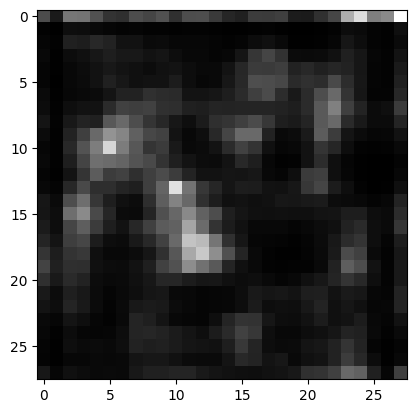

----------------------------------------


Discriminator Loss = 0.20084260404109955
Generator Loss = 2.574730396270752
A sample image generated by the generator


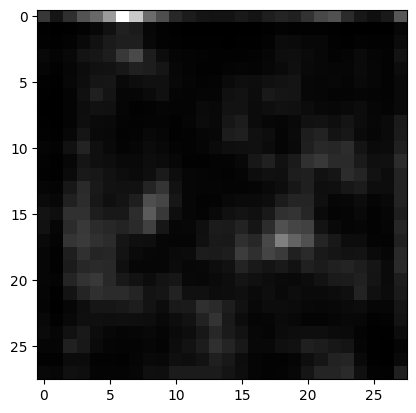

----------------------------------------


Discriminator Loss = 0.19878225028514862
Generator Loss = 2.5032601356506348
A sample image generated by the generator


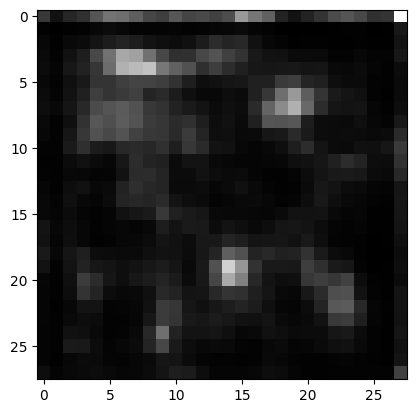

----------------------------------------


Discriminator Loss = 0.17946693301200867
Generator Loss = 2.5793116092681885
A sample image generated by the generator


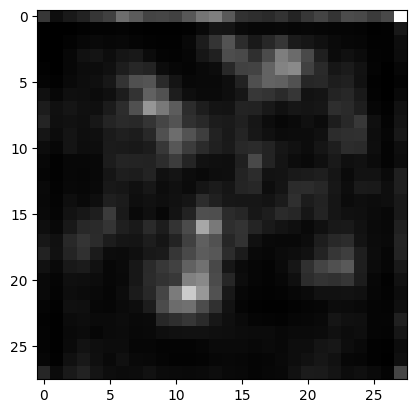

----------------------------------------


Discriminator Loss = 0.1931452751159668
Generator Loss = 2.5454928874969482
A sample image generated by the generator


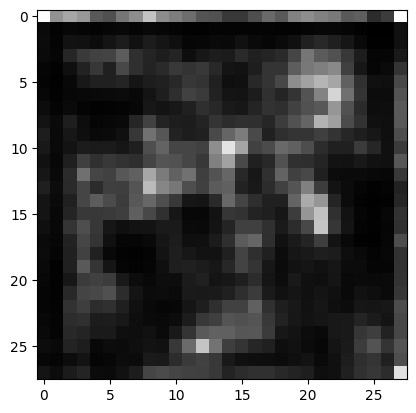

----------------------------------------


Discriminator Loss = 0.19912868738174438
Generator Loss = 2.48945951461792
A sample image generated by the generator


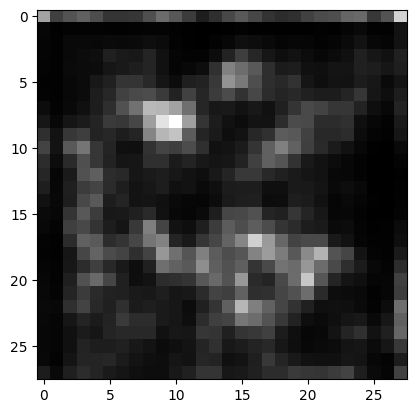

----------------------------------------


Discriminator Loss = 0.19812214374542236
Generator Loss = 2.546661376953125
A sample image generated by the generator


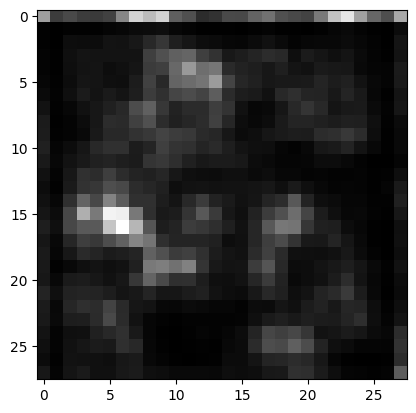

----------------------------------------


Discriminator Loss = 0.2135310173034668
Generator Loss = 2.508254051208496
A sample image generated by the generator


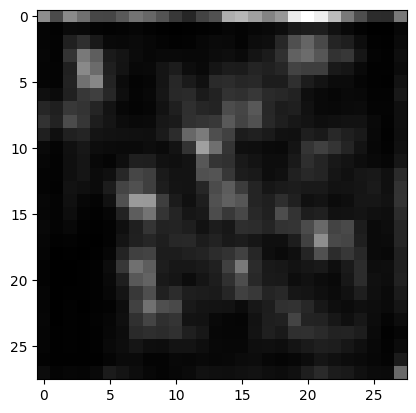

----------------------------------------


Discriminator Loss = 0.17407460510730743
Generator Loss = 2.5427839756011963
A sample image generated by the generator


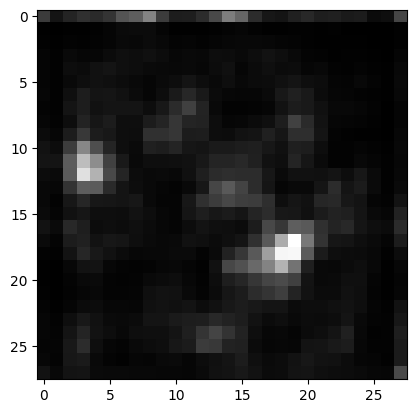

----------------------------------------


Discriminator Loss = 0.19555702805519104
Generator Loss = 2.5682132244110107
A sample image generated by the generator


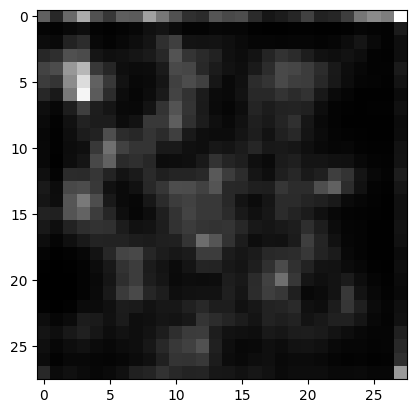

----------------------------------------


Discriminator Loss = 0.1808183342218399
Generator Loss = 2.483851432800293
A sample image generated by the generator


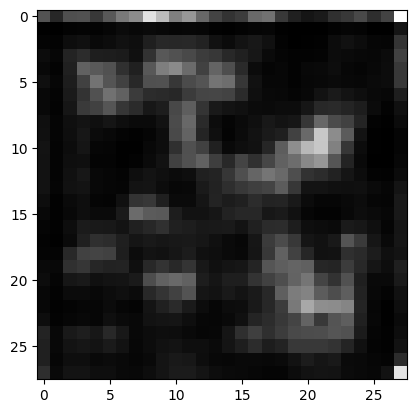

----------------------------------------


Discriminator Loss = 0.20014414191246033
Generator Loss = 2.5902862548828125
A sample image generated by the generator


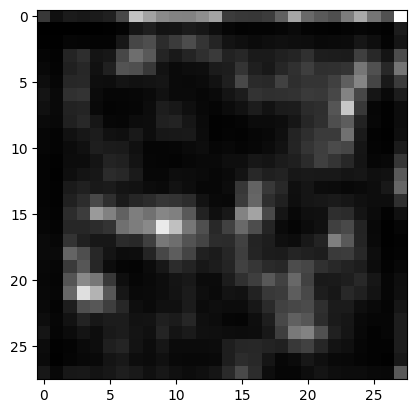

----------------------------------------


Discriminator Loss = 0.1969641149044037
Generator Loss = 2.5234813690185547
A sample image generated by the generator


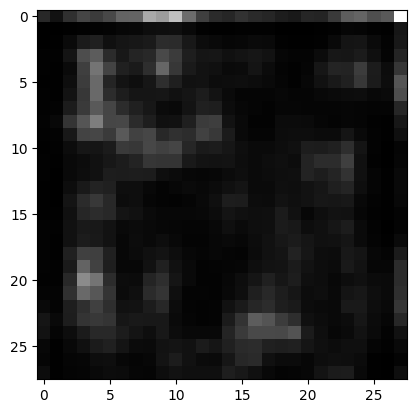

----------------------------------------


Discriminator Loss = 0.18867360055446625
Generator Loss = 2.564929723739624
A sample image generated by the generator


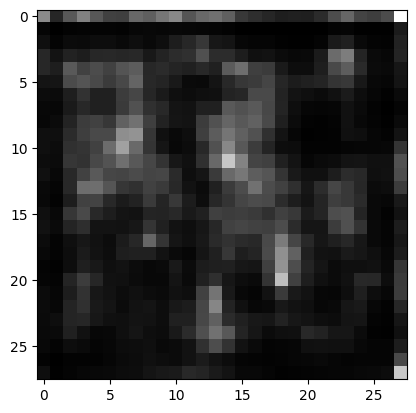

----------------------------------------


Discriminator Loss = 0.18098098039627075
Generator Loss = 2.4968371391296387
A sample image generated by the generator


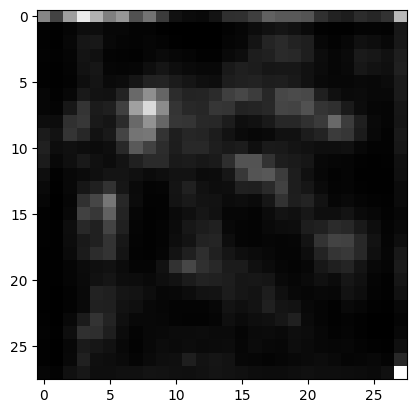

----------------------------------------


Discriminator Loss = 0.18281680345535278
Generator Loss = 2.596486806869507
A sample image generated by the generator


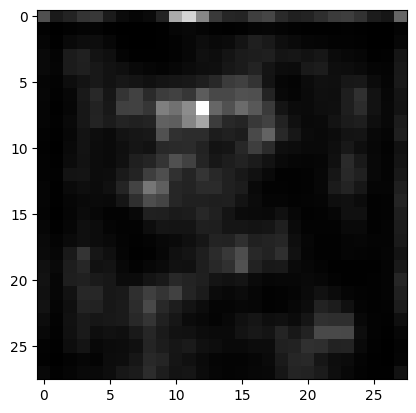

----------------------------------------


Discriminator Loss = 0.18578562140464783
Generator Loss = 2.655348539352417
A sample image generated by the generator


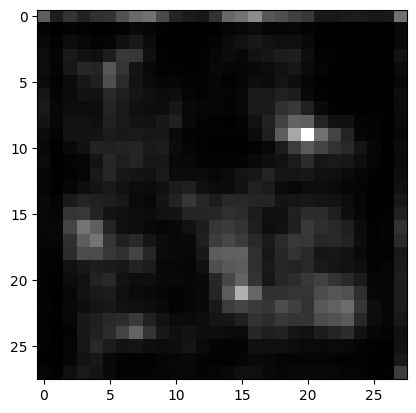

----------------------------------------


Discriminator Loss = 0.19541940093040466
Generator Loss = 2.562443733215332
A sample image generated by the generator


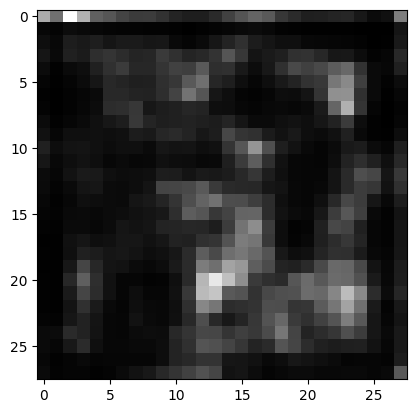

----------------------------------------


Discriminator Loss = 0.18952059745788574
Generator Loss = 2.5754201412200928
A sample image generated by the generator


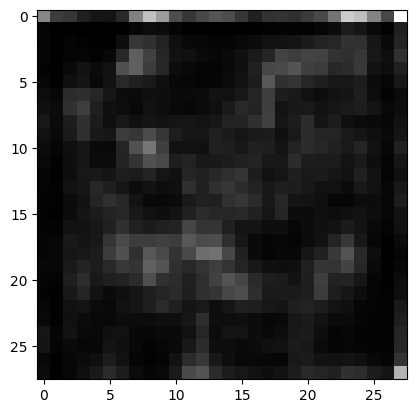

----------------------------------------


Discriminator Loss = 0.18487748503684998
Generator Loss = 2.5810739994049072
A sample image generated by the generator


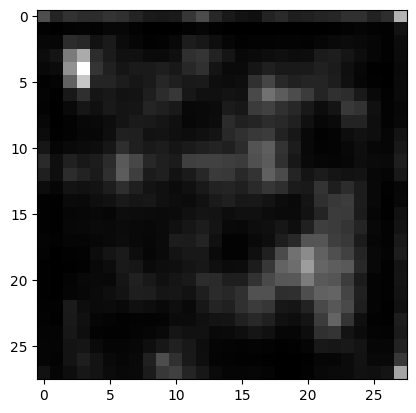

----------------------------------------


Discriminator Loss = 0.19207258522510529
Generator Loss = 2.573063850402832
A sample image generated by the generator


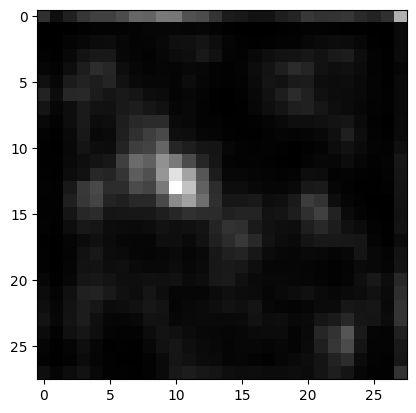

----------------------------------------


Discriminator Loss = 0.1878511905670166
Generator Loss = 2.663578510284424
A sample image generated by the generator


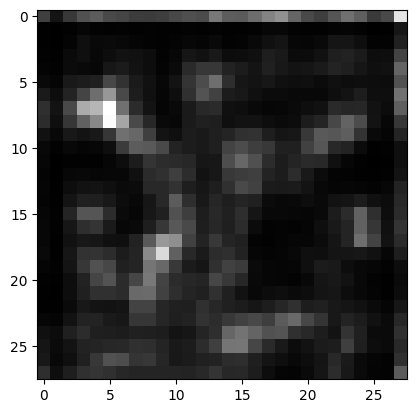

----------------------------------------


Discriminator Loss = 0.19390372931957245
Generator Loss = 2.596627712249756
A sample image generated by the generator


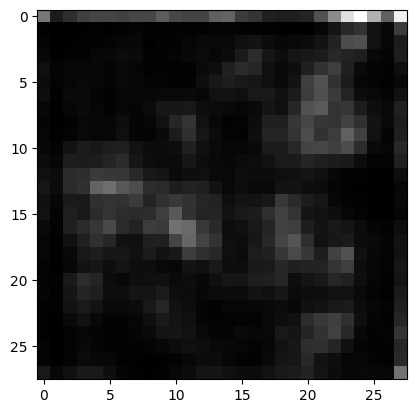

----------------------------------------


Discriminator Loss = 0.19874468445777893
Generator Loss = 2.583087682723999
A sample image generated by the generator


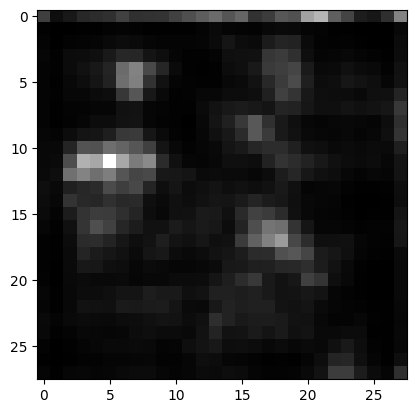

----------------------------------------


Discriminator Loss = 0.18792356550693512
Generator Loss = 2.489981174468994
A sample image generated by the generator


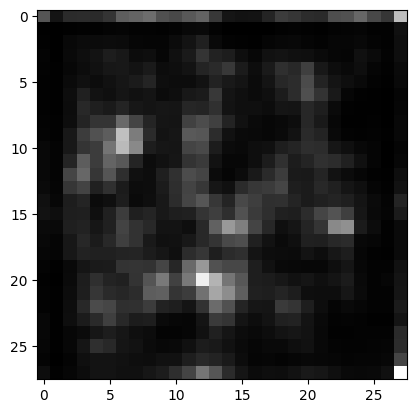

----------------------------------------


Discriminator Loss = 0.17910395562648773
Generator Loss = 2.533010244369507
A sample image generated by the generator


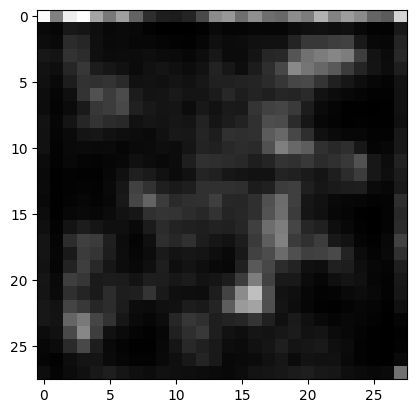

----------------------------------------


Discriminator Loss = 0.178728848695755
Generator Loss = 2.5682005882263184
A sample image generated by the generator


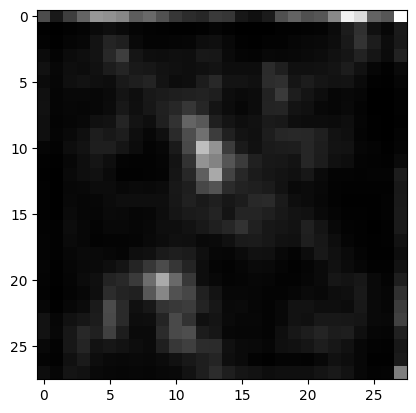

----------------------------------------


Discriminator Loss = 0.18854588270187378
Generator Loss = 2.5743613243103027
A sample image generated by the generator


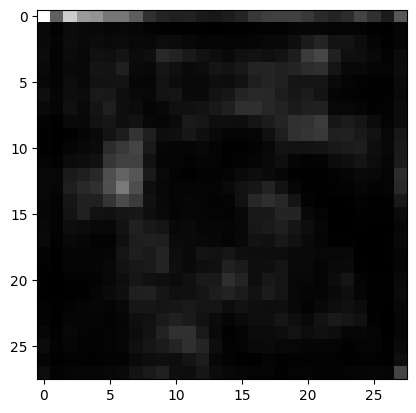

----------------------------------------


Discriminator Loss = 0.18217924237251282
Generator Loss = 2.54887056350708
A sample image generated by the generator


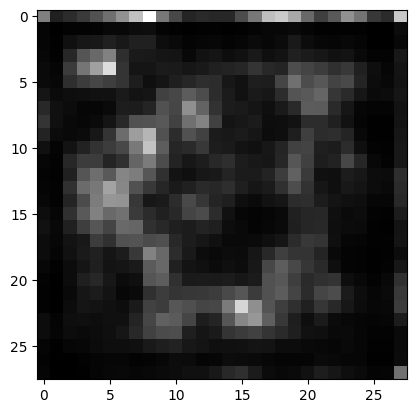

----------------------------------------


Discriminator Loss = 0.17194576561450958
Generator Loss = 2.560887575149536
A sample image generated by the generator


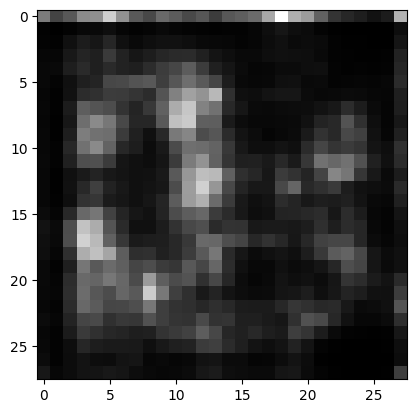

----------------------------------------


Discriminator Loss = 0.1947900950908661
Generator Loss = 2.4506516456604004
A sample image generated by the generator


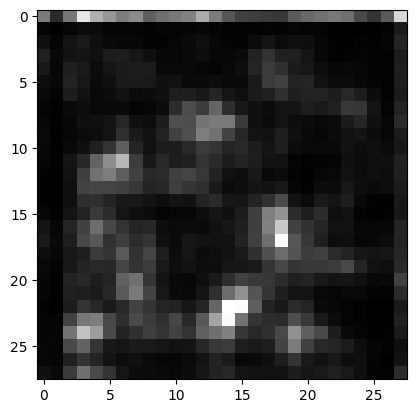

----------------------------------------


Discriminator Loss = 0.17663422226905823
Generator Loss = 2.5396127700805664
A sample image generated by the generator


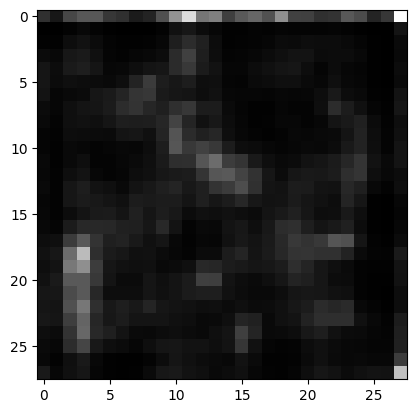

----------------------------------------


Discriminator Loss = 0.1781584769487381
Generator Loss = 2.638450860977173
A sample image generated by the generator


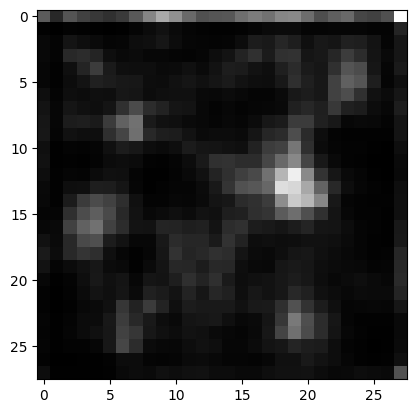

----------------------------------------


Discriminator Loss = 0.20292140543460846
Generator Loss = 2.6139020919799805
A sample image generated by the generator


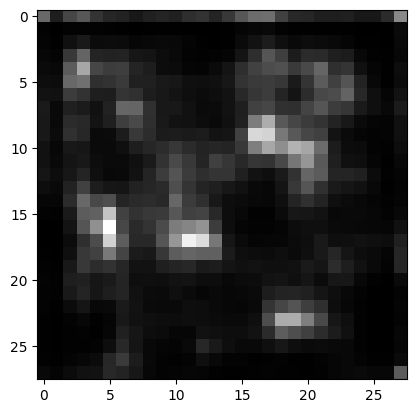

----------------------------------------


Discriminator Loss = 0.1991215944290161
Generator Loss = 2.491048812866211
A sample image generated by the generator


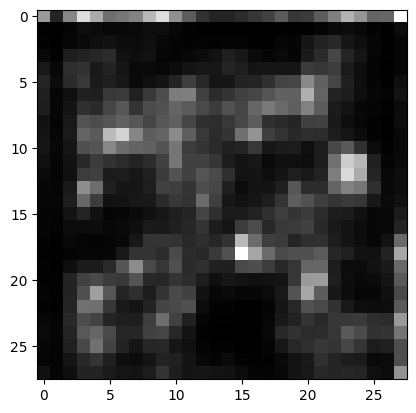

----------------------------------------


Discriminator Loss = 0.1744435876607895
Generator Loss = 2.6417183876037598
A sample image generated by the generator


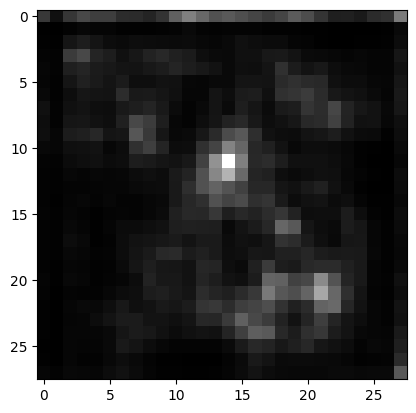

----------------------------------------


Discriminator Loss = 0.18543267250061035
Generator Loss = 2.5616209506988525
A sample image generated by the generator


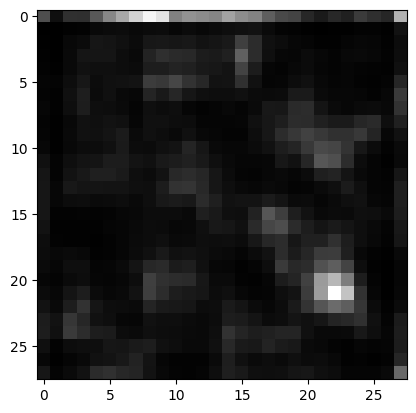

----------------------------------------


Discriminator Loss = 0.17393773794174194
Generator Loss = 2.555748701095581
A sample image generated by the generator


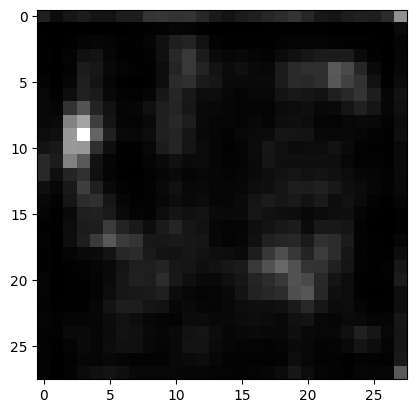

----------------------------------------


Discriminator Loss = 0.17565211653709412
Generator Loss = 2.7114477157592773
A sample image generated by the generator


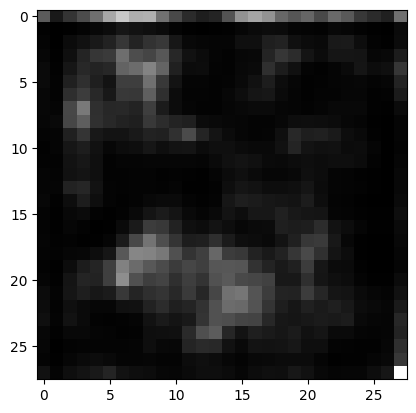

----------------------------------------


Discriminator Loss = 0.1892794668674469
Generator Loss = 2.651350736618042
A sample image generated by the generator


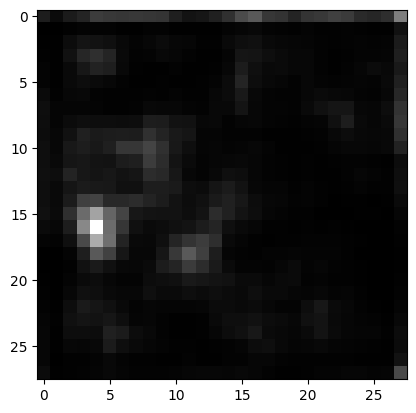

----------------------------------------


Discriminator Loss = 0.1756032407283783
Generator Loss = 2.5982460975646973
A sample image generated by the generator


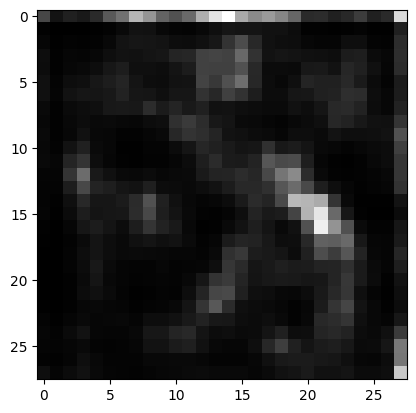

----------------------------------------


Discriminator Loss = 0.1929214745759964
Generator Loss = 2.5755624771118164
A sample image generated by the generator


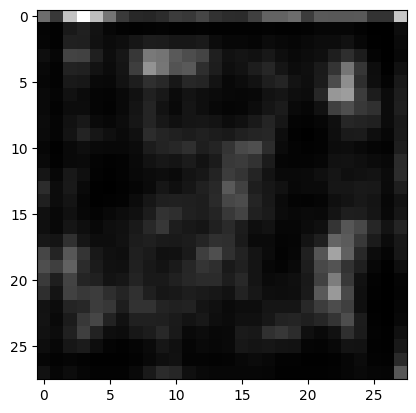

----------------------------------------


Discriminator Loss = 0.16853810846805573
Generator Loss = 2.631687641143799
A sample image generated by the generator


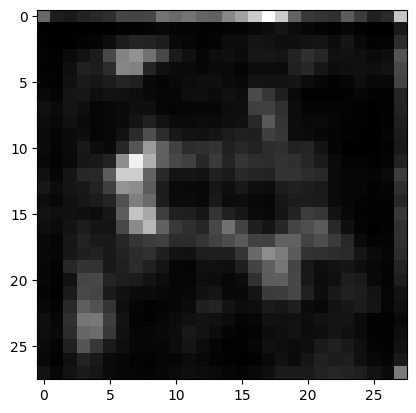

----------------------------------------


Discriminator Loss = 0.18365256488323212
Generator Loss = 2.519252061843872
A sample image generated by the generator


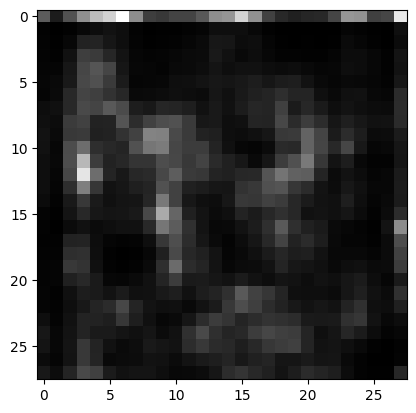

----------------------------------------


Discriminator Loss = 0.17449826002120972
Generator Loss = 2.625265121459961
A sample image generated by the generator


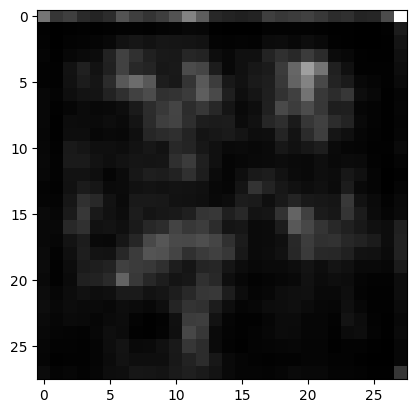

----------------------------------------


Discriminator Loss = 0.18444722890853882
Generator Loss = 2.614586353302002
A sample image generated by the generator


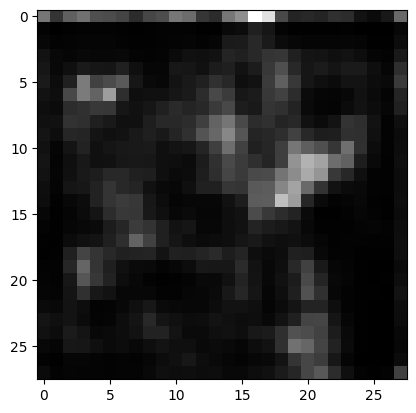

----------------------------------------


Discriminator Loss = 0.19098041951656342
Generator Loss = 2.6323909759521484
A sample image generated by the generator


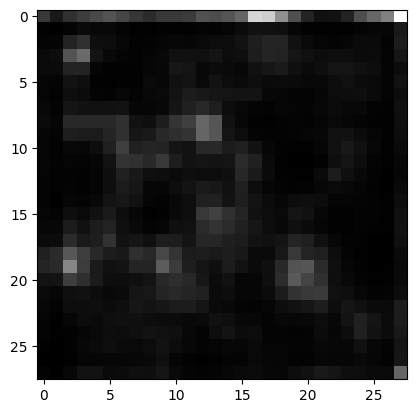

----------------------------------------


Discriminator Loss = 0.181743323802948
Generator Loss = 2.656708002090454
A sample image generated by the generator


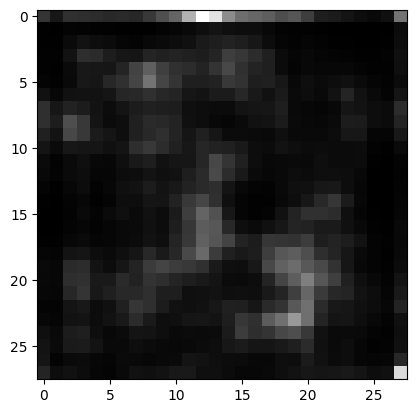

----------------------------------------


Discriminator Loss = 0.18820273876190186
Generator Loss = 2.655545473098755
A sample image generated by the generator


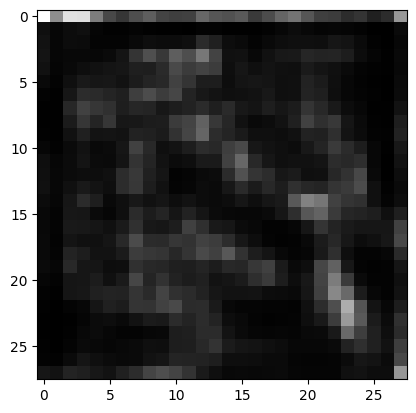

----------------------------------------


Discriminator Loss = 0.1807190179824829
Generator Loss = 2.649188995361328
A sample image generated by the generator


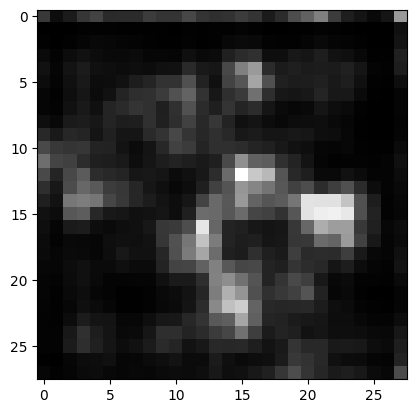

----------------------------------------


Discriminator Loss = 0.1860034018754959
Generator Loss = 2.594125270843506
A sample image generated by the generator


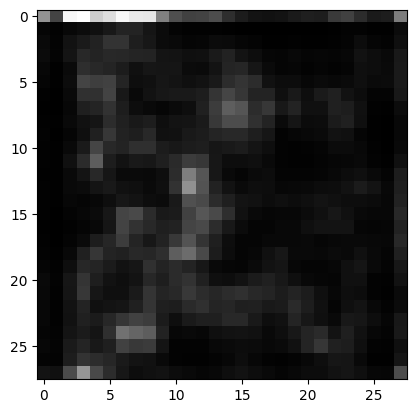

----------------------------------------


Discriminator Loss = 0.19481444358825684
Generator Loss = 2.5382728576660156
A sample image generated by the generator


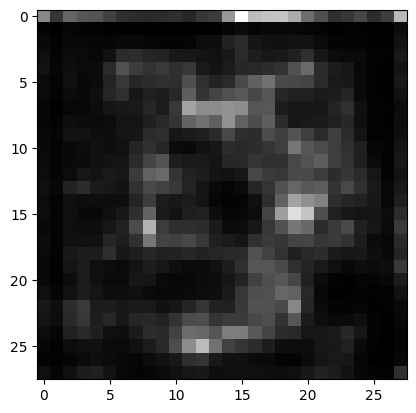

----------------------------------------


Discriminator Loss = 0.17974047362804413
Generator Loss = 2.6475162506103516
A sample image generated by the generator


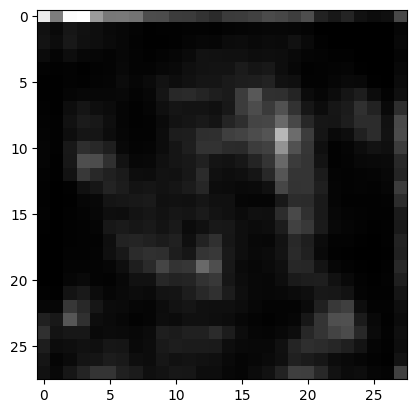

----------------------------------------


Discriminator Loss = 0.19488224387168884
Generator Loss = 2.6225390434265137
A sample image generated by the generator


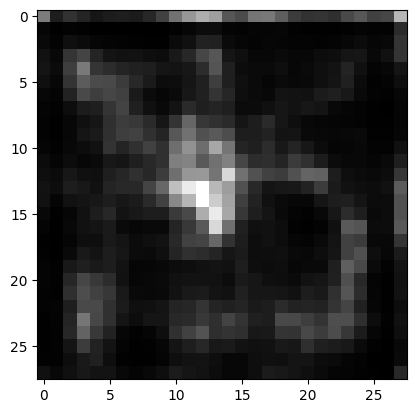

----------------------------------------


Discriminator Loss = 0.1765247881412506
Generator Loss = 2.599639892578125
A sample image generated by the generator


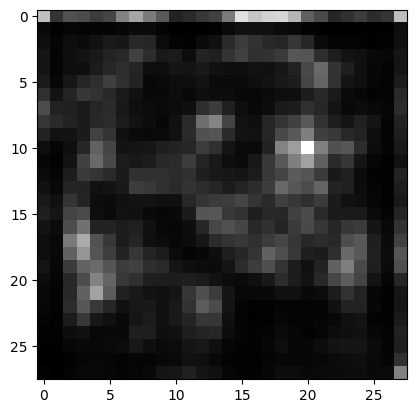

----------------------------------------


Discriminator Loss = 0.18632856011390686
Generator Loss = 2.5405917167663574
A sample image generated by the generator


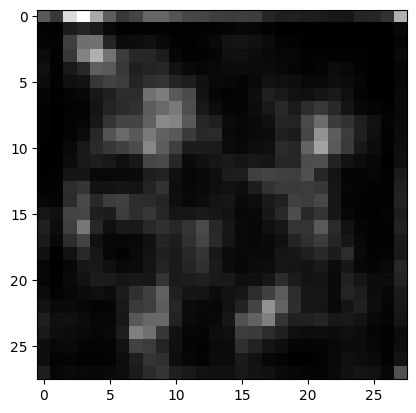

----------------------------------------


Discriminator Loss = 0.18606515228748322
Generator Loss = 2.5289411544799805
A sample image generated by the generator


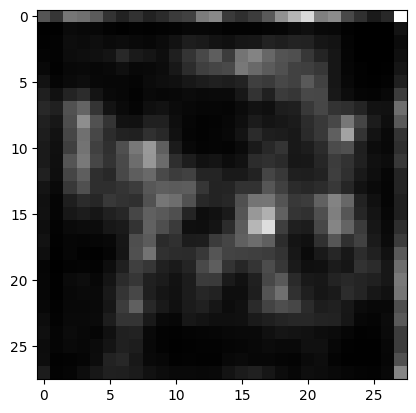

----------------------------------------


Discriminator Loss = 0.1742057204246521
Generator Loss = 2.58676815032959
A sample image generated by the generator


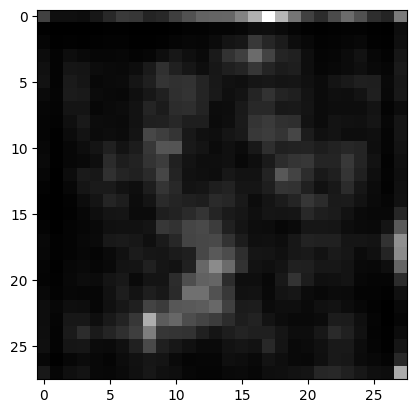

----------------------------------------


Discriminator Loss = 0.1741028130054474
Generator Loss = 2.6017260551452637
A sample image generated by the generator


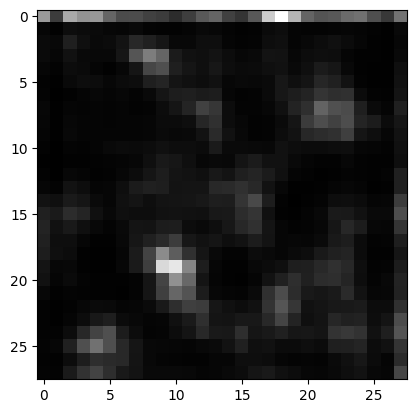

----------------------------------------


Discriminator Loss = 0.16691763699054718
Generator Loss = 2.569486379623413
A sample image generated by the generator


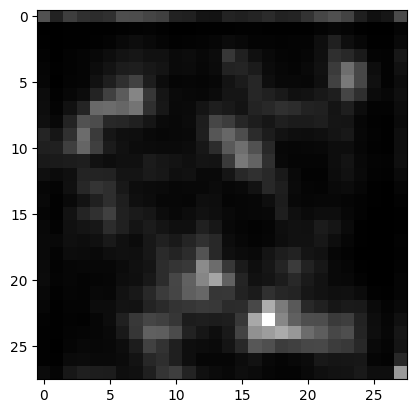

----------------------------------------


Discriminator Loss = 0.1782469004392624
Generator Loss = 2.5678043365478516
A sample image generated by the generator


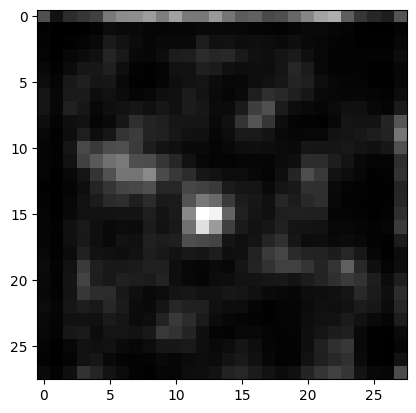

----------------------------------------


Discriminator Loss = 0.16897320747375488
Generator Loss = 2.551523208618164
A sample image generated by the generator


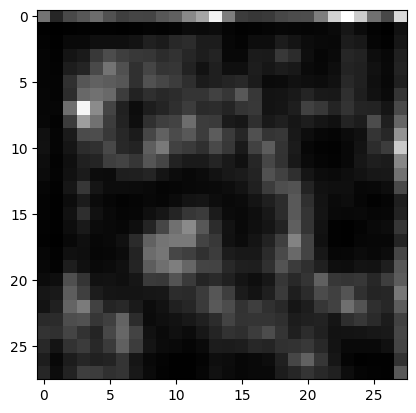

----------------------------------------


Discriminator Loss = 0.16699780523777008
Generator Loss = 2.6318421363830566
A sample image generated by the generator


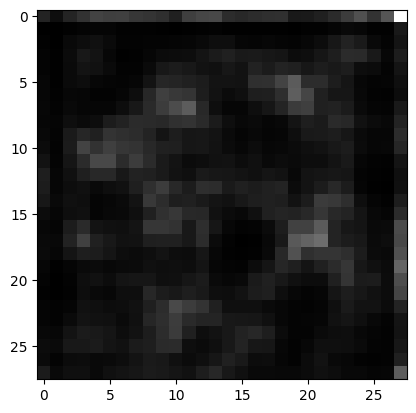

----------------------------------------


Discriminator Loss = 0.17200356721878052
Generator Loss = 2.7475295066833496
A sample image generated by the generator


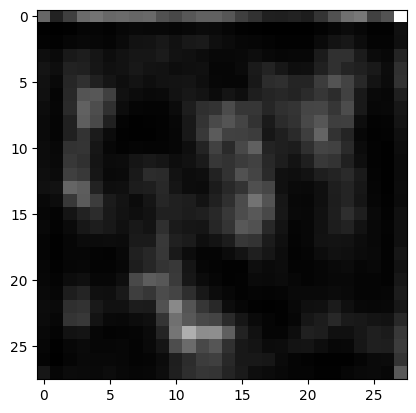

----------------------------------------


Discriminator Loss = 0.16983424127101898
Generator Loss = 2.5684895515441895
A sample image generated by the generator


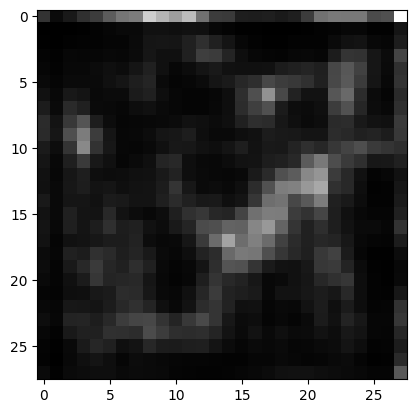

----------------------------------------


Discriminator Loss = 0.16955286264419556
Generator Loss = 2.655637264251709
A sample image generated by the generator


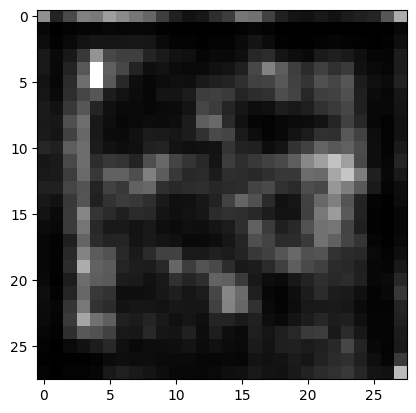

----------------------------------------


Discriminator Loss = 0.1731061339378357
Generator Loss = 2.628929615020752
A sample image generated by the generator


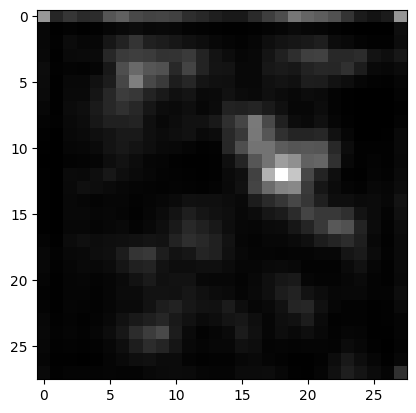

----------------------------------------


Discriminator Loss = 0.18098235130310059
Generator Loss = 2.6189348697662354
A sample image generated by the generator


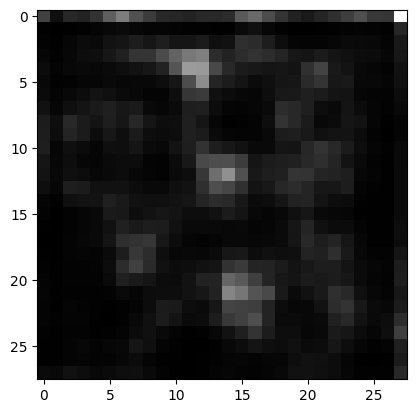

----------------------------------------


Discriminator Loss = 0.17326180636882782
Generator Loss = 2.656747817993164
A sample image generated by the generator


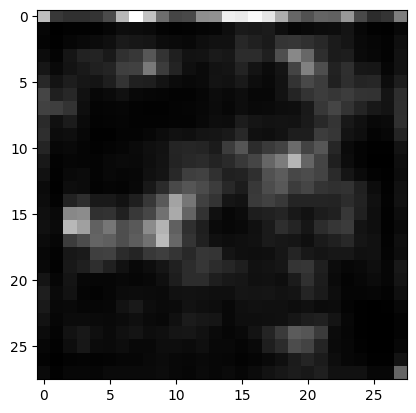

----------------------------------------


Discriminator Loss = 0.182807058095932
Generator Loss = 2.524951457977295
A sample image generated by the generator


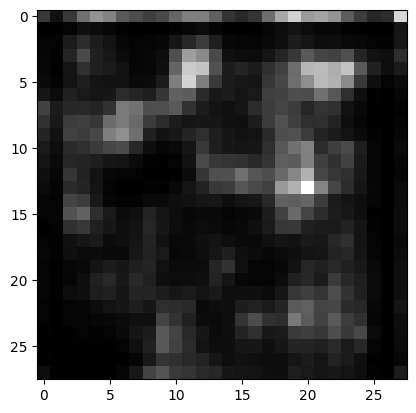

----------------------------------------


Discriminator Loss = 0.16504532098770142
Generator Loss = 2.521883010864258
A sample image generated by the generator


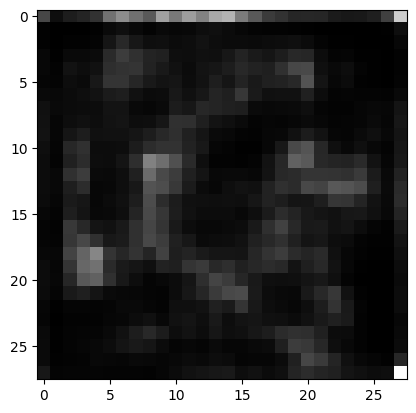

----------------------------------------


Discriminator Loss = 0.17247973382472992
Generator Loss = 2.594926118850708
A sample image generated by the generator


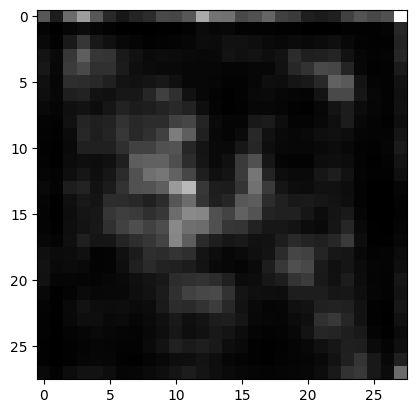

----------------------------------------


Discriminator Loss = 0.16730698943138123
Generator Loss = 2.6330556869506836
A sample image generated by the generator


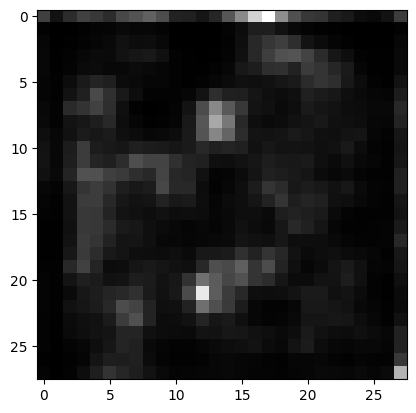

----------------------------------------


Discriminator Loss = 0.18395955860614777
Generator Loss = 2.6406209468841553
A sample image generated by the generator


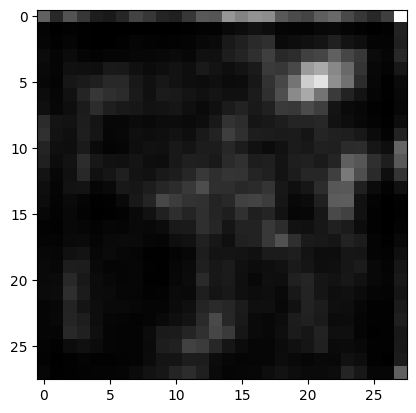

----------------------------------------


Discriminator Loss = 0.16244181990623474
Generator Loss = 2.6729235649108887
A sample image generated by the generator


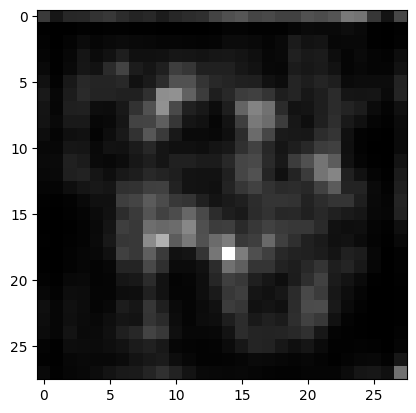

----------------------------------------


Discriminator Loss = 0.1623874008655548
Generator Loss = 2.5297815799713135
A sample image generated by the generator


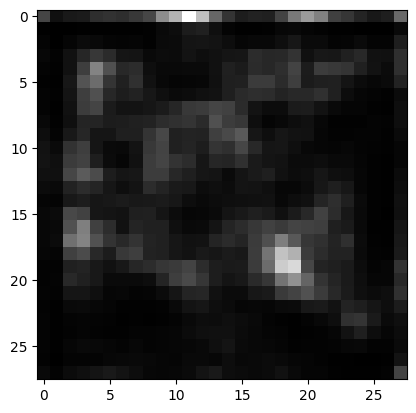

----------------------------------------


Discriminator Loss = 0.17170752584934235
Generator Loss = 2.694333076477051
A sample image generated by the generator


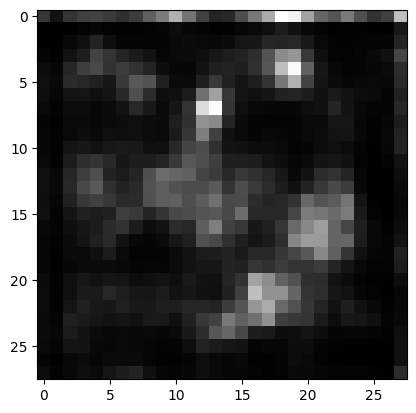

----------------------------------------


Discriminator Loss = 0.1709250509738922
Generator Loss = 2.629183769226074
A sample image generated by the generator


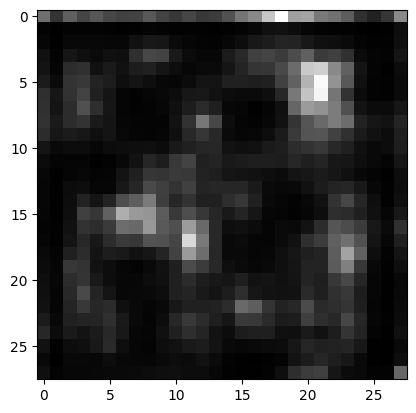

----------------------------------------


Discriminator Loss = 0.18003252148628235
Generator Loss = 2.667750358581543
A sample image generated by the generator


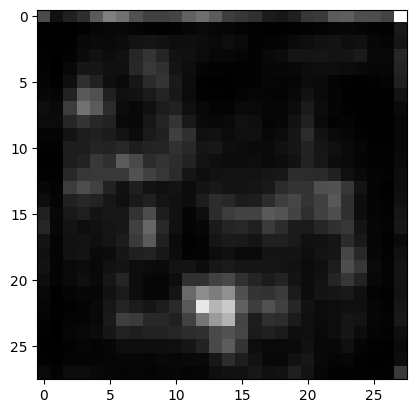

----------------------------------------


Discriminator Loss = 0.16868183016777039
Generator Loss = 2.6742377281188965
A sample image generated by the generator


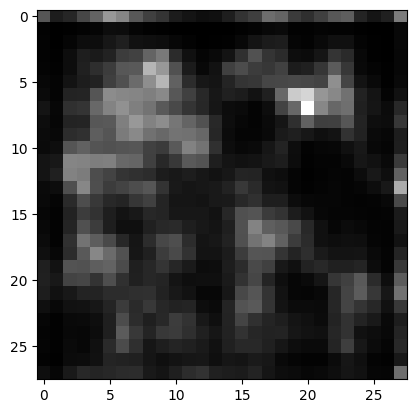

----------------------------------------


Discriminator Loss = 0.16200807690620422
Generator Loss = 2.6864354610443115
A sample image generated by the generator


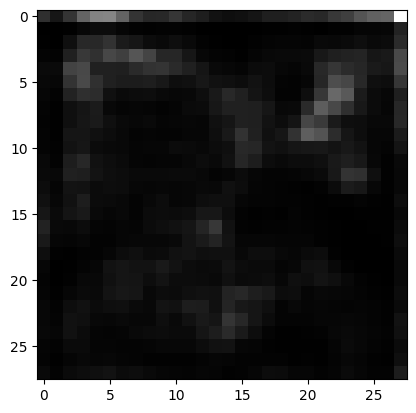

----------------------------------------


Discriminator Loss = 0.18152613937854767
Generator Loss = 2.5467119216918945
A sample image generated by the generator


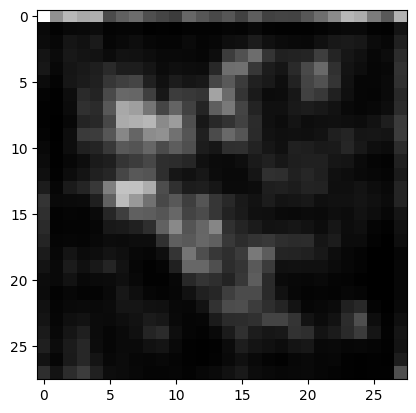

----------------------------------------


Discriminator Loss = 0.18015101552009583
Generator Loss = 2.717771291732788
A sample image generated by the generator


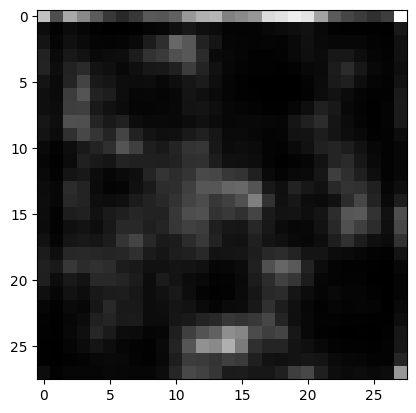

----------------------------------------


Discriminator Loss = 0.17916950583457947
Generator Loss = 2.594294548034668
A sample image generated by the generator


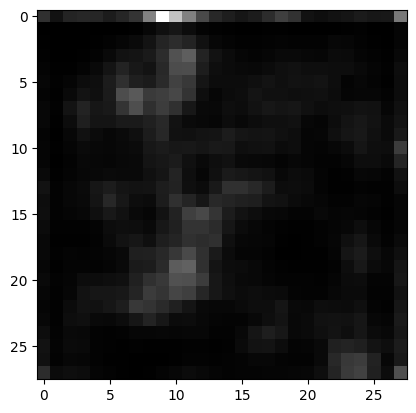

----------------------------------------


Discriminator Loss = 0.16690784692764282
Generator Loss = 2.6268348693847656
A sample image generated by the generator


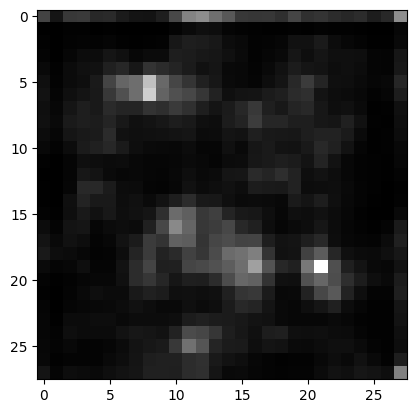

----------------------------------------


Discriminator Loss = 0.169573575258255
Generator Loss = 2.600616693496704
A sample image generated by the generator


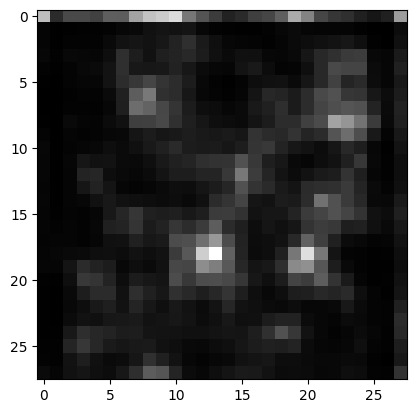

----------------------------------------


Discriminator Loss = 0.16928479075431824
Generator Loss = 2.5618326663970947
A sample image generated by the generator


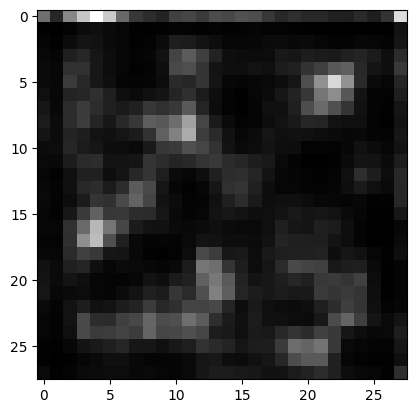

----------------------------------------


Discriminator Loss = 0.16055777668952942
Generator Loss = 2.5957579612731934
A sample image generated by the generator


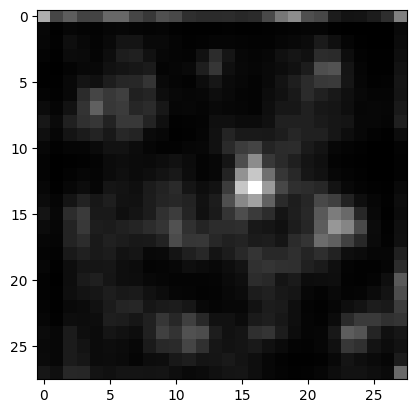

----------------------------------------


Discriminator Loss = 0.174594908952713
Generator Loss = 2.660665512084961
A sample image generated by the generator


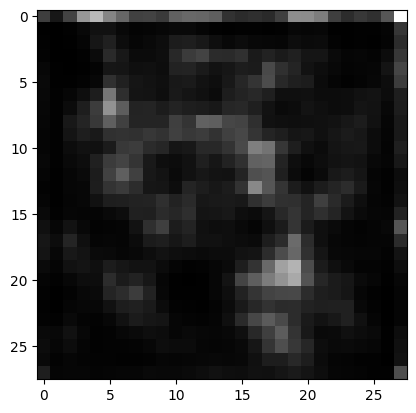

----------------------------------------


Discriminator Loss = 0.17814216017723083
Generator Loss = 2.6490390300750732
A sample image generated by the generator


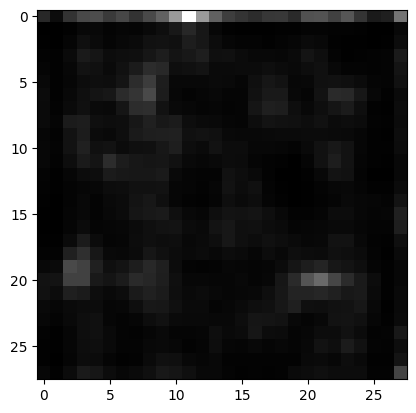

----------------------------------------


Discriminator Loss = 0.1752597689628601
Generator Loss = 2.6331472396850586
A sample image generated by the generator


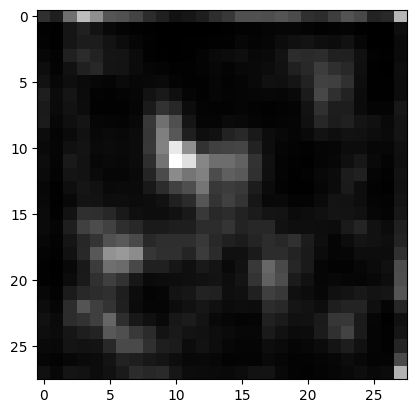

----------------------------------------


Discriminator Loss = 0.16869638860225677
Generator Loss = 2.7081899642944336
A sample image generated by the generator


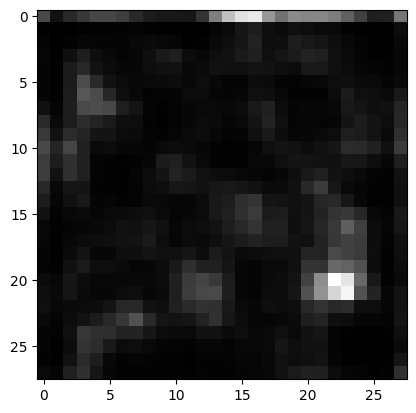

----------------------------------------


Discriminator Loss = 0.17611432075500488
Generator Loss = 2.590975284576416
A sample image generated by the generator


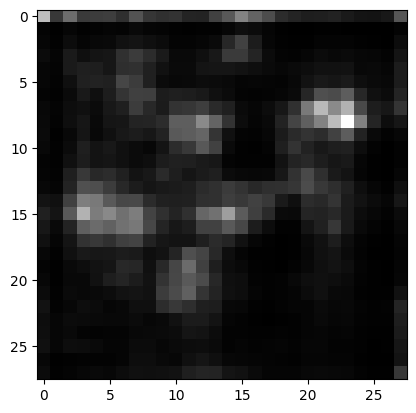

----------------------------------------


Discriminator Loss = 0.1605665385723114
Generator Loss = 2.5876665115356445
A sample image generated by the generator


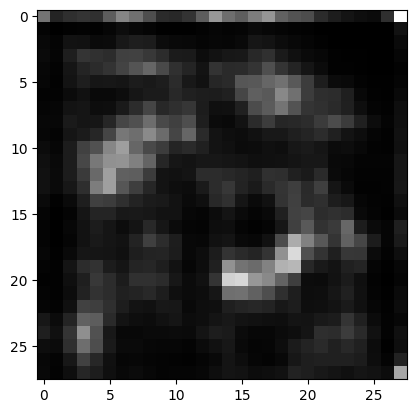

----------------------------------------


Discriminator Loss = 0.16725757718086243
Generator Loss = 2.668403148651123
A sample image generated by the generator


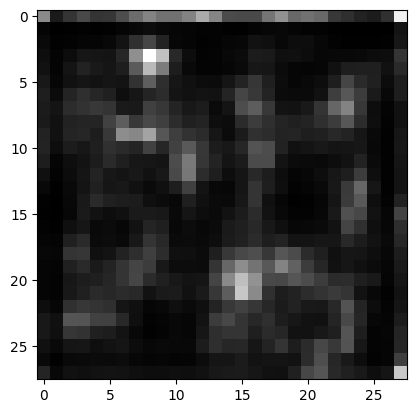

----------------------------------------


Discriminator Loss = 0.15881772339344025
Generator Loss = 2.5821328163146973
A sample image generated by the generator


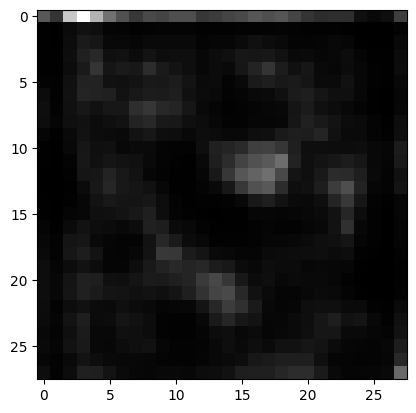

----------------------------------------


Discriminator Loss = 0.16196733713150024
Generator Loss = 2.7118659019470215
A sample image generated by the generator


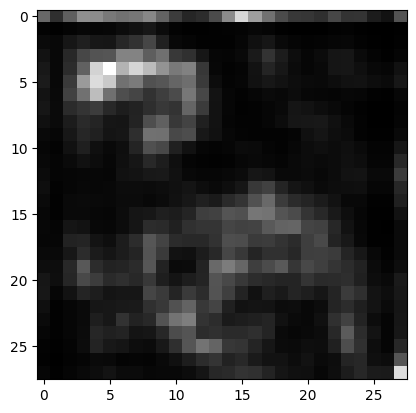

----------------------------------------


Discriminator Loss = 0.17524100840091705
Generator Loss = 2.730959415435791
A sample image generated by the generator


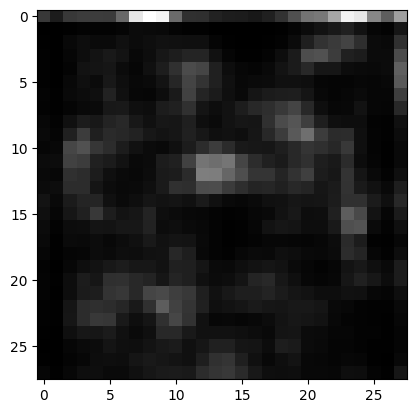

----------------------------------------


Discriminator Loss = 0.17207050323486328
Generator Loss = 2.6413488388061523
A sample image generated by the generator


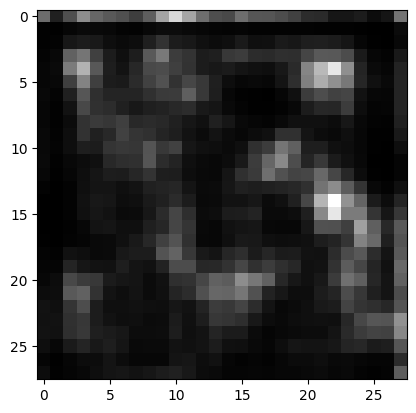

----------------------------------------


Discriminator Loss = 0.17142175137996674
Generator Loss = 2.7319107055664062
A sample image generated by the generator


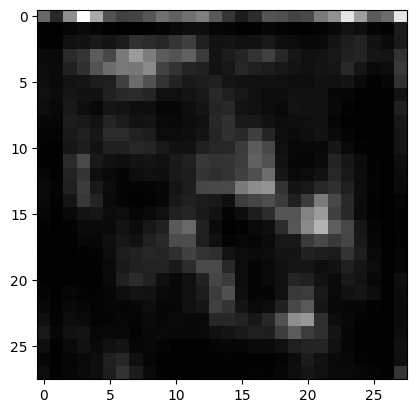

----------------------------------------


Discriminator Loss = 0.16173924505710602
Generator Loss = 2.6676220893859863
A sample image generated by the generator


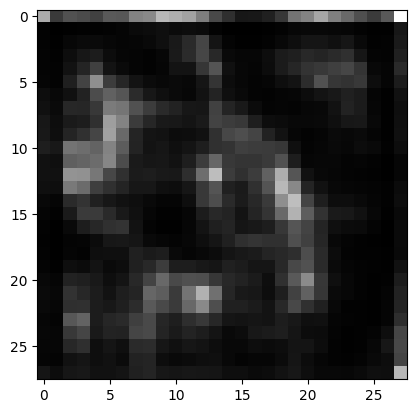

----------------------------------------


Discriminator Loss = 0.17618152499198914
Generator Loss = 2.643555164337158
A sample image generated by the generator


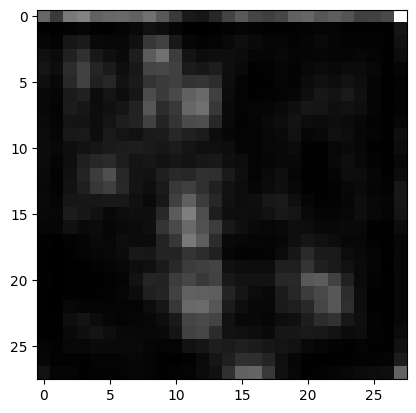

----------------------------------------


Discriminator Loss = 0.1640431135892868
Generator Loss = 2.535721778869629
A sample image generated by the generator


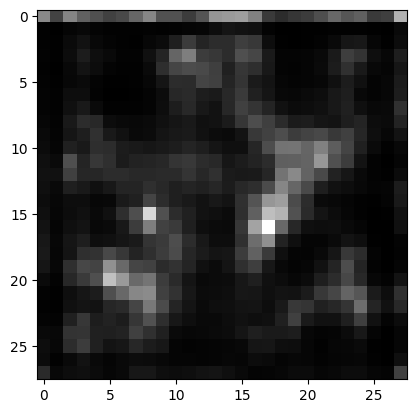

----------------------------------------


Discriminator Loss = 0.17592662572860718
Generator Loss = 2.7145047187805176
A sample image generated by the generator


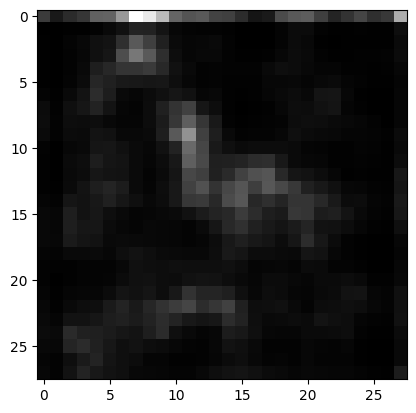

----------------------------------------


Discriminator Loss = 0.16410773992538452
Generator Loss = 2.8658480644226074
A sample image generated by the generator


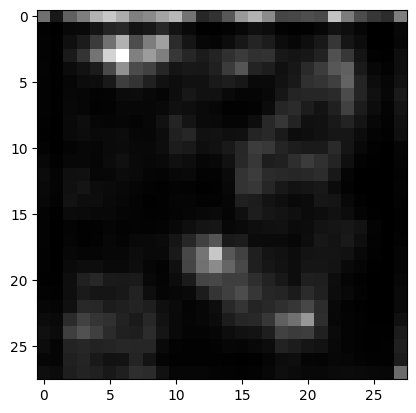

----------------------------------------


Discriminator Loss = 0.17204344272613525
Generator Loss = 2.6434450149536133
A sample image generated by the generator


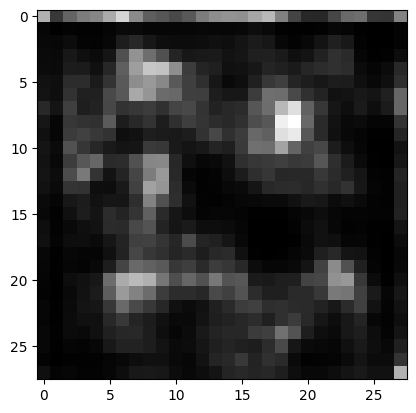

----------------------------------------


Discriminator Loss = 0.17431840300559998
Generator Loss = 2.7715935707092285
A sample image generated by the generator


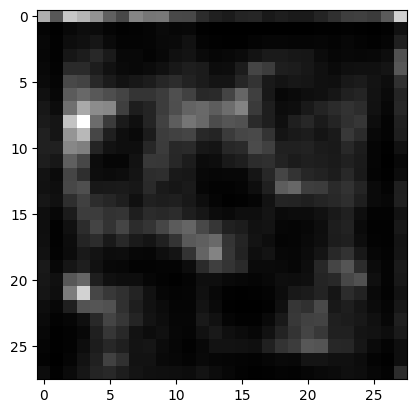

----------------------------------------


Discriminator Loss = 0.16684579849243164
Generator Loss = 2.714622735977173
A sample image generated by the generator


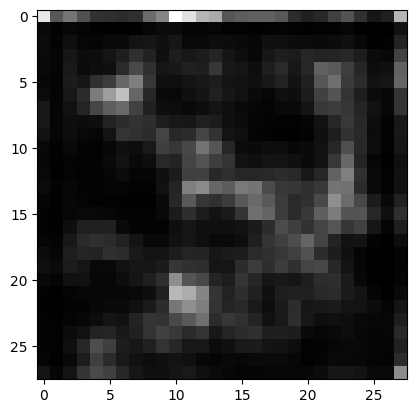

----------------------------------------


Discriminator Loss = 0.1522371768951416
Generator Loss = 2.6833608150482178
A sample image generated by the generator


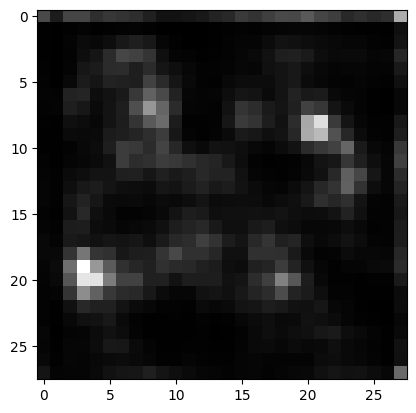

----------------------------------------


Discriminator Loss = 0.16041073203086853
Generator Loss = 2.716249942779541
A sample image generated by the generator


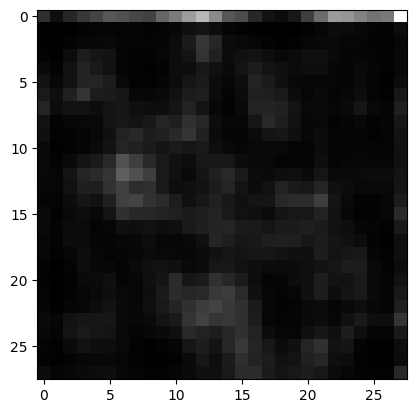

----------------------------------------


Discriminator Loss = 0.15655988454818726
Generator Loss = 2.7028591632843018
A sample image generated by the generator


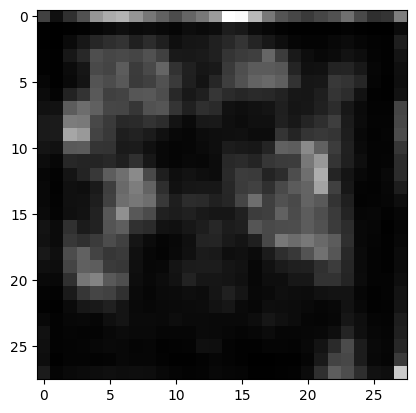

----------------------------------------


Discriminator Loss = 0.1910424828529358
Generator Loss = 2.720999002456665
A sample image generated by the generator


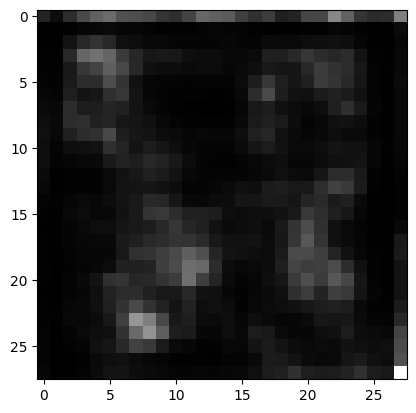

----------------------------------------


Discriminator Loss = 0.1581161916255951
Generator Loss = 2.7884113788604736
A sample image generated by the generator


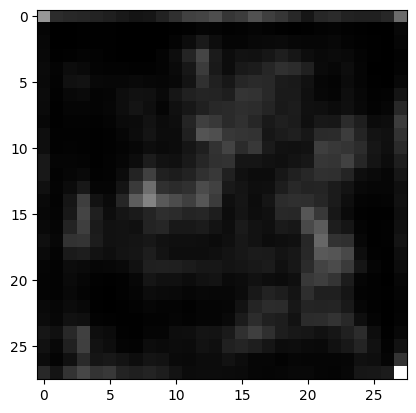

----------------------------------------


Discriminator Loss = 0.18491435050964355
Generator Loss = 2.587451934814453
A sample image generated by the generator


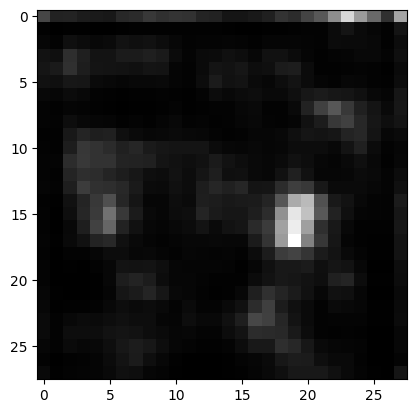

----------------------------------------


Discriminator Loss = 0.16493108868598938
Generator Loss = 2.670041799545288
A sample image generated by the generator


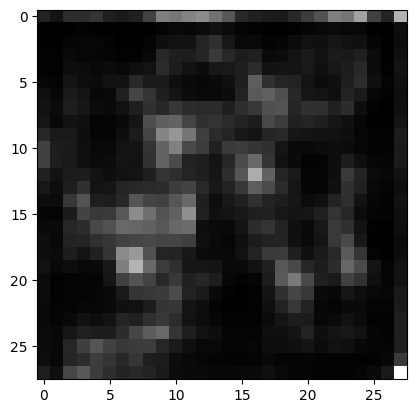

----------------------------------------


Discriminator Loss = 0.1555158495903015
Generator Loss = 2.745152473449707
A sample image generated by the generator


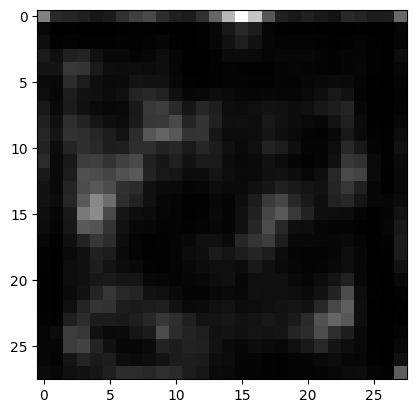

----------------------------------------


Discriminator Loss = 0.16699492931365967
Generator Loss = 2.7379462718963623
A sample image generated by the generator


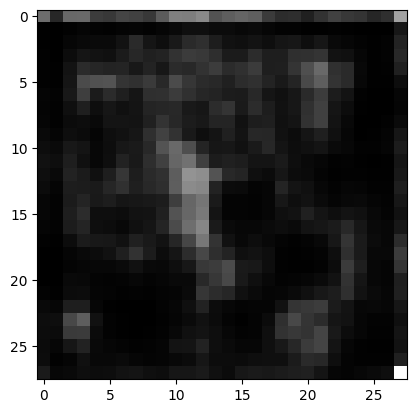

----------------------------------------


Discriminator Loss = 0.15184155106544495
Generator Loss = 2.752342700958252
A sample image generated by the generator


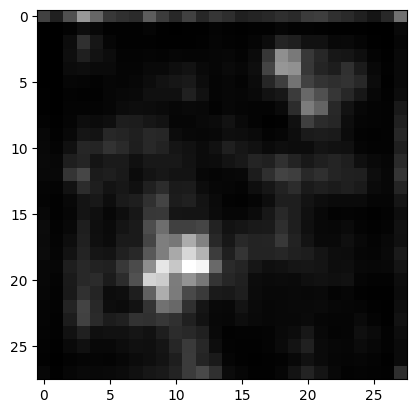

----------------------------------------


Discriminator Loss = 0.15730243921279907
Generator Loss = 2.6631579399108887
A sample image generated by the generator


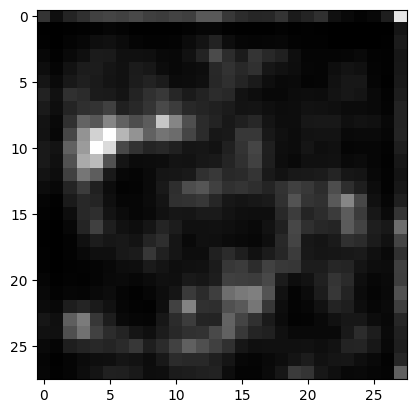

----------------------------------------


Discriminator Loss = 0.1776920109987259
Generator Loss = 2.6468076705932617
A sample image generated by the generator


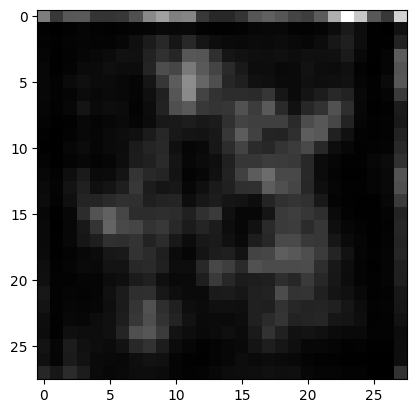

----------------------------------------


Discriminator Loss = 0.17362231016159058
Generator Loss = 2.673330307006836
A sample image generated by the generator


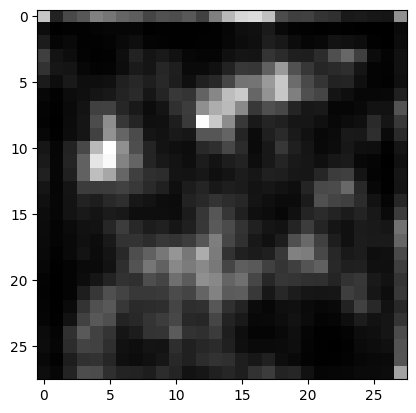

----------------------------------------


Discriminator Loss = 0.17684635519981384
Generator Loss = 2.5987844467163086
A sample image generated by the generator


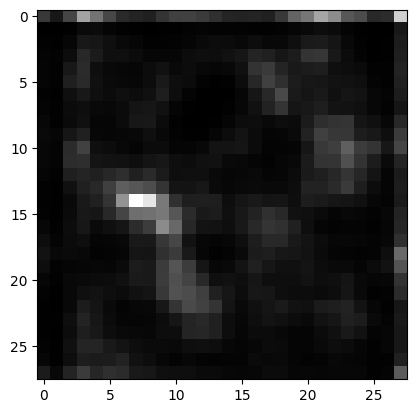

----------------------------------------


Discriminator Loss = 0.1656019389629364
Generator Loss = 2.726625680923462
A sample image generated by the generator


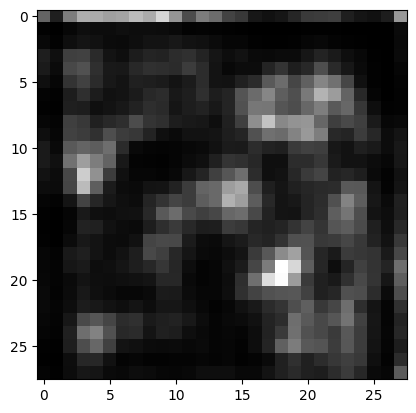

----------------------------------------


Discriminator Loss = 0.18071046471595764
Generator Loss = 2.771028995513916
A sample image generated by the generator


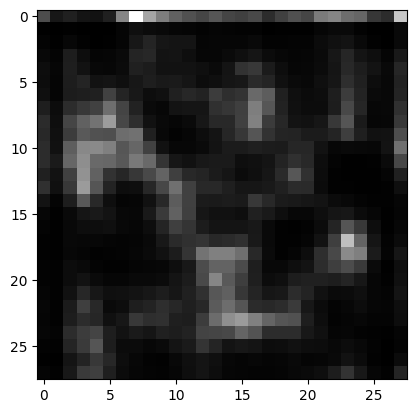

----------------------------------------


Discriminator Loss = 0.16914881765842438
Generator Loss = 2.6646692752838135
A sample image generated by the generator


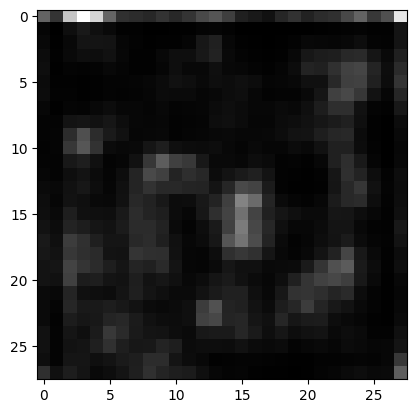

----------------------------------------


Discriminator Loss = 0.16892464458942413
Generator Loss = 2.735119104385376
A sample image generated by the generator


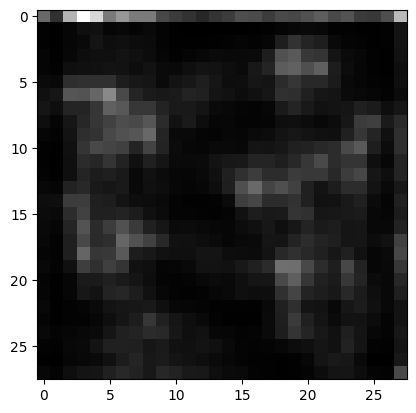

----------------------------------------


Discriminator Loss = 0.16654421389102936
Generator Loss = 2.6183300018310547
A sample image generated by the generator


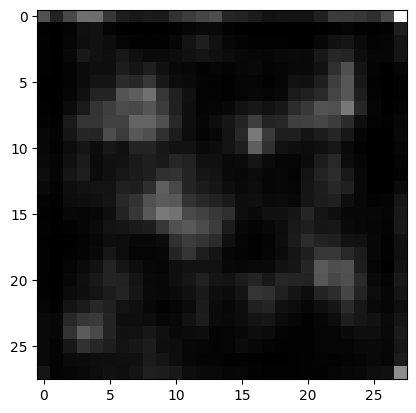

----------------------------------------


Discriminator Loss = 0.1564604938030243
Generator Loss = 2.664851665496826
A sample image generated by the generator


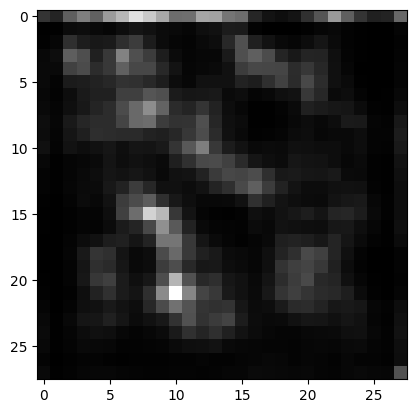

----------------------------------------


Discriminator Loss = 0.14771409332752228
Generator Loss = 2.7288191318511963
A sample image generated by the generator


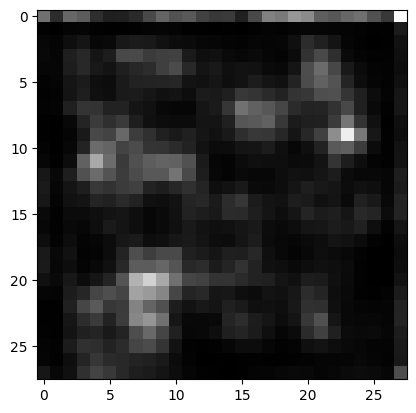

----------------------------------------


Discriminator Loss = 0.16497747600078583
Generator Loss = 2.7252769470214844
A sample image generated by the generator


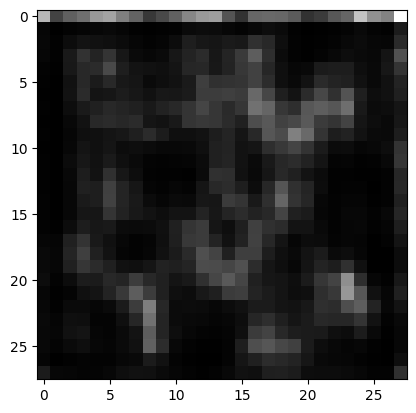

----------------------------------------


Discriminator Loss = 0.1547263264656067
Generator Loss = 2.7482376098632812
A sample image generated by the generator


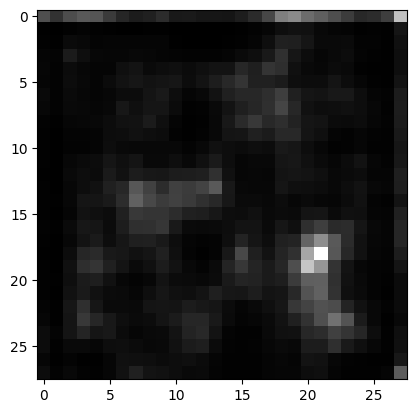

----------------------------------------


Discriminator Loss = 0.1641705185174942
Generator Loss = 2.7066545486450195
A sample image generated by the generator


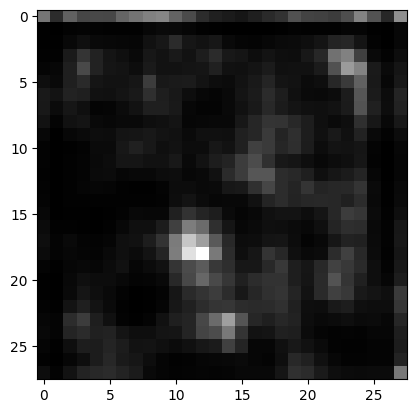

----------------------------------------


Discriminator Loss = 0.16858424246311188
Generator Loss = 2.628232479095459
A sample image generated by the generator


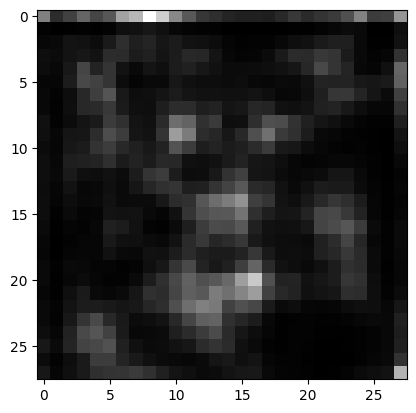

----------------------------------------


Discriminator Loss = 0.16180753707885742
Generator Loss = 2.740159749984741
A sample image generated by the generator


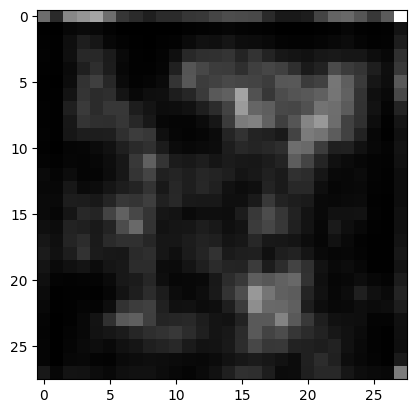

----------------------------------------


Discriminator Loss = 0.16528412699699402
Generator Loss = 2.6811695098876953
A sample image generated by the generator


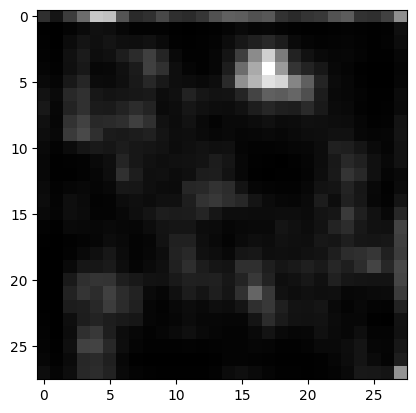

----------------------------------------


Discriminator Loss = 0.1668933928012848
Generator Loss = 2.736185073852539
A sample image generated by the generator


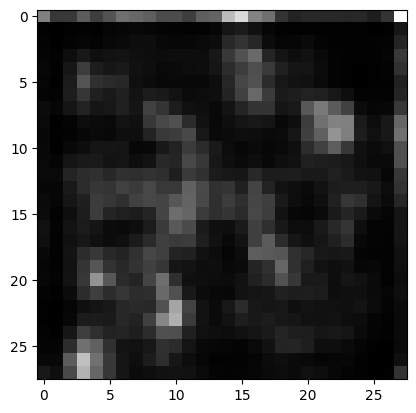

----------------------------------------


Discriminator Loss = 0.1645306795835495
Generator Loss = 2.767849922180176
A sample image generated by the generator


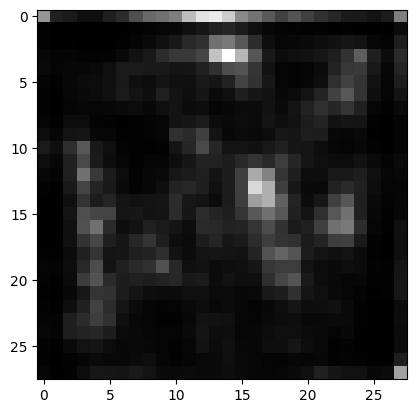

----------------------------------------


Discriminator Loss = 0.15874619781970978
Generator Loss = 2.7065486907958984
A sample image generated by the generator


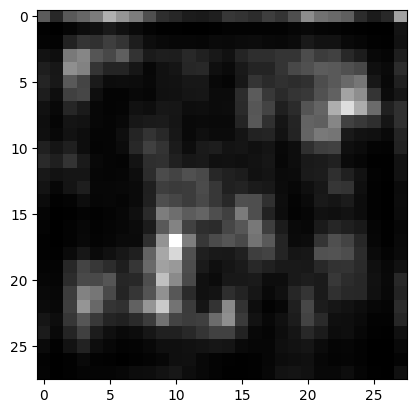

----------------------------------------


Discriminator Loss = 0.15780319273471832
Generator Loss = 2.8639140129089355
A sample image generated by the generator


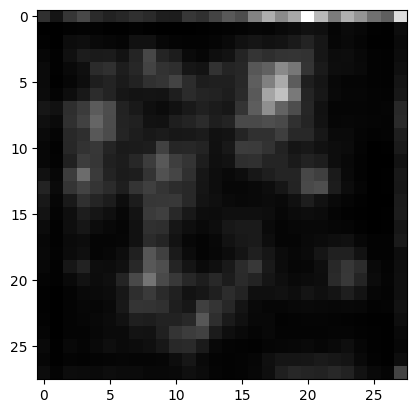

----------------------------------------


Discriminator Loss = 0.17444705963134766
Generator Loss = 2.6653966903686523
A sample image generated by the generator


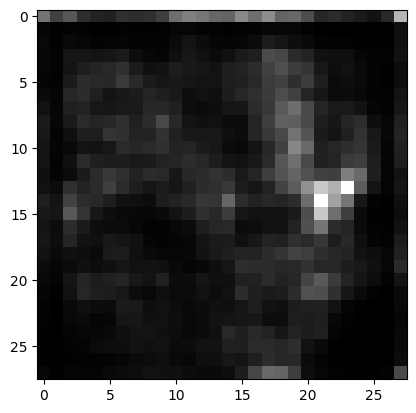

----------------------------------------


Discriminator Loss = 0.15249940752983093
Generator Loss = 2.6935391426086426
A sample image generated by the generator


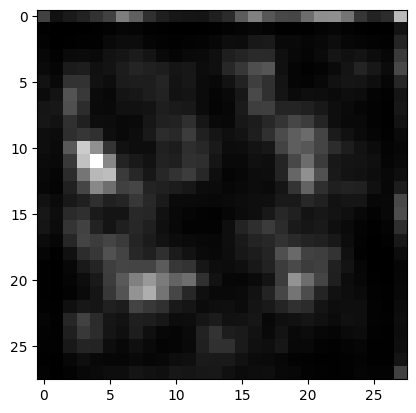

----------------------------------------


Discriminator Loss = 0.16685344278812408
Generator Loss = 2.6397833824157715
A sample image generated by the generator


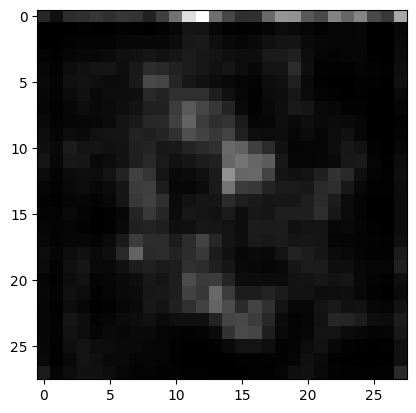

----------------------------------------


Discriminator Loss = 0.15706591308116913
Generator Loss = 2.7156944274902344
A sample image generated by the generator


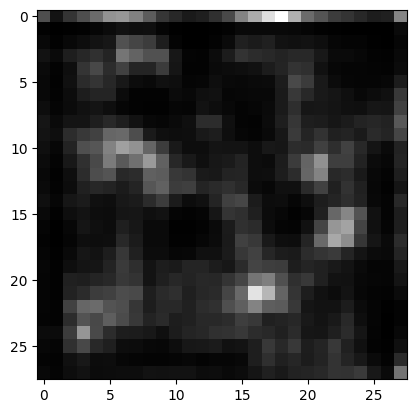

----------------------------------------


Discriminator Loss = 0.1662234663963318
Generator Loss = 2.6832022666931152
A sample image generated by the generator


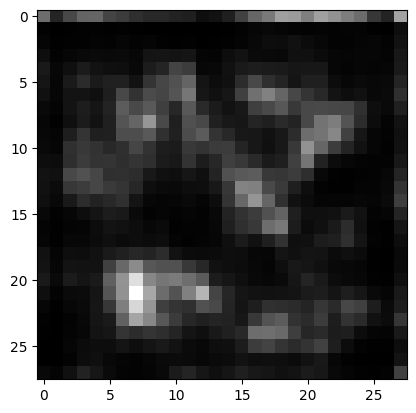

----------------------------------------


Discriminator Loss = 0.15379229187965393
Generator Loss = 2.7357397079467773
A sample image generated by the generator


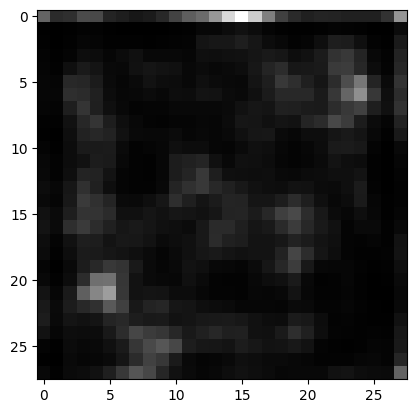

----------------------------------------


Discriminator Loss = 0.1558169573545456
Generator Loss = 2.6422698497772217
A sample image generated by the generator


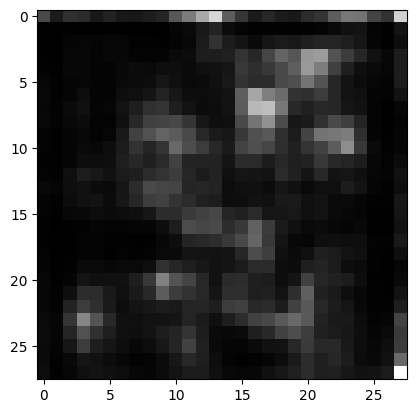

----------------------------------------


Discriminator Loss = 0.18037045001983643
Generator Loss = 2.6231637001037598
A sample image generated by the generator


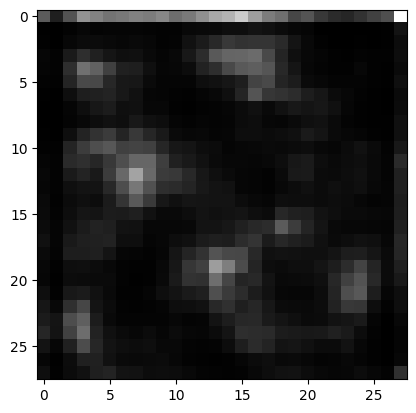

----------------------------------------


Discriminator Loss = 0.14785712957382202
Generator Loss = 2.7139530181884766
A sample image generated by the generator


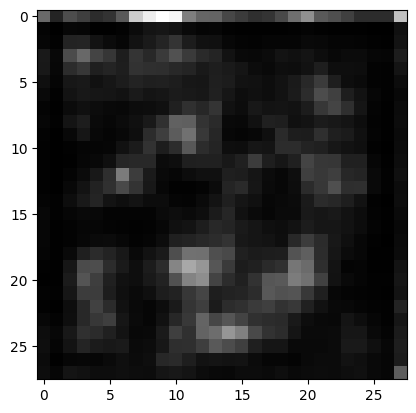

----------------------------------------


Discriminator Loss = 0.15379688143730164
Generator Loss = 2.7515110969543457
A sample image generated by the generator


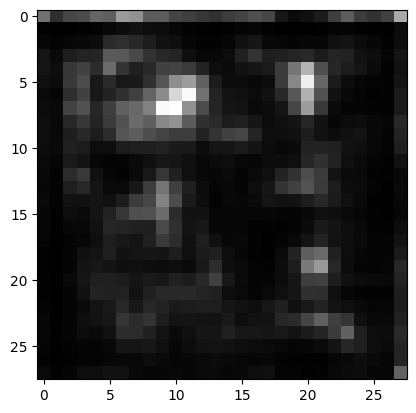

----------------------------------------


Discriminator Loss = 0.1325443983078003
Generator Loss = 2.6513113975524902
A sample image generated by the generator


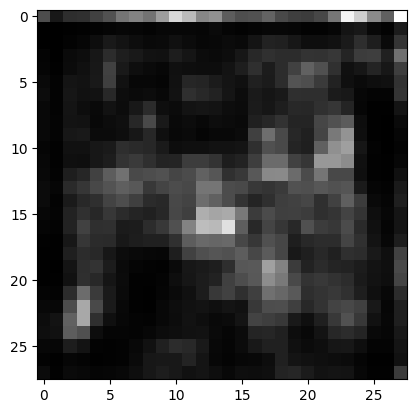

----------------------------------------


Discriminator Loss = 0.15340816974639893
Generator Loss = 2.8272337913513184
A sample image generated by the generator


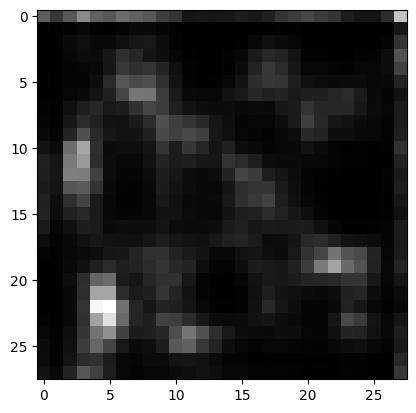

----------------------------------------


Discriminator Loss = 0.14914414286613464
Generator Loss = 2.7611236572265625
A sample image generated by the generator


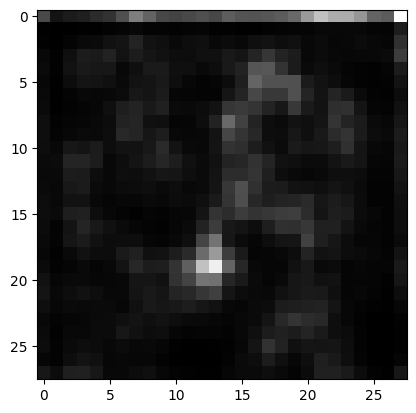

----------------------------------------


Discriminator Loss = 0.1501031517982483
Generator Loss = 2.738217830657959
A sample image generated by the generator


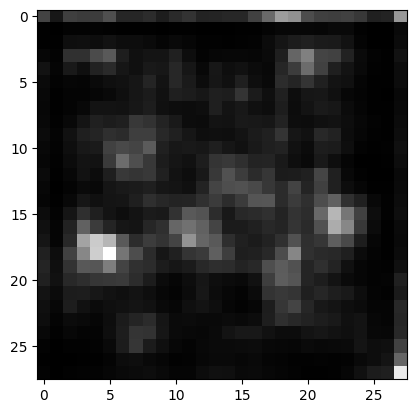

----------------------------------------


Discriminator Loss = 0.15373492240905762
Generator Loss = 2.8307831287384033
A sample image generated by the generator


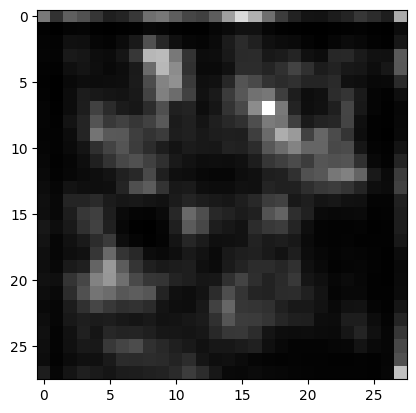

----------------------------------------


Discriminator Loss = 0.15470805764198303
Generator Loss = 2.832862615585327
A sample image generated by the generator


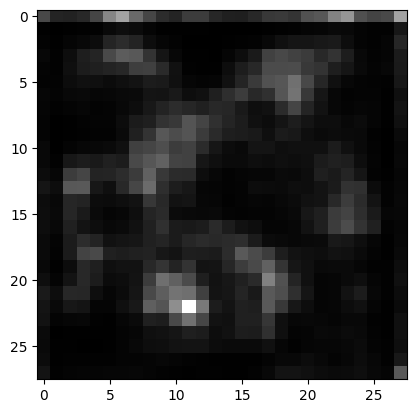

----------------------------------------


Discriminator Loss = 0.1485559493303299
Generator Loss = 2.7670772075653076
A sample image generated by the generator


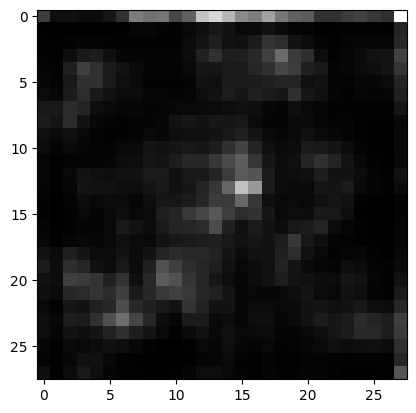

----------------------------------------


Discriminator Loss = 0.1503320038318634
Generator Loss = 2.7613625526428223
A sample image generated by the generator


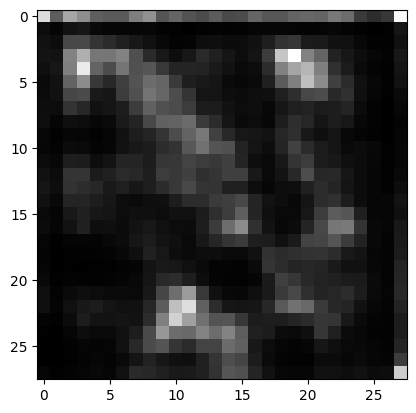

----------------------------------------


Discriminator Loss = 0.1556270718574524
Generator Loss = 2.803762912750244
A sample image generated by the generator


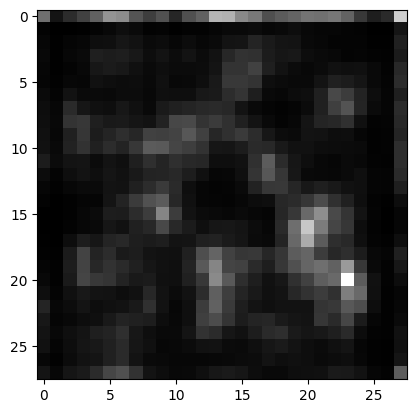

----------------------------------------


Discriminator Loss = 0.15229719877243042
Generator Loss = 2.7287368774414062
A sample image generated by the generator


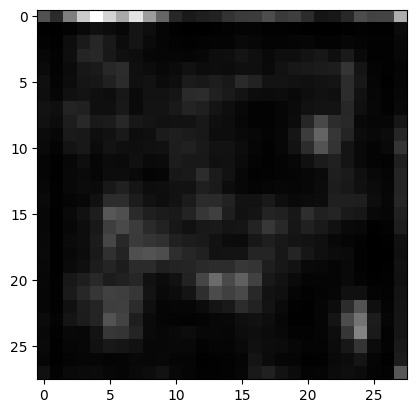

----------------------------------------


Discriminator Loss = 0.1604282408952713
Generator Loss = 2.714294672012329
A sample image generated by the generator


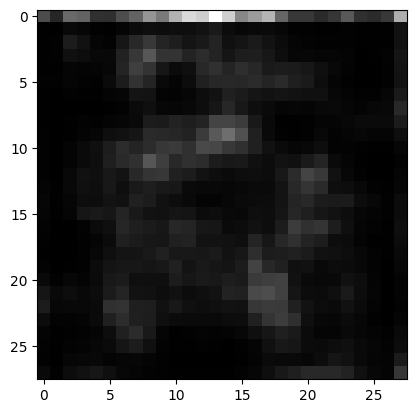

----------------------------------------


Discriminator Loss = 0.15958602726459503
Generator Loss = 2.7675118446350098
A sample image generated by the generator


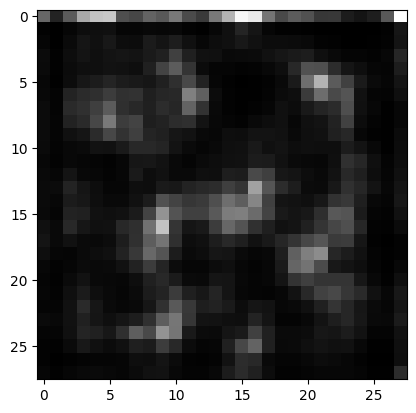

----------------------------------------


Discriminator Loss = 0.13846895098686218
Generator Loss = 2.788017749786377
A sample image generated by the generator


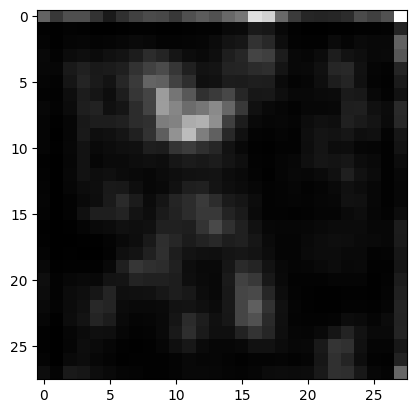

----------------------------------------


Discriminator Loss = 0.15839453041553497
Generator Loss = 2.7411136627197266
A sample image generated by the generator


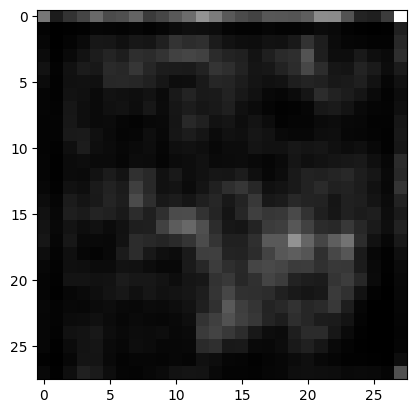

----------------------------------------


Discriminator Loss = 0.1556614190340042
Generator Loss = 2.7876038551330566
A sample image generated by the generator


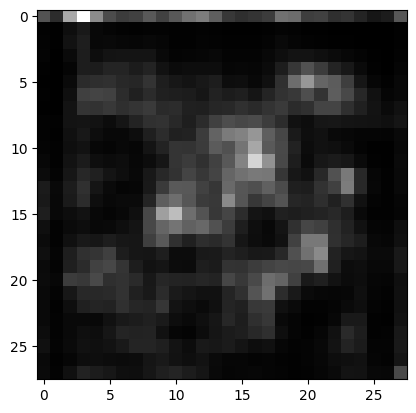

----------------------------------------


Discriminator Loss = 0.15649878978729248
Generator Loss = 2.7673702239990234
A sample image generated by the generator


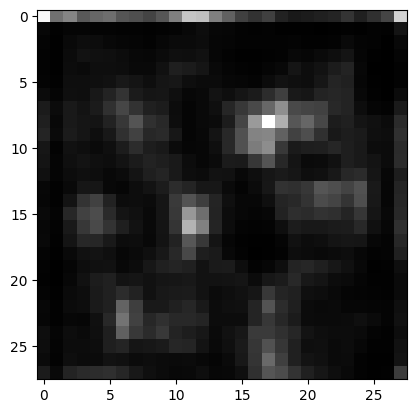

----------------------------------------


Discriminator Loss = 0.1511092185974121
Generator Loss = 2.642740249633789
A sample image generated by the generator


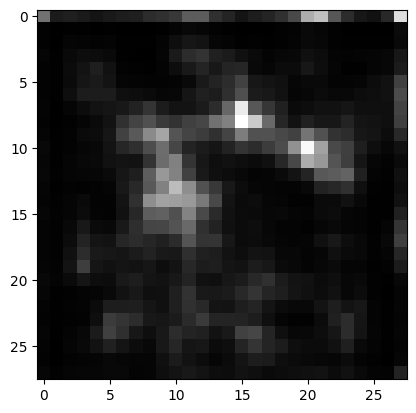

----------------------------------------


Discriminator Loss = 0.16220839321613312
Generator Loss = 2.785937786102295
A sample image generated by the generator


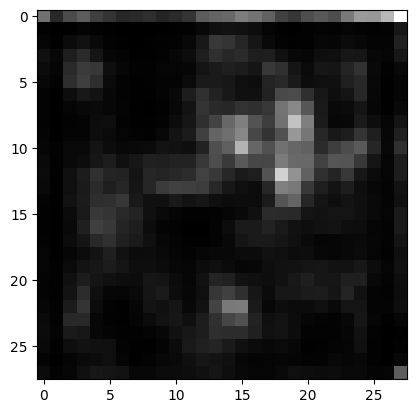

----------------------------------------


Discriminator Loss = 0.15424461662769318
Generator Loss = 2.7509379386901855
A sample image generated by the generator


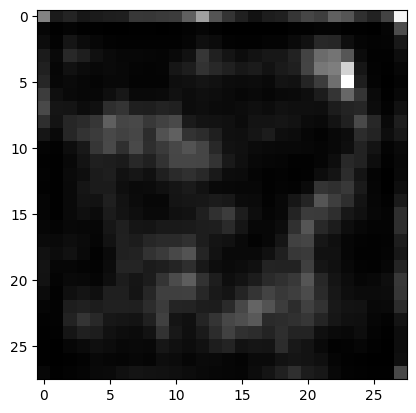

----------------------------------------


Discriminator Loss = 0.14828304946422577
Generator Loss = 2.792006015777588
A sample image generated by the generator


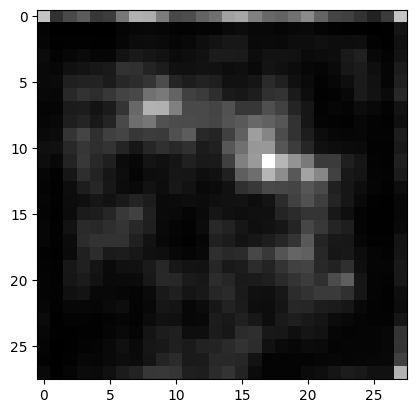

----------------------------------------


Discriminator Loss = 0.15292134881019592
Generator Loss = 2.823223352432251
A sample image generated by the generator


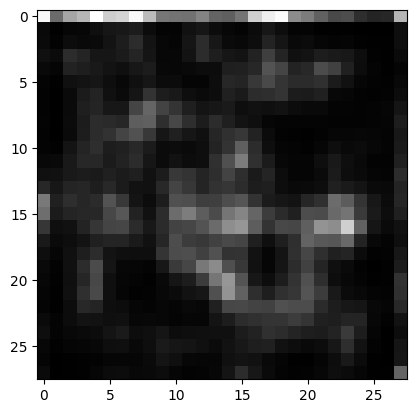

----------------------------------------


Discriminator Loss = 0.16145531833171844
Generator Loss = 2.757892608642578
A sample image generated by the generator


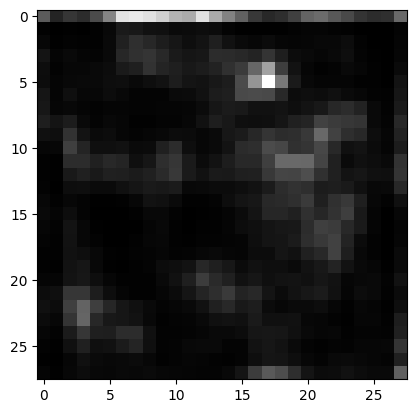

----------------------------------------


Discriminator Loss = 0.14727699756622314
Generator Loss = 2.6648199558258057
A sample image generated by the generator


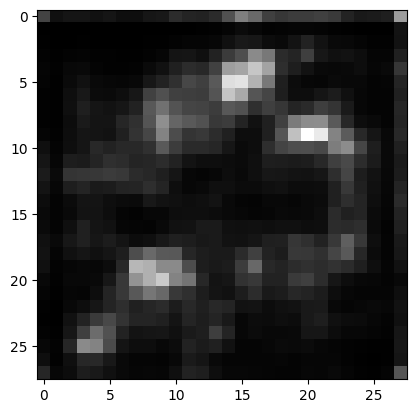

----------------------------------------


Discriminator Loss = 0.153469979763031
Generator Loss = 2.7514333724975586
A sample image generated by the generator


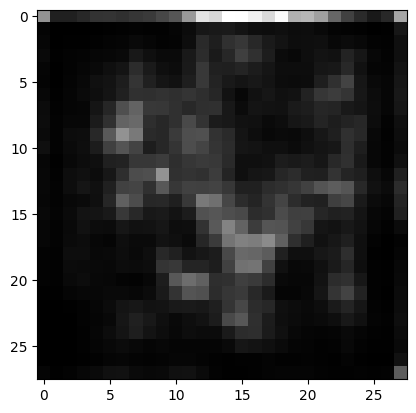

----------------------------------------


Discriminator Loss = 0.1543603539466858
Generator Loss = 2.816866397857666
A sample image generated by the generator


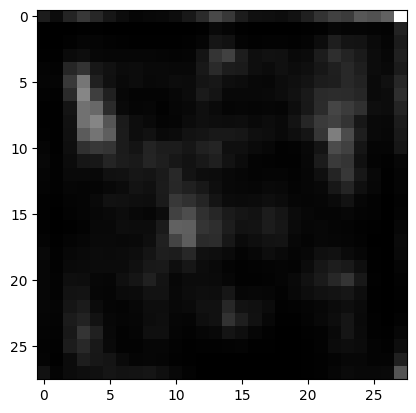

----------------------------------------


Discriminator Loss = 0.14761945605278015
Generator Loss = 2.7519588470458984
A sample image generated by the generator


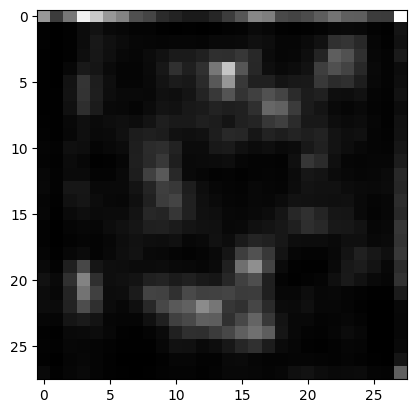

----------------------------------------


Discriminator Loss = 0.14697547256946564
Generator Loss = 2.711578845977783
A sample image generated by the generator


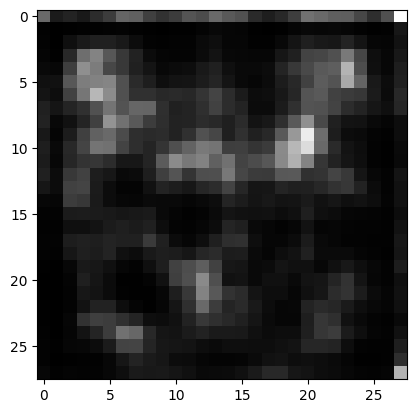

----------------------------------------


Discriminator Loss = 0.15002891421318054
Generator Loss = 2.733375072479248
A sample image generated by the generator


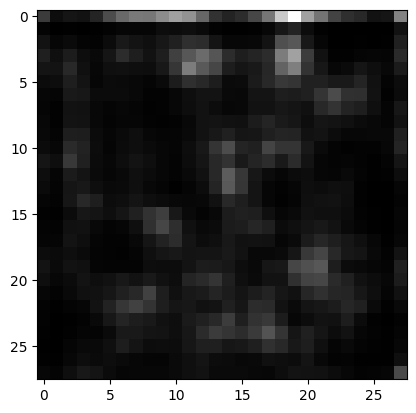

----------------------------------------


Discriminator Loss = 0.1554081290960312
Generator Loss = 2.8399112224578857
A sample image generated by the generator


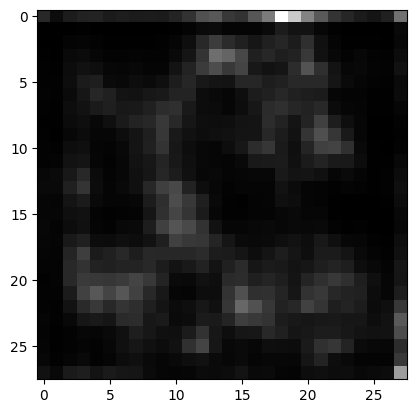

----------------------------------------


Discriminator Loss = 0.14524713158607483
Generator Loss = 2.84450626373291
A sample image generated by the generator


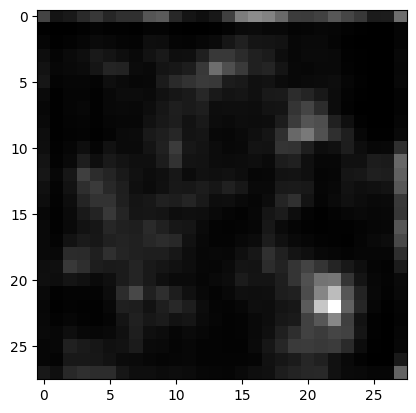

----------------------------------------


Discriminator Loss = 0.14941340684890747
Generator Loss = 2.828233242034912
A sample image generated by the generator


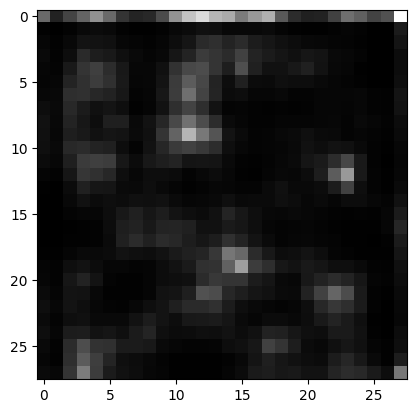

----------------------------------------


Discriminator Loss = 0.15924057364463806
Generator Loss = 2.831760883331299
A sample image generated by the generator


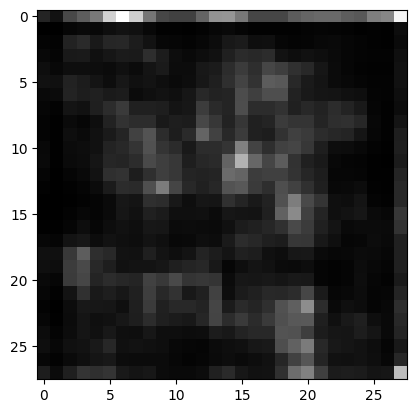

----------------------------------------


Discriminator Loss = 0.15189117193222046
Generator Loss = 2.864556312561035
A sample image generated by the generator


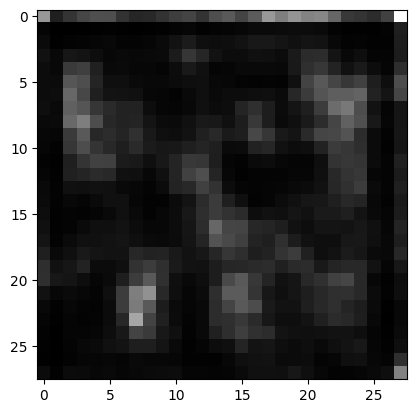

----------------------------------------


Discriminator Loss = 0.16877564787864685
Generator Loss = 2.791677951812744
A sample image generated by the generator


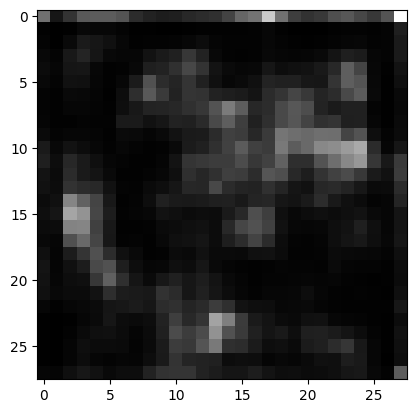

----------------------------------------


Discriminator Loss = 0.14339850842952728
Generator Loss = 2.8592653274536133
A sample image generated by the generator


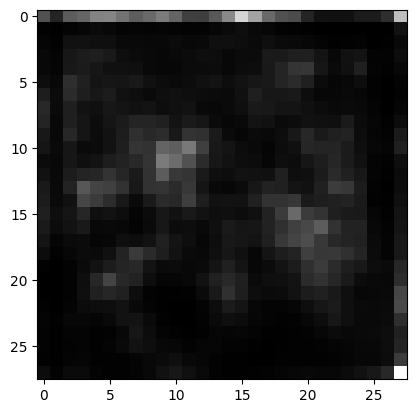

----------------------------------------


Discriminator Loss = 0.15258733928203583
Generator Loss = 2.817645311355591
A sample image generated by the generator


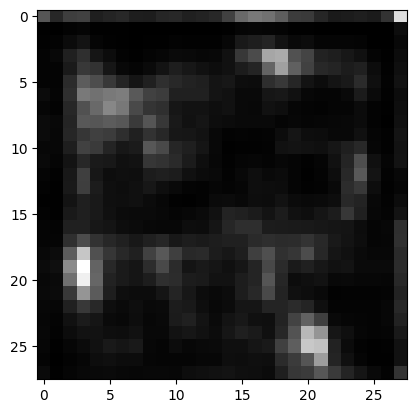

----------------------------------------


Discriminator Loss = 0.14184363186359406
Generator Loss = 2.82481050491333
A sample image generated by the generator


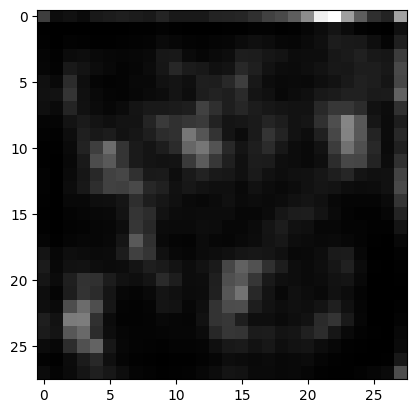

----------------------------------------


Discriminator Loss = 0.16468006372451782
Generator Loss = 2.810244560241699
A sample image generated by the generator


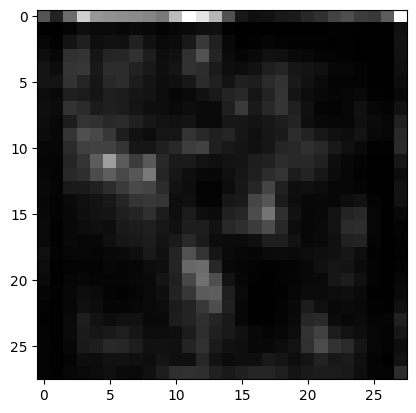

----------------------------------------


Discriminator Loss = 0.15357345342636108
Generator Loss = 2.8191232681274414
A sample image generated by the generator


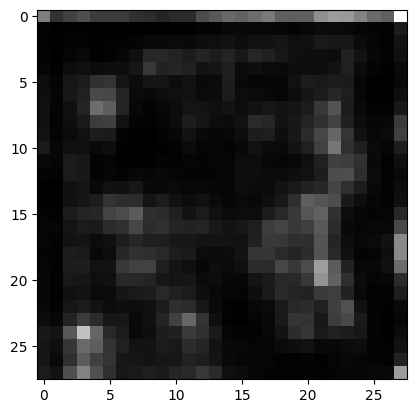

----------------------------------------


Discriminator Loss = 0.1465199589729309
Generator Loss = 2.8253417015075684
A sample image generated by the generator


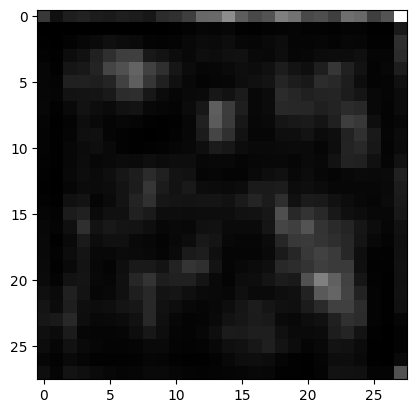

----------------------------------------


Discriminator Loss = 0.14865157008171082
Generator Loss = 2.9019594192504883
A sample image generated by the generator


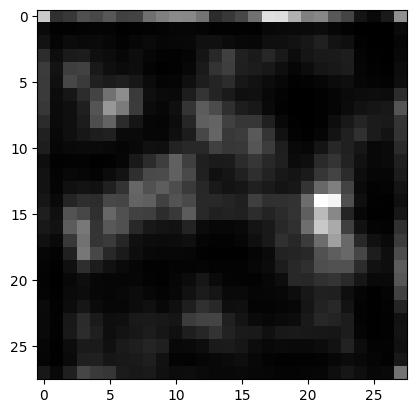

----------------------------------------


Discriminator Loss = 0.1398095339536667
Generator Loss = 2.876716136932373
A sample image generated by the generator


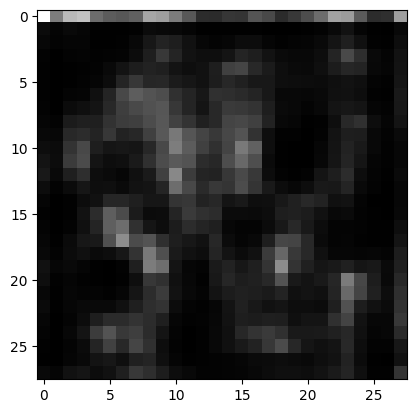

----------------------------------------


Discriminator Loss = 0.1548120677471161
Generator Loss = 2.725938320159912
A sample image generated by the generator


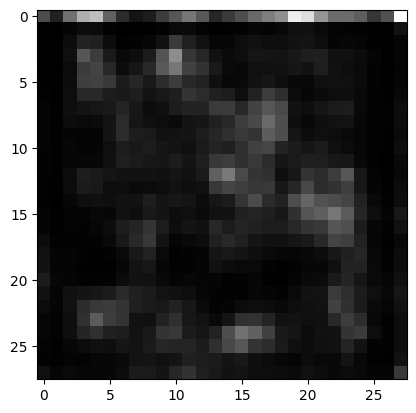

----------------------------------------


Discriminator Loss = 0.1462116539478302
Generator Loss = 2.817169189453125
A sample image generated by the generator


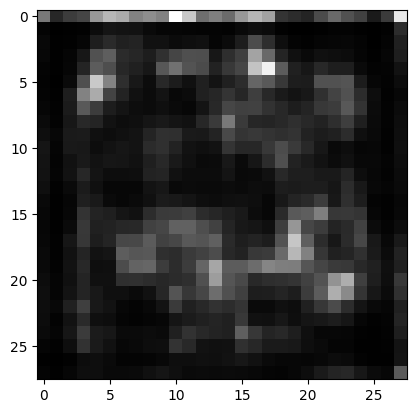

----------------------------------------


Discriminator Loss = 0.1527254581451416
Generator Loss = 2.7700698375701904
A sample image generated by the generator


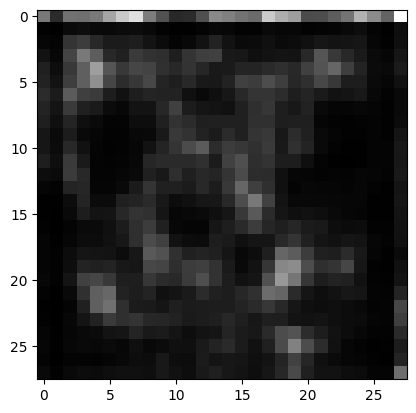

----------------------------------------


Discriminator Loss = 0.12890484929084778
Generator Loss = 2.767582416534424
A sample image generated by the generator


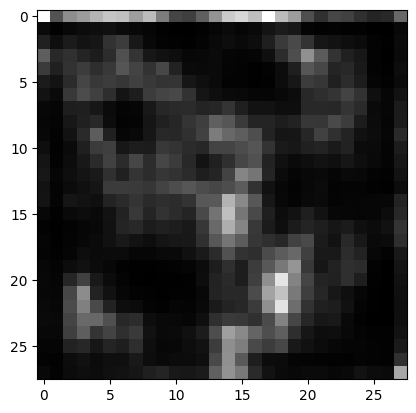

----------------------------------------


Discriminator Loss = 0.14308291673660278
Generator Loss = 2.769796848297119
A sample image generated by the generator


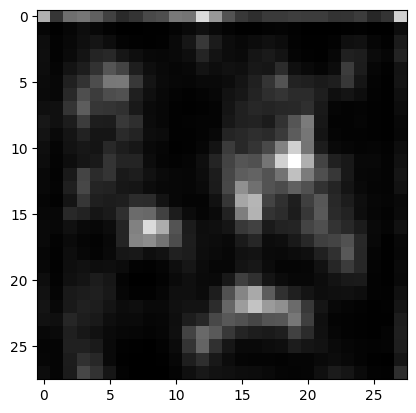

----------------------------------------


Discriminator Loss = 0.13457828760147095
Generator Loss = 2.7441163063049316
A sample image generated by the generator


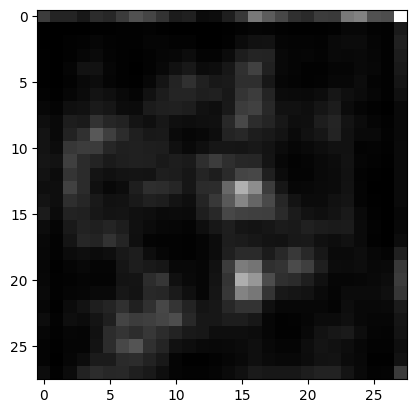

----------------------------------------


Discriminator Loss = 0.1430557668209076
Generator Loss = 2.738708019256592
A sample image generated by the generator


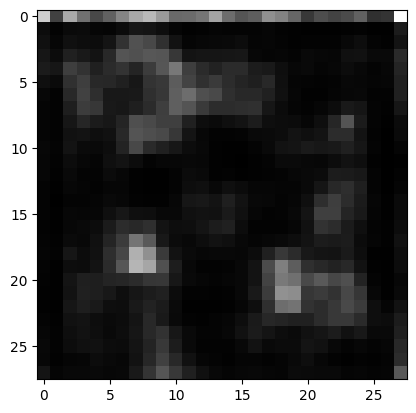

----------------------------------------


Discriminator Loss = 0.1564996838569641
Generator Loss = 2.8847551345825195
A sample image generated by the generator


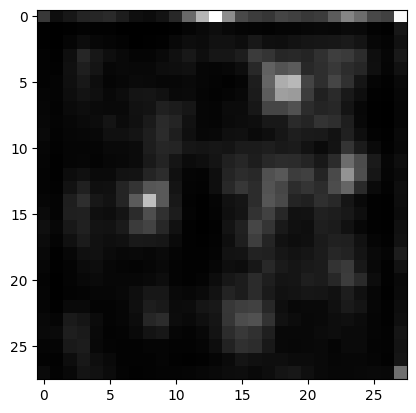

----------------------------------------


Discriminator Loss = 0.1441076099872589
Generator Loss = 2.8419764041900635
A sample image generated by the generator


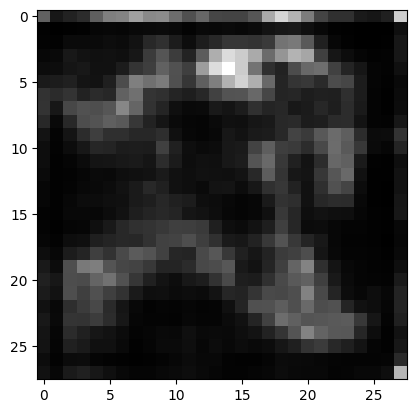

----------------------------------------


Discriminator Loss = 0.143767848610878
Generator Loss = 2.835444450378418
A sample image generated by the generator


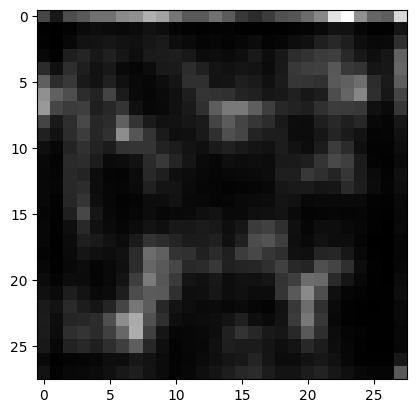

----------------------------------------


Discriminator Loss = 0.1615557223558426
Generator Loss = 2.866609811782837
A sample image generated by the generator


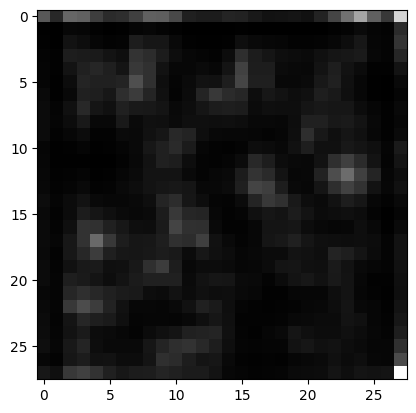

----------------------------------------


Discriminator Loss = 0.15040847659111023
Generator Loss = 2.8058457374572754
A sample image generated by the generator


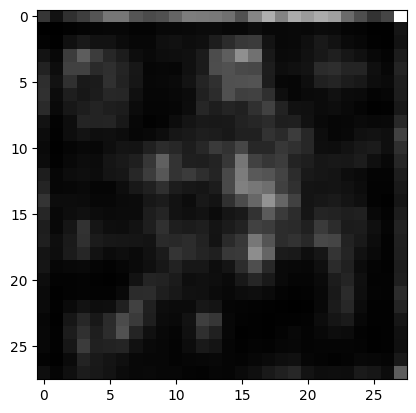

----------------------------------------


Discriminator Loss = 0.15777631103992462
Generator Loss = 2.870298147201538
A sample image generated by the generator


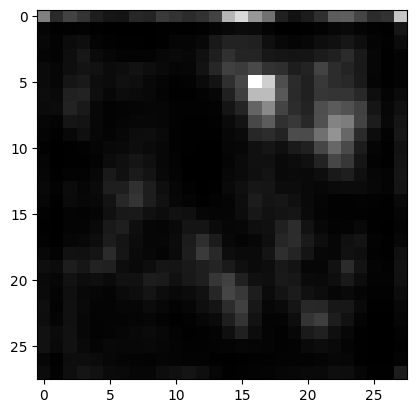

----------------------------------------


Discriminator Loss = 0.14021943509578705
Generator Loss = 2.8638150691986084
A sample image generated by the generator


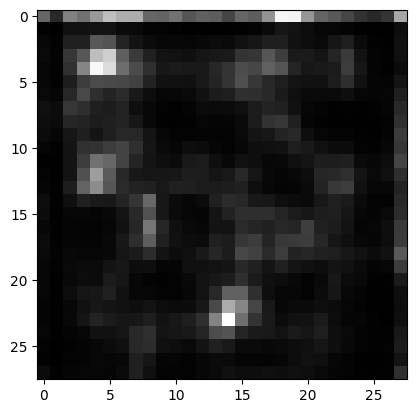

----------------------------------------


Discriminator Loss = 0.13954955339431763
Generator Loss = 2.8998312950134277
A sample image generated by the generator


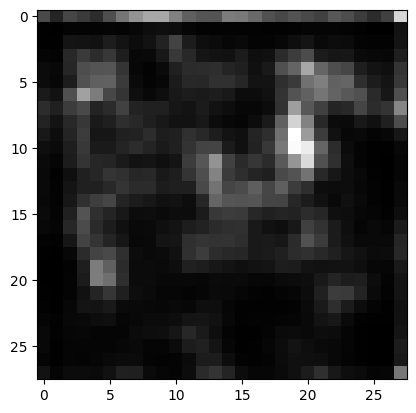

----------------------------------------


Discriminator Loss = 0.14327651262283325
Generator Loss = 2.7834222316741943
A sample image generated by the generator


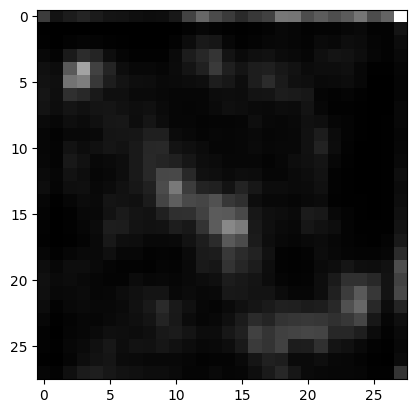

----------------------------------------


Discriminator Loss = 0.15585726499557495
Generator Loss = 2.886671781539917
A sample image generated by the generator


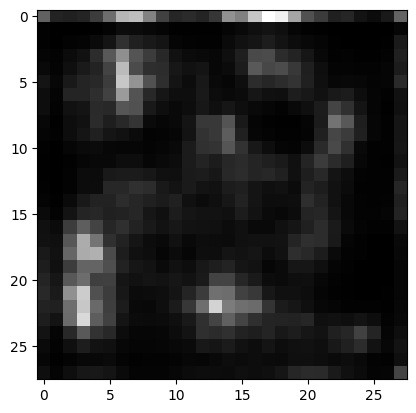

----------------------------------------


Discriminator Loss = 0.15896667540073395
Generator Loss = 2.9146552085876465
A sample image generated by the generator


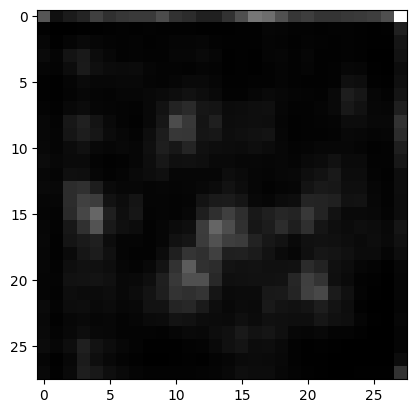

----------------------------------------


Discriminator Loss = 0.14280825853347778
Generator Loss = 2.7342240810394287
A sample image generated by the generator


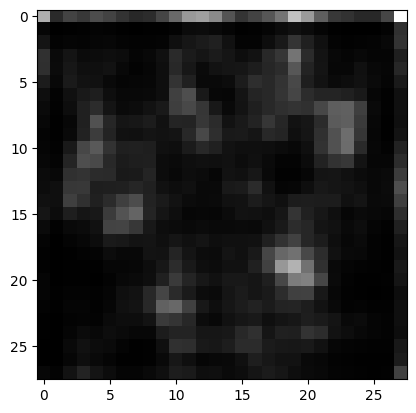

----------------------------------------


Discriminator Loss = 0.14536170661449432
Generator Loss = 2.899040937423706
A sample image generated by the generator


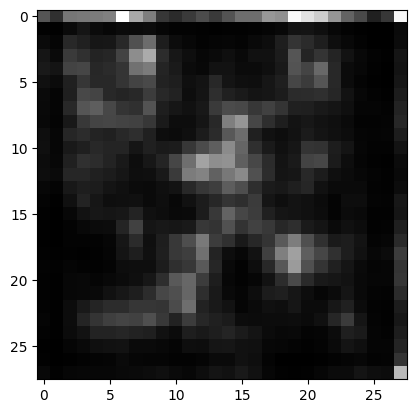

----------------------------------------


Discriminator Loss = 0.14388272166252136
Generator Loss = 2.739372968673706
A sample image generated by the generator


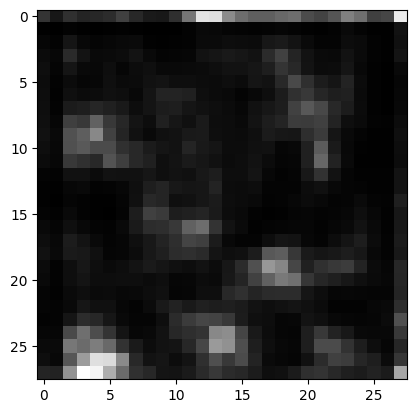

----------------------------------------


Discriminator Loss = 0.14115548133850098
Generator Loss = 2.7291159629821777
A sample image generated by the generator


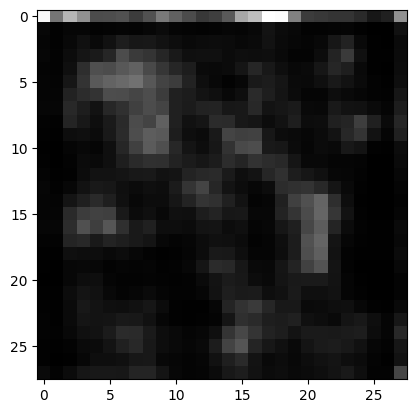

----------------------------------------


Discriminator Loss = 0.15662480890750885
Generator Loss = 2.8388187885284424
A sample image generated by the generator


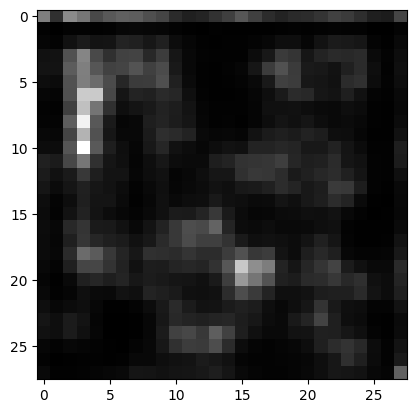

----------------------------------------


Discriminator Loss = 0.13530796766281128
Generator Loss = 2.8936614990234375
A sample image generated by the generator


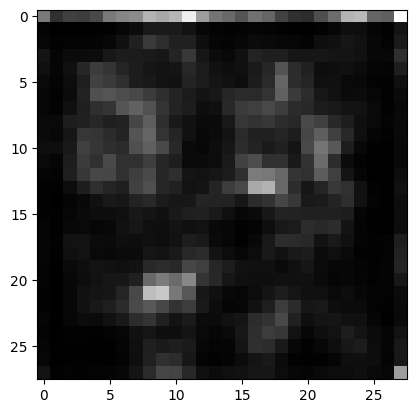

----------------------------------------


Discriminator Loss = 0.14767667651176453
Generator Loss = 2.9035544395446777
A sample image generated by the generator


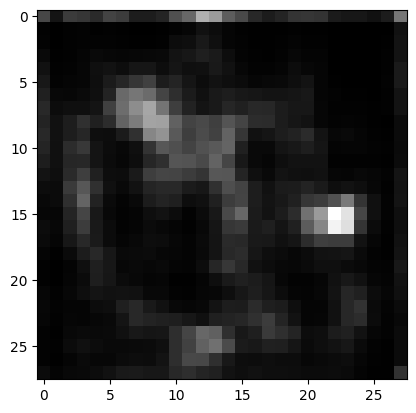

----------------------------------------


Discriminator Loss = 0.14348725974559784
Generator Loss = 2.8815207481384277
A sample image generated by the generator


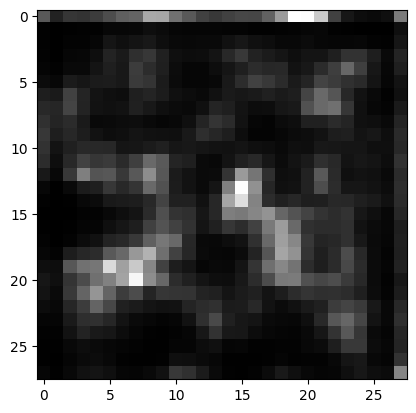

----------------------------------------


Discriminator Loss = 0.1554878056049347
Generator Loss = 2.9067351818084717
A sample image generated by the generator


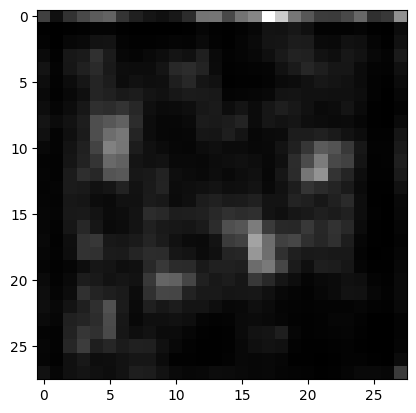

----------------------------------------


Discriminator Loss = 0.1445406973361969
Generator Loss = 2.9107565879821777
A sample image generated by the generator


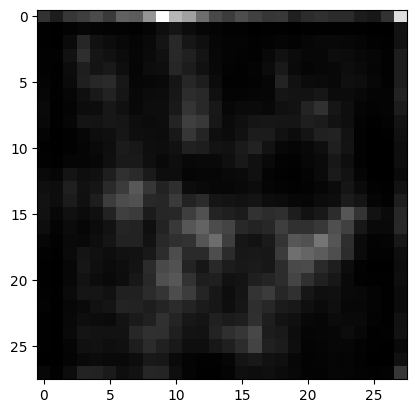

----------------------------------------


Discriminator Loss = 0.1491692066192627
Generator Loss = 2.8567140102386475
A sample image generated by the generator


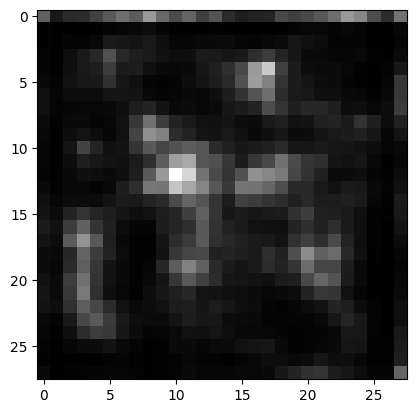

----------------------------------------


Discriminator Loss = 0.13044939935207367
Generator Loss = 2.805919647216797
A sample image generated by the generator


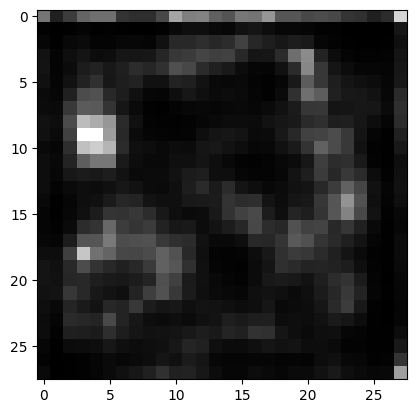

----------------------------------------


Discriminator Loss = 0.1299622654914856
Generator Loss = 2.8943567276000977
A sample image generated by the generator


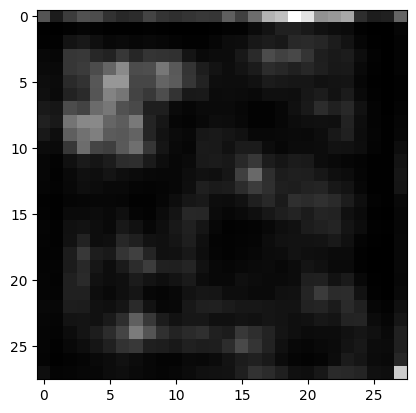

----------------------------------------


Discriminator Loss = 0.14008072018623352
Generator Loss = 2.8697519302368164
A sample image generated by the generator


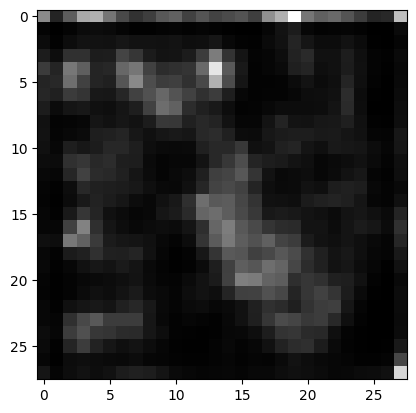

----------------------------------------


Discriminator Loss = 0.14163509011268616
Generator Loss = 2.8557162284851074
A sample image generated by the generator


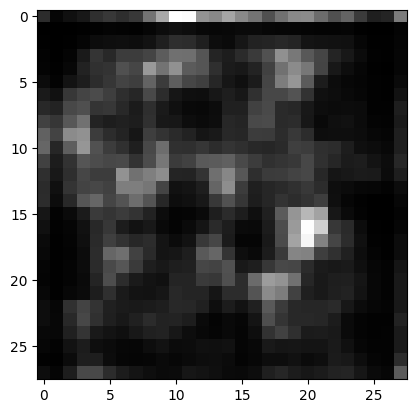

----------------------------------------


Discriminator Loss = 0.1369100958108902
Generator Loss = 2.716254711151123
A sample image generated by the generator


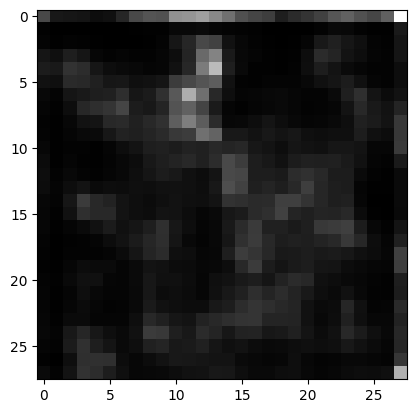

----------------------------------------


Discriminator Loss = 0.14450660347938538
Generator Loss = 2.886444330215454
A sample image generated by the generator


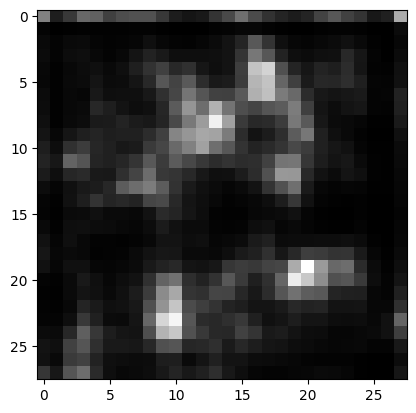

----------------------------------------


Discriminator Loss = 0.1442689150571823
Generator Loss = 2.8846471309661865
A sample image generated by the generator


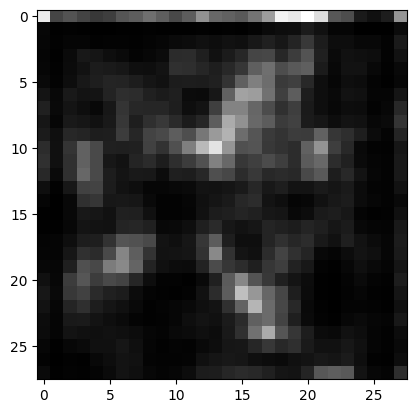

----------------------------------------


Discriminator Loss = 0.13538943231105804
Generator Loss = 2.931180953979492
A sample image generated by the generator


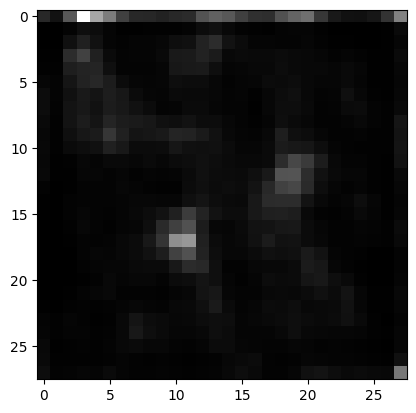

----------------------------------------


Discriminator Loss = 0.13575908541679382
Generator Loss = 2.873121976852417
A sample image generated by the generator


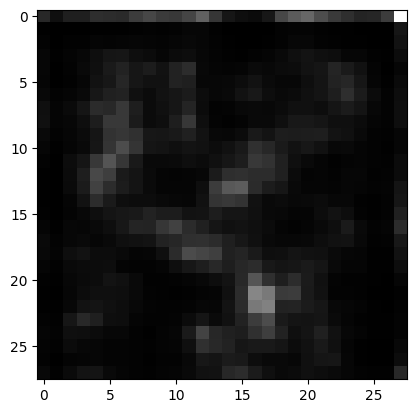

----------------------------------------


Discriminator Loss = 0.1406497359275818
Generator Loss = 2.9209983348846436
A sample image generated by the generator


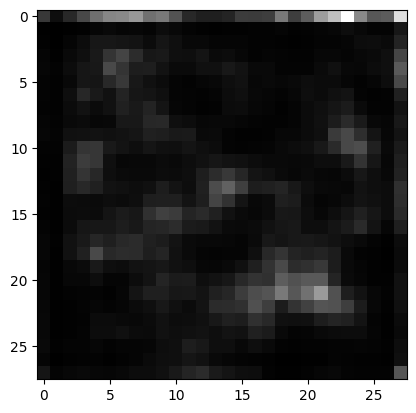

----------------------------------------


Discriminator Loss = 0.15337014198303223
Generator Loss = 2.921184778213501
A sample image generated by the generator


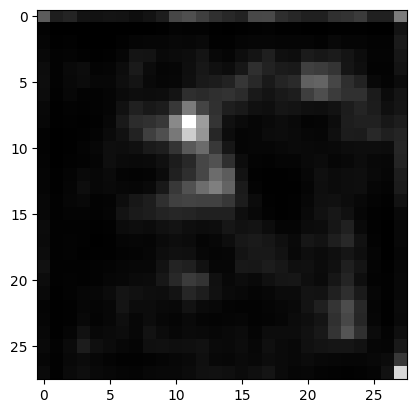

----------------------------------------


Discriminator Loss = 0.14646269381046295
Generator Loss = 2.9059267044067383
A sample image generated by the generator


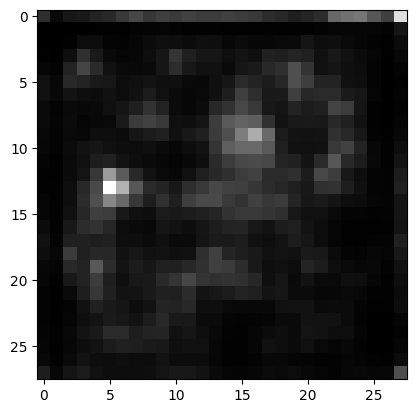

----------------------------------------


Discriminator Loss = 0.12527722120285034
Generator Loss = 2.733633041381836
A sample image generated by the generator


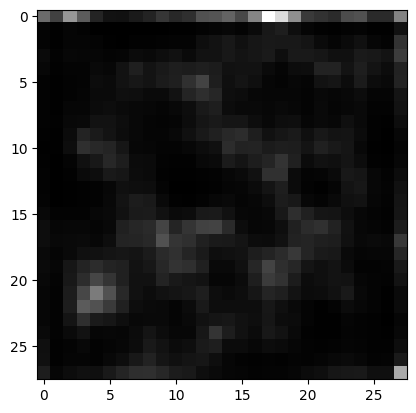

----------------------------------------


Discriminator Loss = 0.14302927255630493
Generator Loss = 2.8226051330566406
A sample image generated by the generator


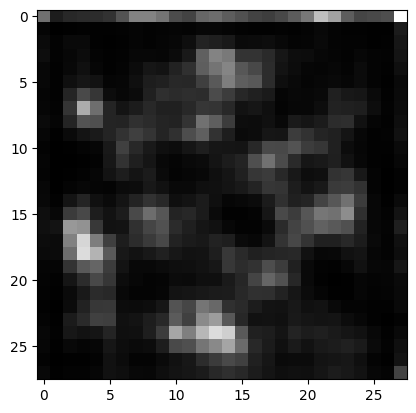

----------------------------------------


Discriminator Loss = 0.13843710720539093
Generator Loss = 2.9168105125427246
A sample image generated by the generator


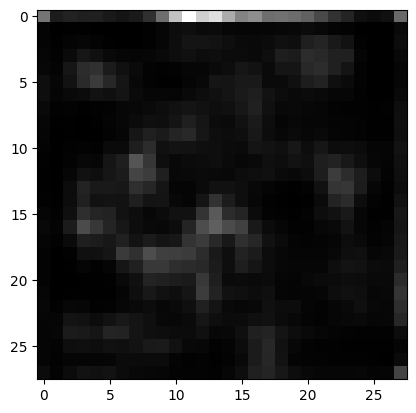

----------------------------------------


Discriminator Loss = 0.14921879768371582
Generator Loss = 2.782910108566284
A sample image generated by the generator


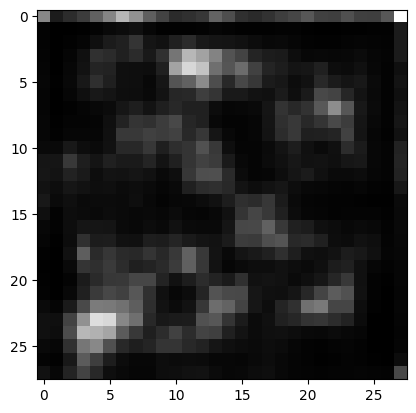

----------------------------------------


Discriminator Loss = 0.13584940135478973
Generator Loss = 2.940279960632324
A sample image generated by the generator


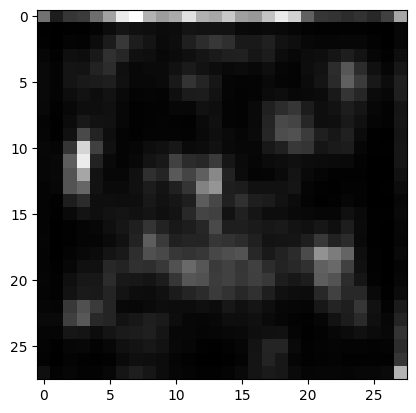

----------------------------------------


Discriminator Loss = 0.1335517168045044
Generator Loss = 2.8363678455352783
A sample image generated by the generator


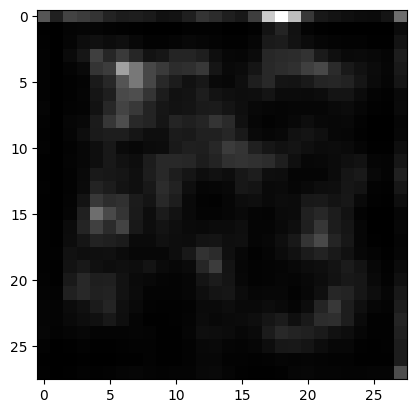

----------------------------------------


Discriminator Loss = 0.1366002857685089
Generator Loss = 2.8731255531311035
A sample image generated by the generator


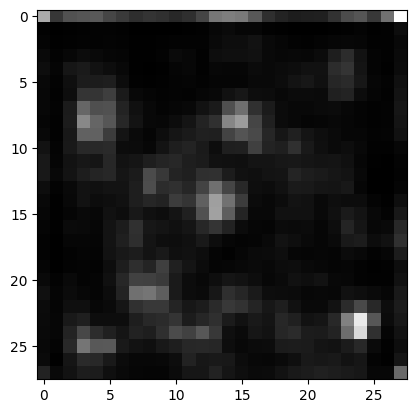

----------------------------------------


Discriminator Loss = 0.14360174536705017
Generator Loss = 2.915005922317505
A sample image generated by the generator


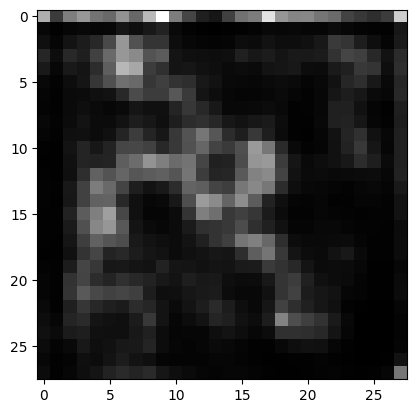

----------------------------------------


Discriminator Loss = 0.13065631687641144
Generator Loss = 2.910736560821533
A sample image generated by the generator


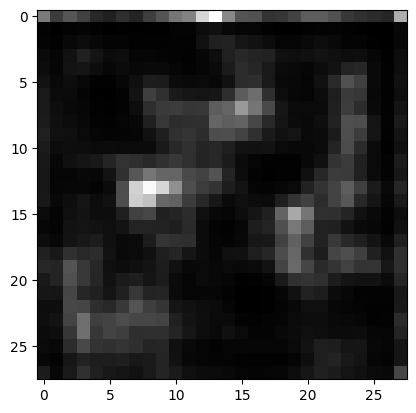

----------------------------------------


Discriminator Loss = 0.1405908614397049
Generator Loss = 2.936617851257324
A sample image generated by the generator


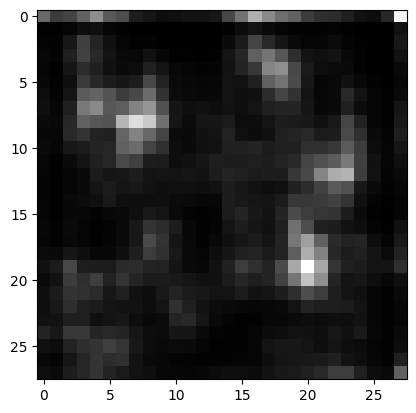

----------------------------------------


Discriminator Loss = 0.13180813193321228
Generator Loss = 2.901632308959961
A sample image generated by the generator


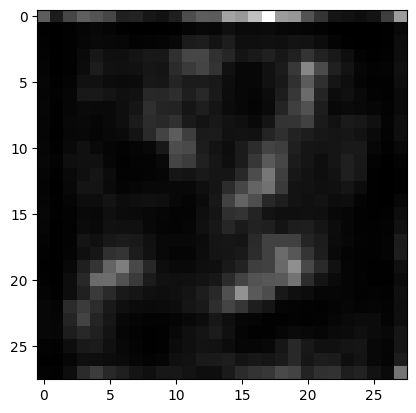

----------------------------------------


Discriminator Loss = 0.12609830498695374
Generator Loss = 2.8721227645874023
A sample image generated by the generator


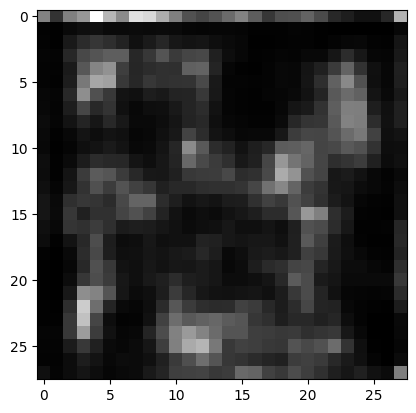

----------------------------------------


Discriminator Loss = 0.14124515652656555
Generator Loss = 2.8339521884918213
A sample image generated by the generator


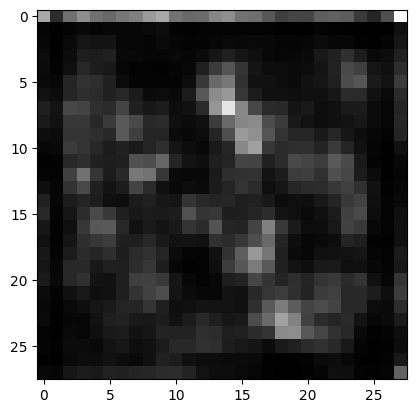

----------------------------------------


Discriminator Loss = 0.1539057493209839
Generator Loss = 2.762176275253296
A sample image generated by the generator


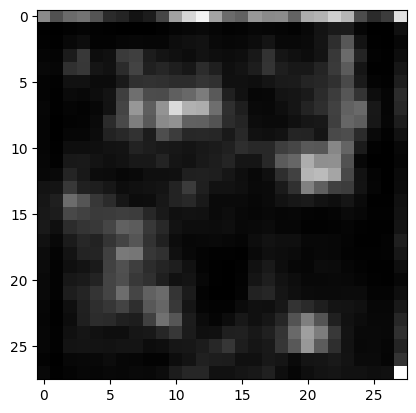

----------------------------------------


Discriminator Loss = 0.13517923653125763
Generator Loss = 2.9459428787231445
A sample image generated by the generator


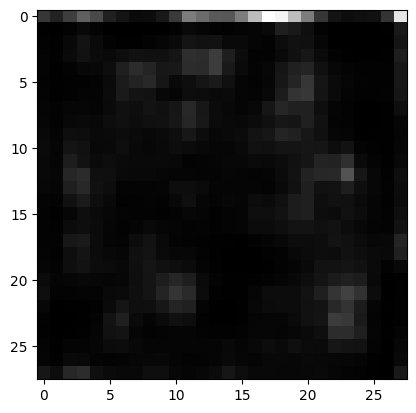

----------------------------------------


Discriminator Loss = 0.13761764764785767
Generator Loss = 2.9115028381347656
A sample image generated by the generator


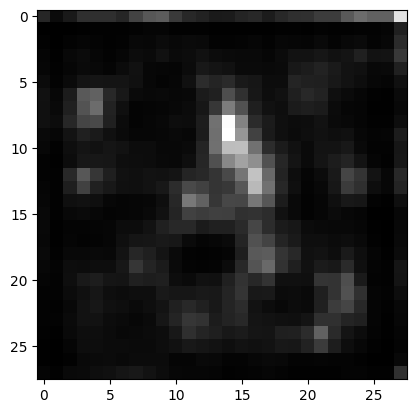

----------------------------------------


Discriminator Loss = 0.13110217452049255
Generator Loss = 2.8444488048553467
A sample image generated by the generator


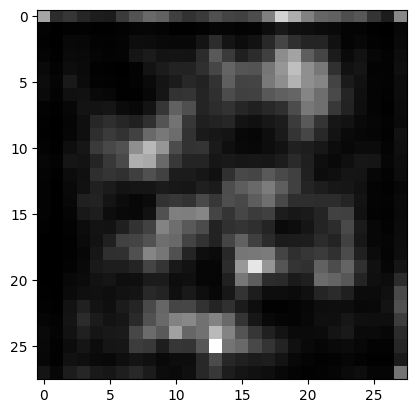

----------------------------------------


Discriminator Loss = 0.12621727585792542
Generator Loss = 2.9302892684936523
A sample image generated by the generator


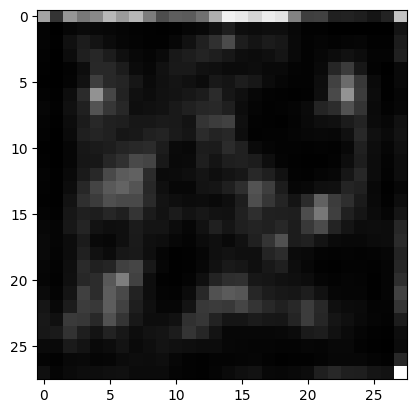

----------------------------------------


Discriminator Loss = 0.1335628181695938
Generator Loss = 2.904655933380127
A sample image generated by the generator


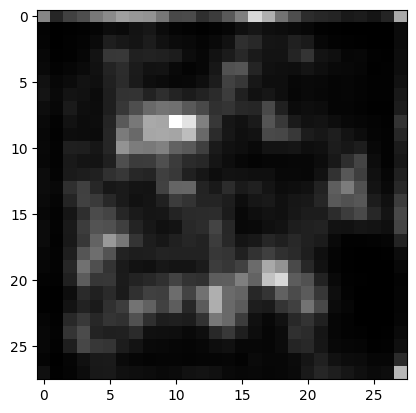

----------------------------------------


Discriminator Loss = 0.12381613999605179
Generator Loss = 2.851202964782715
A sample image generated by the generator


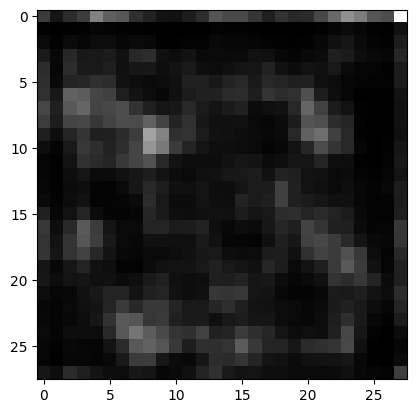

----------------------------------------


Discriminator Loss = 0.1402214765548706
Generator Loss = 2.928048610687256
A sample image generated by the generator


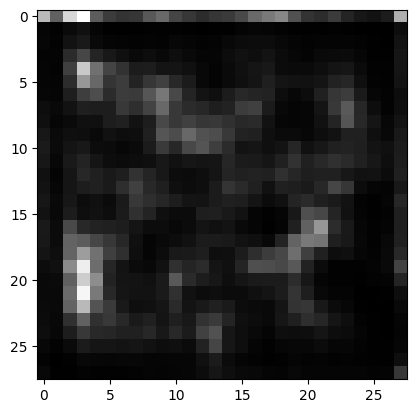

----------------------------------------


Discriminator Loss = 0.135585755109787
Generator Loss = 2.855522632598877
A sample image generated by the generator


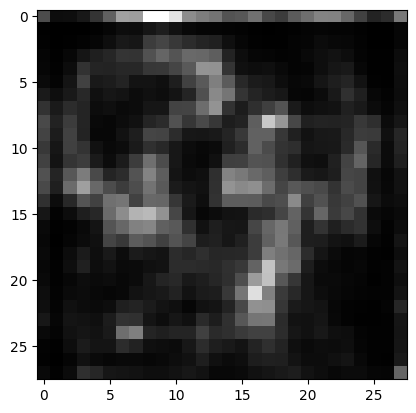

----------------------------------------


Discriminator Loss = 0.14172686636447906
Generator Loss = 2.796422004699707
A sample image generated by the generator


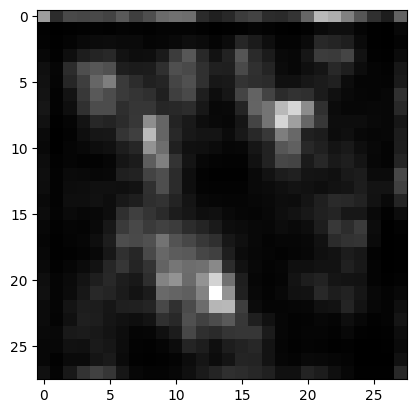

----------------------------------------


Discriminator Loss = 0.13778436183929443
Generator Loss = 2.78568172454834
A sample image generated by the generator


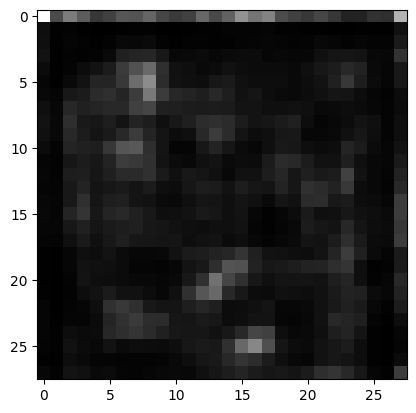

----------------------------------------


Discriminator Loss = 0.13672016561031342
Generator Loss = 2.935821533203125
A sample image generated by the generator


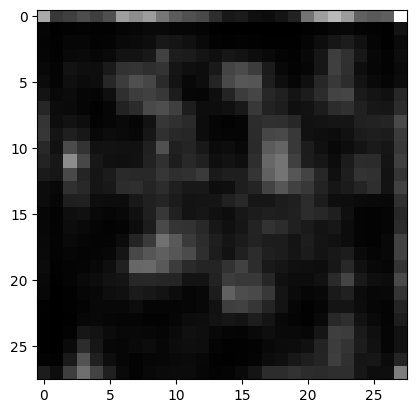

----------------------------------------


Discriminator Loss = 0.13218054175376892
Generator Loss = 2.912292003631592
A sample image generated by the generator


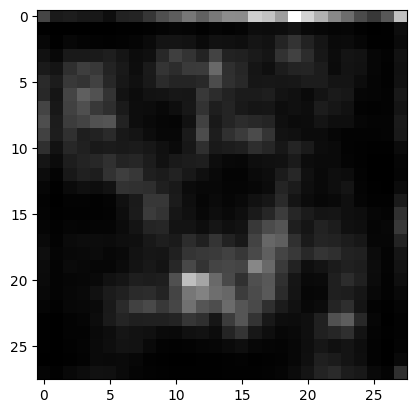

----------------------------------------


Discriminator Loss = 0.12300702929496765
Generator Loss = 2.9295499324798584
A sample image generated by the generator


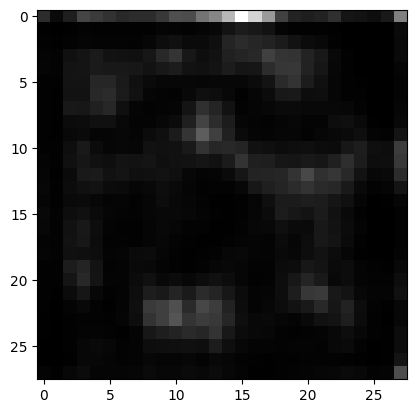

----------------------------------------


Discriminator Loss = 0.13018709421157837
Generator Loss = 2.989779233932495
A sample image generated by the generator


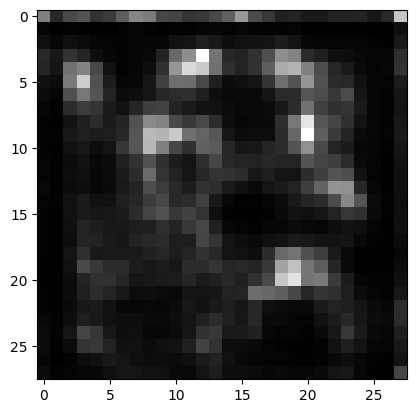

----------------------------------------


Discriminator Loss = 0.14109213650226593
Generator Loss = 2.7443714141845703
A sample image generated by the generator


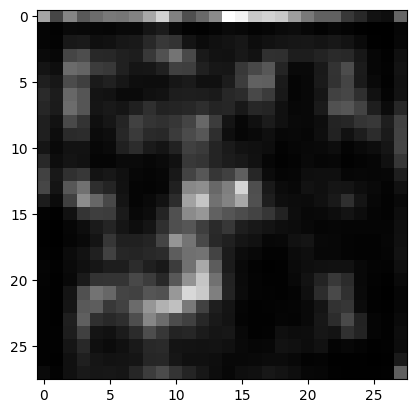

----------------------------------------


Discriminator Loss = 0.11927731335163116
Generator Loss = 2.9353835582733154
A sample image generated by the generator


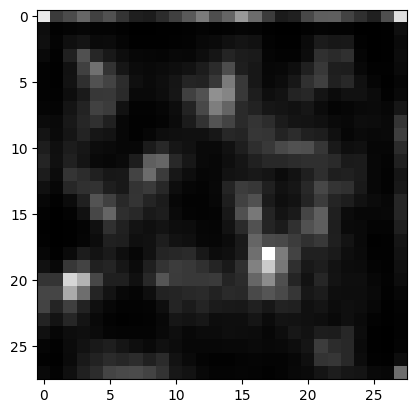

----------------------------------------


Discriminator Loss = 0.13848215341567993
Generator Loss = 2.903169870376587
A sample image generated by the generator


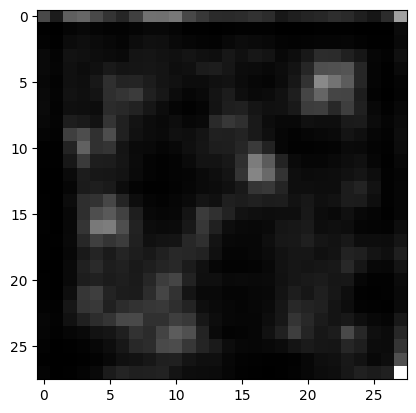

----------------------------------------


Discriminator Loss = 0.1298331320285797
Generator Loss = 2.888486862182617
A sample image generated by the generator


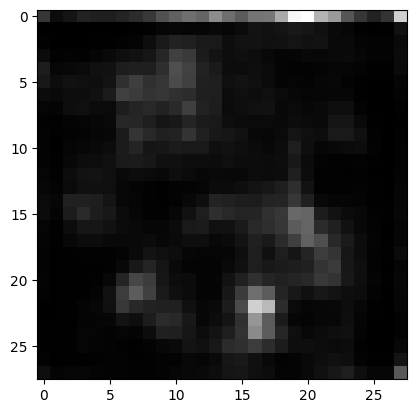

----------------------------------------


Discriminator Loss = 0.1518242359161377
Generator Loss = 2.9240052700042725
A sample image generated by the generator


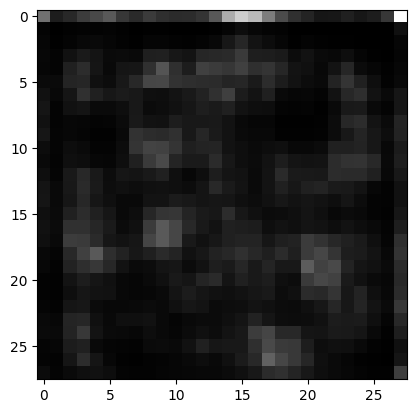

----------------------------------------


Discriminator Loss = 0.13555455207824707
Generator Loss = 2.9385125637054443
A sample image generated by the generator


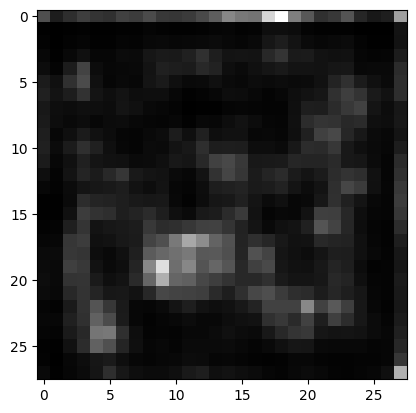

----------------------------------------


Discriminator Loss = 0.13717347383499146
Generator Loss = 2.958346366882324
A sample image generated by the generator


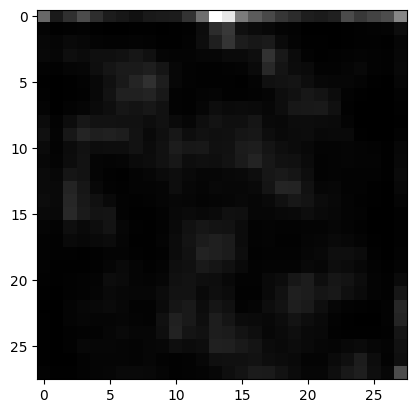

----------------------------------------


Discriminator Loss = 0.12828494608402252
Generator Loss = 2.8940882682800293
A sample image generated by the generator


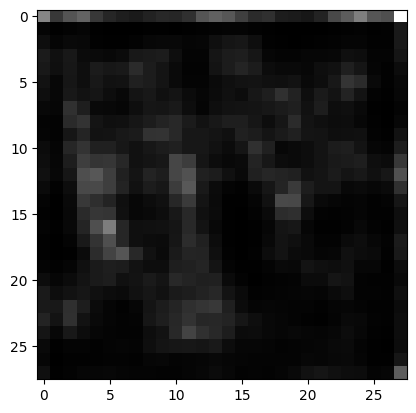

----------------------------------------


Discriminator Loss = 0.1436757743358612
Generator Loss = 2.9372401237487793
A sample image generated by the generator


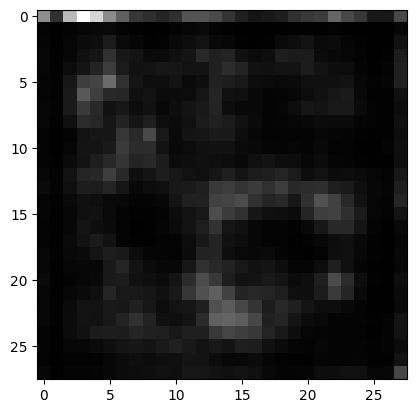

----------------------------------------


Discriminator Loss = 0.13599348068237305
Generator Loss = 2.8969309329986572
A sample image generated by the generator


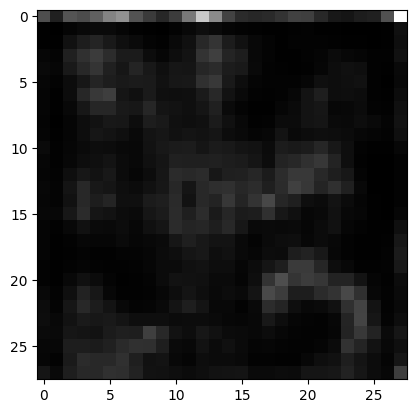

----------------------------------------


Discriminator Loss = 0.1360815167427063
Generator Loss = 3.0674705505371094
A sample image generated by the generator


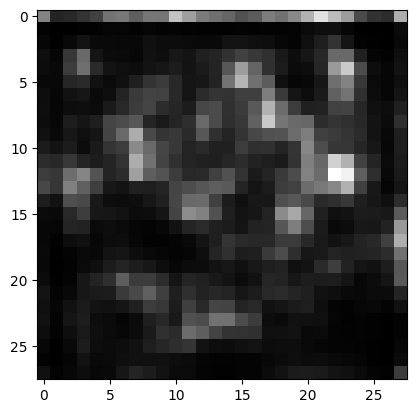

----------------------------------------


Discriminator Loss = 0.12895651161670685
Generator Loss = 2.9244723320007324
A sample image generated by the generator


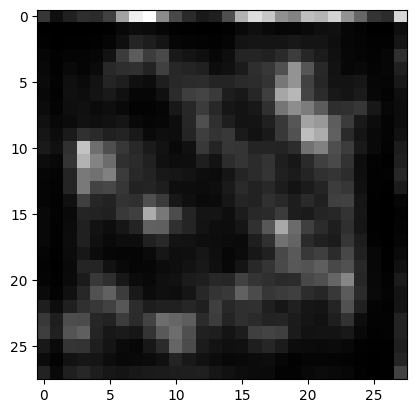

----------------------------------------


Discriminator Loss = 0.13821300864219666
Generator Loss = 2.999068260192871
A sample image generated by the generator


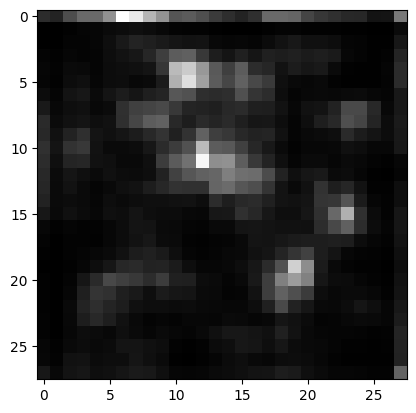

----------------------------------------


Discriminator Loss = 0.12700945138931274
Generator Loss = 2.878227472305298
A sample image generated by the generator


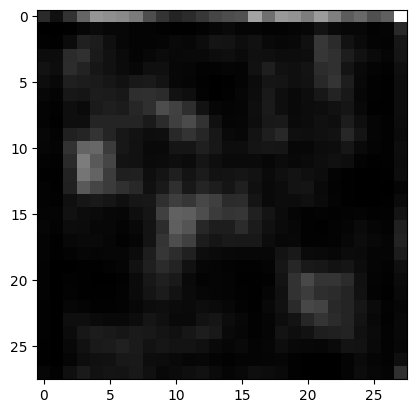

----------------------------------------


Discriminator Loss = 0.13688009977340698
Generator Loss = 2.9107415676116943
A sample image generated by the generator


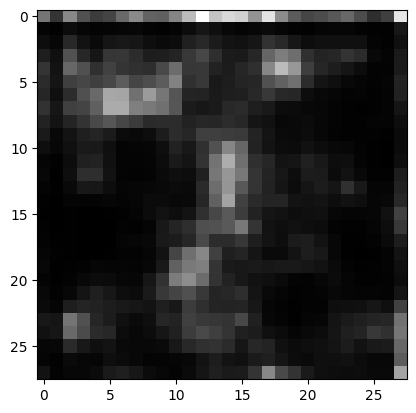

----------------------------------------


Discriminator Loss = 0.1309514343738556
Generator Loss = 2.9511938095092773
A sample image generated by the generator


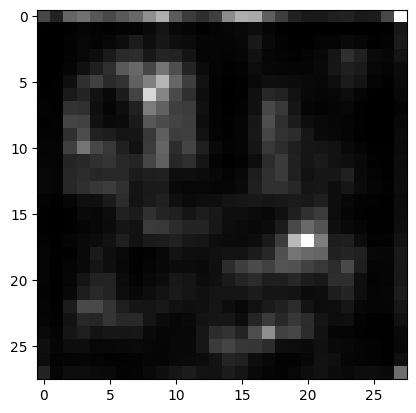

----------------------------------------


Discriminator Loss = 0.13395889103412628
Generator Loss = 3.0411763191223145
A sample image generated by the generator


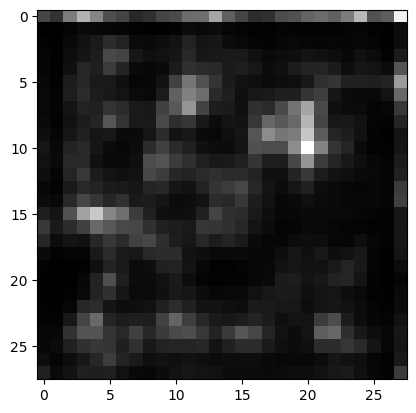

----------------------------------------


Discriminator Loss = 0.1320551037788391
Generator Loss = 2.865116834640503
A sample image generated by the generator


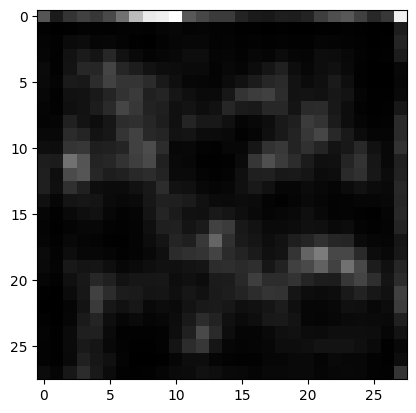

----------------------------------------


Discriminator Loss = 0.1324363797903061
Generator Loss = 2.859072685241699
A sample image generated by the generator


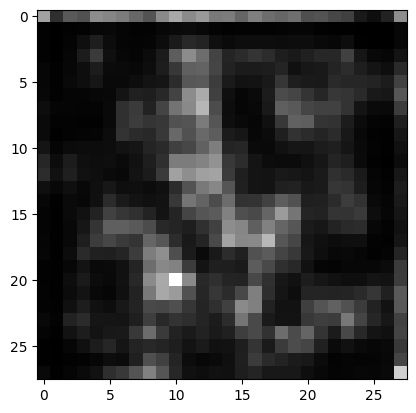

----------------------------------------


Discriminator Loss = 0.13359540700912476
Generator Loss = 2.98823881149292
A sample image generated by the generator


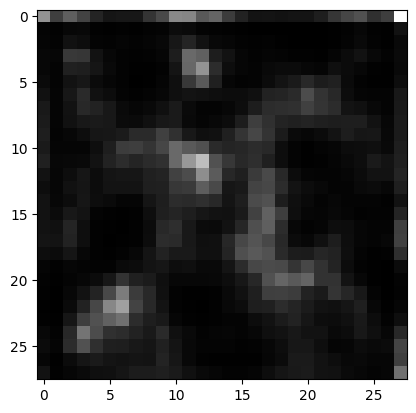

----------------------------------------


Discriminator Loss = 0.14229917526245117
Generator Loss = 2.888310432434082
A sample image generated by the generator


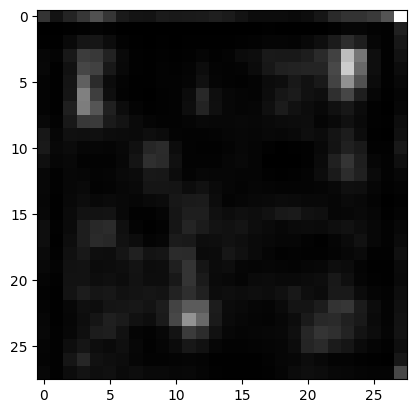

----------------------------------------


Discriminator Loss = 0.13470414280891418
Generator Loss = 3.049819231033325
A sample image generated by the generator


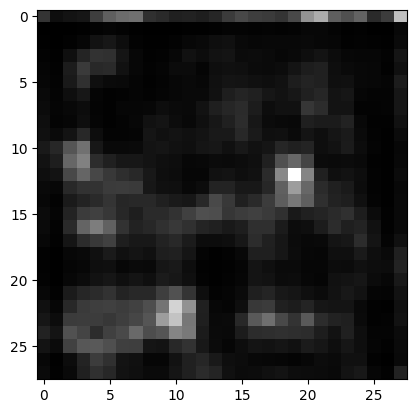

----------------------------------------


Discriminator Loss = 0.14060403406620026
Generator Loss = 2.9927635192871094
A sample image generated by the generator


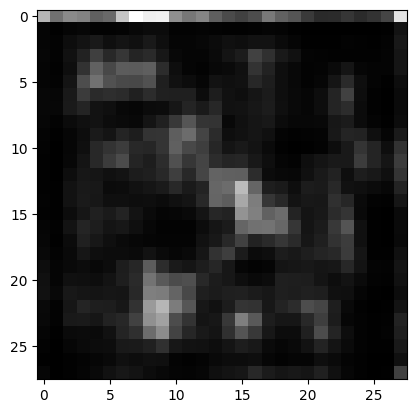

----------------------------------------


Discriminator Loss = 0.14066141843795776
Generator Loss = 3.210132122039795
A sample image generated by the generator


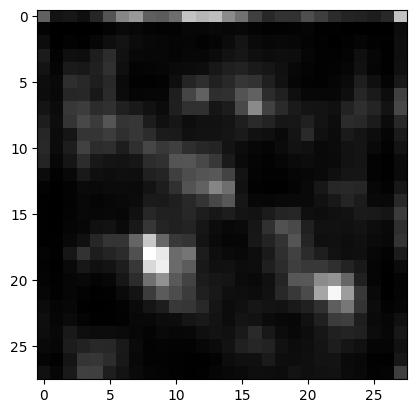

----------------------------------------


Discriminator Loss = 0.12989482283592224
Generator Loss = 2.9648983478546143
A sample image generated by the generator


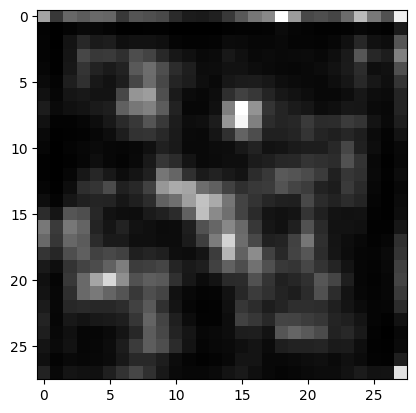

----------------------------------------


Discriminator Loss = 0.1221156194806099
Generator Loss = 3.0026330947875977
A sample image generated by the generator


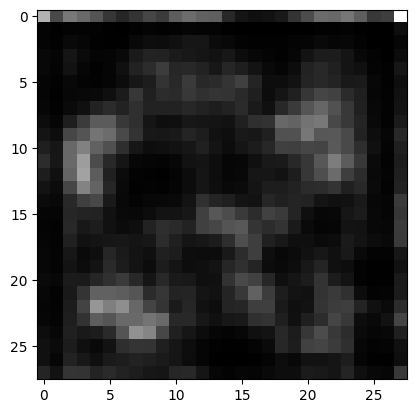

----------------------------------------


Discriminator Loss = 0.12315855920314789
Generator Loss = 2.8084583282470703
A sample image generated by the generator


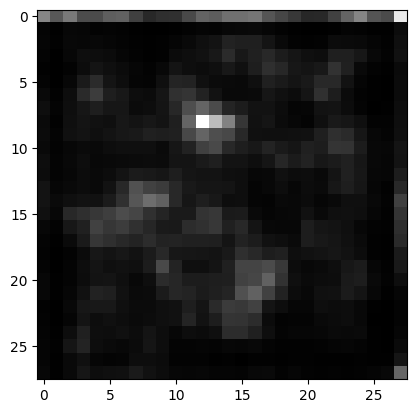

----------------------------------------


Discriminator Loss = 0.14079655706882477
Generator Loss = 2.8905317783355713
A sample image generated by the generator


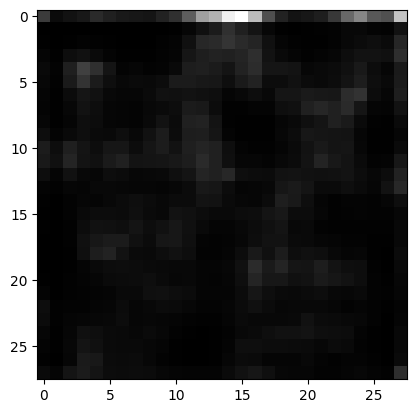

----------------------------------------


Discriminator Loss = 0.1290154755115509
Generator Loss = 2.914877414703369
A sample image generated by the generator


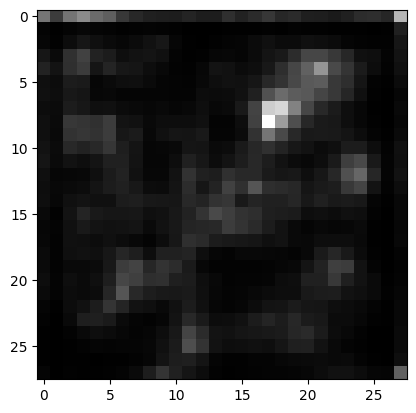

----------------------------------------


Discriminator Loss = 0.12923429906368256
Generator Loss = 2.969712257385254
A sample image generated by the generator


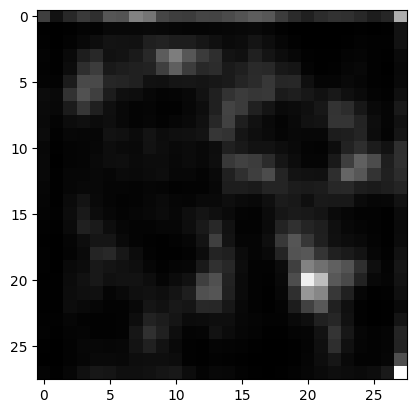

----------------------------------------


Discriminator Loss = 0.12903299927711487
Generator Loss = 2.8129584789276123
A sample image generated by the generator


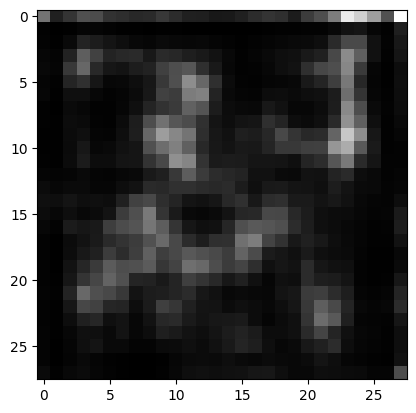

----------------------------------------


Discriminator Loss = 0.12140422314405441
Generator Loss = 2.984675407409668
A sample image generated by the generator


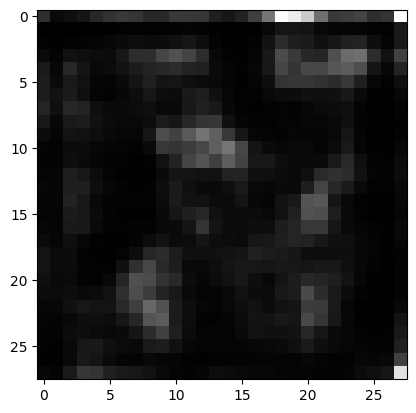

----------------------------------------


Discriminator Loss = 0.1281244158744812
Generator Loss = 2.9494469165802
A sample image generated by the generator


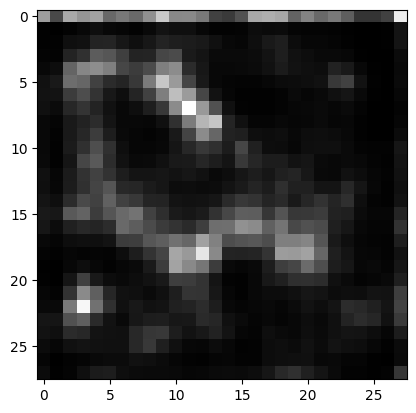

----------------------------------------


Discriminator Loss = 0.11662228405475616
Generator Loss = 2.790527582168579
A sample image generated by the generator


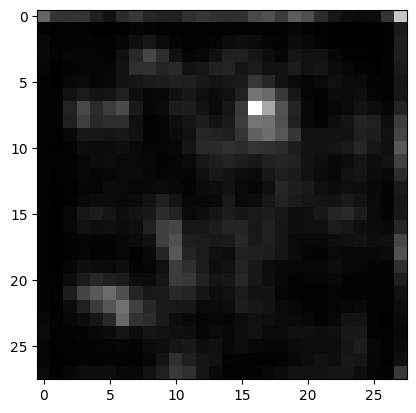

----------------------------------------


Discriminator Loss = 0.13180357217788696
Generator Loss = 2.916536808013916
A sample image generated by the generator


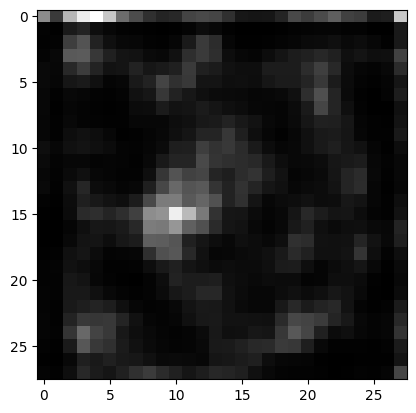

----------------------------------------


Discriminator Loss = 0.11806464195251465
Generator Loss = 2.896122455596924
A sample image generated by the generator


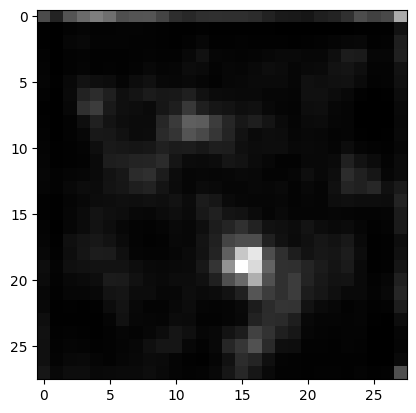

----------------------------------------


Discriminator Loss = 0.12967881560325623
Generator Loss = 2.9282240867614746
A sample image generated by the generator


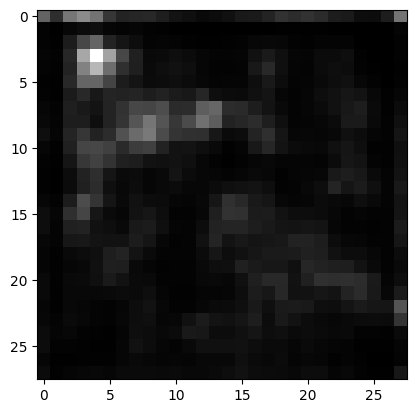

----------------------------------------


Discriminator Loss = 0.12340213358402252
Generator Loss = 2.927919864654541
A sample image generated by the generator


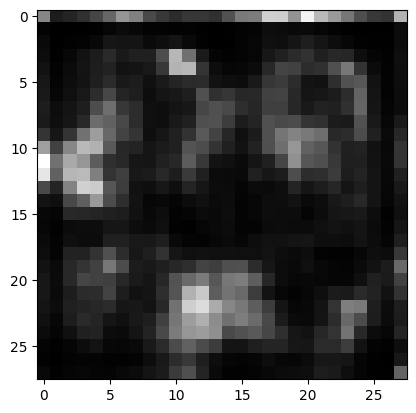

----------------------------------------


Discriminator Loss = 0.13262999057769775
Generator Loss = 2.873197555541992
A sample image generated by the generator


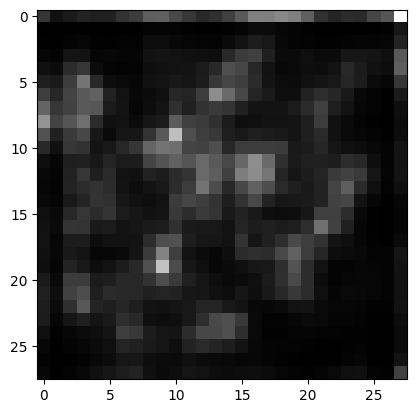

----------------------------------------


Discriminator Loss = 0.13294395804405212
Generator Loss = 2.914675712585449
A sample image generated by the generator


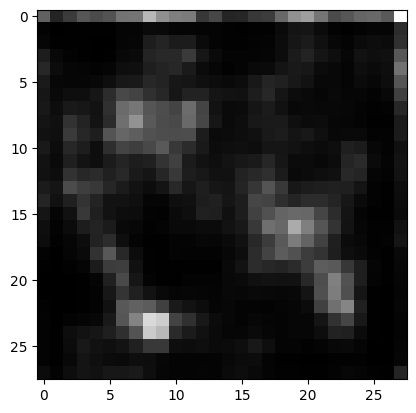

----------------------------------------


Discriminator Loss = 0.11391130834817886
Generator Loss = 2.9452741146087646
A sample image generated by the generator


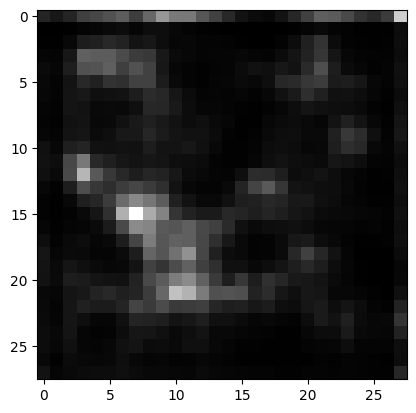

----------------------------------------


Discriminator Loss = 0.12415049970149994
Generator Loss = 2.968322277069092
A sample image generated by the generator


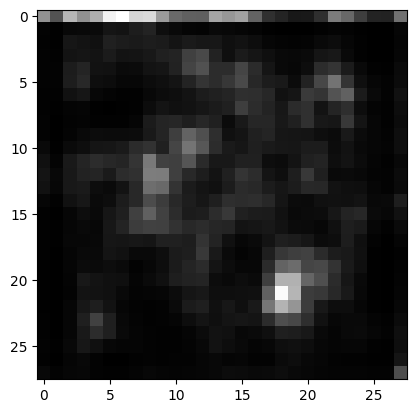

----------------------------------------


Discriminator Loss = 0.1284179389476776
Generator Loss = 3.066351890563965
A sample image generated by the generator


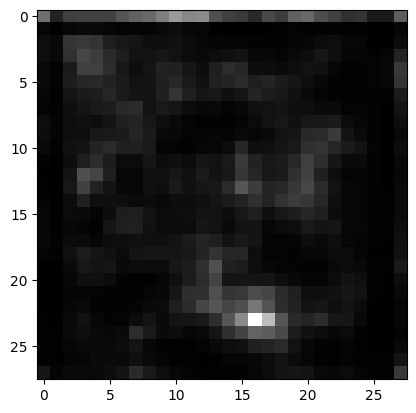

----------------------------------------


Discriminator Loss = 0.1261424422264099
Generator Loss = 2.9087469577789307
A sample image generated by the generator


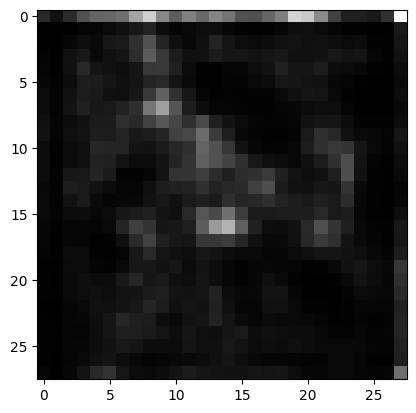

----------------------------------------


Discriminator Loss = 0.1277686059474945
Generator Loss = 2.991788387298584
A sample image generated by the generator


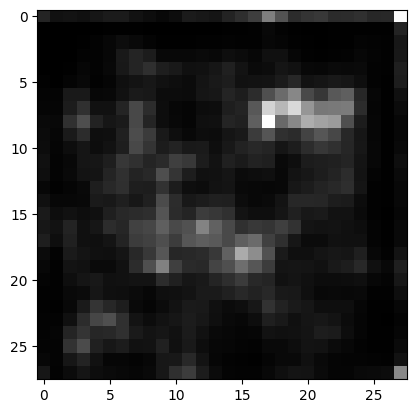

----------------------------------------


Discriminator Loss = 0.12671591341495514
Generator Loss = 2.9729037284851074
A sample image generated by the generator


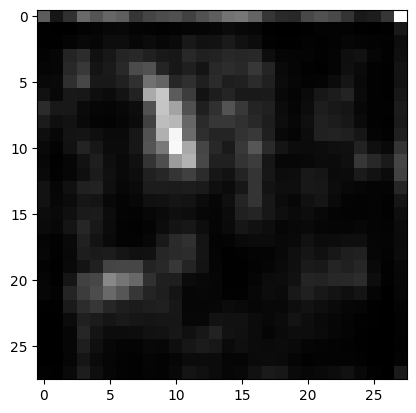

----------------------------------------


Discriminator Loss = 0.12048465758562088
Generator Loss = 2.935037136077881
A sample image generated by the generator


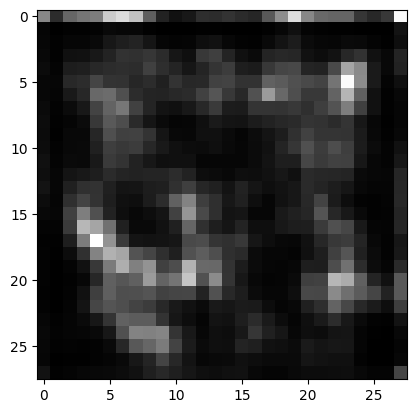

----------------------------------------


Discriminator Loss = 0.13286378979682922
Generator Loss = 2.814573049545288
A sample image generated by the generator


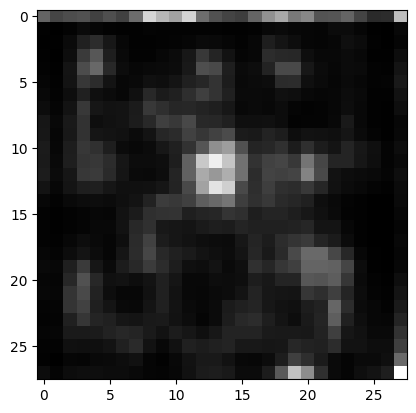

----------------------------------------


Discriminator Loss = 0.1357089877128601
Generator Loss = 3.012782096862793
A sample image generated by the generator


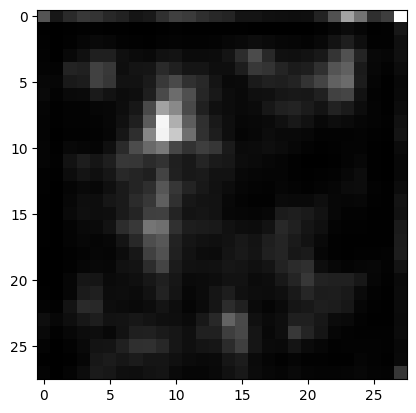

----------------------------------------


Discriminator Loss = 0.12061135470867157
Generator Loss = 2.8932056427001953
A sample image generated by the generator


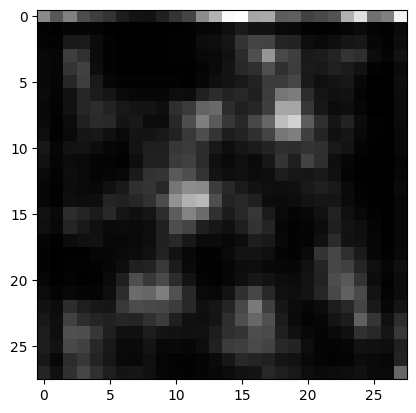

----------------------------------------


Discriminator Loss = 0.11363581568002701
Generator Loss = 2.97402286529541
A sample image generated by the generator


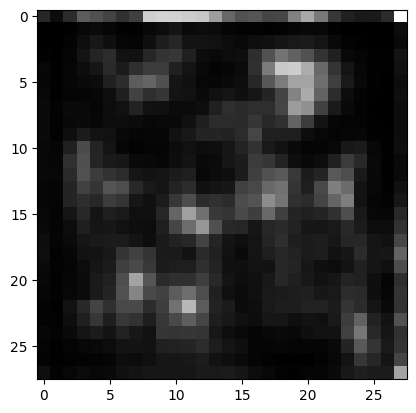

----------------------------------------


Discriminator Loss = 0.1272524893283844
Generator Loss = 2.8501782417297363
A sample image generated by the generator


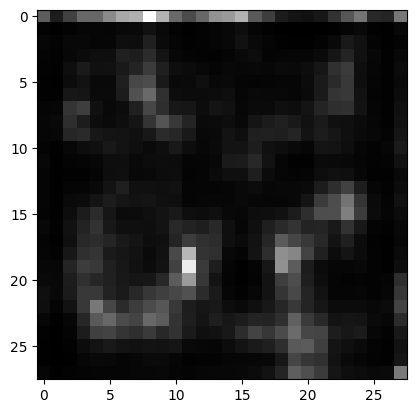

----------------------------------------


Discriminator Loss = 0.12594430148601532
Generator Loss = 2.9898293018341064
A sample image generated by the generator


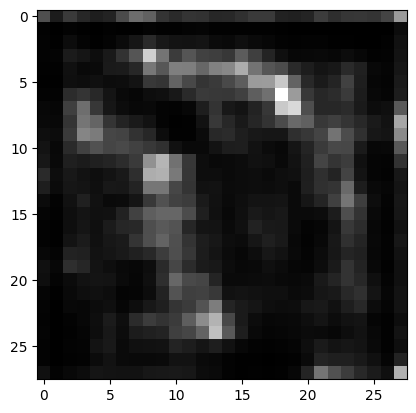

----------------------------------------


Discriminator Loss = 0.12986525893211365
Generator Loss = 3.0218677520751953
A sample image generated by the generator


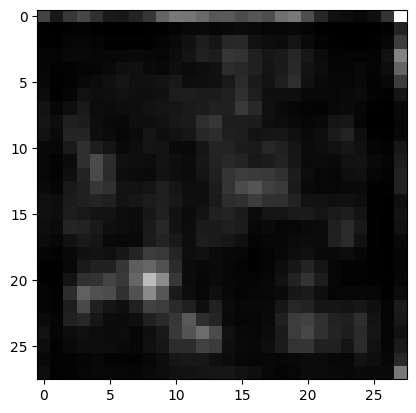

----------------------------------------


Discriminator Loss = 0.1308152824640274
Generator Loss = 2.996074914932251
A sample image generated by the generator


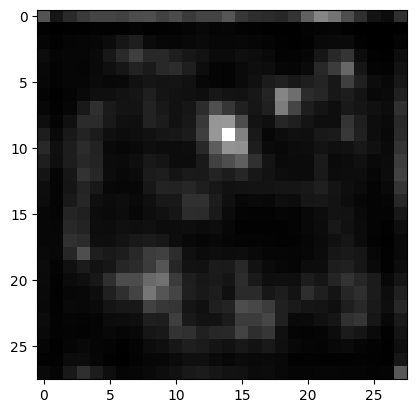

----------------------------------------


Discriminator Loss = 0.12836501002311707
Generator Loss = 2.9123711585998535
A sample image generated by the generator


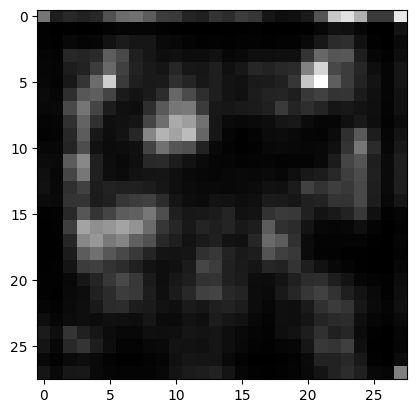

----------------------------------------


Discriminator Loss = 0.12760776281356812
Generator Loss = 3.087101936340332
A sample image generated by the generator


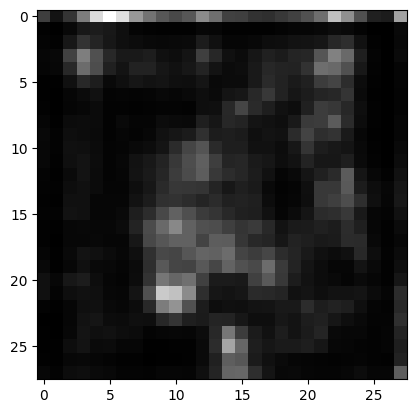

----------------------------------------


Discriminator Loss = 0.14020539820194244
Generator Loss = 2.8378419876098633
A sample image generated by the generator


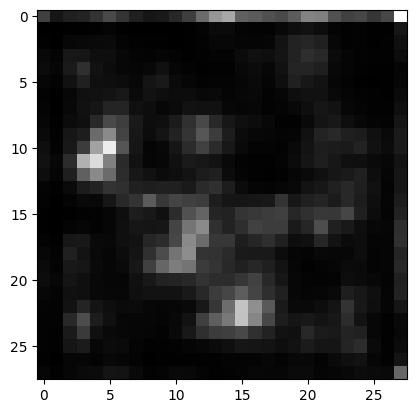

----------------------------------------


Discriminator Loss = 0.12313402444124222
Generator Loss = 2.9663915634155273
A sample image generated by the generator


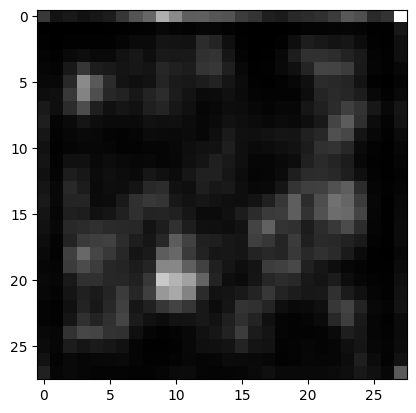

----------------------------------------


Discriminator Loss = 0.12966084480285645
Generator Loss = 2.962313413619995
A sample image generated by the generator


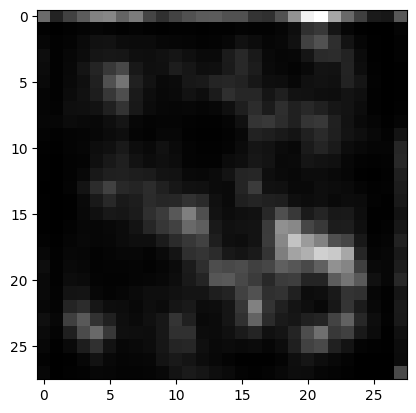

----------------------------------------


Discriminator Loss = 0.12940314412117004
Generator Loss = 2.9950990676879883
A sample image generated by the generator


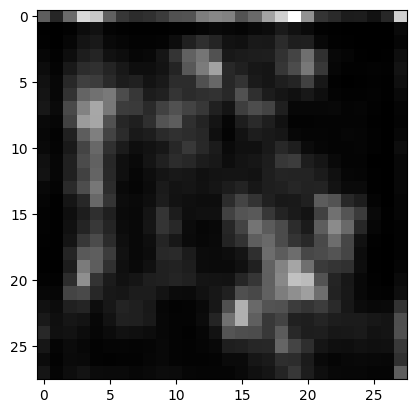

----------------------------------------


Discriminator Loss = 0.12364013493061066
Generator Loss = 3.0508670806884766
A sample image generated by the generator


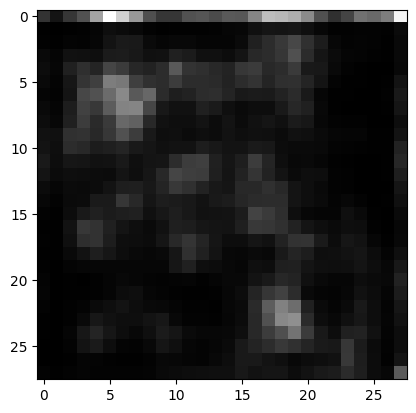

----------------------------------------


Discriminator Loss = 0.13333575427532196
Generator Loss = 2.983035087585449
A sample image generated by the generator


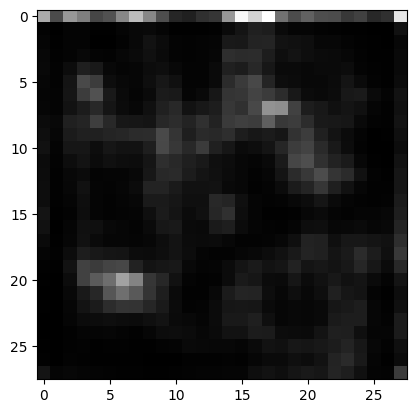

----------------------------------------


Discriminator Loss = 0.12829039990901947
Generator Loss = 3.0470986366271973
A sample image generated by the generator


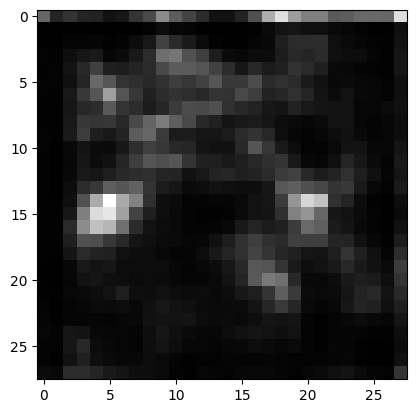

----------------------------------------


Discriminator Loss = 0.12397892773151398
Generator Loss = 2.9301609992980957
A sample image generated by the generator


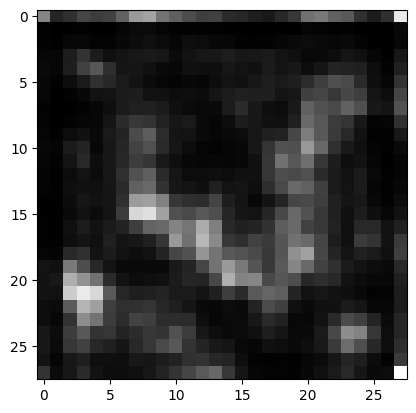

----------------------------------------


Discriminator Loss = 0.12409652769565582
Generator Loss = 2.974982738494873
A sample image generated by the generator


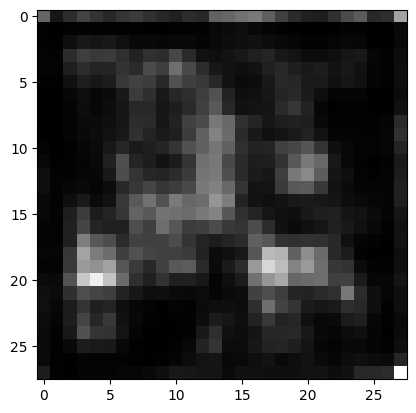

----------------------------------------


Discriminator Loss = 0.1206500381231308
Generator Loss = 2.982635259628296
A sample image generated by the generator


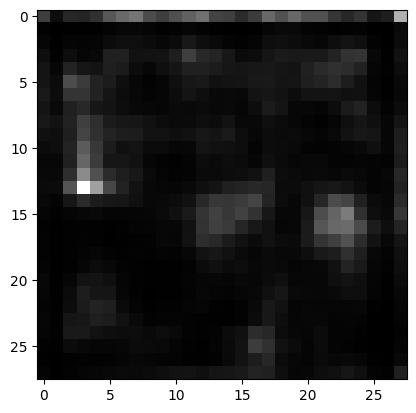

----------------------------------------


Discriminator Loss = 0.11467353999614716
Generator Loss = 2.9318556785583496
A sample image generated by the generator


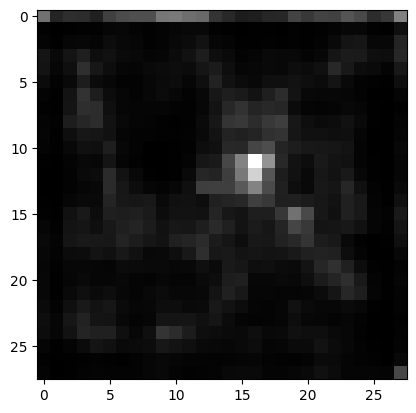

----------------------------------------


Discriminator Loss = 0.11367923021316528
Generator Loss = 3.0246360301971436
A sample image generated by the generator


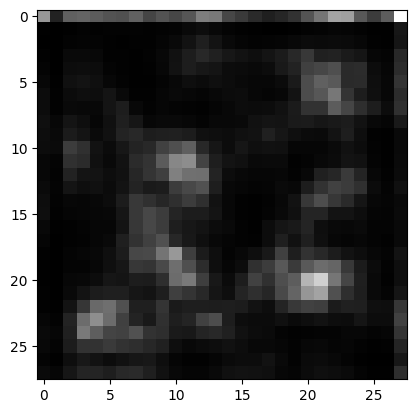

----------------------------------------


Discriminator Loss = 0.13087937235832214
Generator Loss = 2.966128349304199
A sample image generated by the generator


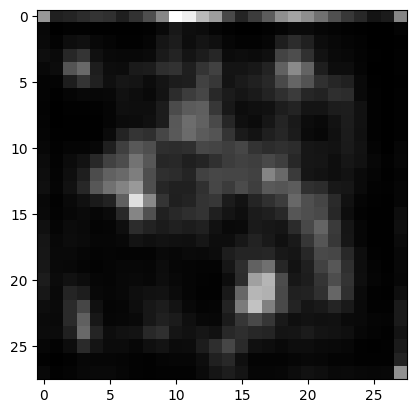

----------------------------------------


Discriminator Loss = 0.11450448632240295
Generator Loss = 2.9614100456237793
A sample image generated by the generator


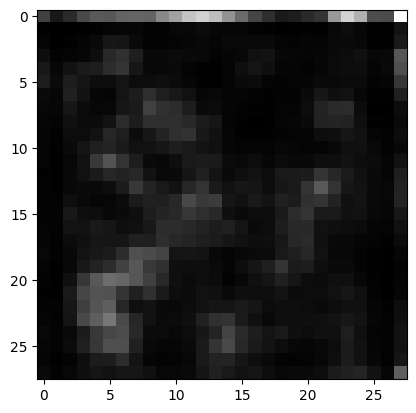

----------------------------------------


Discriminator Loss = 0.1251469850540161
Generator Loss = 2.9270968437194824
A sample image generated by the generator


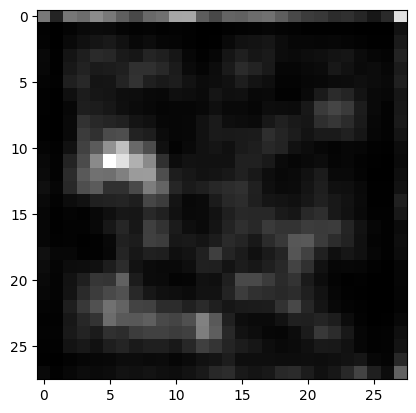

----------------------------------------


Discriminator Loss = 0.12166623026132584
Generator Loss = 3.148193120956421
A sample image generated by the generator


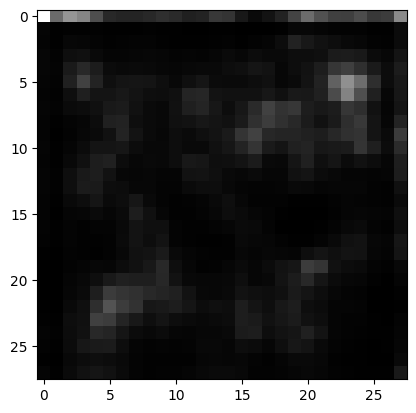

----------------------------------------


Discriminator Loss = 0.11571091413497925
Generator Loss = 2.979414224624634
A sample image generated by the generator


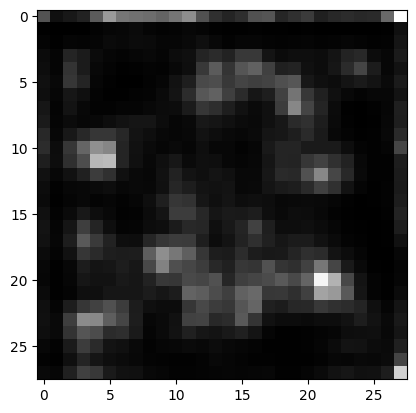

----------------------------------------


Discriminator Loss = 0.12308382987976074
Generator Loss = 2.9016690254211426
A sample image generated by the generator


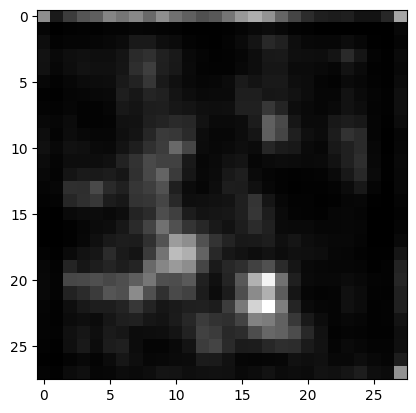

----------------------------------------


Discriminator Loss = 0.12302225828170776
Generator Loss = 3.0220446586608887
A sample image generated by the generator


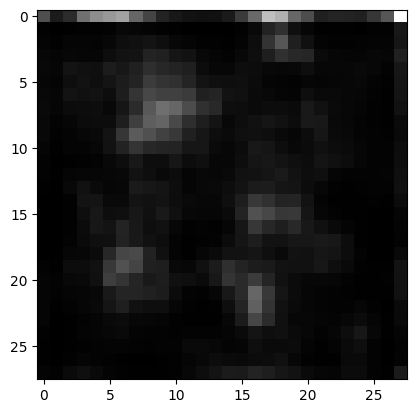

----------------------------------------


Discriminator Loss = 0.12761804461479187
Generator Loss = 3.089750051498413
A sample image generated by the generator


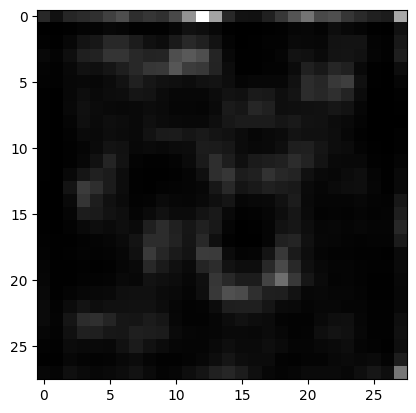

----------------------------------------


Discriminator Loss = 0.1327325999736786
Generator Loss = 2.9363858699798584
A sample image generated by the generator


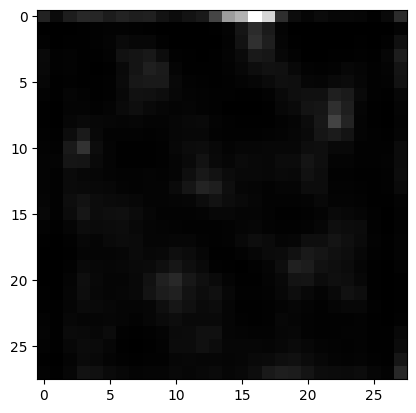

----------------------------------------


Discriminator Loss = 0.1326126754283905
Generator Loss = 3.00251841545105
A sample image generated by the generator


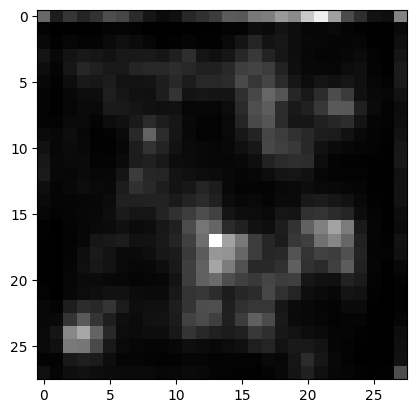

----------------------------------------


Discriminator Loss = 0.1221928521990776
Generator Loss = 2.941479444503784
A sample image generated by the generator


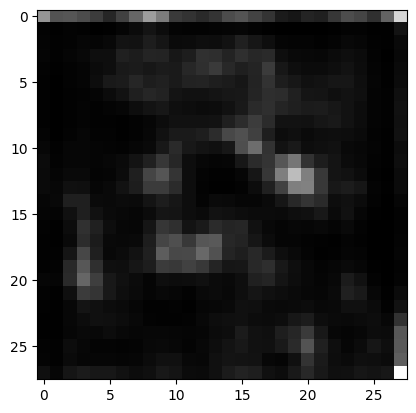

----------------------------------------


Discriminator Loss = 0.11757147312164307
Generator Loss = 2.978881359100342
A sample image generated by the generator


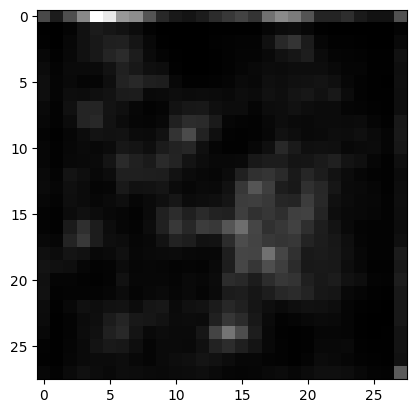

----------------------------------------


Discriminator Loss = 0.12806889414787292
Generator Loss = 2.9546799659729004
A sample image generated by the generator


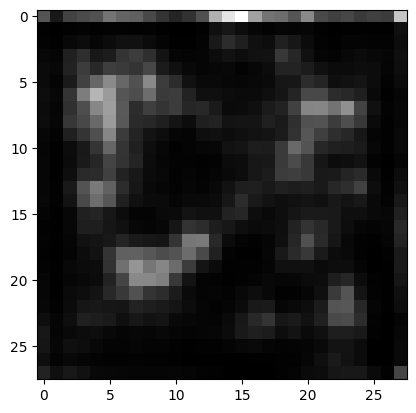

----------------------------------------


Discriminator Loss = 0.12162386626005173
Generator Loss = 3.088850736618042
A sample image generated by the generator


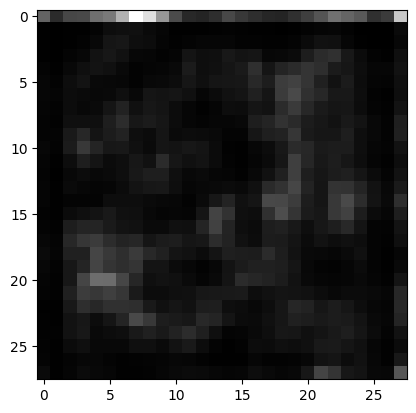

----------------------------------------


Discriminator Loss = 0.1131526306271553
Generator Loss = 2.9789395332336426
A sample image generated by the generator


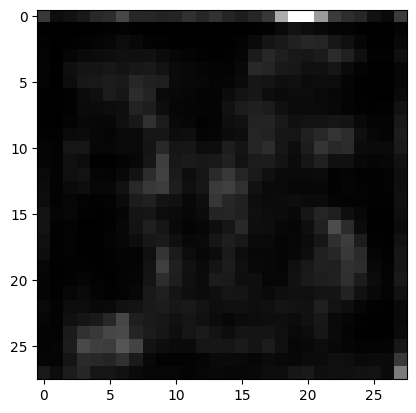

----------------------------------------


Discriminator Loss = 0.11972325295209885
Generator Loss = 3.004344940185547
A sample image generated by the generator


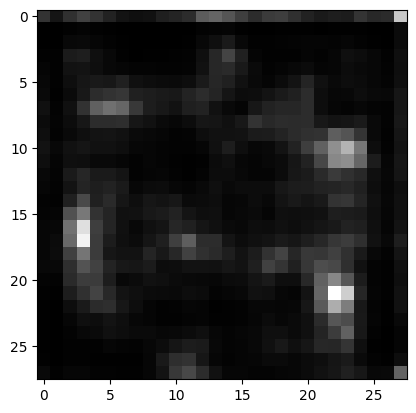

----------------------------------------


Discriminator Loss = 0.11580684781074524
Generator Loss = 2.945681095123291
A sample image generated by the generator


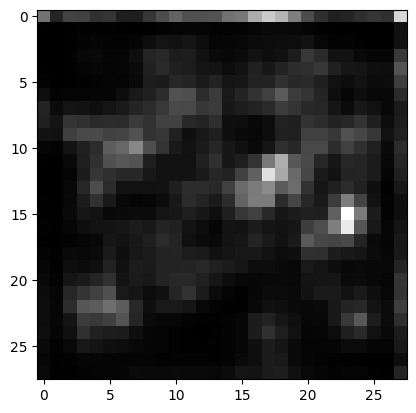

----------------------------------------


Discriminator Loss = 0.12335805594921112
Generator Loss = 2.986424207687378
A sample image generated by the generator


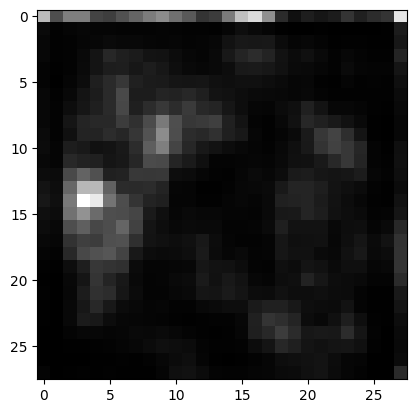

----------------------------------------


Discriminator Loss = 0.1109977662563324
Generator Loss = 3.0586085319519043
A sample image generated by the generator


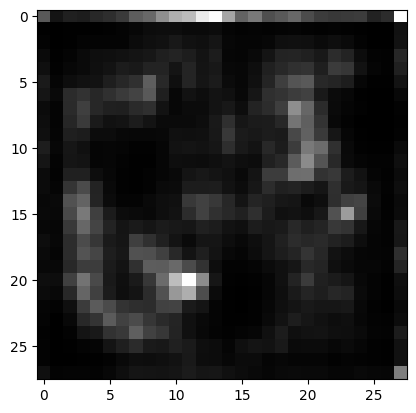

----------------------------------------


Discriminator Loss = 0.12062425911426544
Generator Loss = 2.9806106090545654
A sample image generated by the generator


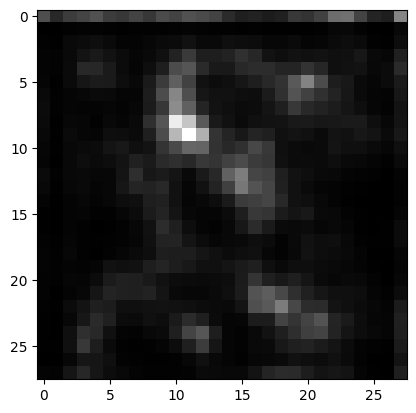

----------------------------------------


Discriminator Loss = 0.10838858038187027
Generator Loss = 3.1731739044189453
A sample image generated by the generator


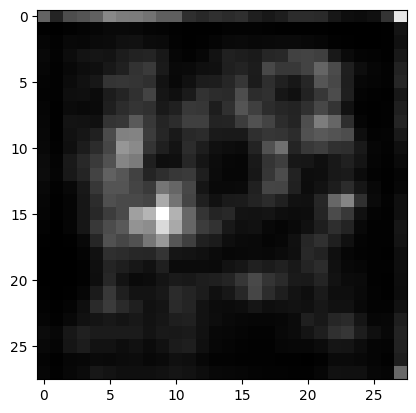

----------------------------------------


Discriminator Loss = 0.1276269257068634
Generator Loss = 2.97330379486084
A sample image generated by the generator


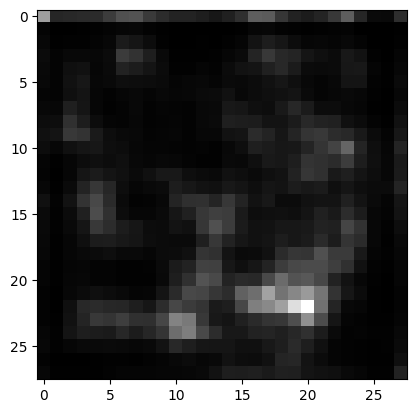

----------------------------------------


Discriminator Loss = 0.12070776522159576
Generator Loss = 3.0862932205200195
A sample image generated by the generator


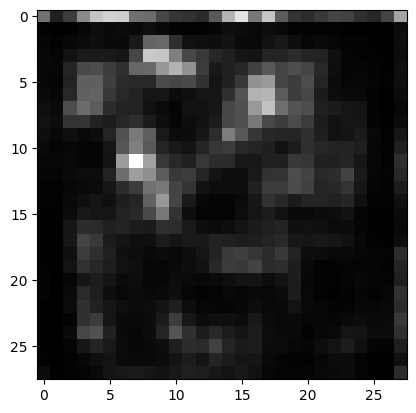

----------------------------------------


Discriminator Loss = 0.1103370264172554
Generator Loss = 3.020721435546875
A sample image generated by the generator


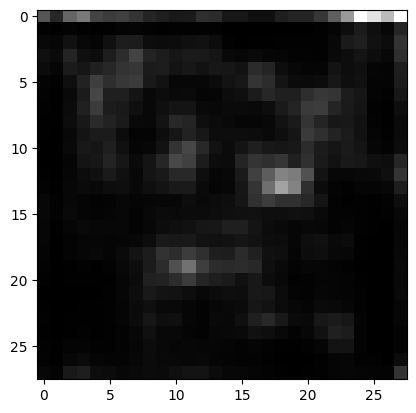

----------------------------------------


Discriminator Loss = 0.1281406581401825
Generator Loss = 3.0507307052612305
A sample image generated by the generator


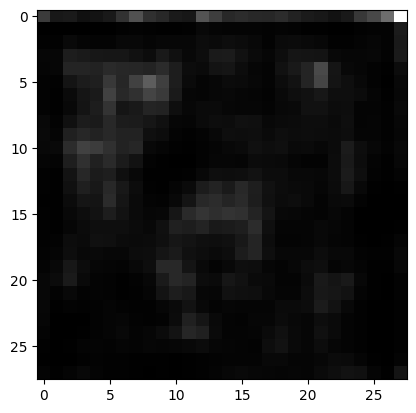

----------------------------------------


Discriminator Loss = 0.12145087122917175
Generator Loss = 3.0142908096313477
A sample image generated by the generator


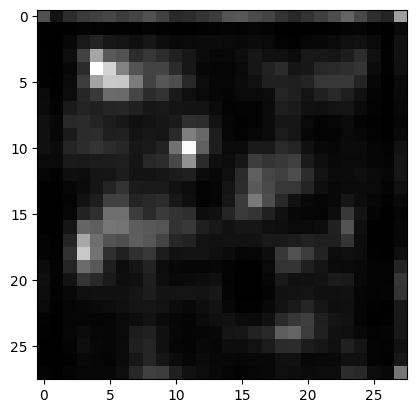

----------------------------------------


Discriminator Loss = 0.11371471732854843
Generator Loss = 3.0682294368743896
A sample image generated by the generator


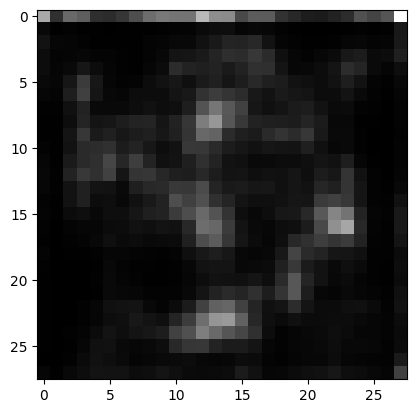

----------------------------------------


Discriminator Loss = 0.13155896961688995
Generator Loss = 2.964585304260254
A sample image generated by the generator


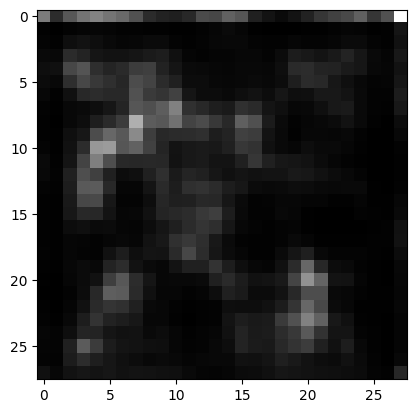

----------------------------------------


Discriminator Loss = 0.11875835061073303
Generator Loss = 3.171989917755127
A sample image generated by the generator


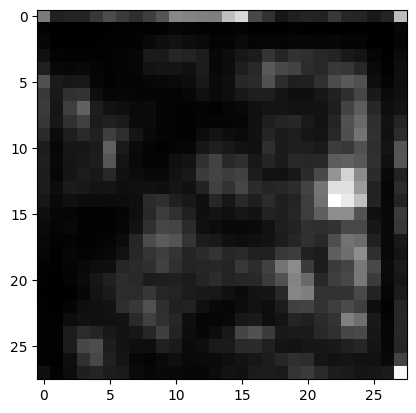

----------------------------------------


Discriminator Loss = 0.11520043760538101
Generator Loss = 3.093789577484131
A sample image generated by the generator


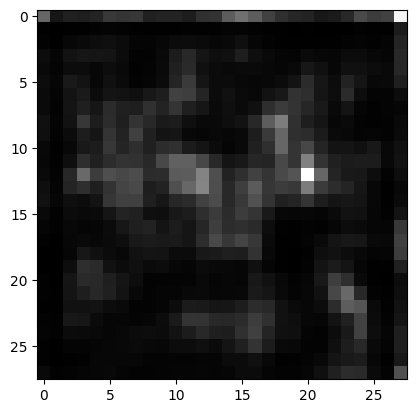

----------------------------------------


Discriminator Loss = 0.1292230486869812
Generator Loss = 2.9064157009124756
A sample image generated by the generator


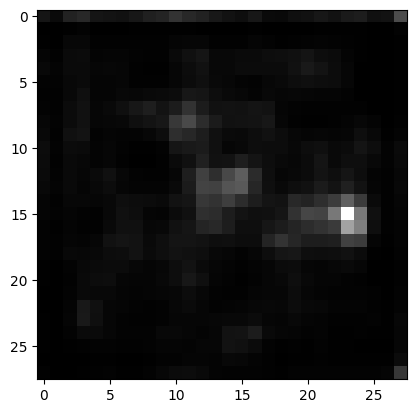

----------------------------------------


Discriminator Loss = 0.11047157645225525
Generator Loss = 2.912071704864502
A sample image generated by the generator


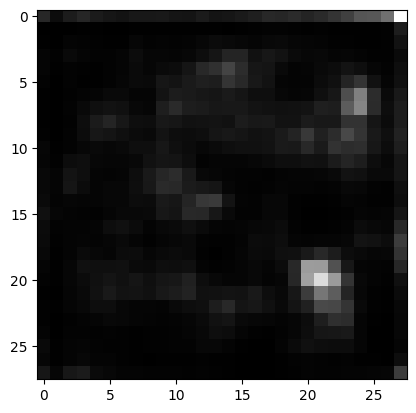

----------------------------------------


Discriminator Loss = 0.12303177267313004
Generator Loss = 3.1056673526763916
A sample image generated by the generator


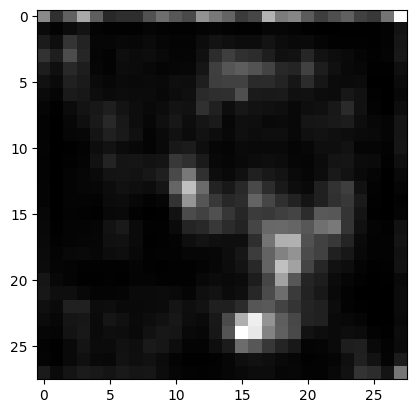

----------------------------------------


Discriminator Loss = 0.1307167112827301
Generator Loss = 3.025264263153076
A sample image generated by the generator


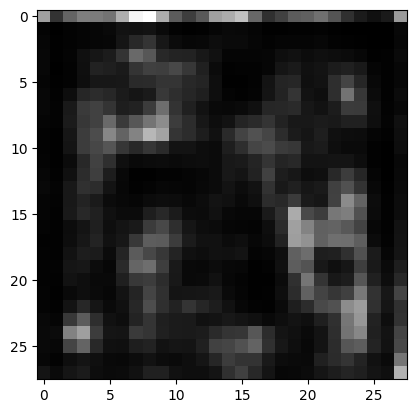

----------------------------------------


Discriminator Loss = 0.11818347871303558
Generator Loss = 3.014625072479248
A sample image generated by the generator


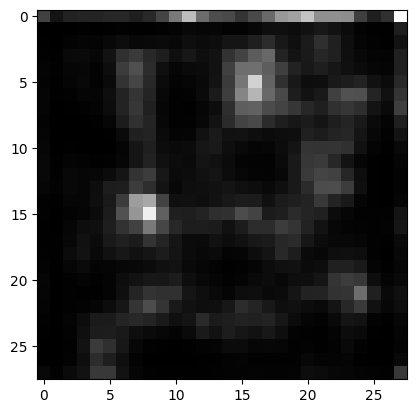

----------------------------------------


Discriminator Loss = 0.12655699253082275
Generator Loss = 3.1440954208374023
A sample image generated by the generator


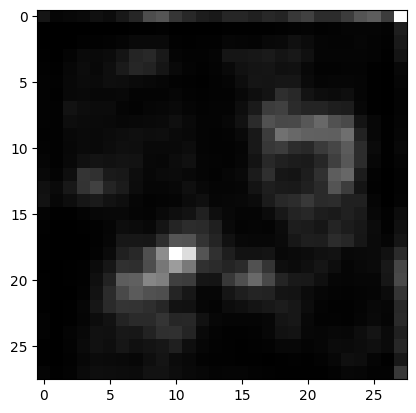

----------------------------------------


Discriminator Loss = 0.115059494972229
Generator Loss = 2.936701774597168
A sample image generated by the generator


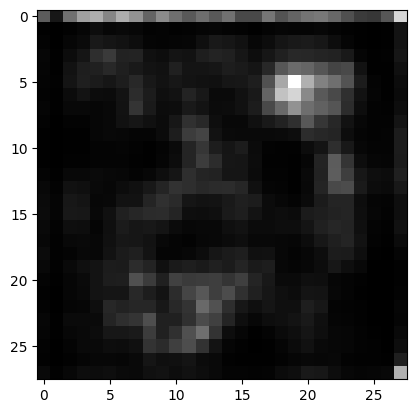

----------------------------------------


Discriminator Loss = 0.11452364176511765
Generator Loss = 3.035820245742798
A sample image generated by the generator


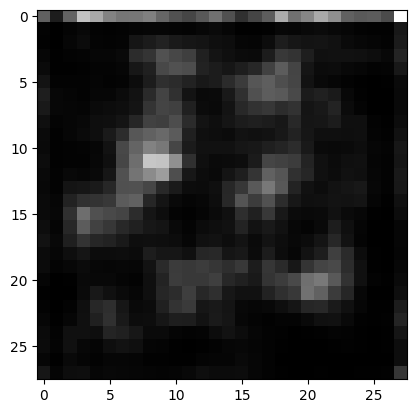

----------------------------------------


Discriminator Loss = 0.11644099652767181
Generator Loss = 2.9350194931030273
A sample image generated by the generator


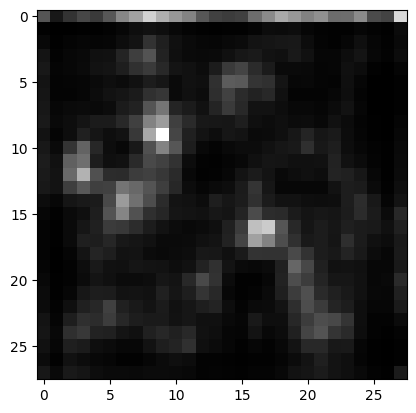

----------------------------------------


Discriminator Loss = 0.12138967961072922
Generator Loss = 3.119018077850342
A sample image generated by the generator


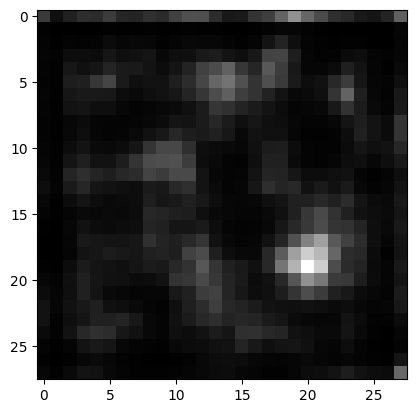

----------------------------------------


Discriminator Loss = 0.11745069921016693
Generator Loss = 2.991014003753662
A sample image generated by the generator


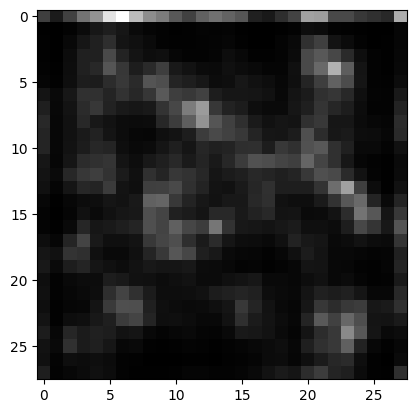

----------------------------------------


Discriminator Loss = 0.10622357577085495
Generator Loss = 3.0918803215026855
A sample image generated by the generator


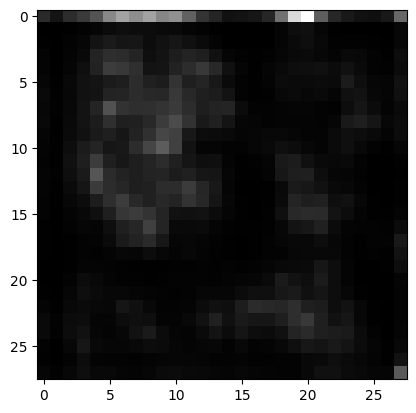

----------------------------------------


Discriminator Loss = 0.12256400287151337
Generator Loss = 3.10048246383667
A sample image generated by the generator


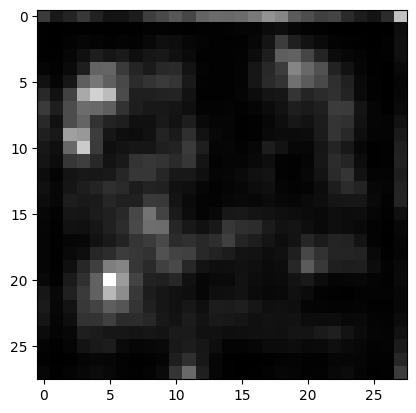

----------------------------------------


Discriminator Loss = 0.11696857213973999
Generator Loss = 3.0880935192108154
A sample image generated by the generator


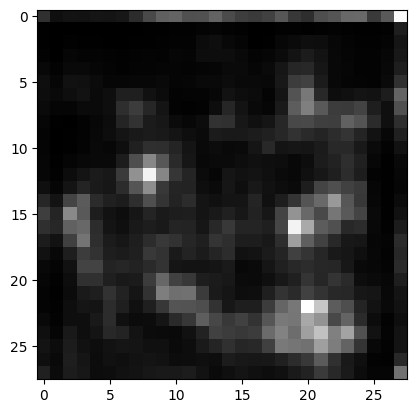

----------------------------------------


Discriminator Loss = 0.12200672924518585
Generator Loss = 3.1166462898254395
A sample image generated by the generator


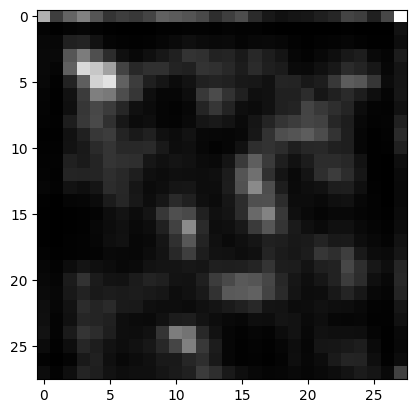

----------------------------------------


Discriminator Loss = 0.13118970394134521
Generator Loss = 3.059880256652832
A sample image generated by the generator


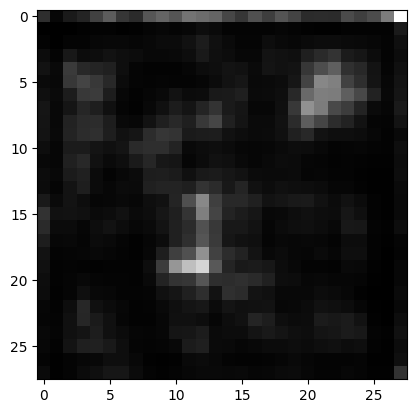

----------------------------------------


Discriminator Loss = 0.12951669096946716
Generator Loss = 3.1120362281799316
A sample image generated by the generator


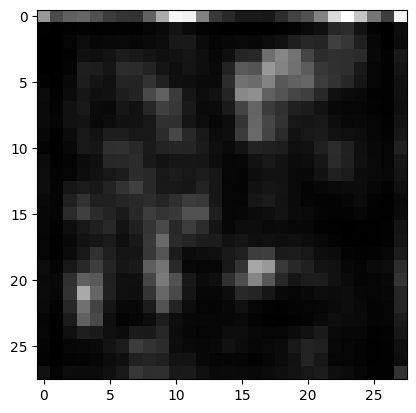

----------------------------------------


Discriminator Loss = 0.1148262619972229
Generator Loss = 3.035721778869629
A sample image generated by the generator


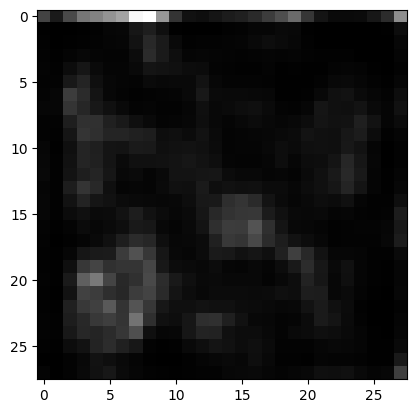

----------------------------------------


Discriminator Loss = 0.11829586327075958
Generator Loss = 3.0164260864257812
A sample image generated by the generator


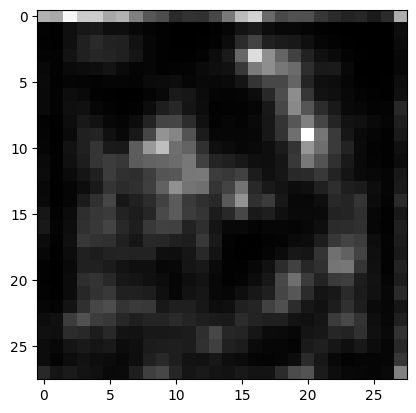

----------------------------------------


Discriminator Loss = 0.12082847207784653
Generator Loss = 3.0891666412353516
A sample image generated by the generator


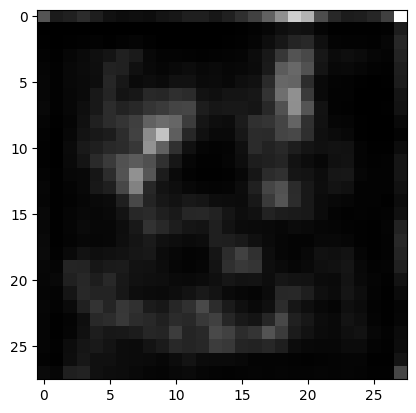

----------------------------------------


Discriminator Loss = 0.12400437146425247
Generator Loss = 2.926302194595337
A sample image generated by the generator


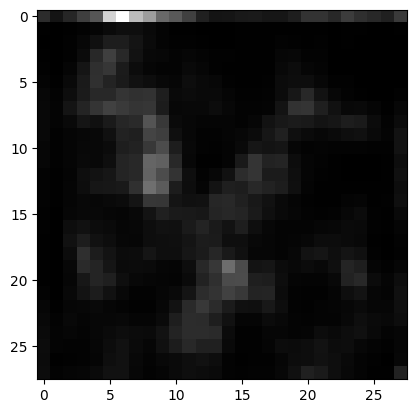

----------------------------------------


Discriminator Loss = 0.10708362609148026
Generator Loss = 3.0464553833007812
A sample image generated by the generator


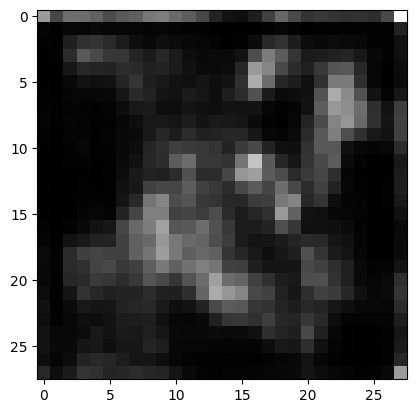

----------------------------------------


Discriminator Loss = 0.1243736743927002
Generator Loss = 3.1392946243286133
A sample image generated by the generator


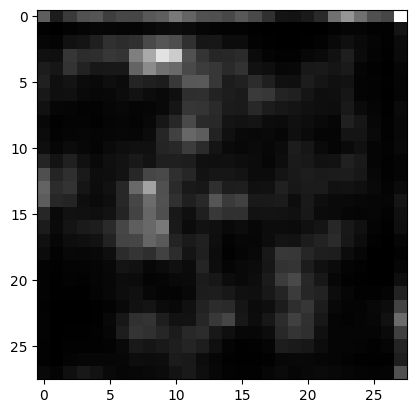

----------------------------------------


Discriminator Loss = 0.11217162758111954
Generator Loss = 3.1108241081237793
A sample image generated by the generator


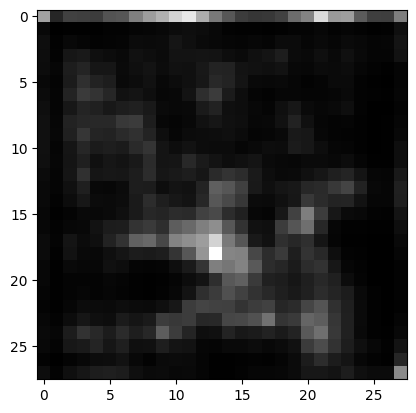

----------------------------------------


Discriminator Loss = 0.11888110637664795
Generator Loss = 3.0163893699645996
A sample image generated by the generator


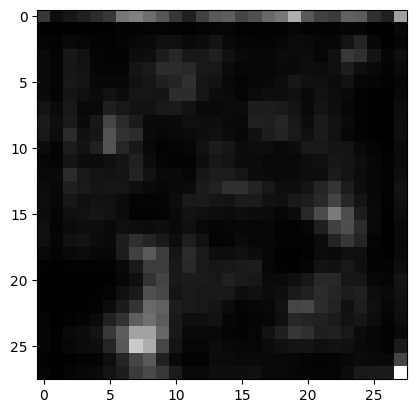

----------------------------------------


Discriminator Loss = 0.1127806305885315
Generator Loss = 3.1079165935516357
A sample image generated by the generator


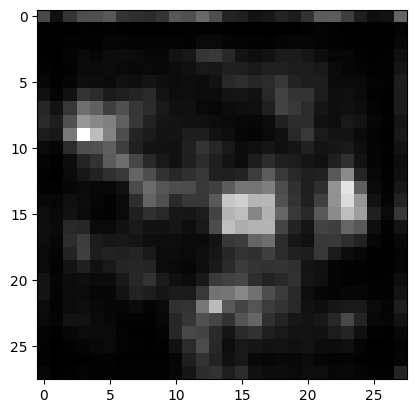

----------------------------------------


Discriminator Loss = 0.1177191287279129
Generator Loss = 3.0226540565490723
A sample image generated by the generator


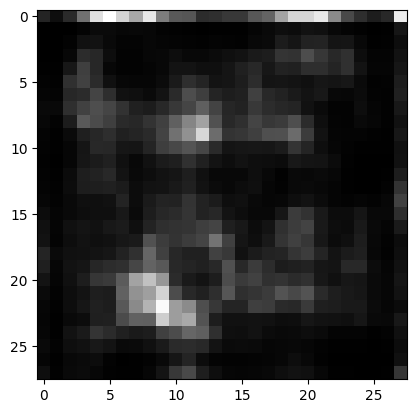

----------------------------------------


Discriminator Loss = 0.1165236234664917
Generator Loss = 3.142033576965332
A sample image generated by the generator


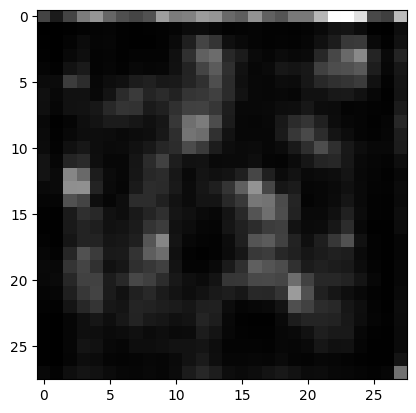

----------------------------------------


Discriminator Loss = 0.11005085706710815
Generator Loss = 3.131053924560547
A sample image generated by the generator


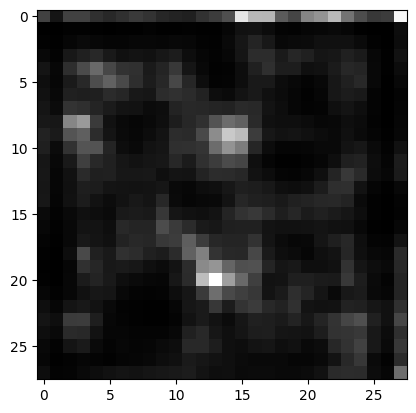

----------------------------------------


Discriminator Loss = 0.11644972860813141
Generator Loss = 3.02530574798584
A sample image generated by the generator


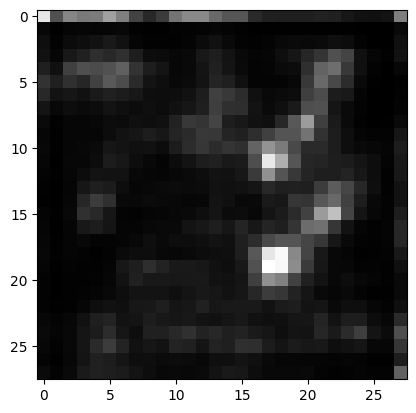

----------------------------------------


Discriminator Loss = 0.11262806504964828
Generator Loss = 3.0368845462799072
A sample image generated by the generator


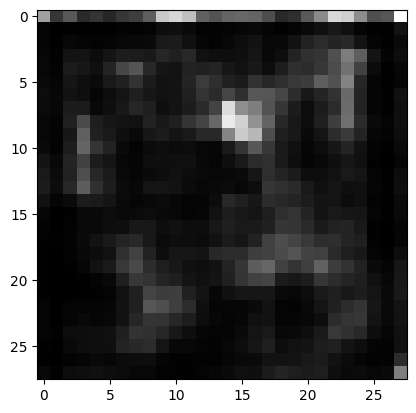

----------------------------------------


Discriminator Loss = 0.11812061816453934
Generator Loss = 3.0690886974334717
A sample image generated by the generator


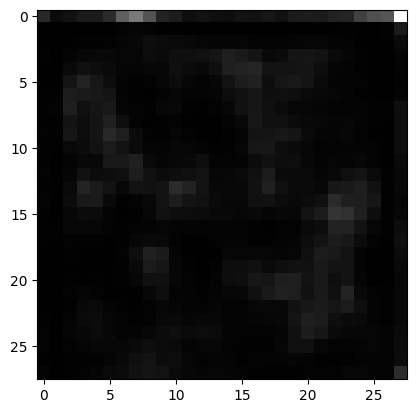

----------------------------------------


Discriminator Loss = 0.11370167881250381
Generator Loss = 3.0498440265655518
A sample image generated by the generator


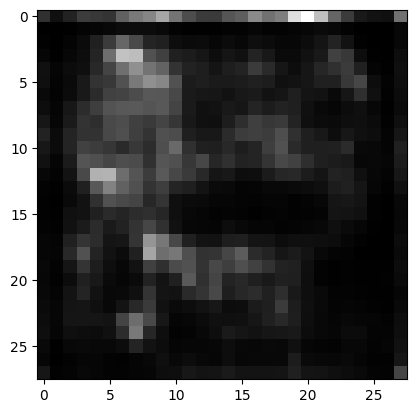

----------------------------------------


Discriminator Loss = 0.11771855503320694
Generator Loss = 3.0264105796813965
A sample image generated by the generator


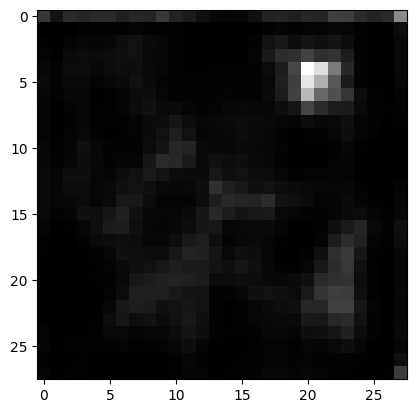

----------------------------------------


Discriminator Loss = 0.11696234345436096
Generator Loss = 3.1197574138641357
A sample image generated by the generator


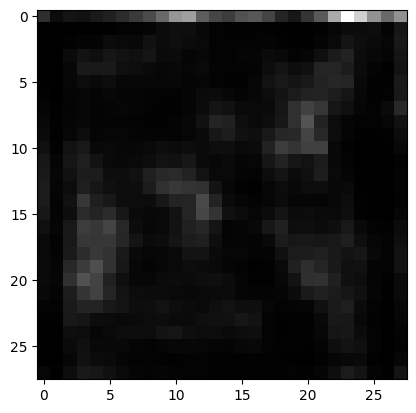

----------------------------------------


Discriminator Loss = 0.10642557591199875
Generator Loss = 3.048707962036133
A sample image generated by the generator


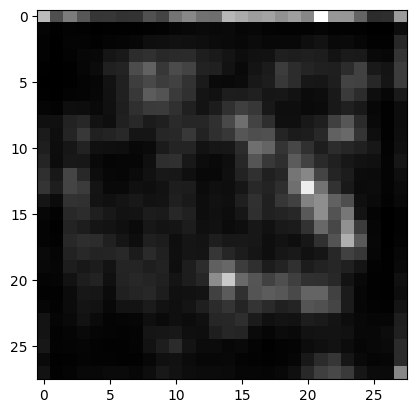

----------------------------------------


Discriminator Loss = 0.11402426660060883
Generator Loss = 3.0419397354125977
A sample image generated by the generator


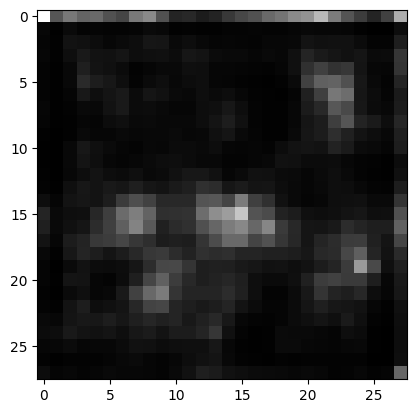

----------------------------------------


Discriminator Loss = 0.11728319525718689
Generator Loss = 3.0855712890625
A sample image generated by the generator


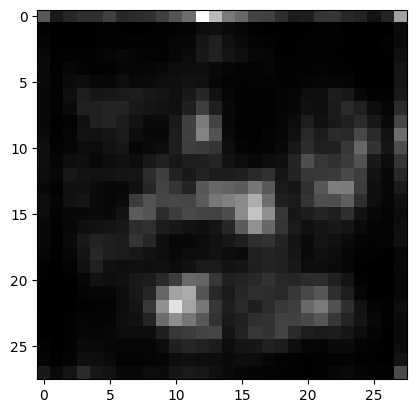

----------------------------------------


Discriminator Loss = 0.1260053813457489
Generator Loss = 3.131765365600586
A sample image generated by the generator


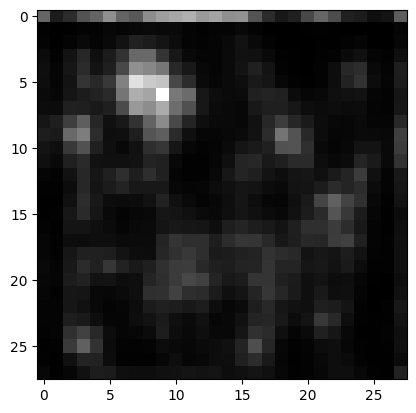

----------------------------------------


Discriminator Loss = 0.11140508949756622
Generator Loss = 3.0418272018432617
A sample image generated by the generator


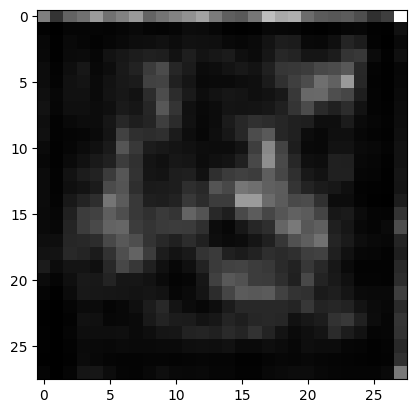

----------------------------------------


Discriminator Loss = 0.12488548457622528
Generator Loss = 3.1386733055114746
A sample image generated by the generator


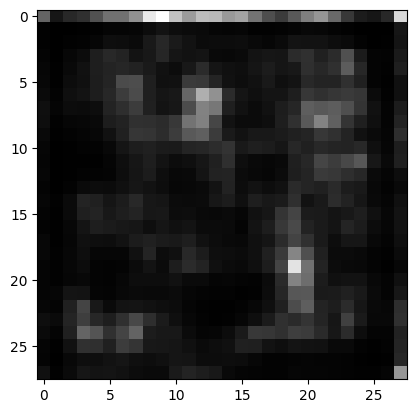

----------------------------------------


Discriminator Loss = 0.12326589226722717
Generator Loss = 2.910139560699463
A sample image generated by the generator


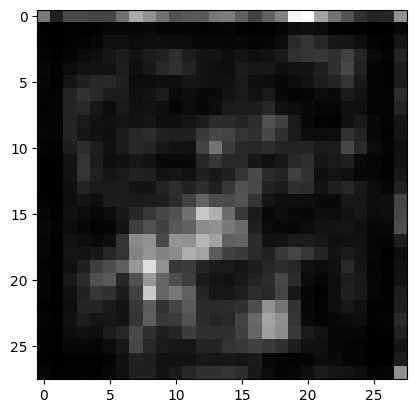

----------------------------------------


Discriminator Loss = 0.11166157573461533
Generator Loss = 3.148682117462158
A sample image generated by the generator


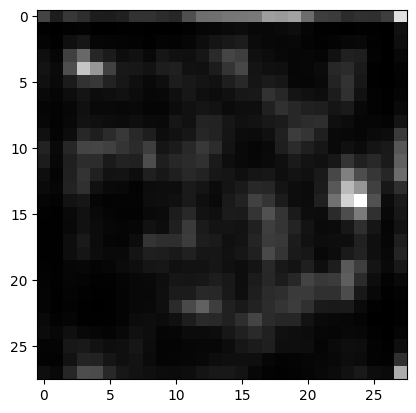

----------------------------------------


Discriminator Loss = 0.11111287772655487
Generator Loss = 3.034630060195923
A sample image generated by the generator


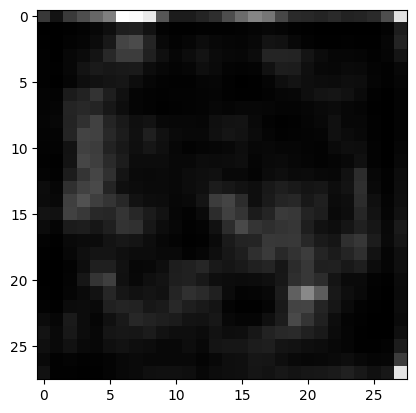

----------------------------------------


Discriminator Loss = 0.11715429276227951
Generator Loss = 3.0394058227539062
A sample image generated by the generator


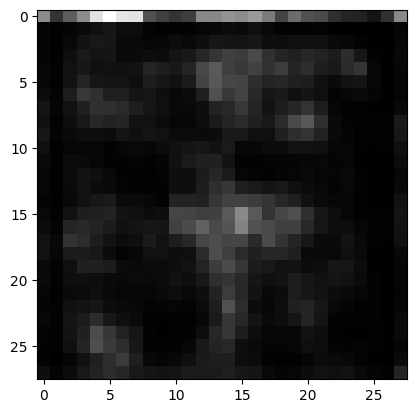

----------------------------------------


Discriminator Loss = 0.10772158205509186
Generator Loss = 3.1417794227600098
A sample image generated by the generator


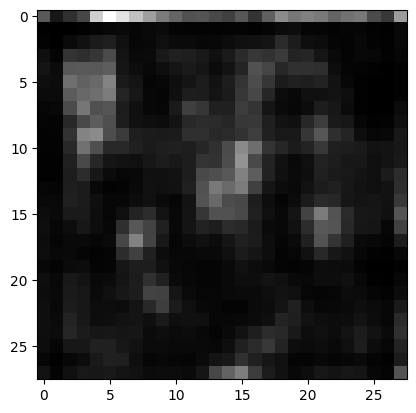

----------------------------------------


Discriminator Loss = 0.11847391724586487
Generator Loss = 2.8924925327301025
A sample image generated by the generator


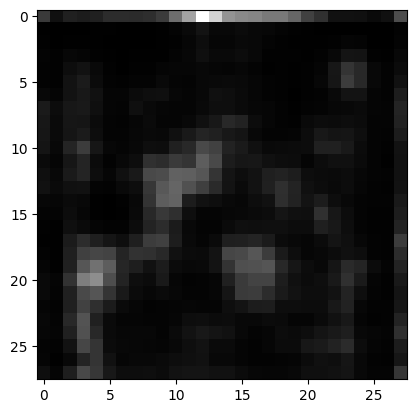

----------------------------------------


Discriminator Loss = 0.12131218612194061
Generator Loss = 3.1603288650512695
A sample image generated by the generator


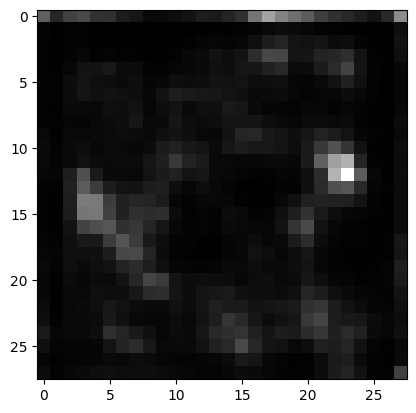

----------------------------------------


Discriminator Loss = 0.1184375062584877
Generator Loss = 3.1815853118896484
A sample image generated by the generator


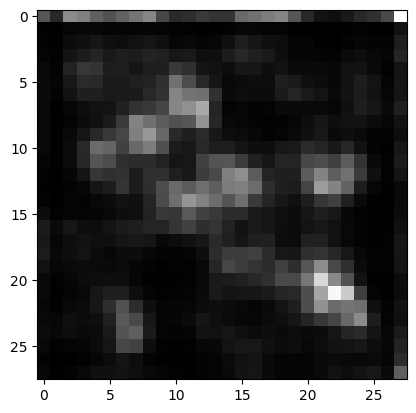

----------------------------------------


Discriminator Loss = 0.11445386707782745
Generator Loss = 3.118077278137207
A sample image generated by the generator


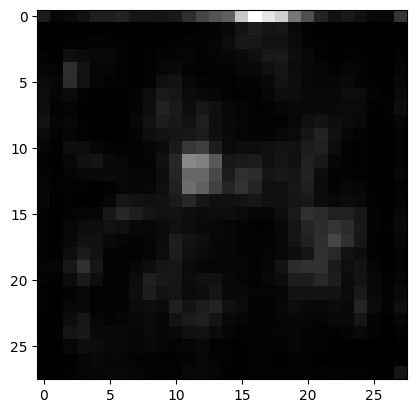

----------------------------------------


Discriminator Loss = 0.12045402824878693
Generator Loss = 3.0099852085113525
A sample image generated by the generator


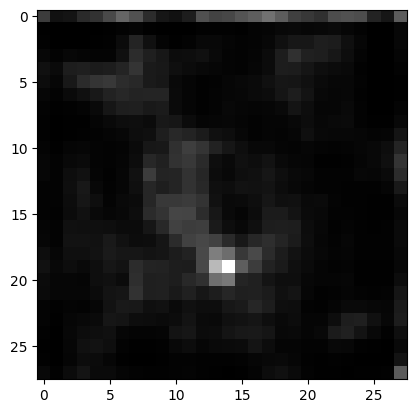

----------------------------------------


Discriminator Loss = 0.09937353432178497
Generator Loss = 3.057678699493408
A sample image generated by the generator


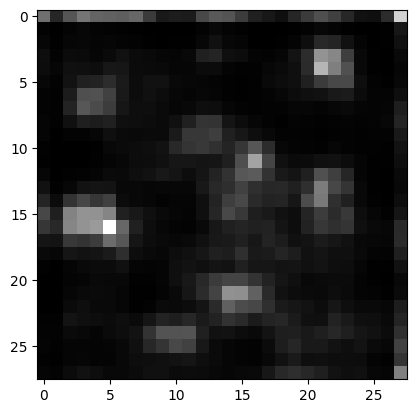

----------------------------------------


Discriminator Loss = 0.11858370900154114
Generator Loss = 3.079183578491211
A sample image generated by the generator


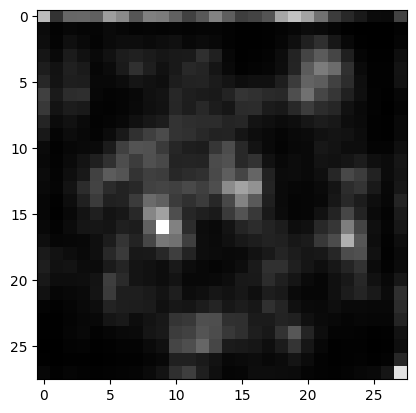

----------------------------------------


Discriminator Loss = 0.1122000515460968
Generator Loss = 2.9879989624023438
A sample image generated by the generator


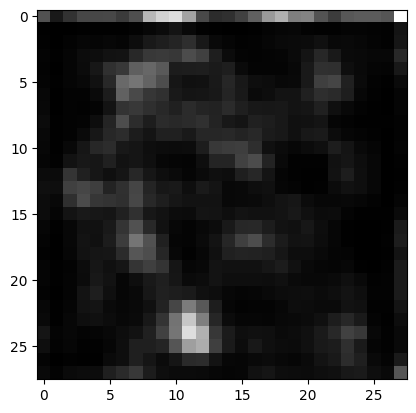

----------------------------------------


Discriminator Loss = 0.1185545027256012
Generator Loss = 3.057779550552368
A sample image generated by the generator


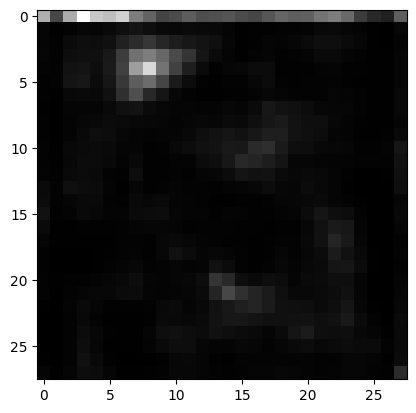

----------------------------------------


Discriminator Loss = 0.11740504205226898
Generator Loss = 3.021174907684326
A sample image generated by the generator


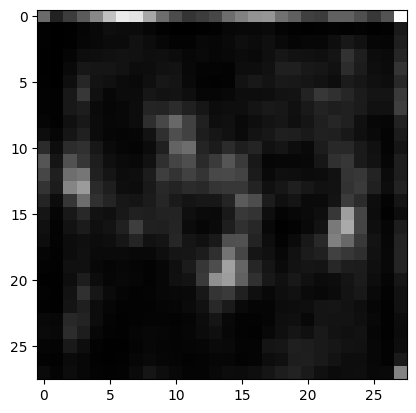

----------------------------------------


Discriminator Loss = 0.1205296441912651
Generator Loss = 3.029460906982422
A sample image generated by the generator


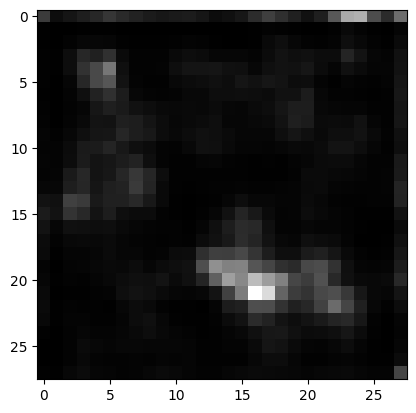

----------------------------------------


Discriminator Loss = 0.11095090210437775
Generator Loss = 3.0650343894958496
A sample image generated by the generator


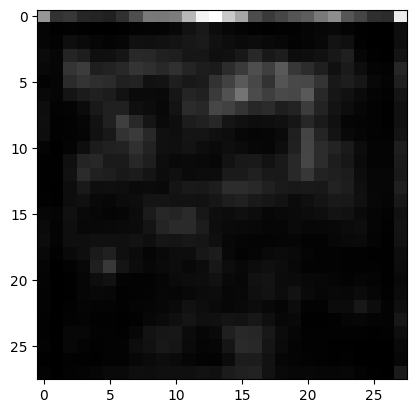

----------------------------------------


Discriminator Loss = 0.11210213601589203
Generator Loss = 3.106355667114258
A sample image generated by the generator


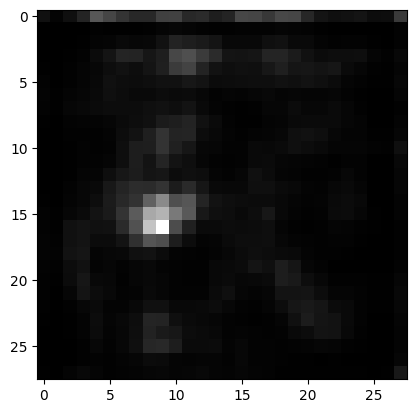

----------------------------------------


Discriminator Loss = 0.11149060726165771
Generator Loss = 3.1698572635650635
A sample image generated by the generator


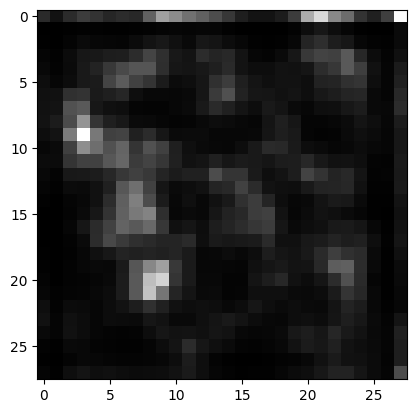

----------------------------------------


Discriminator Loss = 0.11241424828767776
Generator Loss = 2.9974796772003174
A sample image generated by the generator


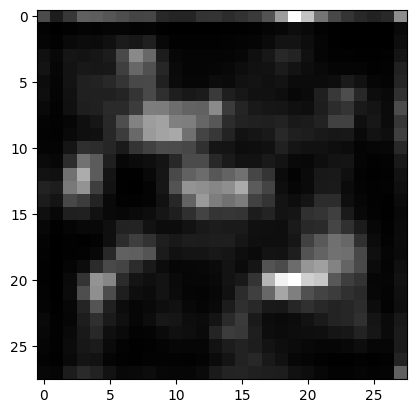

----------------------------------------


Discriminator Loss = 0.11727206408977509
Generator Loss = 3.0378639698028564
A sample image generated by the generator


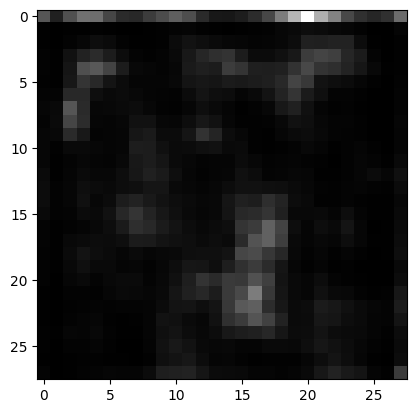

----------------------------------------


Discriminator Loss = 0.10787394642829895
Generator Loss = 3.1577327251434326
A sample image generated by the generator


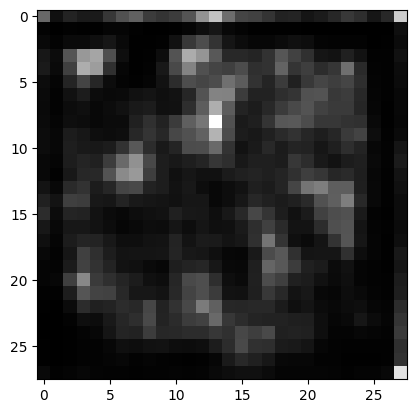

----------------------------------------


Discriminator Loss = 0.11235054582357407
Generator Loss = 3.142258644104004
A sample image generated by the generator


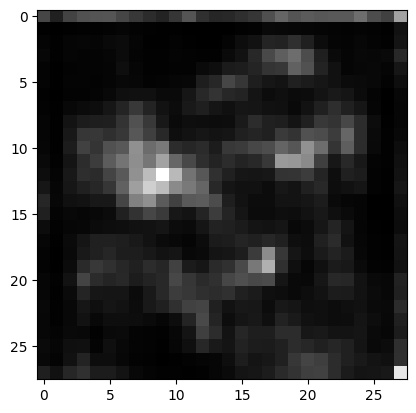

----------------------------------------


Discriminator Loss = 0.10721412301063538
Generator Loss = 2.9982120990753174
A sample image generated by the generator


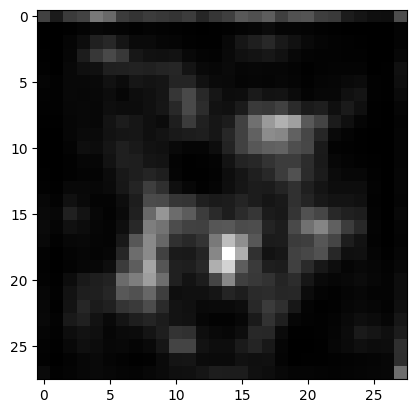

----------------------------------------


Discriminator Loss = 0.1157999336719513
Generator Loss = 3.0424375534057617
A sample image generated by the generator


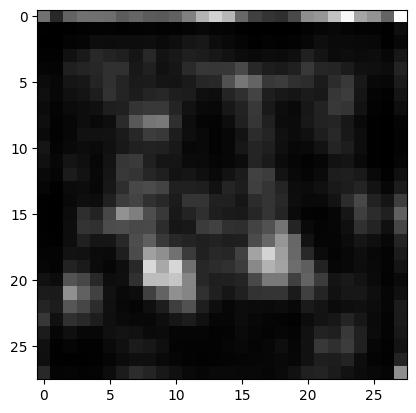

----------------------------------------


Discriminator Loss = 0.11516974866390228
Generator Loss = 3.120021343231201
A sample image generated by the generator


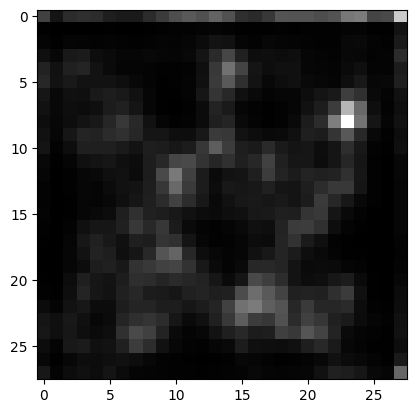

----------------------------------------


Discriminator Loss = 0.10369609296321869
Generator Loss = 3.086719036102295
A sample image generated by the generator


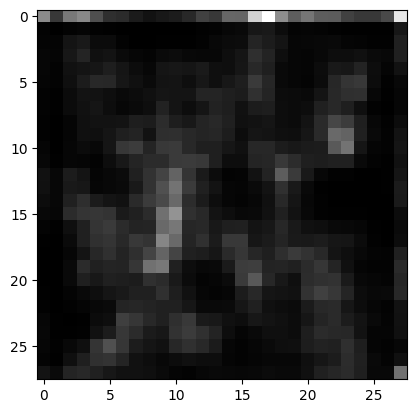

----------------------------------------


Discriminator Loss = 0.10680690407752991
Generator Loss = 3.0408856868743896
A sample image generated by the generator


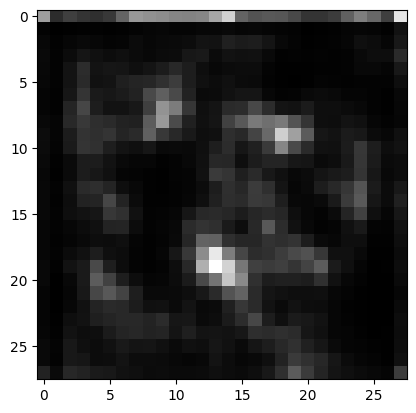

----------------------------------------


Discriminator Loss = 0.10400772094726562
Generator Loss = 3.116044521331787
A sample image generated by the generator


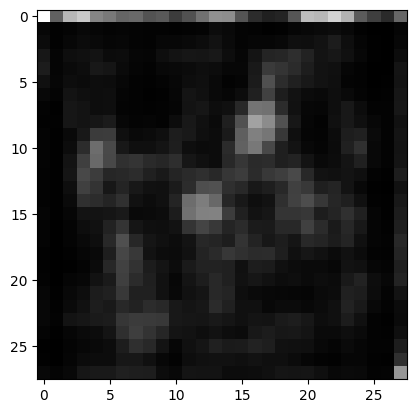

----------------------------------------


Discriminator Loss = 0.11062197387218475
Generator Loss = 3.163081407546997
A sample image generated by the generator


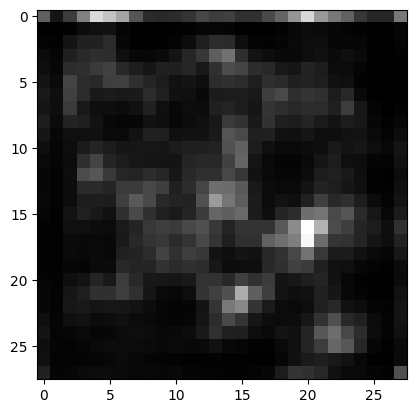

----------------------------------------


Discriminator Loss = 0.11190424859523773
Generator Loss = 3.1594953536987305
A sample image generated by the generator


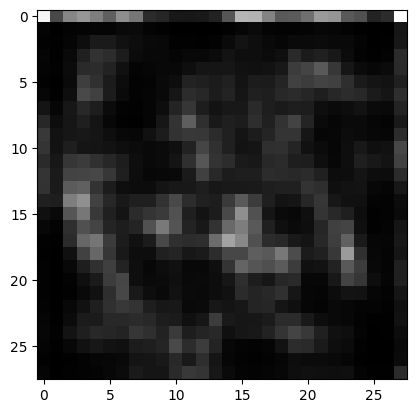

----------------------------------------


Discriminator Loss = 0.10195790231227875
Generator Loss = 3.1438663005828857
A sample image generated by the generator


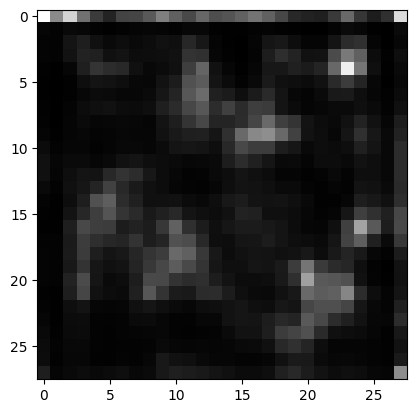

----------------------------------------


Discriminator Loss = 0.1121554970741272
Generator Loss = 3.118168830871582
A sample image generated by the generator


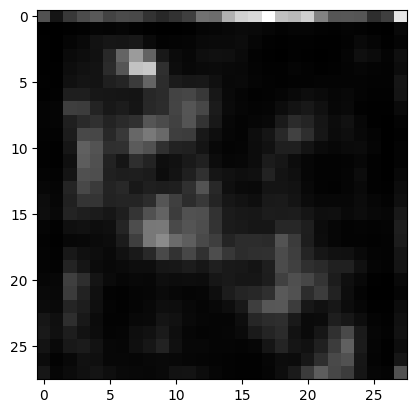

----------------------------------------


Discriminator Loss = 0.11694663017988205
Generator Loss = 3.0654525756835938
A sample image generated by the generator


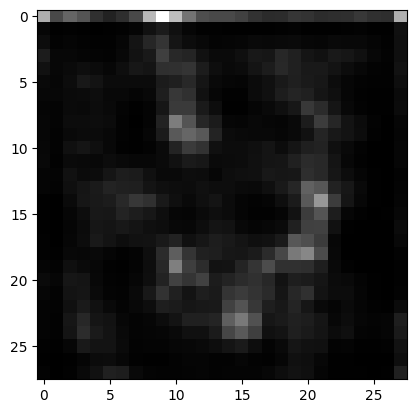

----------------------------------------


Discriminator Loss = 0.11133778095245361
Generator Loss = 3.0880143642425537
A sample image generated by the generator


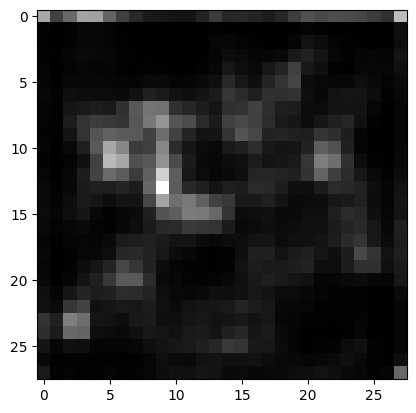

----------------------------------------


Discriminator Loss = 0.11583831906318665
Generator Loss = 3.2187299728393555
A sample image generated by the generator


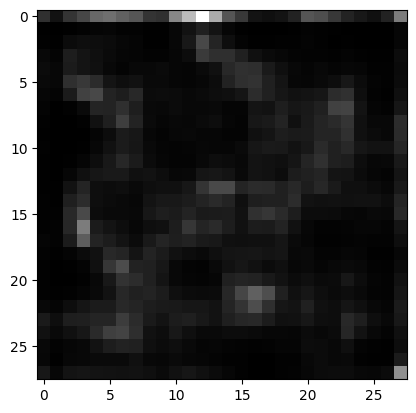

----------------------------------------


Discriminator Loss = 0.11296398937702179
Generator Loss = 3.076323986053467
A sample image generated by the generator


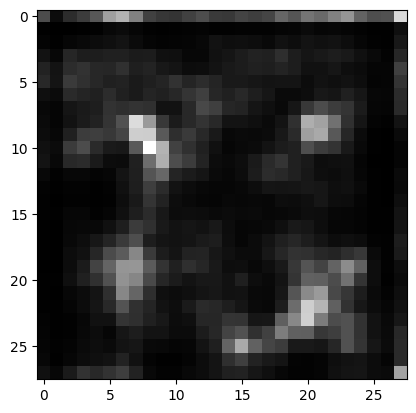

----------------------------------------


Discriminator Loss = 0.10058954358100891
Generator Loss = 2.9729855060577393
A sample image generated by the generator


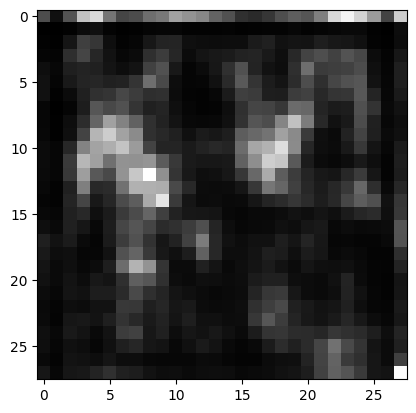

----------------------------------------


Discriminator Loss = 0.1226215735077858
Generator Loss = 3.210559368133545
A sample image generated by the generator


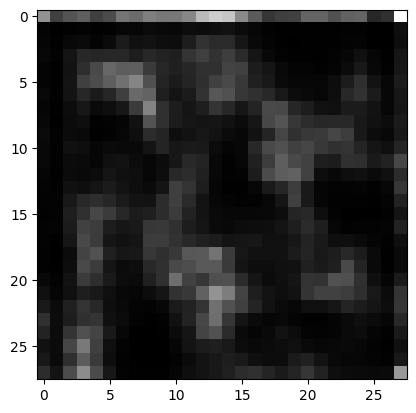

----------------------------------------


Discriminator Loss = 0.11379310488700867
Generator Loss = 3.1641440391540527
A sample image generated by the generator


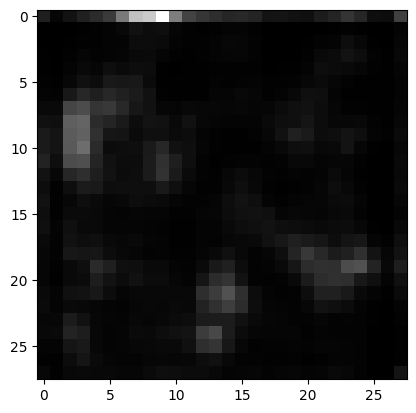

----------------------------------------


Discriminator Loss = 0.1128925308585167
Generator Loss = 3.1514577865600586
A sample image generated by the generator


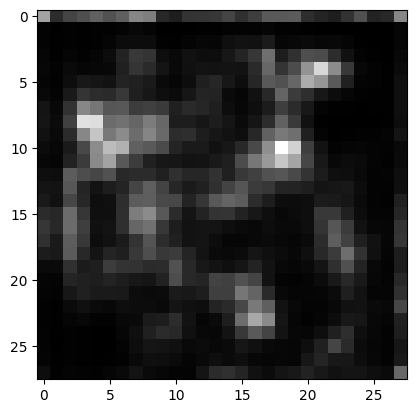

----------------------------------------


Discriminator Loss = 0.10866610705852509
Generator Loss = 3.273005962371826
A sample image generated by the generator


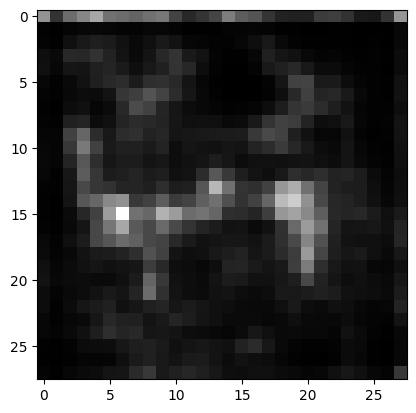

----------------------------------------


Discriminator Loss = 0.11158457398414612
Generator Loss = 3.037510395050049
A sample image generated by the generator


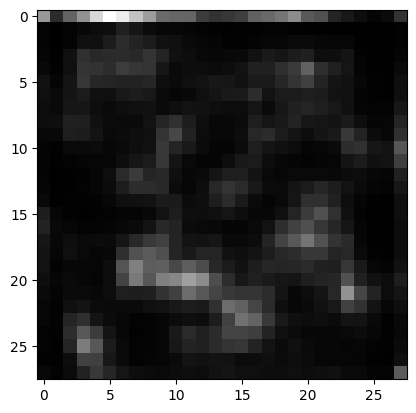

----------------------------------------


Discriminator Loss = 0.10907207429409027
Generator Loss = 3.0339150428771973
A sample image generated by the generator


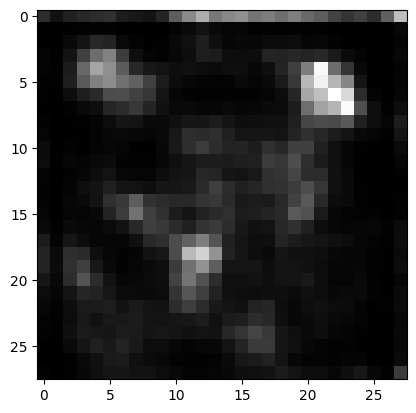

----------------------------------------


Discriminator Loss = 0.12045861780643463
Generator Loss = 3.0809154510498047
A sample image generated by the generator


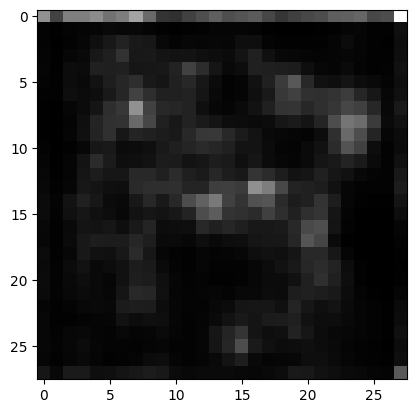

----------------------------------------


Discriminator Loss = 0.10400436818599701
Generator Loss = 3.0653328895568848
A sample image generated by the generator


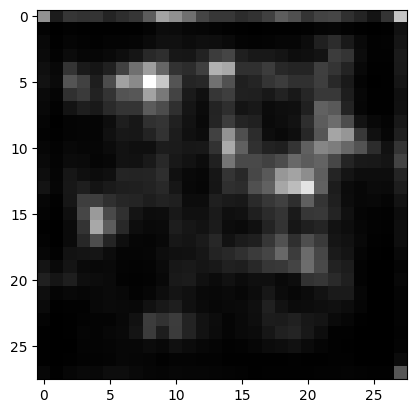

----------------------------------------


Discriminator Loss = 0.10673050582408905
Generator Loss = 3.1085574626922607
A sample image generated by the generator


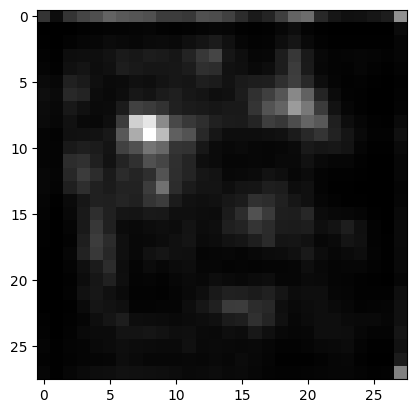

----------------------------------------


Discriminator Loss = 0.10550273954868317
Generator Loss = 3.193040370941162
A sample image generated by the generator


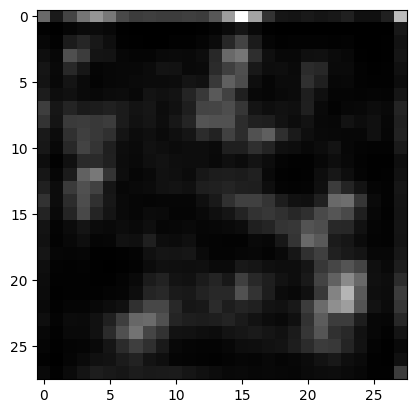

----------------------------------------


Discriminator Loss = 0.11118962615728378
Generator Loss = 3.1293139457702637
A sample image generated by the generator


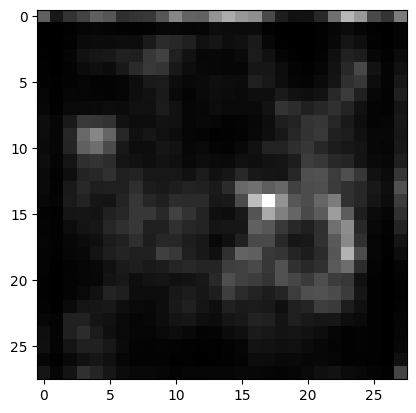

----------------------------------------


Discriminator Loss = 0.09832806885242462
Generator Loss = 3.191129684448242
A sample image generated by the generator


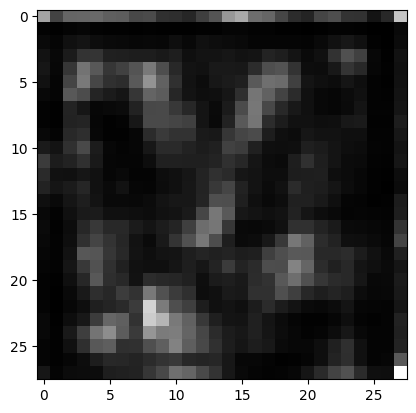

----------------------------------------


Discriminator Loss = 0.11834408342838287
Generator Loss = 3.115952491760254
A sample image generated by the generator


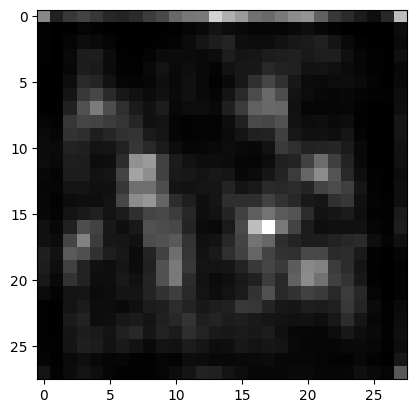

----------------------------------------


Discriminator Loss = 0.10759427398443222
Generator Loss = 3.2255518436431885
A sample image generated by the generator


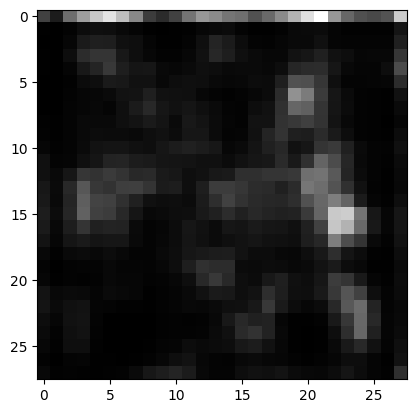

----------------------------------------


Discriminator Loss = 0.10127370059490204
Generator Loss = 3.321331739425659
A sample image generated by the generator


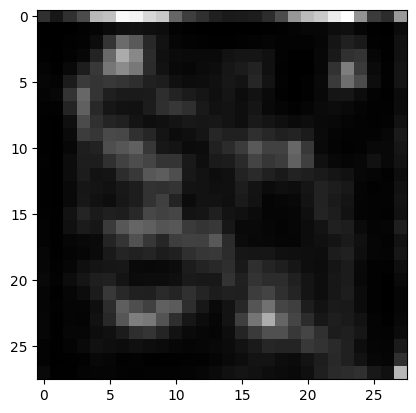

----------------------------------------


Discriminator Loss = 0.10594726353883743
Generator Loss = 3.1191964149475098
A sample image generated by the generator


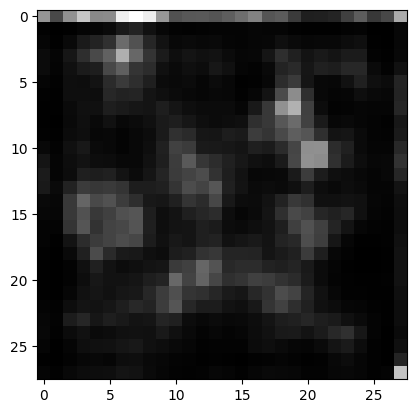

----------------------------------------


Discriminator Loss = 0.09852473437786102
Generator Loss = 3.1551690101623535
A sample image generated by the generator


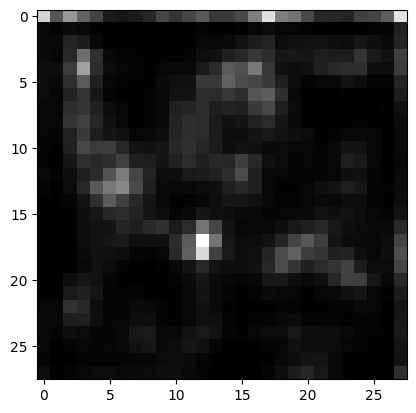

----------------------------------------


Discriminator Loss = 0.10787714272737503
Generator Loss = 3.1755223274230957
A sample image generated by the generator


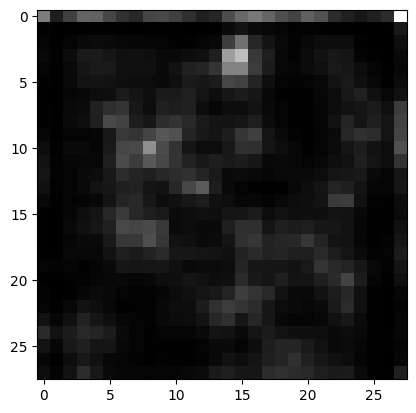

----------------------------------------


Discriminator Loss = 0.11292910575866699
Generator Loss = 3.216573476791382
A sample image generated by the generator


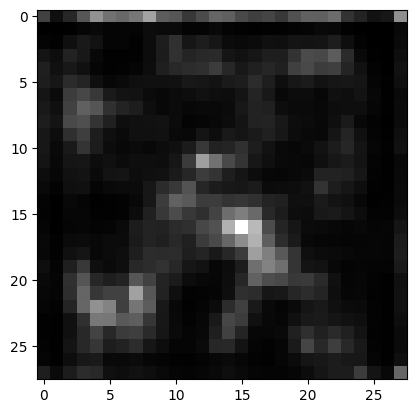

----------------------------------------


Discriminator Loss = 0.1076449602842331
Generator Loss = 3.036594867706299
A sample image generated by the generator


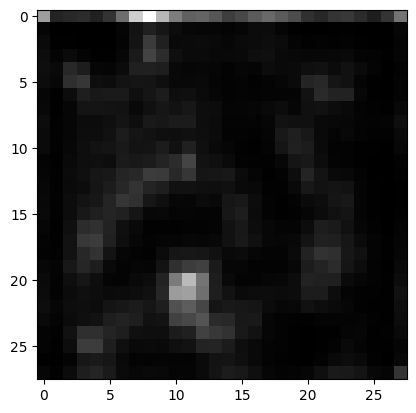

----------------------------------------


Discriminator Loss = 0.1063525527715683
Generator Loss = 3.127345561981201
A sample image generated by the generator


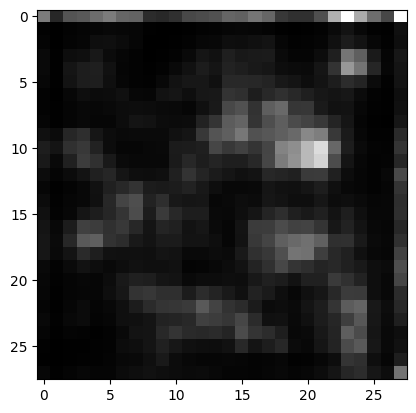

----------------------------------------


Discriminator Loss = 0.10255199670791626
Generator Loss = 3.188575267791748
A sample image generated by the generator


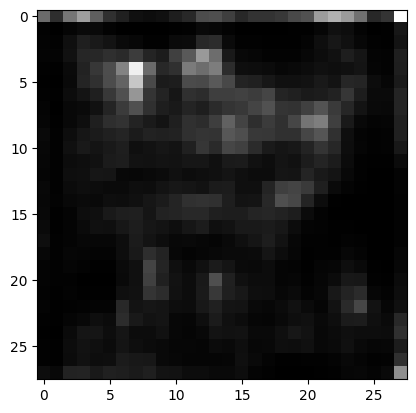

----------------------------------------


Discriminator Loss = 0.10935422033071518
Generator Loss = 3.1546339988708496
A sample image generated by the generator


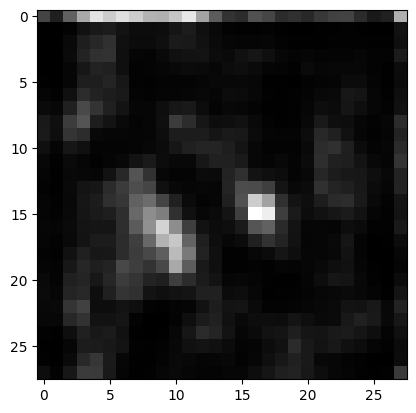

----------------------------------------


Discriminator Loss = 0.09960232675075531
Generator Loss = 3.179469108581543
A sample image generated by the generator


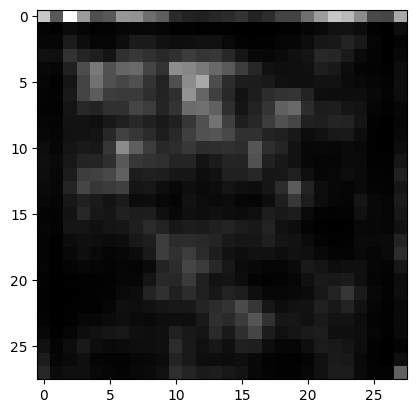

----------------------------------------


Discriminator Loss = 0.1065843254327774
Generator Loss = 3.0909793376922607
A sample image generated by the generator


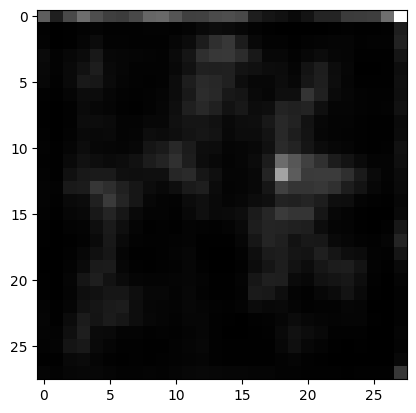

----------------------------------------


Discriminator Loss = 0.09976121783256531
Generator Loss = 3.141348361968994
A sample image generated by the generator


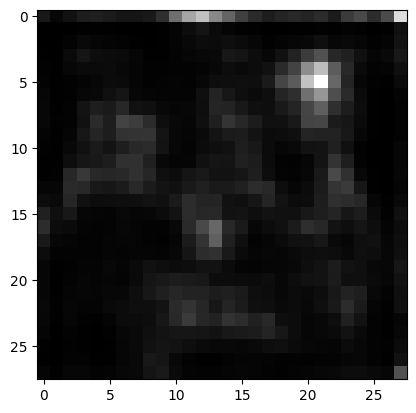

----------------------------------------


Discriminator Loss = 0.11601646989583969
Generator Loss = 3.12823224067688
A sample image generated by the generator


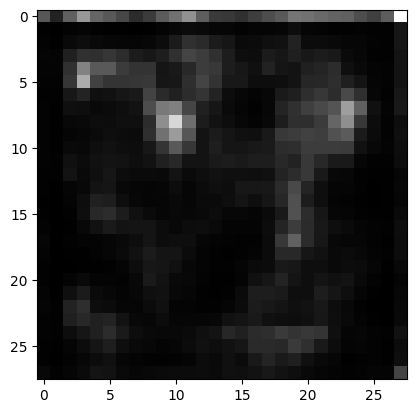

----------------------------------------


Discriminator Loss = 0.10401520133018494
Generator Loss = 3.2817225456237793
A sample image generated by the generator


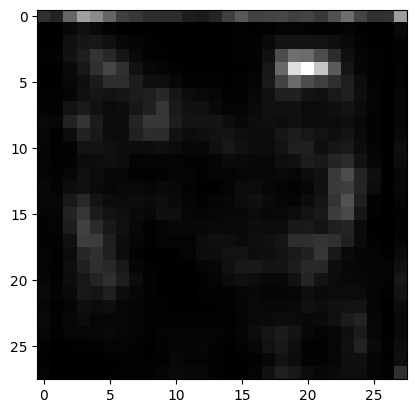

----------------------------------------


Discriminator Loss = 0.10245546698570251
Generator Loss = 3.1330065727233887
A sample image generated by the generator


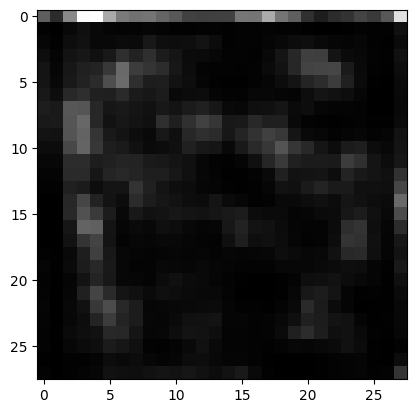

----------------------------------------


Discriminator Loss = 0.10418573021888733
Generator Loss = 3.128032684326172
A sample image generated by the generator


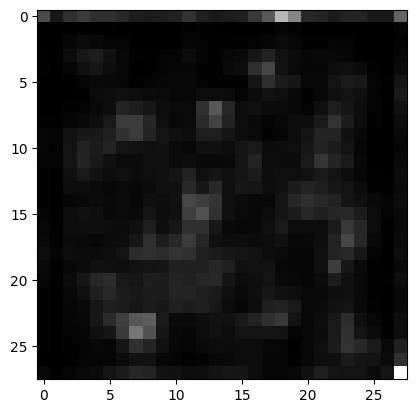

----------------------------------------


Discriminator Loss = 0.10211753845214844
Generator Loss = 3.2208476066589355
A sample image generated by the generator


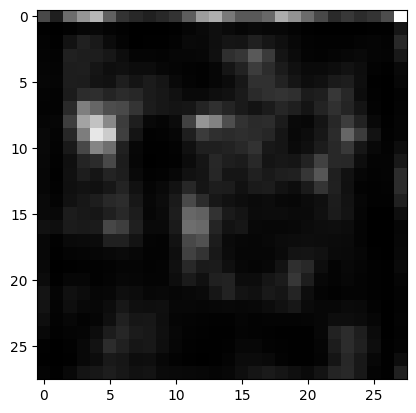

----------------------------------------


Discriminator Loss = 0.10055342316627502
Generator Loss = 3.1492104530334473
A sample image generated by the generator


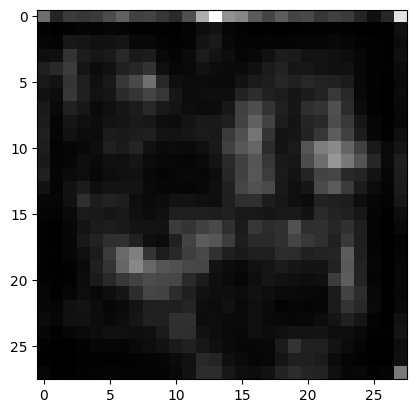

----------------------------------------


Discriminator Loss = 0.10683785378932953
Generator Loss = 3.0898048877716064
A sample image generated by the generator


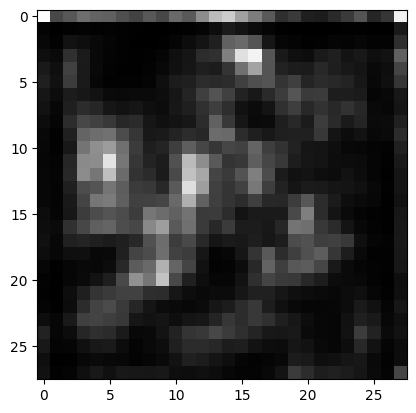

----------------------------------------


Discriminator Loss = 0.10657475888729095
Generator Loss = 3.2144885063171387
A sample image generated by the generator


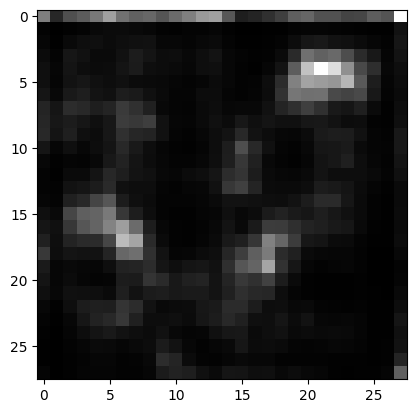

----------------------------------------


Discriminator Loss = 0.10854513943195343
Generator Loss = 3.173006772994995
A sample image generated by the generator


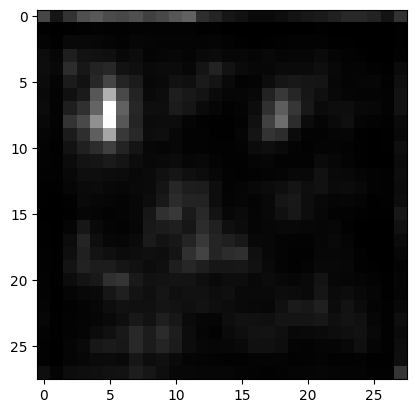

----------------------------------------


Discriminator Loss = 0.11184930056333542
Generator Loss = 3.1533586978912354
A sample image generated by the generator


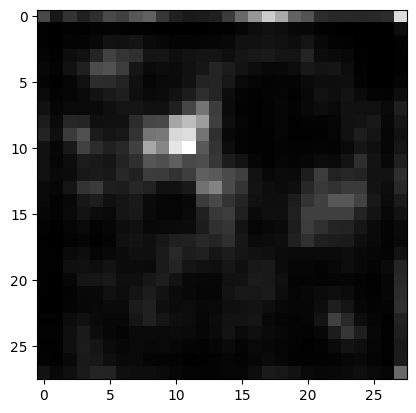

----------------------------------------


Discriminator Loss = 0.11851828545331955
Generator Loss = 3.174957752227783
A sample image generated by the generator


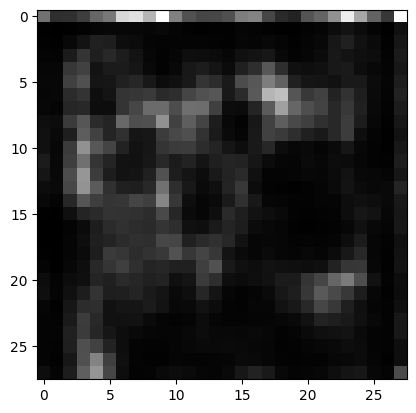

----------------------------------------


Discriminator Loss = 0.11729193478822708
Generator Loss = 3.1620678901672363
A sample image generated by the generator


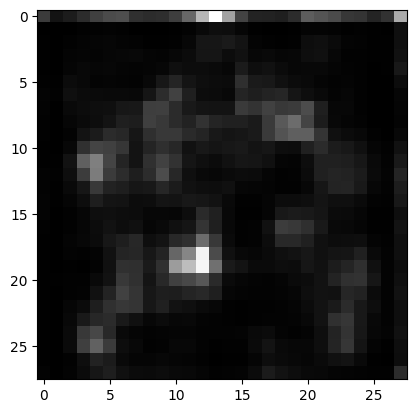

----------------------------------------


Discriminator Loss = 0.10730597376823425
Generator Loss = 3.0641531944274902
A sample image generated by the generator


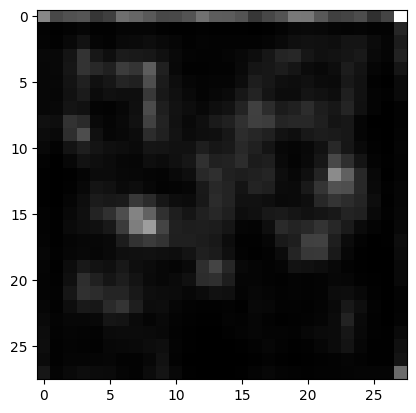

----------------------------------------


Discriminator Loss = 0.10774277150630951
Generator Loss = 3.17185115814209
A sample image generated by the generator


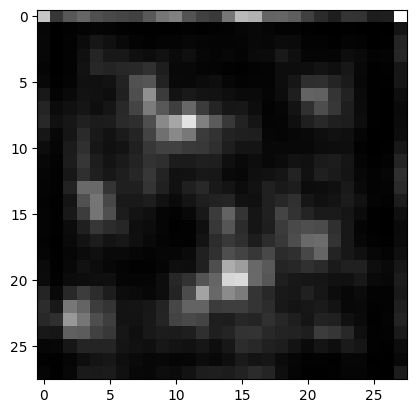

----------------------------------------


Discriminator Loss = 0.1009790301322937
Generator Loss = 3.1883091926574707
A sample image generated by the generator


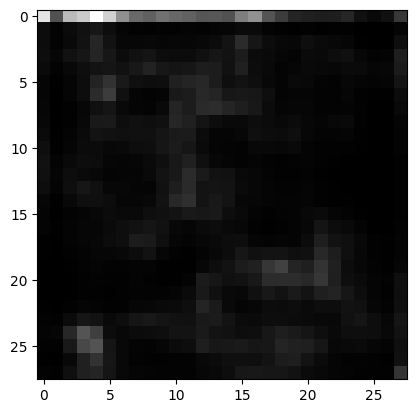

----------------------------------------


Discriminator Loss = 0.10056127607822418
Generator Loss = 3.105609893798828
A sample image generated by the generator


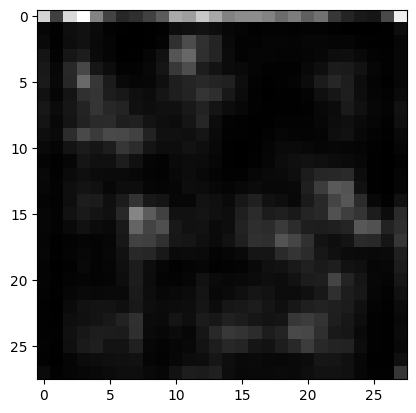

----------------------------------------


Discriminator Loss = 0.11553670465946198
Generator Loss = 3.1398894786834717
A sample image generated by the generator


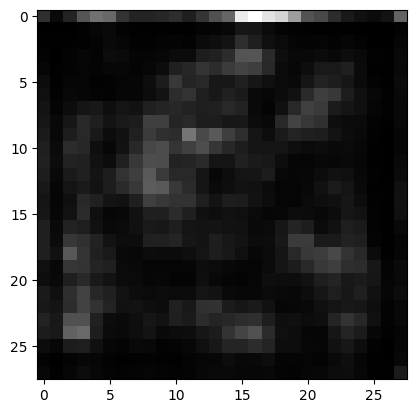

----------------------------------------


Discriminator Loss = 0.10303971916437149
Generator Loss = 3.160658597946167
A sample image generated by the generator


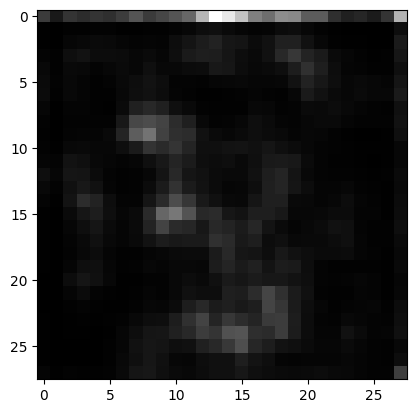

----------------------------------------


Discriminator Loss = 0.11455518752336502
Generator Loss = 3.056746006011963
A sample image generated by the generator


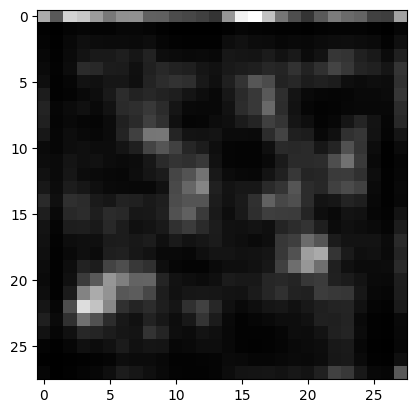

----------------------------------------


Discriminator Loss = 0.10607850551605225
Generator Loss = 3.1802234649658203
A sample image generated by the generator


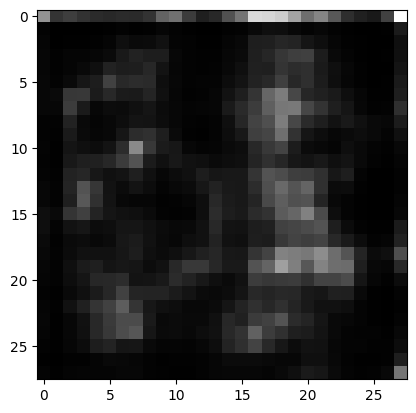

----------------------------------------


Discriminator Loss = 0.10142788290977478
Generator Loss = 3.1163744926452637
A sample image generated by the generator


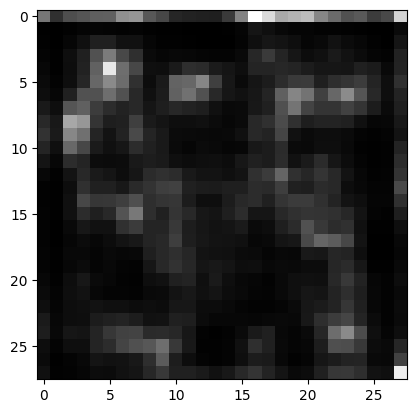

----------------------------------------


Discriminator Loss = 0.10227584838867188
Generator Loss = 3.219898223876953
A sample image generated by the generator


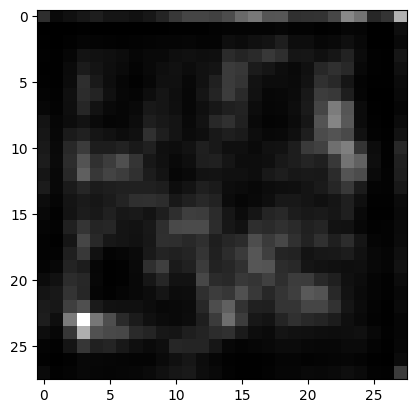

----------------------------------------


Discriminator Loss = 0.0978955626487732
Generator Loss = 3.099900960922241
A sample image generated by the generator


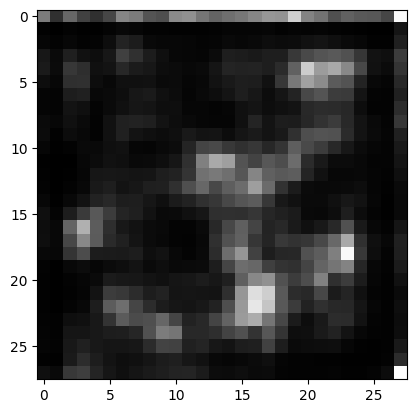

----------------------------------------


Discriminator Loss = 0.09556101262569427
Generator Loss = 3.165040969848633
A sample image generated by the generator


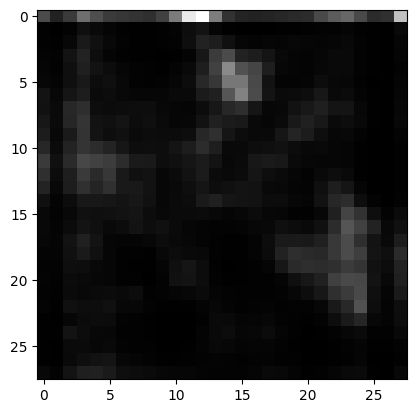

----------------------------------------


Discriminator Loss = 0.10903006792068481
Generator Loss = 3.186041831970215
A sample image generated by the generator


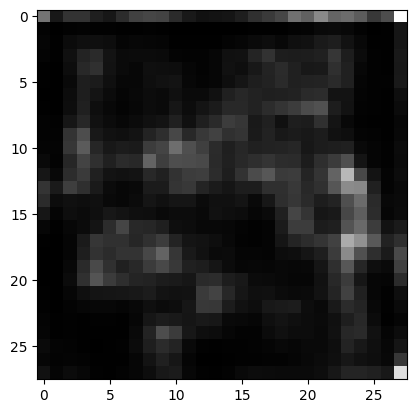

----------------------------------------


Discriminator Loss = 0.09394951164722443
Generator Loss = 3.3159520626068115
A sample image generated by the generator


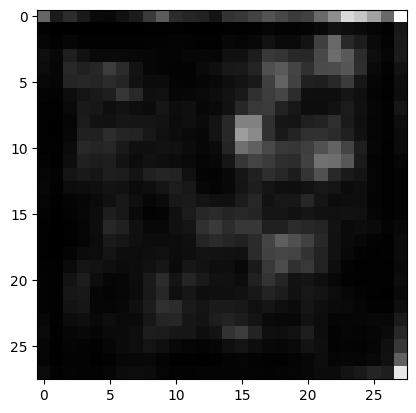

----------------------------------------


Discriminator Loss = 0.1062048077583313
Generator Loss = 3.141521692276001
A sample image generated by the generator


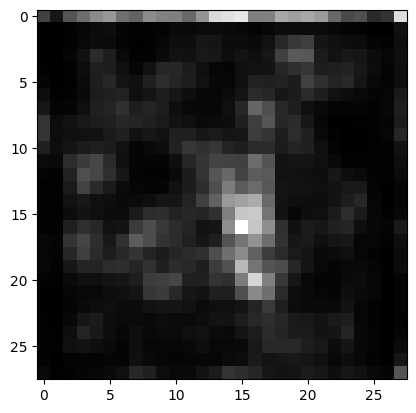

----------------------------------------


Discriminator Loss = 0.10466393828392029
Generator Loss = 3.257589340209961
A sample image generated by the generator


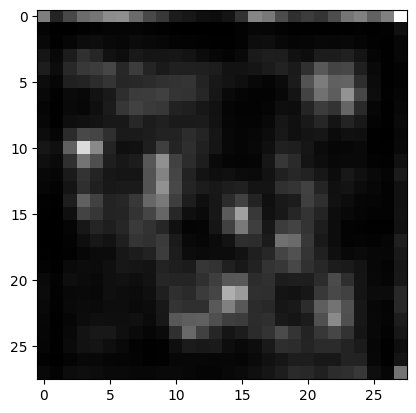

----------------------------------------


Discriminator Loss = 0.1071639358997345
Generator Loss = 3.0335161685943604
A sample image generated by the generator


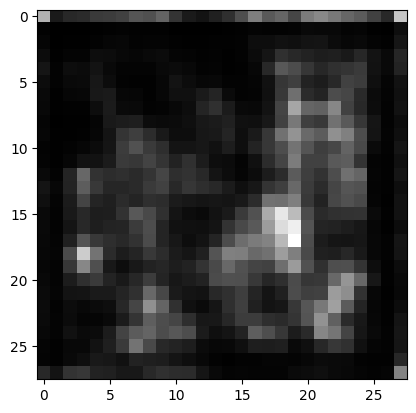

----------------------------------------


Discriminator Loss = 0.10730578005313873
Generator Loss = 3.327090263366699
A sample image generated by the generator


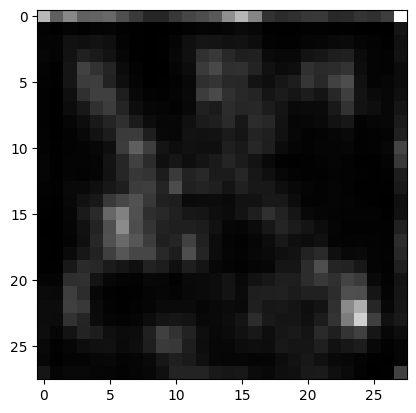

----------------------------------------


Discriminator Loss = 0.10256025940179825
Generator Loss = 3.1586265563964844
A sample image generated by the generator


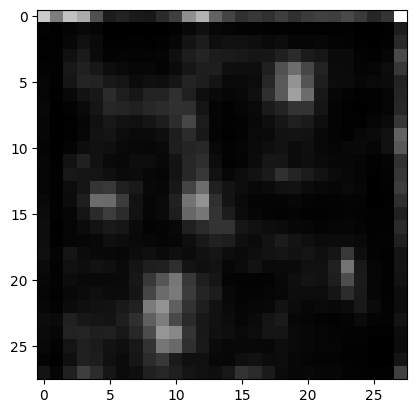

----------------------------------------


Discriminator Loss = 0.09819667041301727
Generator Loss = 3.21103572845459
A sample image generated by the generator


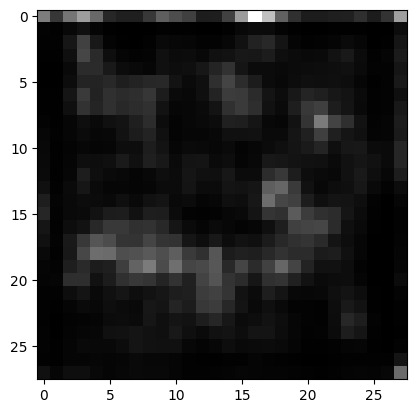

----------------------------------------


Discriminator Loss = 0.10765231400728226
Generator Loss = 3.196552276611328
A sample image generated by the generator


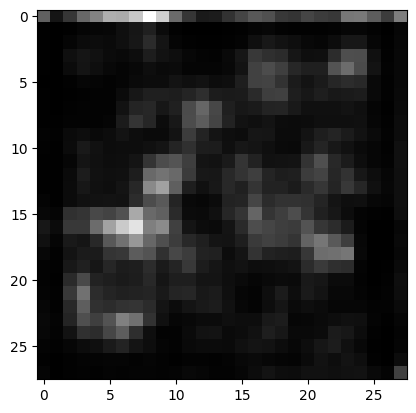

----------------------------------------


Discriminator Loss = 0.09686572104692459
Generator Loss = 3.161248207092285
A sample image generated by the generator


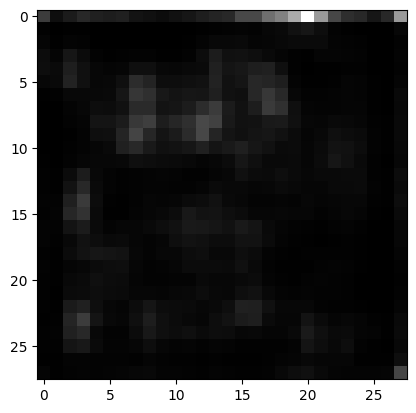

----------------------------------------


Discriminator Loss = 0.08991935849189758
Generator Loss = 3.360191822052002
A sample image generated by the generator


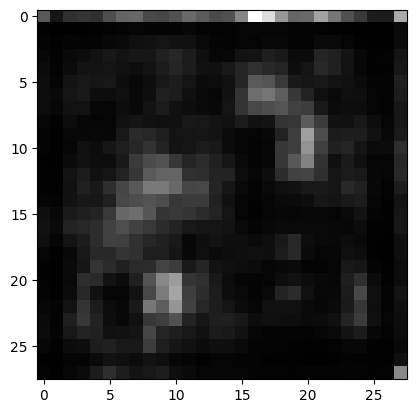

----------------------------------------


Discriminator Loss = 0.0974406823515892
Generator Loss = 3.2451162338256836
A sample image generated by the generator


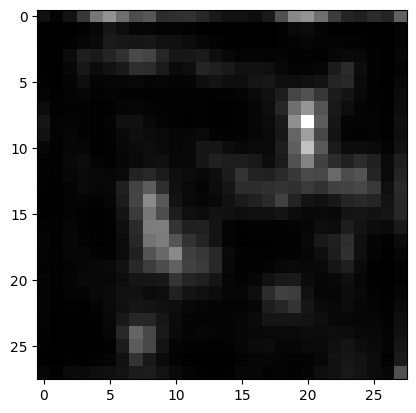

----------------------------------------


Discriminator Loss = 0.1012340635061264
Generator Loss = 3.3190977573394775
A sample image generated by the generator


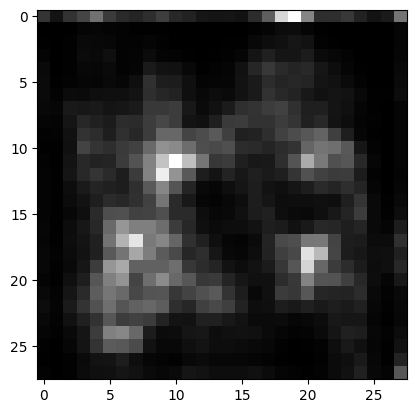

----------------------------------------


Discriminator Loss = 0.10130910575389862
Generator Loss = 3.1729626655578613
A sample image generated by the generator


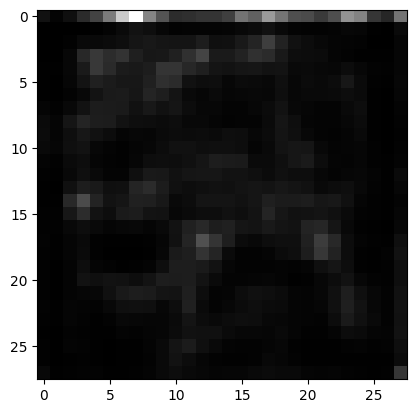

----------------------------------------


Discriminator Loss = 0.11091721057891846
Generator Loss = 3.1900033950805664
A sample image generated by the generator


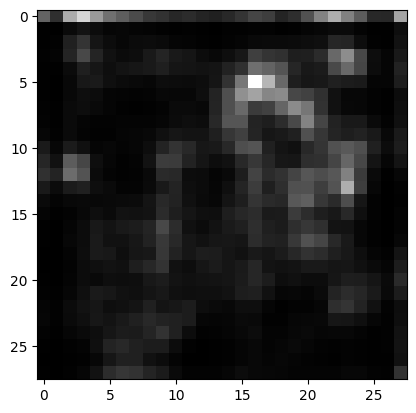

----------------------------------------


Discriminator Loss = 0.10781875252723694
Generator Loss = 3.0593719482421875
A sample image generated by the generator


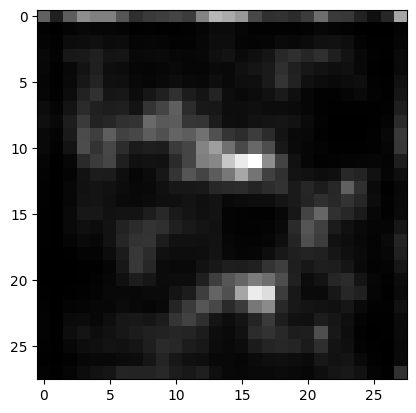

----------------------------------------


Discriminator Loss = 0.10283088684082031
Generator Loss = 3.2366132736206055
A sample image generated by the generator


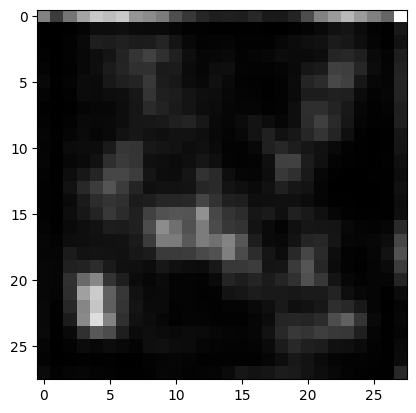

----------------------------------------


Discriminator Loss = 0.11025732755661011
Generator Loss = 3.183046340942383
A sample image generated by the generator


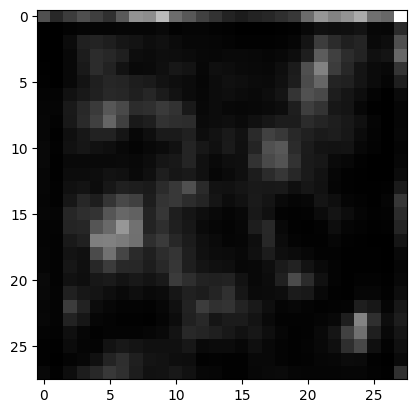

----------------------------------------


Discriminator Loss = 0.10058249533176422
Generator Loss = 3.292099714279175
A sample image generated by the generator


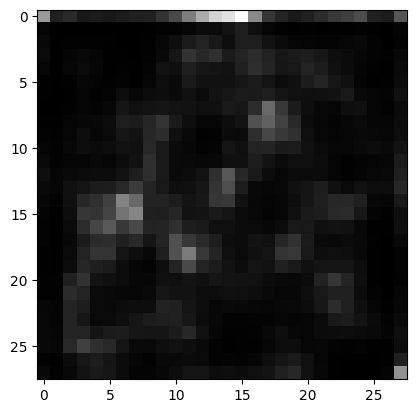

----------------------------------------


Discriminator Loss = 0.10394361615180969
Generator Loss = 3.0703048706054688
A sample image generated by the generator


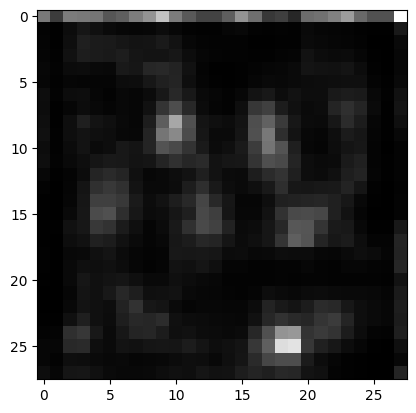

----------------------------------------


Discriminator Loss = 0.10001575201749802
Generator Loss = 3.199921131134033
A sample image generated by the generator


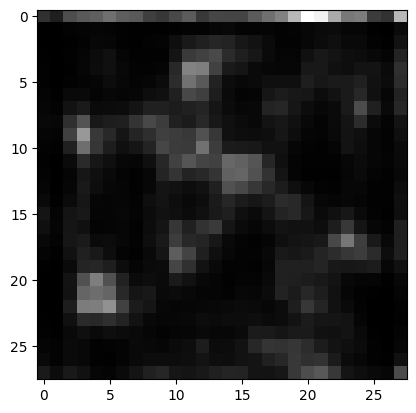

----------------------------------------


Discriminator Loss = 0.09975463896989822
Generator Loss = 3.1941611766815186
A sample image generated by the generator


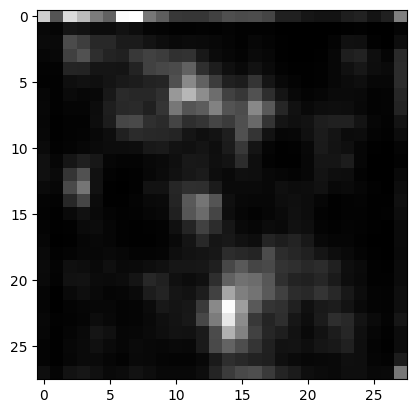

----------------------------------------


Discriminator Loss = 0.0972609668970108
Generator Loss = 3.176572799682617
A sample image generated by the generator


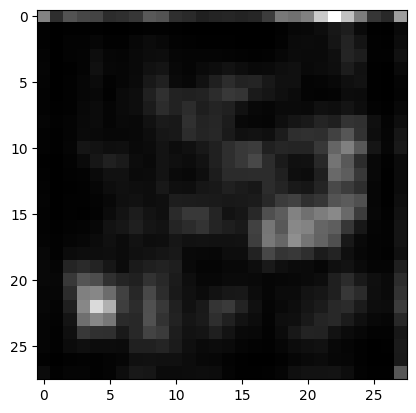

----------------------------------------


Discriminator Loss = 0.1082165539264679
Generator Loss = 3.1806726455688477
A sample image generated by the generator


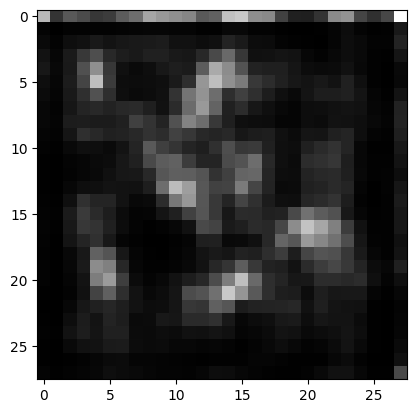

----------------------------------------


Discriminator Loss = 0.09769650548696518
Generator Loss = 3.166513681411743
A sample image generated by the generator


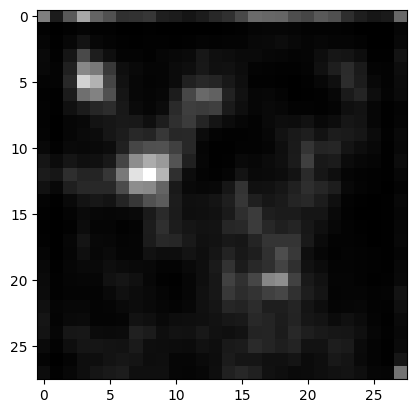

----------------------------------------


Discriminator Loss = 0.10138334333896637
Generator Loss = 3.2147865295410156
A sample image generated by the generator


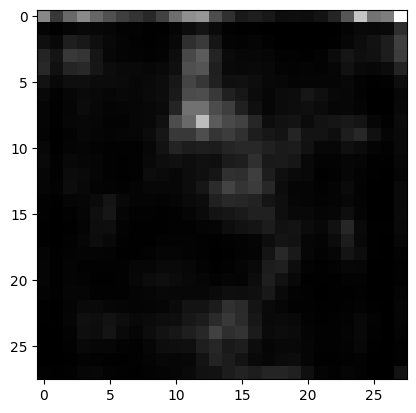

----------------------------------------


Discriminator Loss = 0.09292040765285492
Generator Loss = 3.164032459259033
A sample image generated by the generator


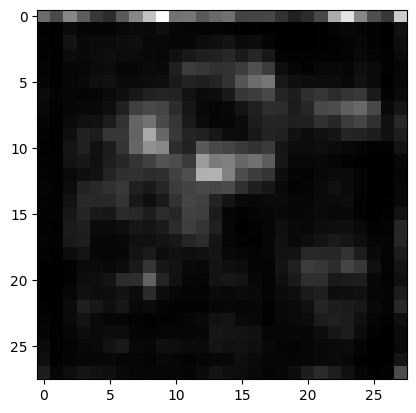

----------------------------------------


Discriminator Loss = 0.10113828629255295
Generator Loss = 3.1373472213745117
A sample image generated by the generator


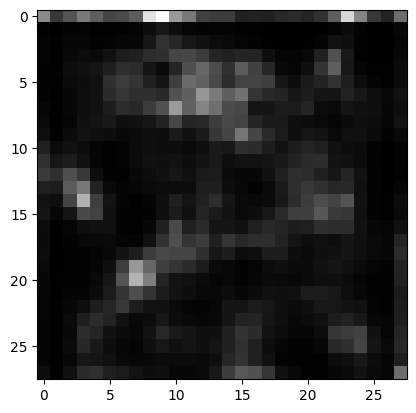

----------------------------------------


Discriminator Loss = 0.09270446002483368
Generator Loss = 3.1289634704589844
A sample image generated by the generator


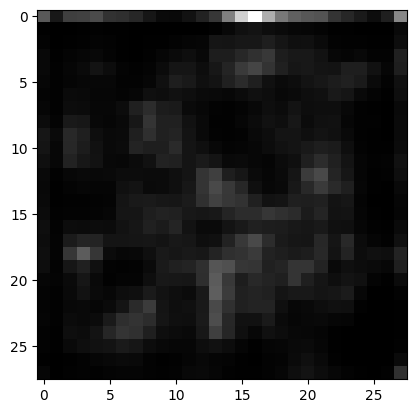

----------------------------------------


Discriminator Loss = 0.09253180772066116
Generator Loss = 3.156843662261963
A sample image generated by the generator


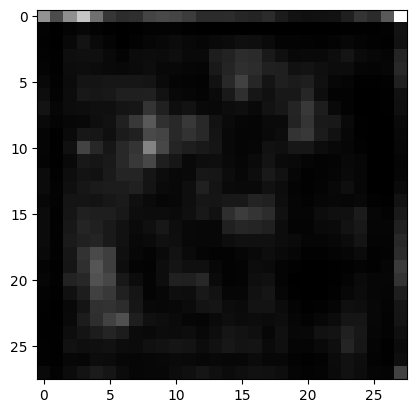

----------------------------------------


Discriminator Loss = 0.10026635229587555
Generator Loss = 3.231356620788574
A sample image generated by the generator


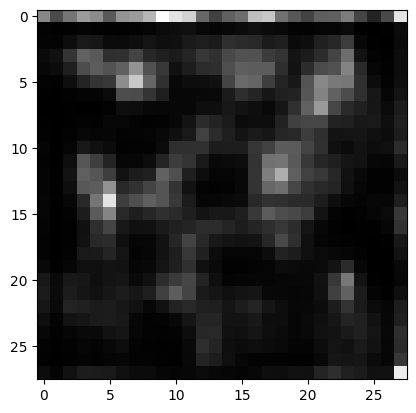

----------------------------------------


Discriminator Loss = 0.10351110994815826
Generator Loss = 3.214628219604492
A sample image generated by the generator


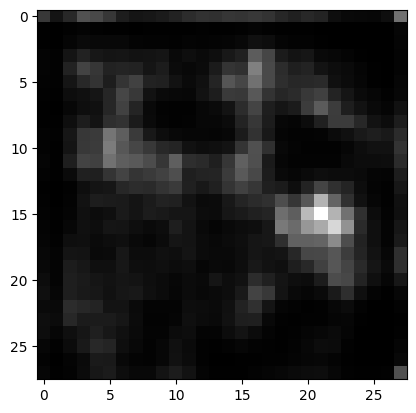

----------------------------------------


Discriminator Loss = 0.09937980771064758
Generator Loss = 3.2239458560943604
A sample image generated by the generator


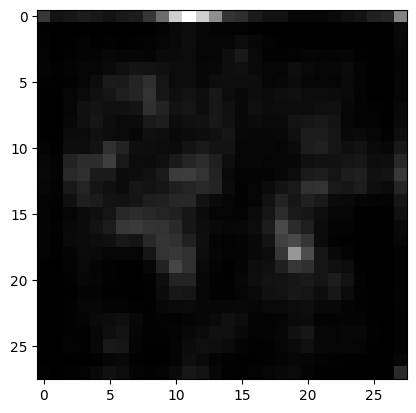

----------------------------------------


Discriminator Loss = 0.09581892192363739
Generator Loss = 3.2340989112854004
A sample image generated by the generator


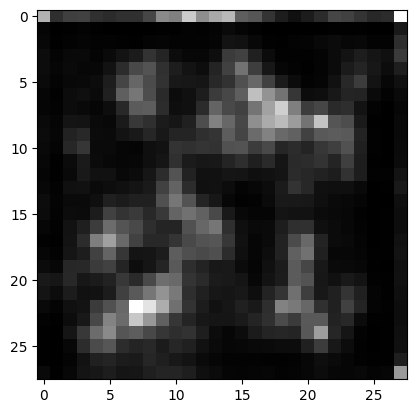

----------------------------------------


Discriminator Loss = 0.1001395583152771
Generator Loss = 3.2370996475219727
A sample image generated by the generator


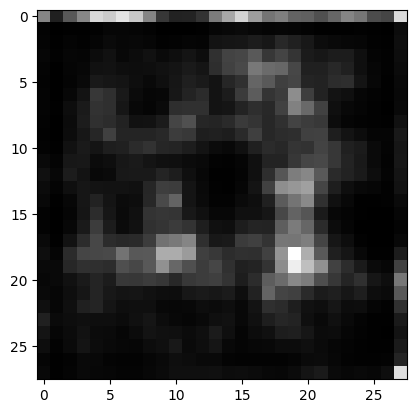

----------------------------------------


Discriminator Loss = 0.08812933415174484
Generator Loss = 3.2098841667175293
A sample image generated by the generator


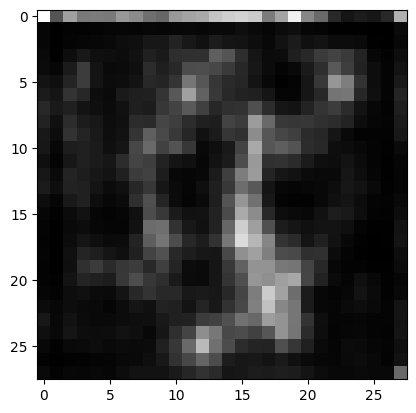

----------------------------------------


Discriminator Loss = 0.09424707293510437
Generator Loss = 3.1868820190429688
A sample image generated by the generator


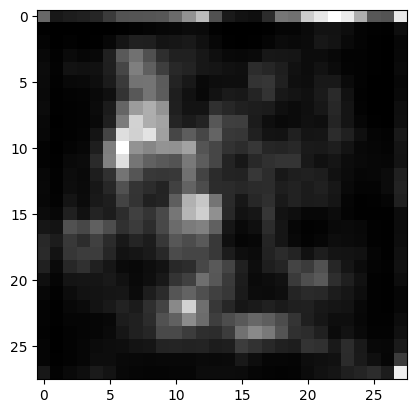

----------------------------------------


Discriminator Loss = 0.10793019831180573
Generator Loss = 3.2939555644989014
A sample image generated by the generator


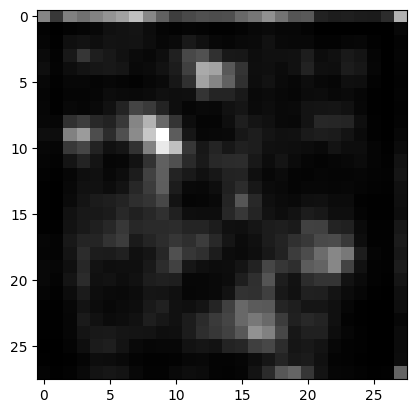

----------------------------------------


Discriminator Loss = 0.0982435941696167
Generator Loss = 3.2771692276000977
A sample image generated by the generator


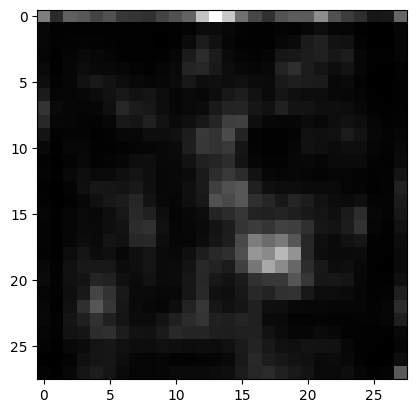

----------------------------------------


Discriminator Loss = 0.10260822623968124
Generator Loss = 3.2435221672058105
A sample image generated by the generator


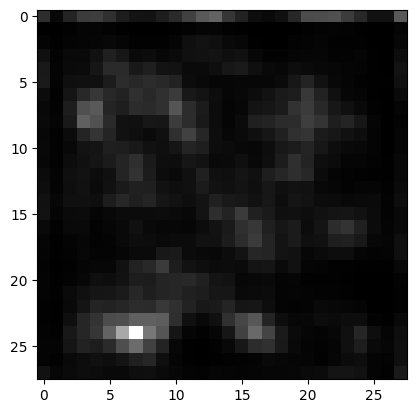

----------------------------------------


Discriminator Loss = 0.09667261689901352
Generator Loss = 3.2397918701171875
A sample image generated by the generator


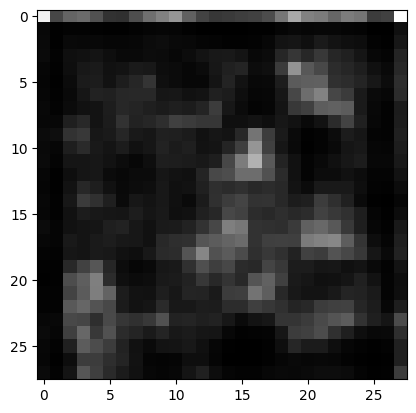

----------------------------------------


Discriminator Loss = 0.0969797670841217
Generator Loss = 3.3064780235290527
A sample image generated by the generator


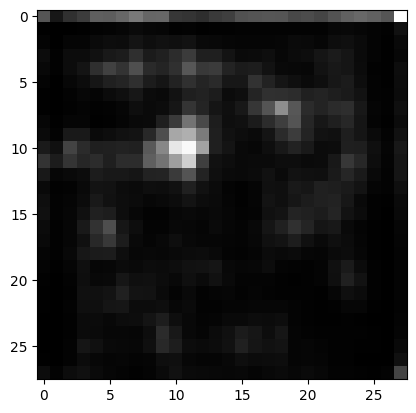

----------------------------------------


Discriminator Loss = 0.09349943697452545
Generator Loss = 3.1064376831054688
A sample image generated by the generator


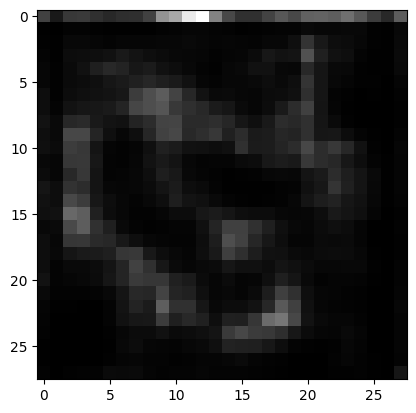

----------------------------------------


Discriminator Loss = 0.1002831757068634
Generator Loss = 3.1812376976013184
A sample image generated by the generator


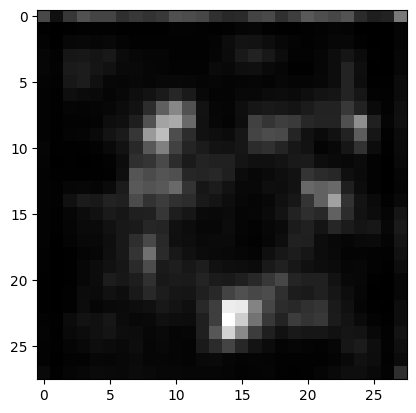

----------------------------------------


Discriminator Loss = 0.1036316305398941
Generator Loss = 3.27093243598938
A sample image generated by the generator


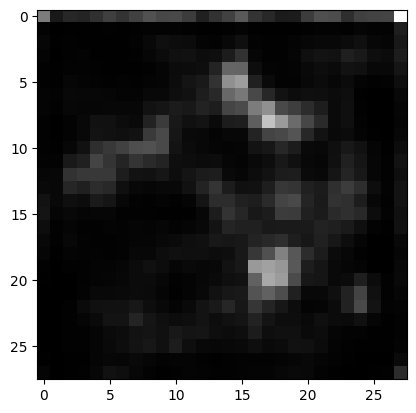

----------------------------------------


Discriminator Loss = 0.0978548675775528
Generator Loss = 3.308633327484131
A sample image generated by the generator


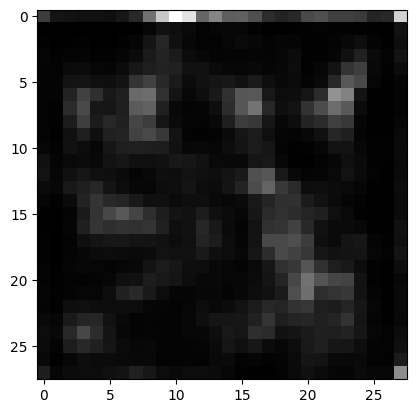

----------------------------------------


Discriminator Loss = 0.09295537322759628
Generator Loss = 3.295152425765991
A sample image generated by the generator


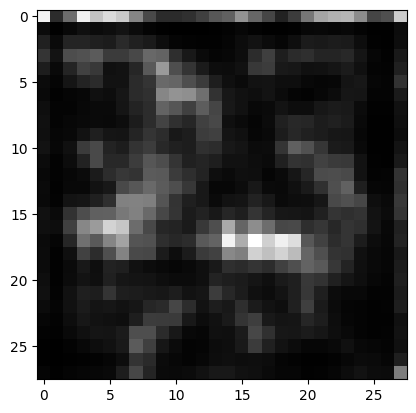

----------------------------------------


Discriminator Loss = 0.09613297879695892
Generator Loss = 3.262305974960327
A sample image generated by the generator


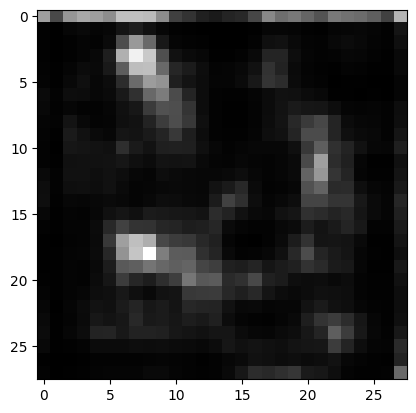

----------------------------------------


Discriminator Loss = 0.09402836859226227
Generator Loss = 3.1121459007263184
A sample image generated by the generator


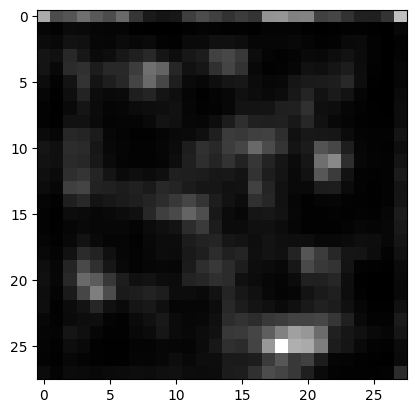

----------------------------------------


Discriminator Loss = 0.0976099818944931
Generator Loss = 3.2073402404785156
A sample image generated by the generator


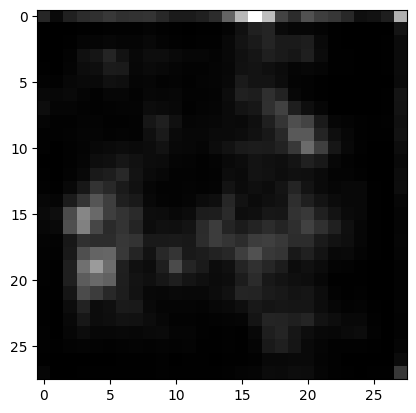

----------------------------------------


Discriminator Loss = 0.0926373153924942
Generator Loss = 3.2944281101226807
A sample image generated by the generator


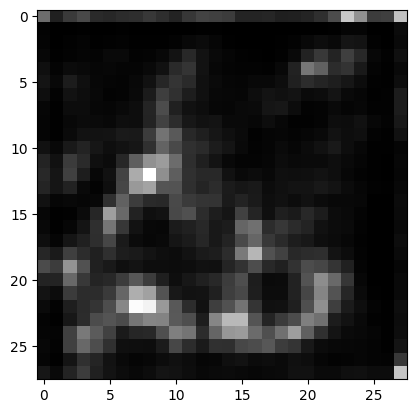

----------------------------------------


Discriminator Loss = 0.08716868609189987
Generator Loss = 3.2456231117248535
A sample image generated by the generator


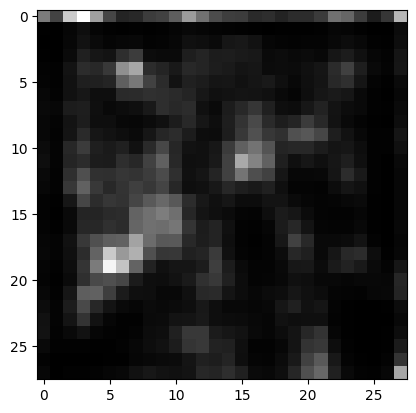

----------------------------------------


Discriminator Loss = 0.09892962127923965
Generator Loss = 3.210416316986084
A sample image generated by the generator


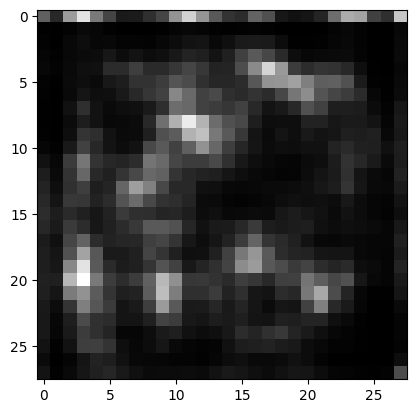

----------------------------------------


Discriminator Loss = 0.10535202920436859
Generator Loss = 3.2570974826812744
A sample image generated by the generator


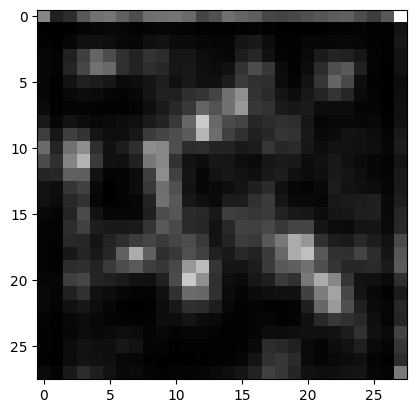

----------------------------------------


Discriminator Loss = 0.09674917161464691
Generator Loss = 3.3048508167266846
A sample image generated by the generator


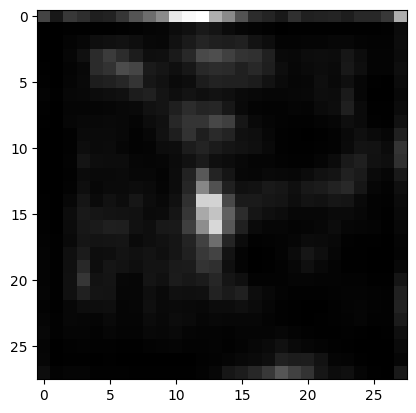

----------------------------------------


Discriminator Loss = 0.09997334331274033
Generator Loss = 3.2526798248291016
A sample image generated by the generator


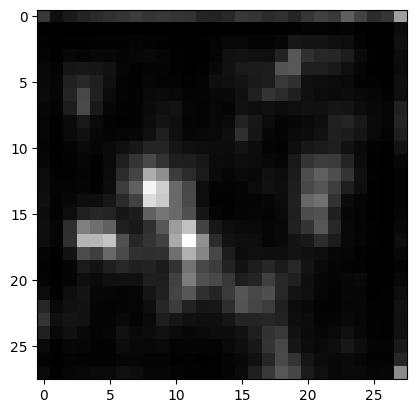

----------------------------------------


Discriminator Loss = 0.0977371484041214
Generator Loss = 3.2223687171936035
A sample image generated by the generator


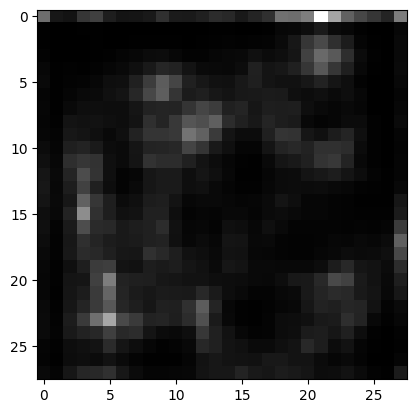

----------------------------------------


Discriminator Loss = 0.09625998139381409
Generator Loss = 3.1746091842651367
A sample image generated by the generator


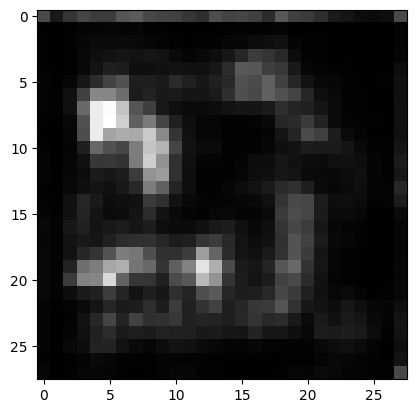

----------------------------------------


Discriminator Loss = 0.10011500120162964
Generator Loss = 3.2511396408081055
A sample image generated by the generator


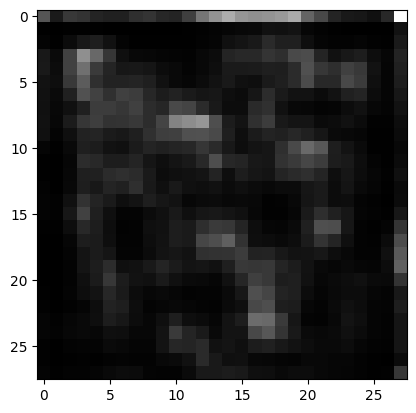

----------------------------------------


Discriminator Loss = 0.09841321408748627
Generator Loss = 3.22902774810791
A sample image generated by the generator


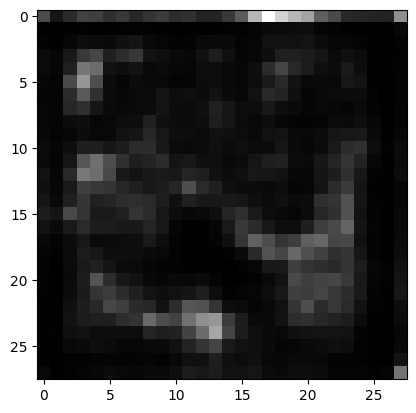

----------------------------------------


Discriminator Loss = 0.09400875866413116
Generator Loss = 3.245467185974121
A sample image generated by the generator


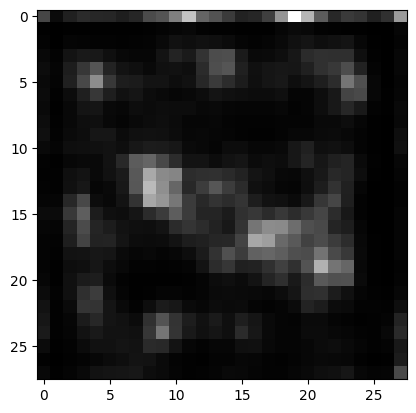

----------------------------------------


Discriminator Loss = 0.08906003832817078
Generator Loss = 3.2124698162078857
A sample image generated by the generator


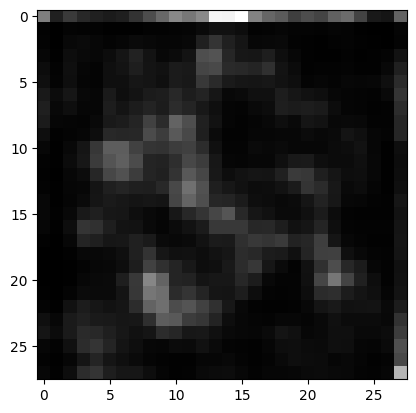

----------------------------------------


Discriminator Loss = 0.09176278114318848
Generator Loss = 3.235891819000244
A sample image generated by the generator


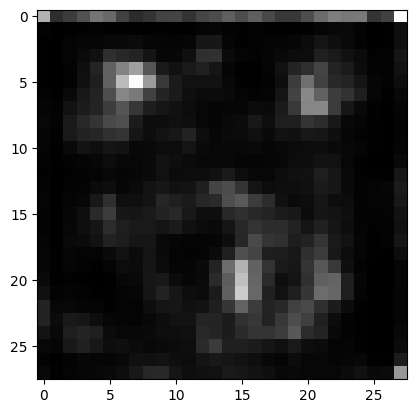

----------------------------------------


Discriminator Loss = 0.09180771559476852
Generator Loss = 3.356532573699951
A sample image generated by the generator


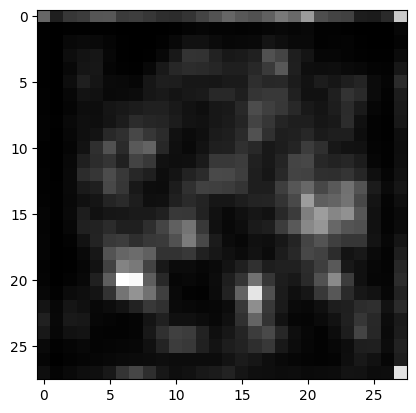

----------------------------------------


Discriminator Loss = 0.08999434113502502
Generator Loss = 3.2869865894317627
A sample image generated by the generator


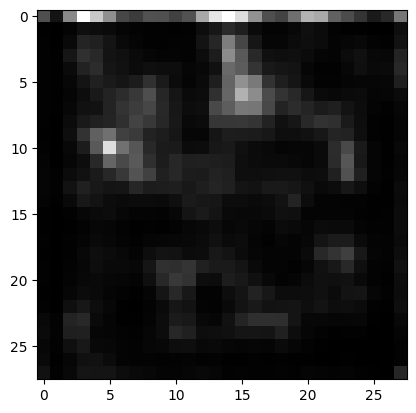

----------------------------------------


Discriminator Loss = 0.09912191331386566
Generator Loss = 3.331460952758789
A sample image generated by the generator


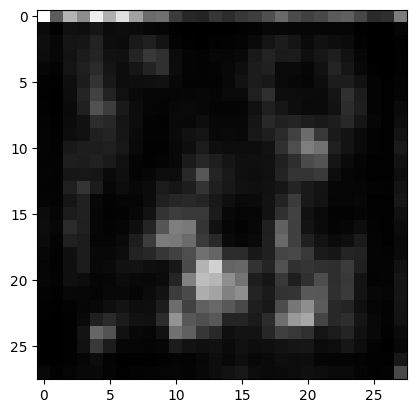

----------------------------------------


Discriminator Loss = 0.11045940965414047
Generator Loss = 3.3132128715515137
A sample image generated by the generator


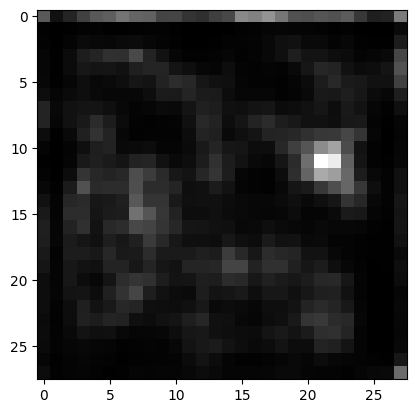

----------------------------------------


Discriminator Loss = 0.09811531007289886
Generator Loss = 3.1927297115325928
A sample image generated by the generator


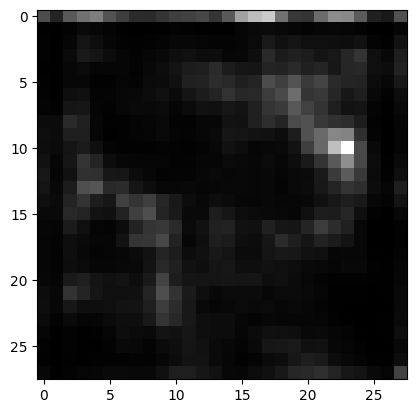

----------------------------------------


Discriminator Loss = 0.09637148678302765
Generator Loss = 3.3179945945739746
A sample image generated by the generator


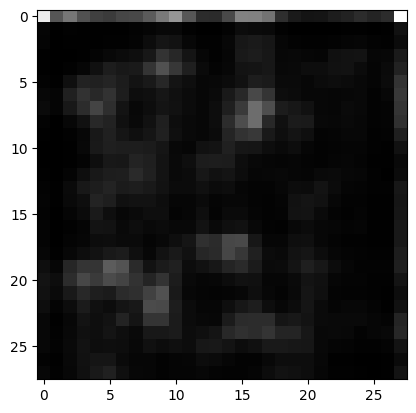

----------------------------------------


Discriminator Loss = 0.09491851925849915
Generator Loss = 3.1619229316711426
A sample image generated by the generator


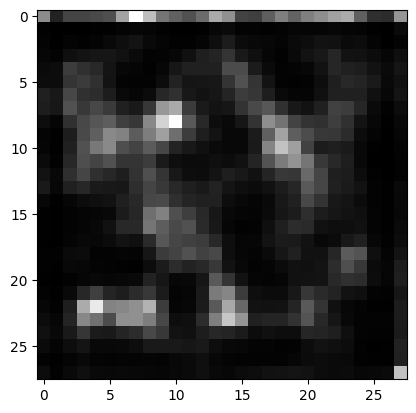

----------------------------------------


Discriminator Loss = 0.09031227231025696
Generator Loss = 3.1926910877227783
A sample image generated by the generator


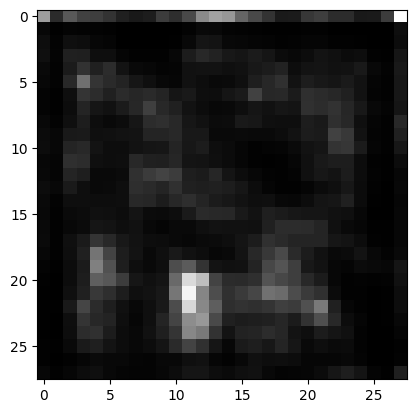

----------------------------------------


Discriminator Loss = 0.08507786691188812
Generator Loss = 3.24267578125
A sample image generated by the generator


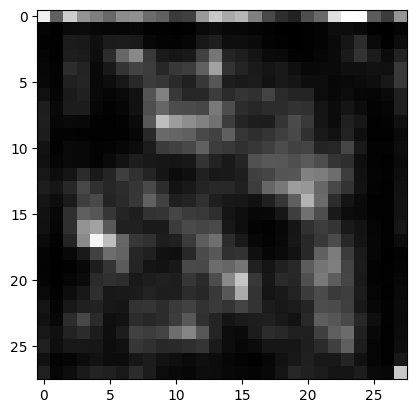

----------------------------------------


Discriminator Loss = 0.09549111127853394
Generator Loss = 3.326690196990967
A sample image generated by the generator


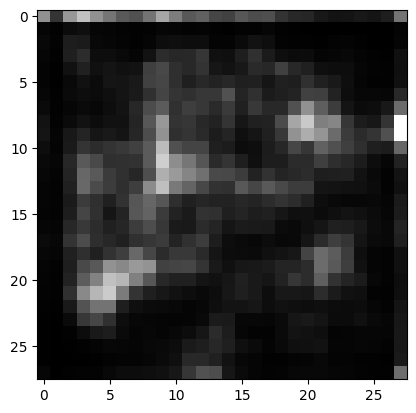

----------------------------------------


Discriminator Loss = 0.09452849626541138
Generator Loss = 3.2900545597076416
A sample image generated by the generator


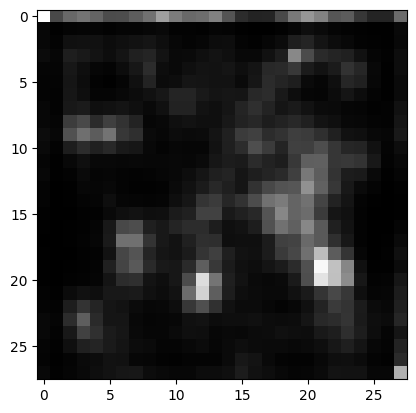

----------------------------------------


Discriminator Loss = 0.09869708120822906
Generator Loss = 3.1947693824768066
A sample image generated by the generator


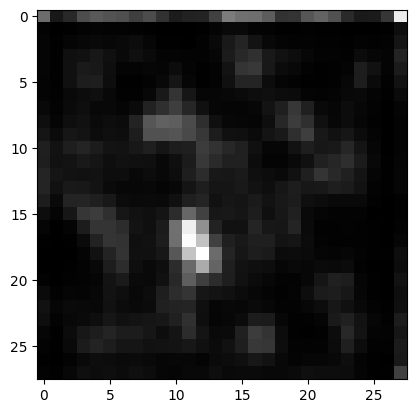

----------------------------------------


Discriminator Loss = 0.1159428209066391
Generator Loss = 3.2870841026306152
A sample image generated by the generator


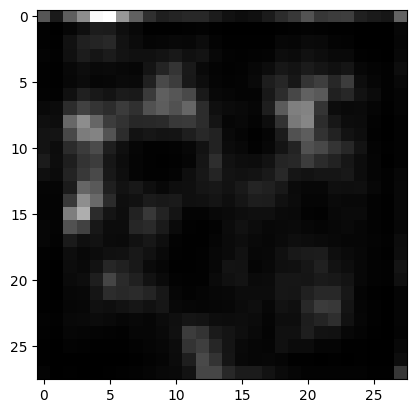

----------------------------------------


Discriminator Loss = 0.0939302071928978
Generator Loss = 3.3404345512390137
A sample image generated by the generator


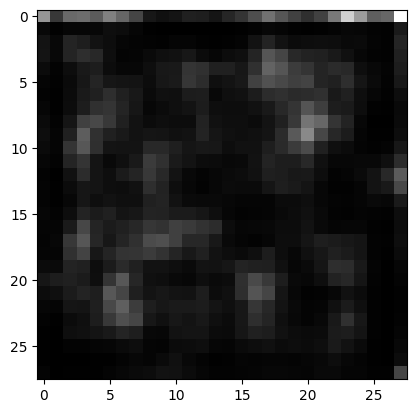

----------------------------------------


Discriminator Loss = 0.08407875150442123
Generator Loss = 3.2295594215393066
A sample image generated by the generator


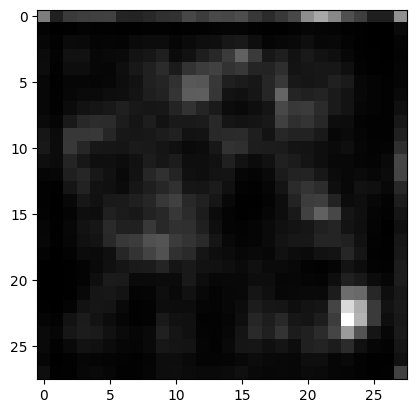

----------------------------------------


Discriminator Loss = 0.09421694278717041
Generator Loss = 3.155757427215576
A sample image generated by the generator


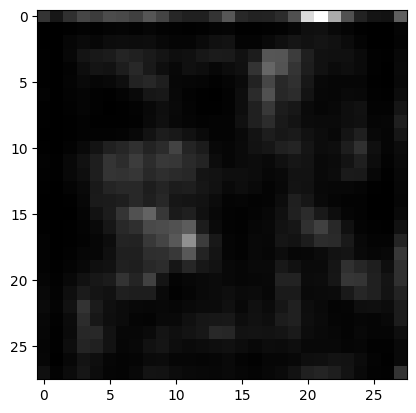

----------------------------------------


Discriminator Loss = 0.10016404092311859
Generator Loss = 3.2937560081481934
A sample image generated by the generator


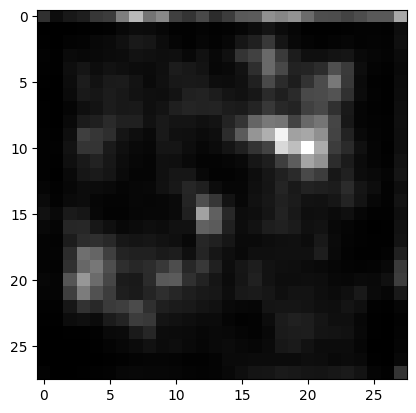

----------------------------------------


Discriminator Loss = 0.09715723991394043
Generator Loss = 3.3511784076690674
A sample image generated by the generator


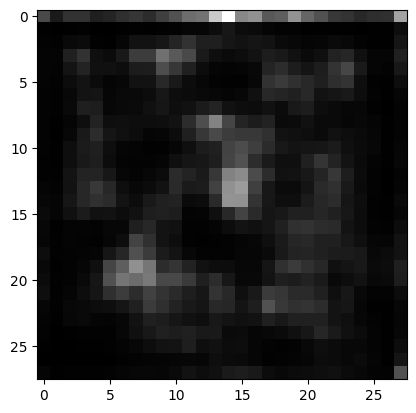

----------------------------------------


Discriminator Loss = 0.09929144382476807
Generator Loss = 3.3386640548706055
A sample image generated by the generator


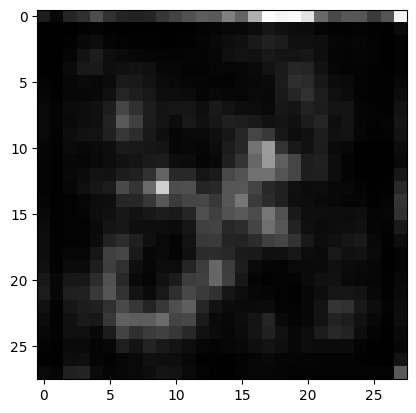

----------------------------------------


Discriminator Loss = 0.10015113651752472
Generator Loss = 3.2990975379943848
A sample image generated by the generator


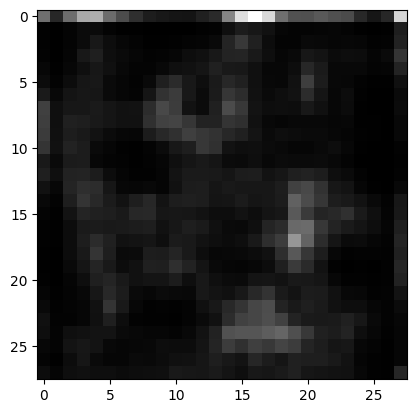

----------------------------------------


Discriminator Loss = 0.09048072248697281
Generator Loss = 3.281909942626953
A sample image generated by the generator


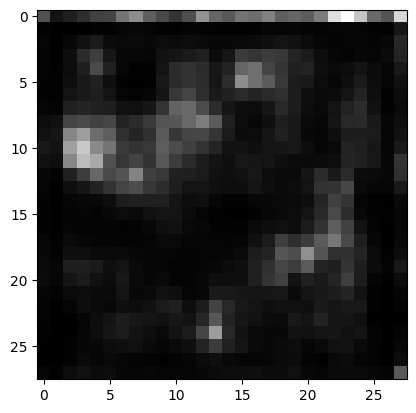

----------------------------------------


Discriminator Loss = 0.09203972667455673
Generator Loss = 3.1800122261047363
A sample image generated by the generator


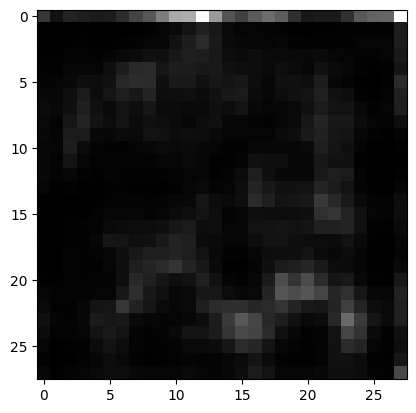

----------------------------------------


Discriminator Loss = 0.08946222811937332
Generator Loss = 3.359039068222046
A sample image generated by the generator


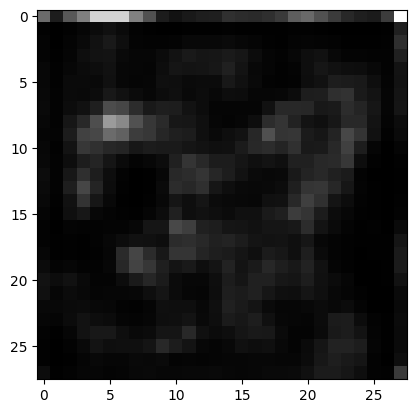

----------------------------------------


Discriminator Loss = 0.10221997648477554
Generator Loss = 3.188988208770752
A sample image generated by the generator


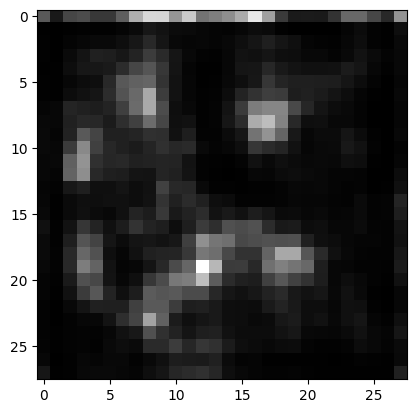

----------------------------------------


Discriminator Loss = 0.0927925631403923
Generator Loss = 3.2772209644317627
A sample image generated by the generator


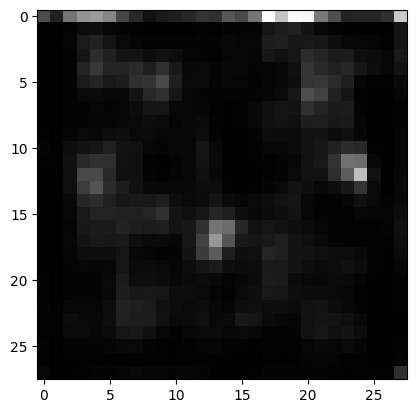

----------------------------------------


Discriminator Loss = 0.09442135691642761
Generator Loss = 3.281959056854248
A sample image generated by the generator


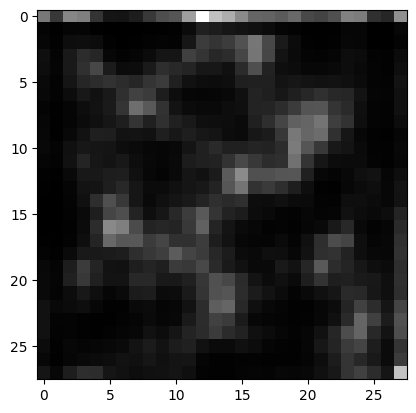

----------------------------------------


Discriminator Loss = 0.10171032696962357
Generator Loss = 3.2850186824798584
A sample image generated by the generator


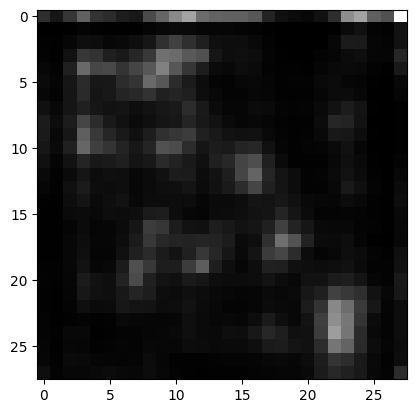

----------------------------------------


Discriminator Loss = 0.09870287030935287
Generator Loss = 3.237793445587158
A sample image generated by the generator


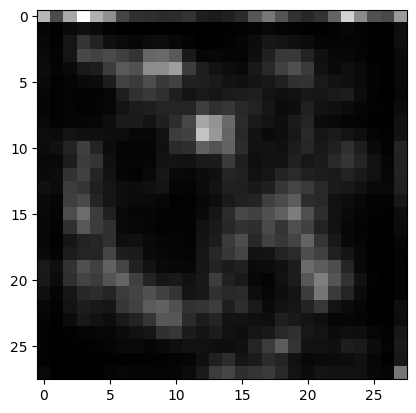

----------------------------------------


Discriminator Loss = 0.08231151103973389
Generator Loss = 3.3290634155273438
A sample image generated by the generator


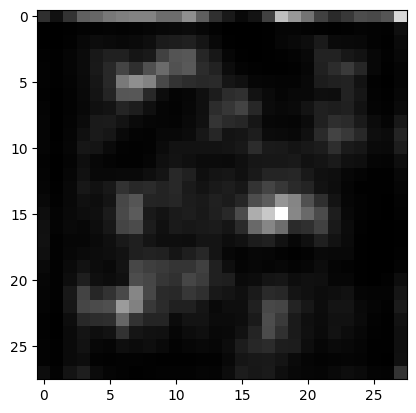

----------------------------------------


Discriminator Loss = 0.09827274829149246
Generator Loss = 3.2649025917053223
A sample image generated by the generator


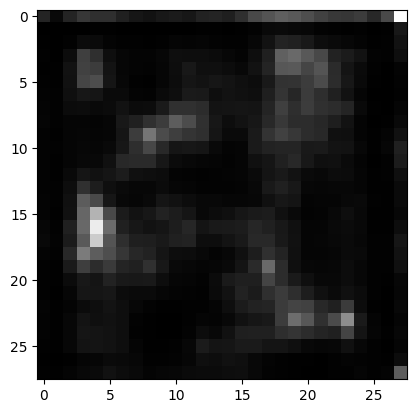

----------------------------------------


Discriminator Loss = 0.08261588215827942
Generator Loss = 3.229098320007324
A sample image generated by the generator


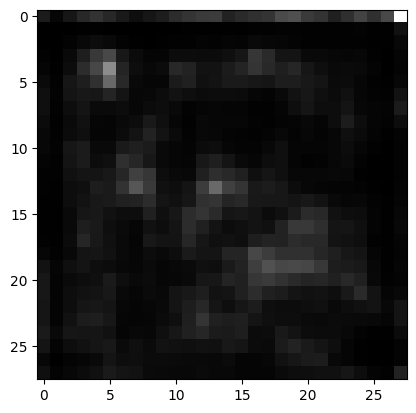

----------------------------------------


Discriminator Loss = 0.09514766931533813
Generator Loss = 3.265876293182373
A sample image generated by the generator


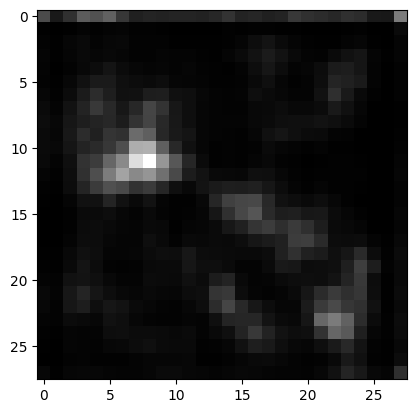

----------------------------------------


Discriminator Loss = 0.08681289106607437
Generator Loss = 3.2498669624328613
A sample image generated by the generator


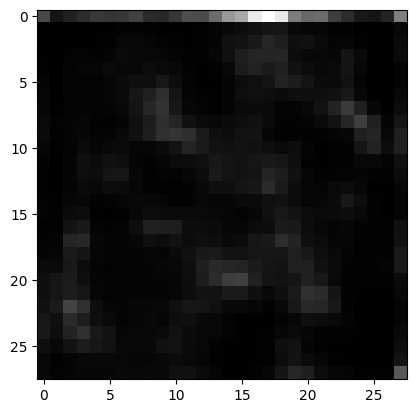

----------------------------------------


Discriminator Loss = 0.08855617046356201
Generator Loss = 3.2064225673675537
A sample image generated by the generator


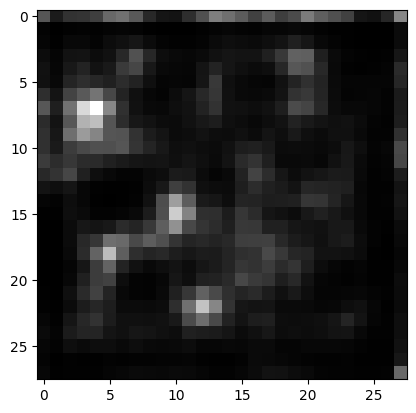

----------------------------------------


Discriminator Loss = 0.08791817724704742
Generator Loss = 3.1333229541778564
A sample image generated by the generator


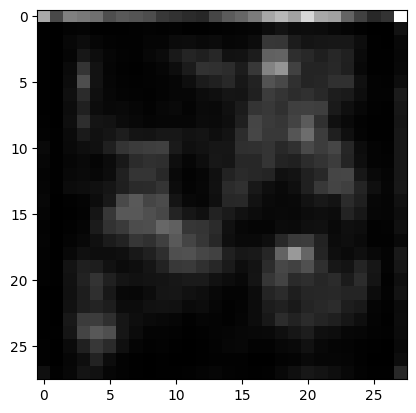

----------------------------------------


Discriminator Loss = 0.0936923697590828
Generator Loss = 3.1370012760162354
A sample image generated by the generator


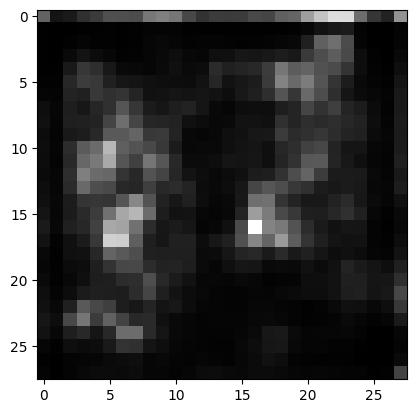

----------------------------------------


Discriminator Loss = 0.09091158956289291
Generator Loss = 3.168774127960205
A sample image generated by the generator


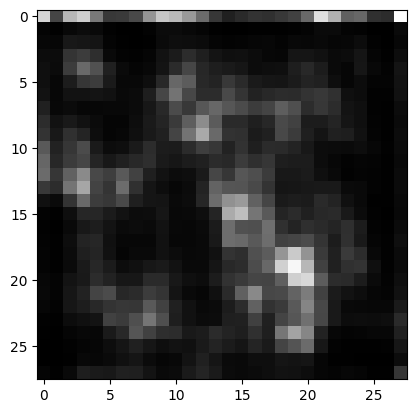

----------------------------------------


Discriminator Loss = 0.09020427614450455
Generator Loss = 3.224561929702759
A sample image generated by the generator


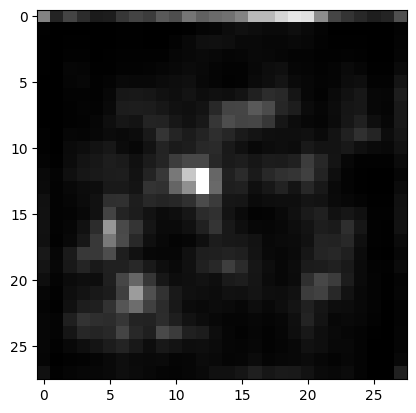

----------------------------------------


Discriminator Loss = 0.09940997511148453
Generator Loss = 3.2806437015533447
A sample image generated by the generator


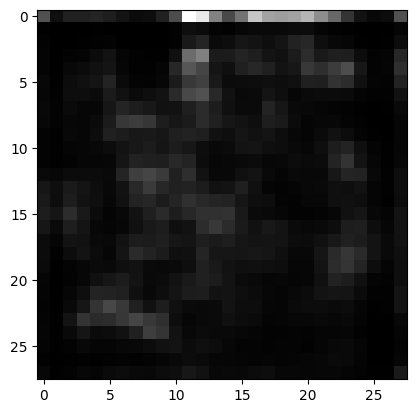

----------------------------------------


Discriminator Loss = 0.09310193359851837
Generator Loss = 3.2909698486328125
A sample image generated by the generator


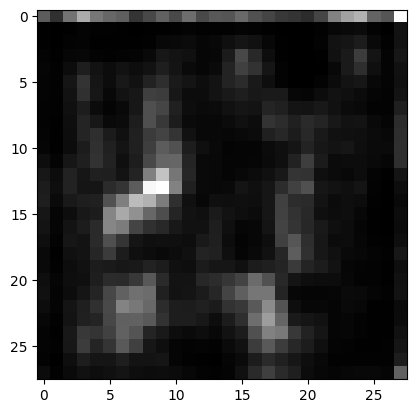

----------------------------------------


Discriminator Loss = 0.08897377550601959
Generator Loss = 3.2970924377441406
A sample image generated by the generator


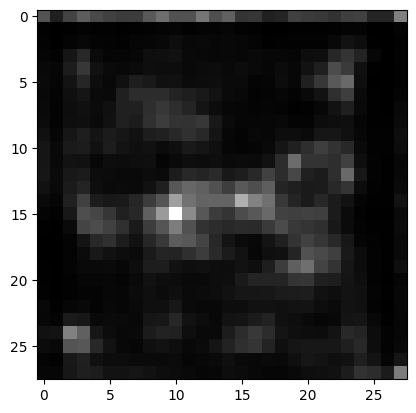

----------------------------------------


Discriminator Loss = 0.09278308600187302
Generator Loss = 3.267200469970703
A sample image generated by the generator


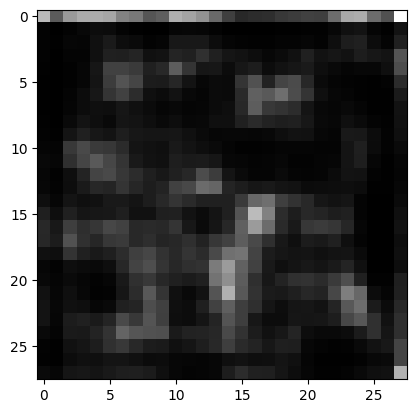

----------------------------------------


Discriminator Loss = 0.09729890525341034
Generator Loss = 3.193899154663086
A sample image generated by the generator


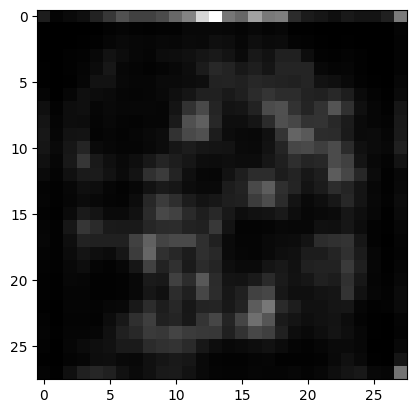

----------------------------------------


Discriminator Loss = 0.09751221537590027
Generator Loss = 3.3336312770843506
A sample image generated by the generator


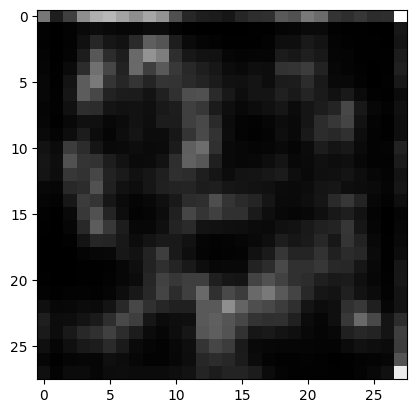

----------------------------------------


Discriminator Loss = 0.09395623207092285
Generator Loss = 3.3245010375976562
A sample image generated by the generator


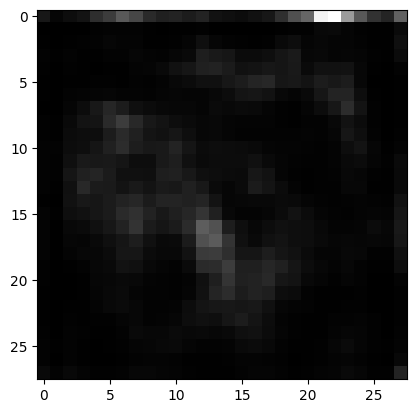

----------------------------------------


Discriminator Loss = 0.09207130968570709
Generator Loss = 3.293639659881592
A sample image generated by the generator


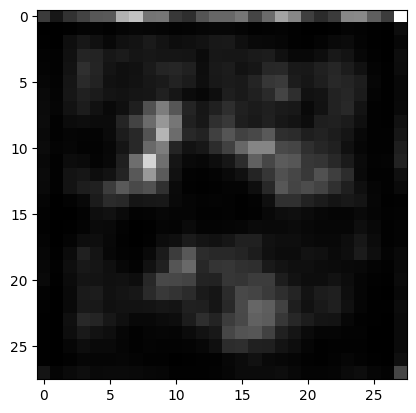

----------------------------------------


Discriminator Loss = 0.09359914064407349
Generator Loss = 3.352433919906616
A sample image generated by the generator


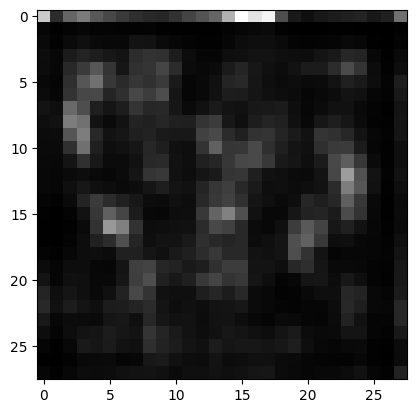

----------------------------------------


Discriminator Loss = 0.08898310363292694
Generator Loss = 3.2712175846099854
A sample image generated by the generator


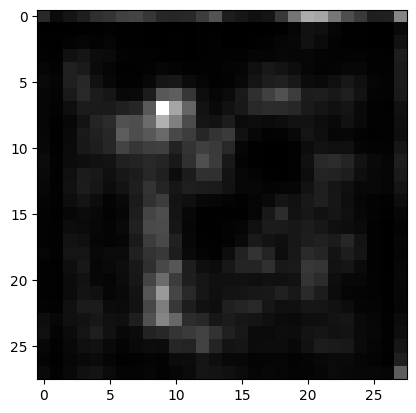

----------------------------------------


Discriminator Loss = 0.09321881830692291
Generator Loss = 3.3457565307617188
A sample image generated by the generator


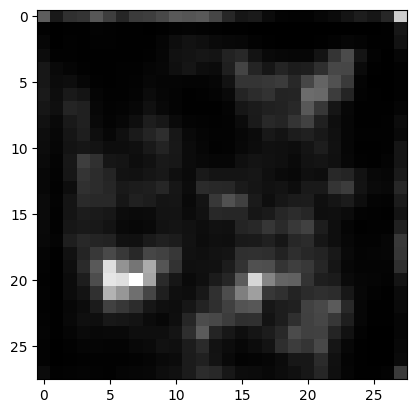

----------------------------------------


Discriminator Loss = 0.09680578112602234
Generator Loss = 3.2829489707946777
A sample image generated by the generator


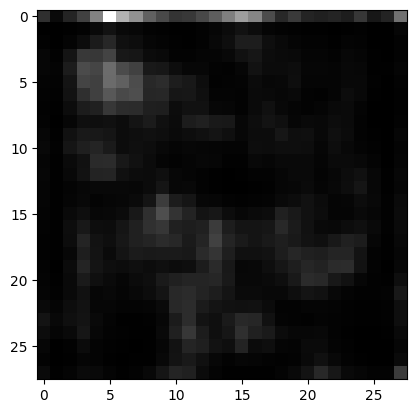

----------------------------------------


Discriminator Loss = 0.09214047342538834
Generator Loss = 3.289673328399658
A sample image generated by the generator


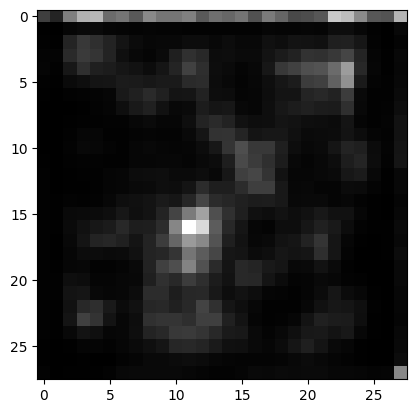

----------------------------------------


Discriminator Loss = 0.0872589647769928
Generator Loss = 3.392000198364258
A sample image generated by the generator


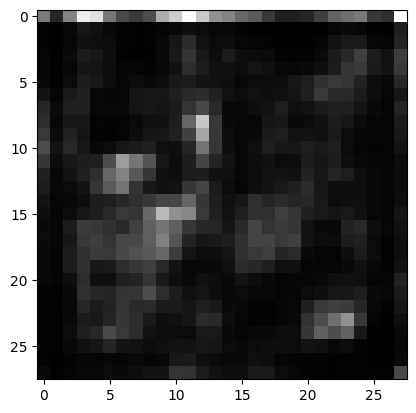

----------------------------------------


Discriminator Loss = 0.09458285570144653
Generator Loss = 3.3059380054473877
A sample image generated by the generator


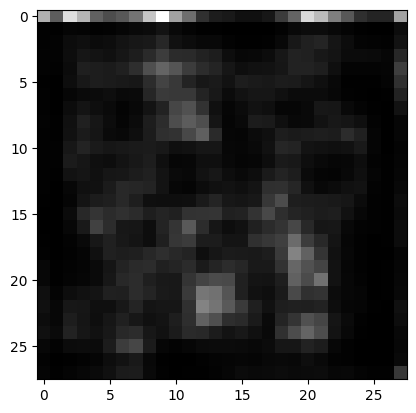

----------------------------------------


Discriminator Loss = 0.09025397151708603
Generator Loss = 3.1496434211730957
A sample image generated by the generator


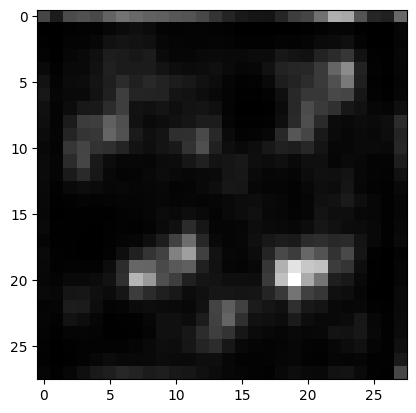

----------------------------------------


Discriminator Loss = 0.0956660732626915
Generator Loss = 3.280832529067993
A sample image generated by the generator


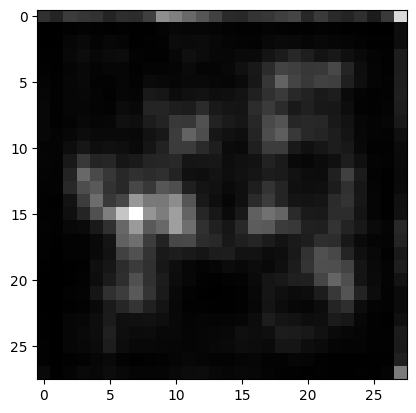

----------------------------------------


Discriminator Loss = 0.09528996795415878
Generator Loss = 3.296722173690796
A sample image generated by the generator


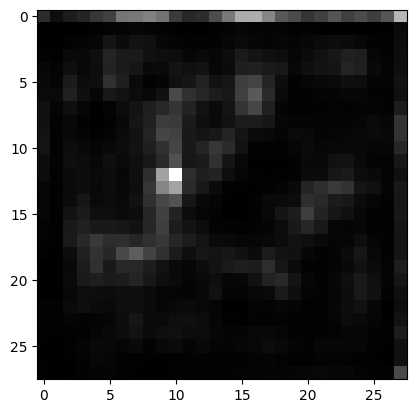

----------------------------------------


Discriminator Loss = 0.09382690489292145
Generator Loss = 3.2287752628326416
A sample image generated by the generator


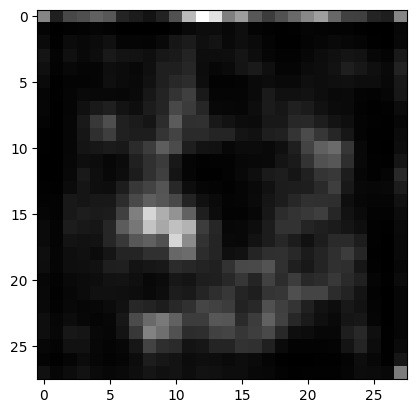

----------------------------------------


Discriminator Loss = 0.09546799212694168
Generator Loss = 3.3522043228149414
A sample image generated by the generator


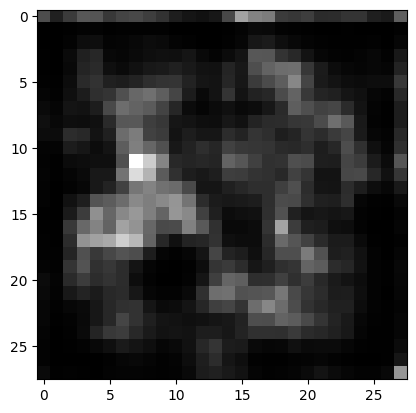

----------------------------------------


Discriminator Loss = 0.0954265221953392
Generator Loss = 3.2754597663879395
A sample image generated by the generator


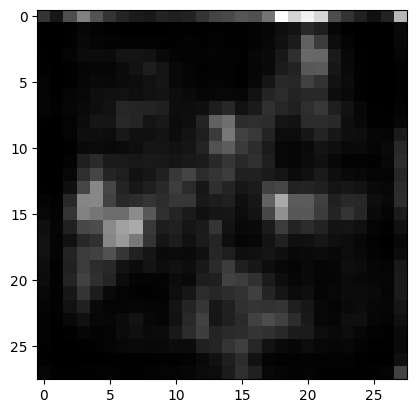

----------------------------------------


Discriminator Loss = 0.09159332513809204
Generator Loss = 3.3567798137664795
A sample image generated by the generator


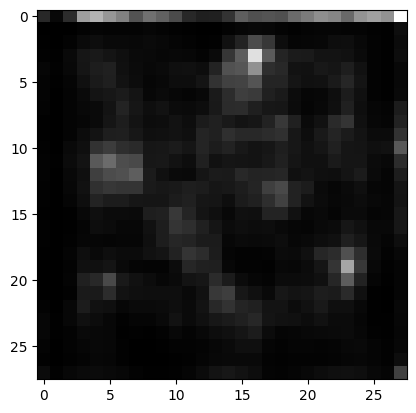

----------------------------------------


Discriminator Loss = 0.08612574636936188
Generator Loss = 3.3117213249206543
A sample image generated by the generator


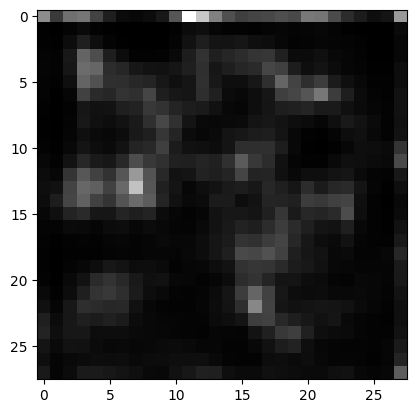

----------------------------------------


Discriminator Loss = 0.09717082232236862
Generator Loss = 3.3087570667266846
A sample image generated by the generator


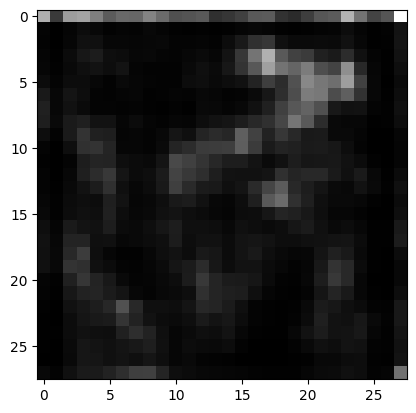

----------------------------------------


Discriminator Loss = 0.10504299402236938
Generator Loss = 3.3671107292175293
A sample image generated by the generator


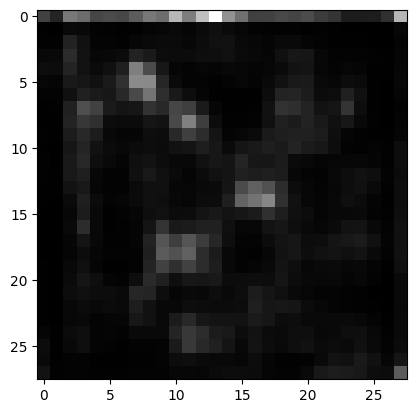

----------------------------------------


Discriminator Loss = 0.09111292660236359
Generator Loss = 3.2852556705474854
A sample image generated by the generator


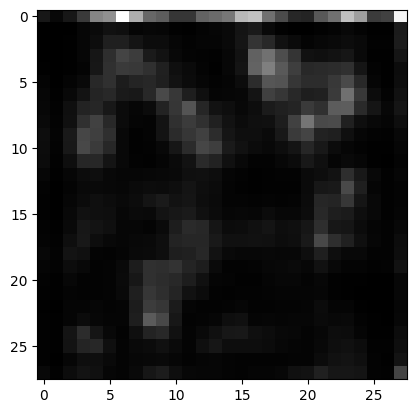

----------------------------------------


Discriminator Loss = 0.08869422972202301
Generator Loss = 3.4416604042053223
A sample image generated by the generator


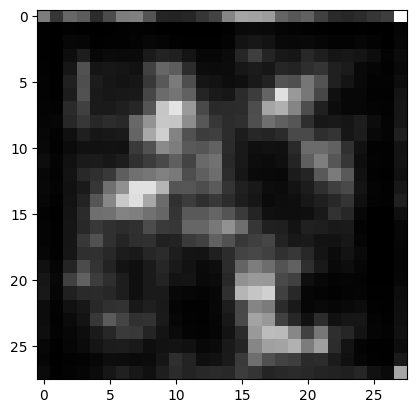

----------------------------------------


Discriminator Loss = 0.08973877876996994
Generator Loss = 3.3444385528564453
A sample image generated by the generator


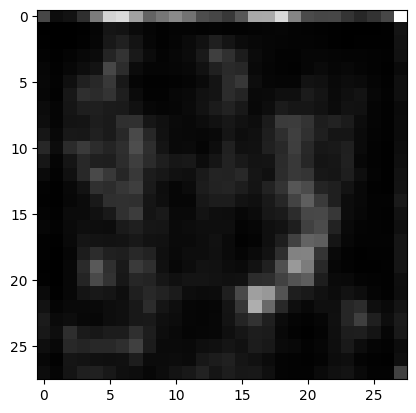

----------------------------------------


Discriminator Loss = 0.08416776359081268
Generator Loss = 3.208062171936035
A sample image generated by the generator


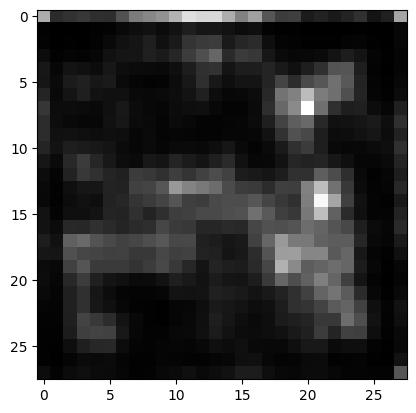

----------------------------------------


Discriminator Loss = 0.09101872891187668
Generator Loss = 3.227691650390625
A sample image generated by the generator


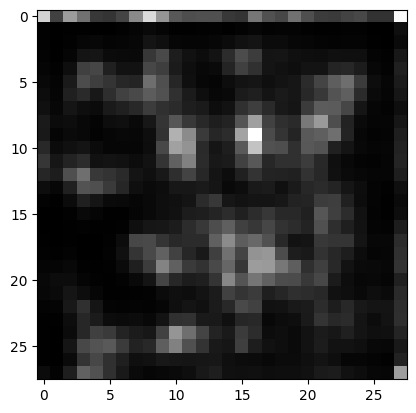

----------------------------------------


Discriminator Loss = 0.0881798043847084
Generator Loss = 3.257922410964966
A sample image generated by the generator


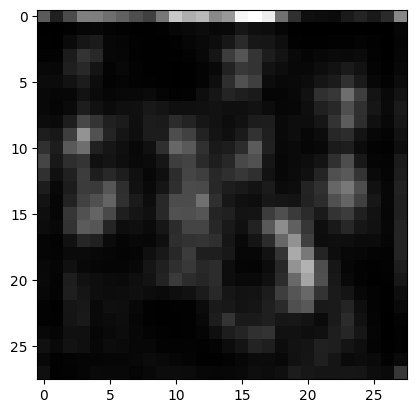

----------------------------------------


Discriminator Loss = 0.08774447441101074
Generator Loss = 3.2146947383880615
A sample image generated by the generator


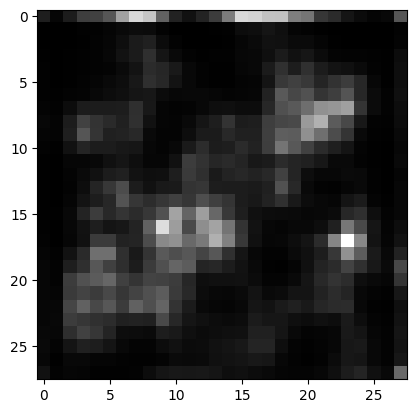

----------------------------------------


Discriminator Loss = 0.0950043722987175
Generator Loss = 3.326178550720215
A sample image generated by the generator


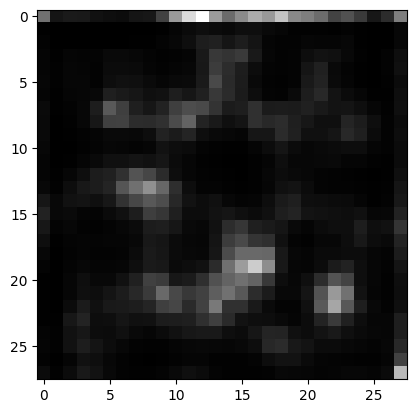

----------------------------------------


Discriminator Loss = 0.08351443707942963
Generator Loss = 3.2075281143188477
A sample image generated by the generator


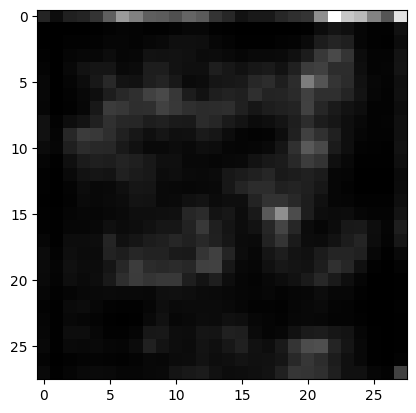

----------------------------------------


Discriminator Loss = 0.08510535210371017
Generator Loss = 3.297342300415039
A sample image generated by the generator


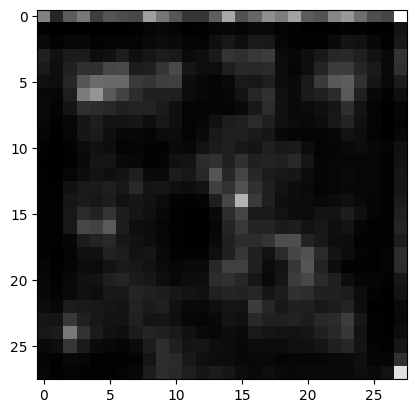

----------------------------------------


Discriminator Loss = 0.08081510663032532
Generator Loss = 3.4641764163970947
A sample image generated by the generator


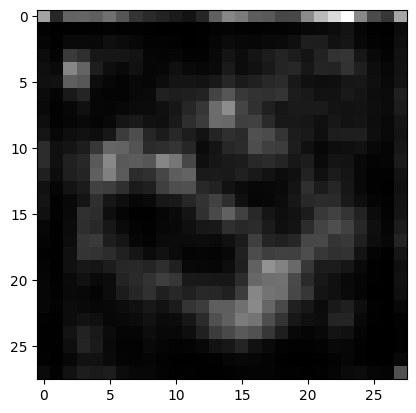

----------------------------------------


Discriminator Loss = 0.09295333921909332
Generator Loss = 3.3980870246887207
A sample image generated by the generator


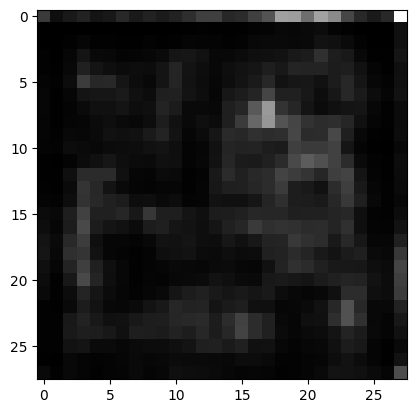

----------------------------------------


Discriminator Loss = 0.09003770351409912
Generator Loss = 3.375964403152466
A sample image generated by the generator


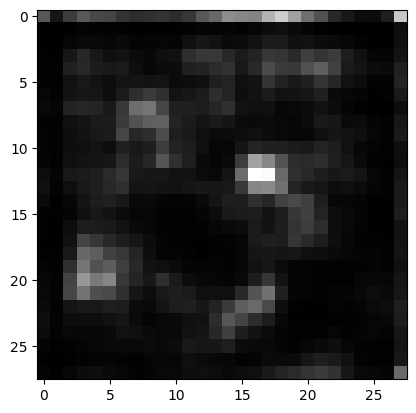

----------------------------------------


Discriminator Loss = 0.08565540611743927
Generator Loss = 3.367812156677246
A sample image generated by the generator


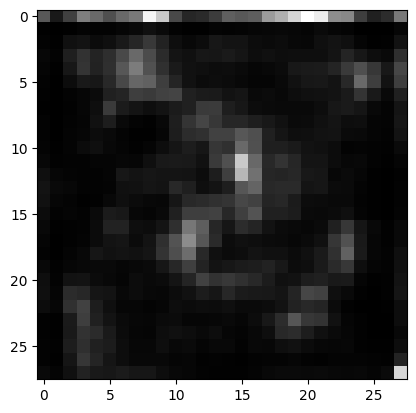

----------------------------------------


Discriminator Loss = 0.08813950419425964
Generator Loss = 3.2248387336730957
A sample image generated by the generator


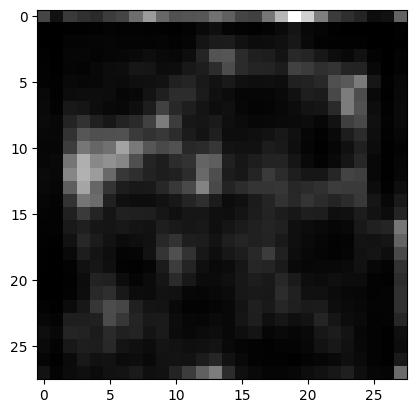

----------------------------------------


Discriminator Loss = 0.08708056807518005
Generator Loss = 3.2932238578796387
A sample image generated by the generator


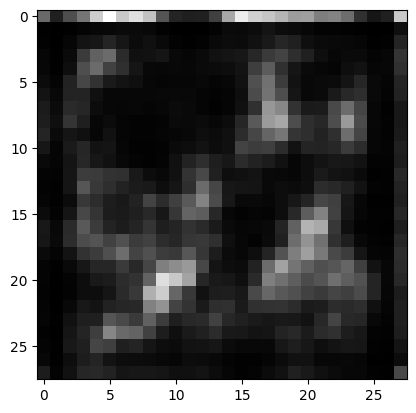

----------------------------------------


Discriminator Loss = 0.09839419275522232
Generator Loss = 3.254838466644287
A sample image generated by the generator


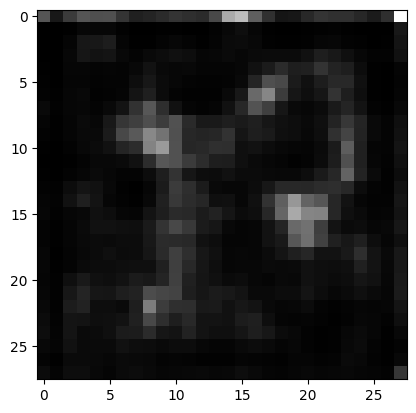

----------------------------------------


Discriminator Loss = 0.09151612222194672
Generator Loss = 3.175828218460083
A sample image generated by the generator


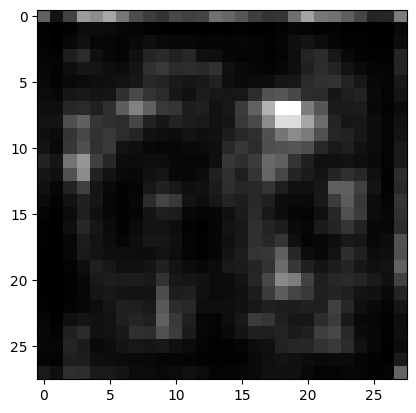

----------------------------------------


Discriminator Loss = 0.10483846813440323
Generator Loss = 3.370612859725952
A sample image generated by the generator


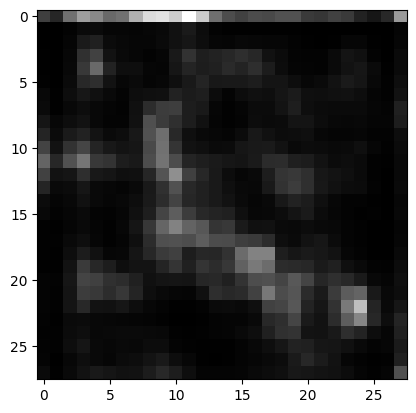

----------------------------------------


Discriminator Loss = 0.08372163772583008
Generator Loss = 3.464916467666626
A sample image generated by the generator


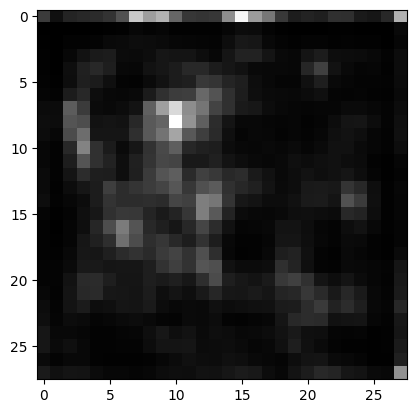

----------------------------------------


Discriminator Loss = 0.088448166847229
Generator Loss = 3.375389575958252
A sample image generated by the generator


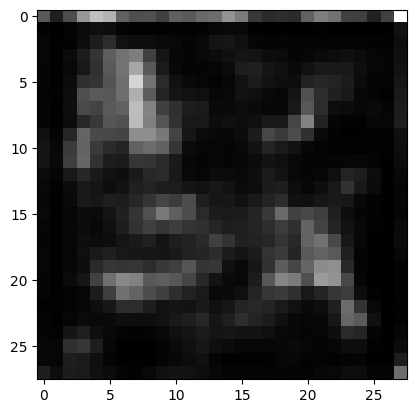

----------------------------------------


Discriminator Loss = 0.09021569043397903
Generator Loss = 3.2966160774230957
A sample image generated by the generator


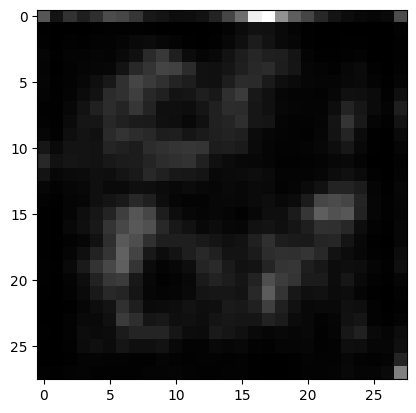

----------------------------------------


Discriminator Loss = 0.10039422661066055
Generator Loss = 3.2680578231811523
A sample image generated by the generator


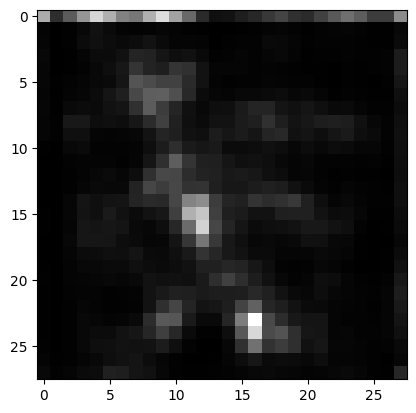

----------------------------------------


Discriminator Loss = 0.08655057102441788
Generator Loss = 3.193124294281006
A sample image generated by the generator


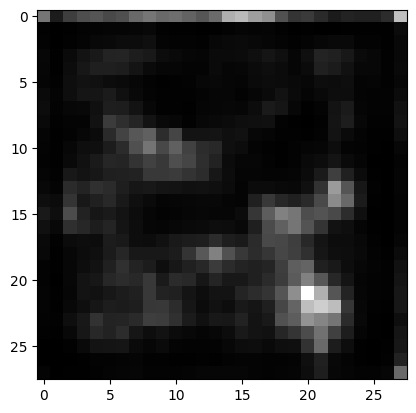

----------------------------------------


Discriminator Loss = 0.08736725896596909
Generator Loss = 3.3853893280029297
A sample image generated by the generator


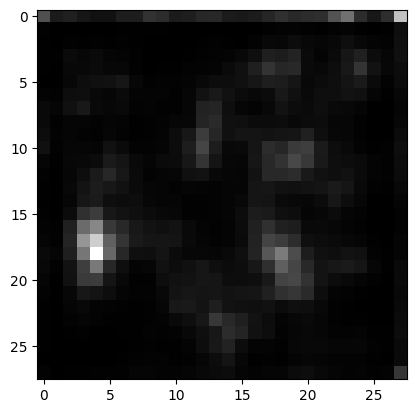

----------------------------------------


Discriminator Loss = 0.08757653832435608
Generator Loss = 3.299966335296631
A sample image generated by the generator


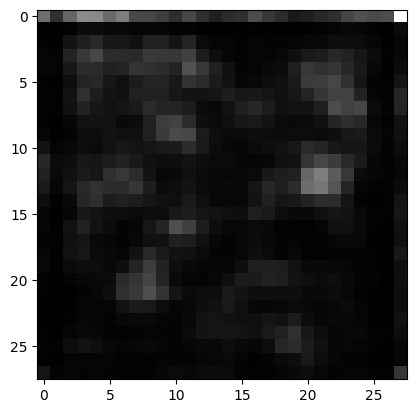

----------------------------------------


Discriminator Loss = 0.08461910486221313
Generator Loss = 3.3537044525146484
A sample image generated by the generator


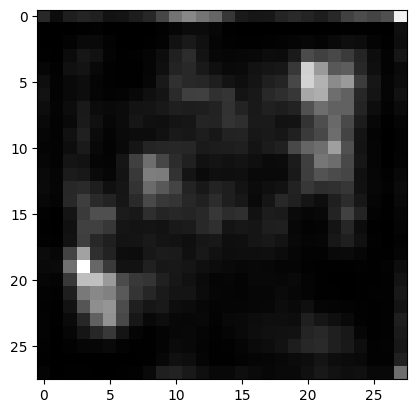

----------------------------------------


Discriminator Loss = 0.08995284140110016
Generator Loss = 3.4695944786071777
A sample image generated by the generator


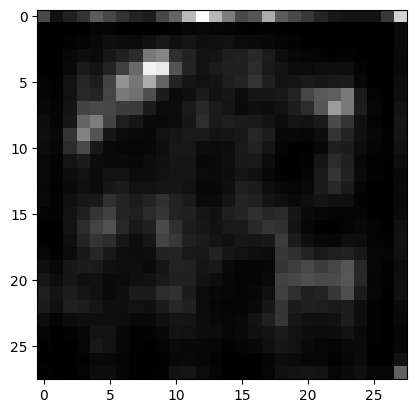

----------------------------------------


Discriminator Loss = 0.08921567350625992
Generator Loss = 3.2561442852020264
A sample image generated by the generator


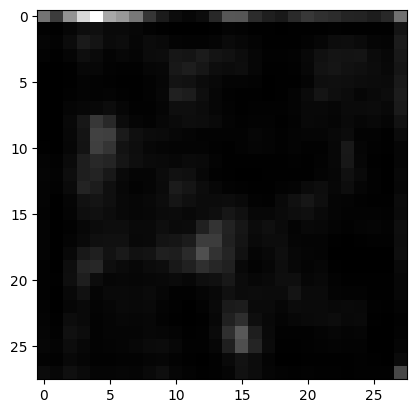

----------------------------------------


Discriminator Loss = 0.08357979357242584
Generator Loss = 3.4497766494750977
A sample image generated by the generator


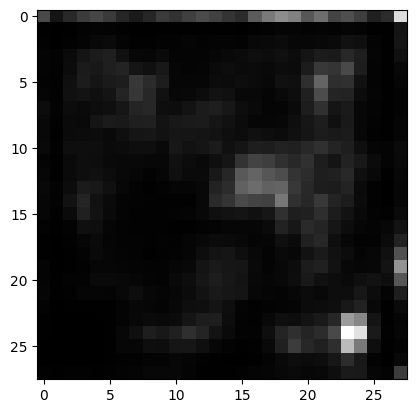

----------------------------------------


Discriminator Loss = 0.08588997274637222
Generator Loss = 3.2732701301574707
A sample image generated by the generator


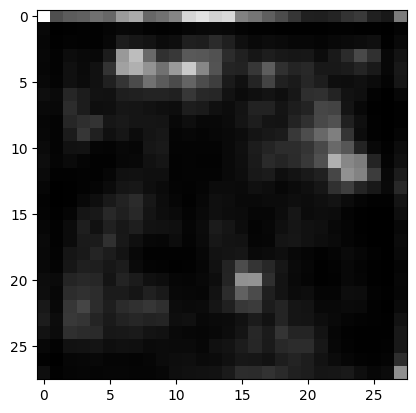

----------------------------------------


Discriminator Loss = 0.08476905524730682
Generator Loss = 3.2852702140808105
A sample image generated by the generator


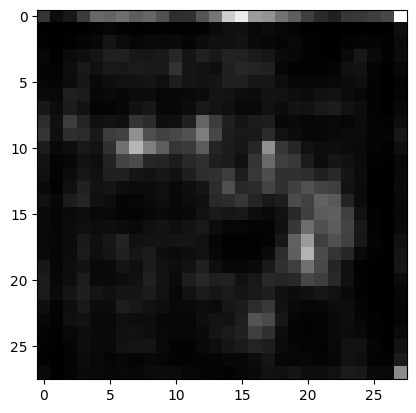

----------------------------------------


Discriminator Loss = 0.09623359143733978
Generator Loss = 3.308967113494873
A sample image generated by the generator


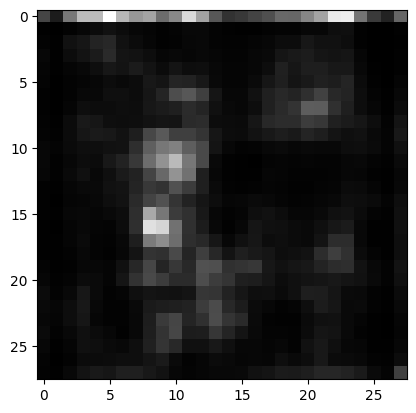

----------------------------------------


Discriminator Loss = 0.08632302284240723
Generator Loss = 3.426671028137207
A sample image generated by the generator


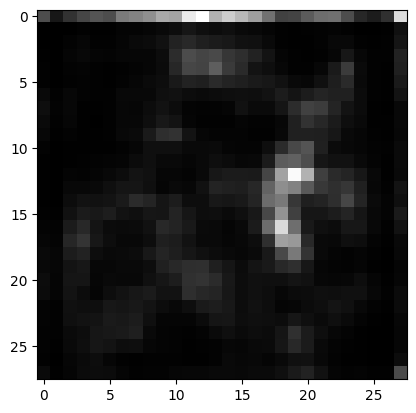

----------------------------------------


Discriminator Loss = 0.08810193836688995
Generator Loss = 3.315808057785034
A sample image generated by the generator


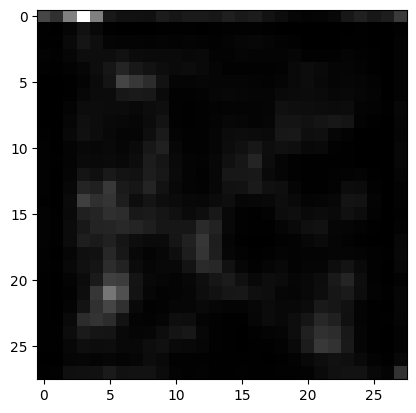

----------------------------------------


Discriminator Loss = 0.08232676982879639
Generator Loss = 3.3784899711608887
A sample image generated by the generator


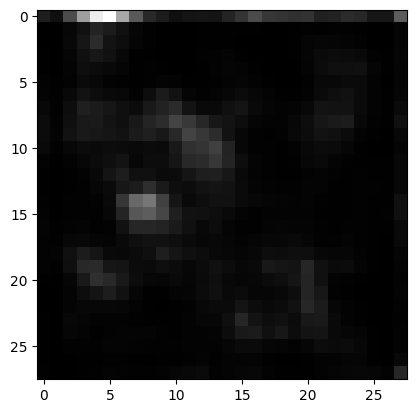

----------------------------------------


Discriminator Loss = 0.08479610830545425
Generator Loss = 3.4071455001831055
A sample image generated by the generator


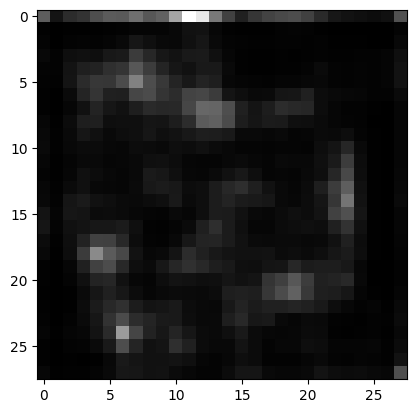

----------------------------------------


Discriminator Loss = 0.09055217355489731
Generator Loss = 3.4809463024139404
A sample image generated by the generator


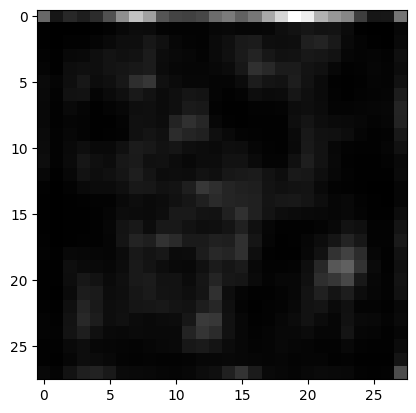

----------------------------------------


Discriminator Loss = 0.07586994022130966
Generator Loss = 3.42527437210083
A sample image generated by the generator


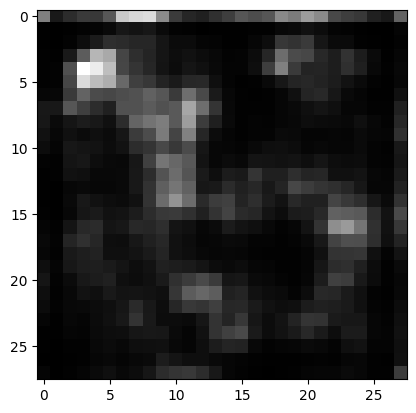

----------------------------------------


Discriminator Loss = 0.08473729342222214
Generator Loss = 3.2593352794647217
A sample image generated by the generator


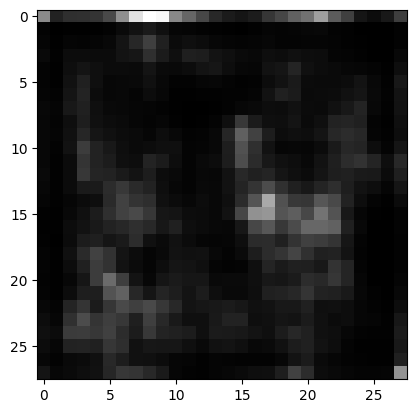

----------------------------------------


Discriminator Loss = 0.08467195928096771
Generator Loss = 3.3022654056549072
A sample image generated by the generator


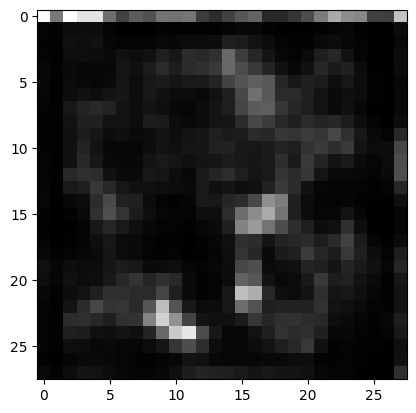

----------------------------------------


Discriminator Loss = 0.08347200602293015
Generator Loss = 3.2931110858917236
A sample image generated by the generator


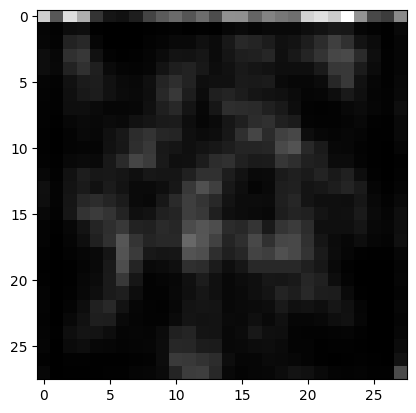

----------------------------------------


Discriminator Loss = 0.0815884917974472
Generator Loss = 3.5587313175201416
A sample image generated by the generator


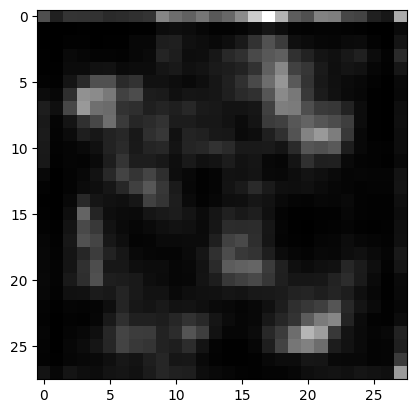

----------------------------------------


Discriminator Loss = 0.0911293476819992
Generator Loss = 3.3911914825439453
A sample image generated by the generator


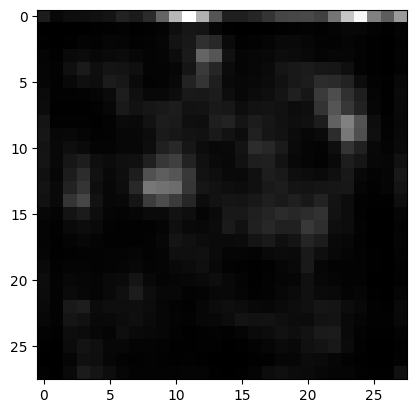

----------------------------------------


Discriminator Loss = 0.08354823291301727
Generator Loss = 3.2871813774108887
A sample image generated by the generator


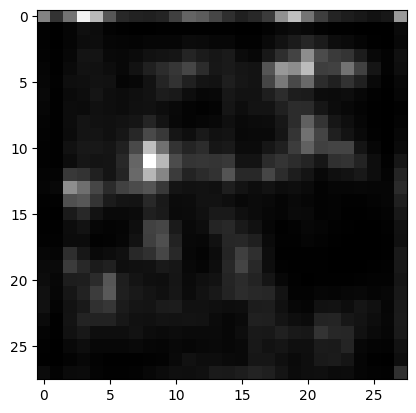

----------------------------------------


Discriminator Loss = 0.08611337840557098
Generator Loss = 3.354602098464966
A sample image generated by the generator


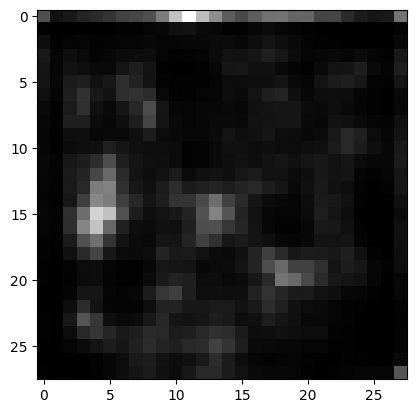

----------------------------------------


Discriminator Loss = 0.09047766029834747
Generator Loss = 3.3271918296813965
A sample image generated by the generator


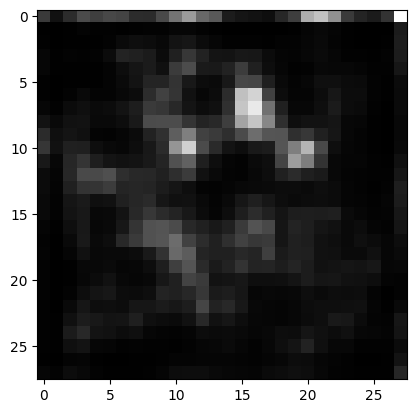

----------------------------------------


Discriminator Loss = 0.08826722204685211
Generator Loss = 3.302706718444824
A sample image generated by the generator


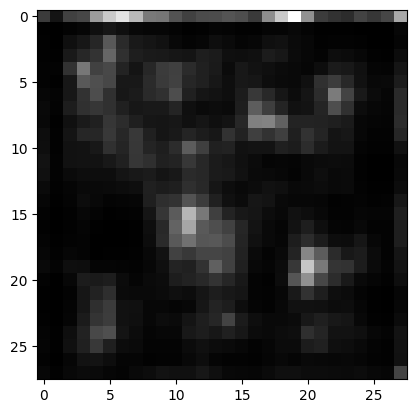

----------------------------------------


Discriminator Loss = 0.0834820419549942
Generator Loss = 3.331571340560913
A sample image generated by the generator


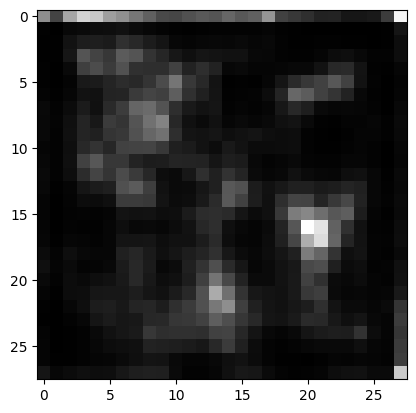

----------------------------------------


Discriminator Loss = 0.08180396258831024
Generator Loss = 3.4348747730255127
A sample image generated by the generator


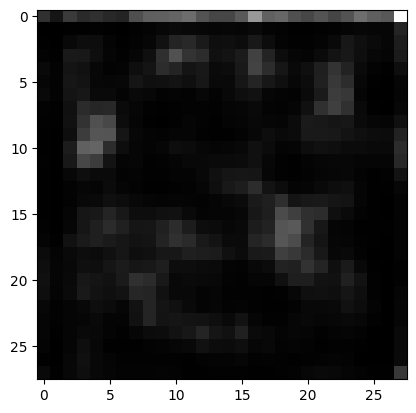

----------------------------------------


Discriminator Loss = 0.08731169998645782
Generator Loss = 3.369389057159424
A sample image generated by the generator


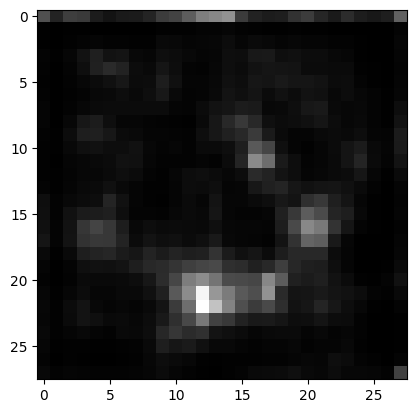

----------------------------------------


Discriminator Loss = 0.08836162090301514
Generator Loss = 3.3880059719085693
A sample image generated by the generator


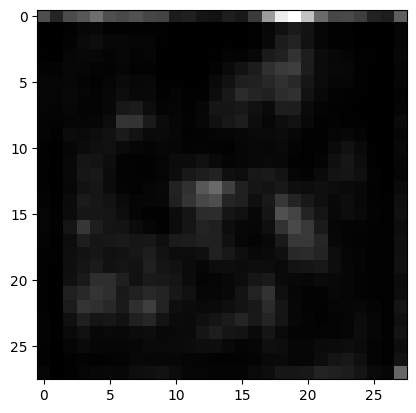

----------------------------------------


Discriminator Loss = 0.08509141206741333
Generator Loss = 3.3867526054382324
A sample image generated by the generator


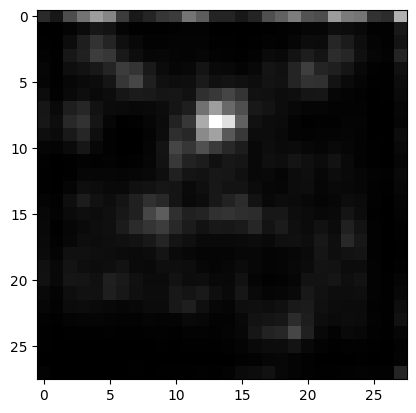

----------------------------------------


Discriminator Loss = 0.08250926434993744
Generator Loss = 3.4593844413757324
A sample image generated by the generator


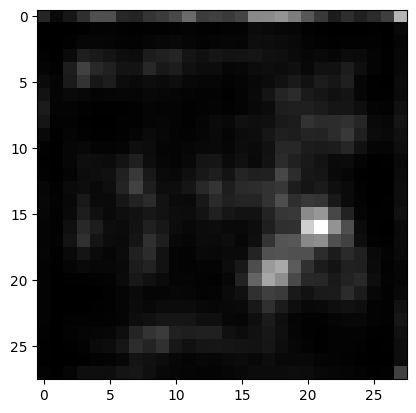

----------------------------------------


Discriminator Loss = 0.0847720056772232
Generator Loss = 3.4969563484191895
A sample image generated by the generator


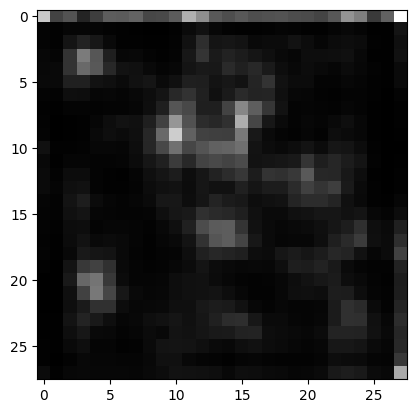

----------------------------------------


Discriminator Loss = 0.07910604029893875
Generator Loss = 3.388801097869873
A sample image generated by the generator


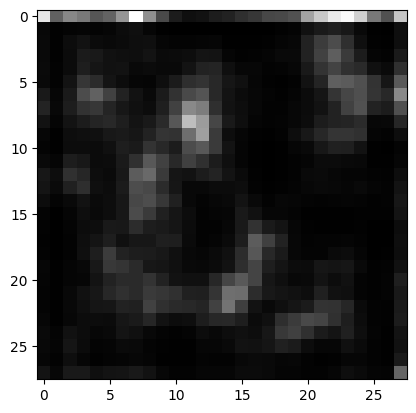

----------------------------------------


Discriminator Loss = 0.08451543748378754
Generator Loss = 3.4251279830932617
A sample image generated by the generator


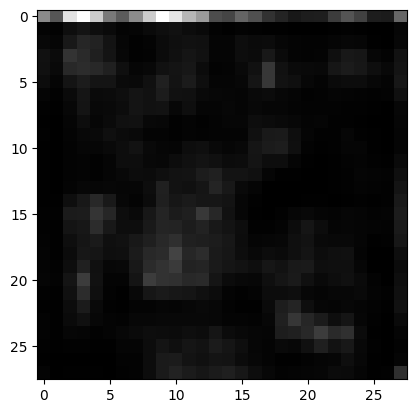

----------------------------------------


Discriminator Loss = 0.0902378261089325
Generator Loss = 3.1626272201538086
A sample image generated by the generator


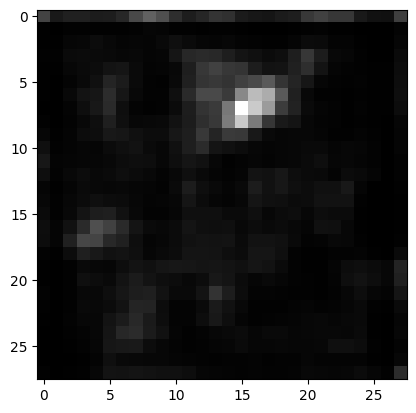

----------------------------------------


Discriminator Loss = 0.08765411376953125
Generator Loss = 3.3479127883911133
A sample image generated by the generator


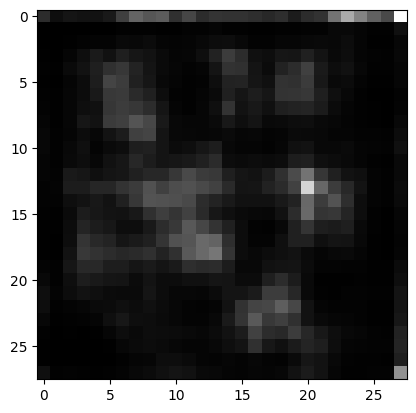

----------------------------------------


Discriminator Loss = 0.0847579687833786
Generator Loss = 3.3869686126708984
A sample image generated by the generator


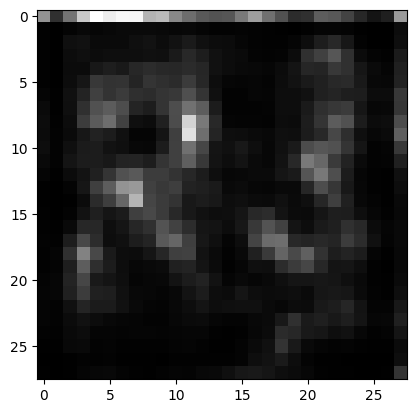

----------------------------------------


Discriminator Loss = 0.08490053564310074
Generator Loss = 3.430253028869629
A sample image generated by the generator


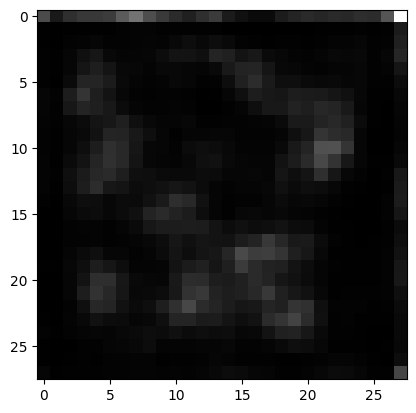

----------------------------------------


Discriminator Loss = 0.08038899302482605
Generator Loss = 3.466815948486328
A sample image generated by the generator


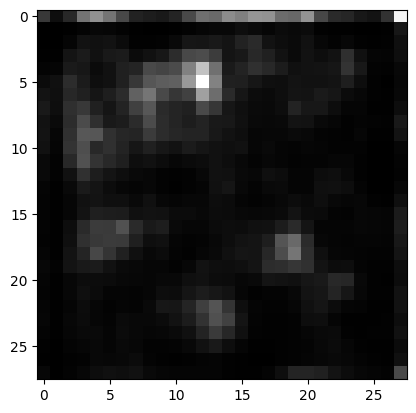

----------------------------------------


Discriminator Loss = 0.08032911270856857
Generator Loss = 3.3394882678985596
A sample image generated by the generator


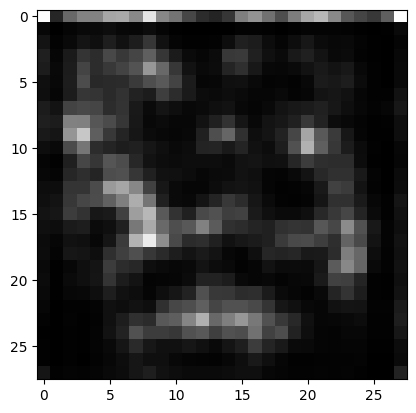

----------------------------------------


Discriminator Loss = 0.08781402558088303
Generator Loss = 3.4155399799346924
A sample image generated by the generator


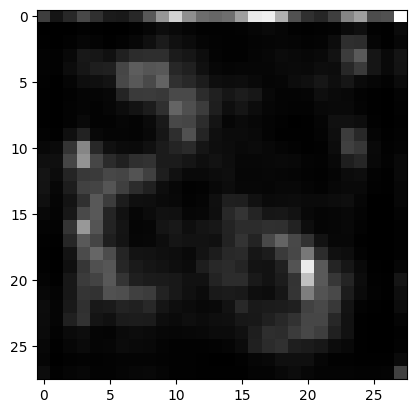

----------------------------------------


Discriminator Loss = 0.09038768708705902
Generator Loss = 3.31703519821167
A sample image generated by the generator


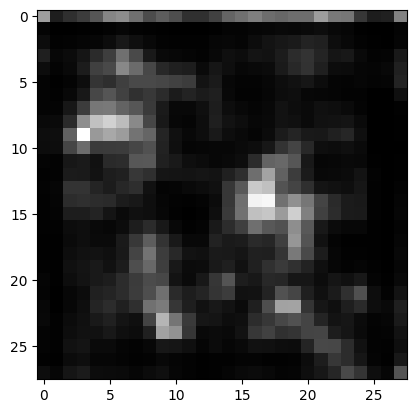

----------------------------------------


Discriminator Loss = 0.08810444176197052
Generator Loss = 3.347609519958496
A sample image generated by the generator


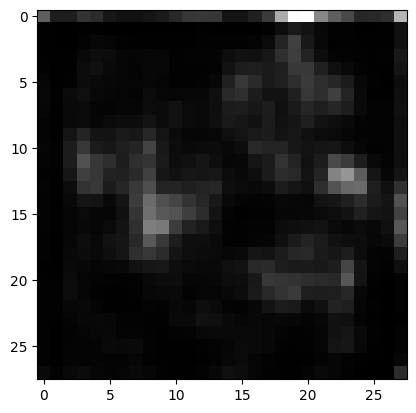

----------------------------------------


Discriminator Loss = 0.08613666146993637
Generator Loss = 3.2697510719299316
A sample image generated by the generator


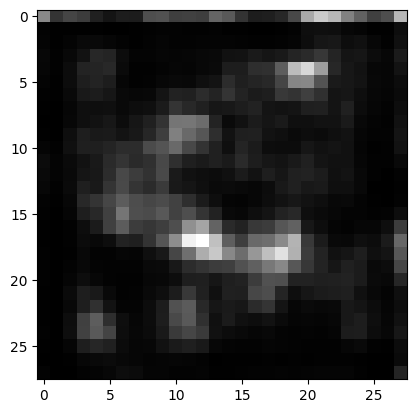

----------------------------------------


Discriminator Loss = 0.08735598623752594
Generator Loss = 3.386662006378174
A sample image generated by the generator


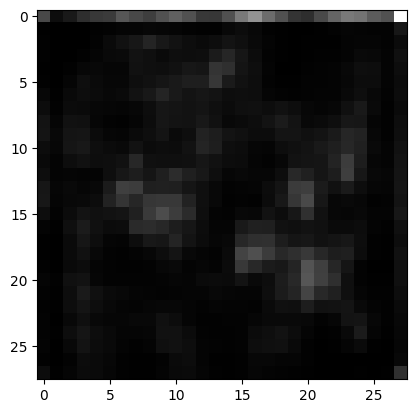

----------------------------------------


Discriminator Loss = 0.09350985288619995
Generator Loss = 3.5171923637390137
A sample image generated by the generator


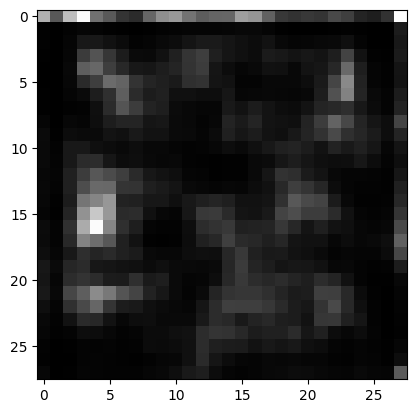

----------------------------------------


Discriminator Loss = 0.07682021707296371
Generator Loss = 3.3377909660339355
A sample image generated by the generator


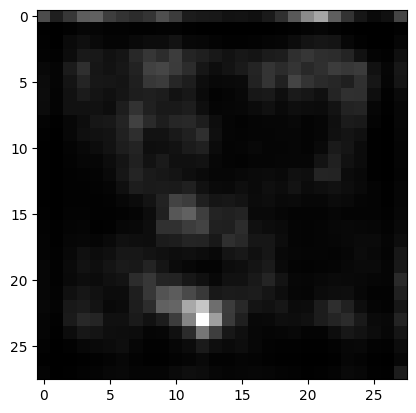

----------------------------------------


Discriminator Loss = 0.0824350118637085
Generator Loss = 3.4347519874572754
A sample image generated by the generator


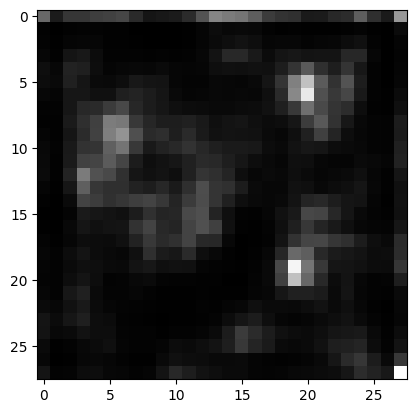

----------------------------------------


Discriminator Loss = 0.08921441435813904
Generator Loss = 3.449700355529785
A sample image generated by the generator


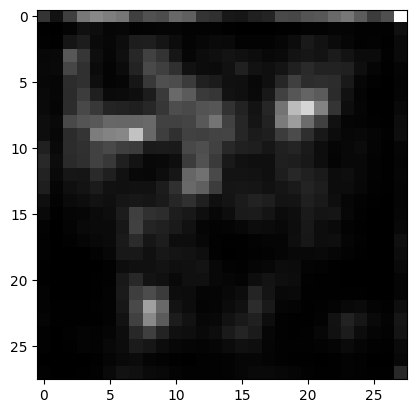

----------------------------------------


Discriminator Loss = 0.07804521918296814
Generator Loss = 3.5457448959350586
A sample image generated by the generator


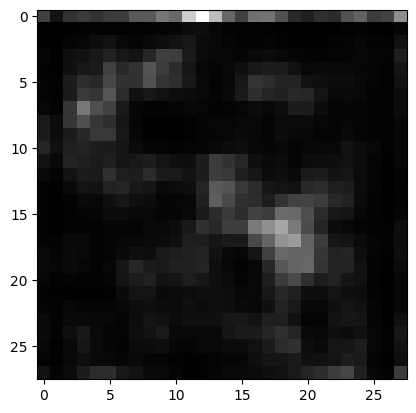

----------------------------------------


Discriminator Loss = 0.08640903234481812
Generator Loss = 3.3139419555664062
A sample image generated by the generator


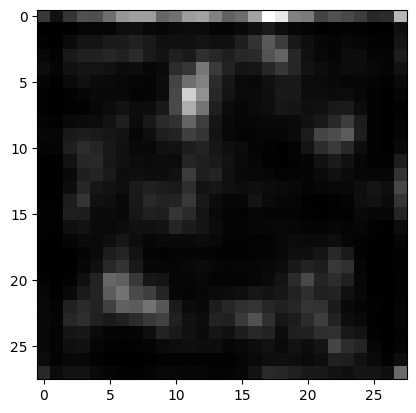

----------------------------------------


Discriminator Loss = 0.08386271446943283
Generator Loss = 3.4625086784362793
A sample image generated by the generator


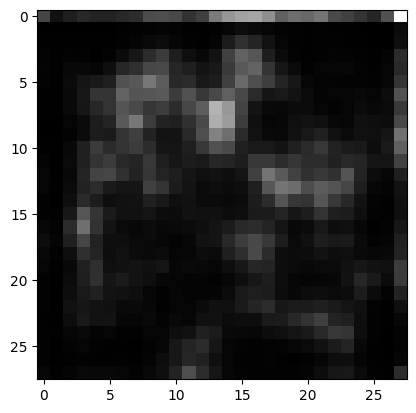

----------------------------------------


Discriminator Loss = 0.08040441572666168
Generator Loss = 3.3467655181884766
A sample image generated by the generator


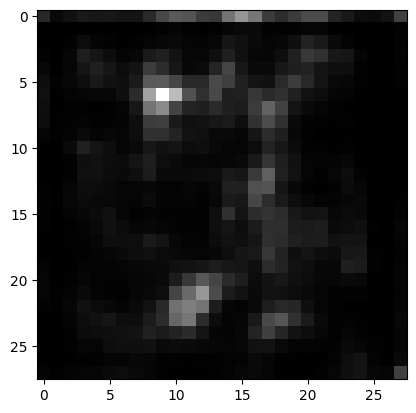

----------------------------------------


Discriminator Loss = 0.08459140360355377
Generator Loss = 3.4091124534606934
A sample image generated by the generator


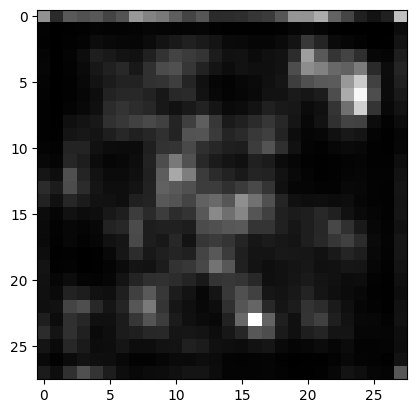

----------------------------------------


Discriminator Loss = 0.0768837034702301
Generator Loss = 3.3630731105804443
A sample image generated by the generator


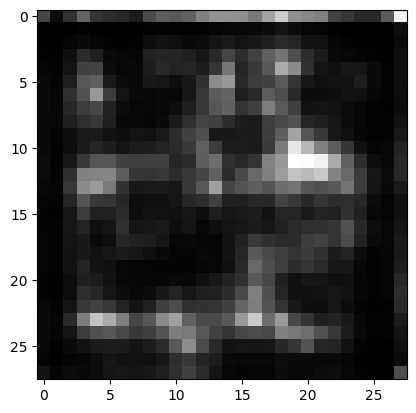

----------------------------------------


Discriminator Loss = 0.08424314856529236
Generator Loss = 3.369844436645508
A sample image generated by the generator


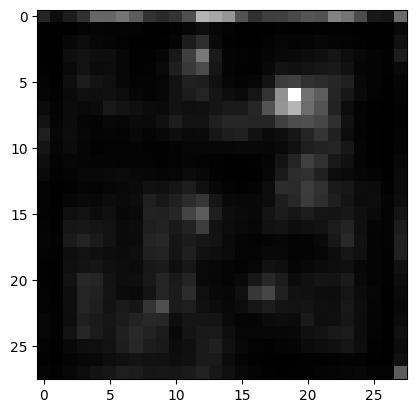

----------------------------------------


Discriminator Loss = 0.08392534404993057
Generator Loss = 3.4993834495544434
A sample image generated by the generator


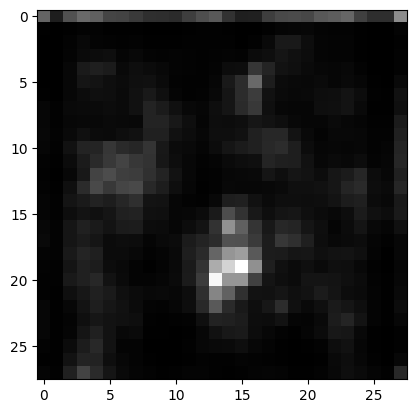

----------------------------------------


Discriminator Loss = 0.08077529072761536
Generator Loss = 3.4671454429626465
A sample image generated by the generator


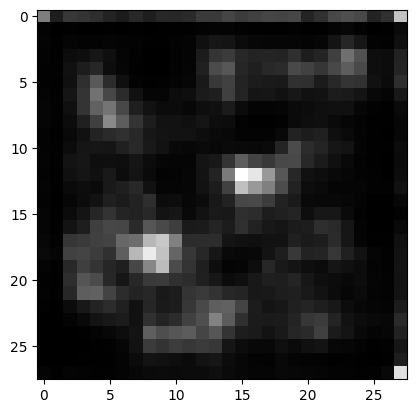

----------------------------------------


Discriminator Loss = 0.08345943689346313
Generator Loss = 3.451570510864258
A sample image generated by the generator


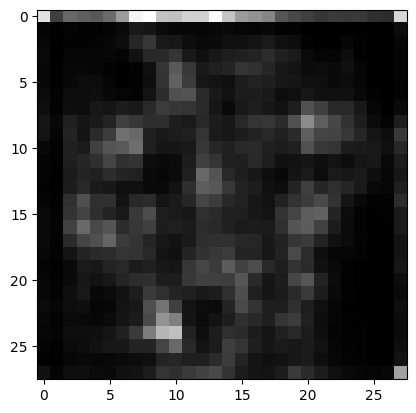

----------------------------------------


Discriminator Loss = 0.09037791192531586
Generator Loss = 3.374016284942627
A sample image generated by the generator


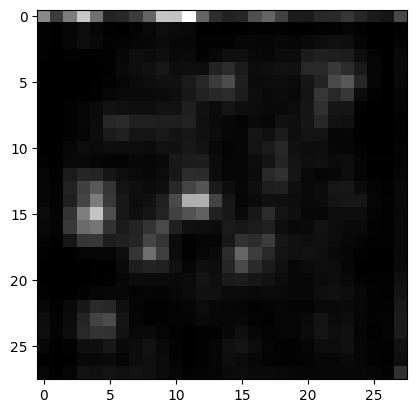

----------------------------------------


Discriminator Loss = 0.08932748436927795
Generator Loss = 3.4816784858703613
A sample image generated by the generator


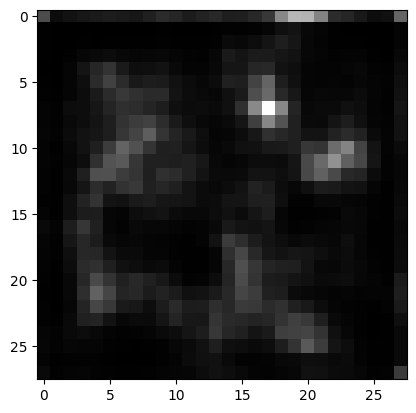

----------------------------------------


Discriminator Loss = 0.08038441091775894
Generator Loss = 3.4832892417907715
A sample image generated by the generator


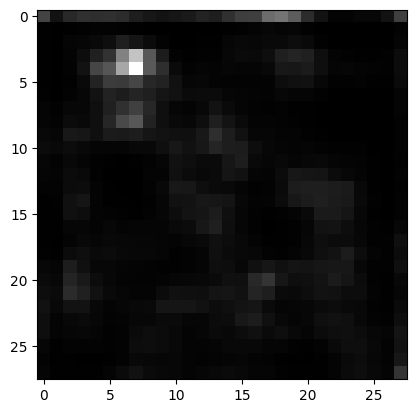

----------------------------------------


Discriminator Loss = 0.08959636837244034
Generator Loss = 3.290255308151245
A sample image generated by the generator


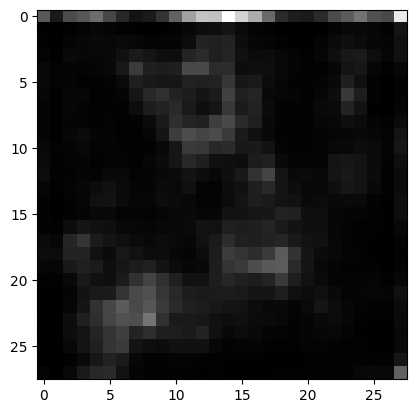

----------------------------------------


Discriminator Loss = 0.08223000168800354
Generator Loss = 3.454948663711548
A sample image generated by the generator


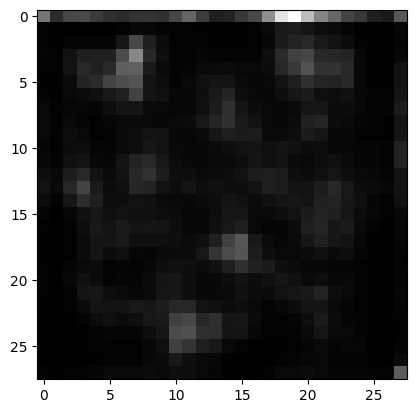

----------------------------------------


Discriminator Loss = 0.08608356863260269
Generator Loss = 3.5461835861206055
A sample image generated by the generator


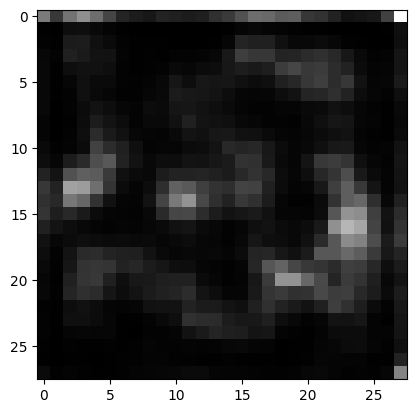

----------------------------------------


Discriminator Loss = 0.08321531116962433
Generator Loss = 3.457335948944092
A sample image generated by the generator


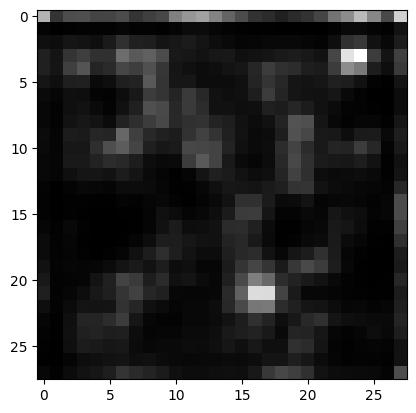

----------------------------------------


Discriminator Loss = 0.09349460899829865
Generator Loss = 3.369811534881592
A sample image generated by the generator


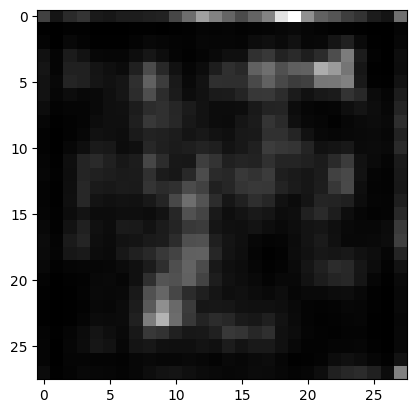

----------------------------------------


Discriminator Loss = 0.08425946533679962
Generator Loss = 3.5289804935455322
A sample image generated by the generator


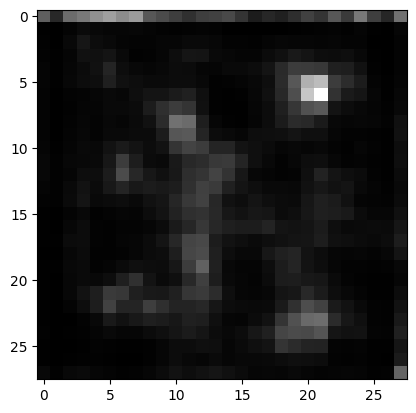

----------------------------------------


Discriminator Loss = 0.0747184306383133
Generator Loss = 3.4717602729797363
A sample image generated by the generator


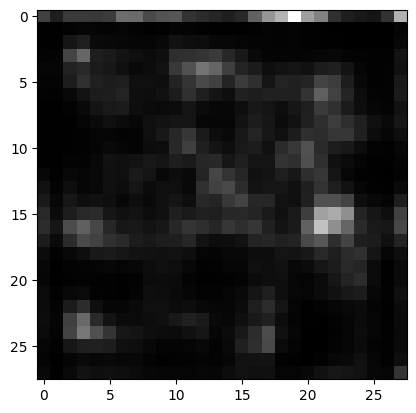

----------------------------------------


Discriminator Loss = 0.0795770213007927
Generator Loss = 3.3094396591186523
A sample image generated by the generator


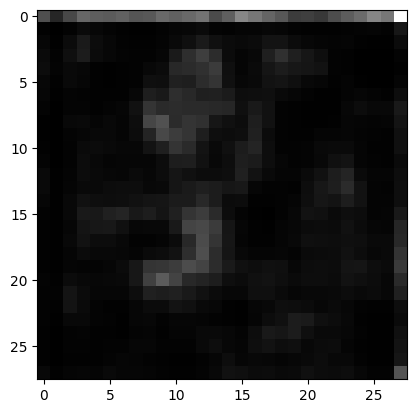

----------------------------------------


Discriminator Loss = 0.09029751271009445
Generator Loss = 3.4446167945861816
A sample image generated by the generator


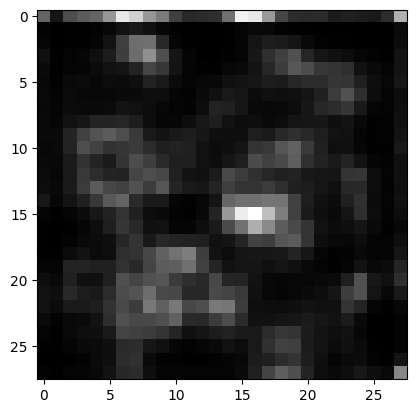

----------------------------------------


Discriminator Loss = 0.0831964835524559
Generator Loss = 3.436481475830078
A sample image generated by the generator


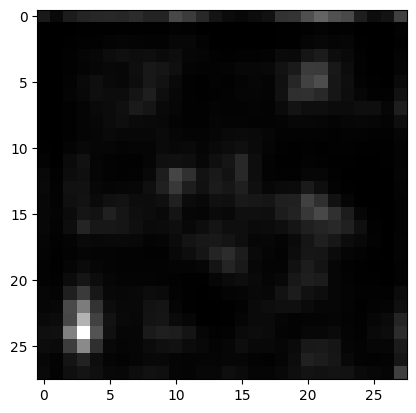

----------------------------------------


Discriminator Loss = 0.09037356078624725
Generator Loss = 3.3819503784179688
A sample image generated by the generator


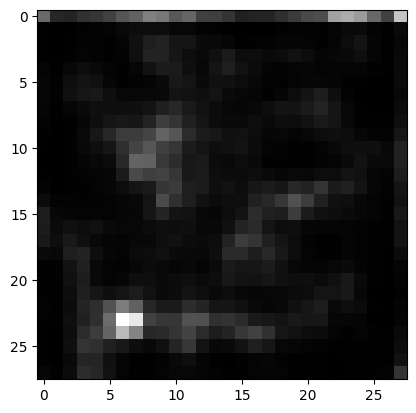

----------------------------------------


Discriminator Loss = 0.08691181242465973
Generator Loss = 3.3434221744537354
A sample image generated by the generator


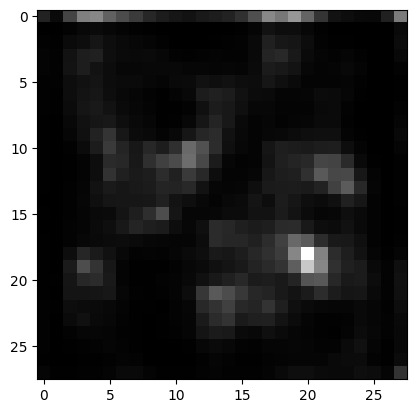

----------------------------------------


Discriminator Loss = 0.07773410528898239
Generator Loss = 3.2522079944610596
A sample image generated by the generator


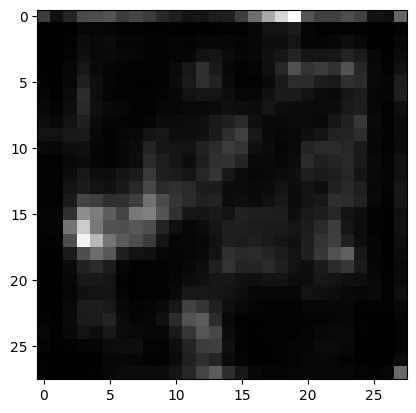

----------------------------------------


Discriminator Loss = 0.08162909746170044
Generator Loss = 3.4847464561462402
A sample image generated by the generator


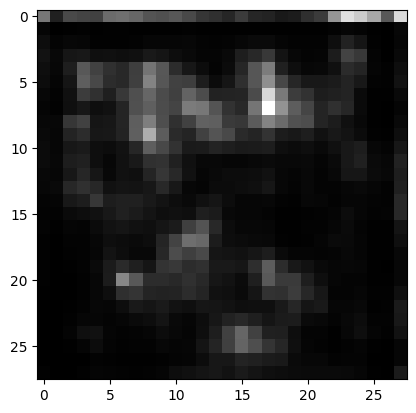

----------------------------------------


Discriminator Loss = 0.08226660639047623
Generator Loss = 3.4335625171661377
A sample image generated by the generator


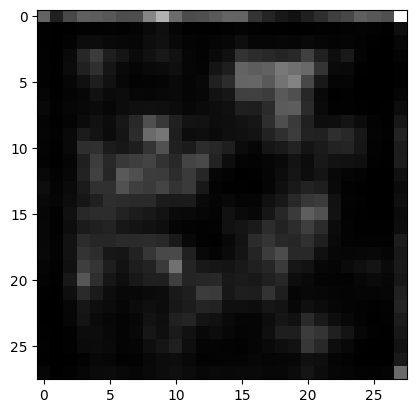

----------------------------------------


Discriminator Loss = 0.07730264216661453
Generator Loss = 3.498075485229492
A sample image generated by the generator


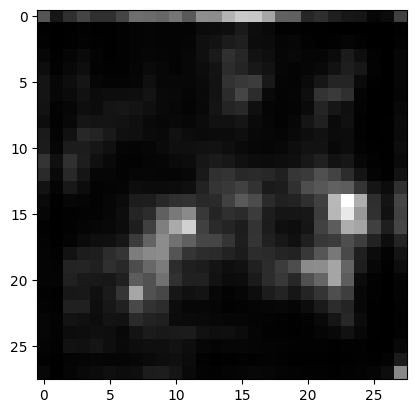

----------------------------------------


Discriminator Loss = 0.08650713413953781
Generator Loss = 3.5173068046569824
A sample image generated by the generator


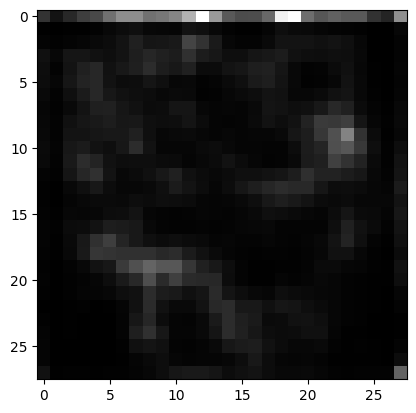

----------------------------------------


Discriminator Loss = 0.09001568704843521
Generator Loss = 3.4062905311584473
A sample image generated by the generator


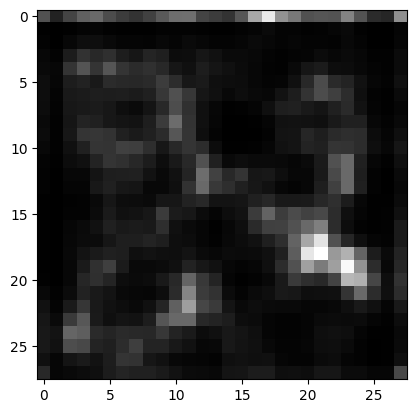

----------------------------------------


Discriminator Loss = 0.0872030258178711
Generator Loss = 3.4376256465911865
A sample image generated by the generator


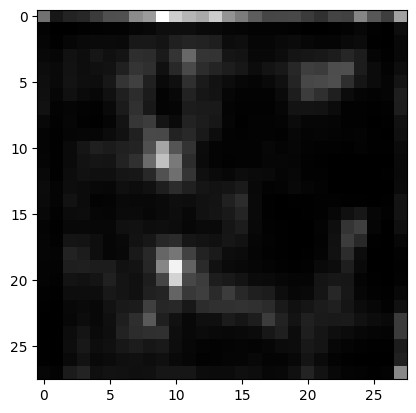

----------------------------------------


Discriminator Loss = 0.08547830581665039
Generator Loss = 3.4520010948181152
A sample image generated by the generator


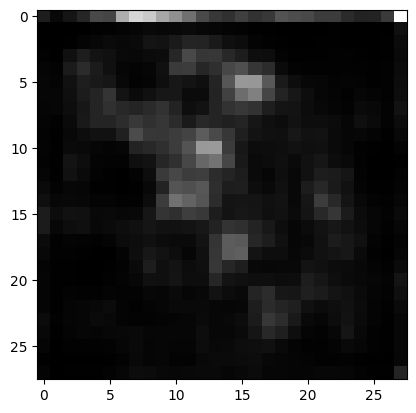

----------------------------------------


Discriminator Loss = 0.08310065418481827
Generator Loss = 3.430940628051758
A sample image generated by the generator


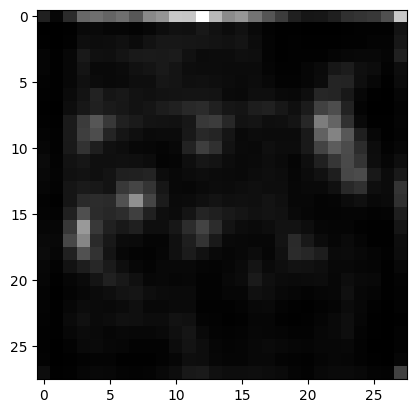

----------------------------------------


Discriminator Loss = 0.08224067091941833
Generator Loss = 3.5785610675811768
A sample image generated by the generator


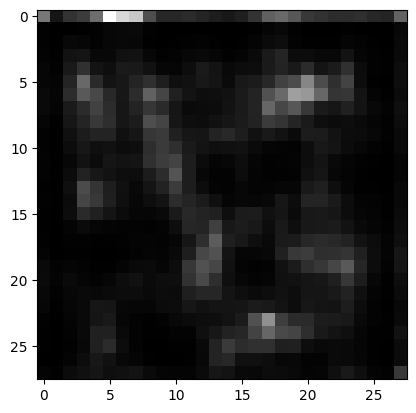

----------------------------------------


Discriminator Loss = 0.08446235209703445
Generator Loss = 3.366119384765625
A sample image generated by the generator


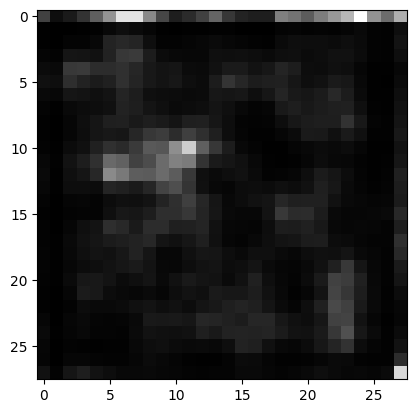

----------------------------------------


Discriminator Loss = 0.08205761015415192
Generator Loss = 3.602752685546875
A sample image generated by the generator


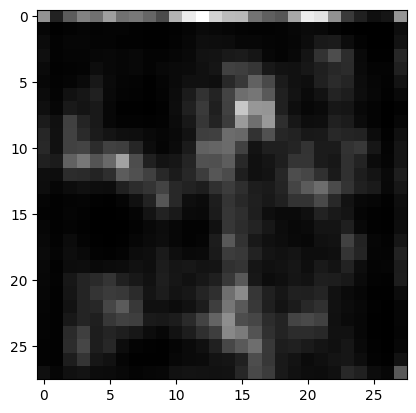

----------------------------------------


Discriminator Loss = 0.08121316879987717
Generator Loss = 3.392332077026367
A sample image generated by the generator


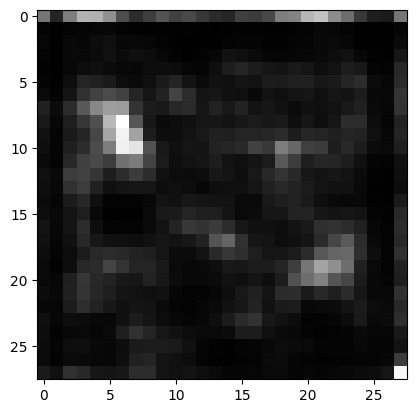

----------------------------------------


Discriminator Loss = 0.08636610209941864
Generator Loss = 3.3249239921569824
A sample image generated by the generator


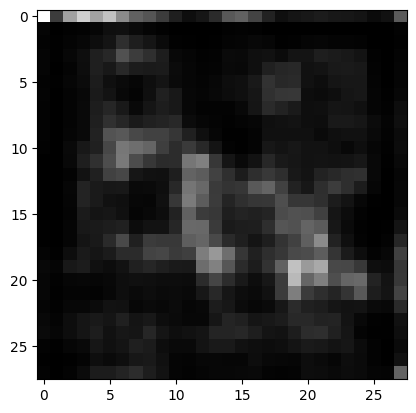

----------------------------------------


Discriminator Loss = 0.08617374300956726
Generator Loss = 3.3069822788238525
A sample image generated by the generator


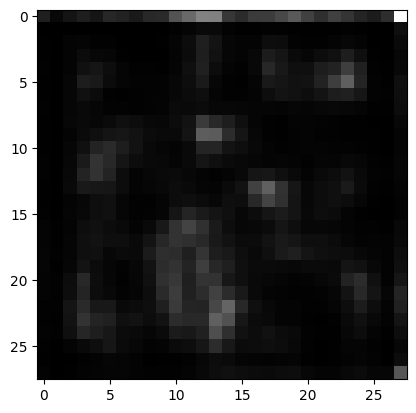

----------------------------------------


Discriminator Loss = 0.07876706123352051
Generator Loss = 3.2891387939453125
A sample image generated by the generator


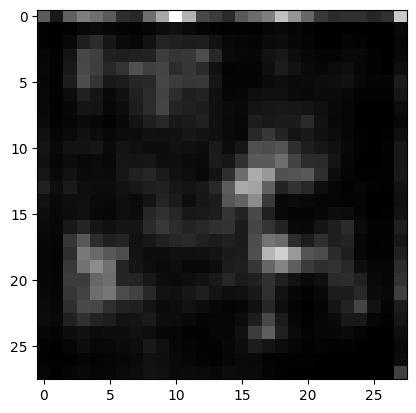

----------------------------------------


Discriminator Loss = 0.07632370293140411
Generator Loss = 3.3822903633117676
A sample image generated by the generator


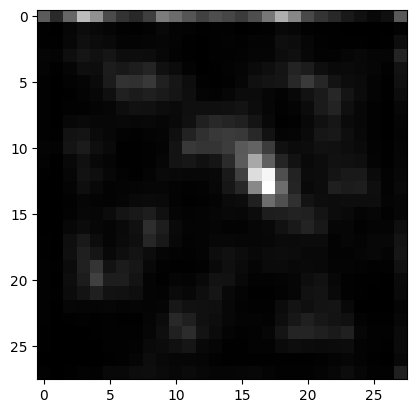

----------------------------------------


Discriminator Loss = 0.07654381543397903
Generator Loss = 3.2663168907165527
A sample image generated by the generator


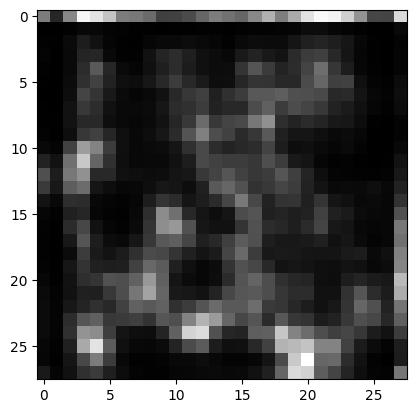

----------------------------------------


Discriminator Loss = 0.08444258570671082
Generator Loss = 3.294999122619629
A sample image generated by the generator


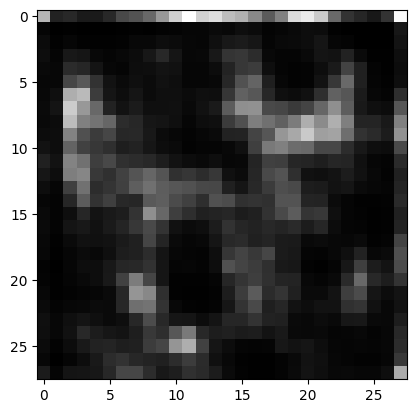

----------------------------------------


Discriminator Loss = 0.07878630608320236
Generator Loss = 3.458416700363159
A sample image generated by the generator


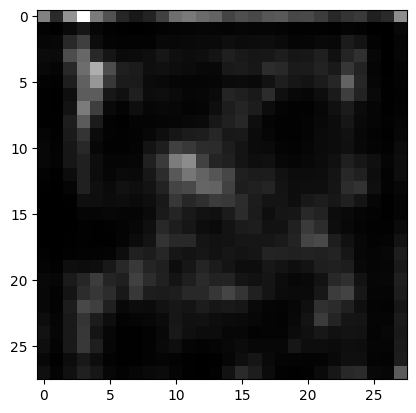

----------------------------------------


Discriminator Loss = 0.07884877920150757
Generator Loss = 3.4373676776885986
A sample image generated by the generator


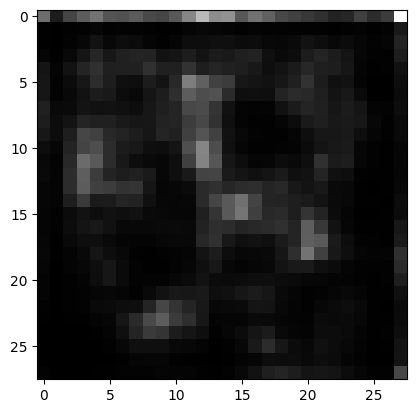

----------------------------------------


Discriminator Loss = 0.08200657367706299
Generator Loss = 3.473546028137207
A sample image generated by the generator


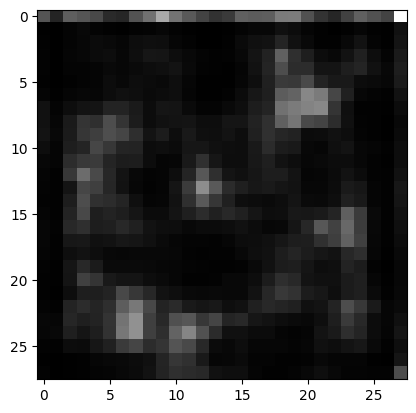

----------------------------------------


Discriminator Loss = 0.0766296237707138
Generator Loss = 3.3699545860290527
A sample image generated by the generator


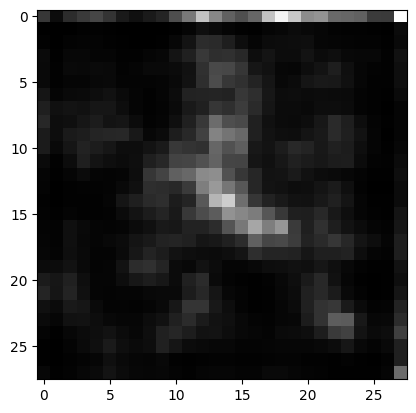

----------------------------------------


Discriminator Loss = 0.0778782069683075
Generator Loss = 3.4006638526916504
A sample image generated by the generator


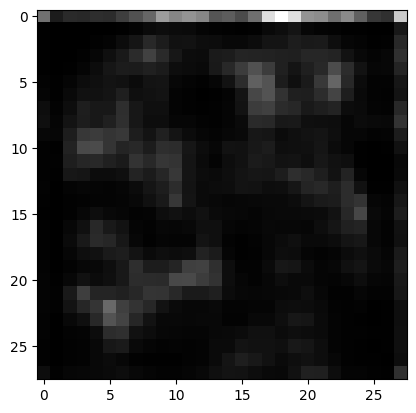

----------------------------------------


Discriminator Loss = 0.07318004965782166
Generator Loss = 3.4950079917907715
A sample image generated by the generator


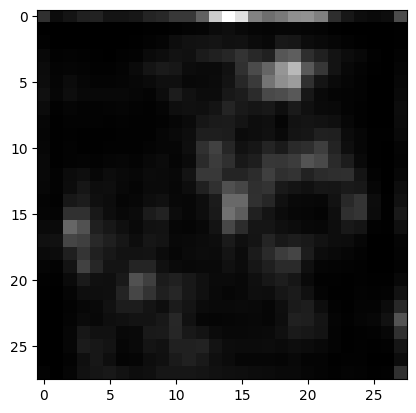

----------------------------------------


Discriminator Loss = 0.0805574581027031
Generator Loss = 3.458867073059082
A sample image generated by the generator


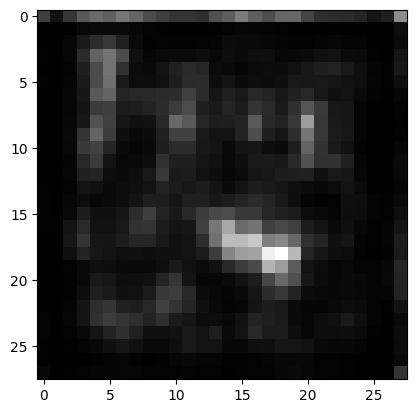

----------------------------------------


Discriminator Loss = 0.08482347428798676
Generator Loss = 3.4186887741088867
A sample image generated by the generator


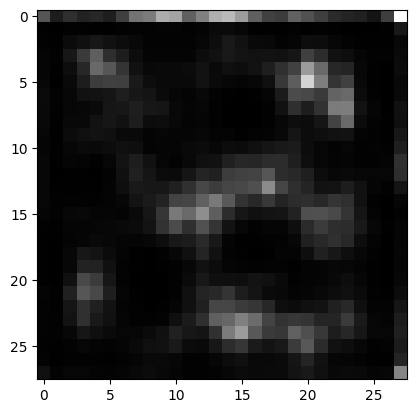

----------------------------------------


Discriminator Loss = 0.08095978200435638
Generator Loss = 3.3774867057800293
A sample image generated by the generator


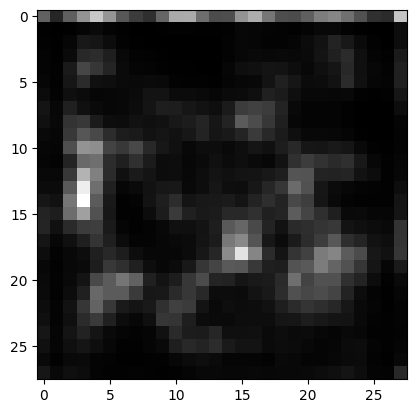

----------------------------------------


Discriminator Loss = 0.07261434197425842
Generator Loss = 3.466597080230713
A sample image generated by the generator


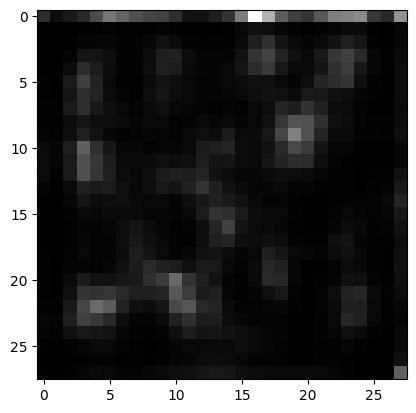

----------------------------------------


Discriminator Loss = 0.0805729478597641
Generator Loss = 3.5203404426574707
A sample image generated by the generator


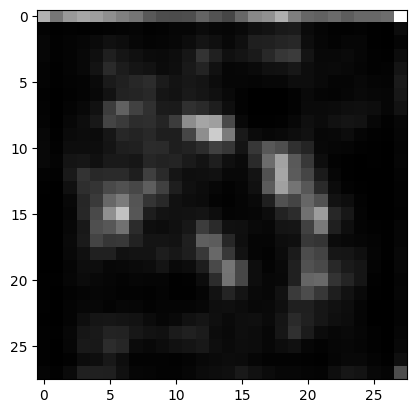

----------------------------------------


Discriminator Loss = 0.08088074624538422
Generator Loss = 3.4350976943969727
A sample image generated by the generator


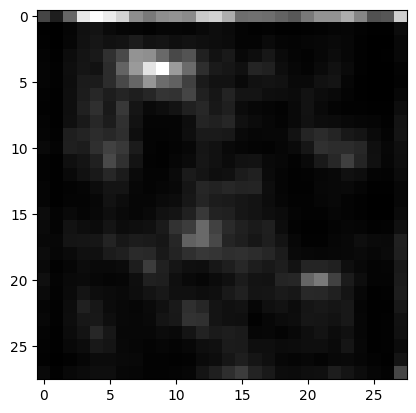

----------------------------------------


Discriminator Loss = 0.07895034551620483
Generator Loss = 3.4204416275024414
A sample image generated by the generator


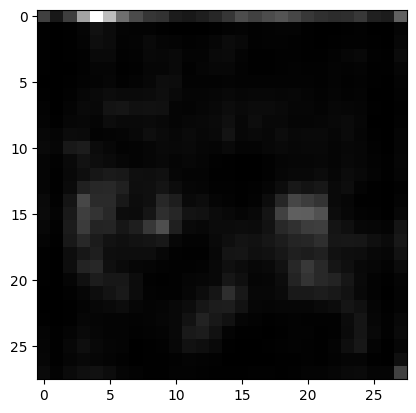

----------------------------------------


Discriminator Loss = 0.07728324085474014
Generator Loss = 3.431518077850342
A sample image generated by the generator


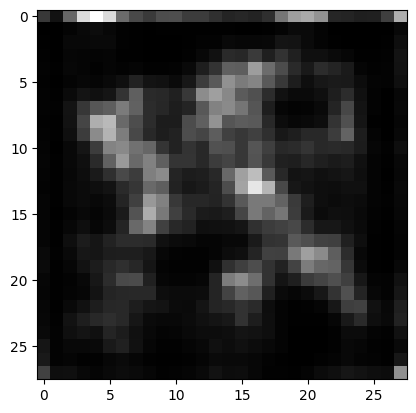

----------------------------------------


Discriminator Loss = 0.07968570291996002
Generator Loss = 3.463615894317627
A sample image generated by the generator


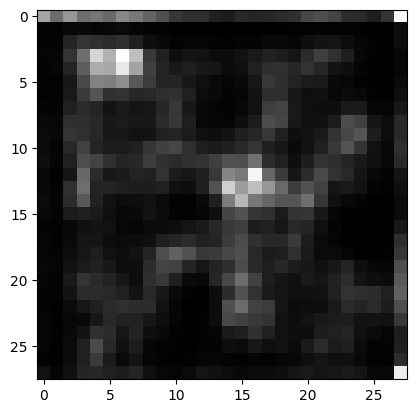

----------------------------------------


Discriminator Loss = 0.08344611525535583
Generator Loss = 3.4488394260406494
A sample image generated by the generator


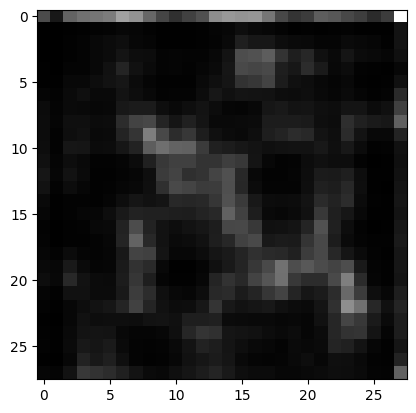

----------------------------------------


Discriminator Loss = 0.07533206790685654
Generator Loss = 3.5331127643585205
A sample image generated by the generator


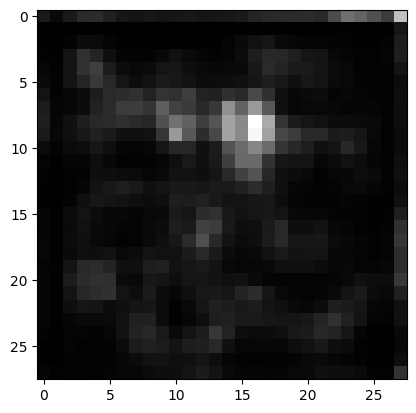

----------------------------------------


Discriminator Loss = 0.08556351065635681
Generator Loss = 3.382770299911499
A sample image generated by the generator


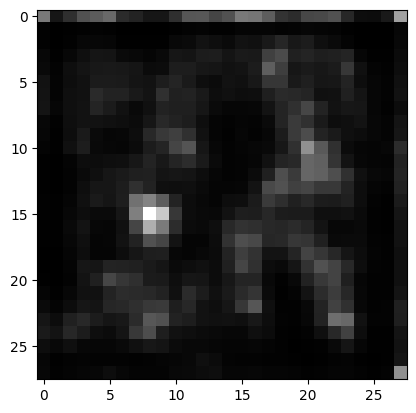

----------------------------------------


Discriminator Loss = 0.08131949603557587
Generator Loss = 3.460984230041504
A sample image generated by the generator


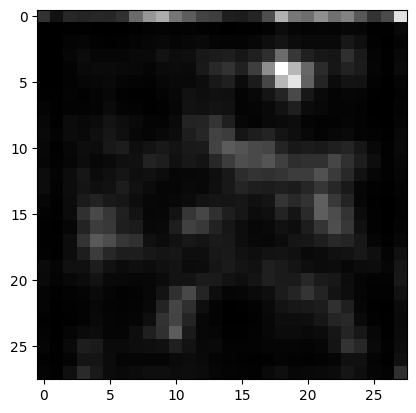

----------------------------------------


Discriminator Loss = 0.07885311543941498
Generator Loss = 3.533362865447998
A sample image generated by the generator


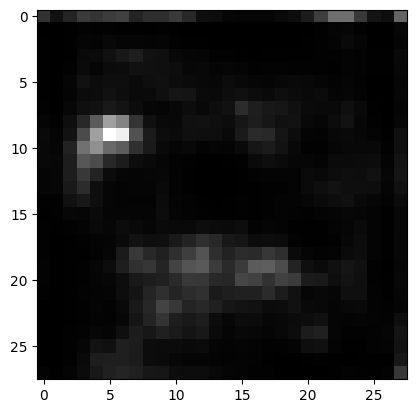

----------------------------------------


Discriminator Loss = 0.07813121378421783
Generator Loss = 3.5071229934692383
A sample image generated by the generator


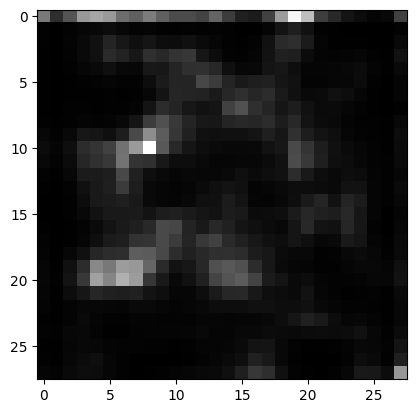

----------------------------------------


Discriminator Loss = 0.0786273330450058
Generator Loss = 3.4294676780700684
A sample image generated by the generator


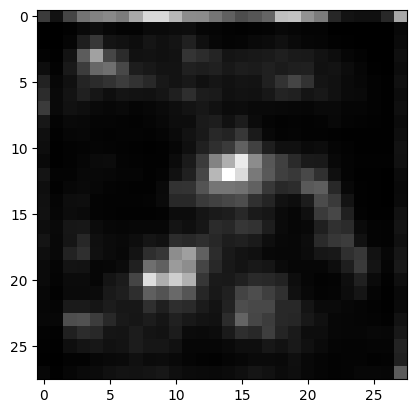

----------------------------------------


Discriminator Loss = 0.07709512114524841
Generator Loss = 3.542529821395874
A sample image generated by the generator


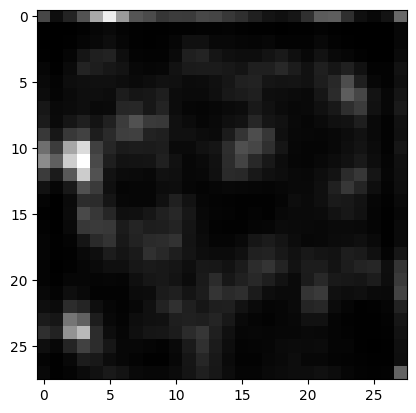

----------------------------------------


Discriminator Loss = 0.08615323901176453
Generator Loss = 3.50693941116333
A sample image generated by the generator


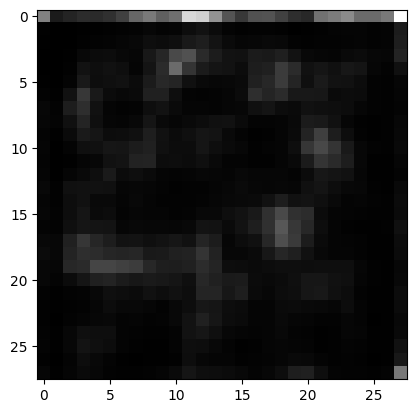

----------------------------------------


Discriminator Loss = 0.07531596720218658
Generator Loss = 3.6110026836395264
A sample image generated by the generator


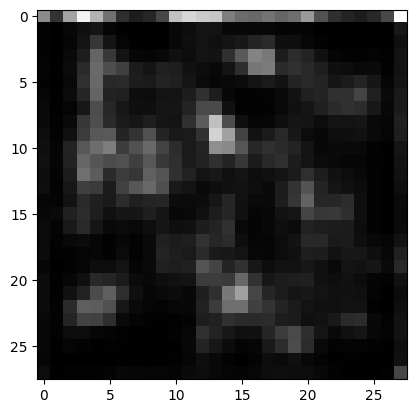

----------------------------------------


Discriminator Loss = 0.07721765339374542
Generator Loss = 3.4437718391418457
A sample image generated by the generator


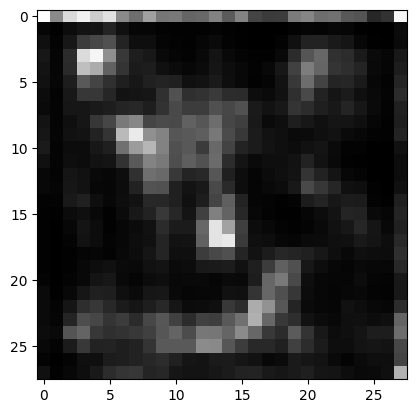

----------------------------------------


Discriminator Loss = 0.07336512207984924
Generator Loss = 3.4320266246795654
A sample image generated by the generator


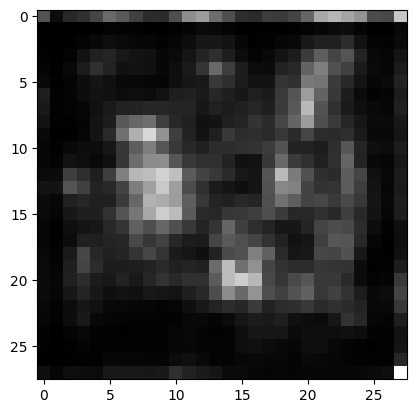

----------------------------------------


Discriminator Loss = 0.07807190716266632
Generator Loss = 3.41436505317688
A sample image generated by the generator


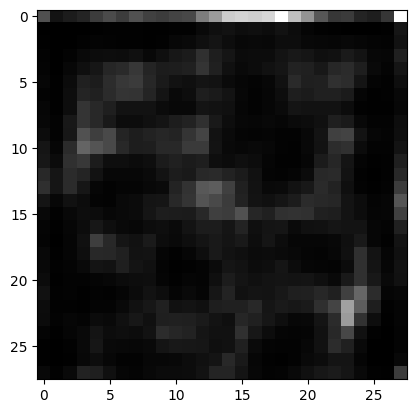

----------------------------------------


Discriminator Loss = 0.06891986727714539
Generator Loss = 3.5078489780426025
A sample image generated by the generator


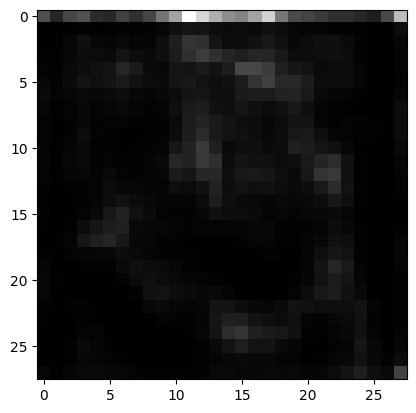

----------------------------------------


Discriminator Loss = 0.07896207273006439
Generator Loss = 3.4132080078125
A sample image generated by the generator


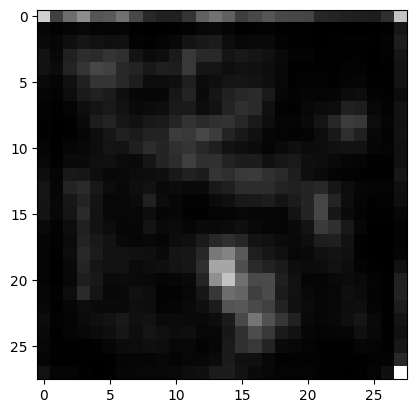

----------------------------------------


Discriminator Loss = 0.08027246594429016
Generator Loss = 3.3635549545288086
A sample image generated by the generator


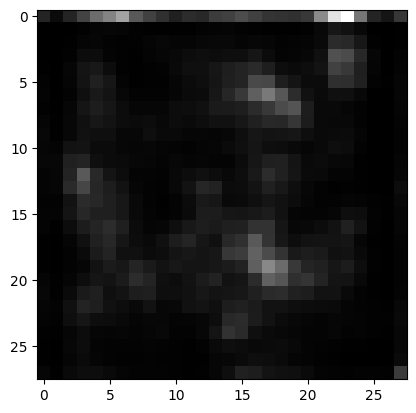

----------------------------------------


Discriminator Loss = 0.08672364056110382
Generator Loss = 3.4763002395629883
A sample image generated by the generator


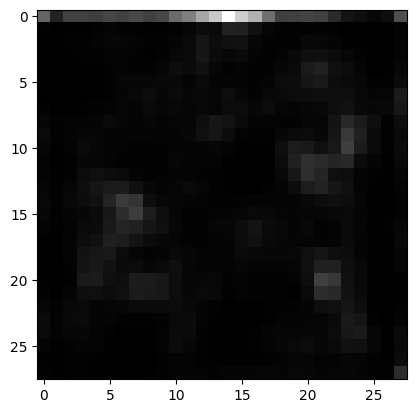

----------------------------------------


Discriminator Loss = 0.07618850469589233
Generator Loss = 3.340714931488037
A sample image generated by the generator


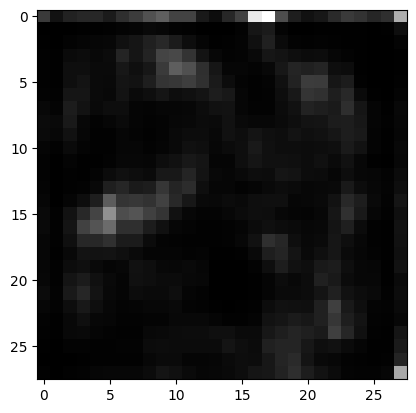

----------------------------------------


Discriminator Loss = 0.07602345943450928
Generator Loss = 3.4973464012145996
A sample image generated by the generator


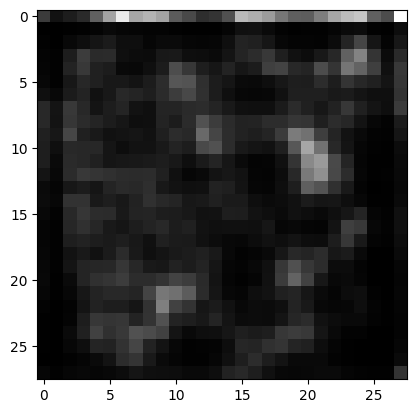

----------------------------------------


Discriminator Loss = 0.0816933736205101
Generator Loss = 3.4483556747436523
A sample image generated by the generator


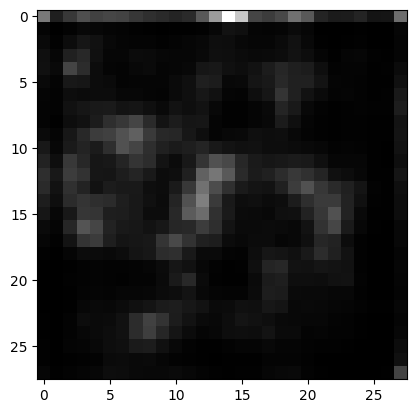

----------------------------------------


Discriminator Loss = 0.07314568758010864
Generator Loss = 3.5135903358459473
A sample image generated by the generator


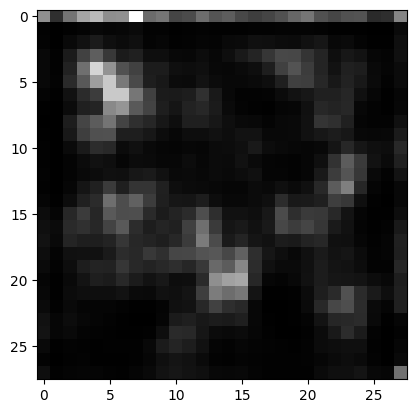

----------------------------------------


Discriminator Loss = 0.08088897168636322
Generator Loss = 3.485443592071533
A sample image generated by the generator


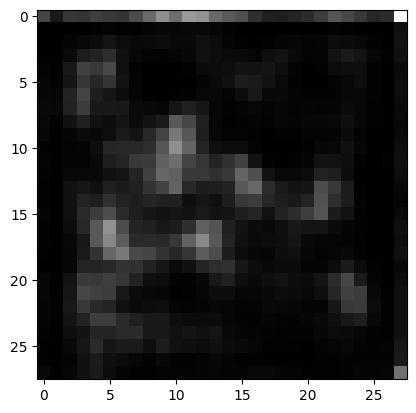

----------------------------------------


Discriminator Loss = 0.07439608126878738
Generator Loss = 3.3963942527770996
A sample image generated by the generator


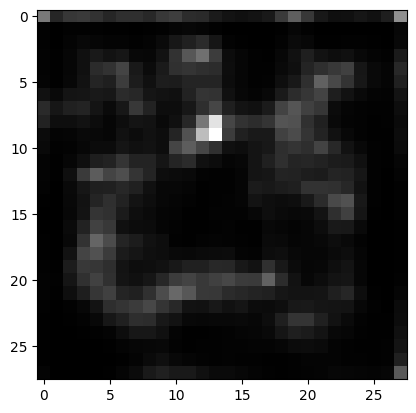

----------------------------------------


Discriminator Loss = 0.07412391901016235
Generator Loss = 3.5398011207580566
A sample image generated by the generator


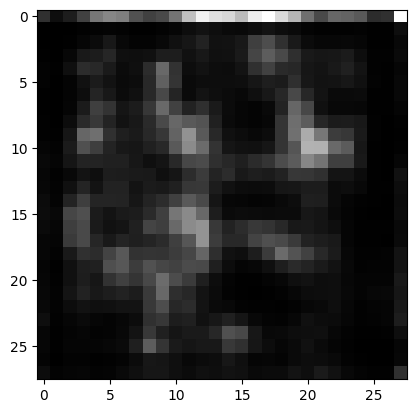

----------------------------------------


Discriminator Loss = 0.07470366358757019
Generator Loss = 3.6156575679779053
A sample image generated by the generator


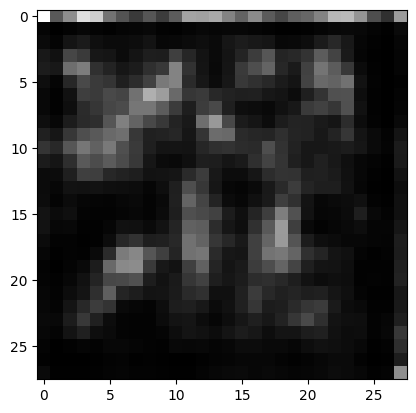

----------------------------------------


Discriminator Loss = 0.0671432763338089
Generator Loss = 3.442340850830078
A sample image generated by the generator


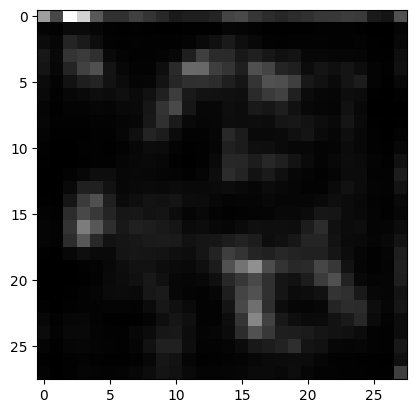

----------------------------------------


Discriminator Loss = 0.08150877058506012
Generator Loss = 3.532848596572876
A sample image generated by the generator


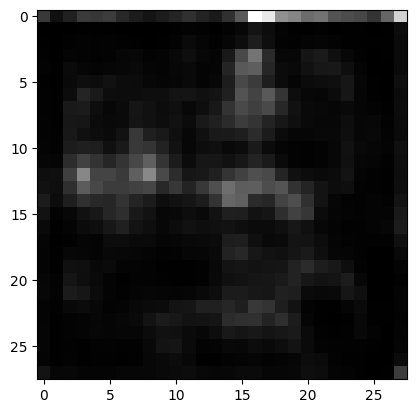

----------------------------------------


Discriminator Loss = 0.08309168368577957
Generator Loss = 3.385219097137451
A sample image generated by the generator


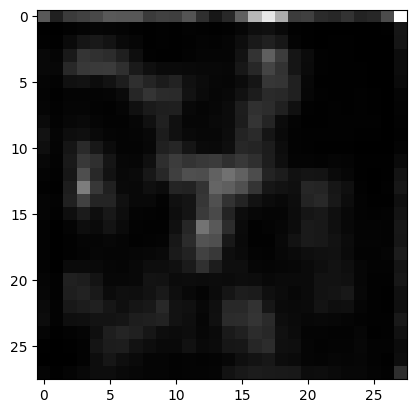

----------------------------------------


Discriminator Loss = 0.07176175713539124
Generator Loss = 3.438450336456299
A sample image generated by the generator


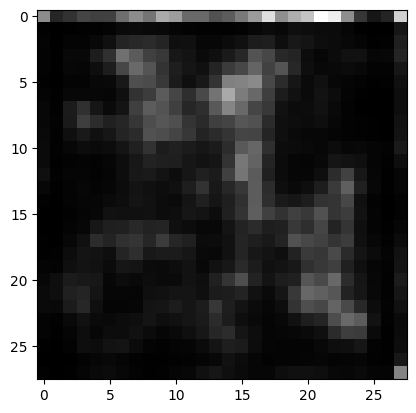

----------------------------------------


Discriminator Loss = 0.08200853317975998
Generator Loss = 3.409727096557617
A sample image generated by the generator


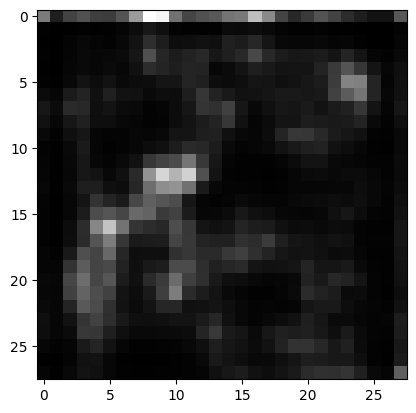

----------------------------------------


Discriminator Loss = 0.07157661020755768
Generator Loss = 3.546529769897461
A sample image generated by the generator


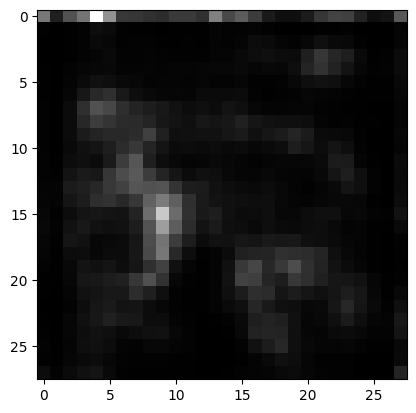

----------------------------------------


Discriminator Loss = 0.07816188037395477
Generator Loss = 3.48415470123291
A sample image generated by the generator


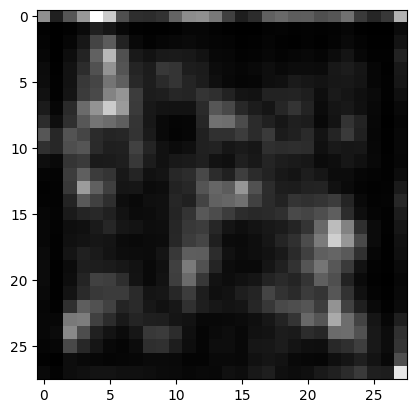

----------------------------------------


Discriminator Loss = 0.07460754364728928
Generator Loss = 3.499540090560913
A sample image generated by the generator


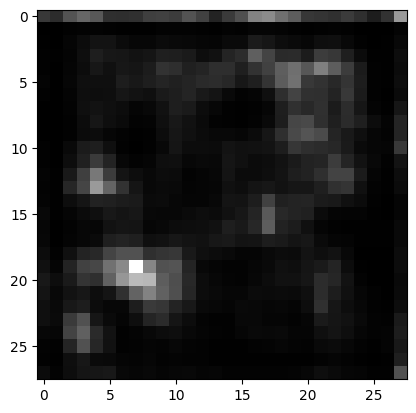

----------------------------------------


Discriminator Loss = 0.0721571296453476
Generator Loss = 3.446197032928467
A sample image generated by the generator


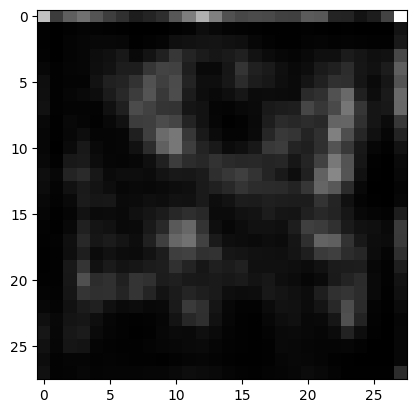

----------------------------------------


Discriminator Loss = 0.07626568526029587
Generator Loss = 3.408550262451172
A sample image generated by the generator


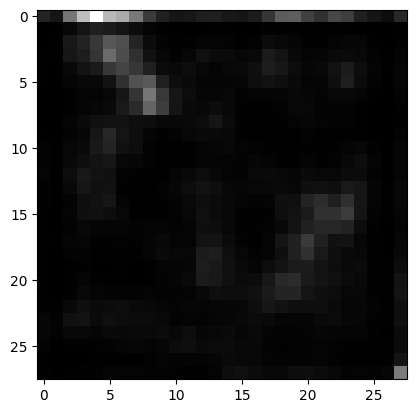

----------------------------------------


Discriminator Loss = 0.08170344680547714
Generator Loss = 3.4149937629699707
A sample image generated by the generator


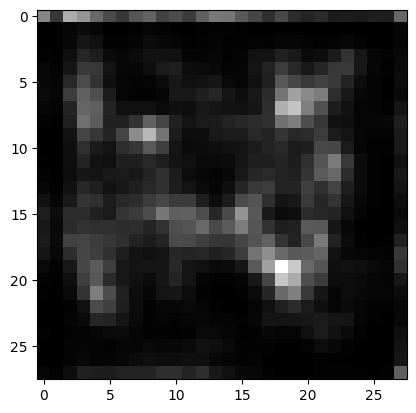

----------------------------------------


Discriminator Loss = 0.07890086621046066
Generator Loss = 3.428518772125244
A sample image generated by the generator


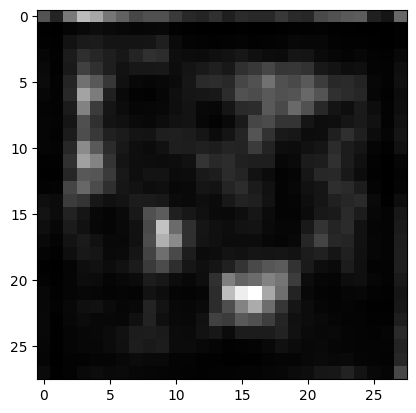

----------------------------------------


Discriminator Loss = 0.08105681091547012
Generator Loss = 3.4973201751708984
A sample image generated by the generator


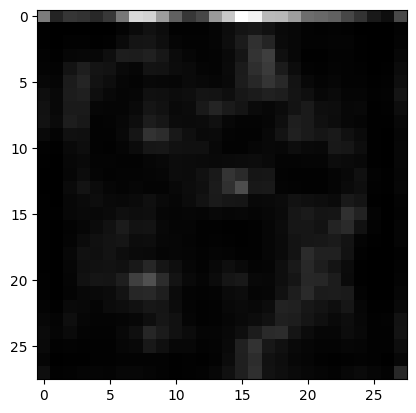

----------------------------------------


Discriminator Loss = 0.0776066780090332
Generator Loss = 3.4914588928222656
A sample image generated by the generator


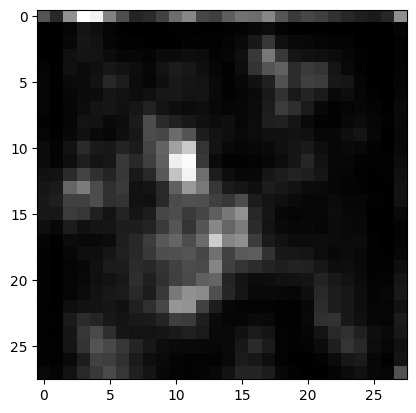

----------------------------------------


Discriminator Loss = 0.07977629452943802
Generator Loss = 3.4829535484313965
A sample image generated by the generator


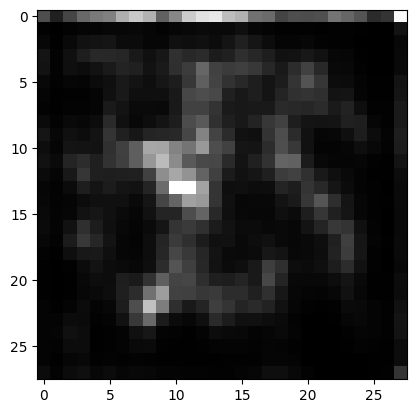

----------------------------------------


Discriminator Loss = 0.08591052889823914
Generator Loss = 3.4780116081237793
A sample image generated by the generator


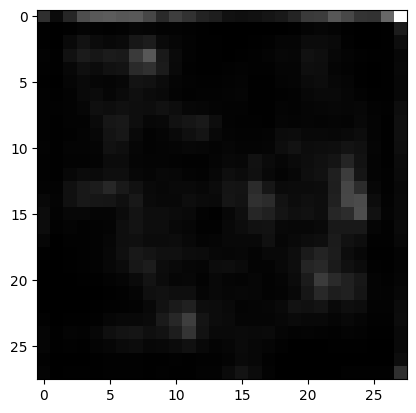

----------------------------------------


Discriminator Loss = 0.06405581533908844
Generator Loss = 3.470757007598877
A sample image generated by the generator


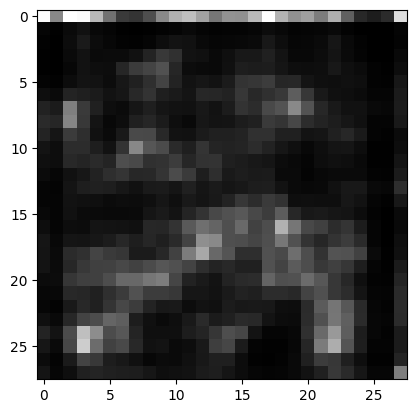

----------------------------------------


Discriminator Loss = 0.07485248148441315
Generator Loss = 3.456254005432129
A sample image generated by the generator


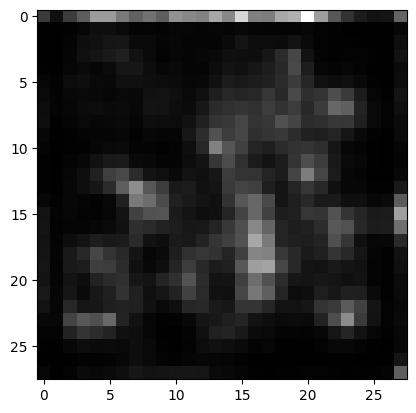

----------------------------------------


Discriminator Loss = 0.07073931396007538
Generator Loss = 3.4419946670532227
A sample image generated by the generator


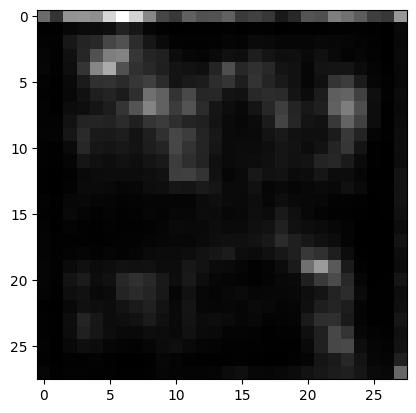

----------------------------------------


Discriminator Loss = 0.07738202810287476
Generator Loss = 3.4809746742248535
A sample image generated by the generator


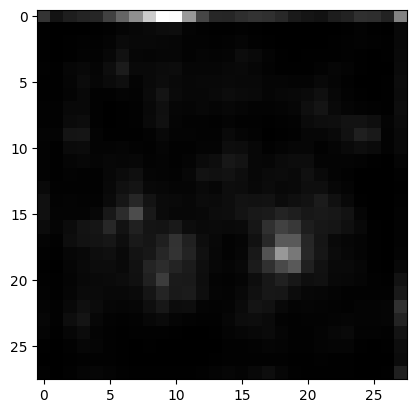

----------------------------------------


Discriminator Loss = 0.06844530999660492
Generator Loss = 3.598329782485962
A sample image generated by the generator


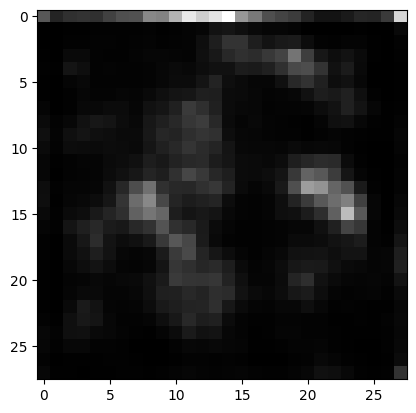

----------------------------------------


Discriminator Loss = 0.07733242213726044
Generator Loss = 3.508831024169922
A sample image generated by the generator


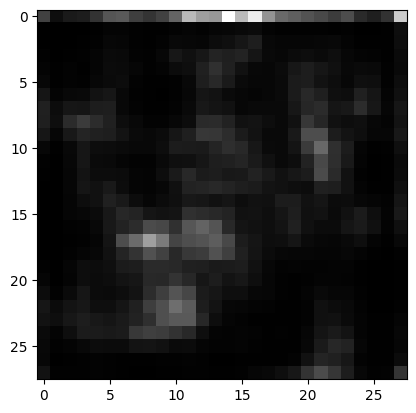

----------------------------------------


Discriminator Loss = 0.07466087490320206
Generator Loss = 3.5256528854370117
A sample image generated by the generator


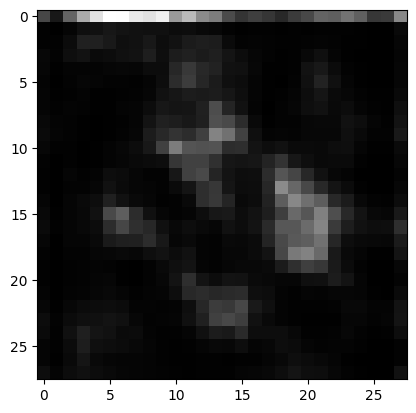

----------------------------------------


Discriminator Loss = 0.07666011899709702
Generator Loss = 3.5176000595092773
A sample image generated by the generator


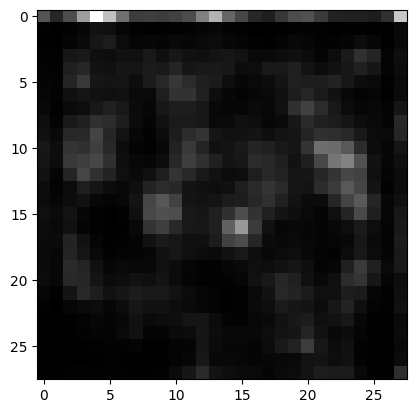

----------------------------------------


Discriminator Loss = 0.07227447628974915
Generator Loss = 3.563605546951294
A sample image generated by the generator


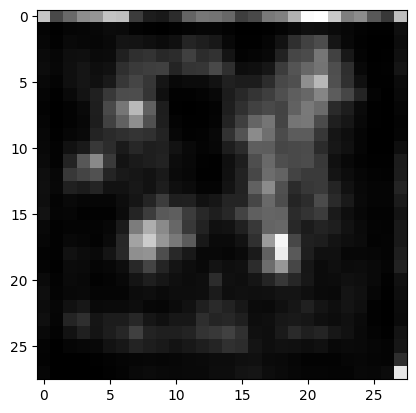

----------------------------------------


Discriminator Loss = 0.0746038630604744
Generator Loss = 3.6990957260131836
A sample image generated by the generator


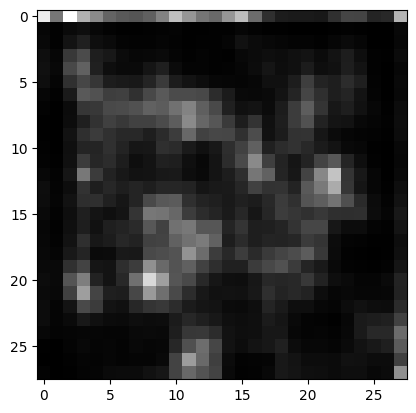

----------------------------------------


Discriminator Loss = 0.06637083739042282
Generator Loss = 3.4157299995422363
A sample image generated by the generator


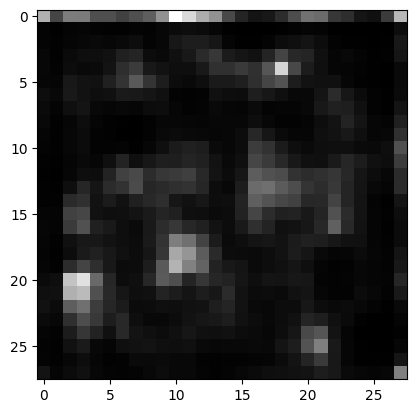

----------------------------------------


Discriminator Loss = 0.069209024310112
Generator Loss = 3.469132423400879
A sample image generated by the generator


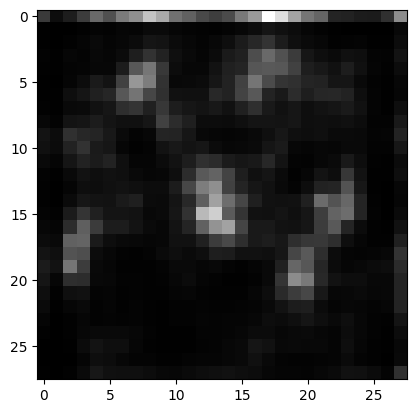

----------------------------------------


Discriminator Loss = 0.083381287753582
Generator Loss = 3.4786221981048584
A sample image generated by the generator


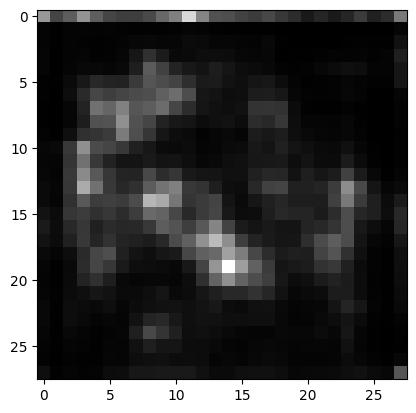

----------------------------------------


Discriminator Loss = 0.07851743698120117
Generator Loss = 3.6231861114501953
A sample image generated by the generator


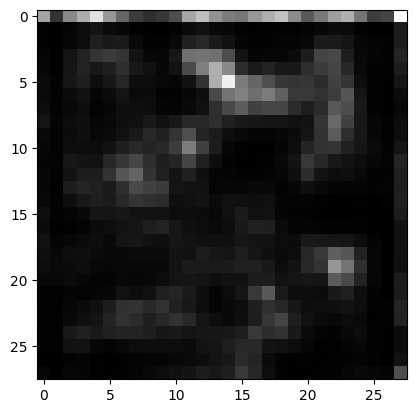

----------------------------------------


Discriminator Loss = 0.07361429184675217
Generator Loss = 3.568767547607422
A sample image generated by the generator


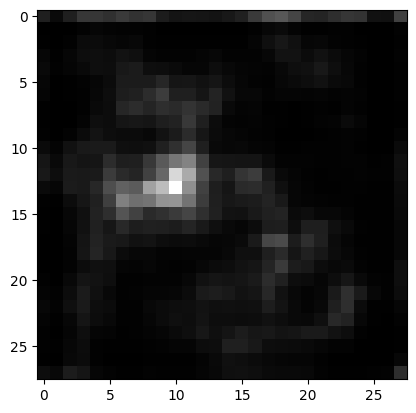

----------------------------------------


Discriminator Loss = 0.06780193746089935
Generator Loss = 3.586439609527588
A sample image generated by the generator


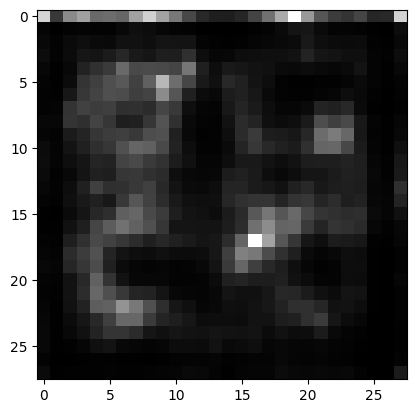

----------------------------------------


Discriminator Loss = 0.08086352050304413
Generator Loss = 3.5383691787719727
A sample image generated by the generator


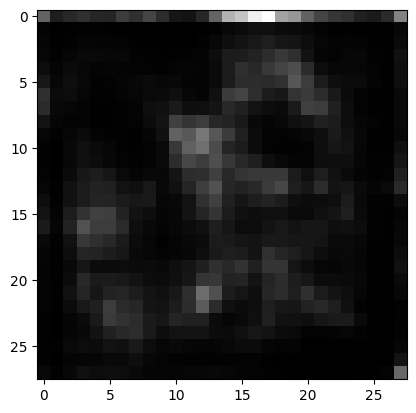

----------------------------------------


Discriminator Loss = 0.07076863944530487
Generator Loss = 3.4281535148620605
A sample image generated by the generator


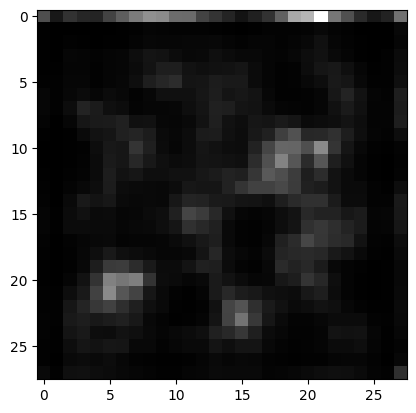

----------------------------------------


Discriminator Loss = 0.07497013360261917
Generator Loss = 3.4458072185516357
A sample image generated by the generator


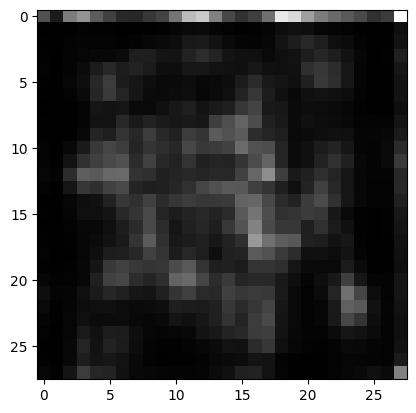

----------------------------------------


Discriminator Loss = 0.07296594977378845
Generator Loss = 3.522433280944824
A sample image generated by the generator


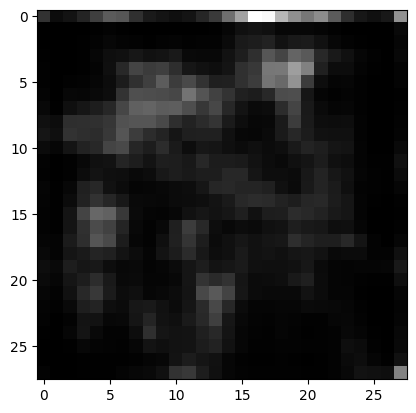

----------------------------------------


Discriminator Loss = 0.07141649723052979
Generator Loss = 3.594891309738159
A sample image generated by the generator


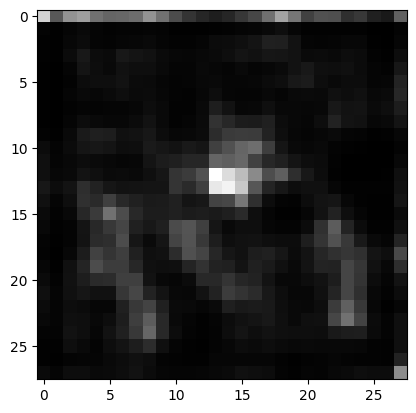

----------------------------------------


Discriminator Loss = 0.07519826292991638
Generator Loss = 3.6664884090423584
A sample image generated by the generator


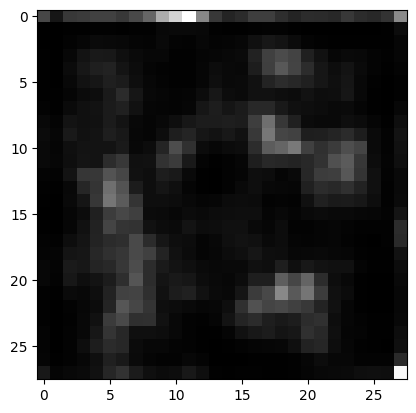

----------------------------------------


Discriminator Loss = 0.07401373982429504
Generator Loss = 3.4435343742370605
A sample image generated by the generator


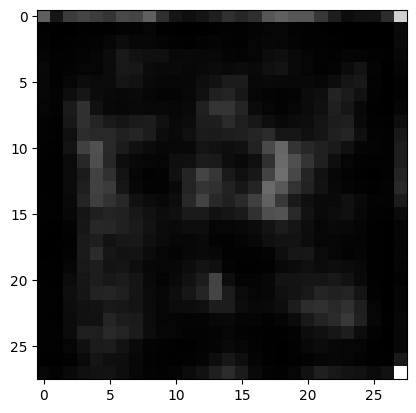

----------------------------------------


Discriminator Loss = 0.07352252304553986
Generator Loss = 3.5461368560791016
A sample image generated by the generator


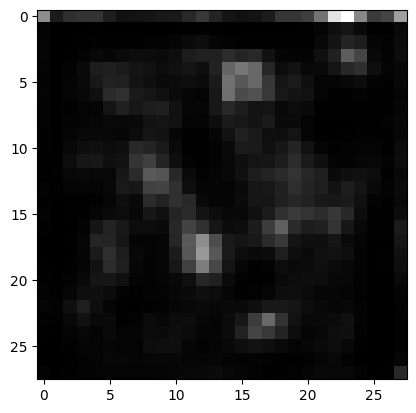

----------------------------------------




KeyboardInterrupt: 

In [ ]:
epochs = 100

for epoch in range (epochs):
  for i, batch in enumerate (train_loader):
    real_images = batch[0].to (device)
    real_image_labels = torch.ones (real_images.shape[0], 1, device = device)

#Discriminator Training

    input_generator = torch.randn ((real_images.shape[0], latent_dim), device = device)
    fake_images = generator (input_generator)

    fake_image_labels = torch.zeros (real_images.shape[0], 1, device = device)

    optimiser_d.zero_grad()

    fake_output = discriminator (fake_images)
    loss_d_1 = loss_fn (discriminator (real_images), real_image_labels)
    loss_d_2 = loss_fn (fake_output, fake_image_labels)

    net_loss = loss_d_1 + loss_d_2

    net_loss.backward(retain_graph = True)
    optimiser_d.step()

#Generator Training

    optimiser_g.zero_grad()
    gen_loss = loss_fn (discriminator (fake_images), real_image_labels)

    gen_loss.backward()
    optimiser_g.step()


    if (i%10==0):
      print (f'Discriminator Loss = {net_loss}')
      print (f'Generator Loss = {gen_loss}')
      print ('A sample image generated by the generator')

      sample_input = torch.randn((1, latent_dim), device = device)
      image = generator (sample_input)
      image = image[0]
      image_np = image[0].cpu().detach().numpy()
      plt.imshow(image_np, cmap='gray')
      plt.show()
      print ('----------------------------------------')
      print ('\n')